In [1]:
import numpy as np
from numpy import *
import matplotlib.pyplot as plt
import matplotlib

from mpl_toolkits.axes_grid1 import make_axes_locatable
import csv
from scipy import stats
from scipy.fft import fft, fftfreq
import scipy.io
from scipy.io import savemat
from scipy.interpolate import UnivariateSpline 

import os

import matplotlib.ticker as ticker
import seaborn as sns
%matplotlib inline


import sys
sys.path.append(r'C:/Users/Demag/PycharmProjects/ColdMeasurements/probst_fit')
from resonator_tools.circuit import notch_port

def db2mag(db): return np.power(10, db/20)

select_res = 3

C:\Users\Demag\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [8]:
initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm'

files = os.listdir(initial_folder)
for i in range(len(files)):
    if ".fig" in files[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files[i]) 

[0] -----------> S21_PowerSweep_Daf
[1] -----------> S21_PowerSweep_HigherPower2
[2] -----------> S21_PowerSweep_LowPower
[3] -----------> S21_PowerSweep_LowPower2
[4] -----------> S21_SpectrumSweep_Full_500mK
[5] -----------> S21_SpectrumSweep_Full_50mK
[6] -----------> S21_SpectrumSweep_Full_800mK
[7] -----------> tsweeo
[8] -----------> ZGraphs_data


In [9]:
folder = files[6] # read reference
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 

[0] -----------> Data.mat
[1] -----------> Data_30db_on_vna.mat


In [10]:
def read_mat(mat):
    k = list(mat.keys())
    print('Keys total:', len(k)-4)
    print(k, '\n')

    print('---------', mat['SampleName'][0], '-----------')
    for en_ki, ki in enumerate(k[3:-1]):
        if ki == 'SampleName' or ki == 'c0' or ki == 'SaveDirFig' or ki == 'Testm' or ki == 'None' or ki == 'SweepEstimate' or ki == 'Year' or ki == 'User': pass
        elif len(shape(mat[ki]))>1:
            if shape(mat[ki])[0] == 1: 
                if len(mat[ki][0])<10: print(ki, '===', mat[ki][0])


    for en_ki, ki in enumerate(k[3:-1]):
        if ki == 'SampleName' or ki == 'c0' or ki == 'SaveDirData' or ki == 'SaveDirFig' or ki == 'Testm' or ki == 'None' or ki == 'SweepEstimate' or ki == 'Year' or ki == 'User': pass
        elif len(shape(mat[ki]))>1:
            if shape(mat[ki])[0] == 1: 
                if len(mat[ki][0])<10: pass
                else: print(ki, shape(mat[ki]), '-len-->', len(mat[ki][0]))


    for en_ki, ki in enumerate(k[3:-1]):
        if ki == 'SampleName' or ki == 'c0' or ki == 'SaveDirData' or ki == 'SaveDirFig' or ki == 'Testm' or ki == 'None' or ki == 'SweepEstimate' or ki == 'Year' or ki == 'User': pass
        elif len(shape(mat[ki]))>1:
            if shape(mat[ki])[0] == 1: pass

            elif shape(mat[ki][:,0]) == 1: print(ki, '===', mat[ki][:,0])


    for en_ki, ki in enumerate(k[3:-1]):
        if ki == 'SampleName' or ki == 'c0' or ki == 'SaveDirData' or ki == 'SaveDirFig' or ki == 'Testm' or ki == 'None' or ki == 'SweepEstimate' or ki == 'Year' or ki == 'User': pass
        elif len(shape(mat[ki]))>1:
            if shape(mat[ki])[0] == 1: pass

            elif shape(mat[ki][:,0]) == 1: print(ki, '===', mat[ki][:,0])
            else: 
                print(ki, '--->', shape(mat[ki]))

            
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[1])
read_mat(mat)

Keys total: 22
['__header__', '__version__', '__globals__', 'MeasName', 'NMeasurementPoints', 'None', 'P', 'S', 'SampleName', 'SaveDirData', 'SaveDirFig', 'SweepEstimate', 'T', 'Testm', 'User', 'Year', 'att_on_vna', 'c', 'f', 'fstart', 'fstop', 'i', 'loop', 'mag', 'pha', '__function_workspace__'] 

--------- CoSi2_25nm_10 -----------
NMeasurementPoints === [100001]
P === [10]
T === [0.8]
att_on_vna === [30]
fstart === [5.e+09]
fstop === [6.e+09]
i === [1]
loop === [1]
f (1, 100001) -len--> 100001
S ---> (100001, 1)
c ---> (6, 1)
mag ---> (100001, 1)
pha ---> (100001, 1)


C:\Users\Demag\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:226: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


mag (100001,)
pha (100001,)
f (100001,)


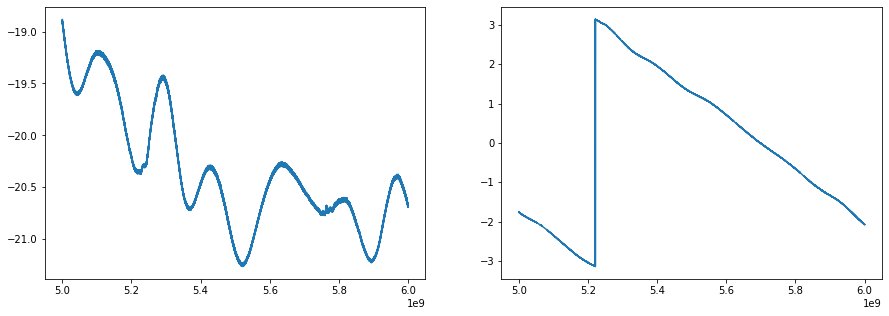

In [11]:
mag_ref_h = mat['mag'][:,0]
print('mag', shape(mag_ref_h))

pha_ref_h = mat['pha'][:,0]
print('pha', shape(pha_ref_h))

f_ref_h = mat['f'][0]
print('f', shape(f_ref_h))

fig, ax = plt.subplots(1,2, figsize=(15, 5))
ax[0].plot(f_ref_h, mag_ref_h)
ax[1].plot(f_ref_h, pha_ref_h)

In [12]:
folder = files[1]
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 
    

[0] -----------> Data.mat
[1] -----------> Merge_fr_pow_res4.mat
[2] -----------> PowerScan-30_40_r0.png
[3] -----------> PowerScan-30_40_r1.png
[4] -----------> PowerScan-30_40_r4.png
[5] -----------> PowerScan-30_40_res2.png
[6] -----------> PowerScan-30_40_res3.png
[7] -----------> PowerScan_ref_corrected.mat
[8] -----------> PowerScan_ref_corrected_res0.mat
[9] -----------> PowerScan_ref_corrected_res1.mat
[10] -----------> PowerScan_ref_corrected_res2.mat
[11] -----------> PowerScan_ref_corrected_res3.mat
[12] -----------> PowerScan_ref_corrected_res4.mat


In [13]:
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[0])
read_mat(mat)

Keys total: 25
['__header__', '__version__', '__globals__', 'Attenuation', 'Average', 'IF', 'MeasName', 'NMeasurementPoints', 'None', 'P', 'S', 'SampleName', 'SaveDirData', 'SaveDirFig', 'SweepEstimate', 'T', 'Testm', 'User', 'Year', 'c', 'f', 'fcenter', 'fstart', 'fstop', 'i', 'j', 'mag', 'pha', '__function_workspace__'] 

--------- CoSi2_25nm_10 -----------
Attenuation === [30]
Average === [1]
IF === [  1  10 100]
NMeasurementPoints === [401]
T === [0.01]
fcenter === [5.208283e+09 5.447359e+09 5.631761e+09 5.781961e+09 5.881769e+09]
fstart === [5.879269e+09]
fstop === [5.884269e+09]
i === [5]
j === [201]
P (1, 201) -len--> 201
f (1, 401) -len--> 401
S ---> (401, 5, 201)
c ---> (6, 5, 201)
mag ---> (401, 5, 201)
pha ---> (401, 5, 201)


In [14]:
mag_h = mat['mag']
print('mag', shape(mag_h))

pha_h = mat['pha']
print('pha', shape(pha_h))

f_h = mat['f'][0]
print('f', shape(f_h))

P_h = mat['P'][0]
print('P', shape(P_h))

fcenter_h = mat['fcenter'][0]
print('fcenter', shape(fcenter_h))

nop = int(mat['NMeasurementPoints'][0])
print('NMeasurementPoints', nop)

mag (401, 5, 201)
pha (401, 5, 201)
f (401,)
P (201,)
fcenter (5,)
NMeasurementPoints 401


C:\Users\Demag\AppData\Local\Temp\ipykernel_8520\1180367042.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  nop = int(mat['NMeasurementPoints'][0])


In [15]:
def correct_data_with_ref(f, mag, pha, f_ref, mag_ref, pha_ref, spline_factor = 0.5, return_ref = False):
    '''
    The function takes any f-mag-pha set and substruct background.
    No need to correct data from reference to same scale as data of interest
    
        spline_factor: 
                    The smaller the better spline follows data
        return_ref: 
                    If True, return reference data ajusted for desired region instead of corrected data
    '''
    
    def find_nearest(array, value):  # function to find boundaries for reference measurements
        array = np.asarray(array)
        idx = (np.abs(array - value)).argmin()
        return idx
    
    ref_min = find_nearest(f_ref, min(f)) # index. Start of region
    ref_max = find_nearest(f_ref, max(f)) # index. Stop of region
    
    f_ref_selected = f_ref[ref_min:ref_max]
    mag_ref_selected = mag_ref[ref_min:ref_max]
    pha_ref_selected = pha_ref[ref_min:ref_max] # Select part of data that fits data of interest region
    
    # Magnitude correction
    if len(f_ref_selected) != len(mag_ref_selected): print(len(f_ref_selected), len(mag_ref_selected))
    spl = UnivariateSpline(f_ref_selected, mag_ref_selected) # creates spline over reference data
    spl.set_smoothing_factor(spline_factor)            # factor of spline. follows points better with smaller value
    mag_ref_corr = spl(f)                 # changes X axis according to main data
    mag_corr = mag - mag_ref_corr
    
    # Phase correction
    spl = UnivariateSpline(f_ref_selected, pha_ref_selected)     # creates spline over reference data
    spl.set_smoothing_factor(spline_factor)            # factor of spline. follows points better with smaller value
    pha_ref_corr = spl(f)                 # changes X axis according to main data
    pha_corr = pha - pha_ref_corr    
    
    if return_ref: return f, mag_ref_corr, pha_ref_corr
    
    return f, mag_corr, pha_corr

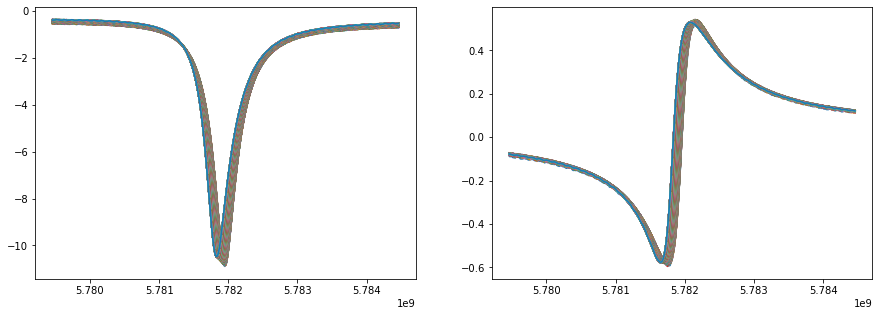

In [16]:
freq_h = np.linspace(fcenter_h[select_res]-2.5e6, fcenter_h[select_res]+2.5e6, nop)
mag_s_h = mag_h[:,select_res,:]
pha_s_h = pha_h[:,select_res,:]

fig, ax = plt.subplots(1,2, figsize=(15, 5))
f_corr_h, mag_corr_h, pha_corr_h = correct_data_with_ref(freq_h, mag_s_h[:,0], pha_s_h[:,0], f_ref_h, mag_ref_h, pha_ref_h)

for i in range(len(P_h)):
    f, mag_corr, pha_corr = correct_data_with_ref(freq_h, mag_s_h[:,i], pha_s_h[:,i], f_ref_h, mag_ref_h, pha_ref_h)
    ax[0].plot(f, mag_corr)
    ax[1].plot(f, pha_corr)

In [17]:
initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm'

files = os.listdir(initial_folder)
for i in range(len(files)):
    if ".fig" in files[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files[i]) 

[0] -----------> S21_PowerSweep_Daf
[1] -----------> S21_PowerSweep_HigherPower2
[2] -----------> S21_PowerSweep_LowPower
[3] -----------> S21_PowerSweep_LowPower2
[4] -----------> S21_SpectrumSweep_Full_500mK
[5] -----------> S21_SpectrumSweep_Full_50mK
[6] -----------> S21_SpectrumSweep_Full_800mK
[7] -----------> tsweeo
[8] -----------> ZGraphs_data


In [18]:
folder = files[3]
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 
        
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[0])
read_mat(mat)

[0] -----------> Data.mat
Keys total: 26
['__header__', '__version__', '__globals__', 'Attenuation', 'Average', 'IF', 'MeasName', 'NMeasurementPoints', 'None', 'P', 'S', 'SampleName', 'SaveDirData', 'SaveDirFig', 'SweepEstimate', 'T', 'Testm', 'User', 'Year', 'ans', 'c', 'f', 'fcenter', 'fstart', 'fstop', 'i', 'j', 'mag', 'pha', '__function_workspace__'] 

--------- CoSi2_25nm_10 -----------
Attenuation === [50]
Average === [1]
IF === [  1  10 100]
NMeasurementPoints === [401]
T === [0.01]
ans === [3.59558333]
fcenter === [5.208283e+09 5.447359e+09 5.631761e+09 5.781961e+09 5.881769e+09]
fstart === [5.879269e+09]
fstop === [5.884269e+09]
i === [5]
j === [331]
P (1, 331) -len--> 331
f (1, 401) -len--> 401
S ---> (401, 5, 331)
c ---> (6, 5, 331)
mag ---> (401, 5, 331)
pha ---> (401, 5, 331)


C:\Users\Demag\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:226: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [19]:
mag_l = mat['mag']
print('mag', shape(mag_l))

pha_l = mat['pha']
print('pha', shape(pha_l))

f_l = mat['f'][0]
print('f', shape(f_l))

P_l = mat['P'][0]
print('P', shape(P_l))

fcenter_l = mat['fcenter'][0]
print('fcenter', shape(fcenter_l))

nop = int(mat['NMeasurementPoints'][0])
print('NMeasurementPoints', nop)

mag (401, 5, 331)
pha (401, 5, 331)
f (401,)
P (331,)
fcenter (5,)
NMeasurementPoints 401


C:\Users\Demag\AppData\Local\Temp\ipykernel_8520\3910033951.py:16: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  nop = int(mat['NMeasurementPoints'][0])


In [20]:
initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm'

files = os.listdir(initial_folder)
for i in range(len(files)):
    if ".fig" in files[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files[i]) 

[0] -----------> S21_PowerSweep_Daf
[1] -----------> S21_PowerSweep_HigherPower2
[2] -----------> S21_PowerSweep_LowPower
[3] -----------> S21_PowerSweep_LowPower2
[4] -----------> S21_SpectrumSweep_Full_500mK
[5] -----------> S21_SpectrumSweep_Full_50mK
[6] -----------> S21_SpectrumSweep_Full_800mK
[7] -----------> tsweeo
[8] -----------> ZGraphs_data


In [21]:
folder = files[6]
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 
        
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[0])
read_mat(mat)

[0] -----------> Data.mat
[1] -----------> Data_30db_on_vna.mat
Keys total: 21
['__header__', '__version__', '__globals__', 'MeasName', 'NMeasurementPoints', 'None', 'P', 'S', 'SampleName', 'SaveDirData', 'SaveDirFig', 'SweepEstimate', 'T', 'Testm', 'User', 'Year', 'c', 'f', 'fstart', 'fstop', 'i', 'loop', 'mag', 'pha', '__function_workspace__'] 

--------- CoSi2_25nm_10 -----------
NMeasurementPoints === [100001]
P === [10]
T === [0.8]
fstart === [5.e+09]
fstop === [6.e+09]
i === [1]
loop === [1]
f (1, 100001) -len--> 100001
S ---> (100001, 1)
c ---> (6, 1)
mag ---> (100001, 1)
pha ---> (100001, 1)


In [22]:
mag_ref_l = mat['mag']
print('mag', shape(mag_ref_l))

pha_ref_l = mat['pha']
print('pha', shape(pha_ref_l))

f_ref_l = mat['f'][0]
print('f', shape(f_ref_l))

mag (100001, 1)
pha (100001, 1)
f (100001,)


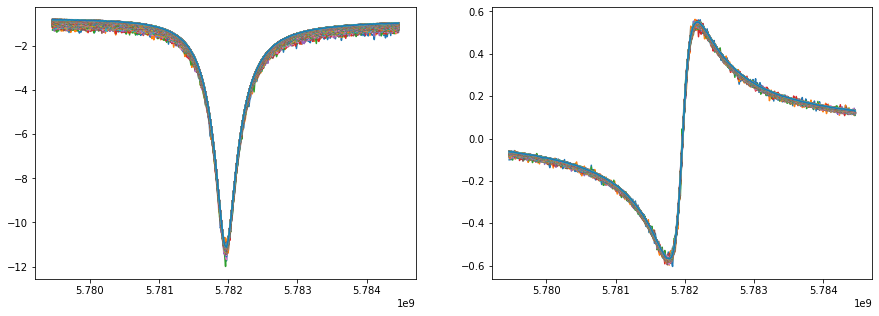

In [23]:
freq_l = np.linspace(fcenter_l[select_res]-2.5e6, fcenter_l[select_res]+2.5e6, nop)
mag_s_l = mag_l[:,select_res,:]
pha_s_l = pha_l[:,select_res,:]

fig, ax = plt.subplots(1,2, figsize=(15, 5))

for i in range(len(P_l)):
    f_l, mag_corr_l, pha_corr_l = correct_data_with_ref(freq_l, mag_s_l[:,i], pha_s_l[:,i], f_ref_l, mag_ref_l, pha_ref_l)
    ax[0].plot(f_l, mag_corr_l)
    ax[1].plot(f_l, pha_corr_l)

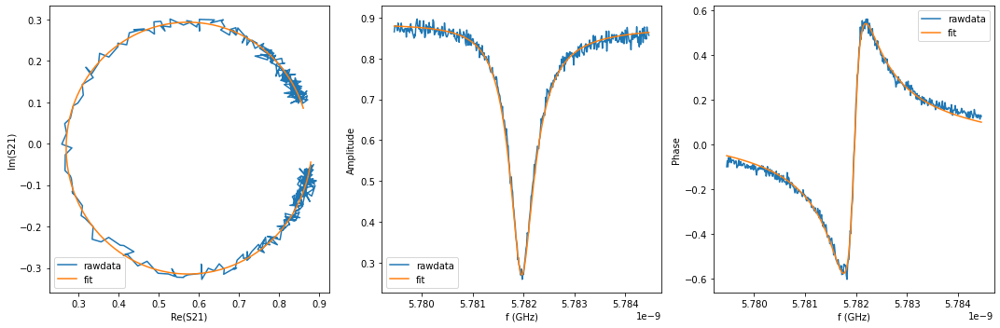

{'Qi_dia_corr': 23964.167124685948, 'Qi_no_corr': 24150.027090235926, 'absQc': 10546.612162280035, 'Qc_dia_corr(Re{Qc})': 10582.455241025365, 'Ql': 7340.796541578746, 'fr': 5.781942150865999, 'theta0': -3.059265537157614, 'phi0': 0.08232790948606018, 'phi0_err': 0.00816505394531132, 'Ql_err': 70.74894502115112, 'absQc_err': 66.30732863424592, 'fr_err': 3.8792782384695564e-06, 'chi_square': 0.0004774028317232068, 'Qi_no_corr_err': 591.3748268950982, 'Qi_dia_corr_err': 584.1946039273366, 'delay': 2.107142362761919, 'a': 0.8817671622754975, 'alpha': 1.177908108928124}


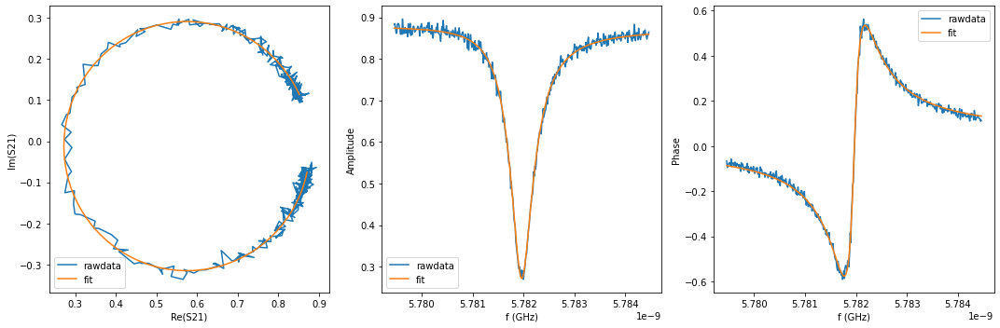

{'Qi_dia_corr': 25498.292893354905, 'Qi_no_corr': 25705.27823510921, 'absQc': 11488.756329904023, 'Qc_dia_corr(Re{Qc})': 11530.590459930247, 'Ql': 7940.02805797656, 'fr': 5.781941772254558, 'theta0': -3.0563835516905966, 'phi0': 0.0852091018991967, 'phi0_err': 0.005820044577357881, 'Ql_err': 58.00986050968209, 'absQc_err': 61.14837364839043, 'fr_err': 2.8009497689021014e-06, 'chi_square': 0.00027491792988470316, 'Qi_no_corr_err': 438.79877774187094, 'Qi_dia_corr_err': 433.03314510704644, 'delay': -0.666616516692278, 'a': 0.8746951138407167, 'alpha': 0.9391206281583885}


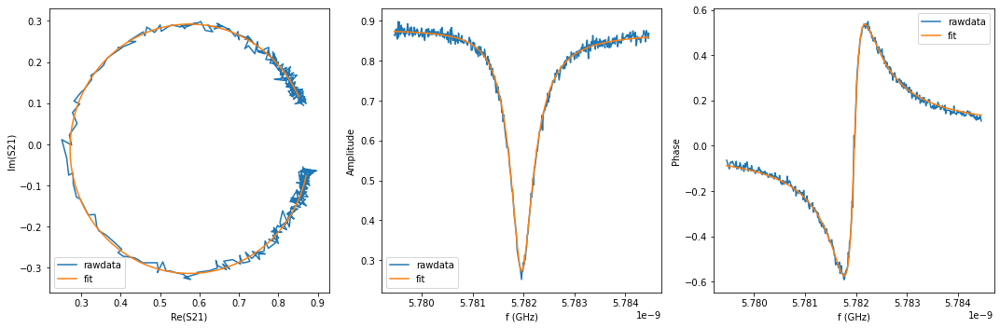

{'Qi_dia_corr': 25534.060010043966, 'Qi_no_corr': 25729.36283170967, 'absQc': 11520.236125204909, 'Qc_dia_corr(Re{Qc})': 11559.82491710085, 'Ql': 7957.356413829107, 'fr': 5.781942092898654, 'theta0': -3.058808061050023, 'phi0': 0.08278459253977044, 'phi0_err': 0.005536162260312846, 'Ql_err': 59.50008797369191, 'absQc_err': 59.58590593216651, 'fr_err': 2.5571223393848772e-06, 'chi_square': 0.00025391590513114355, 'Qi_no_corr_err': 458.0461768644944, 'Qi_dia_corr_err': 452.59688910856283, 'delay': -0.7874041681916614, 'a': 0.8744699750966731, 'alpha': 2.834905415103994}


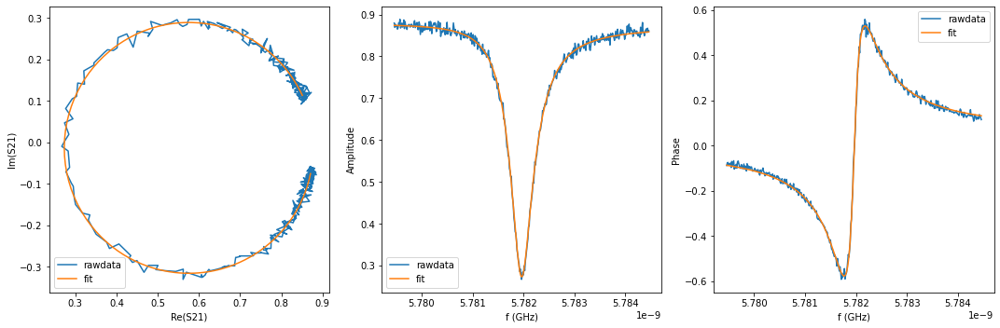

{'Qi_dia_corr': 25225.006262388444, 'Qi_no_corr': 25456.552762523108, 'absQc': 11446.165100170156, 'Qc_dia_corr(Re{Qc})': 11493.6027904933, 'Ql': 7895.892841421368, 'fr': 5.78193927880849, 'theta0': -3.0507076485579088, 'phi0': 0.09088624466284022, 'phi0_err': 0.004665751392077086, 'Ql_err': 48.499418243145776, 'absQc_err': 52.71594004414833, 'fr_err': 2.3142020489813804e-06, 'chi_square': 0.00019047637395006167, 'Qi_no_corr_err': 366.45063021723007, 'Qi_dia_corr_err': 359.2781051820068, 'delay': -0.6268628537295586, 'a': 0.8744442507182757, 'alpha': 2.3836403395531844}


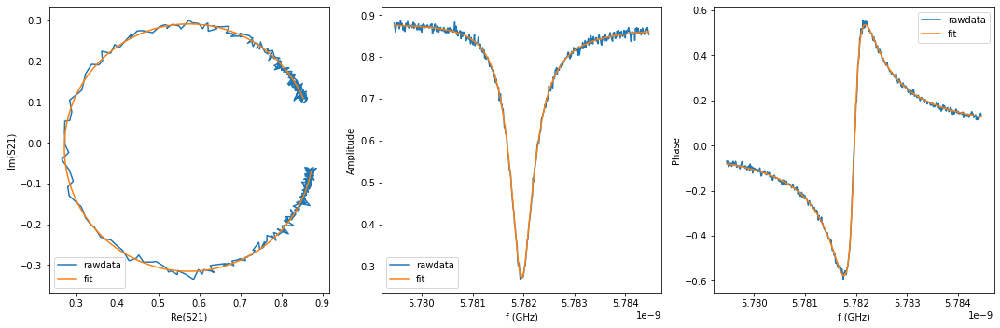

{'Qi_dia_corr': 25164.952034049304, 'Qi_no_corr': 25371.679168936837, 'absQc': 11304.056047909165, 'Qc_dia_corr(Re{Qc})': 11345.58139063345, 'Ql': 7819.962753561824, 'fr': 5.781940490536622, 'theta0': -3.0560090077856343, 'phi0': 0.08558364580415857, 'phi0_err': 0.0036978645675524854, 'Ql_err': 37.26665408647294, 'absQc_err': 41.55248700987857, 'fr_err': 1.9015656360153309e-06, 'chi_square': 0.00012163563793631817, 'Qi_no_corr_err': 289.76075055974985, 'Qi_dia_corr_err': 285.6258696832292, 'delay': -0.2090933275260243, 'a': 0.8758913779947823, 'alpha': -1.2888389507401088}


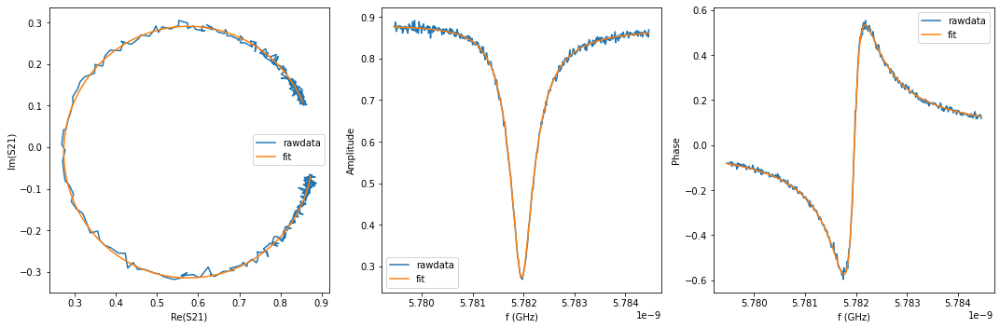

{'Qi_dia_corr': 24987.840050301562, 'Qi_no_corr': 25186.869911749433, 'absQc': 11308.466579419503, 'Qc_dia_corr(Re{Qc})': 11349.05280452989, 'Ql': 7804.418427711344, 'fr': 5.7819412494145626, 'theta0': -3.0569958350832565, 'phi0': 0.08459681850653672, 'phi0_err': 0.003382367758572477, 'Ql_err': 34.80337119084333, 'absQc_err': 38.176784261412166, 'fr_err': 1.759956895541281e-06, 'chi_square': 0.00010182540328325097, 'Qi_no_corr_err': 250.77146873948482, 'Qi_dia_corr_err': 246.36479837634587, 'delay': -0.2079889544492318, 'a': 0.8770214495963804, 'alpha': -1.2490225944896851}


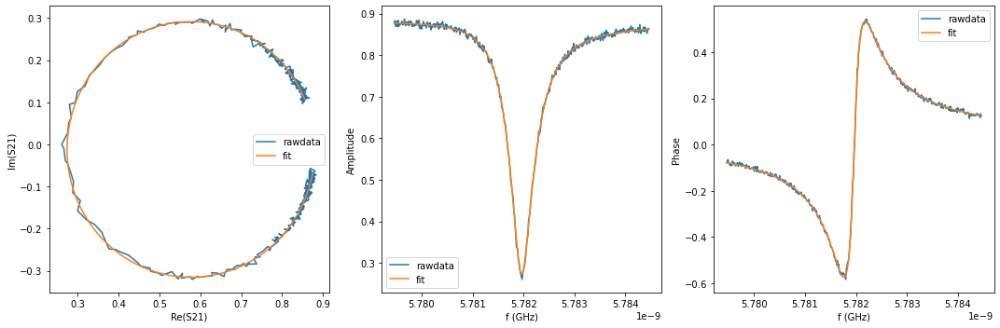

{'Qi_dia_corr': 24969.04312429458, 'Qi_no_corr': 25180.20319787919, 'absQc': 11282.249597776932, 'Qc_dia_corr(Re{Qc})': 11325.162790950932, 'Ql': 7791.284338256539, 'fr': 5.78193922036617, 'theta0': -3.0545112505564083, 'phi0': 0.08708140303338506, 'phi0_err': 0.003176983901308947, 'Ql_err': 31.357215034764973, 'absQc_err': 31.122538250233674, 'fr_err': 1.4761017053140515e-06, 'chi_square': 7.831705956684086e-05, 'Qi_no_corr_err': 244.31297027839577, 'Qi_dia_corr_err': 241.42302363397133, 'delay': -0.03244021826773197, 'a': 0.8783860712818066, 'alpha': -1.1535840892737592}


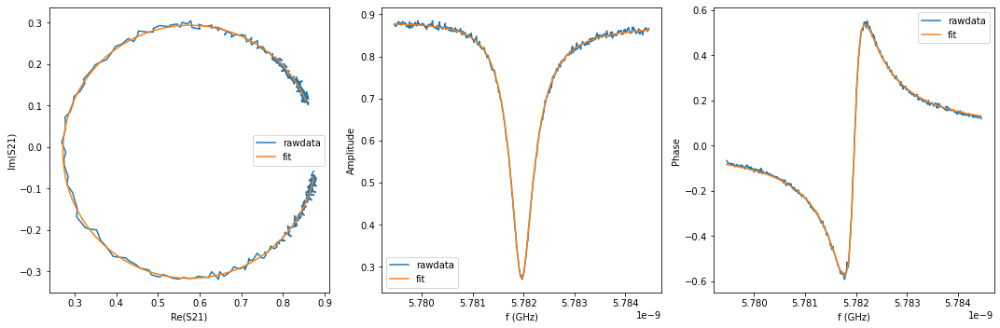

{'Qi_dia_corr': 25463.12183806328, 'Qi_no_corr': 25669.909724620953, 'absQc': 11413.39825050749, 'Qc_dia_corr(Re{Qc})': 11454.759156089682, 'Ql': 7900.614015830911, 'fr': 5.781941071802503, 'theta0': -3.056587001715858, 'phi0': 0.08500565187393497, 'phi0_err': 0.0028325354090541926, 'Ql_err': 29.137759256173453, 'absQc_err': 31.002233914082247, 'fr_err': 1.387721557374632e-06, 'chi_square': 6.887684823184504e-05, 'Qi_no_corr_err': 222.54699934462133, 'Qi_dia_corr_err': 219.925330298221, 'delay': -0.4666828067483299, 'a': 0.878187356709374, 'alpha': 1.9200634442687972}


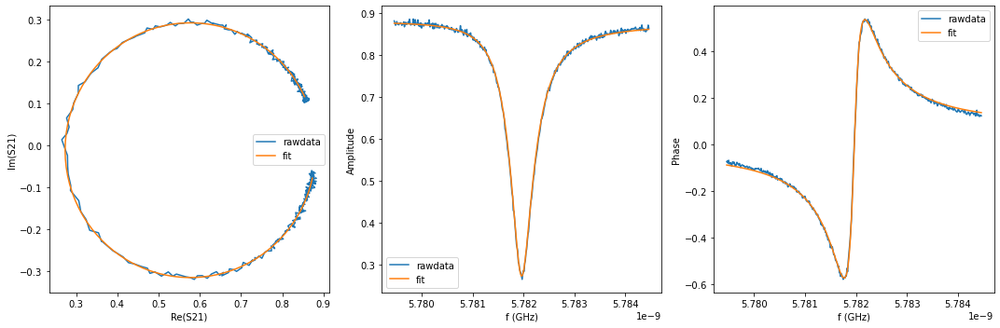

{'Qi_dia_corr': 25415.86798121193, 'Qi_no_corr': 25617.0520181468, 'absQc': 11492.641104970575, 'Qc_dia_corr(Re{Qc})': 11533.599613885171, 'Ql': 7933.441649198736, 'fr': 5.7819410784736895, 'theta0': -3.0572915541787666, 'phi0': 0.08430109941102634, 'phi0_err': 0.0038324921795037884, 'Ql_err': 35.59832588263114, 'absQc_err': 32.5025120252724, 'fr_err': 1.6867278097369424e-06, 'chi_square': 9.174003335327668e-05, 'Qi_no_corr_err': 298.92711223712615, 'Qi_dia_corr_err': 296.6215807092176, 'delay': -0.8382320345735947, 'a': 0.8774806905937033, 'alpha': 0.9879452635941655}


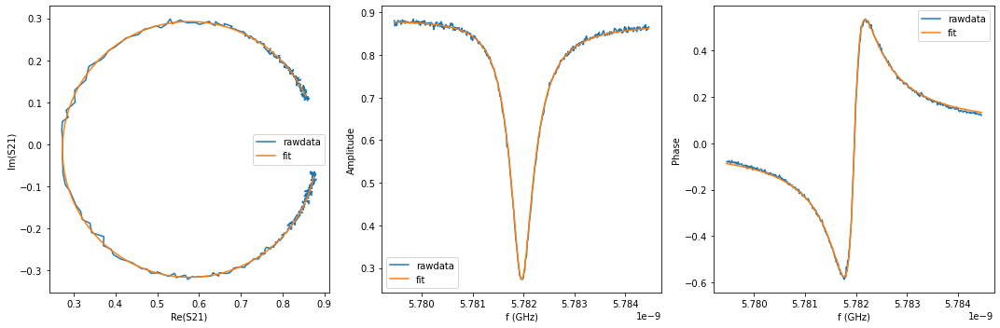

{'Qi_dia_corr': 25403.28316293539, 'Qi_no_corr': 25616.477895504562, 'absQc': 11455.236620884634, 'Qc_dia_corr(Re{Qc})': 11498.38935120355, 'Ql': 7915.544762758037, 'fr': 5.7819408787764655, 'theta0': -3.054928863079189, 'phi0': 0.08666356477451372, 'phi0_err': 0.0032110109641141915, 'Ql_err': 30.410871751210333, 'absQc_err': 27.679150268196626, 'fr_err': 1.4221492191978557e-06, 'chi_square': 6.669575388533674e-05, 'Qi_no_corr_err': 257.26060211439676, 'Qi_dia_corr_err': 253.91330473982194, 'delay': -0.709900611146956, 'a': 0.8782876588006588, 'alpha': -0.6329463859939236}


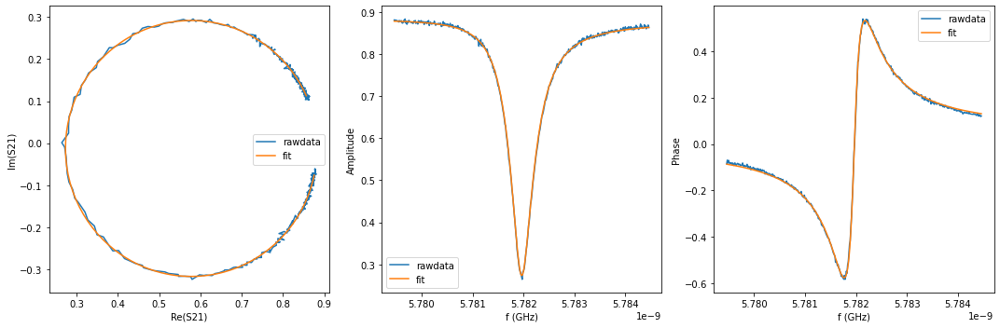

{'Qi_dia_corr': 25342.76654917584, 'Qi_no_corr': 25553.488837977628, 'absQc': 11426.647552710961, 'Qc_dia_corr(Re{Qc})': 11469.291921209893, 'Ql': 7895.879766609669, 'fr': 5.781941382360734, 'theta0': -3.055332109364031, 'phi0': 0.08626054422576188, 'phi0_err': 0.0028998485551823866, 'Ql_err': 26.68392740335764, 'absQc_err': 24.575111901662964, 'fr_err': 1.2987323656419071e-06, 'chi_square': 5.323965837536519e-05, 'Qi_no_corr_err': 228.53534504081378, 'Qi_dia_corr_err': 226.216154706246, 'delay': -0.5825828948176316, 'a': 0.8792555417683222, 'alpha': -2.2917665495143225}


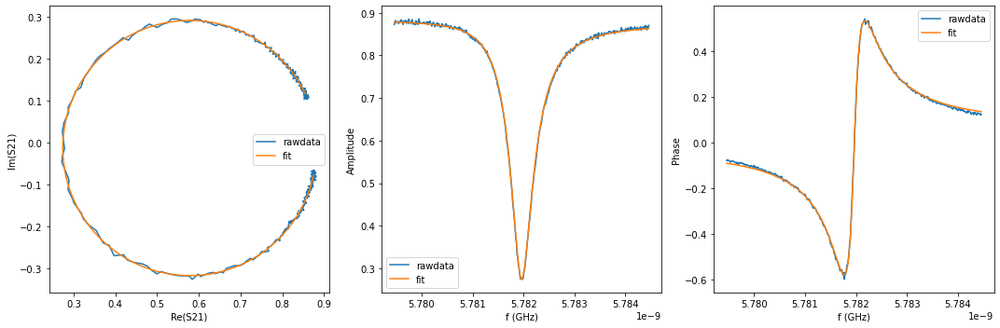

{'Qi_dia_corr': 25482.667396351477, 'Qi_no_corr': 25700.57750976995, 'absQc': 11512.636184935209, 'Qc_dia_corr(Re{Qc})': 11556.90582321441, 'Ql': 7950.976796578274, 'fr': 5.7819401076361645, 'theta0': -3.054036069167931, 'phi0': 0.0875560031398266, 'phi0_err': 0.003400381170737487, 'Ql_err': 30.591659036545252, 'absQc_err': 26.899924755751286, 'fr_err': 1.455970656432167e-06, 'chi_square': 6.602251580954552e-05, 'Qi_no_corr_err': 261.15308358637037, 'Qi_dia_corr_err': 257.9995499694744, 'delay': -0.8772940329249148, 'a': 0.8788675814241254, 'alpha': -0.4318477061149897}


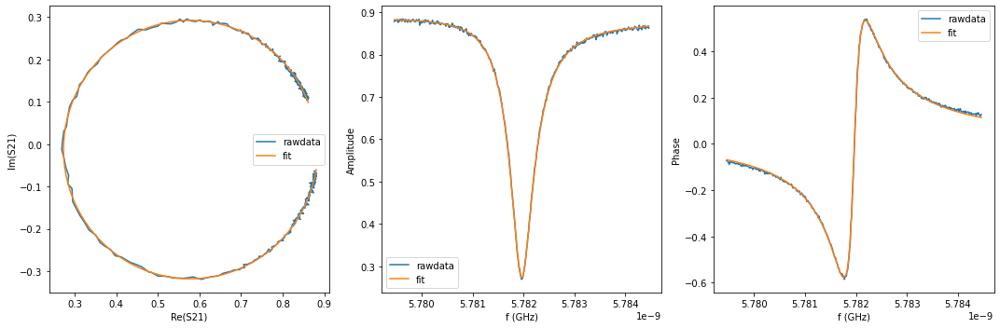

{'Qi_dia_corr': 24522.125418932934, 'Qi_no_corr': 24730.58713880203, 'absQc': 10954.481271327983, 'Qc_dia_corr(Re{Qc})': 10995.88656297313, 'Ql': 7591.711763793267, 'fr': 5.781940723400669, 'theta0': -3.0547837907798843, 'phi0': 0.08680888329048154, 'phi0_err': 0.0025545151581099984, 'Ql_err': 21.837703587203034, 'absQc_err': 21.270560605026606, 'fr_err': 1.214925245247474e-06, 'chi_square': 4.418390914841414e-05, 'Qi_no_corr_err': 182.30044013087843, 'Qi_dia_corr_err': 179.7671606378126, 'delay': 0.8230422007402244, 'a': 0.883742137757119, 'alpha': -1.4915685708123194}


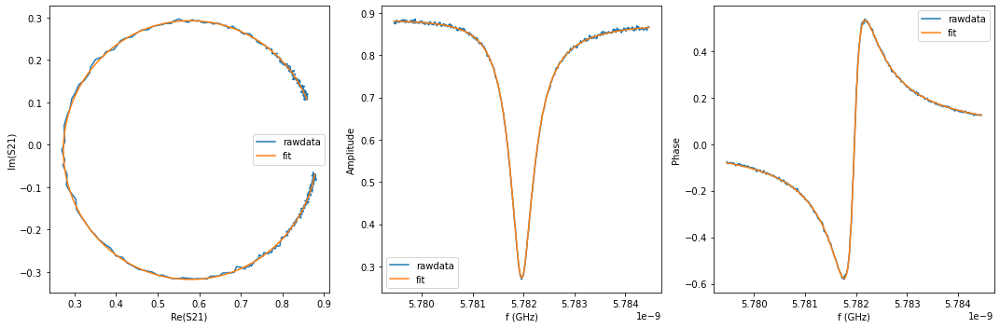

{'Qi_dia_corr': 25054.583363244074, 'Qi_no_corr': 25263.870435730736, 'absQc': 11250.974664306903, 'Qc_dia_corr(Re{Qc})': 11292.984813447227, 'Ql': 7784.318005896339, 'fr': 5.781940580726718, 'theta0': -3.0553120741812334, 'phi0': 0.08628244860632771, 'phi0_err': 0.0016059080842391973, 'Ql_err': 16.635364775727115, 'absQc_err': 17.19302697535441, 'fr_err': 7.744426392131485e-07, 'chi_square': 2.2228101937433163e-05, 'Qi_no_corr_err': 124.5425798862485, 'Qi_dia_corr_err': 122.94853960768123, 'delay': -0.06333354036625757, 'a': 0.8814973492892089, 'alpha': -2.2772601217379114}


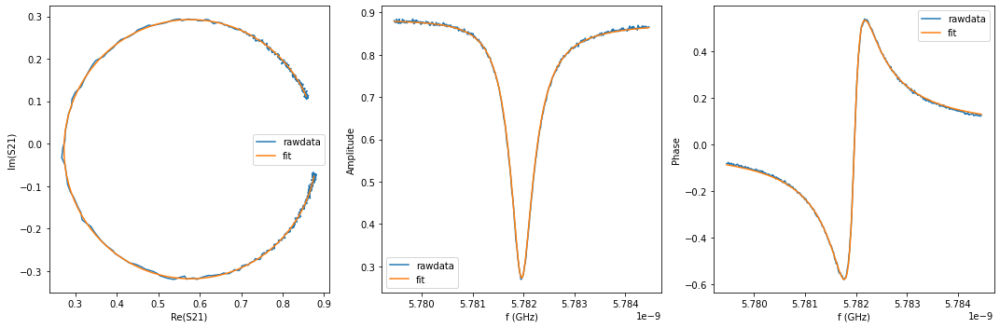

{'Qi_dia_corr': 25437.93194368707, 'Qi_no_corr': 25647.206496849714, 'absQc': 11408.120057720176, 'Qc_dia_corr(Re{Qc})': 11450.02014111294, 'Ql': 7895.933947048671, 'fr': 5.781940846742323, 'theta0': -3.056018036121117, 'phi0': 0.08557597242437157, 'phi0_err': 0.0022832285483967906, 'Ql_err': 22.363403609084035, 'absQc_err': 20.784288958899477, 'fr_err': 1.0216905000937796e-06, 'chi_square': 3.605193455263568e-05, 'Qi_no_corr_err': 186.755622041906, 'Qi_dia_corr_err': 185.3734332019241, 'delay': -0.5498734908068589, 'a': 0.8799122477589396, 'alpha': -1.1041182126671678}


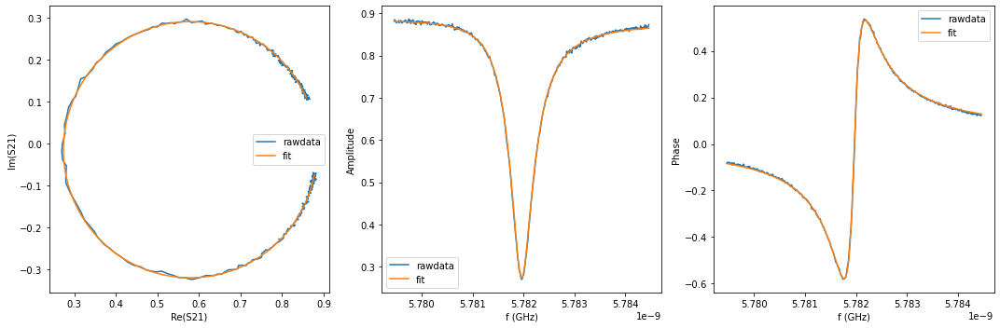

{'Qi_dia_corr': 25164.62065423523, 'Qi_no_corr': 25394.92088777323, 'absQc': 11317.23972179257, 'Qc_dia_corr(Re{Qc})': 11363.585804996635, 'Ql': 7828.479790644666, 'fr': 5.781939507092343, 'theta0': -3.051246111750461, 'phi0': 0.0903465418393322, 'phi0_err': 0.0019266061781310544, 'Ql_err': 20.25653512044198, 'absQc_err': 18.28638314140492, 'fr_err': 8.75554287944375e-07, 'chi_square': 2.7617742142214636e-05, 'Qi_no_corr_err': 167.29013983909928, 'Qi_dia_corr_err': 164.11091342148677, 'delay': -0.3671280341356259, 'a': 0.8813906587396867, 'alpha': -0.7473589429652071}


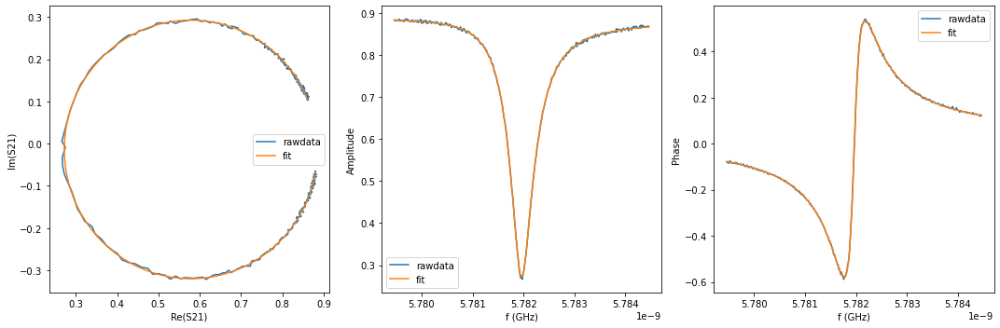

{'Qi_dia_corr': 25142.39829496378, 'Qi_no_corr': 25370.34814729941, 'absQc': 11207.784346720946, 'Qc_dia_corr(Re{Qc})': 11252.854460468307, 'Ql': 7773.644290961183, 'fr': 5.781938913921894, 'theta0': -3.0520617647217554, 'phi0': 0.08953091729229684, 'phi0_err': 0.001167028612712193, 'Ql_err': 13.100043215522858, 'absQc_err': 15.048533767059123, 'fr_err': 6.342027812581902e-07, 'chi_square': 1.4146630066229696e-05, 'Qi_no_corr_err': 92.85944925522406, 'Qi_dia_corr_err': 91.74556251304261, 'delay': 0.10205967713300293, 'a': 0.8830028395931475, 'alpha': -2.551678698515061}


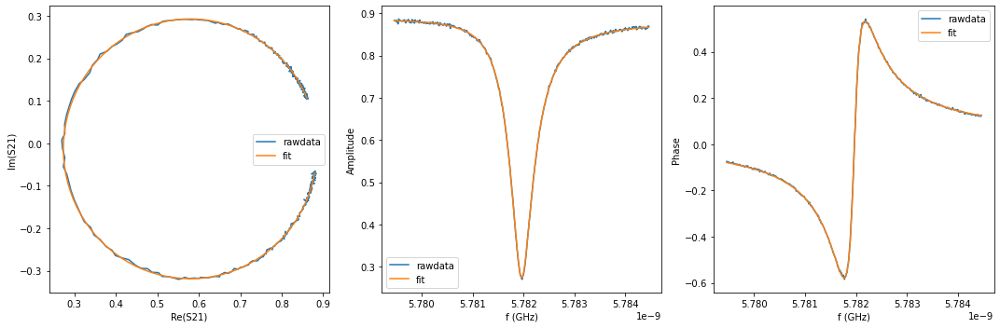

{'Qi_dia_corr': 25091.373678884185, 'Qi_no_corr': 25305.578818790586, 'absQc': 11267.457730543998, 'Qc_dia_corr(Re{Qc})': 11310.450459545762, 'Ql': 7796.16806777998, 'fr': 5.781940575127228, 'theta0': -3.0543738313804543, 'phi0': 0.08721882220933871, 'phi0_err': 0.0012686650219835922, 'Ql_err': 12.4696212645116, 'absQc_err': 13.5591384777449, 'fr_err': 6.441385937510378e-07, 'chi_square': 1.3799053425321866e-05, 'Qi_no_corr_err': 91.49435438832471, 'Qi_dia_corr_err': 90.06919413948015, 'delay': -0.01375027971936077, 'a': 0.8832421909744576, 'alpha': -0.47602677081887734}


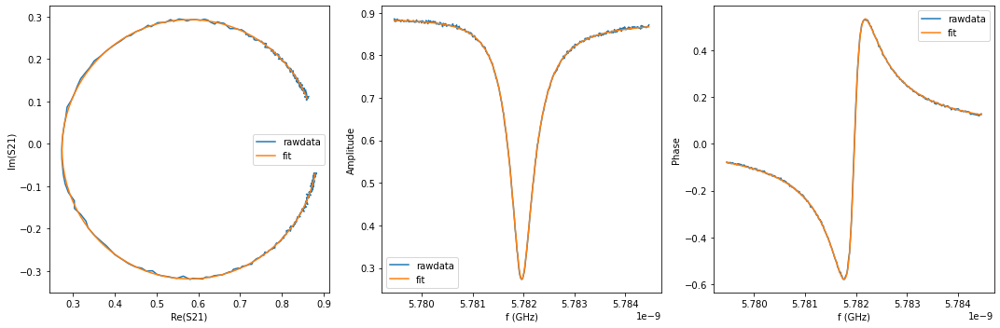

{'Qi_dia_corr': 25122.012646581945, 'Qi_no_corr': 25333.263702735392, 'absQc': 11263.542537673851, 'Qc_dia_corr(Re{Qc})': 11305.812327721633, 'Ql': 7796.91789112465, 'fr': 5.7819415880335985, 'theta0': -3.0550929617104203, 'phi0': 0.08649969187937277, 'phi0_err': 0.0012751037104871664, 'Ql_err': 12.756211893540828, 'absQc_err': 12.821415224617077, 'fr_err': 6.036410543794756e-07, 'chi_square': 1.3104266246037597e-05, 'Qi_no_corr_err': 100.45522463027793, 'Qi_dia_corr_err': 99.12216831025096, 'delay': -0.05251260310829244, 'a': 0.8831585891313982, 'alpha': -1.8847366378555506}


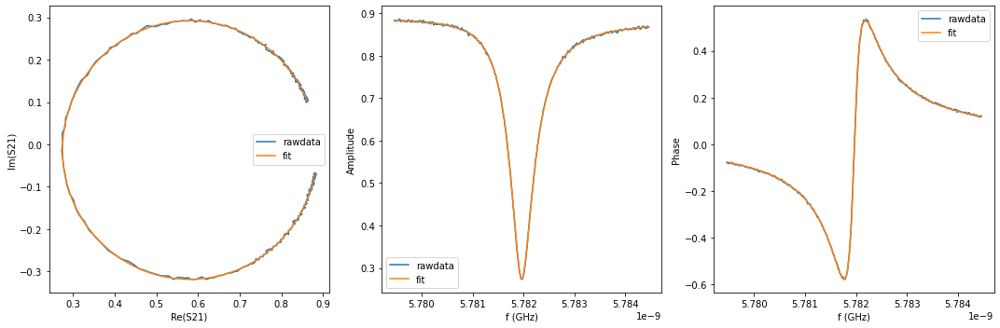

{'Qi_dia_corr': 24831.734162445955, 'Qi_no_corr': 25037.329918124677, 'absQc': 11168.054614279927, 'Qc_dia_corr(Re{Qc})': 11209.452772796225, 'Ql': 7723.11277818626, 'fr': 5.781940915109927, 'theta0': -3.0556237624978633, 'phi0': 0.08597002512597363, 'phi0_err': 0.0011408868928479649, 'Ql_err': 12.171552389401953, 'absQc_err': 12.124883503864405, 'fr_err': 5.395583355180449e-07, 'chi_square': 1.1262570306630041e-05, 'Qi_no_corr_err': 93.3258895531132, 'Qi_dia_corr_err': 92.1006270679047, 'delay': 0.3000905374509282, 'a': 0.8844750432479719, 'alpha': -1.64184009983222}


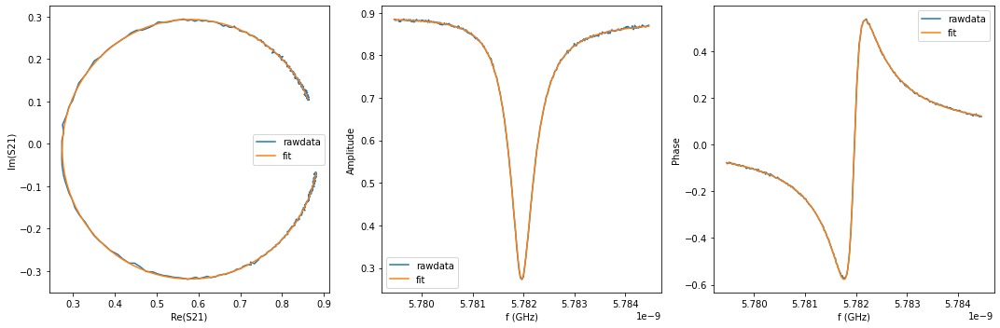

{'Qi_dia_corr': 25027.838356995875, 'Qi_no_corr': 25237.581149036057, 'absQc': 11235.280251838522, 'Qc_dia_corr(Re{Qc})': 11277.353600848975, 'Ql': 7774.30906699132, 'fr': 5.7819411258007625, 'theta0': -3.0551854292937817, 'phi0': 0.08640722429601153, 'phi0_err': 0.0010791247837850621, 'Ql_err': 10.777019415537834, 'absQc_err': 11.157866808286714, 'fr_err': 5.22814718278367e-07, 'chi_square': 9.701412317324935e-06, 'Qi_no_corr_err': 82.4476571234837, 'Qi_dia_corr_err': 81.10499084681625, 'delay': 0.10699224228457796, 'a': 0.8846247869556773, 'alpha': -2.3726786313767687}


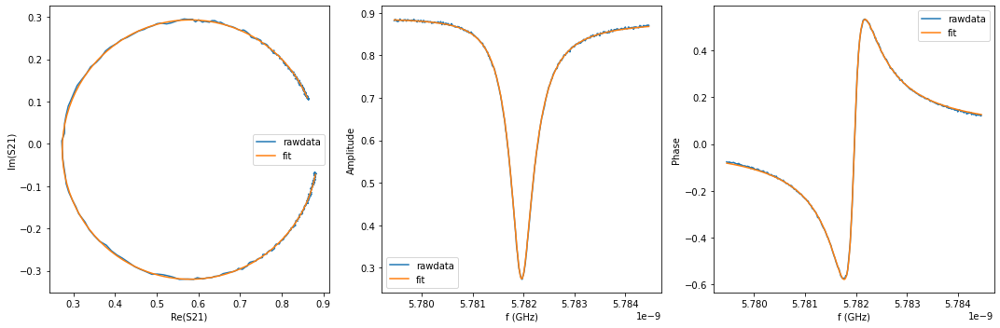

{'Qi_dia_corr': 25339.019705775387, 'Qi_no_corr': 25560.848922826597, 'absQc': 11352.588045063332, 'Qc_dia_corr(Re{Qc})': 11396.901471905781, 'Ql': 7861.1424927831295, 'fr': 5.781940419438716, 'theta0': -3.053381896508192, 'phi0': 0.08821249139736098, 'phi0_err': 0.0014048646457820717, 'Ql_err': 13.929232908215738, 'absQc_err': 13.767561191972545, 'fr_err': 6.500669719205647e-07, 'chi_square': 1.5225609139477363e-05, 'Qi_no_corr_err': 110.60568012666137, 'Qi_dia_corr_err': 109.07773299377544, 'delay': -0.22257110903996596, 'a': 0.8841681100798345, 'alpha': -1.7791117676334884}


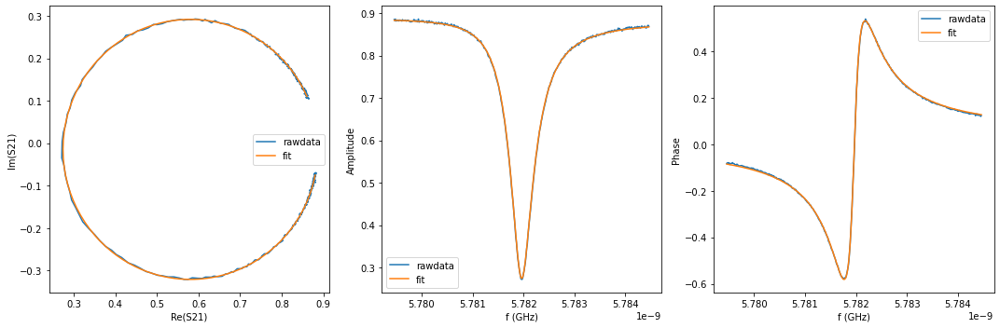

{'Qi_dia_corr': 25246.56910133906, 'Qi_no_corr': 25477.909056331155, 'absQc': 11336.426600140638, 'Qc_dia_corr(Re{Qc})': 11382.836558251485, 'Ql': 7845.542797167979, 'fr': 5.781939531633176, 'theta0': -3.05126035398356, 'phi0': 0.09033228681410237, 'phi0_err': 0.0017305725213058627, 'Ql_err': 14.836554528983255, 'absQc_err': 13.54880562262104, 'fr_err': 7.821354099658708e-07, 'chi_square': 1.7283089745392233e-05, 'Qi_no_corr_err': 131.84715550307828, 'Qi_dia_corr_err': 129.576218643298, 'delay': -0.3607944041858263, 'a': 0.8839209590367572, 'alpha': -0.5185608269016441}


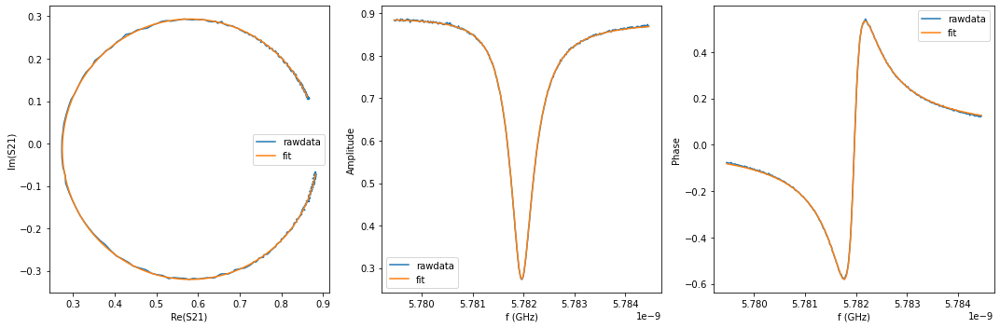

{'Qi_dia_corr': 25269.13641480399, 'Qi_no_corr': 25490.52890211656, 'absQc': 11331.550641781467, 'Qc_dia_corr(Re{Qc})': 11375.857107186399, 'Ql': 7844.402671385632, 'fr': 5.78194021891499, 'theta0': -3.0533054941845696, 'phi0': 0.08828715940522346, 'phi0_err': 0.001333937853336839, 'Ql_err': 11.938363754520843, 'absQc_err': 12.21376774571739, 'fr_err': 6.447275530077039e-07, 'chi_square': 1.2471994891207307e-05, 'Qi_no_corr_err': 100.090224502613, 'Qi_dia_corr_err': 99.02506695539293, 'delay': -0.22268448036818453, 'a': 0.885317637951358, 'alpha': -1.7832159051305394}


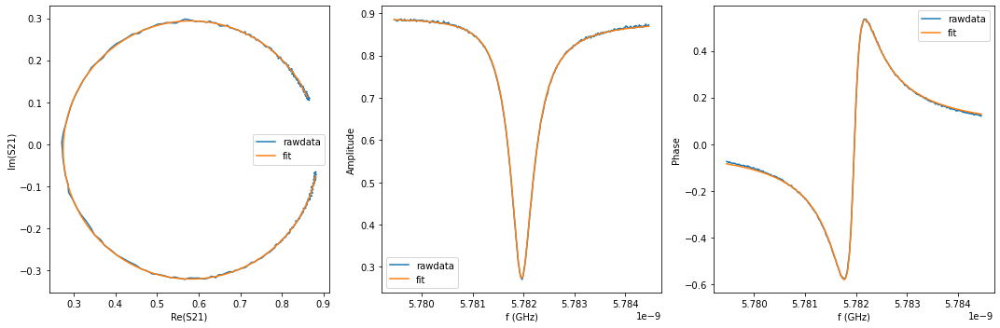

{'Qi_dia_corr': 25461.51856332167, 'Qi_no_corr': 25688.04649078346, 'absQc': 11408.942180016787, 'Qc_dia_corr(Re{Qc})': 11454.202393997175, 'Ql': 7900.194803725817, 'fr': 5.781939906998812, 'theta0': -3.052665583689135, 'phi0': 0.08892706990065834, 'phi0_err': 0.002109988081491138, 'Ql_err': 18.299504915546258, 'absQc_err': 15.396736225569228, 'fr_err': 9.054282856772079e-07, 'chi_square': 2.3172415768946707e-05, 'Qi_no_corr_err': 163.7585086309367, 'Qi_dia_corr_err': 161.49965049609722, 'delay': -0.43003197967296564, 'a': 0.8849807937788332, 'alpha': -3.032703701688105}


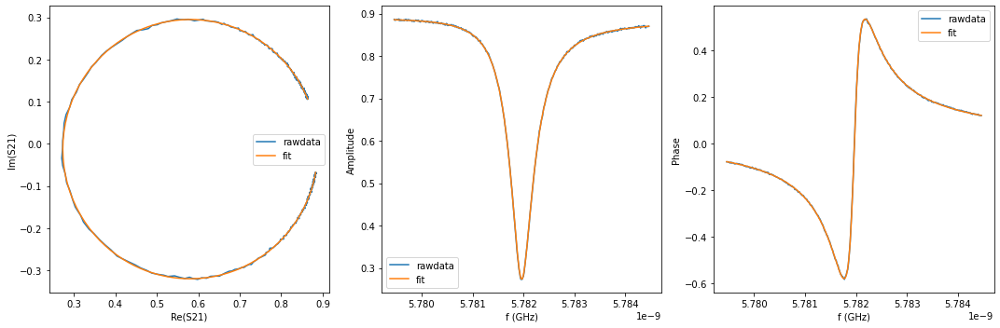

{'Qi_dia_corr': 25138.814057186977, 'Qi_no_corr': 25350.783409394462, 'absQc': 11199.43395575073, 'Qc_dia_corr(Re{Qc})': 11241.308475643957, 'Ql': 7767.790316639797, 'fr': 5.7819406014890475, 'theta0': -3.0552517892637296, 'phi0': 0.08634086432606367, 'phi0_err': 0.0008186283879562309, 'Ql_err': 8.369159409371433, 'absQc_err': 9.018817740300474, 'fr_err': 4.129767310357619e-07, 'chi_square': 6.019387825411473e-06, 'Qi_no_corr_err': 63.72065961733253, 'Qi_dia_corr_err': 62.8488476808959, 'delay': 0.14627403810104544, 'a': 0.8866941860634713, 'alpha': -0.9451786568958569}


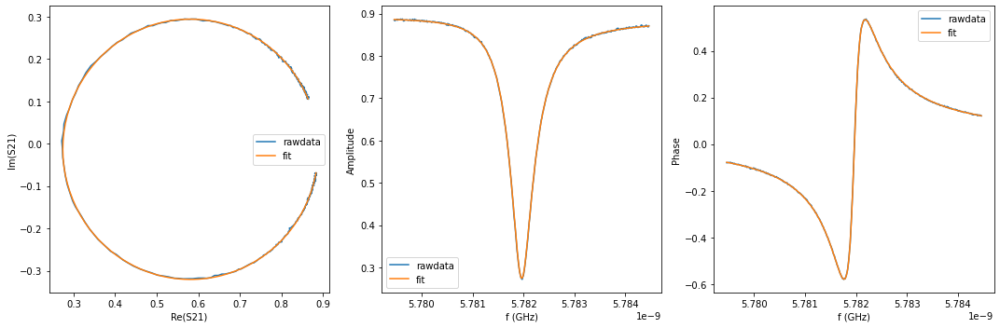

{'Qi_dia_corr': 25100.812210059372, 'Qi_no_corr': 25314.219895004182, 'absQc': 11213.585612163799, 'Qc_dia_corr(Re{Qc})': 11255.97776392594, 'Ql': 7771.153181979849, 'fr': 5.781940745076211, 'theta0': -3.0547766796694775, 'phi0': 0.0868165477943164, 'phi0_err': 0.0008294368143284373, 'Ql_err': 8.457449792699247, 'absQc_err': 8.211757444743132, 'fr_err': 3.9115109833443075e-07, 'chi_square': 5.492860333702286e-06, 'Qi_no_corr_err': 69.82580069628392, 'Qi_dia_corr_err': 68.97690936414038, 'delay': 0.11863211626803602, 'a': 0.8870828433711782, 'alpha': -1.950135379525206}


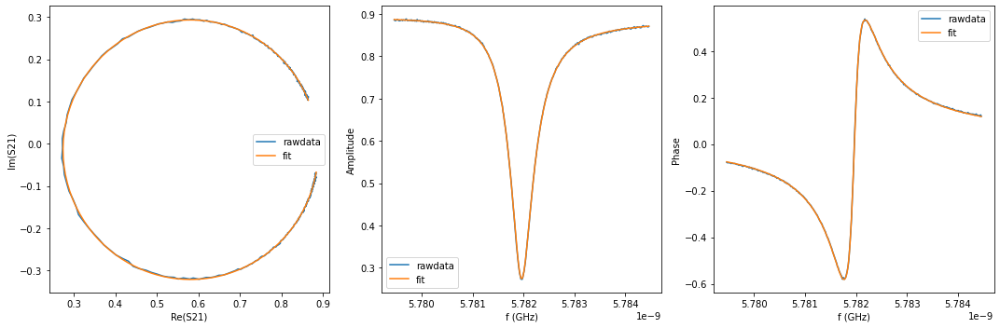

{'Qi_dia_corr': 25028.69001116481, 'Qi_no_corr': 25247.926811768364, 'absQc': 11170.012267821856, 'Qc_dia_corr(Re{Qc})': 11213.46761226976, 'Ql': 7743.976165377623, 'fr': 5.78193901084534, 'theta0': -3.0535264222657625, 'phi0': 0.08806573833588283, 'phi0_err': 0.0008223370065585763, 'Ql_err': 8.25423099394711, 'absQc_err': 8.44815646790418, 'fr_err': 3.912963711141126e-07, 'chi_square': 5.556798545242742e-06, 'Qi_no_corr_err': 61.93485709094193, 'Qi_dia_corr_err': 61.24641247535135, 'delay': 0.2946403892762792, 'a': 0.8875083725403456, 'alpha': -1.839593400455936}


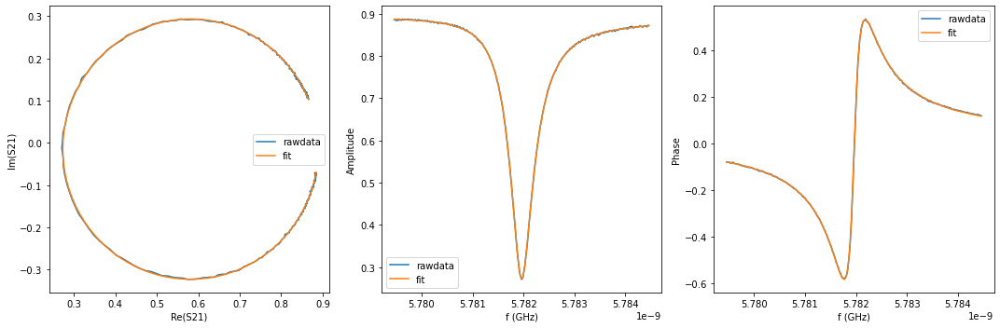

{'Qi_dia_corr': 25110.538228939833, 'Qi_no_corr': 25326.027197042215, 'absQc': 11163.45699218298, 'Qc_dia_corr(Re{Qc})': 11205.845221391151, 'Ql': 7748.1505063456625, 'fr': 5.781940038499696, 'theta0': -3.0545860539794836, 'phi0': 0.08700662451251709, 'phi0_err': 0.0007476041936163088, 'Ql_err': 7.5271621928636625, 'absQc_err': 7.99755270220465, 'fr_err': 3.788276995128233e-07, 'chi_square': 4.8865569245602614e-06, 'Qi_no_corr_err': 58.2526764537975, 'Qi_dia_corr_err': 57.570865132080634, 'delay': 0.21372490515963985, 'a': 0.8880283660595546, 'alpha': 1.5023962144794267}


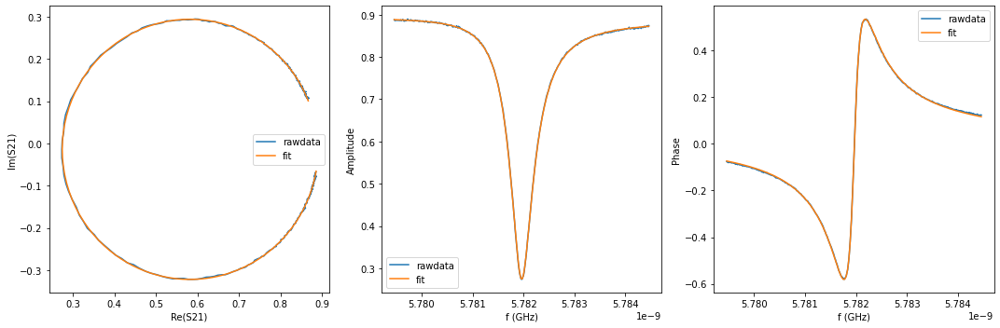

{'Qi_dia_corr': 24850.950895309903, 'Qi_no_corr': 25063.51253680627, 'absQc': 11082.192253350164, 'Qc_dia_corr(Re{Qc})': 11124.264619736836, 'Ql': 7684.416892398823, 'fr': 5.781940299360635, 'theta0': -3.0545937842271385, 'phi0': 0.08699910475638743, 'phi0_err': 0.0013465072138937914, 'Ql_err': 10.955501888303562, 'absQc_err': 10.216330121916087, 'fr_err': 5.758900588075203e-07, 'chi_square': 1.0511019008897717e-05, 'Qi_no_corr_err': 86.77139604893856, 'Qi_dia_corr_err': 85.63252111134771, 'delay': 0.50733029175534, 'a': 0.8893467095506207, 'alpha': -0.39658971101137325}


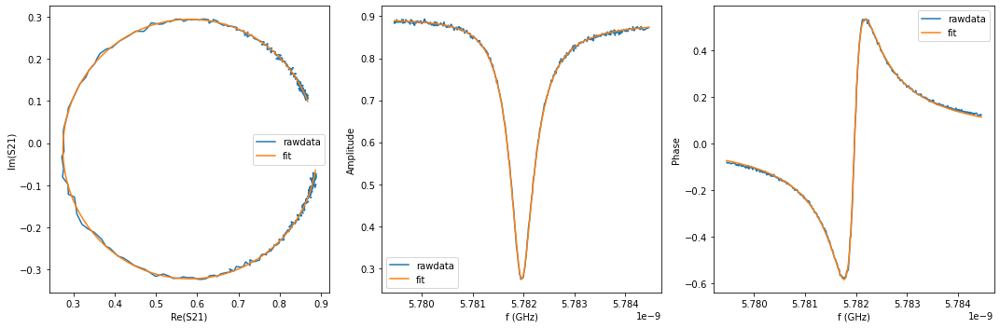

{'Qi_dia_corr': 24812.016496959288, 'Qi_no_corr': 25019.117305624848, 'absQc': 11036.133968666489, 'Qc_dia_corr(Re{Qc})': 11076.917387606085, 'Ql': 7658.089199326623, 'fr': 5.78194090250815, 'theta0': -3.055754546925918, 'phi0': 0.08583821836725707, 'phi0_err': 0.0022986813360783387, 'Ql_err': 22.7590753416174, 'absQc_err': 22.26086217230488, 'fr_err': 1.0730729850200299e-06, 'chi_square': 4.183108138735177e-05, 'Qi_no_corr_err': 181.37109861261962, 'Qi_dia_corr_err': 180.06359798703622, 'delay': 0.6458009465757548, 'a': 0.8905650751566985, 'alpha': -1.6498921105948734}


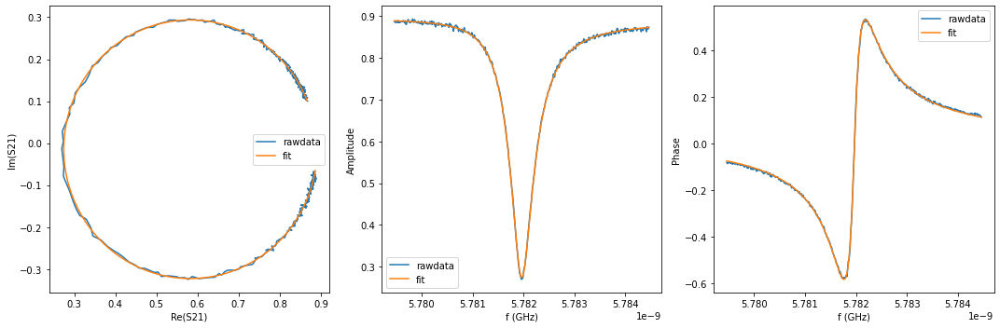

{'Qi_dia_corr': 24809.712374016326, 'Qi_no_corr': 25030.145693565348, 'absQc': 11042.077534664699, 'Qc_dia_corr(Re{Qc})': 11085.528489914333, 'Ql': 7661.984339130062, 'fr': 5.781940786735894, 'theta0': -3.0530243312350227, 'phi0': 0.0885683223547704, 'phi0_err': 0.002055689191905983, 'Ql_err': 18.949276862687704, 'absQc_err': 19.791630706598788, 'fr_err': 1.0170215904810753e-06, 'chi_square': 3.3756009124738705e-05, 'Qi_no_corr_err': 144.46989522436368, 'Qi_dia_corr_err': 142.68037741463414, 'delay': 0.5782296423956435, 'a': 0.8898383332650942, 'alpha': 2.179126653996721}


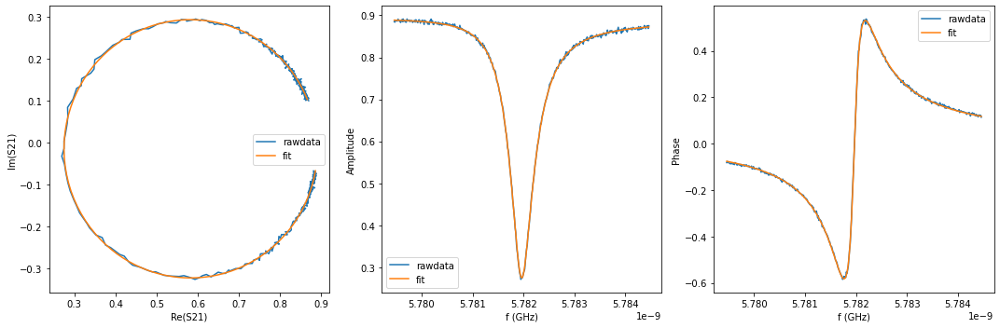

{'Qi_dia_corr': 24924.181896217357, 'Qi_no_corr': 25156.356551797307, 'absQc': 11137.71168991562, 'Qc_dia_corr(Re{Qc})': 11183.836323640047, 'Ql': 7719.8357752747415, 'fr': 5.781939685188374, 'theta0': -3.050740456640447, 'phi0': 0.09085219730354846, 'phi0_err': 0.0017406410198851719, 'Ql_err': 18.63387864160034, 'absQc_err': 19.21907685978258, 'fr_err': 8.458293710025109e-07, 'chi_square': 2.746732269876971e-05, 'Qi_no_corr_err': 141.0317860376798, 'Qi_dia_corr_err': 138.4701884931479, 'delay': 0.3506268518511263, 'a': 0.889279107597818, 'alpha': 0.19389423781059098}


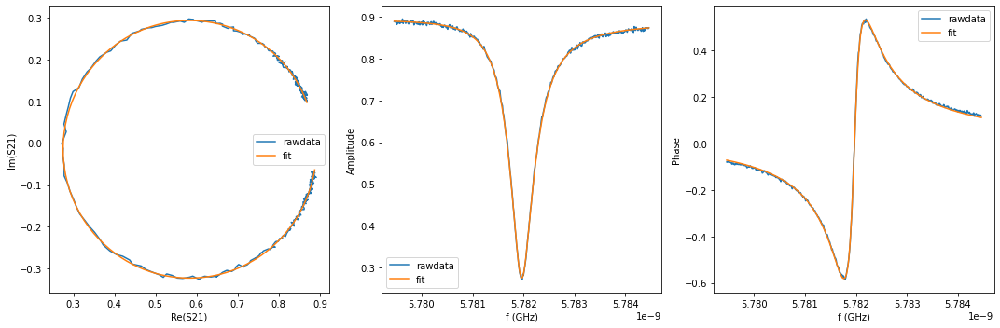

{'Qi_dia_corr': 24645.078061780496, 'Qi_no_corr': 24856.527840580824, 'absQc': 11002.413598949153, 'Qc_dia_corr(Re{Qc})': 11044.357129365611, 'Ql': 7626.599920609629, 'fr': 5.781940776804691, 'theta0': -3.054413326086451, 'phi0': 0.08717958728912815, 'phi0_err': 0.0021827577950550136, 'Ql_err': 20.817451621044942, 'absQc_err': 21.271009994203254, 'fr_err': 1.0691026442871526e-06, 'chi_square': 3.8716535167477384e-05, 'Qi_no_corr_err': 162.26885377342026, 'Qi_dia_corr_err': 159.91431804151387, 'delay': 0.7601442537315319, 'a': 0.8908645943138365, 'alpha': 2.503916346559969}


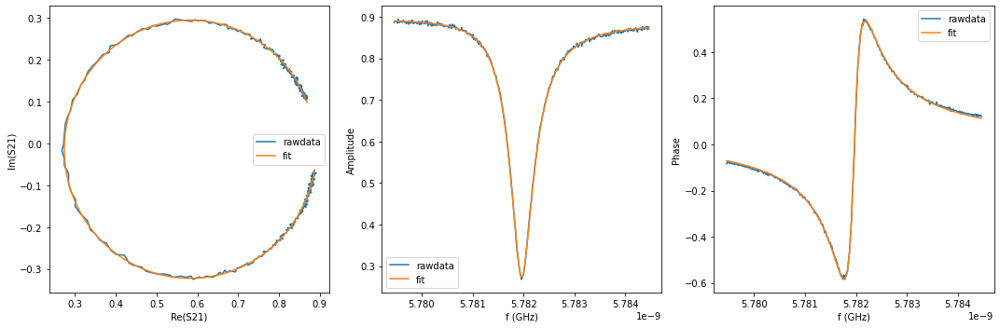

{'Qi_dia_corr': 24811.60785641357, 'Qi_no_corr': 25023.051398988668, 'absQc': 10997.041130382124, 'Qc_dia_corr(Re{Qc})': 11038.3820870223, 'Ql': 7639.611842139574, 'fr': 5.781940944969458, 'theta0': -3.055016789858159, 'phi0': 0.08657413957305259, 'phi0_err': 0.002349564987855265, 'Ql_err': 20.62563632435881, 'absQc_err': 20.816698196915386, 'fr_err': 1.1301446171853706e-06, 'chi_square': 4.036185752922594e-05, 'Qi_no_corr_err': 166.06537396872588, 'Qi_dia_corr_err': 163.3178361365086, 'delay': 0.750298721349438, 'a': 0.8907301152228592, 'alpha': 2.147123318757639}


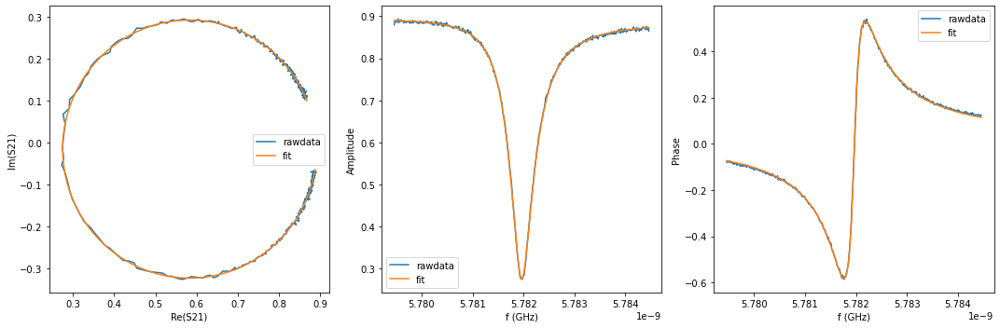

{'Qi_dia_corr': 24765.779361041103, 'Qi_no_corr': 24997.097597909957, 'absQc': 11064.669946945676, 'Qc_dia_corr(Re{Qc})': 11110.60502521994, 'Ql': 7669.747030797393, 'fr': 5.781939047020446, 'theta0': -3.0506289605946812, 'phi0': 0.09096369937080019, 'phi0_err': 0.0020118881452873285, 'Ql_err': 19.844723658318998, 'absQc_err': 18.918081807085827, 'fr_err': 9.53017052713771e-07, 'chi_square': 3.132292821538394e-05, 'Qi_no_corr_err': 164.70278530978734, 'Qi_dia_corr_err': 162.33819286576872, 'delay': 0.5948282876327484, 'a': 0.8902902208692776, 'alpha': 2.78242642512321}


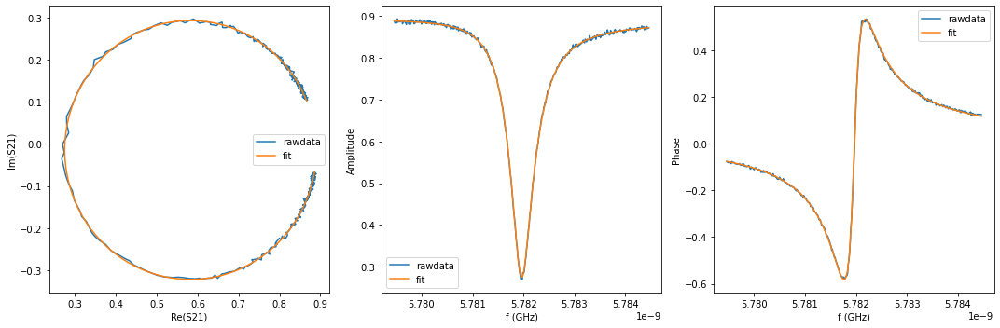

{'Qi_dia_corr': 25014.911422096862, 'Qi_no_corr': 25237.5210582421, 'absQc': 11180.452394871632, 'Qc_dia_corr(Re{Qc})': 11224.704362312097, 'Ql': 7748.012203905895, 'fr': 5.781940516975093, 'theta0': -3.052767367137382, 'phi0': 0.08882528645241089, 'phi0_err': 0.0016984626179272606, 'Ql_err': 18.012312748540193, 'absQc_err': 18.518787941157328, 'fr_err': 8.33142035847332e-07, 'chi_square': 2.5711435895437263e-05, 'Qi_no_corr_err': 140.0459732961633, 'Qi_dia_corr_err': 137.75294076938815, 'delay': 0.3402580859827899, 'a': 0.889034016663322, 'alpha': -0.1830377389183759}


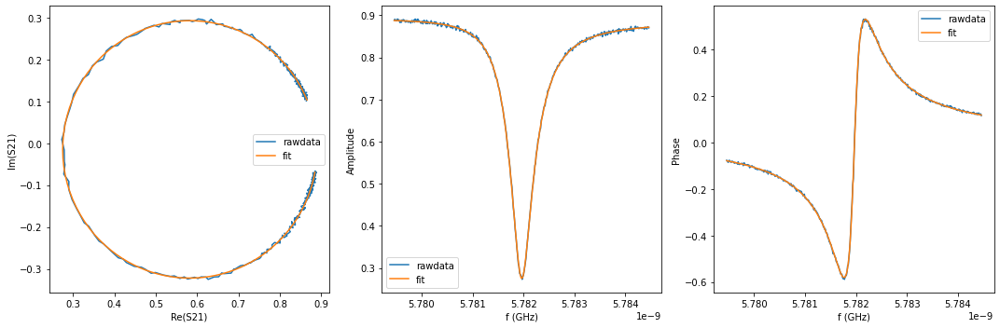

{'Qi_dia_corr': 25044.716388771307, 'Qi_no_corr': 25265.692339548248, 'absQc': 11218.294252562844, 'Qc_dia_corr(Re{Qc})': 11262.416344486835, 'Ql': 7768.83223669046, 'fr': 5.78194068960763, 'theta0': -3.05304658492372, 'phi0': 0.08854603982726031, 'phi0_err': 0.0015801164173119401, 'Ql_err': 16.290764533774798, 'absQc_err': 16.99072080784888, 'fr_err': 7.747804796079869e-07, 'chi_square': 2.180324903251618e-05, 'Qi_no_corr_err': 126.43642332705303, 'Qi_dia_corr_err': 124.52225281671485, 'delay': 0.2016919588641186, 'a': 0.888560215934651, 'alpha': 1.065820738583137}


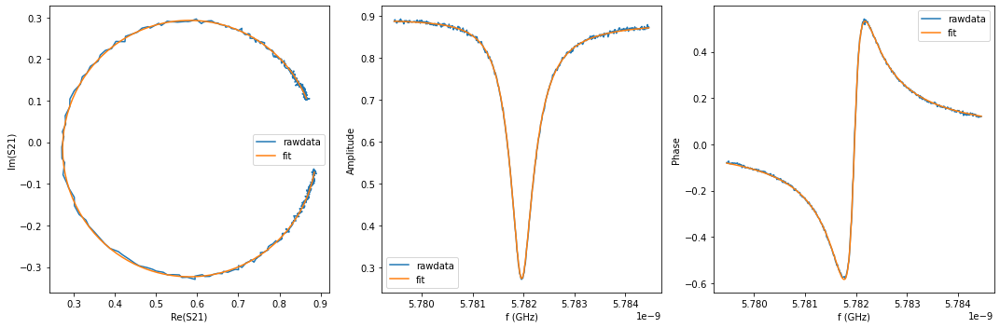

{'Qi_dia_corr': 25362.858565571467, 'Qi_no_corr': 25593.299053139606, 'absQc': 11277.316611967417, 'Qc_dia_corr(Re{Qc})': 11322.646855249515, 'Ql': 7828.015110693255, 'fr': 5.78193964016095, 'theta0': -3.052081374323308, 'phi0': 0.08951174831413079, 'phi0_err': 0.0017491872984400664, 'Ql_err': 17.740885466281792, 'absQc_err': 18.412172457512657, 'fr_err': 8.52574198578994e-07, 'chi_square': 2.5932401927069133e-05, 'Qi_no_corr_err': 136.78203152622206, 'Qi_dia_corr_err': 134.95555502804777, 'delay': -0.02292454570945366, 'a': 0.8882113563156266, 'alpha': -0.8114808012639602}


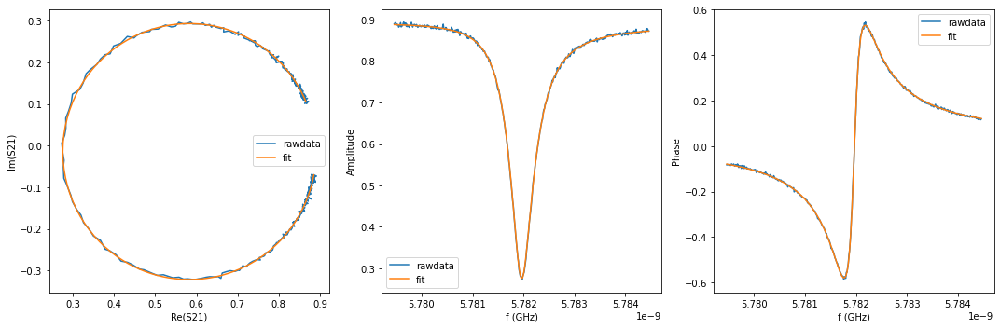

{'Qi_dia_corr': 25068.582939180527, 'Qi_no_corr': 25286.48737164535, 'absQc': 11254.617345709232, 'Qc_dia_corr(Re{Qc})': 11298.328543580063, 'Ql': 7788.208418609088, 'fr': 5.78194062449283, 'theta0': -3.0536013457427886, 'phi0': 0.08799223904641328, 'phi0_err': 0.001564523645790541, 'Ql_err': 17.27276413324275, 'absQc_err': 18.775870178489352, 'fr_err': 7.921931921470718e-07, 'chi_square': 2.339742980465403e-05, 'Qi_no_corr_err': 126.12224117812929, 'Qi_dia_corr_err': 124.54949313383226, 'delay': 0.07708577084775144, 'a': 0.8888604277752852, 'alpha': 2.8227358657365054}


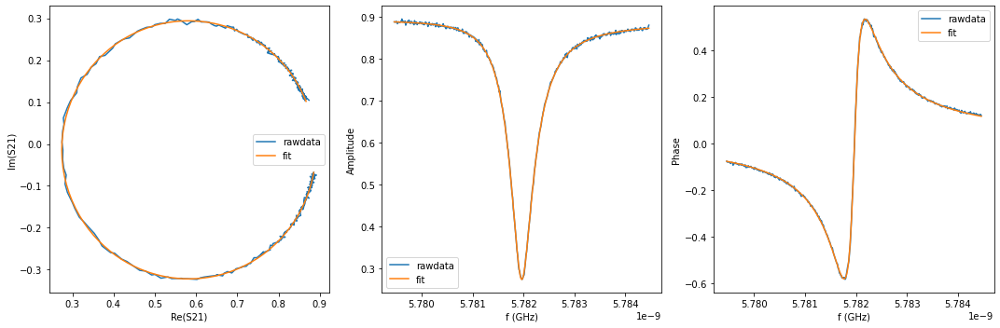

{'Qi_dia_corr': 25117.591080267917, 'Qi_no_corr': 25325.4530791624, 'absQc': 11185.59324644371, 'Qc_dia_corr(Re{Qc})': 11226.627660046968, 'Ql': 7758.75373165448, 'fr': 5.781941873742971, 'theta0': -3.0560669166235943, 'phi0': 0.08552573696619867, 'phi0_err': 0.001668618417223188, 'Ql_err': 15.735887307247658, 'absQc_err': 17.06672580696072, 'fr_err': 8.420419131749637e-07, 'chi_square': 2.2857552299620658e-05, 'Qi_no_corr_err': 122.00653959162861, 'Qi_dia_corr_err': 120.10451455855117, 'delay': 0.3323589741421365, 'a': 0.8892576762220437, 'alpha': -0.4706973818940336}


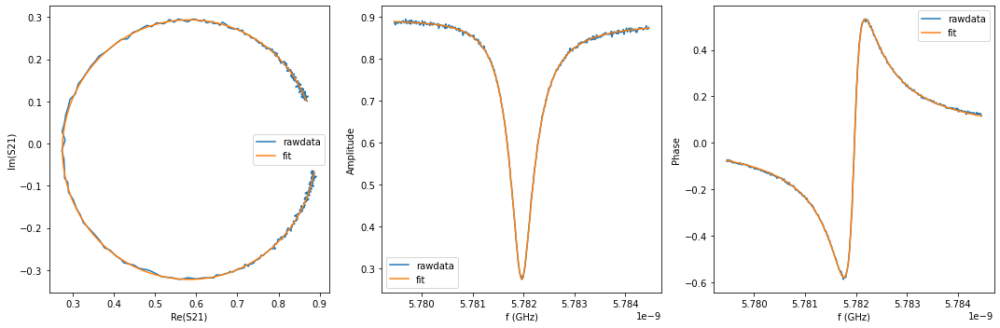

{'Qi_dia_corr': 24922.04836560657, 'Qi_no_corr': 25132.962095799685, 'absQc': 11134.340465615489, 'Qc_dia_corr(Re{Qc})': 11176.242756297765, 'Ql': 7716.0124166985515, 'fr': 5.7819409555189365, 'theta0': -3.0549726317230763, 'phi0': 0.08662071211046654, 'phi0_err': 0.001692099770039271, 'Ql_err': 16.12185576176047, 'absQc_err': 16.98630433540242, 'fr_err': 8.379888319318123e-07, 'chi_square': 2.347715375108303e-05, 'Qi_no_corr_err': 122.92194414278829, 'Qi_dia_corr_err': 120.68136808477837, 'delay': 0.4245918051282959, 'a': 0.8900999158255429, 'alpha': 2.8799207164302314}


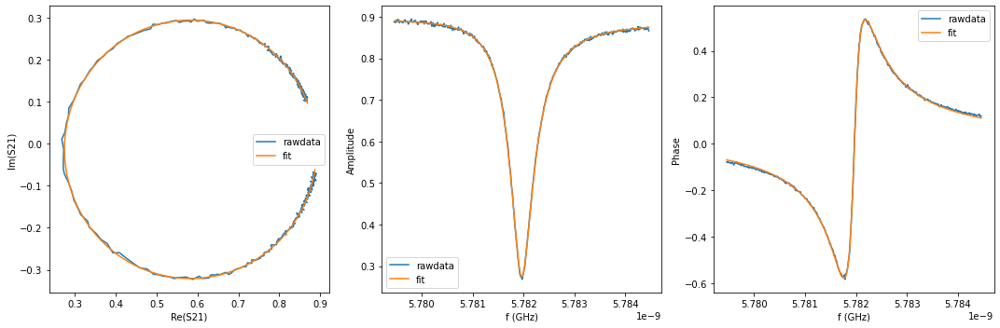

{'Qi_dia_corr': 24785.93492633305, 'Qi_no_corr': 24981.053254255494, 'absQc': 11035.715834823337, 'Qc_dia_corr(Re{Qc})': 11074.227826419792, 'Ql': 7654.318028547055, 'fr': 5.7819418456444724, 'theta0': -3.0581703693502496, 'phi0': 0.08342230773418713, 'phi0_err': 0.0022721682474637767, 'Ql_err': 20.410025828525782, 'absQc_err': 20.062474987352957, 'fr_err': 1.075532091044028e-06, 'chi_square': 3.715315433673983e-05, 'Qi_no_corr_err': 162.66756325169837, 'Qi_dia_corr_err': 161.22974576465847, 'delay': 0.8344565526706137, 'a': 0.8910501470318829, 'alpha': -1.0787972498250866}


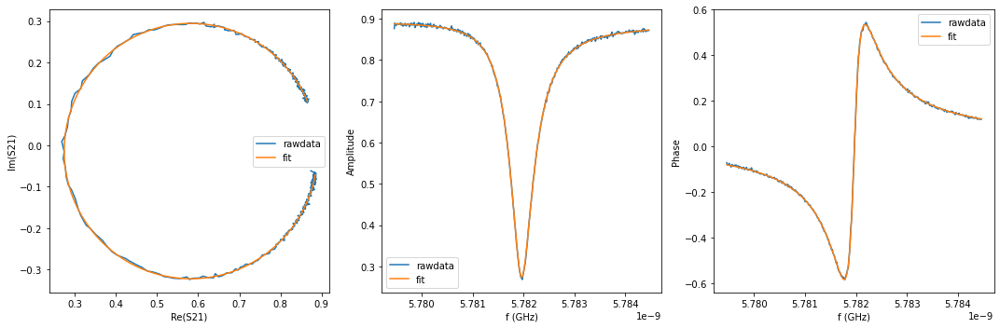

{'Qi_dia_corr': 25326.67586440789, 'Qi_no_corr': 25539.735939988383, 'absQc': 11270.897215737785, 'Qc_dia_corr(Re{Qc})': 11312.896295731525, 'Ql': 7819.907293605332, 'fr': 5.781940664824437, 'theta0': -3.055399169969886, 'phi0': 0.0861950715750107, 'phi0_err': 0.0014829472815636457, 'Ql_err': 15.492033936522251, 'absQc_err': 16.899121855797873, 'fr_err': 7.537440401301683e-07, 'chi_square': 2.0169796302707827e-05, 'Qi_no_corr_err': 117.2837642302119, 'Qi_dia_corr_err': 115.87238000982485, 'delay': 0.04224208150199777, 'a': 0.8887427610469752, 'alpha': 1.55665937250962}


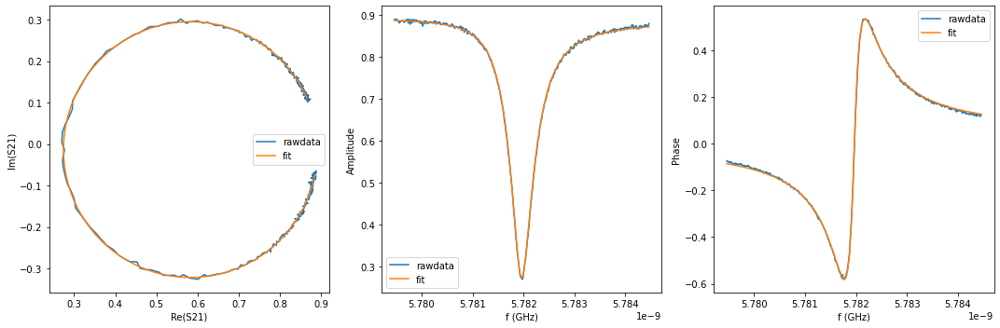

{'Qi_dia_corr': 25553.93439193286, 'Qi_no_corr': 25764.075368902864, 'absQc': 11416.021259017396, 'Qc_dia_corr(Re{Qc})': 11457.770954849382, 'Ql': 7910.771052419771, 'fr': 5.781941349941014, 'theta0': -3.05619940239283, 'phi0': 0.08539325119696309, 'phi0_err': 0.0023067163264169754, 'Ql_err': 21.215946752158704, 'absQc_err': 20.245393962512935, 'fr_err': 1.0358455403710825e-06, 'chi_square': 3.546951332462903e-05, 'Qi_no_corr_err': 174.8472002429964, 'Qi_dia_corr_err': 172.84993966024896, 'delay': -0.40006711071344514, 'a': 0.8880967458806021, 'alpha': -1.9456523815629843}


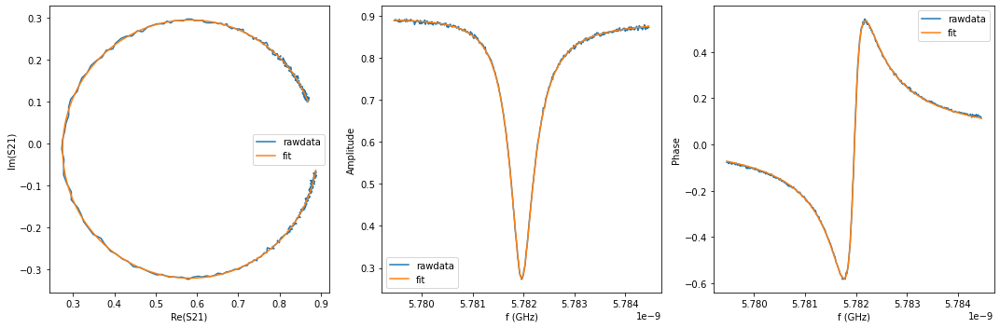

{'Qi_dia_corr': 24888.104032068033, 'Qi_no_corr': 25089.545603011436, 'absQc': 11079.155003767133, 'Qc_dia_corr(Re{Qc})': 11118.895453306313, 'Ql': 7685.400914230018, 'fr': 5.781941393754119, 'theta0': -3.057021031765515, 'phi0': 0.08457266175556281, 'phi0_err': 0.0018343113427884915, 'Ql_err': 15.8716332972799, 'absQc_err': 16.760336241148504, 'fr_err': 9.163395953307324e-07, 'chi_square': 2.4839670625195205e-05, 'Qi_no_corr_err': 126.11821892650855, 'Qi_dia_corr_err': 124.00841238462692, 'delay': 0.6405838107304194, 'a': 0.891243964690424, 'alpha': -1.8387578625282317}


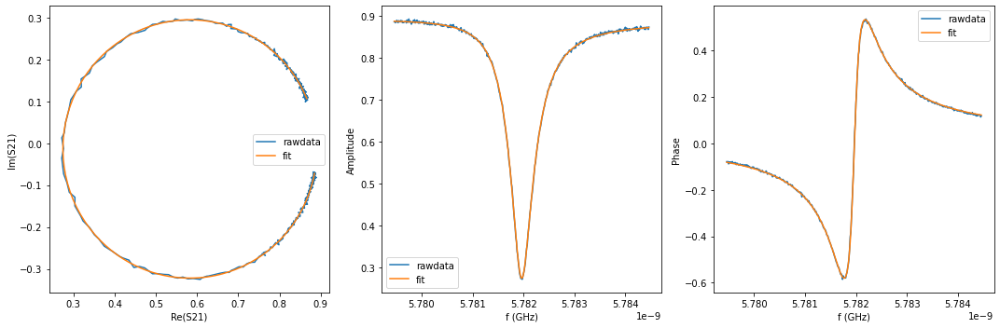

{'Qi_dia_corr': 25279.31064742386, 'Qi_no_corr': 25490.465878509396, 'absQc': 11286.733811084594, 'Qc_dia_corr(Re{Qc})': 11328.632905062625, 'Ql': 7822.893138127515, 'fr': 5.781941199106068, 'theta0': -3.055560608578924, 'phi0': 0.08603249269020144, 'phi0_err': 0.001587017484819533, 'Ql_err': 15.62674320981327, 'absQc_err': 16.165258681425744, 'fr_err': 7.667842012519901e-07, 'chi_square': 2.0534873463671743e-05, 'Qi_no_corr_err': 123.27929063100876, 'Qi_dia_corr_err': 121.70821616021667, 'delay': -0.05206306430625808, 'a': 0.8890413563215039, 'alpha': -1.8694250947271653}


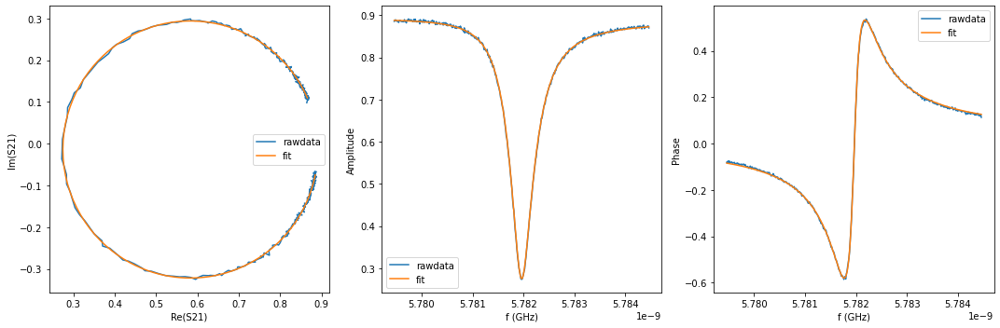

{'Qi_dia_corr': 25401.538800682847, 'Qi_no_corr': 25618.95873107529, 'absQc': 11375.897508592863, 'Qc_dia_corr(Re{Qc})': 11419.298830809834, 'Ql': 7877.815416108697, 'fr': 5.781940465195404, 'theta0': -3.054379119700395, 'phi0': 0.08721363879512246, 'phi0_err': 0.001990378740077272, 'Ql_err': 18.376056845380496, 'absQc_err': 18.348927349742073, 'fr_err': 9.323367433509533e-07, 'chi_square': 2.8044108367945434e-05, 'Qi_no_corr_err': 152.3093118938355, 'Qi_dia_corr_err': 150.36379474427872, 'delay': -0.31912473193197655, 'a': 0.8886274753253345, 'alpha': 0.9950750841193362}


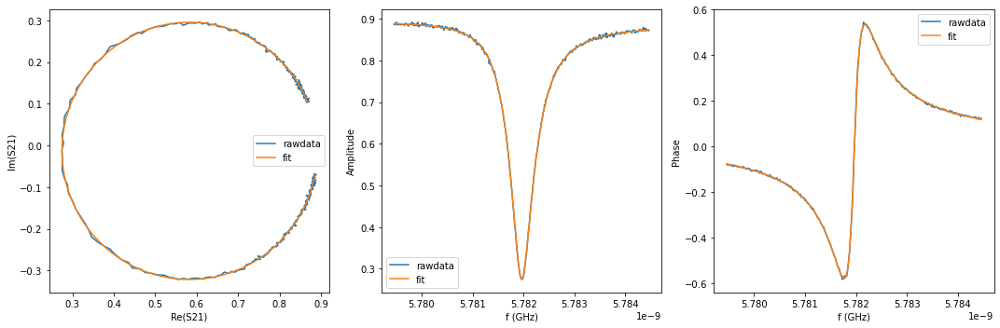

{'Qi_dia_corr': 25182.078015777966, 'Qi_no_corr': 25379.23786473746, 'absQc': 11226.318274441815, 'Qc_dia_corr(Re{Qc})': 11265.333104909483, 'Ql': 7783.392246494519, 'fr': 5.781942134569022, 'theta0': -3.0583428155742514, 'phi0': 0.08324981178635636, 'phi0_err': 0.0013321758014510526, 'Ql_err': 13.876140283423737, 'absQc_err': 15.271285944898603, 'fr_err': 6.797805665360492e-07, 'chi_square': 1.6367789567054314e-05, 'Qi_no_corr_err': 106.56498790367944, 'Qi_dia_corr_err': 105.63789136031585, 'delay': 0.19034036723731523, 'a': 0.8900497754917397, 'alpha': 0.6539289421361772}


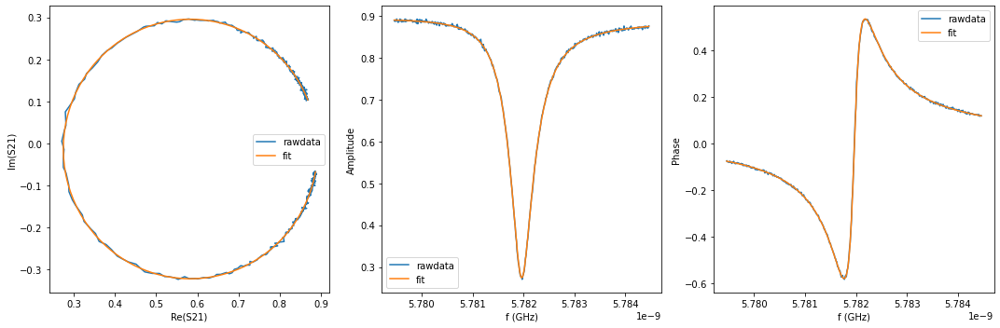

{'Qi_dia_corr': 25144.818286620426, 'Qi_no_corr': 25352.115290138674, 'absQc': 11190.601780130575, 'Qc_dia_corr(Re{Qc})': 11231.47327208352, 'Ql': 7763.665354996851, 'fr': 5.78194132629994, 'theta0': -3.0562559773584392, 'phi0': 0.08533725475468057, 'phi0_err': 0.0014246013395847557, 'Ql_err': 14.14279130266703, 'absQc_err': 14.997263212032964, 'fr_err': 7.129685469837868e-07, 'chi_square': 1.7371563819664137e-05, 'Qi_no_corr_err': 109.03457660342164, 'Qi_dia_corr_err': 107.61385022627424, 'delay': 0.2786106512170809, 'a': 0.8906427116812748, 'alpha': -2.422027735061453}


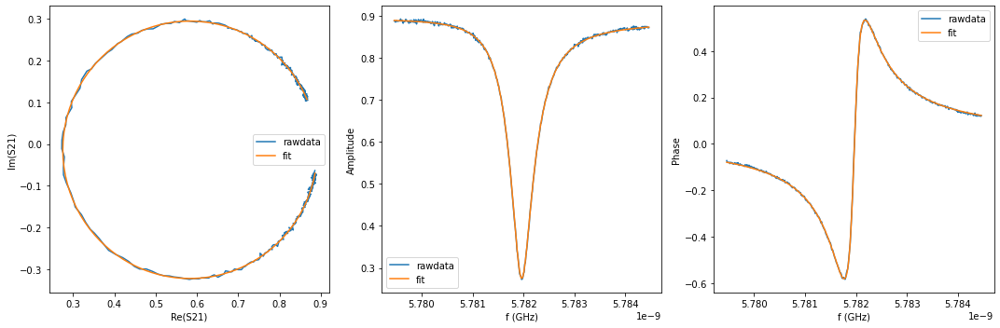

{'Qi_dia_corr': 25209.108556430238, 'Qi_no_corr': 25433.416450064815, 'absQc': 11273.696112901041, 'Qc_dia_corr(Re{Qc})': 11318.336844663034, 'Ql': 7811.254771920477, 'fr': 5.781940280314976, 'theta0': -3.0527478179492764, 'phi0': 0.08884483564051675, 'phi0_err': 0.001457225871270989, 'Ql_err': 14.916589256564317, 'absQc_err': 15.507174852253524, 'fr_err': 7.107881247499562e-07, 'chi_square': 1.8175016324377886e-05, 'Qi_no_corr_err': 114.55052049985896, 'Qi_dia_corr_err': 113.13958729898008, 'delay': 0.023916254773374276, 'a': 0.8896865109824407, 'alpha': 0.8919450341759639}


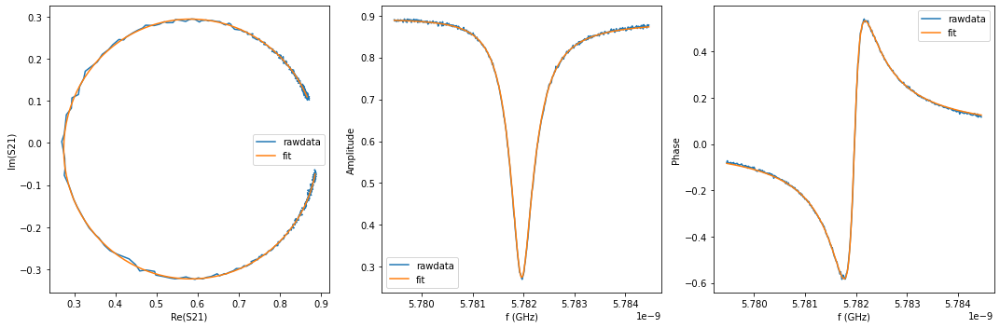

{'Qi_dia_corr': 25431.4397401452, 'Qi_no_corr': 25659.39766332422, 'absQc': 11361.946034471977, 'Qc_dia_corr(Re{Qc})': 11407.222228388617, 'Ql': 7874.9354401499195, 'fr': 5.781940464137545, 'theta0': -3.052466789622508, 'phi0': 0.08912586396728496, 'phi0_err': 0.0019119465006610813, 'Ql_err': 18.99737319282291, 'absQc_err': 18.502921713172253, 'fr_err': 8.896275939228869e-07, 'chi_square': 2.7481816535875007e-05, 'Qi_no_corr_err': 157.7751543235674, 'Qi_dia_corr_err': 154.29222813551638, 'delay': -0.25962091768037654, 'a': 0.8893093514002002, 'alpha': -3.12618623471422}


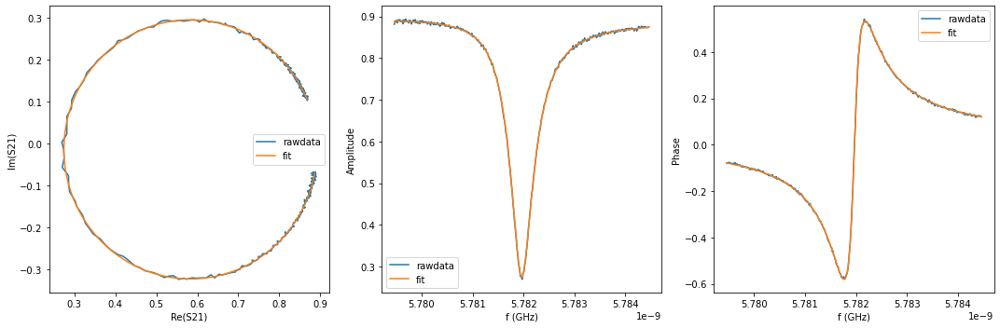

{'Qi_dia_corr': 25175.96557049674, 'Qi_no_corr': 25393.639267050054, 'absQc': 11235.649584743991, 'Qc_dia_corr(Re{Qc})': 11278.797104962616, 'Ql': 7789.232098946289, 'fr': 5.781940356285748, 'theta0': -3.054094261073445, 'phi0': 0.08749839251634815, 'phi0_err': 0.0014426424162826146, 'Ql_err': 14.101859473097038, 'absQc_err': 14.746561452174491, 'fr_err': 7.068068444643495e-07, 'chi_square': 1.71734912716636e-05, 'Qi_no_corr_err': 110.95587980427185, 'Qi_dia_corr_err': 109.41662645069663, 'delay': 0.09418721886488973, 'a': 0.8899458754178143, 'alpha': -2.838963504059608}


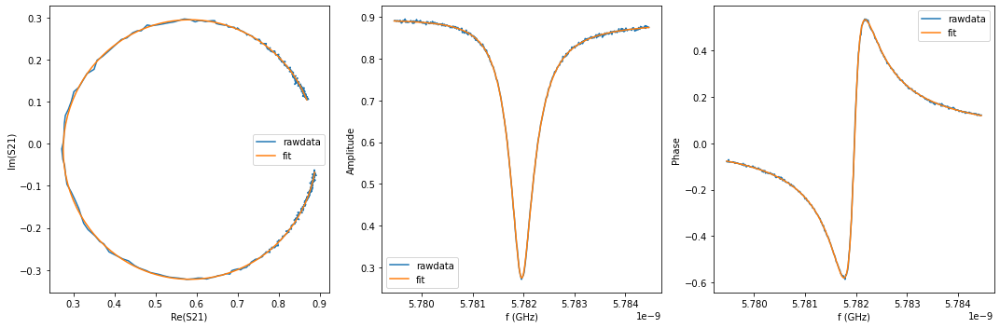

{'Qi_dia_corr': 25079.292083523254, 'Qi_no_corr': 25297.632665791167, 'absQc': 11194.72272992967, 'Qc_dia_corr(Re{Qc})': 11238.018192184529, 'Ql': 7760.529029878741, 'fr': 5.781940428992413, 'theta0': -3.0537853074694974, 'phi0': 0.08780734612029582, 'phi0_err': 0.0013003847954532826, 'Ql_err': 13.537464009685777, 'absQc_err': 14.736931455471897, 'fr_err': 6.632587100892915e-07, 'chi_square': 1.564373560739111e-05, 'Qi_no_corr_err': 101.08522516403617, 'Qi_dia_corr_err': 99.71868548924485, 'delay': 0.2338374700779954, 'a': 0.8908744888521162, 'alpha': 2.234975802862132}


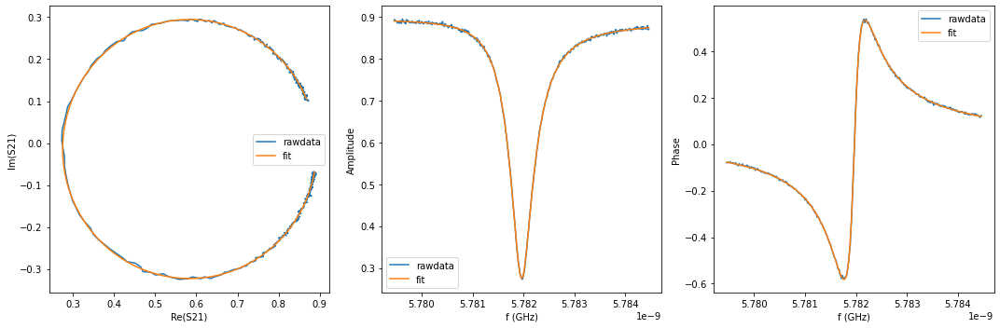

{'Qi_dia_corr': 25154.914738146534, 'Qi_no_corr': 25374.758606397103, 'absQc': 11209.642271127857, 'Qc_dia_corr(Re{Qc})': 11253.088599423725, 'Ql': 7774.952161883748, 'fr': 5.781939834838221, 'theta0': -3.0536913135602544, 'phi0': 0.08790134002953873, 'phi0_err': 0.0013465622427342842, 'Ql_err': 14.036323294813748, 'absQc_err': 14.83922958857129, 'fr_err': 6.661398627156901e-07, 'chi_square': 1.615110250279317e-05, 'Qi_no_corr_err': 105.57323733745537, 'Qi_dia_corr_err': 104.53441959053646, 'delay': 0.21870409010445455, 'a': 0.8908961509599949, 'alpha': 1.6844292430538048}


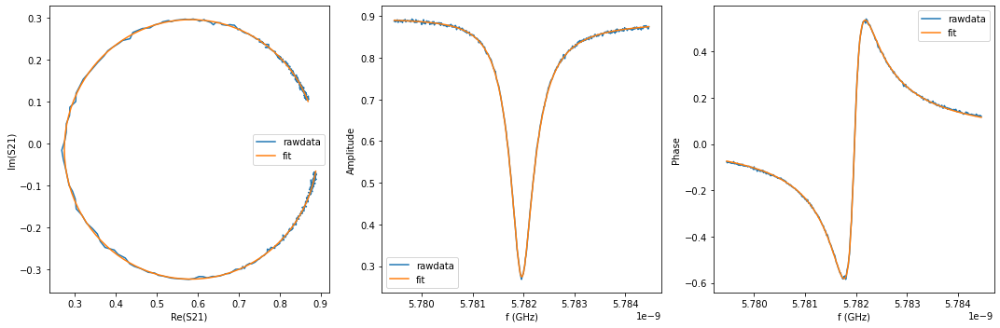

{'Qi_dia_corr': 25098.522070863342, 'Qi_no_corr': 25304.873782237293, 'absQc': 11137.429440357784, 'Qc_dia_corr(Re{Qc})': 11177.877721499108, 'Ql': 7733.628813891366, 'fr': 5.781941810521588, 'theta0': -3.056495231370765, 'phi0': 0.08509742221902795, 'phi0_err': 0.0015221902617387933, 'Ql_err': 14.805181187000601, 'absQc_err': 15.34209369306384, 'fr_err': 7.369741196401732e-07, 'chi_square': 1.910234288039993e-05, 'Qi_no_corr_err': 113.46903015962192, 'Qi_dia_corr_err': 112.13526045074359, 'delay': 0.5043492019428898, 'a': 0.8912967680322654, 'alpha': -0.505221452514882}


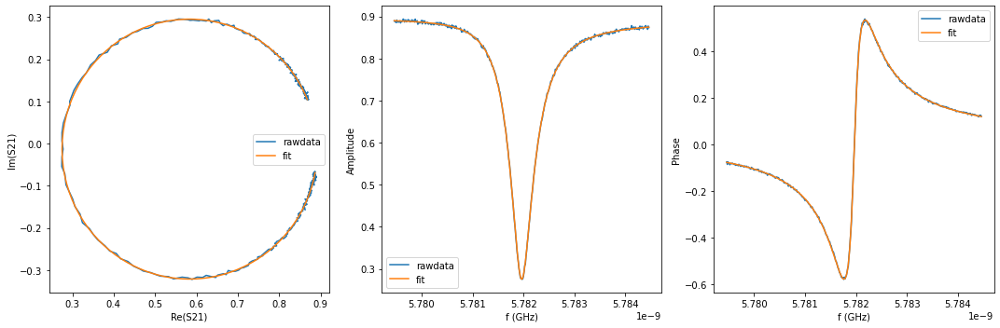

{'Qi_dia_corr': 25017.258814536584, 'Qi_no_corr': 25219.674751552895, 'absQc': 11182.105218397892, 'Qc_dia_corr(Re{Qc})': 11222.365190715276, 'Ql': 7747.12271977997, 'fr': 5.781941060642557, 'theta0': -3.05686222828315, 'phi0': 0.0847304388579987, 'phi0_err': 0.0012866301614799431, 'Ql_err': 13.529369646763431, 'absQc_err': 14.489480168821347, 'fr_err': 6.462627998984614e-07, 'chi_square': 1.5241985613952651e-05, 'Qi_no_corr_err': 100.24668759580273, 'Qi_dia_corr_err': 98.81277089930731, 'delay': 0.21009527621289148, 'a': 0.8907374063186345, 'alpha': 1.3715817285225553}


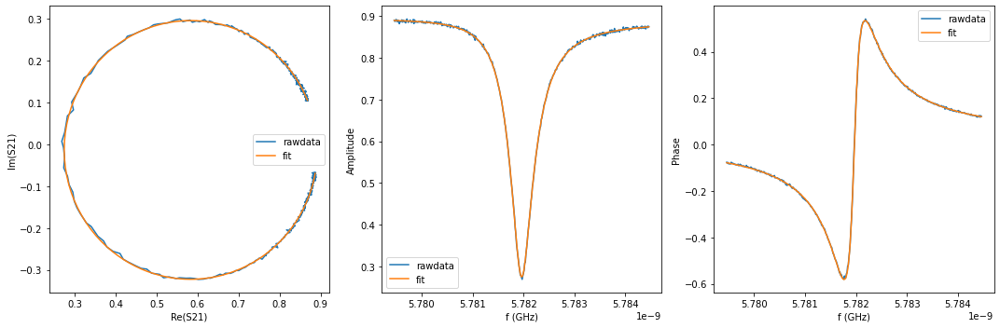

{'Qi_dia_corr': 25269.562222305045, 'Qi_no_corr': 25481.69553148635, 'absQc': 11244.347521472533, 'Qc_dia_corr(Re{Qc})': 11286.155881316763, 'Ql': 7801.68556626745, 'fr': 5.781940746615026, 'theta0': -3.055492136037659, 'phi0': 0.08610090145955998, 'phi0_err': 0.0013078702574544818, 'Ql_err': 14.089455394299659, 'absQc_err': 14.463321171475288, 'fr_err': 6.2354220626785e-07, 'chi_square': 1.5171442368832989e-05, 'Qi_no_corr_err': 106.00405347121792, 'Qi_dia_corr_err': 104.37211511509534, 'delay': 0.13618816999860145, 'a': 0.8907543202596977, 'alpha': -1.3130817052384038}


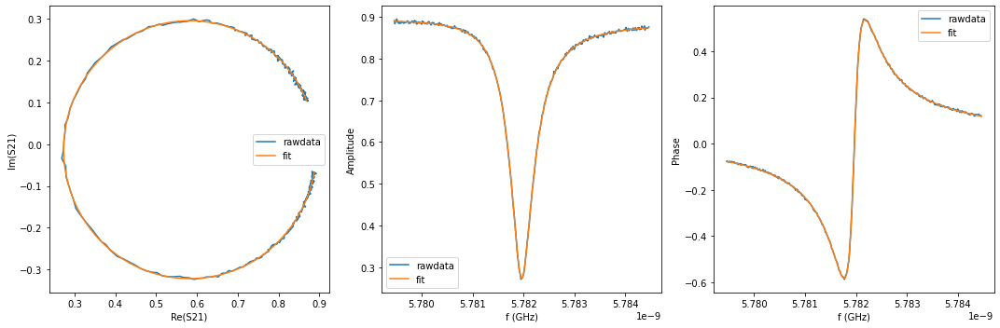

{'Qi_dia_corr': 25343.27590633464, 'Qi_no_corr': 25551.789902826076, 'absQc': 11209.956438617985, 'Qc_dia_corr(Re{Qc})': 11250.566106108616, 'Ql': 7791.644310881984, 'fr': 5.781941076546036, 'theta0': -3.0566017366911944, 'phi0': 0.0849910603981237, 'phi0_err': 0.0013202336285202025, 'Ql_err': 14.148297660919965, 'absQc_err': 14.043616498430335, 'fr_err': 6.348937565405799e-07, 'chi_square': 1.5121902285092602e-05, 'Qi_no_corr_err': 115.45450073051815, 'Qi_dia_corr_err': 113.55017185665699, 'delay': 0.2286779335153953, 'a': 0.8906698820259114, 'alpha': 2.047065761085061}


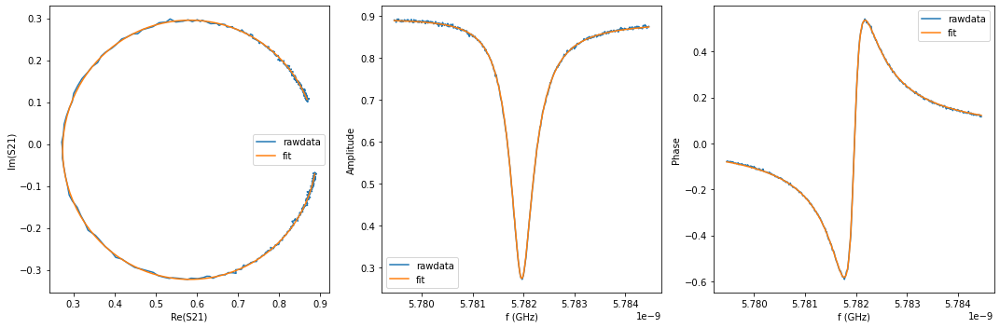

{'Qi_dia_corr': 25423.388476906504, 'Qi_no_corr': 25636.86046815486, 'absQc': 11279.067969027283, 'Qc_dia_corr(Re{Qc})': 11320.889158411039, 'Ql': 7832.930227525908, 'fr': 5.781941502450756, 'theta0': -3.0556108193915175, 'phi0': 0.08598183419827579, 'phi0_err': 0.0013769954283957885, 'Ql_err': 14.05747710367875, 'absQc_err': 14.334538547253295, 'fr_err': 6.579420670901794e-07, 'chi_square': 1.5854448492518444e-05, 'Qi_no_corr_err': 111.39350756054563, 'Qi_dia_corr_err': 110.1563768534544, 'delay': -0.000636211797855335, 'a': 0.8901289870257748, 'alpha': -0.0008539054351553859}


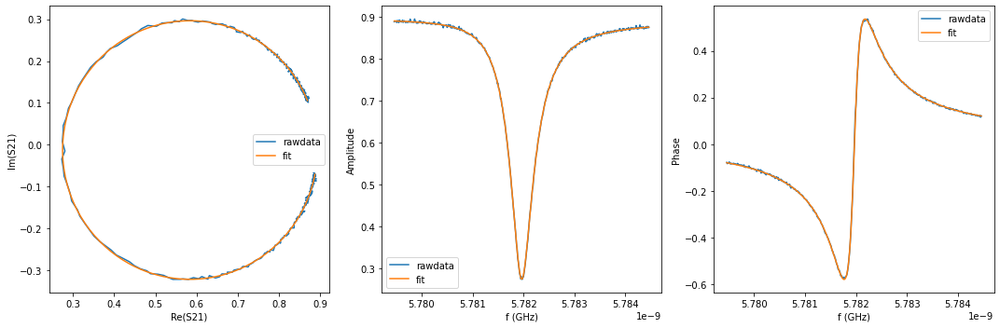

{'Qi_dia_corr': 25236.676416129947, 'Qi_no_corr': 25429.512990088493, 'absQc': 11237.726961645023, 'Qc_dia_corr(Re{Qc})': 11275.802419829208, 'Ql': 7793.603339831131, 'fr': 5.7819426041545485, 'theta0': -3.059391283969811, 'phi0': 0.08220270753785117, 'phi0_err': 0.001210646949382765, 'Ql_err': 12.861277946870802, 'absQc_err': 13.94276227675431, 'fr_err': 6.121315195652577e-07, 'chi_square': 1.3688097762931622e-05, 'Qi_no_corr_err': 97.39496328240801, 'Qi_dia_corr_err': 96.07860168194267, 'delay': 0.08774047539702202, 'a': 0.8909786839539584, 'alpha': -3.0736168871906946}


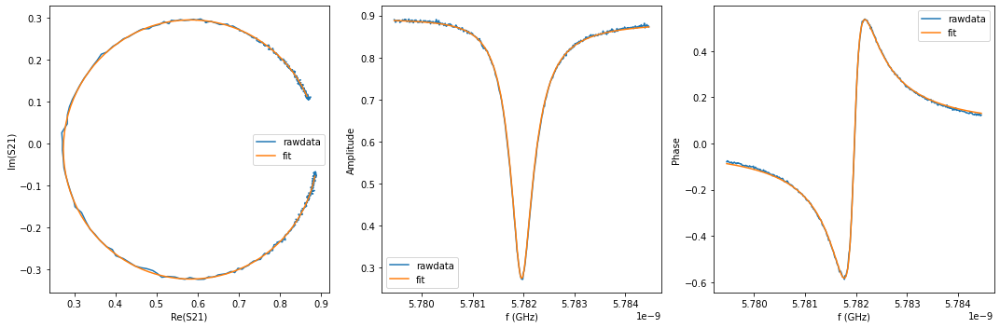

{'Qi_dia_corr': 25799.401177143092, 'Qi_no_corr': 26022.135943283138, 'absQc': 11473.708343307713, 'Qc_dia_corr(Re{Qc})': 11517.551256431634, 'Ql': 7962.759712811937, 'fr': 5.781940110987089, 'theta0': -3.0543110966193403, 'phi0': 0.08728155697045269, 'phi0_err': 0.0027835688000965035, 'Ql_err': 26.40751160884648, 'absQc_err': 20.64894411876916, 'fr_err': 1.1757496132864438e-06, 'chi_square': 4.073821367192634e-05, 'Qi_no_corr_err': 242.1562677174126, 'Qi_dia_corr_err': 238.98520865806708, 'delay': -0.6040890247692118, 'a': 0.888749480925216, 'alpha': -3.0735523799189997}


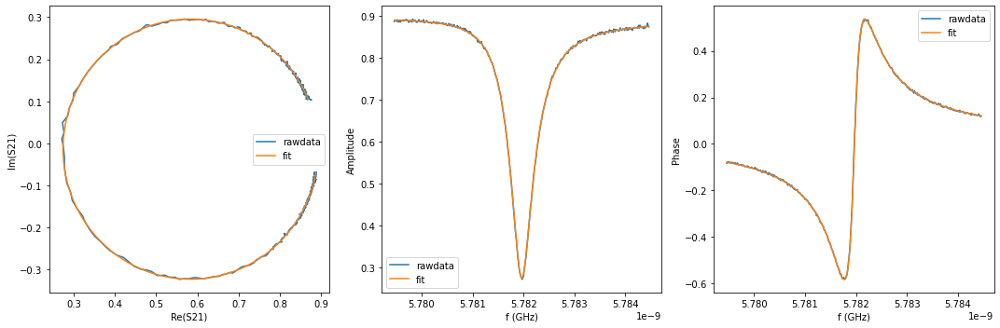

{'Qi_dia_corr': 25278.315086913084, 'Qi_no_corr': 25492.2818886159, 'absQc': 11235.680876653689, 'Qc_dia_corr(Re{Qc})': 11277.75466309739, 'Ql': 7798.503444057945, 'fr': 5.78194113905013, 'theta0': -3.0551865172263994, 'phi0': 0.0864061363633936, 'phi0_err': 0.0012885168847160998, 'Ql_err': 13.408630690881132, 'absQc_err': 12.58251387285711, 'fr_err': 5.839240593990957e-07, 'chi_square': 1.2922632882165524e-05, 'Qi_no_corr_err': 108.17410823930135, 'Qi_dia_corr_err': 107.18287341208982, 'delay': 0.123500813129757, 'a': 0.8907090191034438, 'alpha': -1.7742490076000306}


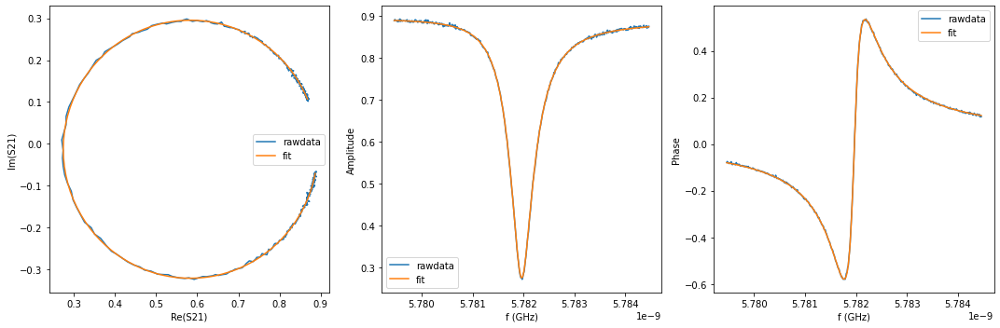

{'Qi_dia_corr': 25198.646990456054, 'Qi_no_corr': 25404.563983719243, 'absQc': 11251.458682793442, 'Qc_dia_corr(Re{Qc})': 11292.32782546207, 'Ql': 7797.856429151783, 'fr': 5.781941180329102, 'theta0': -3.056488257622916, 'phi0': 0.0851044153992366, 'phi0_err': 0.0012687673257219107, 'Ql_err': 13.224061530677305, 'absQc_err': 13.485841307242378, 'fr_err': 6.090593416212524e-07, 'chi_square': 1.3807828746139404e-05, 'Qi_no_corr_err': 102.30310890230481, 'Qi_dia_corr_err': 101.00540804265874, 'delay': 0.005076398561523171, 'a': 0.8903615072294635, 'alpha': 0.20702981147303548}


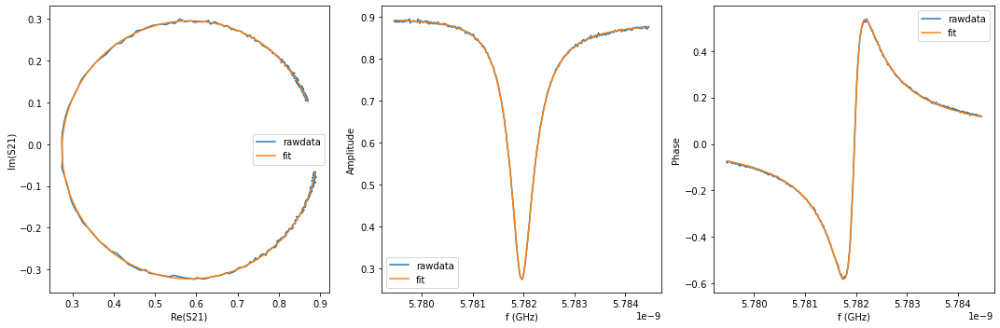

{'Qi_dia_corr': 25007.225388722003, 'Qi_no_corr': 25220.553883475277, 'absQc': 11112.617786675246, 'Qc_dia_corr(Re{Qc})': 11154.545094910589, 'Ql': 7713.787781031, 'fr': 5.781940505112874, 'theta0': -3.0548615805429766, 'phi0': 0.08673086638771389, 'phi0_err': 0.001414945444719774, 'Ql_err': 14.002322438237263, 'absQc_err': 14.038900683733624, 'fr_err': 6.838429895042086e-07, 'chi_square': 1.6341622981771125e-05, 'Qi_no_corr_err': 113.73081599162762, 'Qi_dia_corr_err': 112.13711755026887, 'delay': 0.46077169232551307, 'a': 0.89210376103973, 'alpha': -2.0869247850727515}


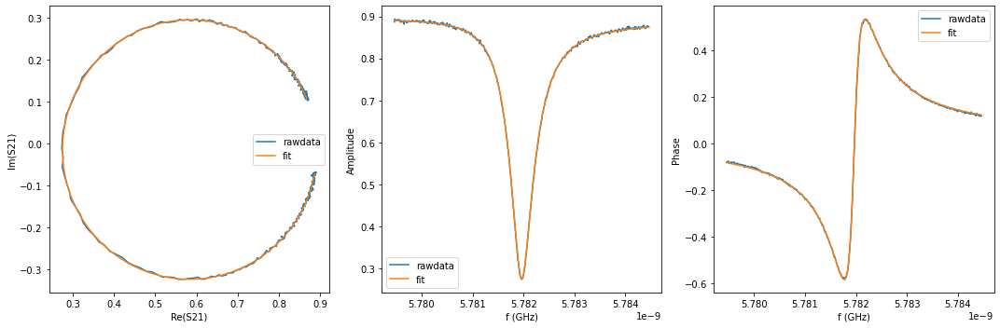

{'Qi_dia_corr': 25317.911106639043, 'Qi_no_corr': 25537.25150841975, 'absQc': 11316.73736204654, 'Qc_dia_corr(Re{Qc})': 11360.351734217838, 'Ql': 7841.7120405902115, 'fr': 5.781940728173536, 'theta0': -3.0539388759400135, 'phi0': 0.0876542470837347, 'phi0_err': 0.0014611639868844734, 'Ql_err': 14.816768807641624, 'absQc_err': 15.335979744235875, 'fr_err': 7.087828152064674e-07, 'chi_square': 1.7797097683449724e-05, 'Qi_no_corr_err': 117.79179300255117, 'Qi_dia_corr_err': 116.4596026236263, 'delay': -0.10726760398831334, 'a': 0.890608874789784, 'alpha': 2.407778606962691}


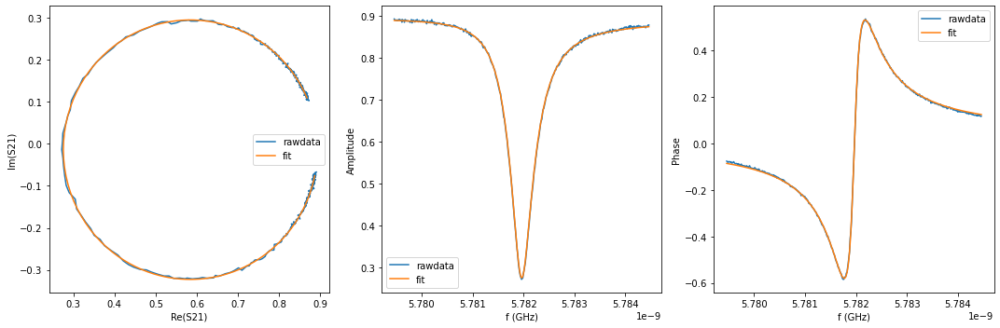

{'Qi_dia_corr': 25419.75959023715, 'Qi_no_corr': 25628.73346542267, 'absQc': 11397.789012319034, 'Qc_dia_corr(Re{Qc})': 11439.612992355205, 'Ql': 7889.2339097588365, 'fr': 5.781941569903767, 'theta0': -3.0560555742522606, 'phi0': 0.08553707933753261, 'phi0_err': 0.0020142416433006193, 'Ql_err': 18.106840329357425, 'absQc_err': 17.78752978246359, 'fr_err': 9.371766152761492e-07, 'chi_square': 2.696788647890436e-05, 'Qi_no_corr_err': 153.90003520282394, 'Qi_dia_corr_err': 152.302674166536, 'delay': -0.33482874235849835, 'a': 0.8903810345422589, 'alpha': 0.42355949366712375}


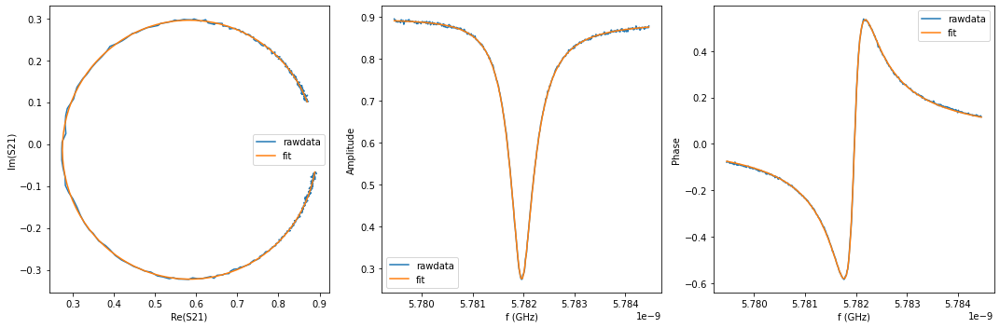

{'Qi_dia_corr': 25019.8210829208, 'Qi_no_corr': 25216.474309654215, 'absQc': 11127.256444824709, 'Qc_dia_corr(Re{Qc})': 11165.98377891603, 'Ql': 7720.45605811333, 'fr': 5.781942217583941, 'theta0': -3.058281063830881, 'phi0': 0.0833107234074713, 'phi0_err': 0.0014382684176285569, 'Ql_err': 13.419446696733756, 'absQc_err': 13.645410221980825, 'fr_err': 6.966826770445614e-07, 'chi_square': 1.600933574856199e-05, 'Qi_no_corr_err': 107.70186316748236, 'Qi_dia_corr_err': 106.18909828180725, 'delay': 0.4759636940498596, 'a': 0.8922510042249925, 'alpha': -1.5367064932280394}


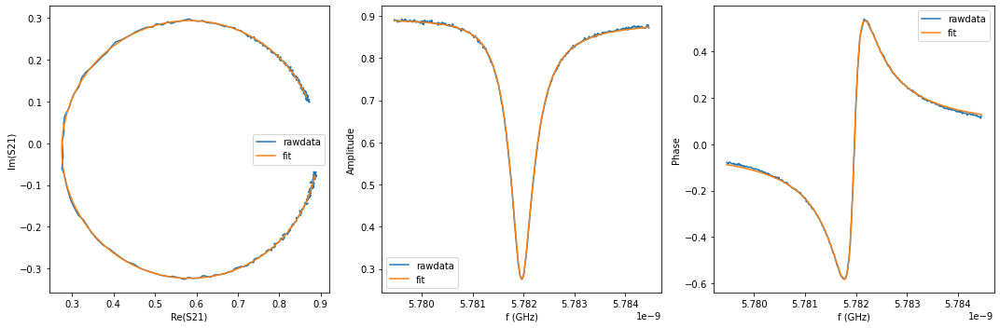

{'Qi_dia_corr': 25672.75971754813, 'Qi_no_corr': 25902.69882830437, 'absQc': 11477.850874586853, 'Qc_dia_corr(Re{Qc})': 11523.585326116283, 'Ql': 7953.529757151156, 'fr': 5.781939919594805, 'theta0': -3.0524704820552353, 'phi0': 0.08912235699441377, 'phi0_err': 0.002766929350583334, 'Ql_err': 25.367803570683805, 'absQc_err': 20.33634059167639, 'fr_err': 1.1694053963011838e-06, 'chi_square': 3.980512268128392e-05, 'Qi_no_corr_err': 231.8822692351531, 'Qi_dia_corr_err': 227.93687291655044, 'delay': -0.5680708053626548, 'a': 0.8893665700782177, 'alpha': -1.766426140689263}


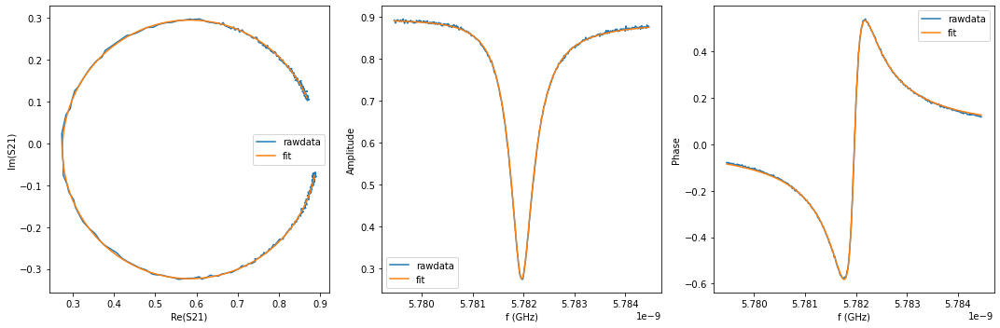

{'Qi_dia_corr': 25480.74117060702, 'Qi_no_corr': 25699.49911828562, 'absQc': 11368.925856379377, 'Qc_dia_corr(Re{Qc})': 11412.268814870942, 'Ql': 7882.0640537484, 'fr': 5.781940495920275, 'theta0': -3.0544108549385336, 'phi0': 0.08718179865125933, 'phi0_err': 0.001869958433666648, 'Ql_err': 16.96909284626023, 'absQc_err': 16.248780214625558, 'fr_err': 8.555559902454773e-07, 'chi_square': 2.3198266707968726e-05, 'Qi_no_corr_err': 144.85877821698458, 'Qi_dia_corr_err': 142.70523240334754, 'delay': -0.3228753094279122, 'a': 0.8904872639097978, 'alpha': 0.8586123347070322}


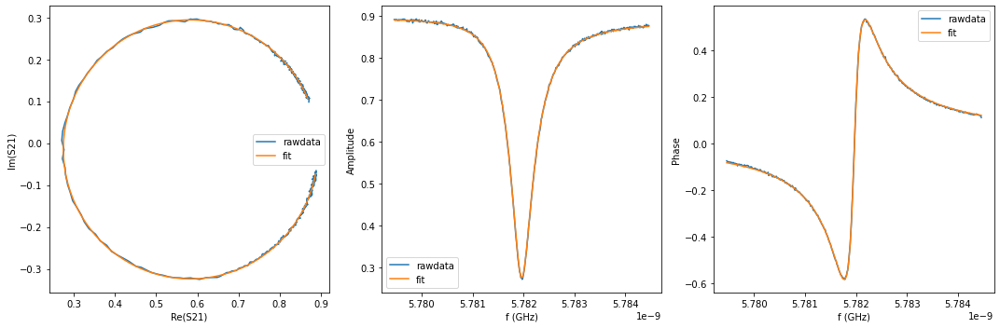

{'Qi_dia_corr': 25420.21147378193, 'Qi_no_corr': 25641.28996010133, 'absQc': 11330.213239551591, 'Qc_dia_corr(Re{Qc})': 11373.92273674505, 'Ql': 7857.978654972533, 'fr': 5.781940883915784, 'theta0': -3.0538955934048815, 'phi0': 0.08769744599613073, 'phi0_err': 0.0014259218850530648, 'Ql_err': 13.918277128274774, 'absQc_err': 13.762597084487627, 'fr_err': 6.644347406889282e-07, 'chi_square': 1.537284383044431e-05, 'Qi_no_corr_err': 113.61895391982053, 'Qi_dia_corr_err': 112.27379929115801, 'delay': -0.07540937087062316, 'a': 0.8908453083287591, 'alpha': -2.7184439722699687}


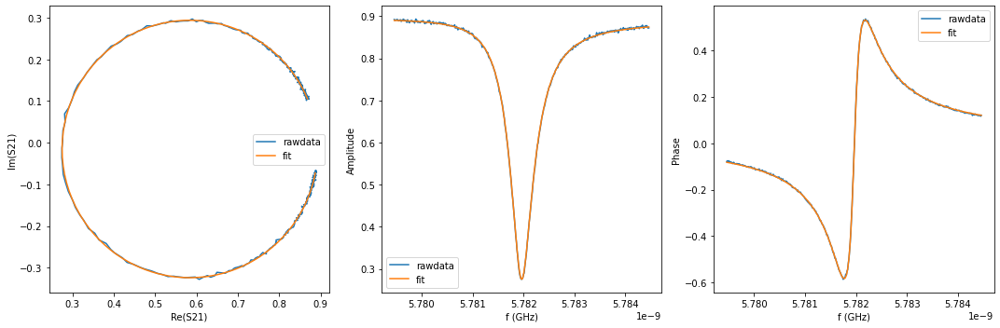

{'Qi_dia_corr': 25324.349374969755, 'Qi_no_corr': 25545.953666696852, 'absQc': 11320.11969012525, 'Qc_dia_corr(Re{Qc})': 11364.186042614729, 'Ql': 7844.156612678381, 'fr': 5.781940402539598, 'theta0': -3.0535013146551817, 'phi0': 0.08809267932111299, 'phi0_err': 0.0012390103868666186, 'Ql_err': 12.969081492672922, 'absQc_err': 13.51974953658286, 'fr_err': 6.014622535356972e-07, 'chi_square': 1.335867353627463e-05, 'Qi_no_corr_err': 100.29267417237632, 'Qi_dia_corr_err': 99.2018171901366, 'delay': -0.0325259524194145, 'a': 0.8908379188563427, 'alpha': -1.1608066325825324}


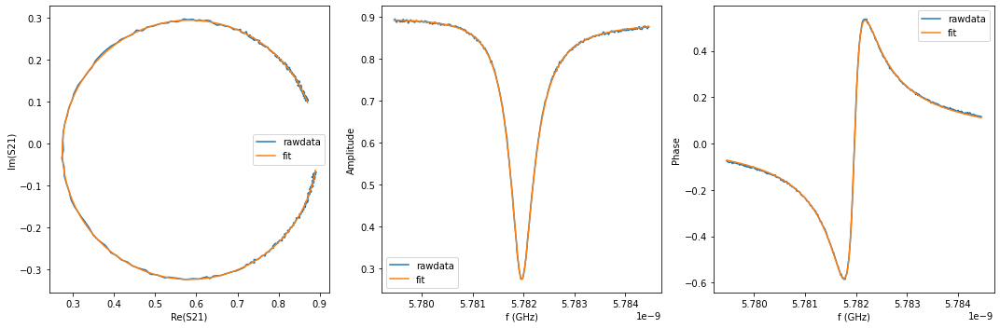

{'Qi_dia_corr': 24989.549974905036, 'Qi_no_corr': 25207.871526190913, 'absQc': 11075.872793223709, 'Qc_dia_corr(Re{Qc})': 11118.553168856926, 'Ql': 7694.883305156113, 'fr': 5.781940230040185, 'theta0': -3.05394299539925, 'phi0': 0.08764840139063988, 'phi0_err': 0.0018679511652221748, 'Ql_err': 16.206150824945617, 'absQc_err': 14.678584165234703, 'fr_err': 8.177314539187859e-07, 'chi_square': 2.1397269984257104e-05, 'Qi_no_corr_err': 134.5069816005712, 'Qi_dia_corr_err': 131.99989670872537, 'delay': 0.716951007768471, 'a': 0.8928639061557277, 'alpha': 0.9345579041208122}


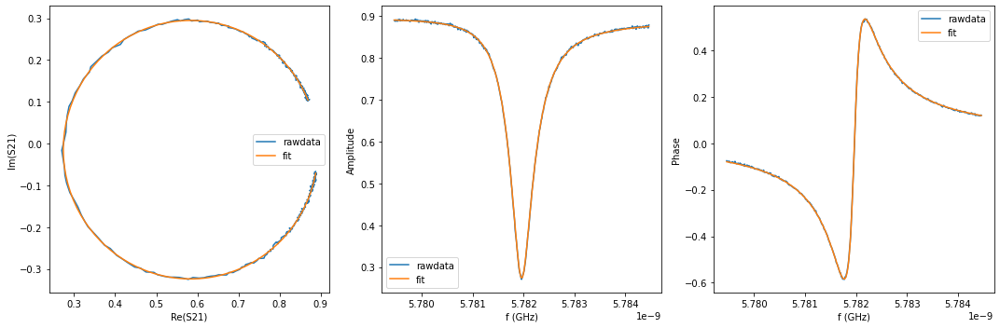

{'Qi_dia_corr': 25399.534521823007, 'Qi_no_corr': 25616.01061654512, 'absQc': 11263.441252191338, 'Qc_dia_corr(Re{Qc})': 11305.809984755928, 'Ql': 7823.446826755965, 'fr': 5.781940408847815, 'theta0': -3.0549917120891408, 'phi0': 0.08660094150065231, 'phi0_err': 0.0011509787379530149, 'Ql_err': 11.927169133565533, 'absQc_err': 12.431879976386574, 'fr_err': 5.622027097736899e-07, 'chi_square': 1.1522982911508272e-05, 'Qi_no_corr_err': 94.03170478972355, 'Qi_dia_corr_err': 93.10840559191718, 'delay': 0.11366702529493133, 'a': 0.8913915088622145, 'alpha': -2.1326117623311074}


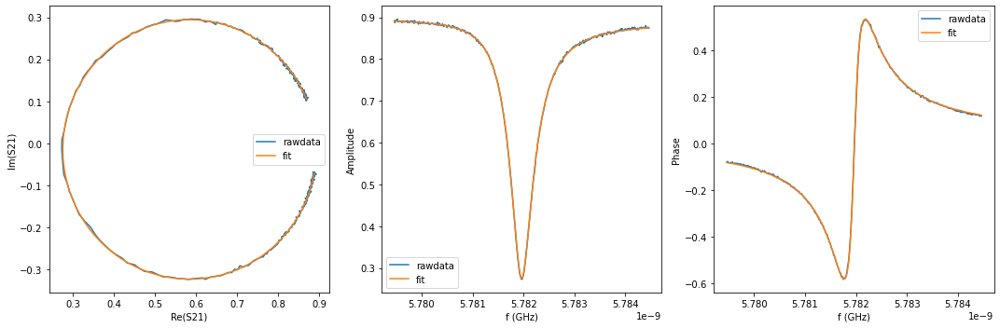

{'Qi_dia_corr': 25288.05320410483, 'Qi_no_corr': 25506.776668711373, 'absQc': 11283.447143711197, 'Qc_dia_corr(Re{Qc})': 11326.785544053148, 'Ql': 7822.849021393309, 'fr': 5.781940395990529, 'theta0': -3.054086887959216, 'phi0': 0.0875057656305775, 'phi0_err': 0.0012951900234897883, 'Ql_err': 12.912511973119924, 'absQc_err': 12.888176835552034, 'fr_err': 6.104188725961121e-07, 'chi_square': 1.3337805021707218e-05, 'Qi_no_corr_err': 104.19867038414789, 'Qi_dia_corr_err': 102.76465546971232, 'delay': -0.012301764151774593, 'a': 0.8913964475410311, 'alpha': -0.4254543273782057}


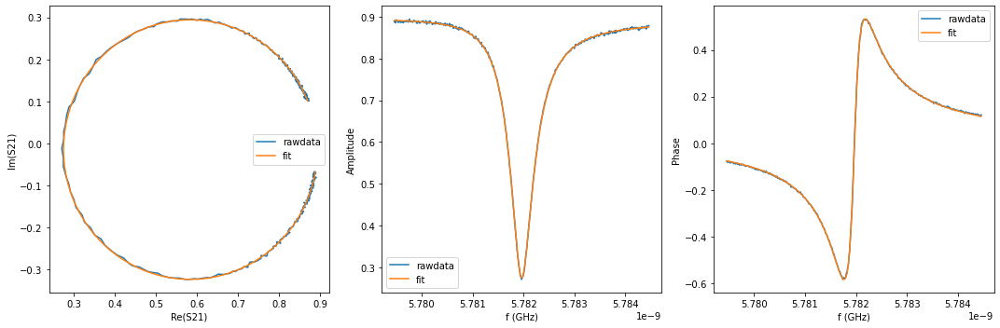

{'Qi_dia_corr': 25081.79159036215, 'Qi_no_corr': 25301.131695167256, 'absQc': 11154.223566588573, 'Qc_dia_corr(Re{Qc})': 11197.392946306043, 'Ql': 7741.372355014684, 'fr': 5.781940434733957, 'theta0': -3.053755320100056, 'phi0': 0.08783832983728566, 'phi0_err': 0.0012455100525884757, 'Ql_err': 12.115440535359669, 'absQc_err': 12.831458890313842, 'fr_err': 6.202195655175993e-07, 'chi_square': 1.30934002477573e-05, 'Qi_no_corr_err': 93.78810881992452, 'Qi_dia_corr_err': 92.26008299111083, 'delay': 0.4196677582294728, 'a': 0.8923868111776854, 'alpha': 2.7010530982551315}


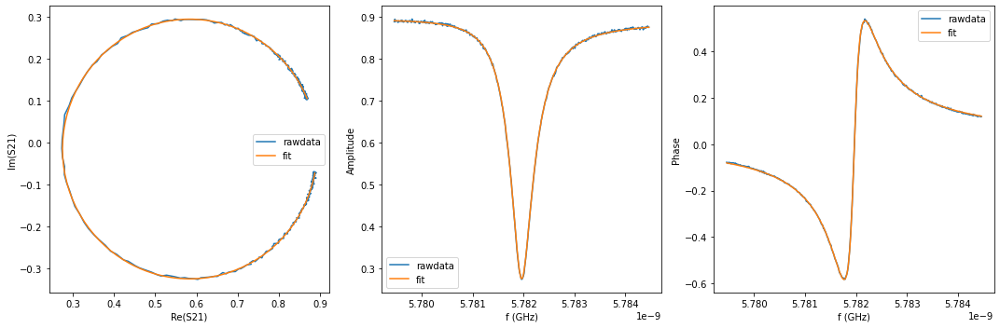

{'Qi_dia_corr': 25389.007583346876, 'Qi_no_corr': 25610.973296002292, 'absQc': 11295.810224475967, 'Qc_dia_corr(Re{Qc})': 11339.534912029543, 'Ql': 7838.577801157969, 'fr': 5.78194011415267, 'theta0': -3.0537473098255314, 'phi0': 0.08784567499941254, 'phi0_err': 0.0011821947970967683, 'Ql_err': 11.724692179600522, 'absQc_err': 12.607950188333032, 'fr_err': 5.923065034656347e-07, 'chi_square': 1.1928371817385449e-05, 'Qi_no_corr_err': 91.36793642427212, 'Qi_dia_corr_err': 90.18030004206477, 'delay': 0.0025464504220176643, 'a': 0.8914312846317107, 'alpha': 0.11393859984197974}


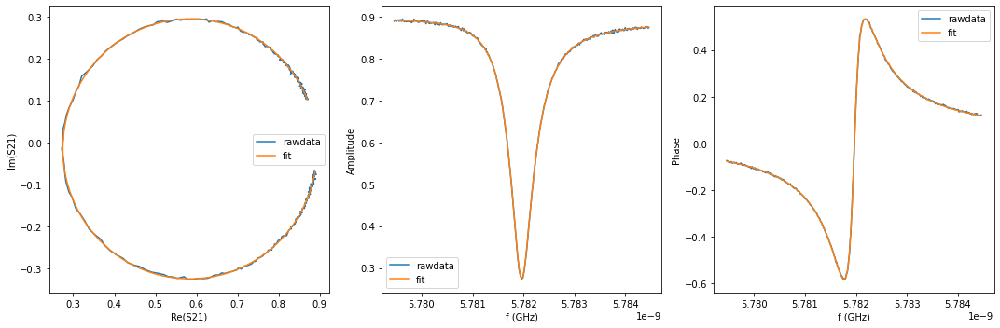

{'Qi_dia_corr': 25238.546261136697, 'Qi_no_corr': 25463.65527530865, 'absQc': 11224.677741039708, 'Qc_dia_corr(Re{Qc})': 11268.984139903085, 'Ql': 7790.523609968954, 'fr': 5.781939744488109, 'theta0': -3.0528907960915537, 'phi0': 0.08870502783611879, 'phi0_err': 0.0010266776865325167, 'Ql_err': 11.512805919283482, 'absQc_err': 12.048312599016066, 'fr_err': 5.047149031154839e-07, 'chi_square': 1.0029685158739941e-05, 'Qi_no_corr_err': 86.47176673824055, 'Qi_dia_corr_err': 85.43090095775547, 'delay': 0.24907109459725757, 'a': 0.8923304083319084, 'alpha': 2.78730032561307}


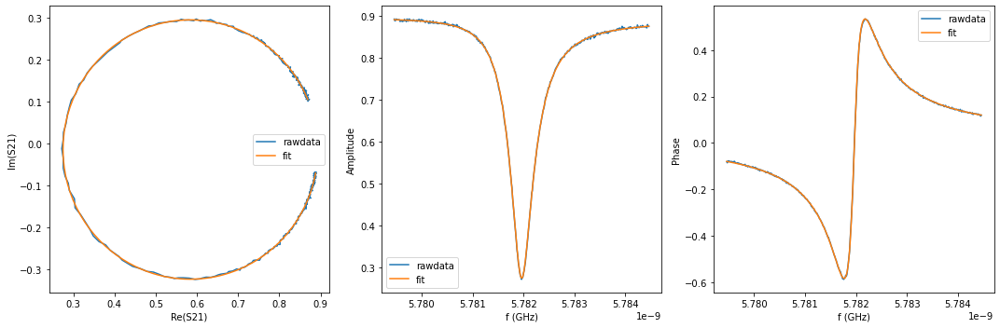

{'Qi_dia_corr': 25324.527205739392, 'Qi_no_corr': 25542.875633406387, 'absQc': 11268.355276618186, 'Qc_dia_corr(Re{Qc})': 11311.37969877656, 'Ql': 7818.977804008043, 'fr': 5.781940439316356, 'theta0': -3.054346866846913, 'phi0': 0.0872473982291549, 'phi0_err': 0.0011137515491949541, 'Ql_err': 11.43606530275445, 'absQc_err': 11.820210618031073, 'fr_err': 5.393778776442093e-07, 'chi_square': 1.0594989690633908e-05, 'Qi_no_corr_err': 89.87021185310266, 'Qi_dia_corr_err': 88.78290972736241, 'delay': 0.09863374139824987, 'a': 0.8918852878998259, 'alpha': -2.678194680808572}


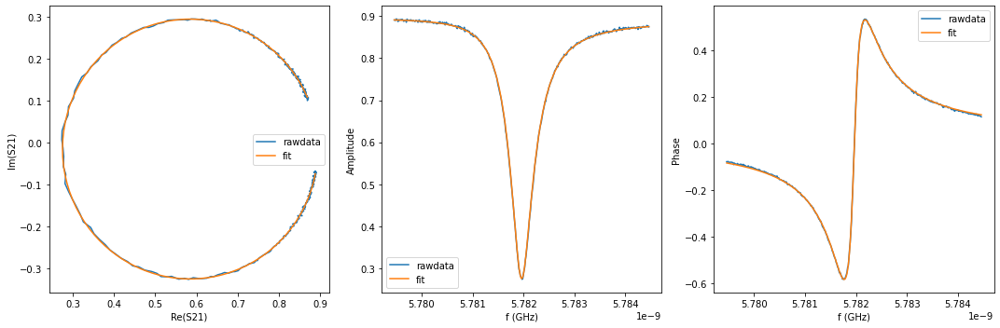

{'Qi_dia_corr': 25380.70800724649, 'Qi_no_corr': 25612.640885512643, 'absQc': 11346.891869841122, 'Qc_dia_corr(Re{Qc})': 11393.015110558052, 'Ql': 7863.299261727963, 'fr': 5.781939056344873, 'theta0': -3.051581520310746, 'phi0': 0.09001236919005756, 'phi0_err': 0.0016745393726889679, 'Ql_err': 14.432398916599864, 'absQc_err': 14.095360142061176, 'fr_err': 7.756490214890269e-07, 'chi_square': 1.7956590371364627e-05, 'Qi_no_corr_err': 119.27823572843374, 'Qi_dia_corr_err': 117.33345266842436, 'delay': -0.1864244127748827, 'a': 0.8914253731823012, 'alpha': -0.46765619728748997}


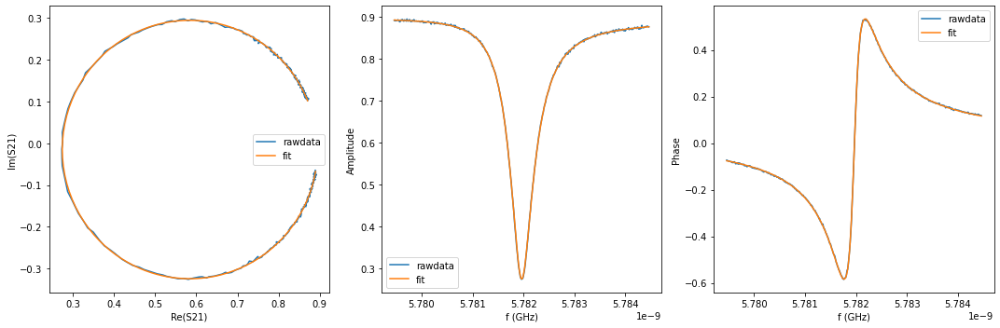

{'Qi_dia_corr': 25096.23756775805, 'Qi_no_corr': 25320.83249658393, 'absQc': 11147.899706300617, 'Qc_dia_corr(Re{Qc})': 11191.997208942154, 'Ql': 7740.167647770005, 'fr': 5.7819399645054705, 'theta0': -3.052793076281337, 'phi0': 0.08879957730845611, 'phi0_err': 0.001005199392512875, 'Ql_err': 10.312044764189302, 'absQc_err': 10.638448093551327, 'fr_err': 4.887058526469659e-07, 'chi_square': 8.770544334943496e-06, 'Qi_no_corr_err': 78.28713604678477, 'Qi_dia_corr_err': 76.90922455127456, 'delay': 0.39122584160685686, 'a': 0.8930498715844313, 'alpha': 1.6682715320886206}


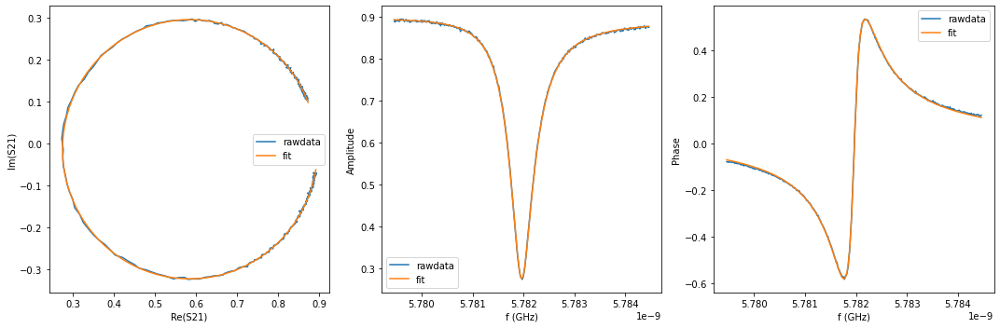

{'Qi_dia_corr': 24820.769423728172, 'Qi_no_corr': 25029.057798990252, 'absQc': 11032.381466653113, 'Qc_dia_corr(Re{Qc})': 11073.340832919394, 'Ql': 7657.212773879652, 'fr': 5.781940630133678, 'theta0': -3.0555539559201716, 'phi0': 0.08603719390174286, 'phi0_err': 0.001926485335994103, 'Ql_err': 15.607502047557174, 'absQc_err': 14.246615064053785, 'fr_err': 8.401086999405223e-07, 'chi_square': 2.1187441707614633e-05, 'Qi_no_corr_err': 129.05675117581407, 'Qi_dia_corr_err': 127.38644666389018, 'delay': 0.7836179675177248, 'a': 0.8947711102389291, 'alpha': -2.9257303040981735}


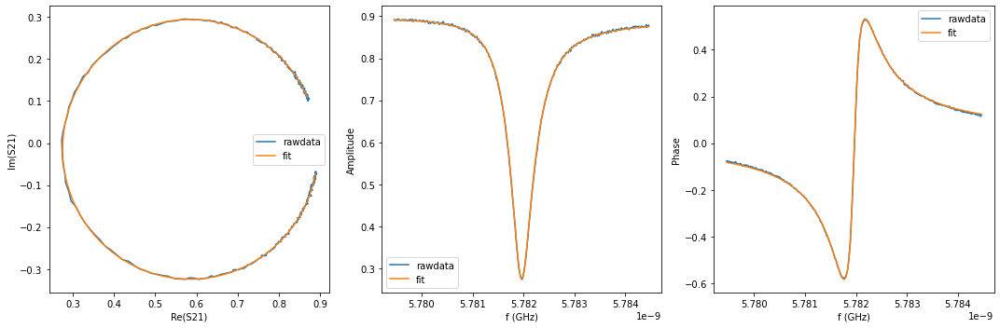

{'Qi_dia_corr': 25388.073446194507, 'Qi_no_corr': 25620.437537196223, 'absQc': 11356.173792816653, 'Qc_dia_corr(Re{Qc})': 11402.431299511549, 'Ql': 7868.4912125586725, 'fr': 5.781939768714207, 'theta0': -3.0514864085316464, 'phi0': 0.09010612349618846, 'phi0_err': 0.0017059882175550758, 'Ql_err': 15.598587197324385, 'absQc_err': 13.576349552827383, 'fr_err': 7.461780318199353e-07, 'chi_square': 1.7253544333497577e-05, 'Qi_no_corr_err': 136.8318641835056, 'Qi_dia_corr_err': 135.50816364614866, 'delay': -0.19053058540893303, 'a': 0.8917310477018767, 'alpha': -0.6165084672638738}


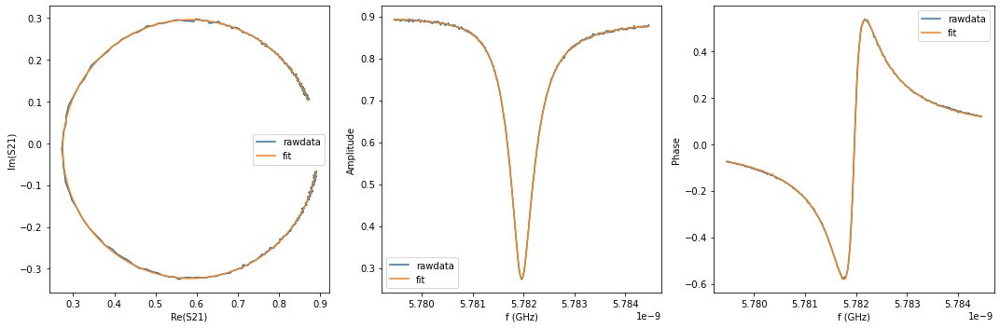

{'Qi_dia_corr': 25147.96286057687, 'Qi_no_corr': 25362.905976042188, 'absQc': 11177.634197527233, 'Qc_dia_corr(Re{Qc})': 11219.897213740069, 'Ql': 7758.4316991443075, 'fr': 5.78194021720037, 'theta0': -3.054769362528785, 'phi0': 0.08682348657682006, 'phi0_err': 0.001032185504862183, 'Ql_err': 10.214489583105408, 'absQc_err': 10.765504599292088, 'fr_err': 5.103724774092905e-07, 'chi_square': 9.092496201692816e-06, 'Qi_no_corr_err': 78.90461696903314, 'Qi_dia_corr_err': 77.68517170747405, 'delay': 0.3786723282456371, 'a': 0.8934963214426951, 'alpha': 1.2132342834150571}


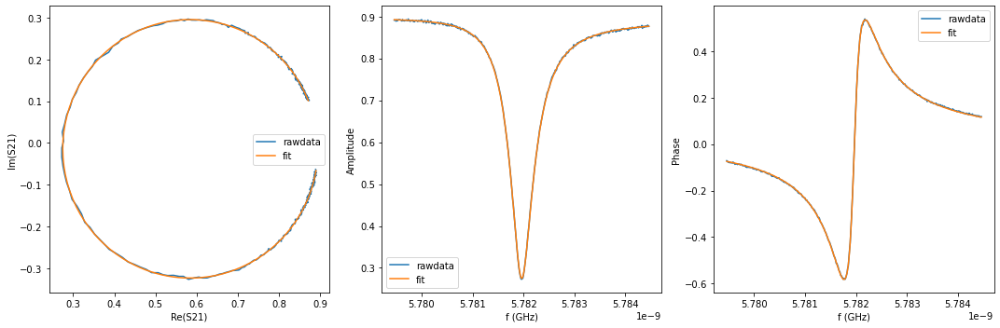

{'Qi_dia_corr': 25094.499515437557, 'Qi_no_corr': 25308.00726780695, 'absQc': 11137.244180549196, 'Qc_dia_corr(Re{Qc})': 11179.100570112878, 'Ql': 7733.832130753292, 'fr': 5.781940644763947, 'theta0': -3.055030501077032, 'phi0': 0.08656215251276114, 'phi0_err': 0.0010756906634740904, 'Ql_err': 10.781902466904615, 'absQc_err': 11.136732926586363, 'fr_err': 5.258656253498194e-07, 'chi_square': 9.840158554600709e-06, 'Qi_no_corr_err': 82.17780045593386, 'Qi_dia_corr_err': 81.09124139690144, 'delay': 0.45999537142432756, 'a': 0.8933962957118936, 'alpha': -2.116213786760274}


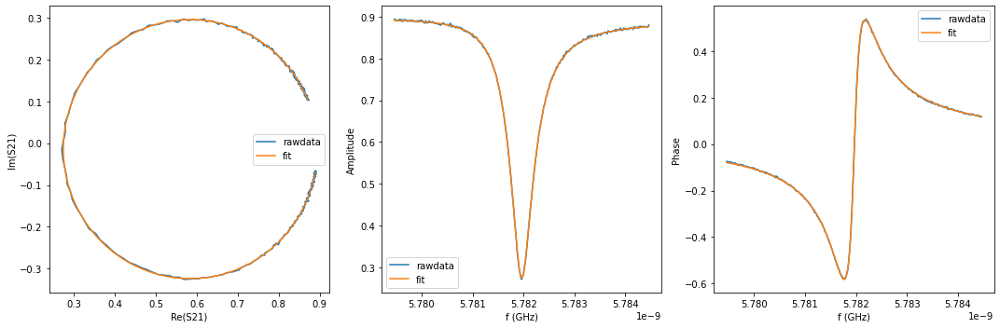

{'Qi_dia_corr': 25365.271684595413, 'Qi_no_corr': 25578.602211669135, 'absQc': 11271.417698217585, 'Qc_dia_corr(Re{Qc})': 11313.345905150994, 'Ql': 7823.797934690484, 'fr': 5.781941113411497, 'theta0': -3.0554733660000246, 'phi0': 0.08612055676058611, 'phi0_err': 0.0010651217851240882, 'Ql_err': 10.509733717443597, 'absQc_err': 10.937130079185122, 'fr_err': 5.173151838053774e-07, 'chi_square': 9.361338265232582e-06, 'Qi_no_corr_err': 82.5318530551055, 'Qi_dia_corr_err': 81.54431182458251, 'delay': 0.11589465308916667, 'a': 0.8924836999218839, 'alpha': -2.0513094655516144}


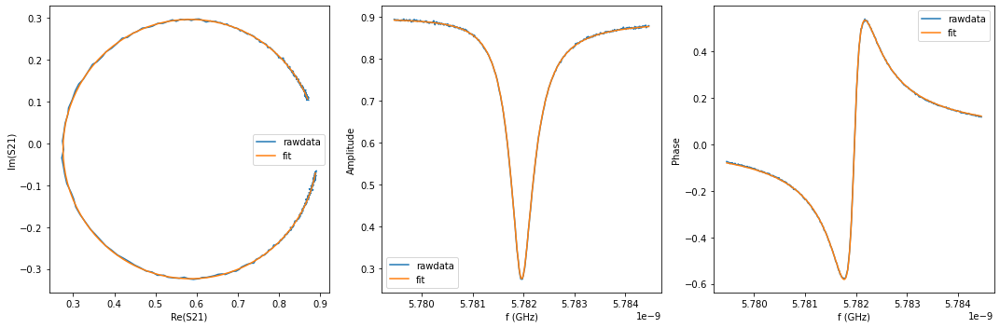

{'Qi_dia_corr': 25276.286492518055, 'Qi_no_corr': 25487.977214666793, 'absQc': 11279.386024283243, 'Qc_dia_corr(Re{Qc})': 11321.34614356166, 'Ql': 7819.128396942185, 'fr': 5.781941037377894, 'theta0': -3.055469773178607, 'phi0': 0.08612288041118626, 'phi0_err': 0.0010441512228868321, 'Ql_err': 10.224769399063431, 'absQc_err': 10.692936378931709, 'fr_err': 5.106333826319895e-07, 'chi_square': 8.90875189325617e-06, 'Qi_no_corr_err': 80.12703307792232, 'Qi_dia_corr_err': 79.39499211165372, 'delay': 0.03731480761714366, 'a': 0.8924680920517993, 'alpha': 1.3774789602319772}


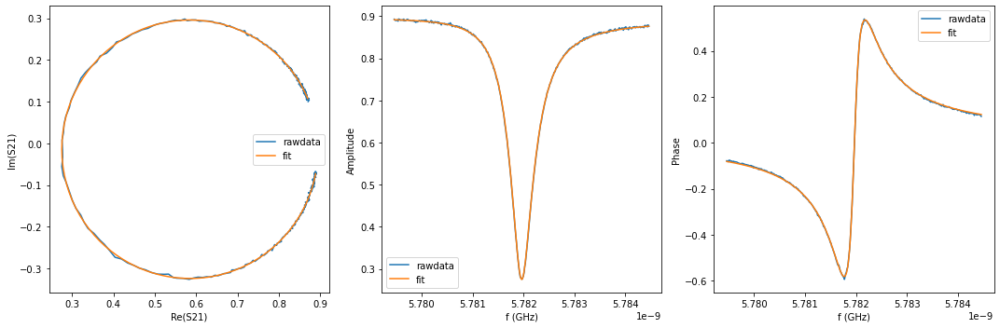

{'Qi_dia_corr': 25471.66767471414, 'Qi_no_corr': 25688.8317496125, 'absQc': 11332.91397722304, 'Qc_dia_corr(Re{Qc})': 11375.700400759748, 'Ql': 7863.738315902451, 'fr': 5.781940970352031, 'theta0': -3.0548335343040303, 'phi0': 0.08675911928576287, 'phi0_err': 0.001439581032890805, 'Ql_err': 13.313444791490465, 'absQc_err': 12.574939056836332, 'fr_err': 6.538133493040118e-07, 'chi_square': 1.399091690740047e-05, 'Qi_no_corr_err': 113.32642826268432, 'Qi_dia_corr_err': 111.68554155290965, 'delay': -0.10159292339506476, 'a': 0.892579838363652, 'alpha': 2.6145312898846473}


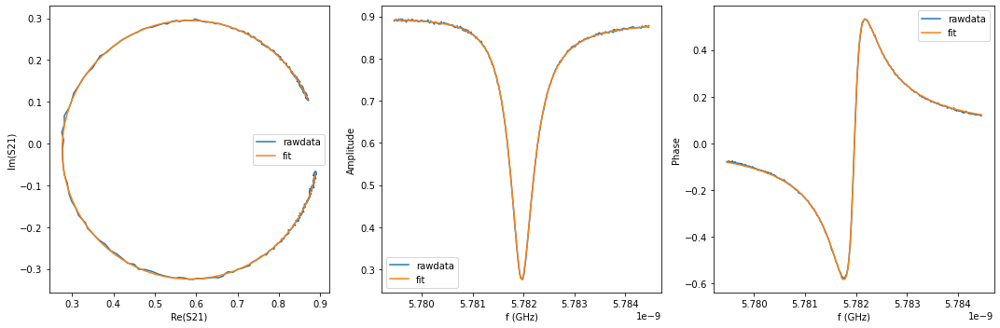

{'Qi_dia_corr': 25322.490827906106, 'Qi_no_corr': 25551.31701437885, 'absQc': 11316.824926419382, 'Qc_dia_corr(Re{Qc})': 11362.30036257578, 'Ql': 7843.079853481373, 'fr': 5.781939832153158, 'theta0': -3.0520941661155736, 'phi0': 0.08949839691032117, 'phi0_err': 0.0012485000919576048, 'Ql_err': 12.143538270569868, 'absQc_err': 11.829514736963853, 'fr_err': 5.768403757644833e-07, 'chi_square': 1.155706079093843e-05, 'Qi_no_corr_err': 100.75831104082407, 'Qi_dia_corr_err': 99.85546421764668, 'delay': -0.025182719904100363, 'a': 0.8925594837502289, 'alpha': -0.8925672693493253}


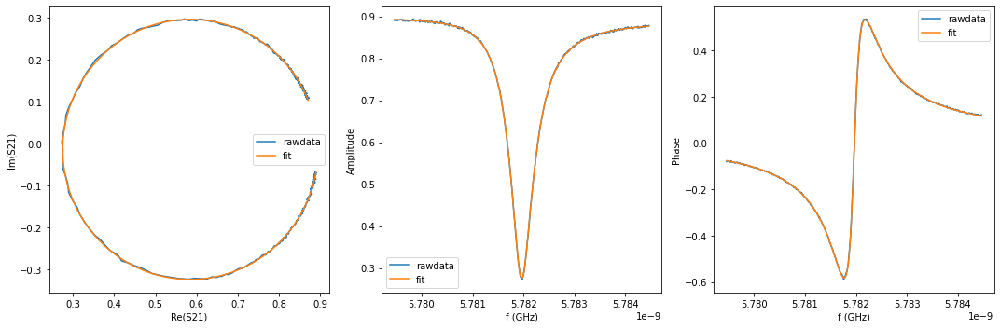

{'Qi_dia_corr': 25212.39511009883, 'Qi_no_corr': 25428.01794156697, 'absQc': 11207.57341556591, 'Qc_dia_corr(Re{Qc})': 11249.979821564233, 'Ql': 7778.948485212664, 'fr': 5.7819406983086985, 'theta0': -3.0547383433935367, 'phi0': 0.08685431019625665, 'phi0_err': 0.0008990841548872322, 'Ql_err': 9.445753873125424, 'absQc_err': 10.10341990446569, 'fr_err': 4.5461571857934344e-07, 'chi_square': 7.4196422624806525e-06, 'Qi_no_corr_err': 70.82748236025961, 'Qi_dia_corr_err': 69.84609159615069, 'delay': 0.32327747912558386, 'a': 0.8933182915446034, 'alpha': -0.7997711018739276}


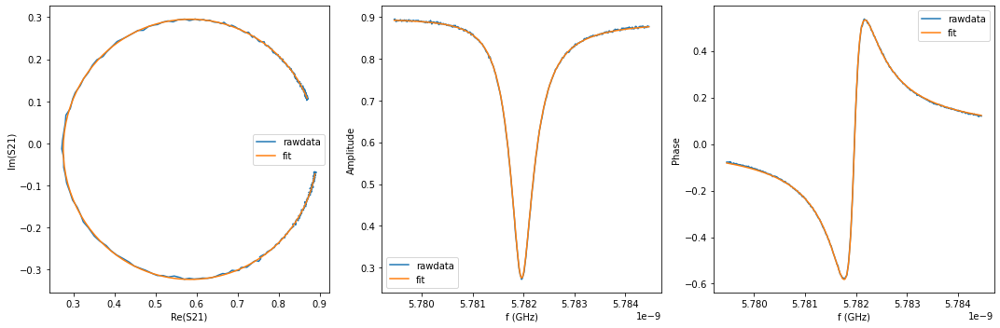

{'Qi_dia_corr': 25361.944066627962, 'Qi_no_corr': 25581.614463583206, 'absQc': 11319.736014829481, 'Qc_dia_corr(Re{Qc})': 11363.287335806359, 'Ql': 7847.331298357451, 'fr': 5.78194027242656, 'theta0': -3.054014501862055, 'phi0': 0.08757950272679482, 'phi0_err': 0.001249651950493226, 'Ql_err': 11.793392715868494, 'absQc_err': 11.999352107065667, 'fr_err': 5.91522580586084e-07, 'chi_square': 1.1663577013050286e-05, 'Qi_no_corr_err': 93.59524851502927, 'Qi_dia_corr_err': 92.80501701522324, 'delay': -0.10149138227697602, 'a': 0.8924308226181263, 'alpha': 2.6180971140775173}


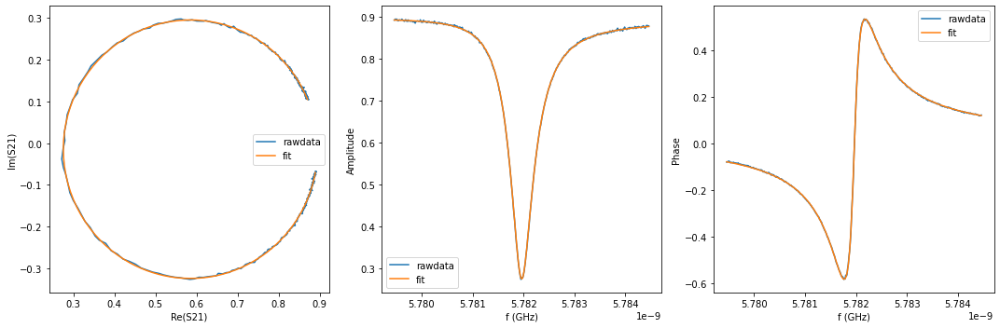

{'Qi_dia_corr': 25293.621388276155, 'Qi_no_corr': 25513.24056901834, 'absQc': 11254.492221822067, 'Qc_dia_corr(Re{Qc})': 11297.764729279024, 'Ql': 7809.526063816048, 'fr': 5.78194064621517, 'theta0': -3.0540418516515313, 'phi0': 0.08755147793182969, 'phi0_err': 0.0009051764946184158, 'Ql_err': 9.7070132926734, 'absQc_err': 10.562324118251041, 'fr_err': 4.676027889370087e-07, 'chi_square': 7.680400295139525e-06, 'Qi_no_corr_err': 72.04753302565467, 'Qi_dia_corr_err': 71.27068044330488, 'delay': 0.1272889789571929, 'a': 0.8933534349049039, 'alpha': -1.6369961585695192}


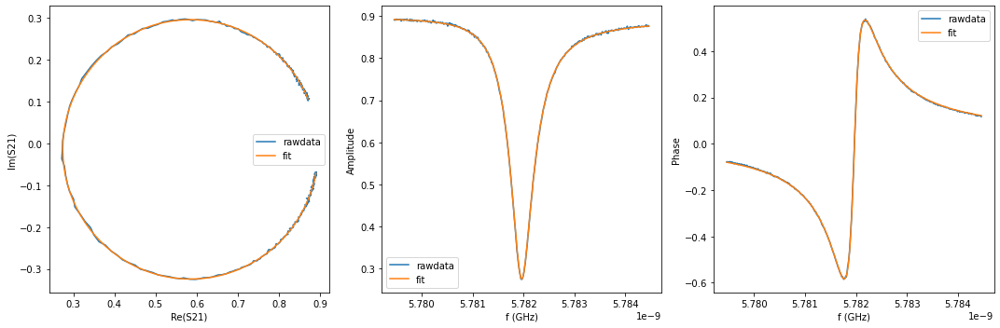

{'Qi_dia_corr': 25453.961784408133, 'Qi_no_corr': 25676.837525224015, 'absQc': 11302.588230883941, 'Qc_dia_corr(Re{Qc})': 11346.320178531516, 'Ql': 7848.005091614512, 'fr': 5.781940526071949, 'theta0': -3.0537659641180057, 'phi0': 0.08782668286836967, 'phi0_err': 0.00110827014987781, 'Ql_err': 10.583472853696009, 'absQc_err': 10.547384330426404, 'fr_err': 5.23030539202216e-07, 'chi_square': 9.18663821685901e-06, 'Qi_no_corr_err': 87.11217648466129, 'Qi_dia_corr_err': 85.73769971572916, 'delay': 0.011338981595023334, 'a': 0.8928101665414825, 'alpha': 0.43446275635472165}


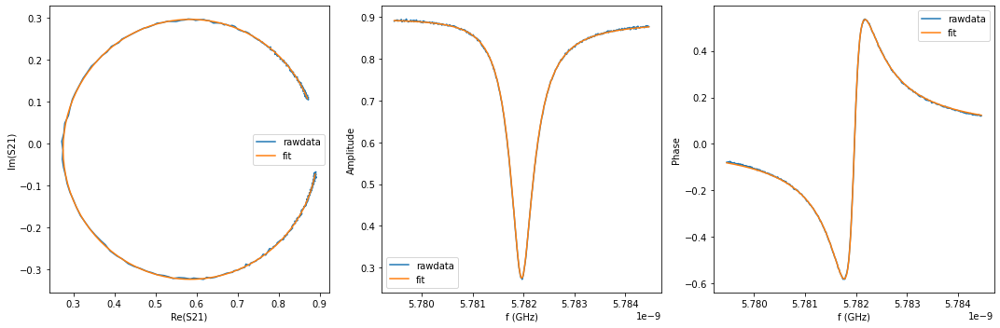

{'Qi_dia_corr': 25407.716051047715, 'Qi_no_corr': 25616.45588831745, 'absQc': 11321.103228284757, 'Qc_dia_corr(Re{Qc})': 11362.358352804638, 'Ql': 7851.264360456791, 'fr': 5.781941249346587, 'theta0': -3.0563511305570867, 'phi0': 0.08524152300280764, 'phi0_err': 0.0013210685643998631, 'Ql_err': 12.934750887099286, 'absQc_err': 11.643537285363625, 'fr_err': 5.897690803051273e-07, 'chi_square': 1.1855667521834975e-05, 'Qi_no_corr_err': 111.21549380983315, 'Qi_dia_corr_err': 109.99030007553273, 'delay': -0.10967410099154633, 'a': 0.8926790161556897, 'alpha': 2.321040535932279}


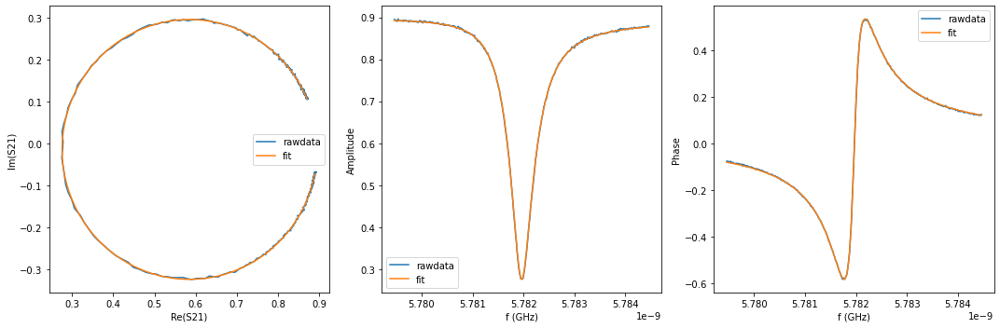

{'Qi_dia_corr': 25288.740793428, 'Qi_no_corr': 25501.179241799684, 'absQc': 11273.250716844565, 'Qc_dia_corr(Re{Qc})': 11315.271077971467, 'Ql': 7817.420623278058, 'fr': 5.781940613221846, 'theta0': -3.0553866985672005, 'phi0': 0.08620786663767668, 'phi0_err': 0.0010044095419898655, 'Ql_err': 9.54144951893495, 'absQc_err': 10.121985703682773, 'fr_err': 4.958405380478968e-07, 'chi_square': 8.086079054337016e-06, 'Qi_no_corr_err': 76.28688165779991, 'Qi_dia_corr_err': 75.2420113864612, 'delay': 0.025138645858194336, 'a': 0.8933180746001488, 'alpha': 0.9355754048503951}


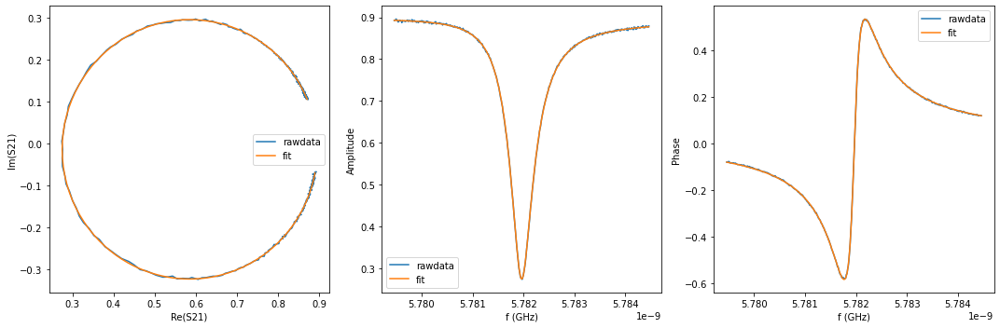

{'Qi_dia_corr': 25302.764507162134, 'Qi_no_corr': 25517.725436554727, 'absQc': 11234.802936552624, 'Qc_dia_corr(Re{Qc})': 11276.98307345896, 'Ql': 7800.459706019128, 'fr': 5.781940663029486, 'theta0': -3.0550773287444217, 'phi0': 0.08651830204189453, 'phi0_err': 0.0008858390525131484, 'Ql_err': 8.72264097212049, 'absQc_err': 9.612553559357176, 'fr_err': 4.548021574614774e-07, 'chi_square': 6.851792691655492e-06, 'Qi_no_corr_err': 67.39823090933572, 'Qi_dia_corr_err': 66.77661152035726, 'delay': 0.11178232895318113, 'a': 0.8936392419297252, 'alpha': -2.1996997808786074}


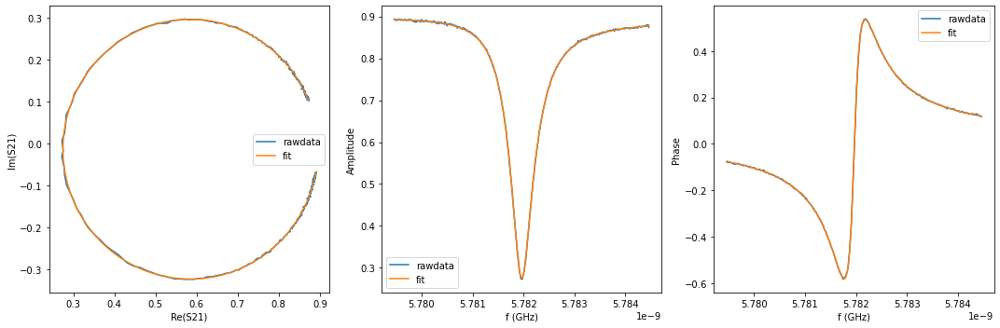

{'Qi_dia_corr': 25335.113856507985, 'Qi_no_corr': 25548.76298567669, 'absQc': 11242.23872519635, 'Qc_dia_corr(Re{Qc})': 11284.111192233258, 'Ql': 7806.94406952101, 'fr': 5.781941427942222, 'theta0': -3.055417913574968, 'phi0': 0.08617474001482496, 'phi0_err': 0.000890414008869035, 'Ql_err': 8.655001005262571, 'absQc_err': 8.99966608713257, 'fr_err': 4.3554580357381313e-07, 'chi_square': 6.45127998489417e-06, 'Qi_no_corr_err': 70.00821555372133, 'Qi_dia_corr_err': 69.11107687967109, 'delay': 0.22653615359118393, 'a': 0.8938133789271806, 'alpha': 1.9692469173209395}


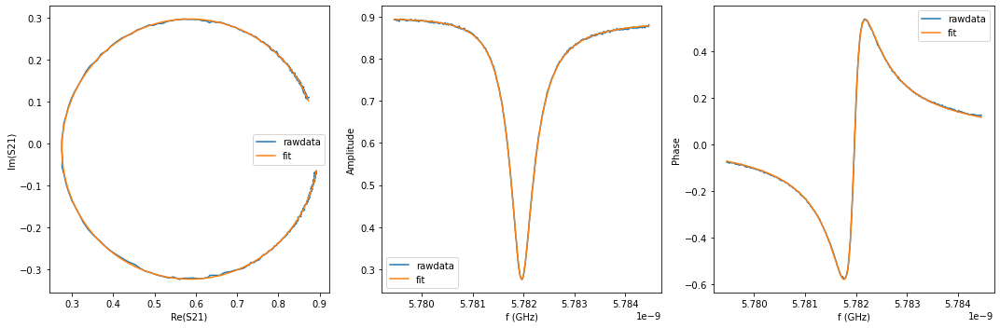

{'Qi_dia_corr': 25029.64889545915, 'Qi_no_corr': 25237.660895824818, 'absQc': 11144.098072334611, 'Qc_dia_corr(Re{Qc})': 11185.144091236867, 'Ql': 7730.548937601973, 'fr': 5.781940913683289, 'theta0': -3.055896247072025, 'phi0': 0.08569640956497578, 'phi0_err': 0.0011634699980540893, 'Ql_err': 11.112637728578191, 'absQc_err': 10.882206421928467, 'fr_err': 5.441101347359206e-07, 'chi_square': 1.0199111442845944e-05, 'Qi_no_corr_err': 87.942210832647, 'Qi_dia_corr_err': 87.23353361944922, 'delay': 0.5066544954547939, 'a': 0.8950669730079818, 'alpha': -0.42042189228123455}


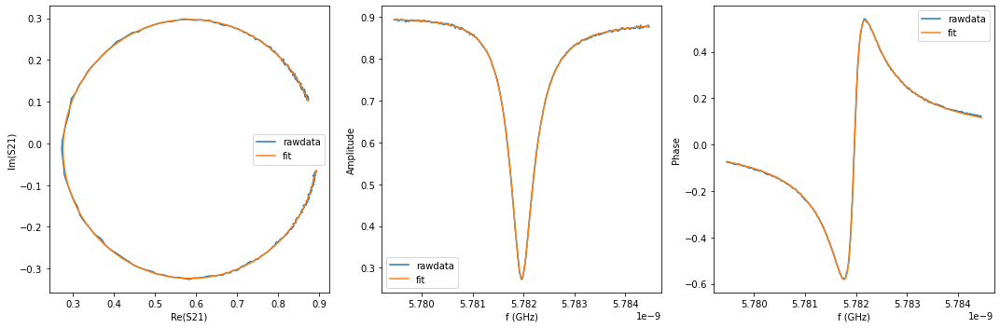

{'Qi_dia_corr': 25057.27305009312, 'Qi_no_corr': 25264.51379222722, 'absQc': 11114.362797888904, 'Qc_dia_corr(Re{Qc})': 11154.949387640445, 'Ql': 7718.736764822813, 'fr': 5.781940894229657, 'theta0': -3.0562611073934933, 'phi0': 0.08533049087642089, 'phi0_err': 0.0011722526504041482, 'Ql_err': 11.004964951025508, 'absQc_err': 10.388598236733943, 'fr_err': 5.244709117300954e-07, 'chi_square': 9.779389727942166e-06, 'Qi_no_corr_err': 88.11750919781406, 'Qi_dia_corr_err': 86.8175710013941, 'delay': 0.4880588864422943, 'a': 0.895557618724624, 'alpha': -1.0959511975478862}


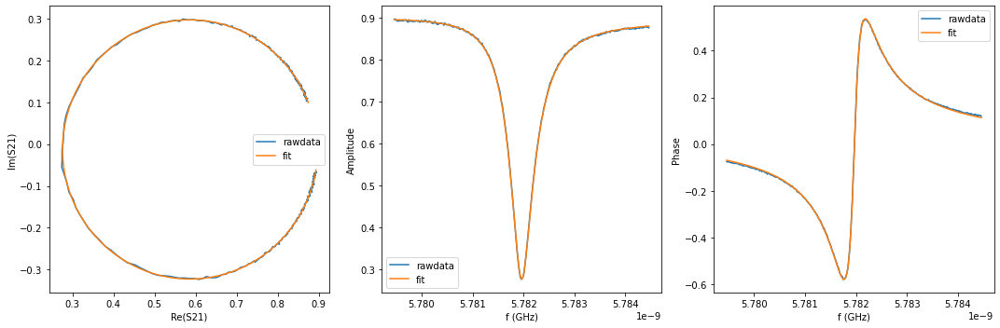

{'Qi_dia_corr': 24827.447852844176, 'Qi_no_corr': 25028.54429507857, 'absQc': 11050.539576065363, 'Qc_dia_corr(Re{Qc})': 11090.200204217696, 'Ql': 7665.907489554595, 'fr': 5.781941339832084, 'theta0': -3.0569957272262243, 'phi0': 0.08459693145062479, 'phi0_err': 0.0018289210781798685, 'Ql_err': 15.546318098729145, 'absQc_err': 12.668056181047941, 'fr_err': 7.654176246526198e-07, 'chi_square': 1.733025460099168e-05, 'Qi_no_corr_err': 134.5860390807625, 'Qi_dia_corr_err': 132.79017239032618, 'delay': 0.7592510007691996, 'a': 0.89638014684535, 'alpha': 2.473437364885536}


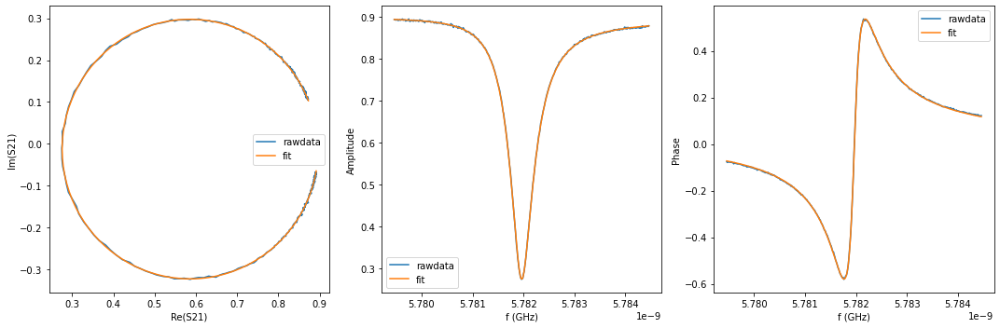

{'Qi_dia_corr': 25085.91809542642, 'Qi_no_corr': 25292.861176550556, 'absQc': 11140.594966357277, 'Qc_dia_corr(Re{Qc})': 11181.222515661848, 'Ql': 7734.03217095295, 'fr': 5.781941125778043, 'theta0': -3.056319513447665, 'phi0': 0.08527314014212807, 'phi0_err': 0.0010400070757194523, 'Ql_err': 9.762495264102096, 'absQc_err': 9.928291516068485, 'fr_err': 4.977493199049375e-07, 'chi_square': 8.34036149586011e-06, 'Qi_no_corr_err': 76.90750167259169, 'Qi_dia_corr_err': 75.38933674180086, 'delay': 0.4631916094569275, 'a': 0.8954812185377534, 'alpha': -1.9985077346312639}


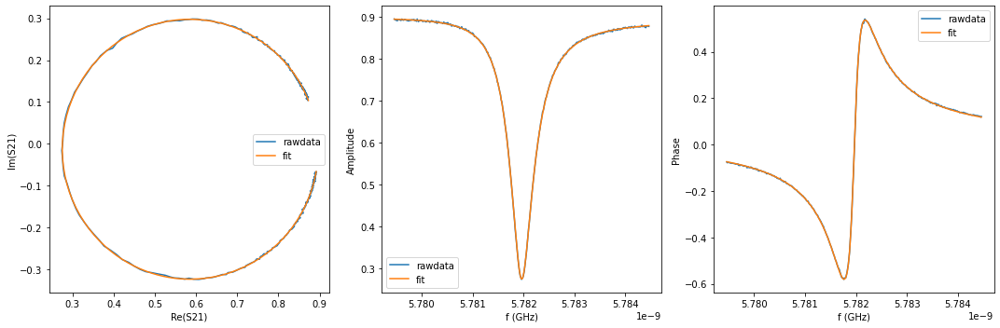

{'Qi_dia_corr': 25213.732533451683, 'Qi_no_corr': 25421.753714475373, 'absQc': 11182.637466231961, 'Qc_dia_corr(Re{Qc})': 11223.369153678, 'Ql': 7766.342954356998, 'fr': 5.781941299834302, 'theta0': -3.0563707267928844, 'phi0': 0.085221859743982, 'phi0_err': 0.0008555278983145852, 'Ql_err': 8.52410564154762, 'absQc_err': 9.02762472307121, 'fr_err': 4.257470521973298e-07, 'chi_square': 6.31788940010891e-06, 'Qi_no_corr_err': 65.68948270279783, 'Qi_dia_corr_err': 64.75795312729825, 'delay': 0.3680288553605974, 'a': 0.8952919516830126, 'alpha': 0.8271967044474183}


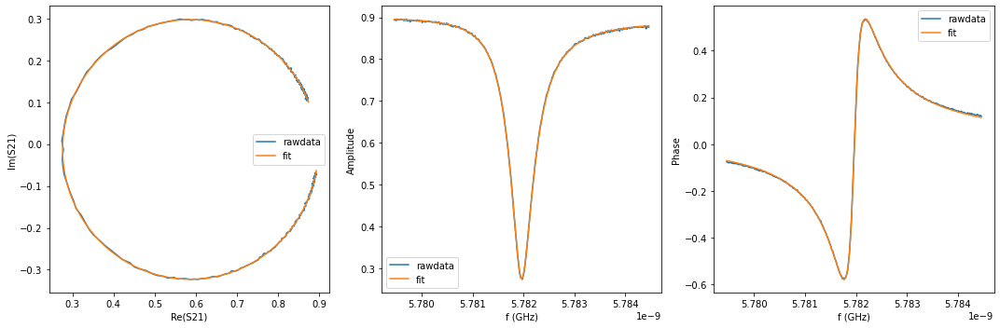

{'Qi_dia_corr': 24931.08049592371, 'Qi_no_corr': 25132.00240288709, 'absQc': 11074.730881221365, 'Qc_dia_corr(Re{Qc})': 11114.201190885198, 'Ql': 7687.248693058577, 'fr': 5.78194156578221, 'theta0': -3.0572902978088794, 'phi0': 0.08430236310264234, 'phi0_err': 0.0014451636115964583, 'Ql_err': 12.544244396127015, 'absQc_err': 11.559269706986695, 'fr_err': 6.398545346236506e-07, 'chi_square': 1.316353254812828e-05, 'Qi_no_corr_err': 103.27906004788727, 'Qi_dia_corr_err': 101.66025369272253, 'delay': 0.6658152210777293, 'a': 0.8964128858449824, 'alpha': -0.9210357246299943}


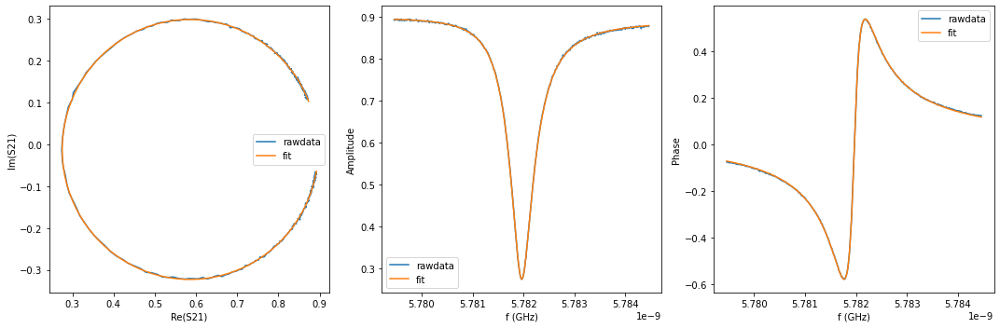

{'Qi_dia_corr': 25055.236493856868, 'Qi_no_corr': 25254.655295294095, 'absQc': 11109.232896324163, 'Qc_dia_corr(Re{Qc})': 11148.264598348496, 'Ql': 7715.342372449501, 'fr': 5.781941738878715, 'theta0': -3.057888520894225, 'phi0': 0.08370413269556841, 'phi0_err': 0.0010183251595996447, 'Ql_err': 10.191752304755804, 'absQc_err': 9.983813154404436, 'fr_err': 4.777039758250838e-07, 'chi_square': 8.32942232286686e-06, 'Qi_no_corr_err': 82.45390610700879, 'Qi_dia_corr_err': 81.37438423382542, 'delay': 0.5107562225026948, 'a': 0.8960093377289564, 'alpha': -0.2704963948908509}


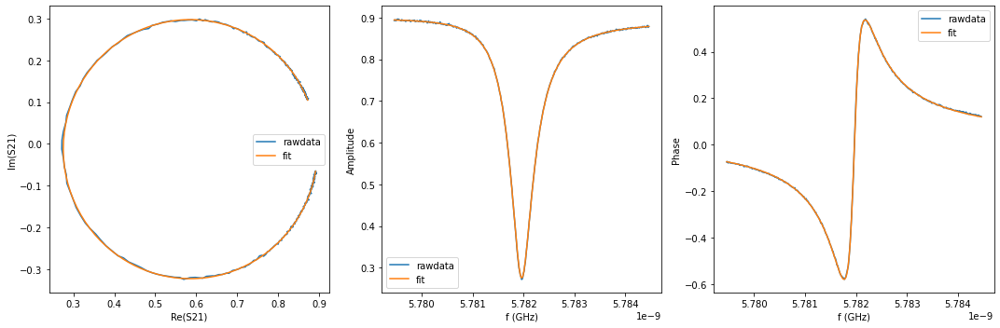

{'Qi_dia_corr': 25174.47853622743, 'Qi_no_corr': 25387.515500500263, 'absQc': 11175.475107515162, 'Qc_dia_corr(Re{Qc})': 11217.260750646248, 'Ql': 7759.692049241146, 'fr': 5.781940704388893, 'theta0': -3.0552510631308007, 'phi0': 0.08634159045899238, 'phi0_err': 0.0008627786298712358, 'Ql_err': 9.050520939708653, 'absQc_err': 9.218472520848897, 'fr_err': 4.1014860493152e-07, 'chi_square': 6.474532721763979e-06, 'Qi_no_corr_err': 67.9853461414639, 'Qi_dia_corr_err': 66.97323691946288, 'delay': 0.33562400375878165, 'a': 0.8951895500156536, 'alpha': -0.34922191605231323}


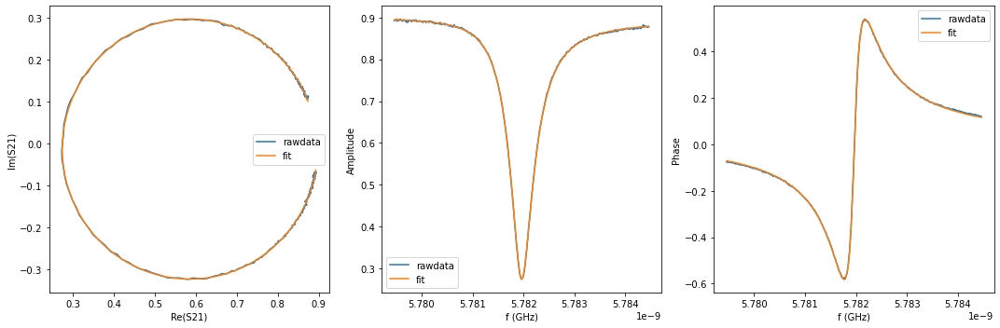

{'Qi_dia_corr': 25130.12528183695, 'Qi_no_corr': 25339.076907743063, 'absQc': 11108.944932873454, 'Qc_dia_corr(Re{Qc})': 11149.58851383356, 'Ql': 7723.064128113507, 'fr': 5.781940858157097, 'theta0': -3.056182795968598, 'phi0': 0.08541095475166141, 'phi0_err': 0.0012587003190923885, 'Ql_err': 12.040437679204215, 'absQc_err': 11.27628361037948, 'fr_err': 5.606588846477293e-07, 'chi_square': 1.1392150077005131e-05, 'Qi_no_corr_err': 96.89557929477914, 'Qi_dia_corr_err': 96.03881137087888, 'delay': 0.5939953354841746, 'a': 0.8957615821416436, 'alpha': 2.7538190184603595}


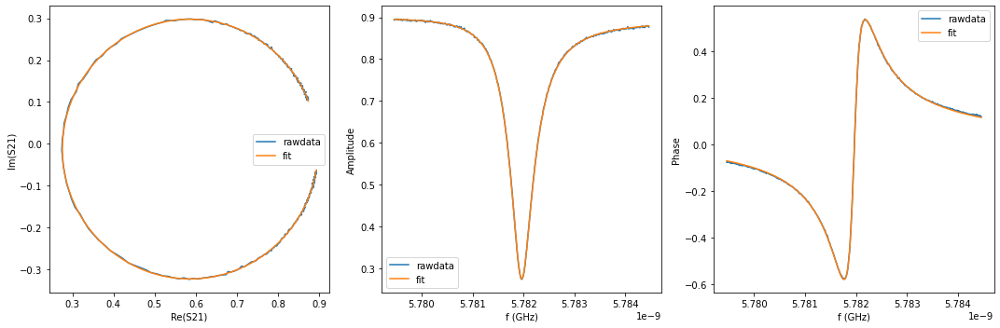

{'Qi_dia_corr': 24979.79873443051, 'Qi_no_corr': 25191.610648856273, 'absQc': 11081.530846856609, 'Qc_dia_corr(Re{Qc})': 11123.019369313502, 'Ql': 7696.096863303012, 'fr': 5.781940117303648, 'theta0': -3.0551950740484153, 'phi0': 0.08639780714148529, 'phi0_err': 0.0014146016581182445, 'Ql_err': 12.095755895487006, 'absQc_err': 10.889562535735298, 'fr_err': 6.182916746066863e-07, 'chi_square': 1.1979491942161584e-05, 'Qi_no_corr_err': 101.49302212888706, 'Qi_dia_corr_err': 100.09472716410211, 'delay': 0.6144166602053863, 'a': 0.8962338160868357, 'alpha': -2.7870799752146866}


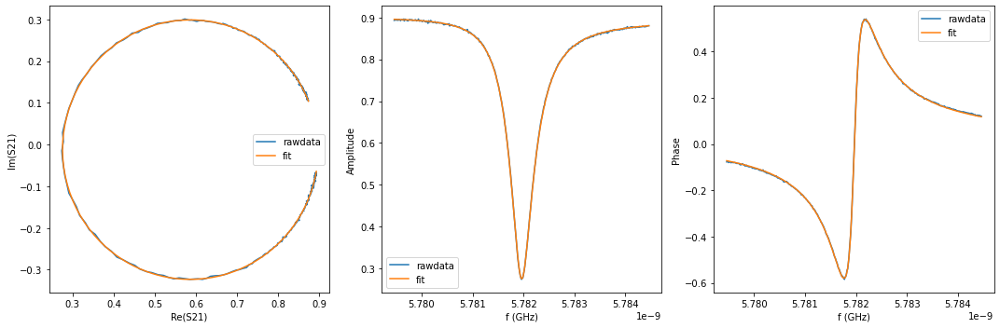

{'Qi_dia_corr': 25076.019458827686, 'Qi_no_corr': 25281.752912888904, 'absQc': 11115.514035722039, 'Qc_dia_corr(Re{Qc})': 11155.754932772355, 'Ql': 7720.900576069158, 'fr': 5.781941159420309, 'theta0': -3.056629628315795, 'phi0': 0.08496302701875373, 'phi0_err': 0.001060413732967827, 'Ql_err': 9.85913892115576, 'absQc_err': 9.580386490193467, 'fr_err': 4.852562498273053e-07, 'chi_square': 8.200337506308894e-06, 'Qi_no_corr_err': 78.26396239551245, 'Qi_dia_corr_err': 77.01795896740647, 'delay': 0.4798531940350677, 'a': 0.8967816207380604, 'alpha': -1.3924942090783394}


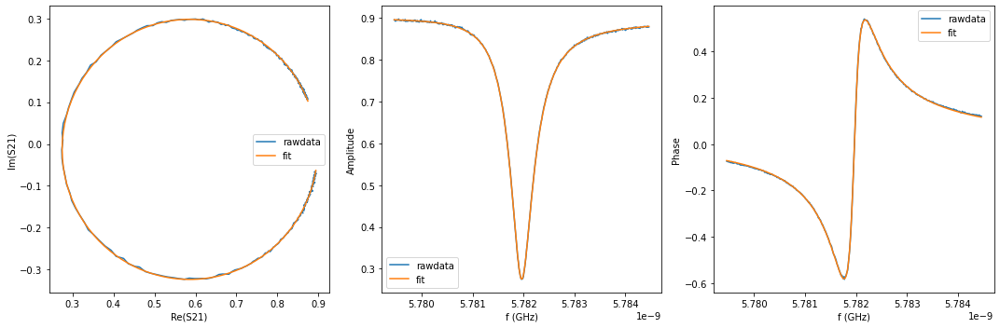

{'Qi_dia_corr': 25125.789578926575, 'Qi_no_corr': 25342.72177702023, 'absQc': 11119.798148062406, 'Qc_dia_corr(Re{Qc})': 11162.083819009114, 'Ql': 7728.647149510792, 'fr': 5.78194028635249, 'theta0': -3.054522404335523, 'phi0': 0.08707152896614694, 'phi0_err': 0.0011679097384263766, 'Ql_err': 10.910981620443073, 'absQc_err': 10.599602122982025, 'fr_err': 5.359934596847072e-07, 'chi_square': 9.971399719475696e-06, 'Qi_no_corr_err': 87.55424191148946, 'Qi_dia_corr_err': 86.13704002105179, 'delay': 0.5560390239983758, 'a': 0.8966687499769217, 'alpha': 1.3752726747018091}


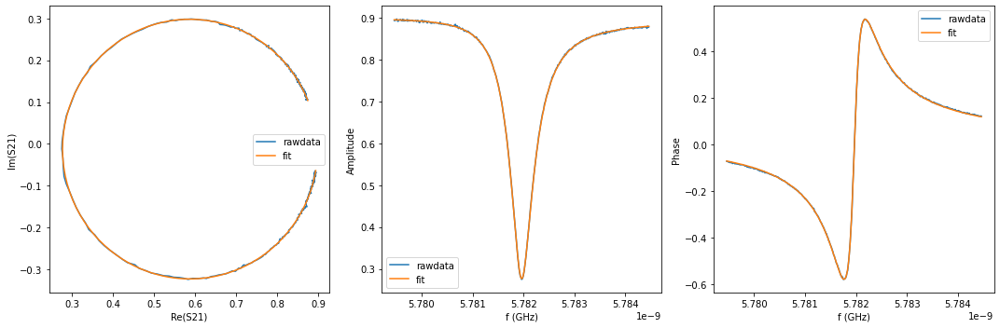

{'Qi_dia_corr': 25017.03132339219, 'Qi_no_corr': 25227.3192143781, 'absQc': 11147.378969453643, 'Qc_dia_corr(Re{Qc})': 11188.938347267233, 'Ql': 7731.156592552885, 'fr': 5.781940879106138, 'theta0': -3.0553756650160415, 'phi0': 0.08621634219611655, 'phi0_err': 0.0010152355501294925, 'Ql_err': 10.35409319472488, 'absQc_err': 9.444963170727277, 'fr_err': 4.426761316354319e-07, 'chi_square': 7.5375809618405535e-06, 'Qi_no_corr_err': 81.18228133742603, 'Qi_dia_corr_err': 80.22170705765045, 'delay': 0.47516954099306125, 'a': 0.8965454738425271, 'alpha': -1.5623220539115106}


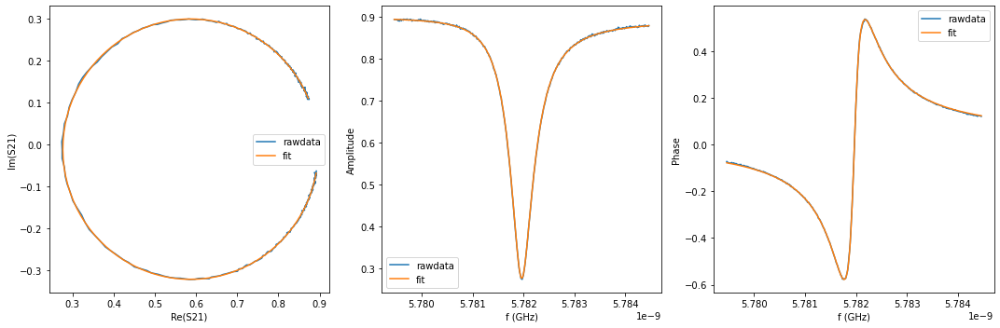

{'Qi_dia_corr': 25306.53631991516, 'Qi_no_corr': 25514.071754593457, 'absQc': 11286.020274248356, 'Qc_dia_corr(Re{Qc})': 11327.110615341222, 'Ql': 7824.772037941875, 'fr': 5.781941427455647, 'theta0': -3.0563893026833044, 'phi0': 0.08520335090648848, 'phi0_err': 0.001018116352790787, 'Ql_err': 8.762519718668596, 'absQc_err': 9.337103227106164, 'fr_err': 5.047608835765844e-07, 'chi_square': 7.375232716797769e-06, 'Qi_no_corr_err': 72.0145483965594, 'Qi_dia_corr_err': 71.07623188494726, 'delay': 0.008709363081915465, 'a': 0.8954413459730612, 'alpha': 0.3414107654456849}


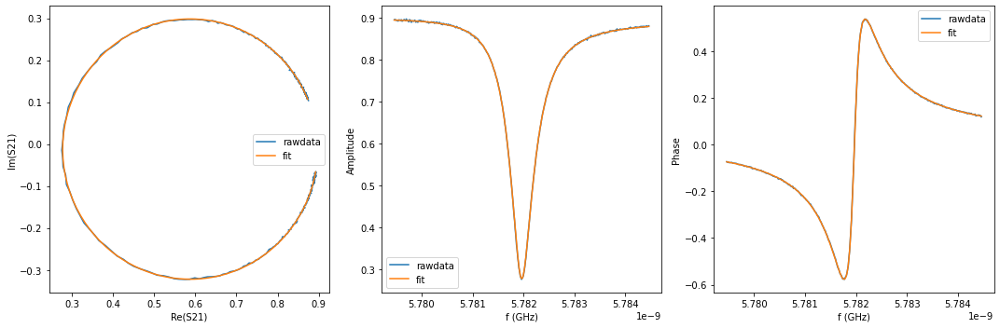

{'Qi_dia_corr': 25100.09234844027, 'Qi_no_corr': 25306.843355398873, 'absQc': 11230.092657277579, 'Qc_dia_corr(Re{Qc})': 11271.292103800643, 'Ql': 7778.380640504078, 'fr': 5.781941448768436, 'theta0': -3.0560650678448105, 'phi0': 0.08552758574498277, 'phi0_err': 0.0007554523399034605, 'Ql_err': 7.800511801101015, 'absQc_err': 7.82252700414026, 'fr_err': 3.553034094975638e-07, 'chi_square': 4.757165203653163e-06, 'Qi_no_corr_err': 59.97606492195073, 'Qi_dia_corr_err': 59.04482016348856, 'delay': 0.23136118262763272, 'a': 0.8962181663974023, 'alpha': 2.146772471941145}


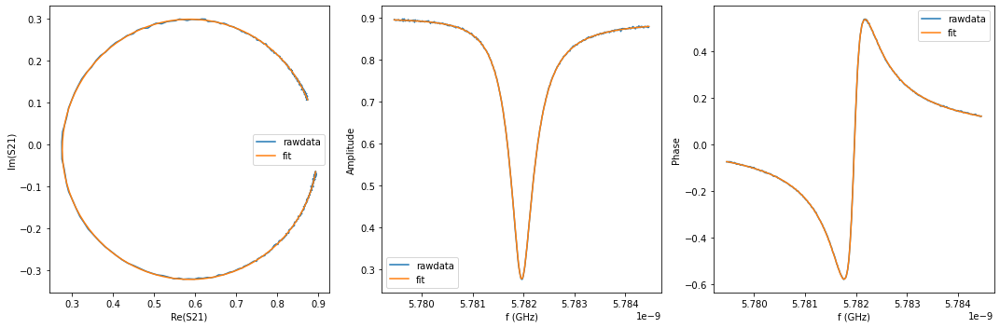

{'Qi_dia_corr': 25109.66121364714, 'Qi_no_corr': 25321.504612886594, 'absQc': 11194.793485922504, 'Qc_dia_corr(Re{Qc})': 11236.705609375525, 'Ql': 7762.808106316348, 'fr': 5.781940872786906, 'theta0': -3.0551953056053356, 'phi0': 0.08639734798445739, 'phi0_err': 0.000694946406994273, 'Ql_err': 7.654605560260201, 'absQc_err': 7.90037464700075, 'fr_err': 3.355739039856742e-07, 'chi_square': 4.459128447731862e-06, 'Qi_no_corr_err': 56.740362426490066, 'Qi_dia_corr_err': 56.02872829897264, 'delay': 0.29646632208403434, 'a': 0.8963212505580448, 'alpha': -1.7709141856881954}


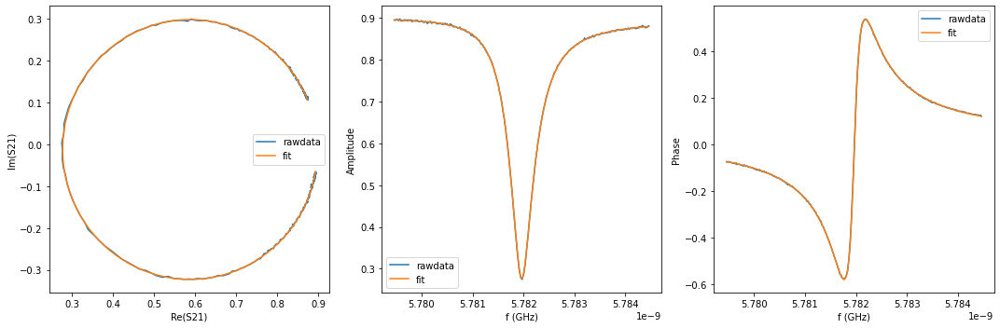

{'Qi_dia_corr': 25031.594884754773, 'Qi_no_corr': 25246.40232895267, 'absQc': 11167.584694459418, 'Qc_dia_corr(Re{Qc})': 11210.137824875585, 'Ql': 7742.665917294485, 'fr': 5.781940868611062, 'theta0': -3.0544337583335857, 'phi0': 0.08715910353649693, 'phi0_err': 0.0007489008776754481, 'Ql_err': 7.011534832249579, 'absQc_err': 7.4411979001834565, 'fr_err': 3.7553553066545394e-07, 'chi_square': 4.500638989363785e-06, 'Qi_no_corr_err': 56.50085622150943, 'Qi_dia_corr_err': 55.67668697295936, 'delay': 0.3217088060467748, 'a': 0.8966016750120872, 'alpha': -0.8538390002773306}


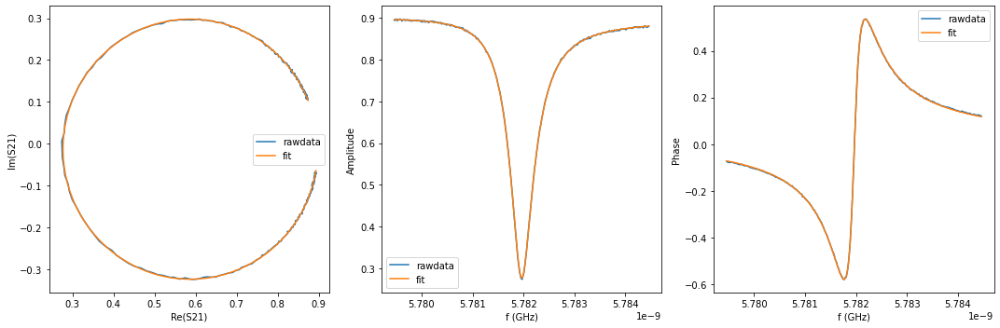

{'Qi_dia_corr': 24949.638271684347, 'Qi_no_corr': 25162.67422870948, 'absQc': 11134.265597937201, 'Qc_dia_corr(Re{Qc})': 11176.493451597771, 'Ql': 7718.774622733932, 'fr': 5.781940943716256, 'theta0': -3.0546368640316173, 'phi0': 0.08695579957568413, 'phi0_err': 0.001011865405996718, 'Ql_err': 9.063921706436055, 'absQc_err': 8.634611507103582, 'fr_err': 4.487696676928892e-07, 'chi_square': 6.879413070781514e-06, 'Qi_no_corr_err': 71.17994632038717, 'Qi_dia_corr_err': 70.29802066213625, 'delay': 0.48917801952087014, 'a': 0.896900387674734, 'alpha': -1.0535059642243176}


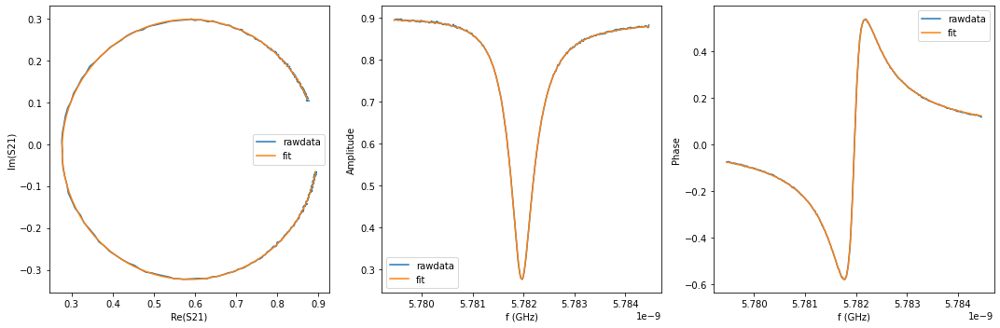

{'Qi_dia_corr': 25174.333341387213, 'Qi_no_corr': 25388.56966863235, 'absQc': 11226.987871389472, 'Qc_dia_corr(Re{Qc})': 11269.397145505327, 'Ql': 7784.591656978279, 'fr': 5.781941418796097, 'theta0': -3.054810311847036, 'phi0': 0.08678234174275694, 'phi0_err': 0.0007135032907316831, 'Ql_err': 7.468284065388334, 'absQc_err': 8.129945246000908, 'fr_err': 3.6472457491185735e-07, 'chi_square': 4.6977022594079825e-06, 'Qi_no_corr_err': 55.588343221389316, 'Qi_dia_corr_err': 54.632700027918936, 'delay': 0.17175118017605998, 'a': 0.8963984226224262, 'alpha': -0.018874701578884275}


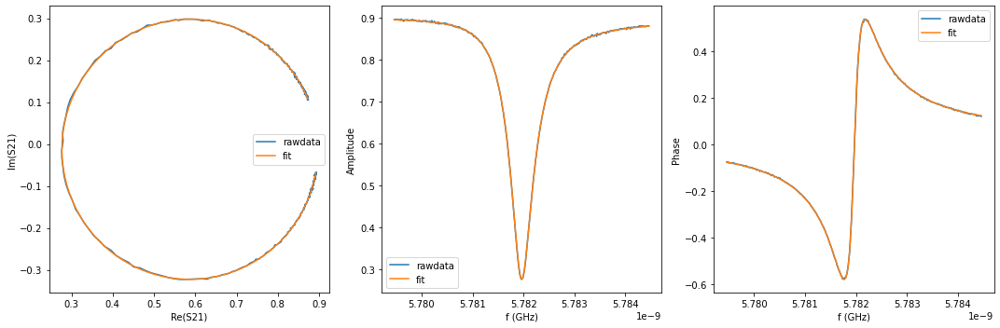

{'Qi_dia_corr': 25204.204533363947, 'Qi_no_corr': 25417.07651397919, 'absQc': 11264.723385293293, 'Qc_dia_corr(Re{Qc})': 11307.047673630605, 'Ql': 7805.4058682788045, 'fr': 5.781941021389721, 'theta0': -3.055042590970122, 'phi0': 0.0865507392358171, 'phi0_err': 0.0007546874729245769, 'Ql_err': 7.698649507484187, 'absQc_err': 7.688650296360507, 'fr_err': 3.541578875741912e-07, 'chi_square': 4.656227903992482e-06, 'Qi_no_corr_err': 60.08797573989835, 'Qi_dia_corr_err': 59.1794626066678, 'delay': 0.12457777753703822, 'a': 0.8958563718871746, 'alpha': -1.732622396355082}


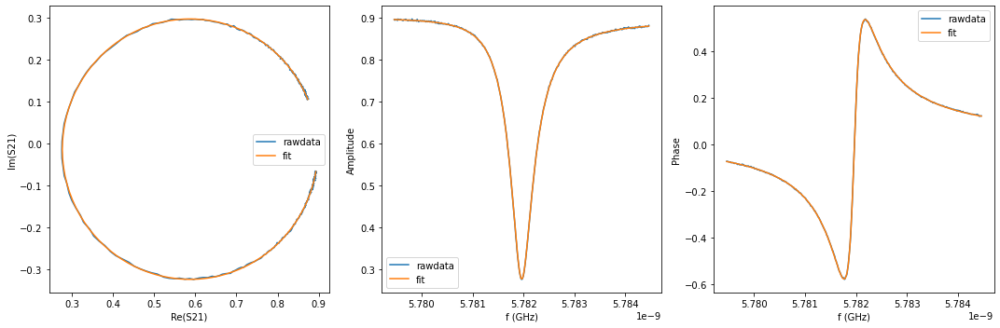

{'Qi_dia_corr': 25095.998932691517, 'Qi_no_corr': 25311.598910636505, 'absQc': 11216.01676318373, 'Qc_dia_corr(Re{Qc})': 11258.877376737208, 'Ql': 7772.0736064399935, 'fr': 5.781940784435666, 'theta0': -3.054310099894424, 'phi0': 0.08728397476783165, 'phi0_err': 0.0006407815965679639, 'Ql_err': 6.812235673614509, 'absQc_err': 7.534673951042833, 'fr_err': 3.309493197467401e-07, 'chi_square': 3.900267234241162e-06, 'Qi_no_corr_err': 50.20646637336636, 'Qi_dia_corr_err': 49.567084334982255, 'delay': 0.27708711260166, 'a': 0.8965299322302653, 'alpha': -2.4752874995657037}


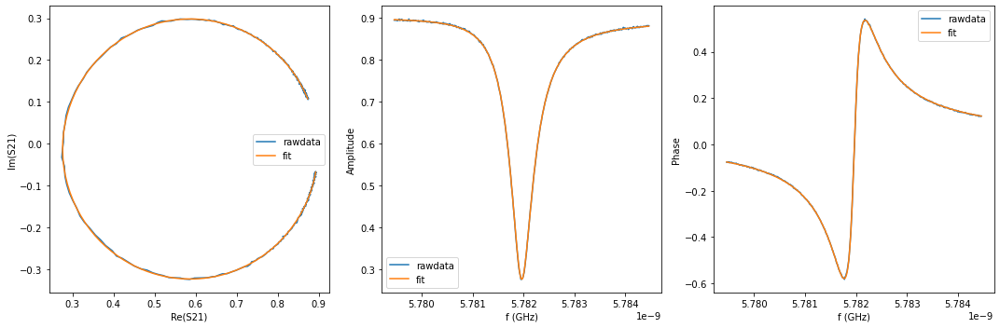

{'Qi_dia_corr': 25273.170140043978, 'Qi_no_corr': 25488.814976073638, 'absQc': 11252.010488027103, 'Qc_dia_corr(Re{Qc})': 11294.553564715445, 'Ql': 7806.041639385428, 'fr': 5.7819412779364, 'theta0': -3.054771248043782, 'phi0': 0.08682230783694406, 'phi0_err': 0.0007346758366594553, 'Ql_err': 7.175012279558167, 'absQc_err': 7.778438900369217, 'fr_err': 3.720597882849078e-07, 'chi_square': 4.582353843418478e-06, 'Qi_no_corr_err': 55.367798269484105, 'Qi_dia_corr_err': 54.8004622312343, 'delay': 0.1463947814189829, 'a': 0.8961617293850567, 'alpha': -0.9400380668922752}


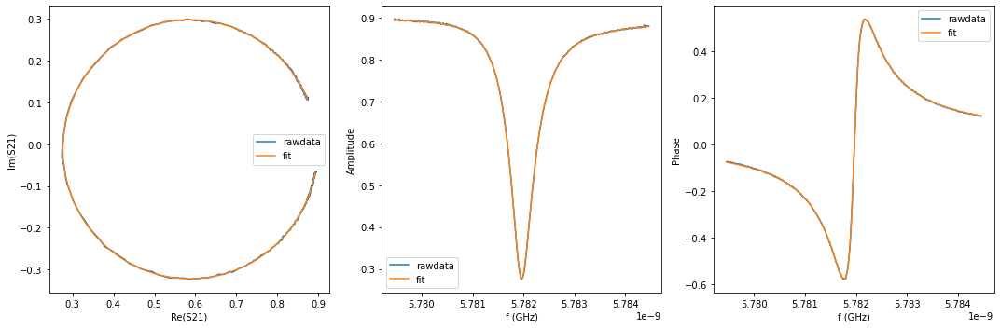

{'Qi_dia_corr': 25189.992446590382, 'Qi_no_corr': 25399.962440267074, 'absQc': 11250.126259388997, 'Qc_dia_corr(Re{Qc})': 11291.81485535063, 'Ql': 7796.7828885343015, 'fr': 5.781941373977586, 'theta0': -3.0556384759790025, 'phi0': 0.08595585484024638, 'phi0_err': 0.0007509391721509279, 'Ql_err': 7.847899663639159, 'absQc_err': 7.970885694733843, 'fr_err': 3.5782467515244955e-07, 'chi_square': 4.797555146215739e-06, 'Qi_no_corr_err': 60.955095084895476, 'Qi_dia_corr_err': 60.44847832389853, 'delay': 0.13458779560840764, 'a': 0.8960596647672925, 'alpha': -1.3686334285907207}


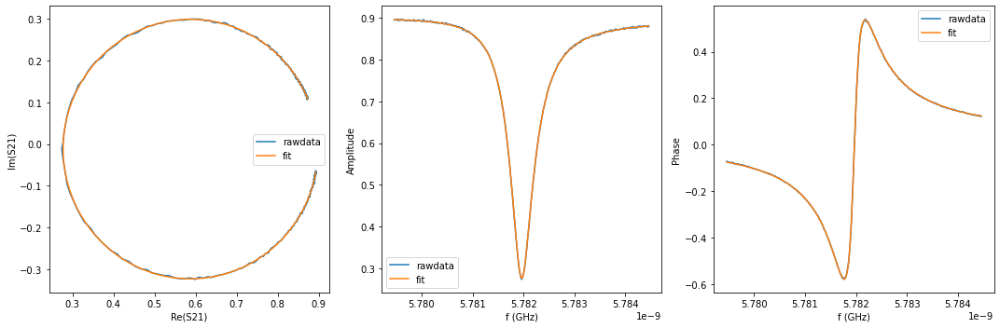

{'Qi_dia_corr': 25158.120071067886, 'Qi_no_corr': 25370.383283469302, 'absQc': 11228.673394999765, 'Qc_dia_corr(Re{Qc})': 11270.760707805433, 'Ql': 7783.690992331741, 'fr': 5.7819411098498215, 'theta0': -3.0551457941957083, 'phi0': 0.08644685939408461, 'phi0_err': 0.0006974936568215646, 'Ql_err': 7.064033835356691, 'absQc_err': 7.600575154621421, 'fr_err': 3.509783369716335e-07, 'chi_square': 4.293957330016646e-06, 'Qi_no_corr_err': 54.96675833262347, 'Qi_dia_corr_err': 54.14666830714982, 'delay': 0.18622431372351456, 'a': 0.8966966064456335, 'alpha': 0.5074803551217348}


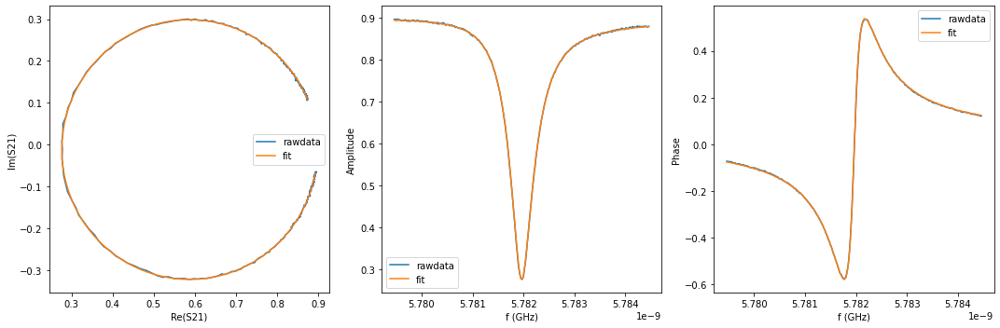

{'Qi_dia_corr': 25264.389923487255, 'Qi_no_corr': 25474.563955626036, 'absQc': 11271.480359324914, 'Qc_dia_corr(Re{Qc})': 11313.121911317836, 'Ql': 7814.066864644191, 'fr': 5.7819408178616145, 'theta0': -3.0557677879608693, 'phi0': 0.08582632586455703, 'phi0_err': 0.0008942412595494214, 'Ql_err': 8.524679556767493, 'absQc_err': 8.450313618784609, 'fr_err': 4.190812734441683e-07, 'chi_square': 5.982601718108948e-06, 'Qi_no_corr_err': 69.4945776091613, 'Qi_dia_corr_err': 68.80846913454616, 'delay': 0.09663627666988014, 'a': 0.8962836994758383, 'alpha': -2.7472520991508924}


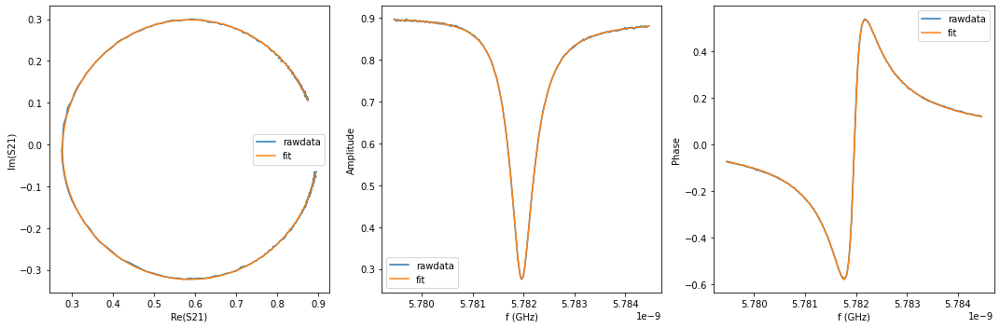

{'Qi_dia_corr': 25141.25608544306, 'Qi_no_corr': 25348.040187796872, 'absQc': 11187.768910354156, 'Qc_dia_corr(Re{Qc})': 11228.530602288994, 'Ql': 7761.919687876658, 'fr': 5.781941570482858, 'theta0': -3.0563590002197665, 'phi0': 0.08523365337002667, 'phi0_err': 0.0006996862036945901, 'Ql_err': 7.166497062529427, 'absQc_err': 7.326303688769949, 'fr_err': 3.4111171208983105e-07, 'chi_square': 4.140596161689518e-06, 'Qi_no_corr_err': 55.106936460807496, 'Qi_dia_corr_err': 54.50110055077158, 'delay': 0.33369703497499725, 'a': 0.8970508731667612, 'alpha': -0.4188063041608303}


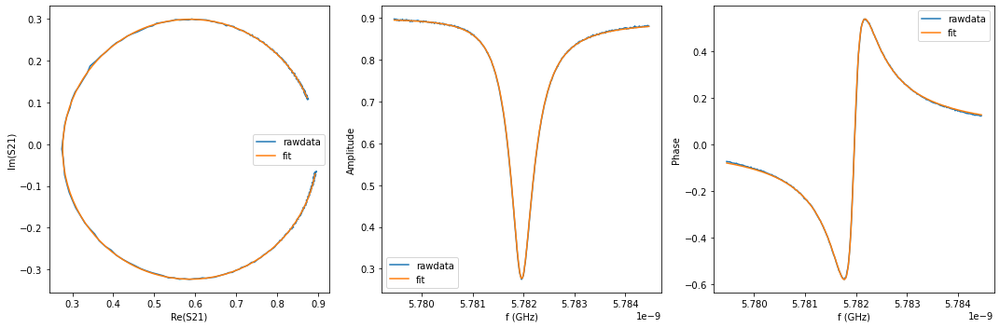

{'Qi_dia_corr': 25403.956932142508, 'Qi_no_corr': 25616.04942100696, 'absQc': 11339.275974682036, 'Qc_dia_corr(Re{Qc})': 11381.338022760454, 'Ql': 7859.962012397169, 'fr': 5.781941159863472, 'theta0': -3.055592864282745, 'phi0': 0.08599978930704845, 'phi0_err': 0.0015062828385929558, 'Ql_err': 12.77847215351998, 'absQc_err': 10.325154867040363, 'fr_err': 6.427018553478423e-07, 'chi_square': 1.0969740479706509e-05, 'Qi_no_corr_err': 117.48140810326194, 'Qi_dia_corr_err': 115.63728616068697, 'delay': -0.1653207310958543, 'a': 0.8959114436394429, 'alpha': 0.3021297080396056}


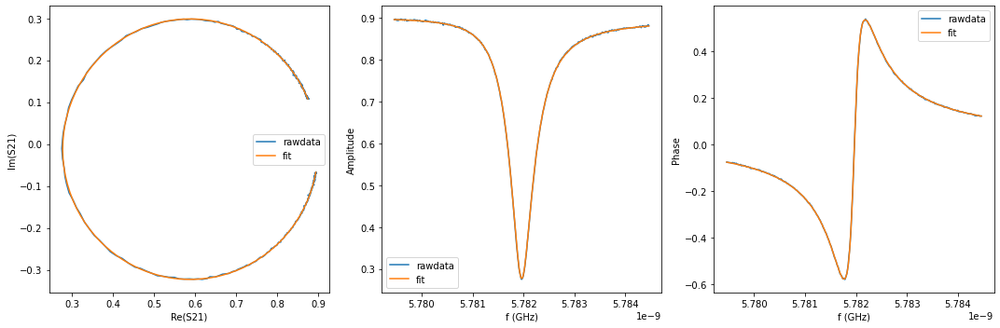

{'Qi_dia_corr': 25106.162081216557, 'Qi_no_corr': 25317.1503534609, 'absQc': 11218.235648322776, 'Qc_dia_corr(Re{Qc})': 11260.166388929922, 'Ql': 7773.662459602232, 'fr': 5.7819410153874555, 'theta0': -3.055266243991732, 'phi0': 0.08632641819364338, 'phi0_err': 0.0007181665683061283, 'Ql_err': 7.381494085259066, 'absQc_err': 7.122005561102925, 'fr_err': 3.327869232110016e-07, 'chi_square': 4.117462847212509e-06, 'Qi_no_corr_err': 59.62555788127688, 'Qi_dia_corr_err': 58.96348678541686, 'delay': 0.17373827715899257, 'a': 0.8970914156999167, 'alpha': 0.05369702853572675}


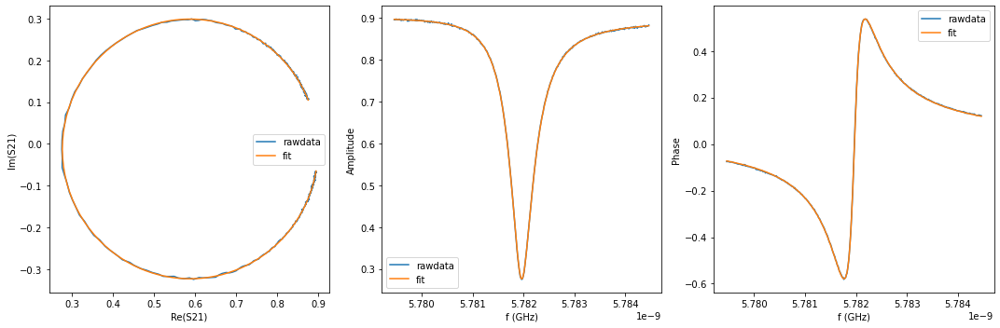

{'Qi_dia_corr': 25092.9873195521, 'Qi_no_corr': 25299.828641725144, 'absQc': 11142.384219211888, 'Qc_dia_corr(Re{Qc})': 11182.982076938719, 'Ql': 7735.545930815211, 'fr': 5.781941253338249, 'theta0': -3.0563597215198492, 'phi0': 0.08523524531131504, 'phi0_err': 0.0007747197403942165, 'Ql_err': 7.261407657953823, 'absQc_err': 7.611150760080446, 'fr_err': 3.804902791797036e-07, 'chi_square': 4.812283962066669e-06, 'Qi_no_corr_err': 55.292118826564206, 'Qi_dia_corr_err': 54.61117720462897, 'delay': 0.40116534478327825, 'a': 0.8978183384257792, 'alpha': 2.03224493104613}


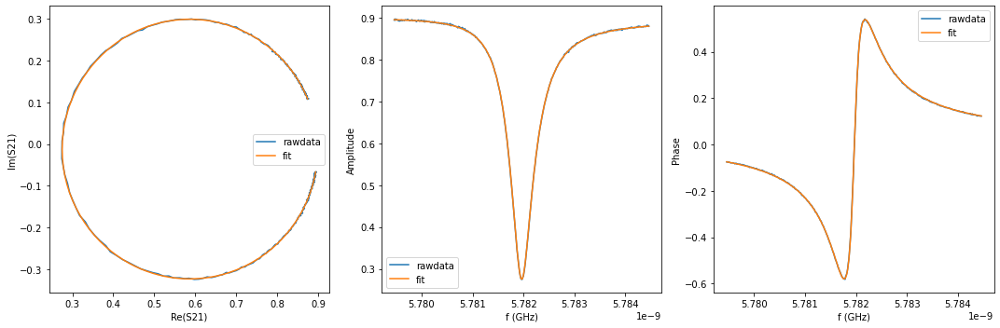

{'Qi_dia_corr': 25464.50205590003, 'Qi_no_corr': 25681.035730427036, 'absQc': 11272.936269238719, 'Qc_dia_corr(Re{Qc})': 11315.171601879723, 'Ql': 7834.088284738778, 'fr': 5.781940884377899, 'theta0': -3.055164036148223, 'phi0': 0.08642861744157, 'phi0_err': 0.0007227117694492208, 'Ql_err': 7.200621277655103, 'absQc_err': 7.222130702437459, 'fr_err': 3.3945808925721505e-07, 'chi_square': 4.188834364377367e-06, 'Qi_no_corr_err': 57.26875449573963, 'Qi_dia_corr_err': 56.61081724958395, 'delay': 0.14368380574548464, 'a': 0.8966646973396933, 'alpha': -1.037851107999564}


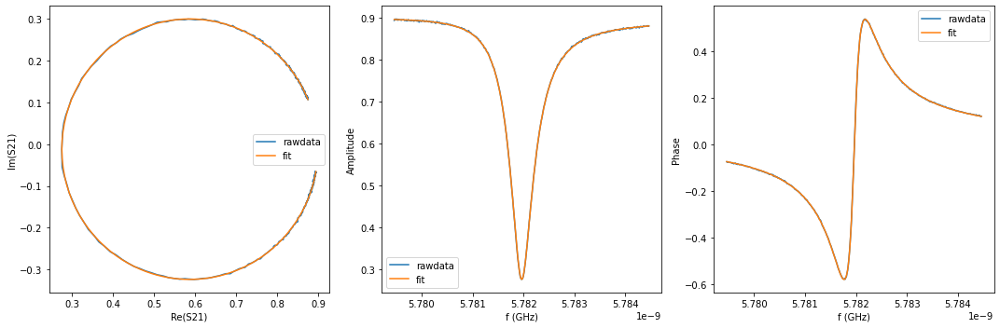

{'Qi_dia_corr': 25288.396495520865, 'Qi_no_corr': 25503.269379140453, 'absQc': 11209.333249263802, 'Qc_dia_corr(Re{Qc})': 11251.352565038123, 'Ql': 7786.825911256738, 'fr': 5.781940703835299, 'theta0': -3.0551413486758183, 'phi0': 0.0864514678452857, 'phi0_err': 0.0006666788836612364, 'Ql_err': 6.589769363396945, 'absQc_err': 6.729308224963633, 'fr_err': 3.2321390636831907e-07, 'chi_square': 3.6161180824776217e-06, 'Qi_no_corr_err': 53.75837861644037, 'Qi_dia_corr_err': 52.690679698296066, 'delay': 0.27909891614574994, 'a': 0.8976314411647915, 'alpha': -2.40148816277974}


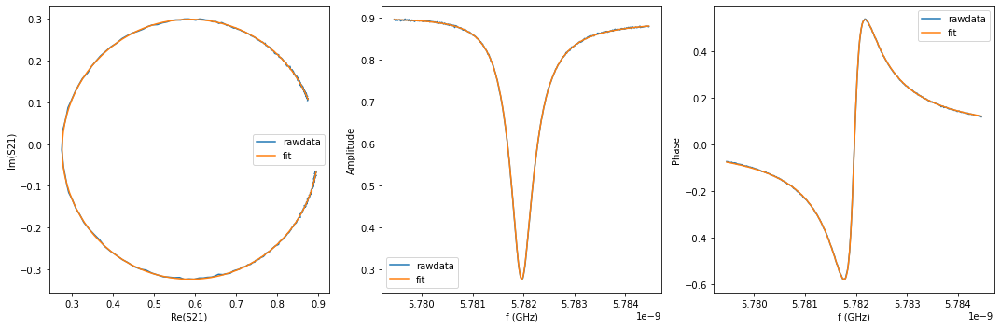

{'Qi_dia_corr': 25329.696216082597, 'Qi_no_corr': 25543.188466143376, 'absQc': 11251.920021445463, 'Qc_dia_corr(Re{Qc})': 11293.852038684703, 'Ql': 7811.090265182889, 'fr': 5.781940807048267, 'theta0': -3.055395114105391, 'phi0': 0.08619881425266823, 'phi0_err': 0.0006740682107571831, 'Ql_err': 7.571723922837262, 'absQc_err': 7.230548362312744, 'fr_err': 3.129650159427357e-07, 'chi_square': 3.911467042060189e-06, 'Qi_no_corr_err': 60.81242588033572, 'Qi_dia_corr_err': 59.99896144847422, 'delay': 0.15477537331018126, 'a': 0.8973311791450339, 'alpha': -0.6354855112798041}


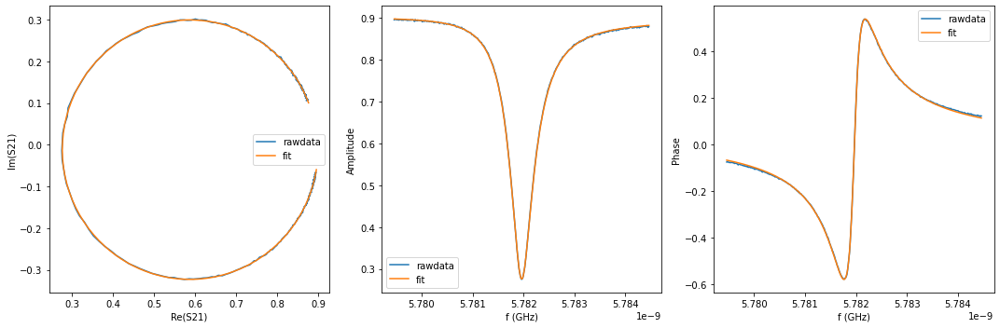

{'Qi_dia_corr': 24945.61317490439, 'Qi_no_corr': 25148.430551782516, 'absQc': 11047.655036926988, 'Qc_dia_corr(Re{Qc})': 11087.254949763837, 'Ql': 7675.724624291181, 'fr': 5.781941194849224, 'theta0': -3.0570493187035273, 'phi0': 0.0845433481667697, 'phi0_err': 0.0020594781827893184, 'Ql_err': 15.882241077329565, 'absQc_err': 12.113053277167412, 'fr_err': 8.360439385075931e-07, 'chi_square': 1.7249077751667826e-05, 'Qi_no_corr_err': 142.64544906009831, 'Qi_dia_corr_err': 140.44570173055286, 'delay': 0.8133491385223538, 'a': 0.8989358202131177, 'alpha': -1.842590130187918}


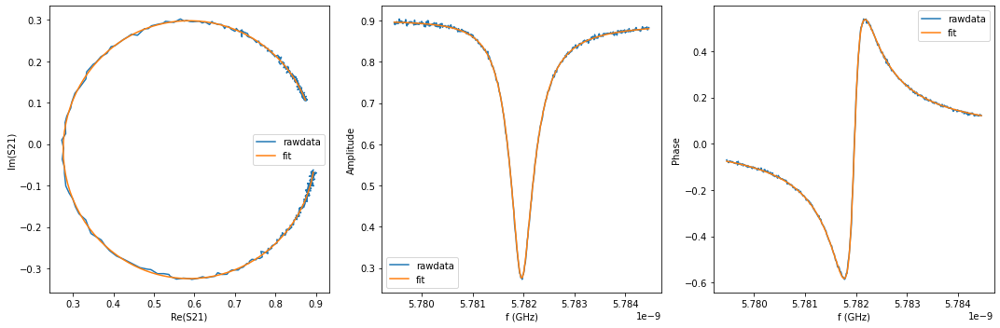

{'Qi_dia_corr': 25379.98699163441, 'Qi_no_corr': 25605.118830254098, 'absQc': 11256.015599669552, 'Qc_dia_corr(Re{Qc})': 11300.079701305354, 'Ql': 7818.848265037775, 'fr': 5.781939676741814, 'theta0': -3.0532525444487124, 'phi0': 0.08834010914108069, 'phi0_err': 0.00165515456359305, 'Ql_err': 17.611407459906577, 'absQc_err': 18.11382976735754, 'fr_err': 7.991455009592345e-07, 'chi_square': 2.41393129004525e-05, 'Qi_no_corr_err': 139.56544448378264, 'Qi_dia_corr_err': 138.23838863227644, 'delay': 0.17099937604364865, 'a': 0.8970749855424467, 'alpha': -0.04677176127022965}


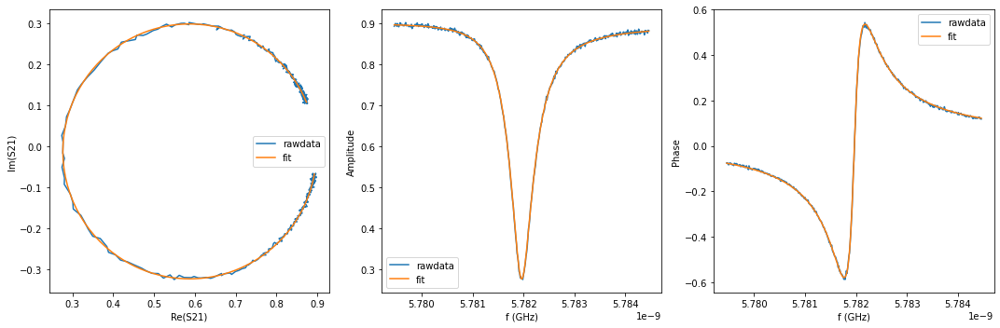

{'Qi_dia_corr': 25382.984276097723, 'Qi_no_corr': 25601.872915962933, 'absQc': 11294.339249066967, 'Qc_dia_corr(Re{Qc})': 11337.469876811714, 'Ql': 7837.016895692235, 'fr': 5.781940426558248, 'theta0': -3.054338236786327, 'phi0': 0.08725445114397497, 'phi0_err': 0.0017400319429074196, 'Ql_err': 18.483272218559957, 'absQc_err': 18.98681345809005, 'fr_err': 8.413381902180853e-07, 'chi_square': 2.6514625603099344e-05, 'Qi_no_corr_err': 145.3446277443441, 'Qi_dia_corr_err': 143.63397543804828, 'delay': 0.1202018163441037, 'a': 0.8966586144958115, 'alpha': -1.8922084047876904}


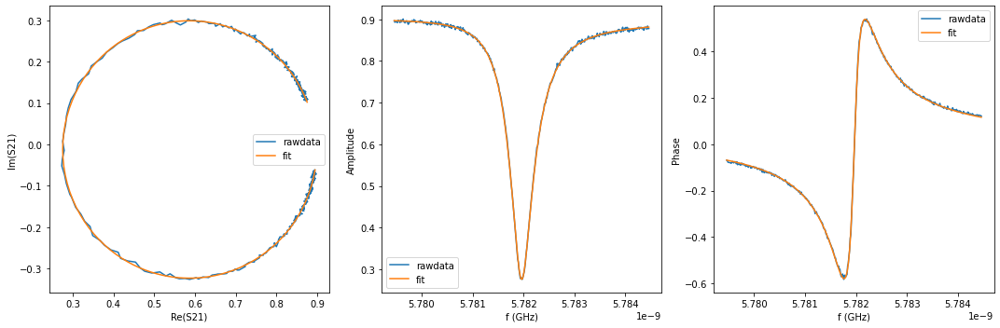

{'Qi_dia_corr': 25184.81535038195, 'Qi_no_corr': 25396.112258802576, 'absQc': 11141.362095692433, 'Qc_dia_corr(Re{Qc})': 11182.521127482089, 'Ql': 7744.029588716317, 'fr': 5.781940436278656, 'theta0': -3.0557683419862585, 'phi0': 0.08582444557661029, 'phi0_err': 0.001781039192730019, 'Ql_err': 17.545472938234173, 'absQc_err': 18.573115528459255, 'fr_err': 8.863116421525595e-07, 'chi_square': 2.7168568219344635e-05, 'Qi_no_corr_err': 133.53208082225208, 'Qi_dia_corr_err': 131.1261434808942, 'delay': 0.6244909876489281, 'a': 0.8980719356164495, 'alpha': -2.4204461480807535}


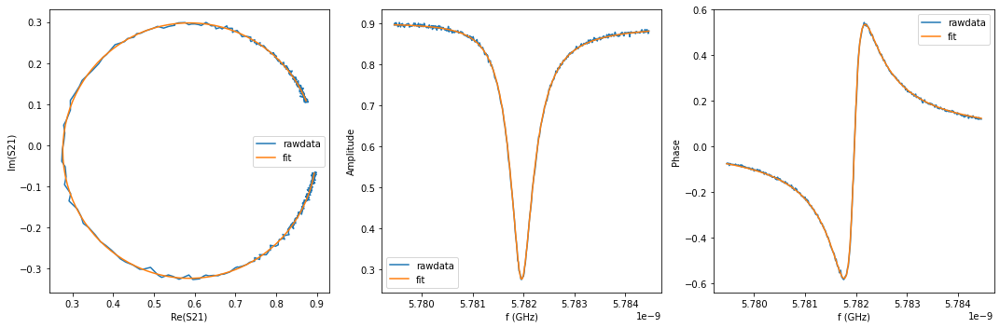

{'Qi_dia_corr': 25357.18755549381, 'Qi_no_corr': 25582.808734870792, 'absQc': 11312.450071304207, 'Qc_dia_corr(Re{Qc})': 11357.134478614418, 'Ql': 7843.9413588966245, 'fr': 5.7819395760848655, 'theta0': -3.0528563955079413, 'phi0': 0.08873625808185179, 'phi0_err': 0.001717224161177323, 'Ql_err': 17.858106775537696, 'absQc_err': 18.807881001960613, 'fr_err': 8.409486422268385e-07, 'chi_square': 2.5905312528302876e-05, 'Qi_no_corr_err': 136.18476474688927, 'Qi_dia_corr_err': 134.19583776235993, 'delay': 0.07906201285386685, 'a': 0.8967580106142913, 'alpha': 2.8973784937596103}


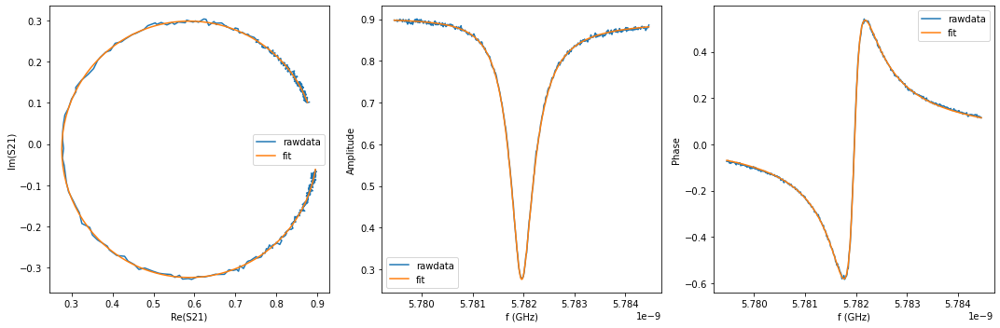

{'Qi_dia_corr': 25070.661449906645, 'Qi_no_corr': 25286.002277043062, 'absQc': 11110.394324983954, 'Qc_dia_corr(Re{Qc})': 11152.484576035526, 'Ql': 7718.826104470584, 'fr': 5.781940343886007, 'theta0': -3.054685294680927, 'phi0': 0.08690737311003541, 'phi0_err': 0.0019011514949238068, 'Ql_err': 19.198090157650345, 'absQc_err': 20.058638558038634, 'fr_err': 9.366710237767017e-07, 'chi_square': 3.155010827371598e-05, 'Qi_no_corr_err': 149.05922251030793, 'Qi_dia_corr_err': 147.02134375084816, 'delay': 0.6875383391226948, 'a': 0.8985773084961525, 'alpha': -0.13065911586299414}


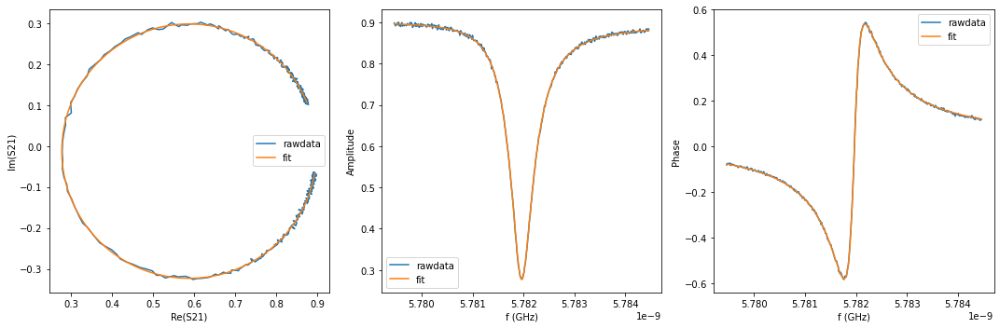

{'Qi_dia_corr': 25290.61275292642, 'Qi_no_corr': 25498.70100539507, 'absQc': 11275.714248412014, 'Qc_dia_corr(Re{Qc})': 11316.88997863782, 'Ql': 7818.372209542223, 'fr': 5.781941080665555, 'theta0': -3.0562622382755764, 'phi0': 0.08533041799242944, 'phi0_err': 0.001601276960843754, 'Ql_err': 18.228532734220586, 'absQc_err': 18.235708120079984, 'fr_err': 7.484614915311947e-07, 'chi_square': 2.3322212096041818e-05, 'Qi_no_corr_err': 137.0886687035302, 'Qi_dia_corr_err': 135.01672707507225, 'delay': 0.17733307476446875, 'a': 0.8970018176230654, 'alpha': 0.18330351514146798}


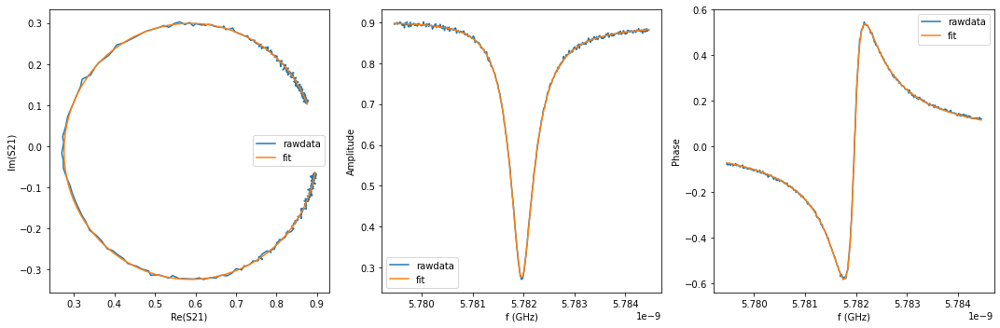

{'Qi_dia_corr': 25157.458780391185, 'Qi_no_corr': 25362.889276271006, 'absQc': 11132.61367629083, 'Qc_dia_corr(Re{Qc})': 11172.659119618194, 'Ql': 7736.713435468478, 'fr': 5.781940570434911, 'theta0': -3.056900518872855, 'phi0': 0.08469213471693786, 'phi0_err': 0.0017059633604340776, 'Ql_err': 16.807594984173917, 'absQc_err': 17.864738872697522, 'fr_err': 8.535890124643058e-07, 'chi_square': 2.5042349061069236e-05, 'Qi_no_corr_err': 127.57421597006885, 'Qi_dia_corr_err': 126.41995829358653, 'delay': 0.5511228177584166, 'a': 0.8986025127818389, 'alpha': 1.1965999067619573}


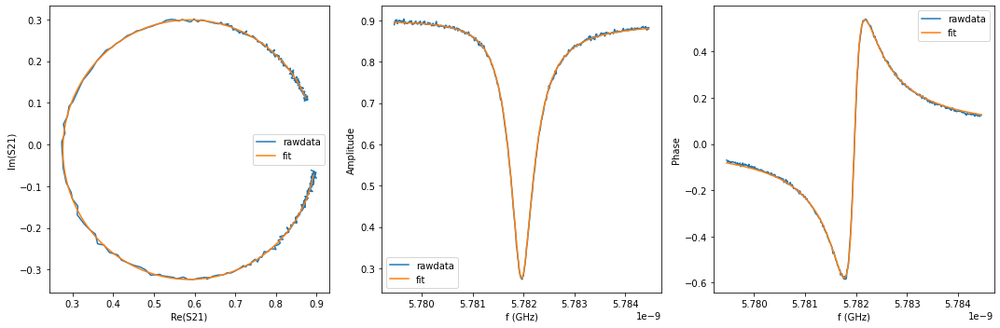

{'Qi_dia_corr': 25572.933037570554, 'Qi_no_corr': 25782.07178453536, 'absQc': 11378.447333773176, 'Qc_dia_corr(Re{Qc})': 11419.663963344941, 'Ql': 7894.398488404327, 'fr': 5.781940864625809, 'theta0': -3.0566051087269455, 'phi0': 0.08498754486284754, 'phi0_err': 0.002435578027169992, 'Ql_err': 22.45513929263056, 'absQc_err': 20.747144565779614, 'fr_err': 1.0767666099302056e-06, 'chi_square': 3.8330826459994774e-05, 'Qi_no_corr_err': 188.832129304403, 'Qi_dia_corr_err': 187.37151137432105, 'delay': -0.267248958983017, 'a': 0.8964550392970432, 'alpha': 2.8814249347031216}


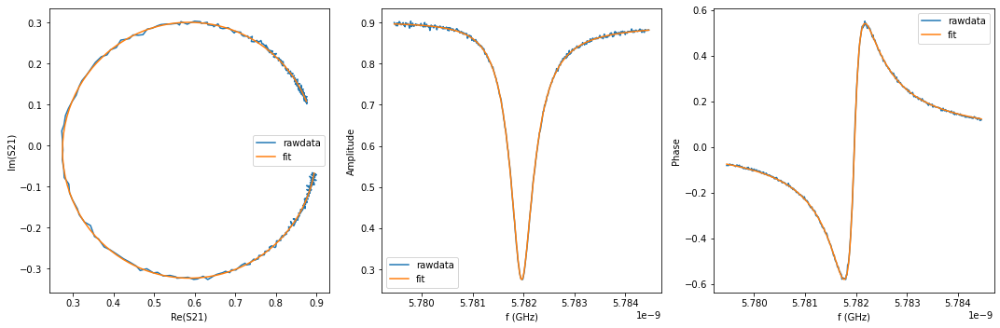

{'Qi_dia_corr': 25538.05596189993, 'Qi_no_corr': 25743.687284889224, 'absQc': 11271.53336273191, 'Qc_dia_corr(Re{Qc})': 11311.411096664599, 'Ql': 7839.230052786803, 'fr': 5.781941514100605, 'theta0': -3.057598450584659, 'phi0': 0.08399424155193821, 'phi0_err': 0.0015383535846382023, 'Ql_err': 17.2249528412463, 'absQc_err': 18.287950690096114, 'fr_err': 7.611082039832753e-07, 'chi_square': 2.274695706909945e-05, 'Qi_no_corr_err': 130.97651153679612, 'Qi_dia_corr_err': 129.111326133114, 'delay': 0.14652955892370298, 'a': 0.897456270555102, 'alpha': -0.9353937258076754}


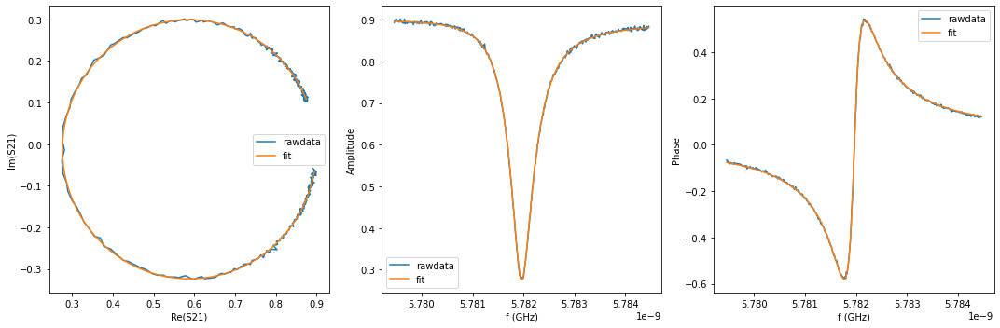

{'Qi_dia_corr': 25369.436768181822, 'Qi_no_corr': 25584.83644431363, 'absQc': 11287.153470917818, 'Qc_dia_corr(Re{Qc})': 11329.591014561347, 'Ql': 7831.960687210081, 'fr': 5.781940990142323, 'theta0': -3.055012439336525, 'phi0': 0.08658021425326833, 'phi0_err': 0.0016368294503190696, 'Ql_err': 16.52975775841548, 'absQc_err': 18.059920437928493, 'fr_err': 8.286457528883928e-07, 'chi_square': 2.3595065277685618e-05, 'Qi_no_corr_err': 129.2700300408398, 'Qi_dia_corr_err': 127.51775792999265, 'delay': 0.09433594244846762, 'a': 0.8975692123253267, 'alpha': -2.831184997559141}


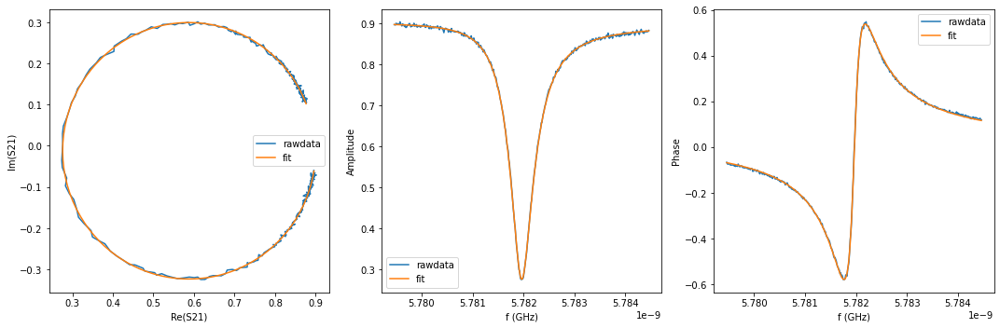

{'Qi_dia_corr': 25092.133449721106, 'Qi_no_corr': 25302.601618608536, 'absQc': 11123.987709314146, 'Qc_dia_corr(Re{Qc})': 11165.160387974447, 'Ql': 7726.933391573853, 'fr': 5.781941179171579, 'theta0': -3.0556873850675856, 'phi0': 0.08590543182718244, 'phi0_err': 0.0017752821562884978, 'Ql_err': 17.629864850036043, 'absQc_err': 18.12869871549168, 'fr_err': 8.55453046822819e-07, 'chi_square': 2.6465306669465617e-05, 'Qi_no_corr_err': 134.30487704776596, 'Qi_dia_corr_err': 132.56145970619164, 'delay': 0.6554751391889393, 'a': 0.8989133681287975, 'alpha': -1.2950098347338501}


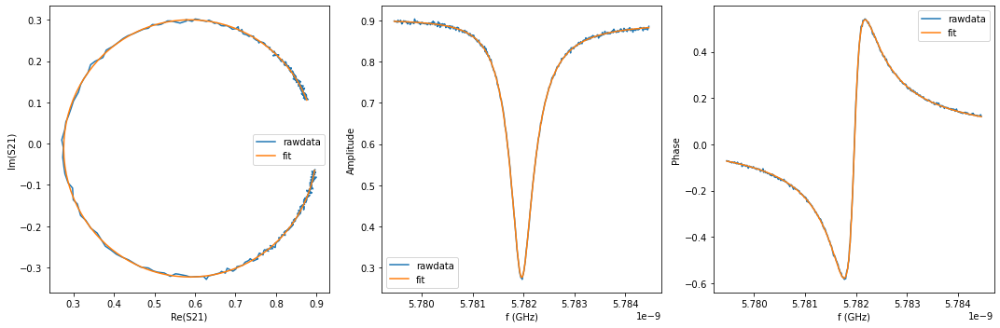

{'Qi_dia_corr': 25199.73493401073, 'Qi_no_corr': 25402.24795191033, 'absQc': 11180.307876359293, 'Qc_dia_corr(Re{Qc})': 11219.993314860865, 'Ql': 7763.398330810622, 'fr': 5.781941323305496, 'theta0': -3.057460069973437, 'phi0': 0.08413222659755151, 'phi0_err': 0.0014988428351070452, 'Ql_err': 15.66019127768025, 'absQc_err': 16.498394590431815, 'fr_err': 7.402526628259487e-07, 'chi_square': 2.0189463842478616e-05, 'Qi_no_corr_err': 119.7863728243225, 'Qi_dia_corr_err': 118.37209012117621, 'delay': 0.38265192541033677, 'a': 0.8986881097316863, 'alpha': 1.3600369903719762}


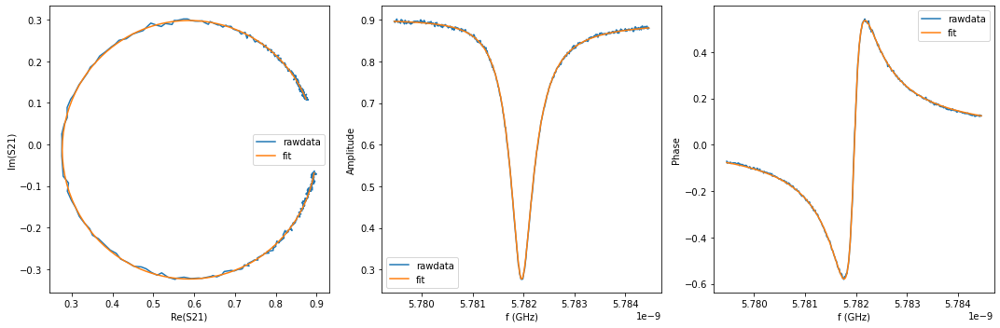

{'Qi_dia_corr': 25302.631518514754, 'Qi_no_corr': 25524.340146833623, 'absQc': 11303.111995480942, 'Qc_dia_corr(Re{Qc})': 11347.141813852792, 'Ql': 7833.951536357322, 'fr': 5.781939929433161, 'theta0': -3.0534703724219376, 'phi0': 0.0881222819241102, 'phi0_err': 0.0016129100526271517, 'Ql_err': 16.477145625555043, 'absQc_err': 17.392095191438962, 'fr_err': 7.978177677104092e-07, 'chi_square': 2.237611834815369e-05, 'Qi_no_corr_err': 128.7502662772968, 'Qi_dia_corr_err': 126.44333724561068, 'delay': 0.009530309537911995, 'a': 0.8972084496080663, 'alpha': 0.3712185026036288}


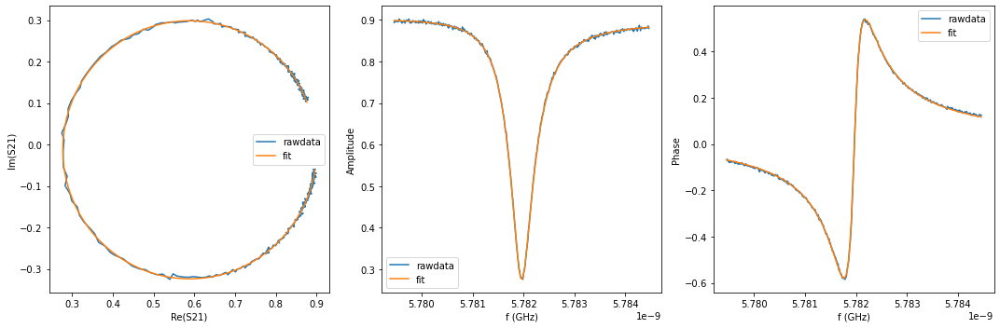

{'Qi_dia_corr': 24907.408836512473, 'Qi_no_corr': 25124.79737334055, 'absQc': 11069.760608776889, 'Qc_dia_corr(Re{Qc})': 11112.492807958874, 'Ql': 7684.179826268884, 'fr': 5.781939771295449, 'theta0': -3.0538671598306553, 'phi0': 0.08772555853946071, 'phi0_err': 0.00174002938451089, 'Ql_err': 16.735998354079967, 'absQc_err': 17.250745208236157, 'fr_err': 8.39109427496139e-07, 'chi_square': 2.4726139288512026e-05, 'Qi_no_corr_err': 127.15114950402291, 'Qi_dia_corr_err': 125.77071802423657, 'delay': 0.6612554726890105, 'a': 0.8994142838569307, 'alpha': -1.0849271679734163}


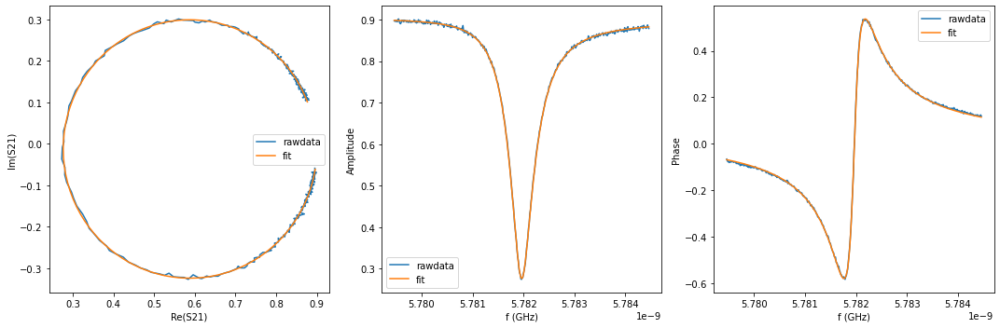

{'Qi_dia_corr': 24979.977952620528, 'Qi_no_corr': 25189.11188381602, 'absQc': 11087.994552494913, 'Qc_dia_corr(Re{Qc})': 11129.008263203816, 'Ql': 7698.980508279451, 'fr': 5.781940249458032, 'theta0': -3.0557141304686226, 'phi0': 0.08587856182688217, 'phi0_err': 0.0018299133010355694, 'Ql_err': 18.245372145328307, 'absQc_err': 17.674531140922756, 'fr_err': 8.532976783178606e-07, 'chi_square': 2.662765603085343e-05, 'Qi_no_corr_err': 146.4414811474336, 'Qi_dia_corr_err': 144.1811781554007, 'delay': 0.7220793902342655, 'a': 0.899200969977145, 'alpha': 1.124441002795975}


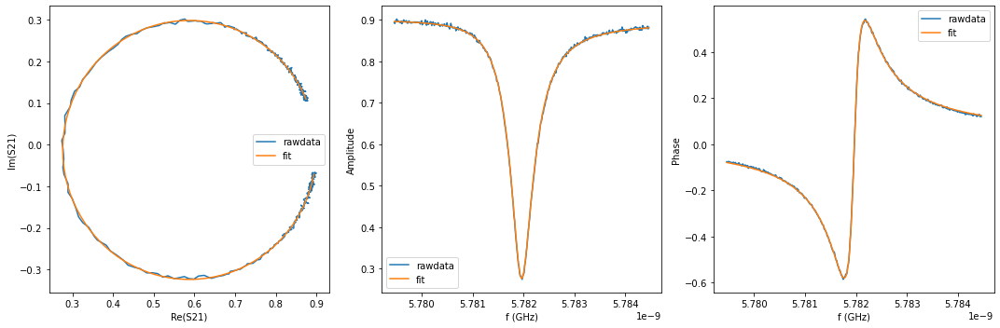

{'Qi_dia_corr': 25537.350258325525, 'Qi_no_corr': 25752.65253782326, 'absQc': 11379.22502483476, 'Qc_dia_corr(Re{Qc})': 11421.774783842999, 'Ql': 7892.0121321572, 'fr': 5.78194059595538, 'theta0': -3.0552489862740635, 'phi0': 0.08634390176309885, 'phi0_err': 0.001886090239373023, 'Ql_err': 16.986685334836764, 'absQc_err': 17.397657186459124, 'fr_err': 8.970171056112779e-07, 'chi_square': 2.5373701313769596e-05, 'Qi_no_corr_err': 137.22953863759727, 'Qi_dia_corr_err': 135.6588770402318, 'delay': -0.1171208689721162, 'a': 0.8967615985216951, 'alpha': 2.0525423020908486}


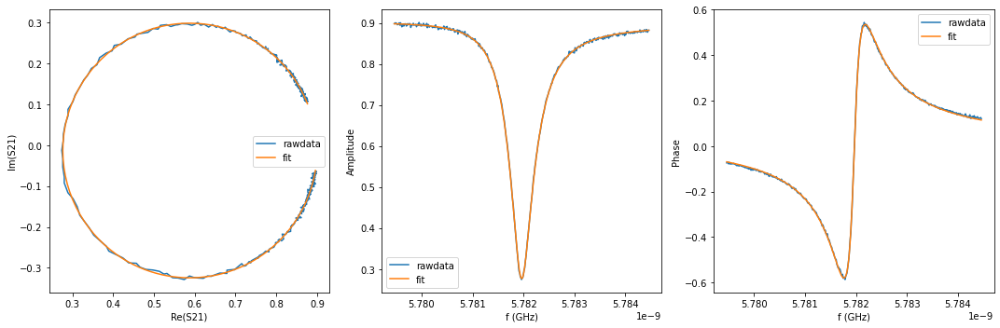

{'Qi_dia_corr': 24936.709182921935, 'Qi_no_corr': 25154.40862856627, 'absQc': 11085.1060885134, 'Qc_dia_corr(Re{Qc})': 11127.917329332782, 'Ql': 7694.34387900501, 'fr': 5.781939885791035, 'theta0': -3.0538469545968177, 'phi0': 0.08774579094785875, 'phi0_err': 0.001730841854017413, 'Ql_err': 17.35476300104353, 'absQc_err': 17.75742172613543, 'fr_err': 8.333540643714066e-07, 'chi_square': 2.5315927207851172e-05, 'Qi_no_corr_err': 132.27330930155236, 'Qi_dia_corr_err': 130.09710141028327, 'delay': 0.6916336718434452, 'a': 0.8989533428095096, 'alpha': 0.01782168632938415}


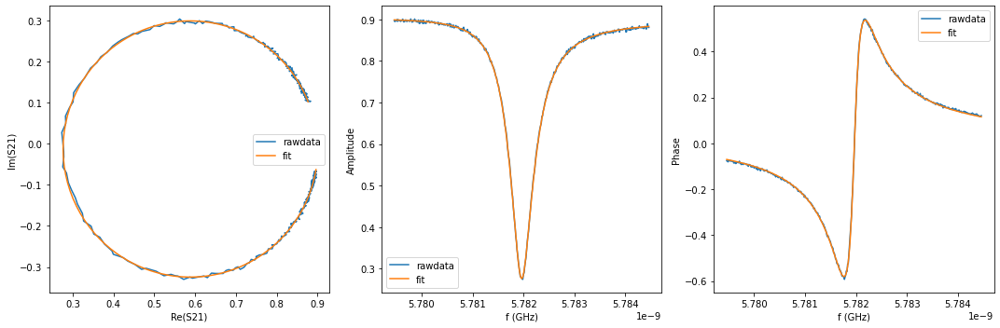

{'Qi_dia_corr': 25027.76255255928, 'Qi_no_corr': 25240.527730303875, 'absQc': 11097.723290822116, 'Qc_dia_corr(Re{Qc})': 11139.359791000272, 'Ql': 7708.472053384893, 'fr': 5.781940210938121, 'theta0': -3.055104481049157, 'phi0': 0.0864882995009115, 'phi0_err': 0.0016700527269036532, 'Ql_err': 16.1007066044049, 'absQc_err': 17.468717816873237, 'fr_err': 8.557985630505985e-07, 'chi_square': 2.4150489207536247e-05, 'Qi_no_corr_err': 122.01481205711232, 'Qi_dia_corr_err': 120.34385183664736, 'delay': 0.6260863383268626, 'a': 0.899641707061081, 'alpha': -2.3634905968414683}


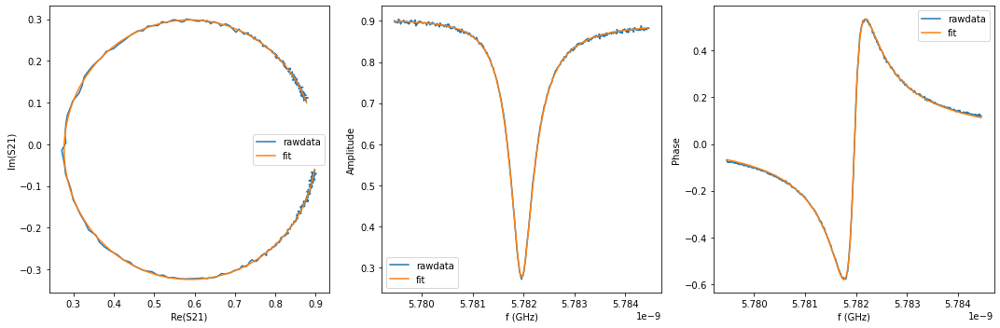

{'Qi_dia_corr': 24802.286329339728, 'Qi_no_corr': 25015.93327790879, 'absQc': 11020.680628226504, 'Qc_dia_corr(Re{Qc})': 11062.661971151183, 'Ql': 7650.347282654074, 'fr': 5.78193988341528, 'theta0': -3.0544460358732892, 'phi0': 0.08714666596368194, 'phi0_err': 0.0021064463371256344, 'Ql_err': 18.790804089156445, 'absQc_err': 17.552904895288584, 'fr_err': 9.402559571517918e-07, 'chi_square': 2.9656505346171947e-05, 'Qi_no_corr_err': 152.40829090259658, 'Qi_dia_corr_err': 149.4551801105174, 'delay': 0.8685682069520495, 'a': 0.9002525414844502, 'alpha': 0.16256568839997487}


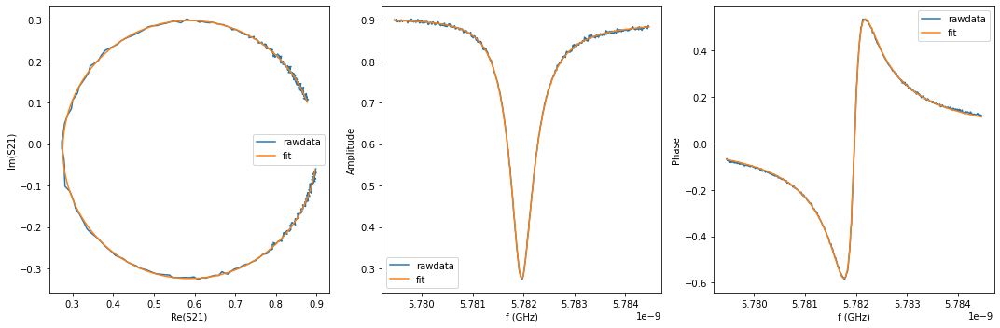

{'Qi_dia_corr': 25042.259751563317, 'Qi_no_corr': 25258.295342363348, 'absQc': 11081.044606256213, 'Qc_dia_corr(Re{Qc})': 11123.142070745722, 'Ql': 7702.074329430798, 'fr': 5.7819401931311925, 'theta0': -3.0545632003364878, 'phi0': 0.08702946071064825, 'phi0_err': 0.0018245358832894595, 'Ql_err': 17.710149500747992, 'absQc_err': 16.960671875665604, 'fr_err': 8.290734216322639e-07, 'chi_square': 2.523535562391499e-05, 'Qi_no_corr_err': 140.3239200916807, 'Qi_dia_corr_err': 138.46199991135907, 'delay': 0.7068757949570934, 'a': 0.8996250840195906, 'alpha': 0.5715965136085673}


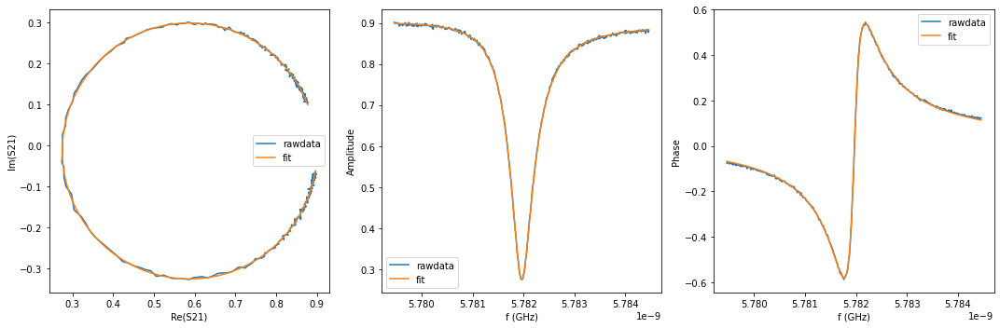

{'Qi_dia_corr': 25146.927584139845, 'Qi_no_corr': 25357.611090435992, 'absQc': 11063.074607092749, 'Qc_dia_corr(Re{Qc})': 11103.660892085827, 'Ql': 7702.577202443252, 'fr': 5.781941307121088, 'theta0': -3.056063371448355, 'phi0': 0.08552713587112018, 'phi0_err': 0.001863808843068507, 'Ql_err': 17.59995904104966, 'absQc_err': 16.85135264700966, 'fr_err': 8.541995141283038e-07, 'chi_square': 2.5605252920927745e-05, 'Qi_no_corr_err': 144.3432012733862, 'Qi_dia_corr_err': 142.9592840087804, 'delay': 0.7787049526041488, 'a': 0.9000124500622486, 'alpha': -3.1021402353049705}


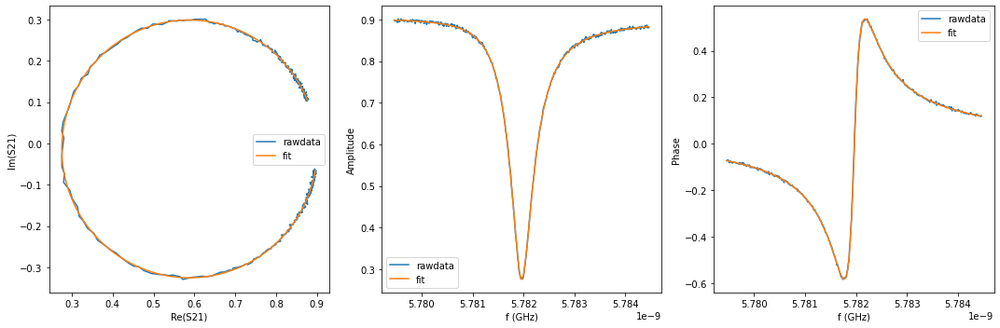

{'Qi_dia_corr': 25320.27143832118, 'Qi_no_corr': 25542.905153296553, 'absQc': 11197.740341919918, 'Qc_dia_corr(Re{Qc})': 11241.070507626875, 'Ql': 7784.915469766103, 'fr': 5.781939929473711, 'theta0': -3.053763740993397, 'phi0': 0.0878306181363045, 'phi0_err': 0.0013373356938885938, 'Ql_err': 13.929408178556208, 'absQc_err': 15.521437428694789, 'fr_err': 7.033128747746328e-07, 'chi_square': 1.689555100036511e-05, 'Qi_no_corr_err': 103.42032877350995, 'Qi_dia_corr_err': 101.77547851108056, 'delay': 0.36542300348411677, 'a': 0.8990146663237204, 'alpha': 0.7336302017006975}


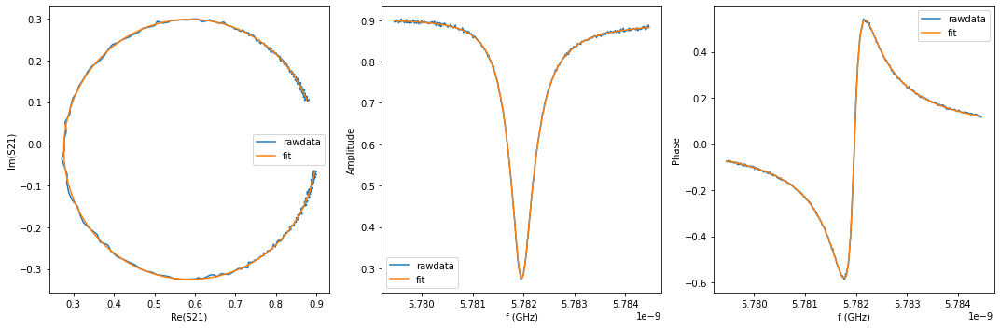

{'Qi_dia_corr': 25217.975813088095, 'Qi_no_corr': 25442.973197887688, 'absQc': 11166.284554181977, 'Qc_dia_corr(Re{Qc})': 11210.180121630578, 'Ql': 7760.427172713651, 'fr': 5.78193938773669, 'theta0': -3.053068707916964, 'phi0': 0.08852396373315843, 'phi0_err': 0.0012858028858554157, 'Ql_err': 13.473064326332217, 'absQc_err': 14.034458371882552, 'fr_err': 6.320389580675359e-07, 'chi_square': 1.4810294676622102e-05, 'Qi_no_corr_err': 102.1104069875262, 'Qi_dia_corr_err': 100.61172432467994, 'delay': 0.3818339071416811, 'a': 0.8992407423539245, 'alpha': 1.3299387435399093}


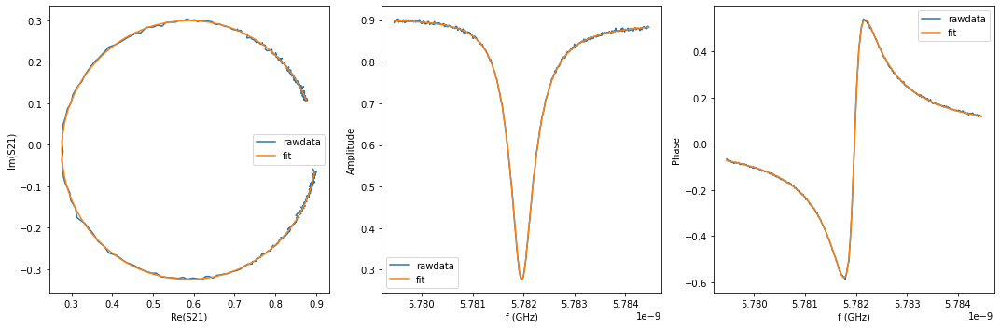

{'Qi_dia_corr': 25159.323814615967, 'Qi_no_corr': 25371.57757993913, 'absQc': 11153.935713350053, 'Qc_dia_corr(Re{Qc})': 11195.457779879313, 'Ql': 7747.815698045473, 'fr': 5.781940967045744, 'theta0': -3.055440172954066, 'phi0': 0.08615249673892475, 'phi0_err': 0.0012991945512617494, 'Ql_err': 13.49238860726958, 'absQc_err': 13.475005790256345, 'fr_err': 6.159298220993367e-07, 'chi_square': 1.4317577714410644e-05, 'Qi_no_corr_err': 106.52316030428562, 'Qi_dia_corr_err': 105.34700826902461, 'delay': 0.4134799582235465, 'a': 0.899538369354493, 'alpha': 2.4795989845317177}


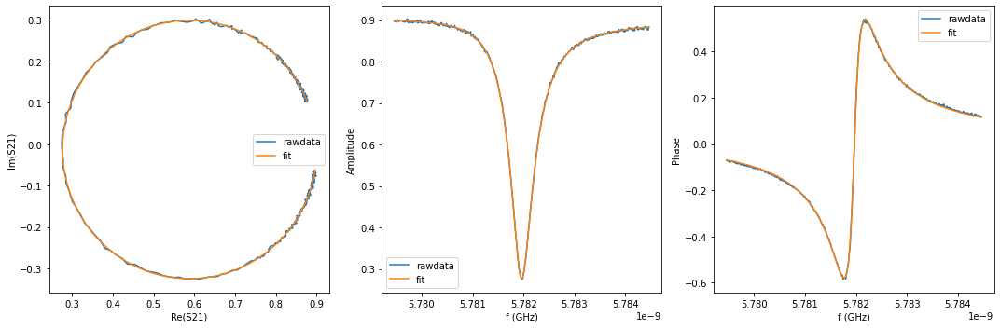

{'Qi_dia_corr': 24951.345351103744, 'Qi_no_corr': 25165.45317899652, 'absQc': 11061.686965763613, 'Qc_dia_corr(Re{Qc})': 11103.568033462187, 'Ql': 7684.083377967219, 'fr': 5.781940559085857, 'theta0': -3.054710782278455, 'phi0': 0.08688187679817959, 'phi0_err': 0.0017001855030574445, 'Ql_err': 16.961032034124173, 'absQc_err': 15.994284890826574, 'fr_err': 7.711009333761991e-07, 'chi_square': 2.2055155140214418e-05, 'Qi_no_corr_err': 137.47276696752655, 'Qi_dia_corr_err': 134.28785954575096, 'delay': 0.7029933548858137, 'a': 0.9000783374364846, 'alpha': 0.43079477117714804}


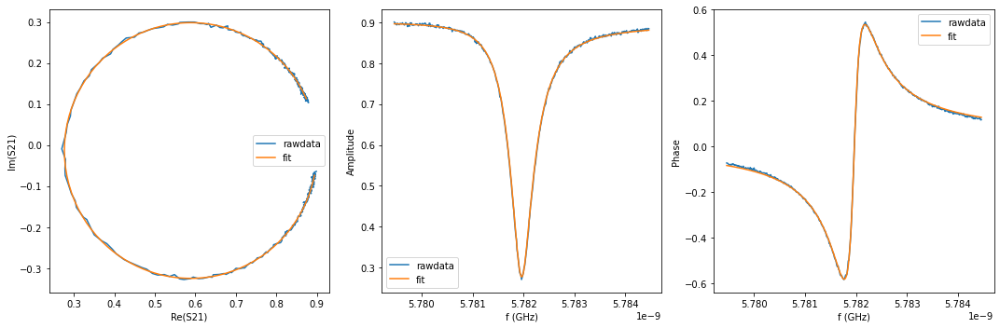

{'Qi_dia_corr': 25619.940066590483, 'Qi_no_corr': 25850.43187964514, 'absQc': 11428.555568141444, 'Qc_dia_corr(Re{Qc})': 11474.193199276158, 'Ql': 7924.9227895679005, 'fr': 5.781939455123827, 'theta0': -3.0523753120247656, 'phi0': 0.0892194451841219, 'phi0_err': 0.002364938823038085, 'Ql_err': 22.176650680606283, 'absQc_err': 19.989035438004844, 'fr_err': 1.0348887877120853e-06, 'chi_square': 3.553082360479851e-05, 'Qi_no_corr_err': 189.9191858302446, 'Qi_dia_corr_err': 186.83271004182512, 'delay': -0.3671581999088241, 'a': 0.897047579224433, 'alpha': -0.7476016161606317}


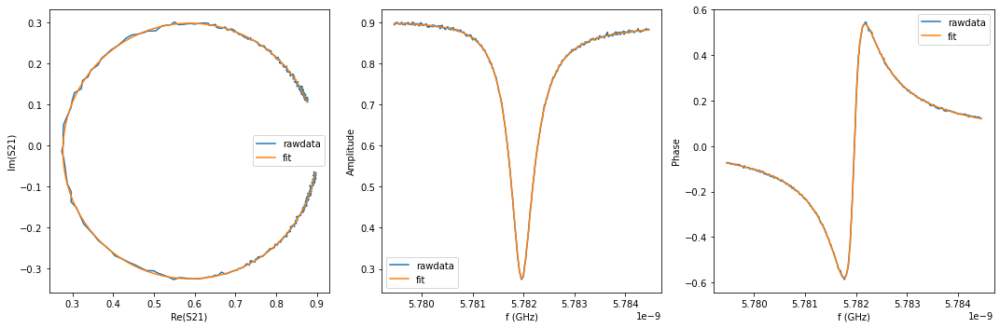

{'Qi_dia_corr': 25258.719809457692, 'Qi_no_corr': 25483.86820924949, 'absQc': 11212.955095729028, 'Qc_dia_corr(Re{Qc})': 11257.105940226806, 'Ql': 7786.7631081032705, 'fr': 5.781939682102473, 'theta0': -3.052996916252681, 'phi0': 0.08859580820962956, 'phi0_err': 0.0012428027175709778, 'Ql_err': 12.77685149068278, 'absQc_err': 13.587604052913896, 'fr_err': 6.201986351884789e-07, 'chi_square': 1.3744549902318823e-05, 'Qi_no_corr_err': 95.28763300703928, 'Qi_dia_corr_err': 93.63329921304447, 'delay': 0.2606785673481358, 'a': 0.8988464518897641, 'alpha': -3.0712453983120396}


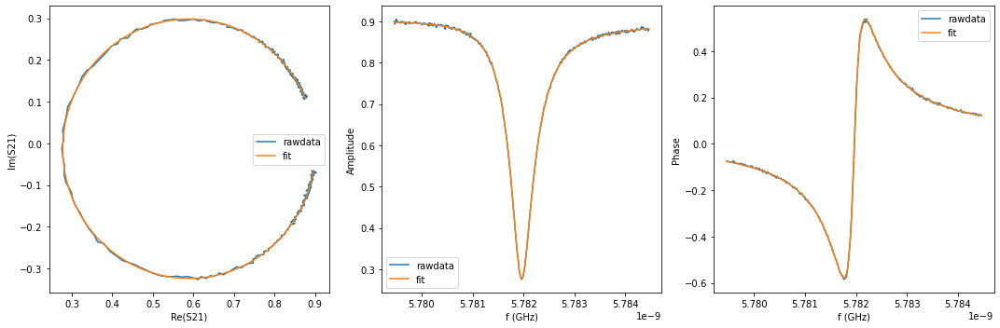

{'Qi_dia_corr': 25083.391388818396, 'Qi_no_corr': 25301.22825094594, 'absQc': 11215.539221044015, 'Qc_dia_corr(Re{Qc})': 11258.882219021401, 'Ql': 7770.86630153486, 'fr': 5.781939643974095, 'theta0': -3.053819881177112, 'phi0': 0.08777407398369926, 'phi0_err': 0.001254151826461106, 'Ql_err': 13.055041606598873, 'absQc_err': 14.06769195569724, 'fr_err': 6.384427398482413e-07, 'chi_square': 1.4267832208423079e-05, 'Qi_no_corr_err': 97.52884591711074, 'Qi_dia_corr_err': 95.90903586053322, 'delay': 0.17496088671450655, 'a': 0.8989093555419186, 'alpha': 0.09735003592872013}


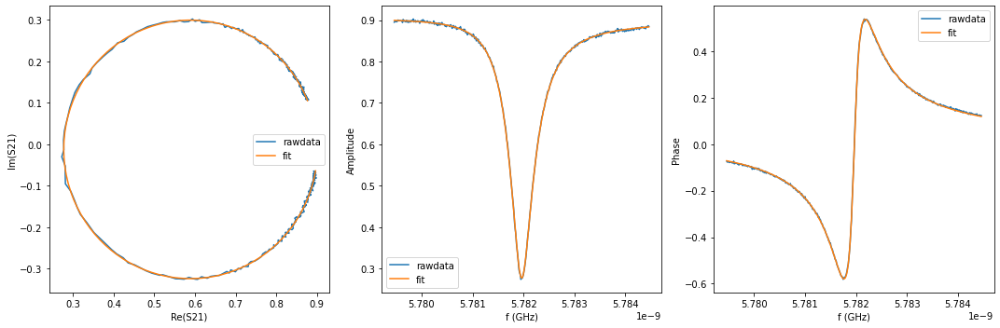

{'Qi_dia_corr': 24994.147893898902, 'Qi_no_corr': 25210.221192370816, 'absQc': 11107.36225860444, 'Qc_dia_corr(Re{Qc})': 11149.830601554853, 'Ql': 7710.288868233878, 'fr': 5.781939888132324, 'theta0': -3.0542851727947546, 'phi0': 0.08730748245862319, 'phi0_err': 0.0013631101211876281, 'Ql_err': 13.828998244535558, 'absQc_err': 14.74149124397204, 'fr_err': 6.866004068589817e-07, 'chi_square': 1.6668585803654653e-05, 'Qi_no_corr_err': 106.22643412114606, 'Qi_dia_corr_err': 104.66448756981725, 'delay': 0.4637178800720649, 'a': 0.9001466249788288, 'alpha': -1.977892949249393}


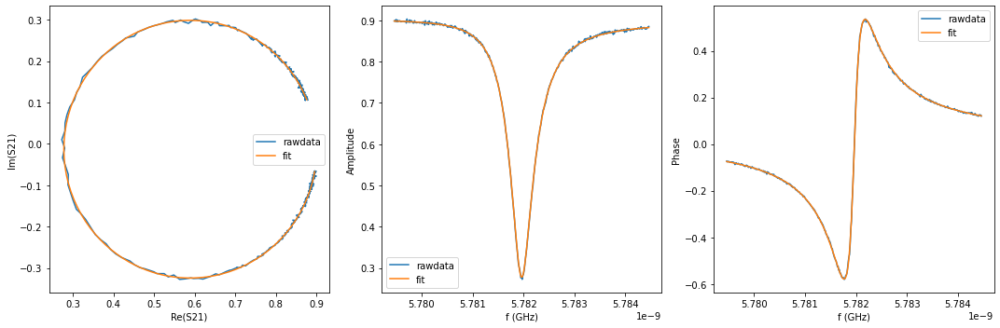

{'Qi_dia_corr': 25130.744561317762, 'Qi_no_corr': 25349.427554573595, 'absQc': 11216.178585095118, 'Qc_dia_corr(Re{Qc})': 11259.53034058295, 'Ql': 7775.714298185143, 'fr': 5.781939921808223, 'theta0': -3.0538122346851106, 'phi0': 0.08778041852535491, 'phi0_err': 0.0012806424833825142, 'Ql_err': 12.943408666148127, 'absQc_err': 13.619249895053146, 'fr_err': 6.330008501181156e-07, 'chi_square': 1.414233548319205e-05, 'Qi_no_corr_err': 101.22783895017237, 'Qi_dia_corr_err': 99.45031161608424, 'delay': 0.23263180839464082, 'a': 0.8992171732429594, 'alpha': 2.192816123521112}


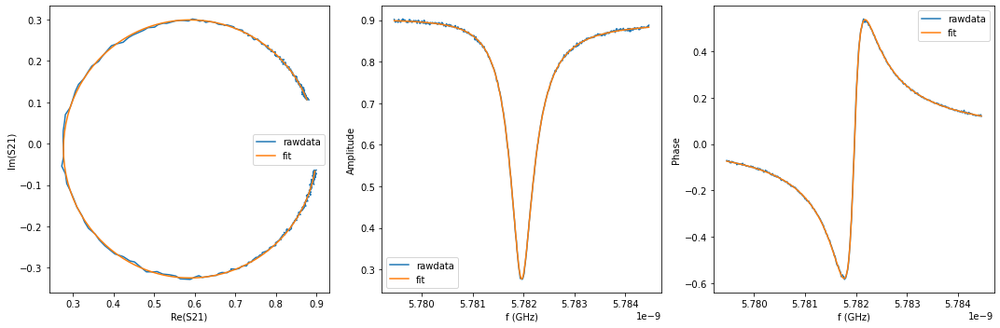

{'Qi_dia_corr': 25236.63248277127, 'Qi_no_corr': 25456.257899783268, 'absQc': 11227.156818110812, 'Qc_dia_corr(Re{Qc})': 11270.41480682942, 'Ql': 7791.024953402872, 'fr': 5.781940088877419, 'theta0': -3.0539497472998174, 'phi0': 0.08764299610709514, 'phi0_err': 0.0011565578954898512, 'Ql_err': 12.54001035504564, 'absQc_err': 13.510832356007109, 'fr_err': 5.923217962556102e-07, 'chi_square': 1.2665539844936216e-05, 'Qi_no_corr_err': 93.02367486855775, 'Qi_dia_corr_err': 91.61066446861605, 'delay': 0.26814077061980474, 'a': 0.8995913904100894, 'alpha': -2.800306037425827}


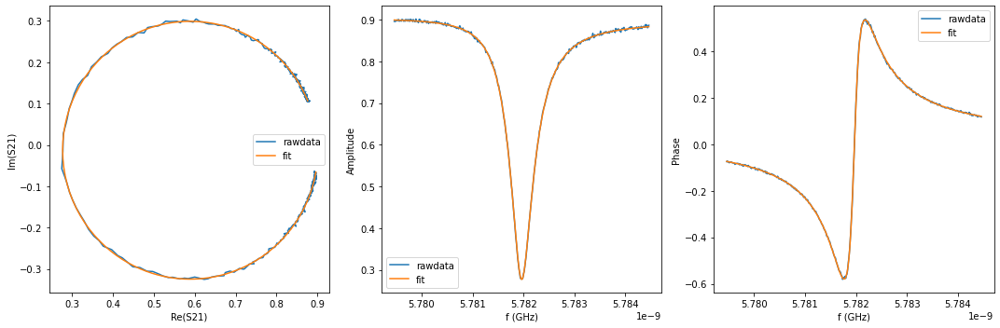

{'Qi_dia_corr': 25199.39717175525, 'Qi_no_corr': 25423.01705425234, 'absQc': 11211.936767701685, 'Qc_dia_corr(Re{Qc})': 11255.987936236541, 'Ql': 7780.581928444079, 'fr': 5.781939739858431, 'theta0': -3.0530925717144353, 'phi0': 0.088500076029878, 'phi0_err': 0.0011533758664220514, 'Ql_err': 13.017950170864752, 'absQc_err': 14.041703290224284, 'fr_err': 5.845842221348665e-07, 'chi_square': 1.3043898369179405e-05, 'Qi_no_corr_err': 95.38777373556994, 'Qi_dia_corr_err': 93.5168495764456, 'delay': 0.30216328869416537, 'a': 0.8995785759377405, 'alpha': -1.563899157905624}


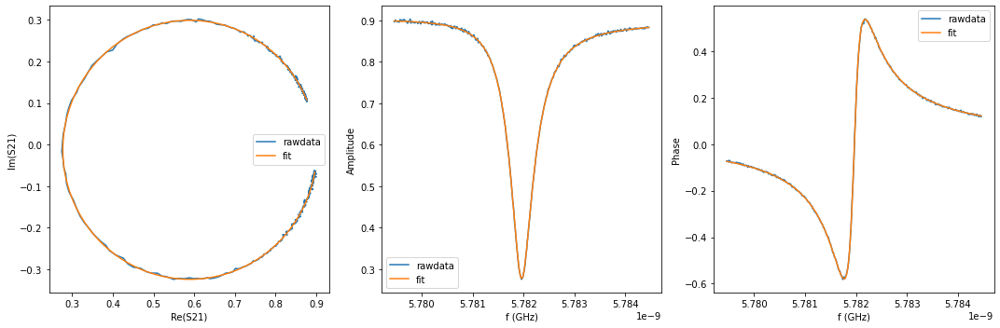

{'Qi_dia_corr': 25250.930392087623, 'Qi_no_corr': 25470.823454815694, 'absQc': 11240.409990144593, 'Qc_dia_corr(Re{Qc})': 11283.773825085776, 'Ql': 7798.770881614797, 'fr': 5.781939595538721, 'theta0': -3.0538953836038676, 'phi0': 0.08769823133714047, 'phi0_err': 0.0011193033109587, 'Ql_err': 11.973026221057424, 'absQc_err': 12.343062172884023, 'fr_err': 5.394290443153665e-07, 'chi_square': 1.1197064291933676e-05, 'Qi_no_corr_err': 90.9952849463862, 'Qi_dia_corr_err': 89.77592688674488, 'delay': 0.23406655091298723, 'a': 0.8996577602279019, 'alpha': 2.245296339149221}


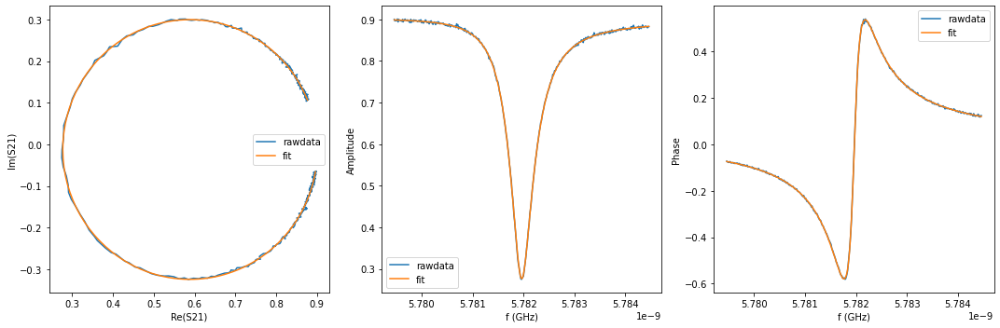

{'Qi_dia_corr': 25238.56075126782, 'Qi_no_corr': 25452.041007980293, 'absQc': 11207.782222644692, 'Qc_dia_corr(Re{Qc})': 11249.683813958356, 'Ql': 7781.295914732156, 'fr': 5.78194047332424, 'theta0': -3.055256043766209, 'phi0': 0.08633660982358424, 'phi0_err': 0.001194769317425075, 'Ql_err': 12.641692741855973, 'absQc_err': 13.244323975581354, 'fr_err': 5.882371913555491e-07, 'chi_square': 1.2855981420467104e-05, 'Qi_no_corr_err': 97.57073181833215, 'Qi_dia_corr_err': 96.40754313025178, 'delay': 0.3077579959135202, 'a': 0.8996768000431405, 'alpha': -1.3608825867554106}


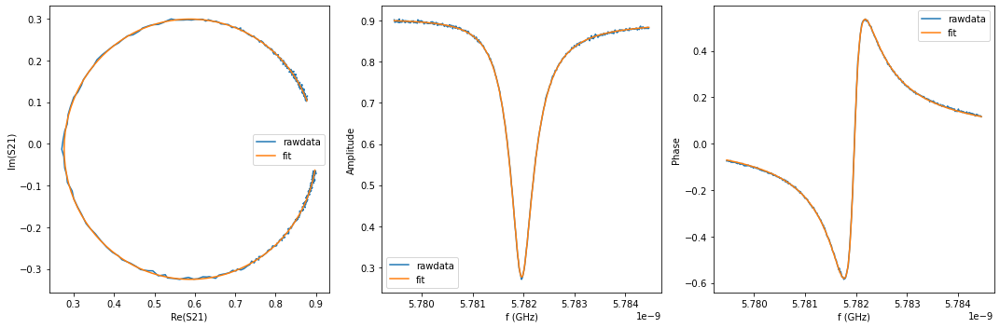

{'Qi_dia_corr': 25102.01416942963, 'Qi_no_corr': 25323.013801267993, 'absQc': 11138.420699325614, 'Qc_dia_corr(Re{Qc})': 11181.721895321169, 'Ql': 7735.800441114285, 'fr': 5.781939784814393, 'theta0': -3.053559466022647, 'phi0': 0.08803408415260278, 'phi0_err': 0.0012965667141873632, 'Ql_err': 13.13146627245749, 'absQc_err': 13.82059742562634, 'fr_err': 6.428528019275615e-07, 'chi_square': 1.4779427845081593e-05, 'Qi_no_corr_err': 102.16362294877952, 'Qi_dia_corr_err': 100.62873858784944, 'delay': 0.5578020119277606, 'a': 0.900224540146439, 'alpha': 1.43957952706391}


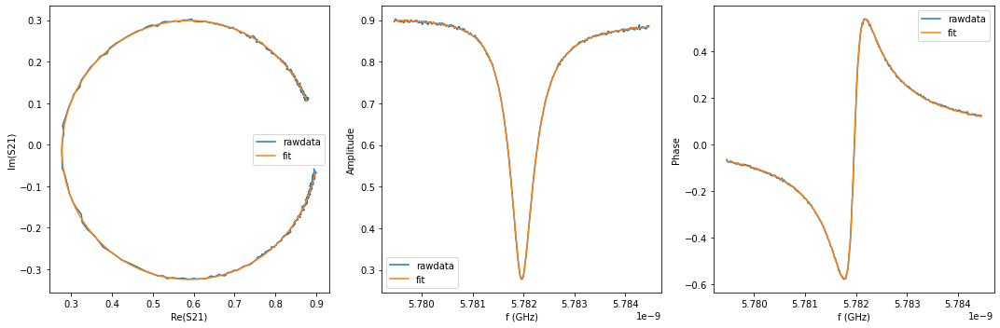

{'Qi_dia_corr': 25062.217488538903, 'Qi_no_corr': 25276.24872676326, 'absQc': 11169.33159211355, 'Qc_dia_corr(Re{Qc})': 11211.641437041926, 'Ql': 7746.311101753295, 'fr': 5.781940307279078, 'theta0': -3.0546891450233207, 'phi0': 0.08690360358869029, 'phi0_err': 0.0011731688398365148, 'Ql_err': 12.317316386653351, 'absQc_err': 12.711566643193189, 'fr_err': 5.689337351912516e-07, 'chi_square': 1.2213300969078893e-05, 'Qi_no_corr_err': 93.53793718186468, 'Qi_dia_corr_err': 92.20837171635254, 'delay': 0.40856576192211463, 'a': 0.9001141032440163, 'alpha': 2.3011478079853225}


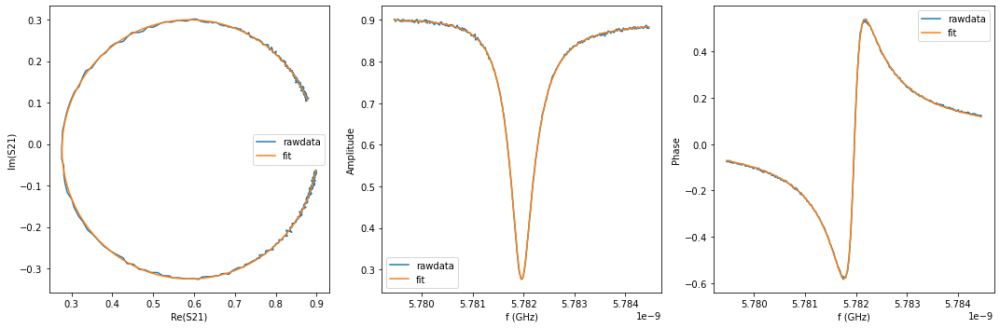

{'Qi_dia_corr': 25086.84675366888, 'Qi_no_corr': 25308.92451016107, 'absQc': 11122.41663133316, 'Qc_dia_corr(Re{Qc})': 11165.855294219813, 'Ql': 7726.764760036648, 'fr': 5.781939495939769, 'theta0': -3.0533561846584916, 'phi0': 0.08823646893130142, 'phi0_err': 0.0012738527437346583, 'Ql_err': 13.09665936957619, 'absQc_err': 14.18441252807979, 'fr_err': 6.591899286274181e-07, 'chi_square': 1.4873153156886128e-05, 'Qi_no_corr_err': 96.20079763424998, 'Qi_dia_corr_err': 94.67322507353663, 'delay': 0.4833834844103469, 'a': 0.9008987201983772, 'alpha': -1.26337787532933}


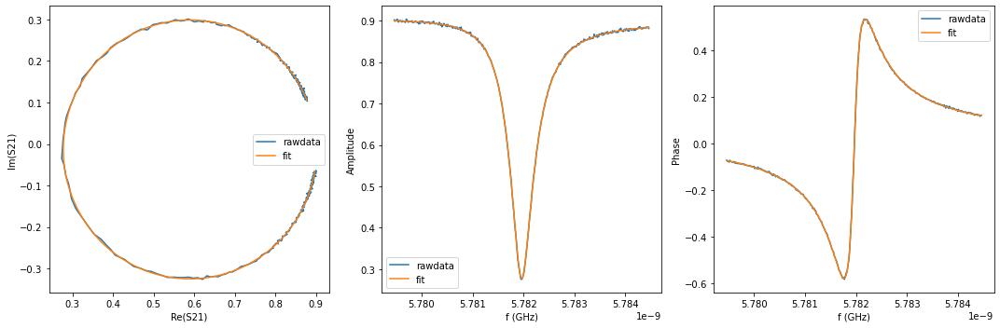

{'Qi_dia_corr': 25122.430455221336, 'Qi_no_corr': 25346.350476395088, 'absQc': 11194.699866575831, 'Qc_dia_corr(Re{Qc})': 11238.943806338093, 'Ql': 7765.096614166316, 'fr': 5.781939475163069, 'theta0': -3.0528317490891825, 'phi0': 0.08876090459974455, 'phi0_err': 0.001043225408053492, 'Ql_err': 11.504225655319127, 'absQc_err': 12.496519371802915, 'fr_err': 5.314686375921627e-07, 'chi_square': 1.0630944412586988e-05, 'Qi_no_corr_err': 84.150730455346, 'Qi_dia_corr_err': 82.93521862014997, 'delay': 0.3416462788209106, 'a': 0.9004638641357976, 'alpha': -0.12967062179945632}


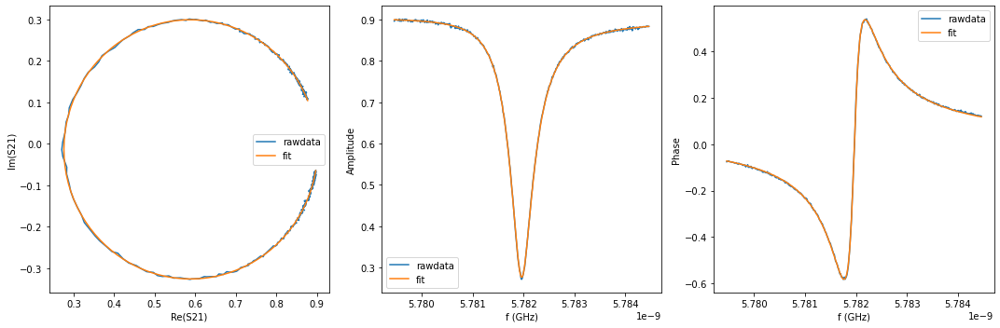

{'Qi_dia_corr': 25206.619765430743, 'Qi_no_corr': 25431.148597380976, 'absQc': 11136.722530304076, 'Qc_dia_corr(Re{Qc})': 11180.33430102705, 'Ql': 7745.0405731041255, 'fr': 5.781939567611374, 'theta0': -3.0532398214776135, 'phi0': 0.08835491987614118, 'phi0_err': 0.0012189085909950726, 'Ql_err': 12.472320752085539, 'absQc_err': 12.739683706035942, 'fr_err': 5.84477712872719e-07, 'chi_square': 1.2716005548140369e-05, 'Qi_no_corr_err': 94.61502732608908, 'Qi_dia_corr_err': 93.19607528839602, 'delay': 0.4540125856776737, 'a': 0.9007241741727878, 'alpha': -2.3310073572771333}


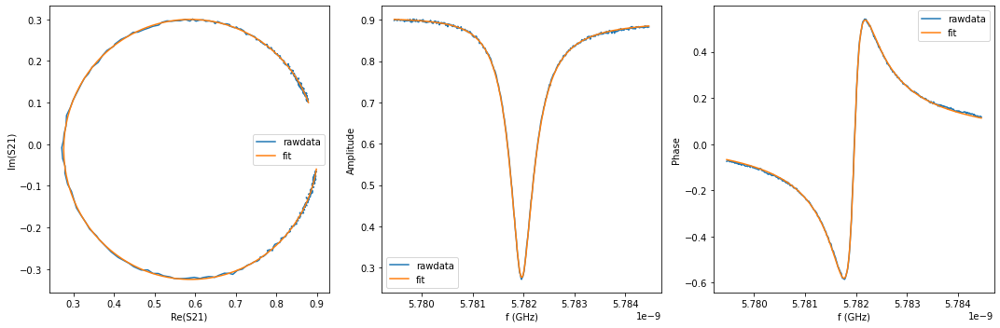

{'Qi_dia_corr': 24897.00624957343, 'Qi_no_corr': 25108.25744558991, 'absQc': 11001.682556801961, 'Qc_dia_corr(Re{Qc})': 11042.738057709992, 'Ql': 7649.779477687922, 'fr': 5.7819405113784095, 'theta0': -3.055333579372276, 'phi0': 0.08625751380081761, 'phi0_err': 0.0020916737095468515, 'Ql_err': 18.605186902396802, 'absQc_err': 16.275865057723294, 'fr_err': 9.062914006592735e-07, 'chi_square': 2.69091899076328e-05, 'Qi_no_corr_err': 157.17986560269244, 'Qi_dia_corr_err': 154.76294850849843, 'delay': 0.8694139276760275, 'a': 0.9019406968774962, 'alpha': 0.1938024932736146}


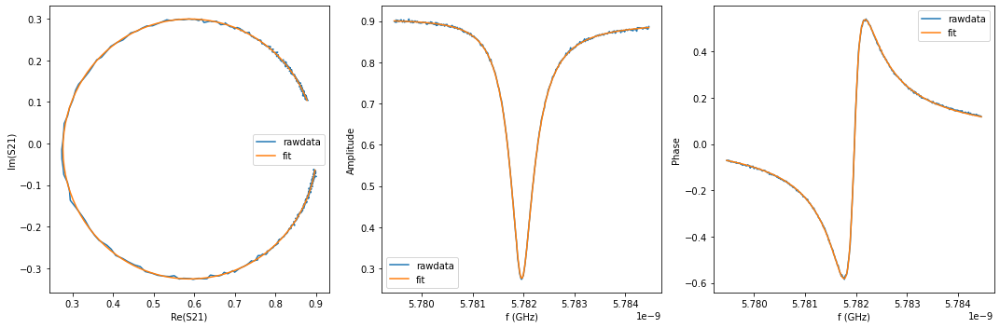

{'Qi_dia_corr': 25152.586150071587, 'Qi_no_corr': 25374.972034378323, 'absQc': 11126.385961425553, 'Qc_dia_corr(Re{Qc})': 11169.688582624523, 'Ql': 7734.828184949428, 'fr': 5.781940146459945, 'theta0': -3.0535096806889306, 'phi0': 0.08808297290086248, 'phi0_err': 0.0011738158691193075, 'Ql_err': 12.097677196705218, 'absQc_err': 12.858736300633051, 'fr_err': 5.893983671936726e-07, 'chi_square': 1.2448625158756874e-05, 'Qi_no_corr_err': 90.12550328556325, 'Qi_dia_corr_err': 89.03884371017423, 'delay': 0.51194106575512, 'a': 0.9011521213940042, 'alpha': -0.22645409714331155}


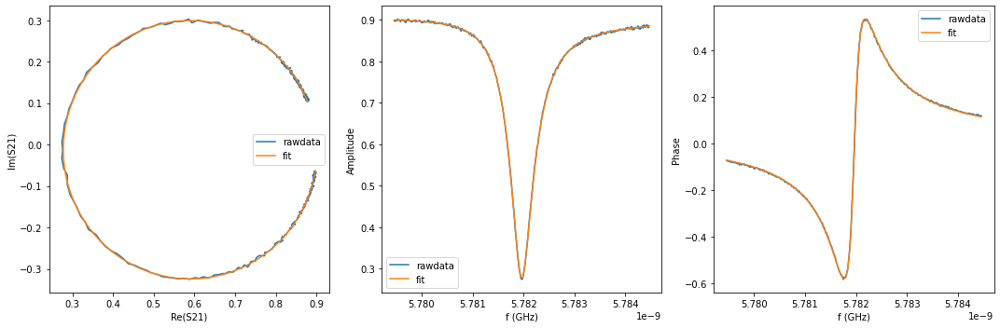

{'Qi_dia_corr': 25013.49766769642, 'Qi_no_corr': 25222.495062007045, 'absQc': 11132.131909701226, 'Qc_dia_corr(Re{Qc})': 11173.335930907499, 'Ql': 7723.367436573001, 'fr': 5.781941008052973, 'theta0': -3.055687116756174, 'phi0': 0.08590667769985717, 'phi0_err': 0.001265033178413071, 'Ql_err': 12.550491299381804, 'absQc_err': 13.046519184854777, 'fr_err': 6.158634160676911e-07, 'chi_square': 1.3467614992358722e-05, 'Qi_no_corr_err': 93.26037080724694, 'Qi_dia_corr_err': 92.06269060620308, 'delay': 0.5941724976368944, 'a': 0.9011842470424659, 'alpha': 2.7606145369871533}


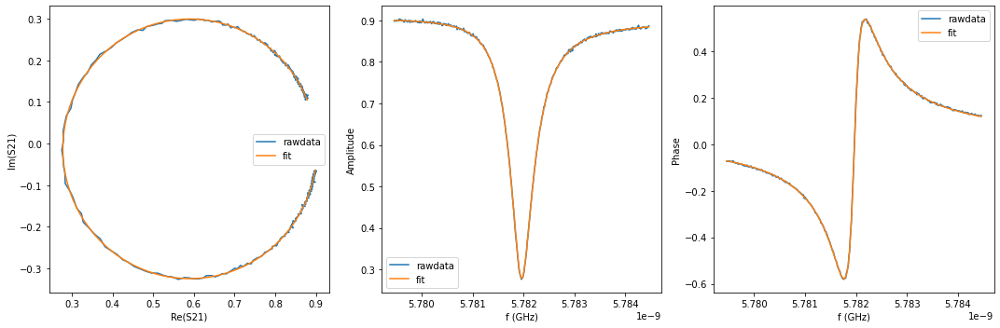

{'Qi_dia_corr': 25065.676647024404, 'Qi_no_corr': 25282.35774149926, 'absQc': 11181.231481133513, 'Qc_dia_corr(Re{Qc})': 11224.14230157633, 'Ql': 7752.607472910761, 'fr': 5.781940166598182, 'theta0': -3.054122244592732, 'phi0': 0.0874702331077287, 'phi0_err': 0.0011247392480035576, 'Ql_err': 11.666357112401302, 'absQc_err': 12.422490510908707, 'fr_err': 5.623955061614153e-07, 'chi_square': 1.1388243219344924e-05, 'Qi_no_corr_err': 89.19596079458081, 'Qi_dia_corr_err': 88.25024049316183, 'delay': 0.4341170914480506, 'a': 0.9012578498371673, 'alpha': -3.0534446282662286}


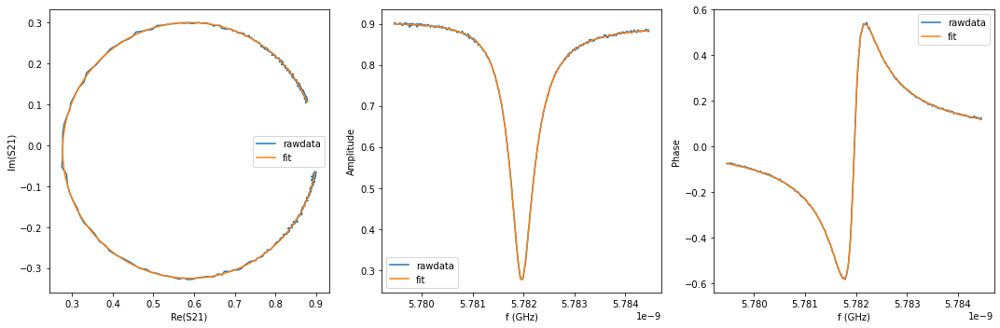

{'Qi_dia_corr': 25273.285240033092, 'Qi_no_corr': 25493.865948454277, 'absQc': 11207.725345040368, 'Qc_dia_corr(Re{Qc})': 11250.894611252432, 'Ql': 7785.173270789432, 'fr': 5.781939998582161, 'theta0': -3.053964077279177, 'phi0': 0.08762898169536977, 'phi0_err': 0.000983620703615315, 'Ql_err': 10.999904505208649, 'absQc_err': 11.59454637031169, 'fr_err': 4.925252699936211e-07, 'chi_square': 9.278154015524167e-06, 'Qi_no_corr_err': 81.93439110743675, 'Qi_dia_corr_err': 80.91225743851041, 'delay': 0.2847157678415455, 'a': 0.9006301151030037, 'alpha': -2.197796575970573}


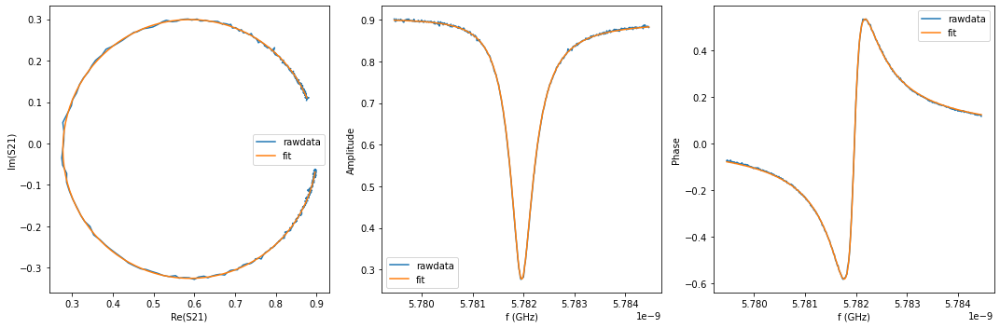

{'Qi_dia_corr': 25480.881226355406, 'Qi_no_corr': 25716.5242919247, 'absQc': 11337.714141898814, 'Qc_dia_corr(Re{Qc})': 11384.1285958015, 'Ql': 7868.643736013041, 'fr': 5.781939152640184, 'theta0': -3.051261118599846, 'phi0': 0.09033153498994675, 'phi0_err': 0.0014508419528237177, 'Ql_err': 14.356248421040275, 'absQc_err': 13.255760386249497, 'fr_err': 6.527891331416394e-07, 'chi_square': 1.5006238703227779e-05, 'Qi_no_corr_err': 122.20748726507134, 'Qi_dia_corr_err': 120.49628677344181, 'delay': -0.029479838577153285, 'a': 0.8998212229969986, 'alpha': -1.045563062729324}


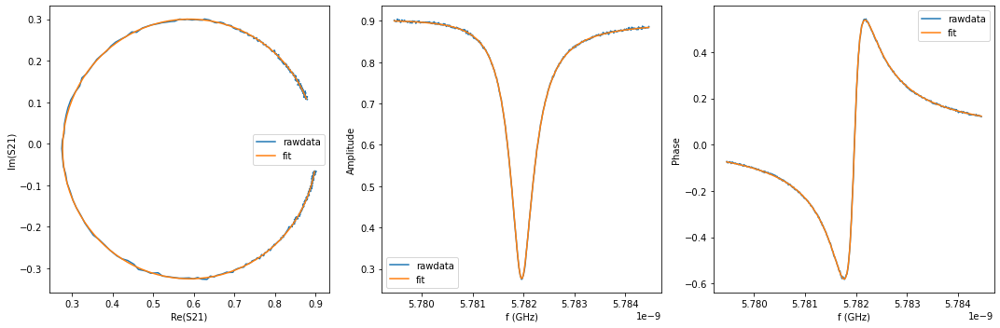

{'Qi_dia_corr': 25355.125824710933, 'Qi_no_corr': 25576.0750879297, 'absQc': 11222.731819897373, 'Qc_dia_corr(Re{Qc})': 11265.809656404726, 'Ql': 7800.07440013881, 'fr': 5.781940239245031, 'theta0': -3.0541143589073854, 'phi0': 0.08747807526362364, 'phi0_err': 0.0010519469580562231, 'Ql_err': 11.078799377656631, 'absQc_err': 11.054369394562785, 'fr_err': 4.961402261242802e-07, 'chi_square': 9.44760822315856e-06, 'Qi_no_corr_err': 87.74039572630124, 'Qi_dia_corr_err': 86.53701801900267, 'delay': 0.18065606504734416, 'a': 0.9006590016837652, 'alpha': 0.30527699793519786}


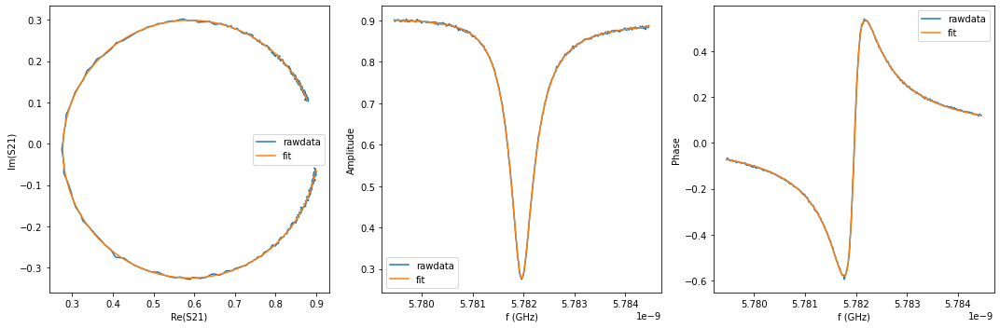

{'Qi_dia_corr': 25126.12331380017, 'Qi_no_corr': 25351.807343280278, 'absQc': 11155.302724758389, 'Qc_dia_corr(Re{Qc})': 11199.566554826642, 'Ql': 7746.630314121656, 'fr': 5.7819394791588135, 'theta0': -3.0526566968607627, 'phi0': 0.08893690805814239, 'phi0_err': 0.0011315745074751305, 'Ql_err': 11.795020305441316, 'absQc_err': 12.263086496839115, 'fr_err': 5.556857431356127e-07, 'chi_square': 1.140123561114039e-05, 'Qi_no_corr_err': 92.09501566878652, 'Qi_dia_corr_err': 90.54458170991307, 'delay': 0.4288949797414797, 'a': 0.9013270072621457, 'alpha': 3.0402190586330224}


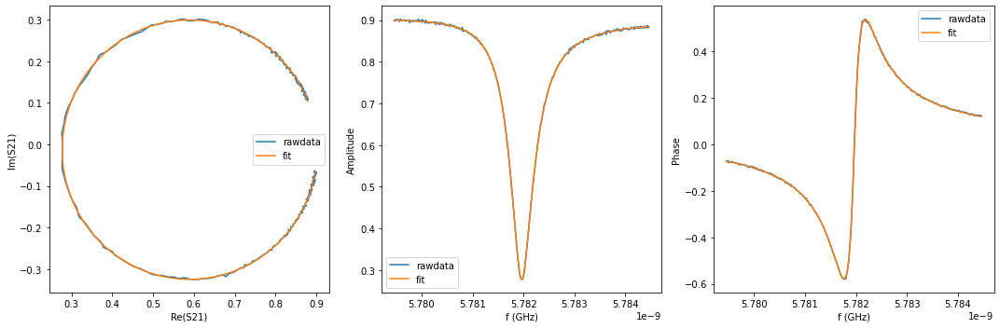

{'Qi_dia_corr': 25140.41875187709, 'Qi_no_corr': 25354.623921125753, 'absQc': 11176.247470946339, 'Qc_dia_corr(Re{Qc})': 11218.380866118589, 'Ql': 7756.988560003907, 'fr': 5.781940768071781, 'theta0': -3.0548965979884, 'phi0': 0.0866960188304155, 'phi0_err': 0.0009912048044478916, 'Ql_err': 9.803066113464547, 'absQc_err': 10.692866983974687, 'fr_err': 5.078898784800605e-07, 'chi_square': 8.640086111871008e-06, 'Qi_no_corr_err': 73.93001228885333, 'Qi_dia_corr_err': 72.71447762255897, 'delay': 0.3905111121146281, 'a': 0.9013261598746833, 'alpha': 1.6452905171459404}


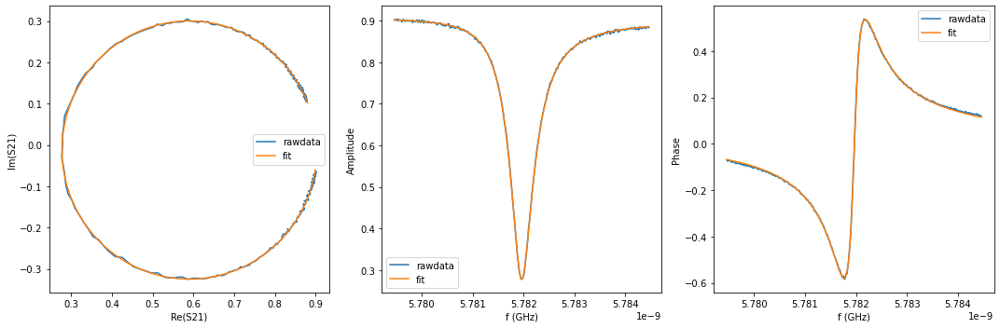

{'Qi_dia_corr': 24924.009587350814, 'Qi_no_corr': 25136.590004649515, 'absQc': 11051.115904434038, 'Qc_dia_corr(Re{Qc})': 11092.711066319196, 'Ql': 7676.291232208006, 'fr': 5.781940458377217, 'theta0': -3.054967232413298, 'phi0': 0.08662701685733572, 'phi0_err': 0.0017560406824595014, 'Ql_err': 15.583235517792078, 'absQc_err': 14.479101899214575, 'fr_err': 7.806028844736739e-07, 'chi_square': 2.0174074181592953e-05, 'Qi_no_corr_err': 126.43140665259855, 'Qi_dia_corr_err': 124.48812358749355, 'delay': 0.7533816280613672, 'a': 0.9026527232177654, 'alpha': 2.262257871538869}


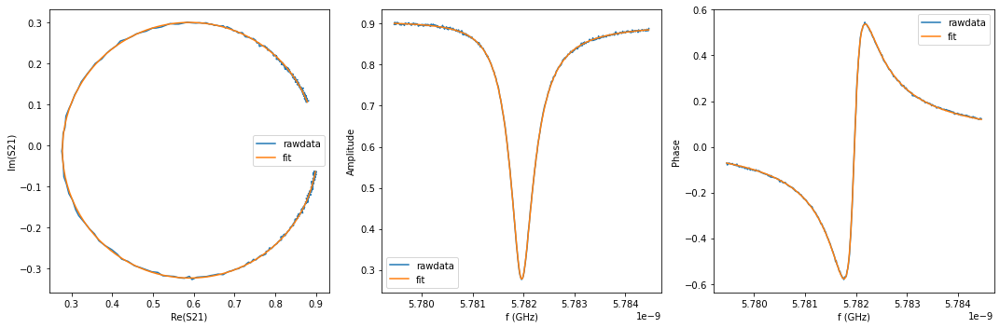

{'Qi_dia_corr': 25057.80458754613, 'Qi_no_corr': 25267.442522832902, 'absQc': 11161.633231547197, 'Qc_dia_corr(Re{Qc})': 11203.035968090897, 'Ql': 7741.780989465556, 'fr': 5.781941037922533, 'theta0': -3.05559284264365, 'phi0': 0.08599941514022048, 'phi0_err': 0.0011241478858337757, 'Ql_err': 11.939488592302604, 'absQc_err': 11.729390118408961, 'fr_err': 5.256335490122045e-07, 'chi_square': 1.0705386515389114e-05, 'Qi_no_corr_err': 93.458448085287, 'Qi_dia_corr_err': 92.6487435579978, 'delay': 0.42912564078902277, 'a': 0.9015857685749085, 'alpha': 3.0490230867619417}


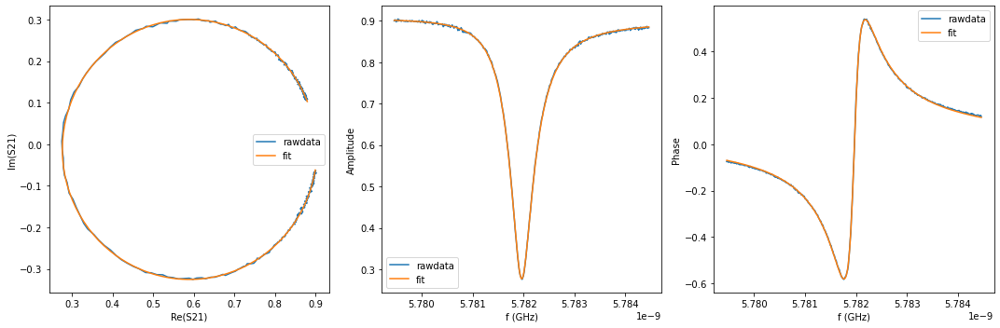

{'Qi_dia_corr': 24981.561479099808, 'Qi_no_corr': 25195.774442629092, 'absQc': 11049.460306401696, 'Qc_dia_corr(Re{Qc})': 11091.168060973878, 'Ql': 7681.001696376791, 'fr': 5.781940316025213, 'theta0': -3.0548423745692506, 'phi0': 0.08675029263945397, 'phi0_err': 0.0015554850690773358, 'Ql_err': 13.229571412417382, 'absQc_err': 12.761058042297327, 'fr_err': 7.132559418579679e-07, 'chi_square': 1.5905327051955756e-05, 'Qi_no_corr_err': 108.22672089276251, 'Qi_dia_corr_err': 107.1681355563503, 'delay': 0.6729509819378443, 'a': 0.9023821768830655, 'alpha': -0.660219651772452}


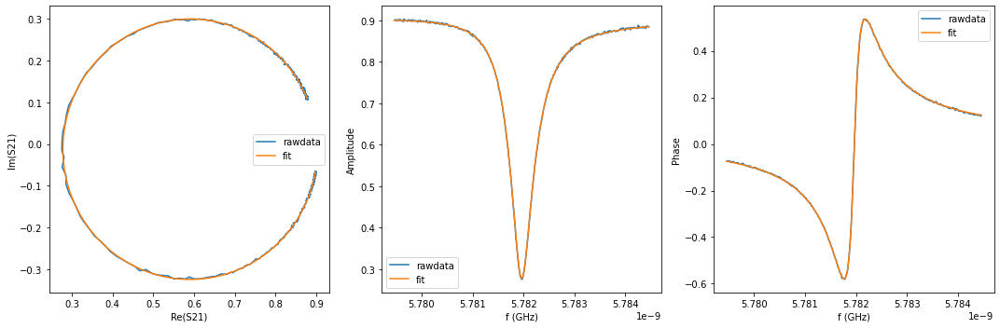

{'Qi_dia_corr': 25281.615853778196, 'Qi_no_corr': 25504.73726657818, 'absQc': 11264.087986711535, 'Qc_dia_corr(Re{Qc})': 11308.164142262109, 'Ql': 7813.347385173627, 'fr': 5.78194029610382, 'theta0': -3.0532721445118662, 'phi0': 0.08832059046920367, 'phi0_err': 0.0010478358104123217, 'Ql_err': 10.155623036111395, 'absQc_err': 10.707300014925698, 'fr_err': 5.16597912687086e-07, 'chi_square': 8.956439591241536e-06, 'Qi_no_corr_err': 80.7423594144836, 'Qi_dia_corr_err': 79.82459017219539, 'delay': 0.14084791417440787, 'a': 0.9009804784196427, 'alpha': -1.140420112373244}


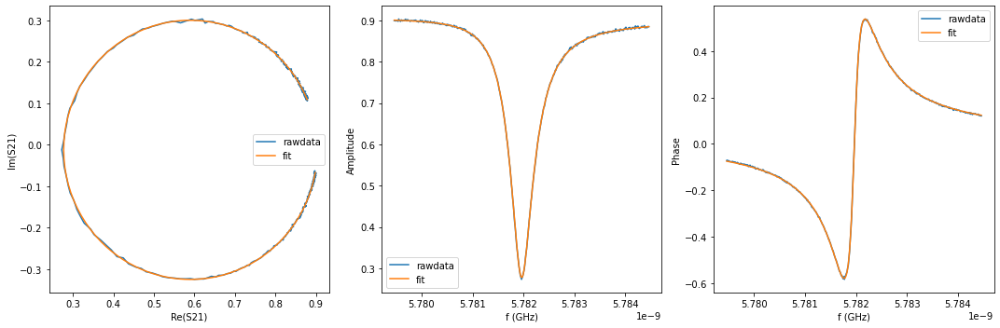

{'Qi_dia_corr': 25293.03517004692, 'Qi_no_corr': 25514.667416316646, 'absQc': 11238.099558050984, 'Qc_dia_corr(Re{Qc})': 11281.641446068197, 'Ql': 7801.762866319797, 'fr': 5.781940073523324, 'theta0': -3.0537061726668453, 'phi0': 0.08788651829644863, 'phi0_err': 0.0010462676693978675, 'Ql_err': 10.142620239558113, 'absQc_err': 10.44506185667229, 'fr_err': 5.039342459997119e-07, 'chi_square': 8.81552808501471e-06, 'Qi_no_corr_err': 79.9127562175618, 'Qi_dia_corr_err': 78.7625679092924, 'delay': 0.15913126668483737, 'a': 0.9015504134098817, 'alpha': -0.47636379493741937}


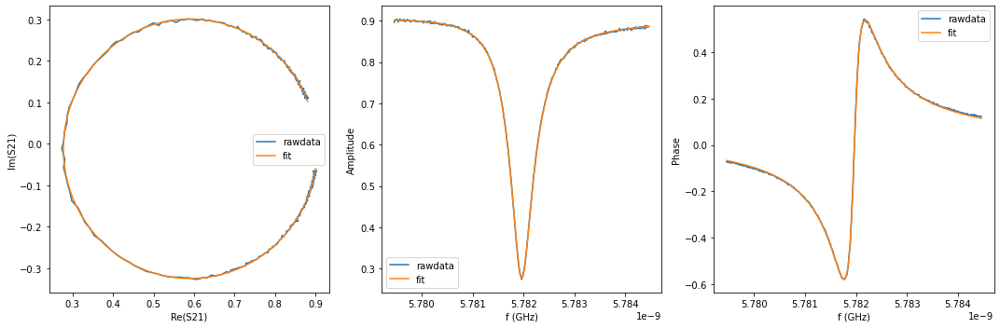

{'Qi_dia_corr': 25013.9324006302, 'Qi_no_corr': 25225.720838990193, 'absQc': 11077.72147214196, 'Qc_dia_corr(Re{Qc})': 11119.063840875782, 'Ql': 7697.438358418466, 'fr': 5.781940722606477, 'theta0': -3.055332058228592, 'phi0': 0.08626074809675895, 'phi0_err': 0.0015685820914179368, 'Ql_err': 14.010731224698787, 'absQc_err': 13.363906340553118, 'fr_err': 7.229899132194655e-07, 'chi_square': 1.688626585054707e-05, 'Qi_no_corr_err': 116.66892134481915, 'Qi_dia_corr_err': 114.64192985640351, 'delay': 0.7495206735239646, 'a': 0.9031573626572454, 'alpha': 2.122319658587124}


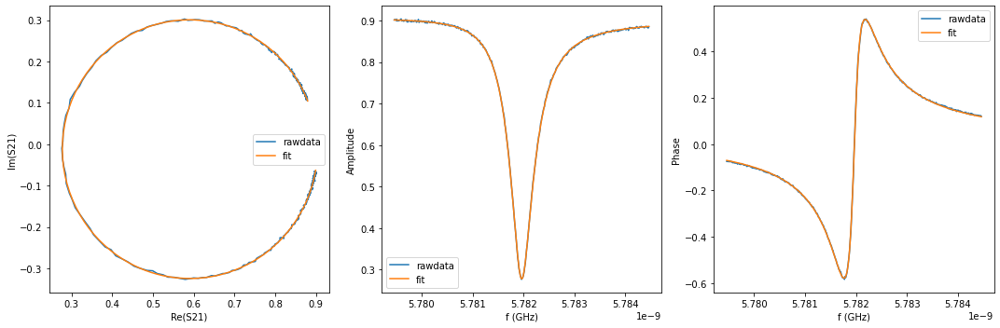

{'Qi_dia_corr': 25082.30294927896, 'Qi_no_corr': 25291.555949832713, 'absQc': 11137.200480300848, 'Qc_dia_corr(Re{Qc})': 11178.266179469267, 'Ql': 7732.274078920566, 'fr': 5.7819409205050105, 'theta0': -3.0558493069016293, 'phi0': 0.0857433466881637, 'phi0_err': 0.0011338088893248755, 'Ql_err': 10.608450889414494, 'absQc_err': 10.886888906154569, 'fr_err': 5.611354227075892e-07, 'chi_square': 9.81735764879358e-06, 'Qi_no_corr_err': 83.86612771046492, 'Qi_dia_corr_err': 82.37912040773482, 'delay': 0.5193169721742258, 'a': 0.9028102519731438, 'alpha': 0.04222742844066877}


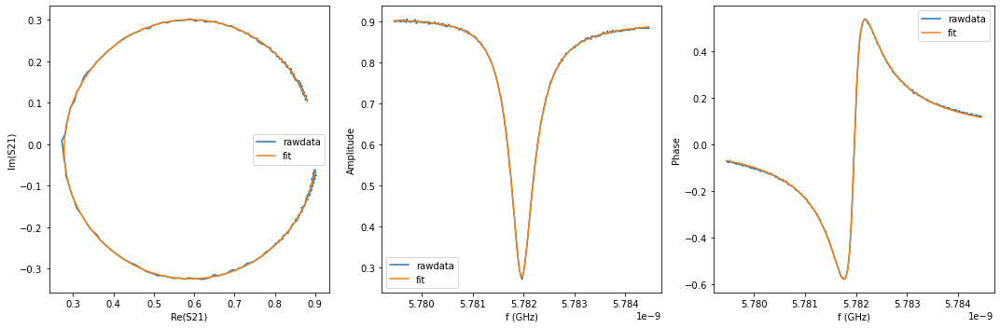

{'Qi_dia_corr': 25036.090671170572, 'Qi_no_corr': 25249.691955390554, 'absQc': 11097.71209399878, 'Qc_dia_corr(Re{Qc})': 11139.483565101771, 'Ql': 7709.321177444287, 'fr': 5.781940416922548, 'theta0': -3.0549648209474913, 'phi0': 0.08662797445034755, 'phi0_err': 0.001272919533135563, 'Ql_err': 11.856435945043224, 'absQc_err': 11.97936068389425, 'fr_err': 6.024193146044026e-07, 'chi_square': 1.2444644688230409e-05, 'Qi_no_corr_err': 91.79727485094284, 'Qi_dia_corr_err': 90.76949269682092, 'delay': 0.6689926140328195, 'a': 0.9033207375446494, 'alpha': -0.8031754879853457}


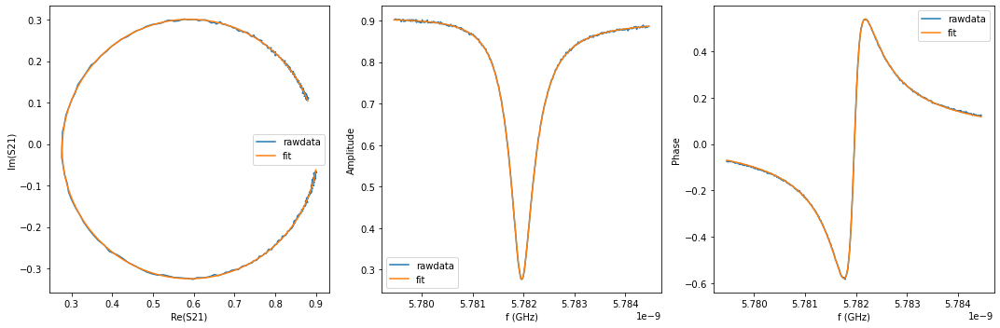

{'Qi_dia_corr': 25104.107137384803, 'Qi_no_corr': 25315.32303754827, 'absQc': 11116.523607057736, 'Qc_dia_corr(Re{Qc})': 11157.74701193831, 'Ql': 7724.516105714995, 'fr': 5.781940892706039, 'theta0': -3.0556062894715526, 'phi0': 0.08598693629660875, 'phi0_err': 0.0011722274550755901, 'Ql_err': 11.80183398559752, 'absQc_err': 11.152338926428397, 'fr_err': 5.343723062276885e-07, 'chi_square': 1.0661899732051136e-05, 'Qi_no_corr_err': 95.0204178055503, 'Qi_dia_corr_err': 93.79358665152952, 'delay': 0.5793260299677913, 'a': 0.9028298956911281, 'alpha': 2.222167605007158}


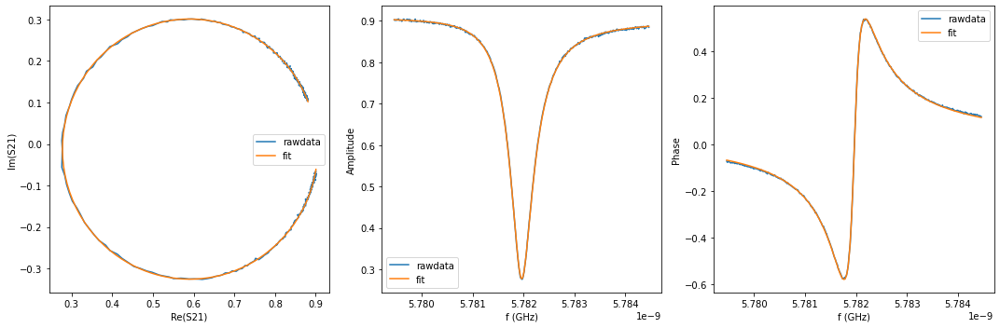

{'Qi_dia_corr': 25007.339318304905, 'Qi_no_corr': 25218.161799342153, 'absQc': 11067.40252209026, 'Qc_dia_corr(Re{Qc})': 11108.502085890292, 'Ql': 7691.751602045964, 'fr': 5.7819410324830685, 'theta0': -3.0555448563739067, 'phi0': 0.08604781481686326, 'phi0_err': 0.001623543105919722, 'Ql_err': 13.793058718048812, 'absQc_err': 12.97062696687891, 'fr_err': 7.184613763455903e-07, 'chi_square': 1.6561275590348688e-05, 'Qi_no_corr_err': 112.12032094498015, 'Qi_dia_corr_err': 110.6683176367341, 'delay': 0.733879317956768, 'a': 0.9036810772856629, 'alpha': 1.5534276194646839}


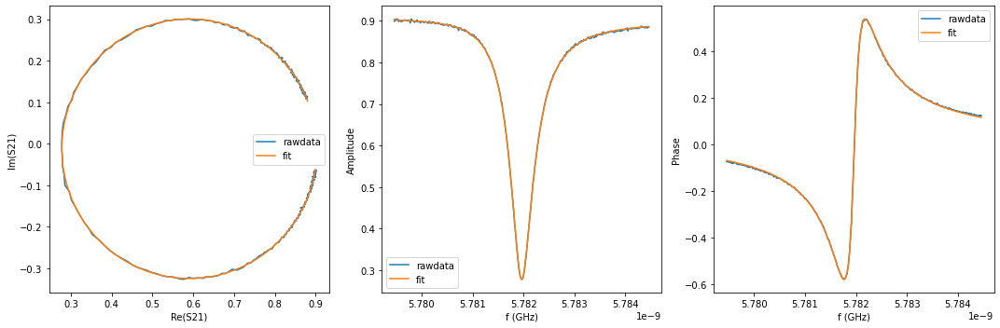

{'Qi_dia_corr': 24998.789057094105, 'Qi_no_corr': 25205.02967318776, 'absQc': 11103.055786405646, 'Qc_dia_corr(Re{Qc})': 11143.553849283195, 'Ql': 7707.72810014608, 'fr': 5.78194113079701, 'theta0': -3.0563117719071644, 'phi0': 0.08528092048441557, 'phi0_err': 0.0012810031501836123, 'Ql_err': 12.622715084031842, 'absQc_err': 12.092744393057957, 'fr_err': 5.847581221778781e-07, 'chi_square': 1.2611591965091764e-05, 'Qi_no_corr_err': 100.54881681534576, 'Qi_dia_corr_err': 98.82592259459098, 'delay': 0.6565570072973437, 'a': 0.9030101412895042, 'alpha': -1.2554582785992914}


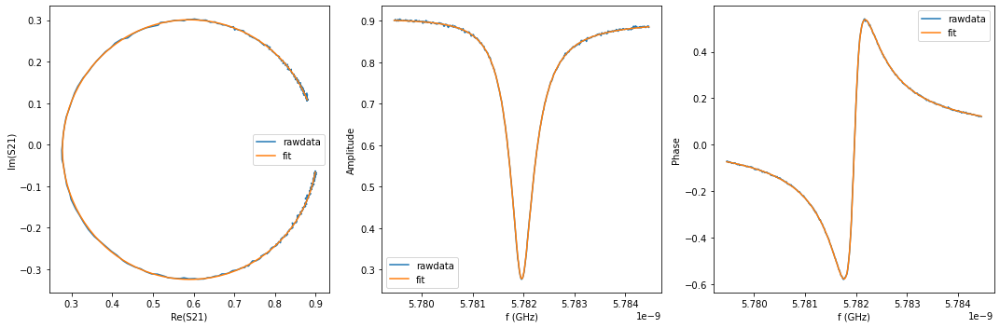

{'Qi_dia_corr': 25230.140093491373, 'Qi_no_corr': 25441.282868504888, 'absQc': 11211.854617882267, 'Qc_dia_corr(Re{Qc})': 11253.357391920325, 'Ql': 7782.252335697978, 'fr': 5.781941217465083, 'theta0': -3.0556826483700745, 'phi0': 0.08591046499213094, 'phi0_err': 0.0009214671242541595, 'Ql_err': 10.146578969675598, 'absQc_err': 9.665550893961578, 'fr_err': 4.1834091606195184e-07, 'chi_square': 7.1810111517342825e-06, 'Qi_no_corr_err': 79.58535638741527, 'Qi_dia_corr_err': 78.40025341887514, 'delay': 0.2329776781054171, 'a': 0.902403821175144, 'alpha': 2.2062254655442777}


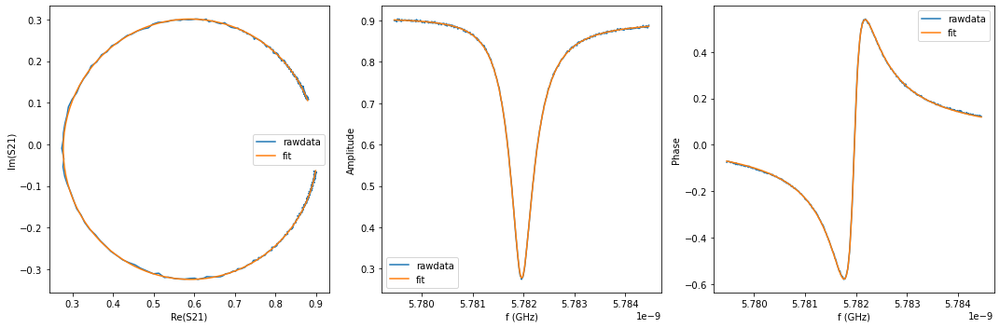

{'Qi_dia_corr': 25147.324329356823, 'Qi_no_corr': 25356.81637446652, 'absQc': 11152.53962538765, 'Qc_dia_corr(Re{Qc})': 11193.552740093004, 'Ql': 7745.765205802202, 'fr': 5.7819409513874005, 'theta0': -3.055963217005777, 'phi0': 0.08562983216077752, 'phi0_err': 0.0011085374054234404, 'Ql_err': 10.16541215788643, 'absQc_err': 10.85974868005821, 'fr_err': 5.625703406010075e-07, 'chi_square': 9.839664720704473e-06, 'Qi_no_corr_err': 78.14021641506014, 'Qi_dia_corr_err': 77.0322174050122, 'delay': 0.476725152209891, 'a': 0.902790646884181, 'alpha': -1.5047141588905708}


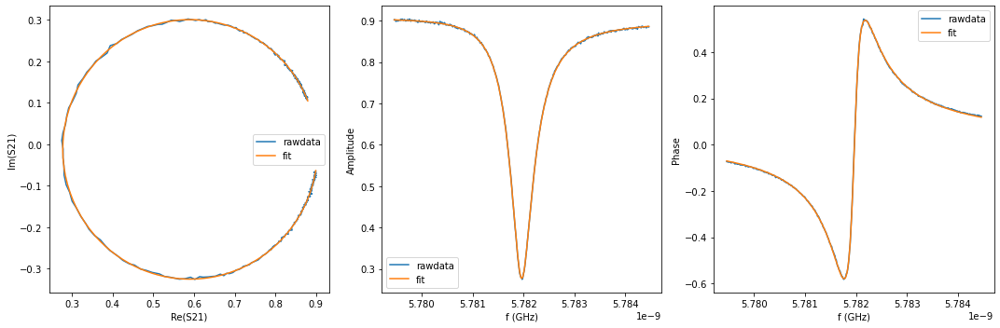

{'Qi_dia_corr': 25199.50488875711, 'Qi_no_corr': 25415.251971884816, 'absQc': 11159.349062186273, 'Qc_dia_corr(Re{Qc})': 11201.457769899067, 'Ql': 7754.497936791612, 'fr': 5.78194094169173, 'theta0': -3.0548582481518833, 'phi0': 0.08673608709852221, 'phi0_err': 0.0010534406965480637, 'Ql_err': 10.125692048267881, 'absQc_err': 10.561059178372146, 'fr_err': 5.157041873510712e-07, 'chi_square': 9.102726029211838e-06, 'Qi_no_corr_err': 78.62348232244818, 'Qi_dia_corr_err': 77.2981005930284, 'delay': 0.4825199426312625, 'a': 0.9028964389861261, 'alpha': -1.2946668098815477}


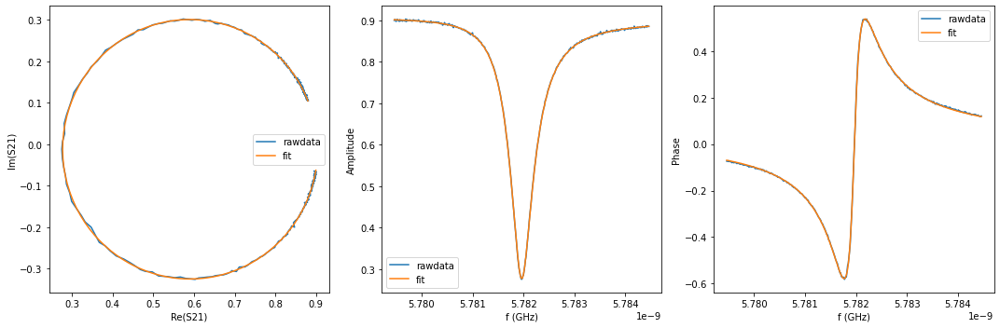

{'Qi_dia_corr': 25217.794167675354, 'Qi_no_corr': 25430.848862813542, 'absQc': 11164.173981198435, 'Qc_dia_corr(Re{Qc})': 11205.735376096649, 'Ql': 7758.279654700899, 'fr': 5.781940893012082, 'theta0': -3.0554389740051966, 'phi0': 0.08615375216011399, 'phi0_err': 0.0010699425599950982, 'Ql_err': 10.324168357886562, 'absQc_err': 10.46295229696488, 'fr_err': 5.046627564000644e-07, 'chi_square': 9.094423656210194e-06, 'Qi_no_corr_err': 79.3497260594933, 'Qi_dia_corr_err': 78.42540082424637, 'delay': 0.5236307389555951, 'a': 0.9027860535998735, 'alpha': 0.1993099522157913}


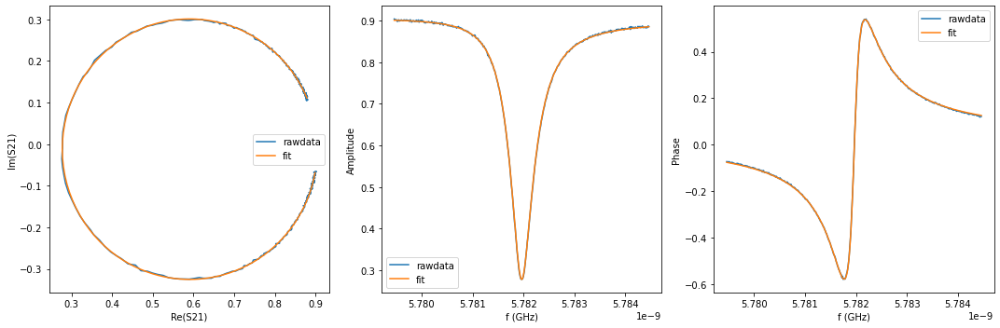

{'Qi_dia_corr': 25444.168716540848, 'Qi_no_corr': 25666.371297199177, 'absQc': 11302.269918011056, 'Qc_dia_corr(Re{Qc})': 11345.901508379446, 'Ql': 7846.8736388797515, 'fr': 5.78194051969563, 'theta0': -3.053865066090687, 'phi0': 0.08772740627810159, 'phi0_err': 0.0011530114757888627, 'Ql_err': 11.375970429040722, 'absQc_err': 10.98978202424495, 'fr_err': 5.37652793840102e-07, 'chi_square': 1.0001894701928694e-05, 'Qi_no_corr_err': 95.52914734842878, 'Qi_dia_corr_err': 94.56107309546302, 'delay': -0.007033867576923343, 'a': 0.9020630138626621, 'alpha': -0.2293893754853758}


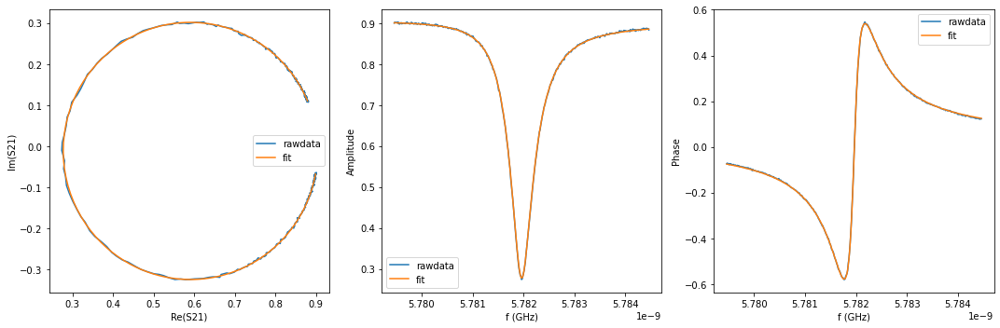

{'Qi_dia_corr': 25450.007641557673, 'Qi_no_corr': 25663.02381524424, 'absQc': 11296.283384365866, 'Qc_dia_corr(Re{Qc})': 11338.055936467019, 'Ql': 7843.6748814324965, 'fr': 5.781940944880103, 'theta0': -3.0557259810808777, 'phi0': 0.08586667250891551, 'phi0_err': 0.0010367444289880717, 'Ql_err': 10.557848379895024, 'absQc_err': 10.404089894657362, 'fr_err': 4.851141384038281e-07, 'chi_square': 8.613101822750496e-06, 'Qi_no_corr_err': 83.42985169054258, 'Qi_dia_corr_err': 82.3154792460754, 'delay': 0.059365890029954724, 'a': 0.9020673337492384, 'alpha': 2.1828965158860933}


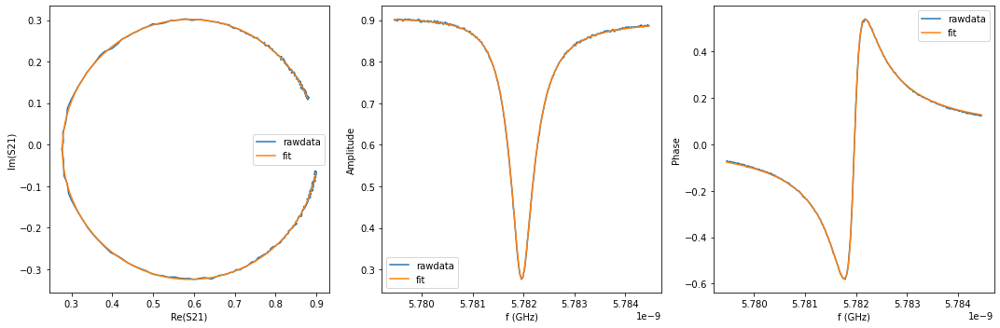

{'Qi_dia_corr': 25465.380598166288, 'Qi_no_corr': 25685.849701667048, 'absQc': 11299.902843672488, 'Qc_dia_corr(Re{Qc})': 11343.105485840828, 'Ql': 7847.551722253244, 'fr': 5.781940637415305, 'theta0': -3.05428705290986, 'phi0': 0.08730560067993287, 'phi0_err': 0.0012517579631591796, 'Ql_err': 11.937436798512131, 'absQc_err': 11.426932926366849, 'fr_err': 5.779786816968514e-07, 'chi_square': 1.1231224107776878e-05, 'Qi_no_corr_err': 102.22698532795705, 'Qi_dia_corr_err': 100.73060692737688, 'delay': -0.06660816281193521, 'a': 0.9020922819410945, 'alpha': -2.3930403205418647}


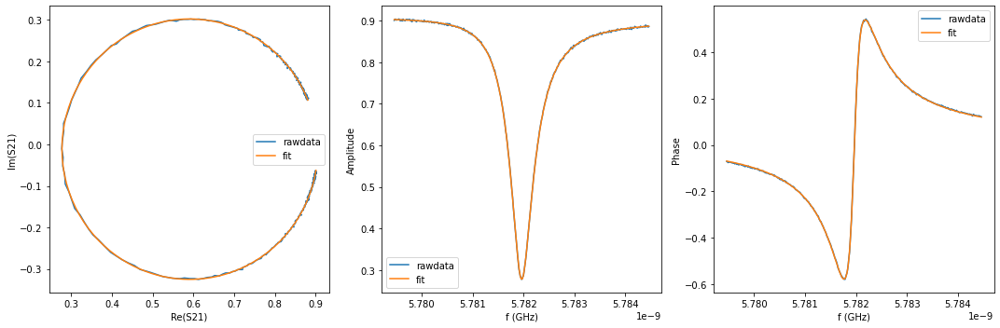

{'Qi_dia_corr': 25130.731700135137, 'Qi_no_corr': 25346.823926460856, 'absQc': 11134.94235646019, 'Qc_dia_corr(Re{Qc})': 11177.163504636814, 'Ql': 7736.342071590327, 'fr': 5.781940235803133, 'theta0': -3.0546454844261266, 'phi0': 0.08694628306043446, 'phi0_err': 0.0009864441737032713, 'Ql_err': 9.554599044050512, 'absQc_err': 9.38891860999698, 'fr_err': 4.64162083712273e-07, 'chi_square': 7.516093493073304e-06, 'Qi_no_corr_err': 77.85898704244363, 'Qi_dia_corr_err': 76.37180165908596, 'delay': 0.4787085835669943, 'a': 0.9038366690856261, 'alpha': -1.4318565225535946}


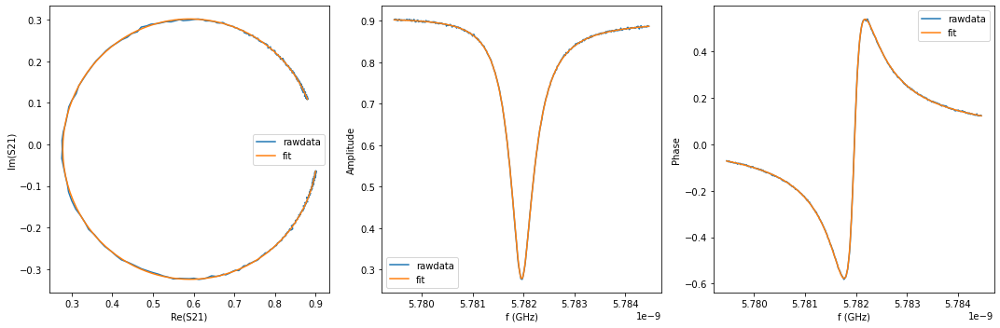

{'Qi_dia_corr': 25152.326334411584, 'Qi_no_corr': 25365.775227424703, 'absQc': 11171.95426261088, 'Qc_dia_corr(Re{Qc})': 11213.867593983652, 'Ql': 7755.963072465697, 'fr': 5.781940624063678, 'theta0': -3.055106070644114, 'phi0': 0.08648658294567894, 'phi0_err': 0.0007986149766150624, 'Ql_err': 8.525894565464695, 'absQc_err': 9.16535108907655, 'fr_err': 4.090683655971667e-07, 'chi_square': 5.995180540716051e-06, 'Qi_no_corr_err': 62.535204792717586, 'Qi_dia_corr_err': 61.81702735416802, 'delay': 0.301408868673279, 'a': 0.9034072176485279, 'alpha': -1.5893862033998638}


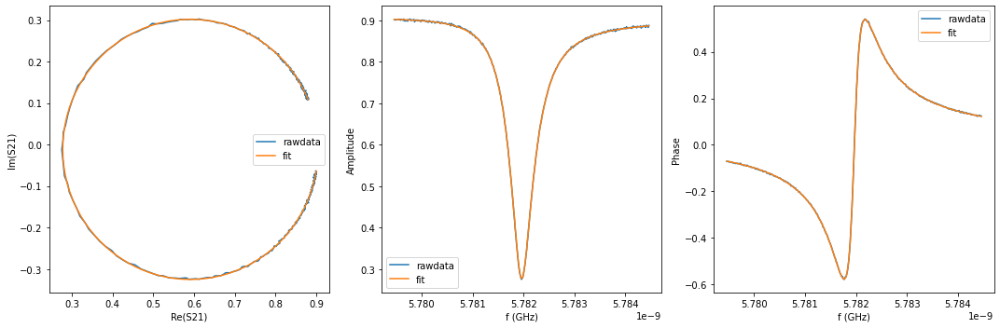

{'Qi_dia_corr': 25250.23393746539, 'Qi_no_corr': 25469.309666982685, 'absQc': 11198.603465911958, 'Qc_dia_corr(Re{Qc})': 11241.487867040001, 'Ql': 7778.481924437277, 'fr': 5.781940347305926, 'theta0': -3.054216900043569, 'phi0': 0.08737575364034217, 'phi0_err': 0.0007981379842138479, 'Ql_err': 8.240802435177244, 'absQc_err': 8.604019233610966, 'fr_err': 3.905969108963511e-07, 'chi_square': 5.607162831640624e-06, 'Qi_no_corr_err': 62.824101796288005, 'Qi_dia_corr_err': 62.05319757611367, 'delay': 0.3544275382832485, 'a': 0.9035647842177343, 'alpha': 0.33662487907229427}


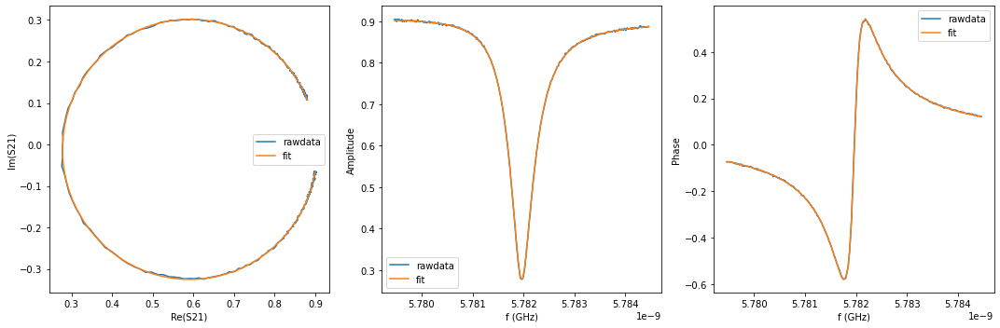

{'Qi_dia_corr': 25291.076302721973, 'Qi_no_corr': 25510.204243109594, 'absQc': 11223.340140853024, 'Qc_dia_corr(Re{Qc})': 11266.285812460343, 'Ql': 7794.230153517397, 'fr': 5.781940146936774, 'theta0': -3.0542508073508743, 'phi0': 0.08734184623891875, 'phi0_err': 0.0007632488075583404, 'Ql_err': 8.481407233566896, 'absQc_err': 8.877447299818671, 'fr_err': 3.719132476125591e-07, 'chi_square': 5.475483951221346e-06, 'Qi_no_corr_err': 62.32889897114452, 'Qi_dia_corr_err': 61.55062079661781, 'delay': 0.30697549945554853, 'a': 0.903499032599728, 'alpha': -1.3877288416580507}


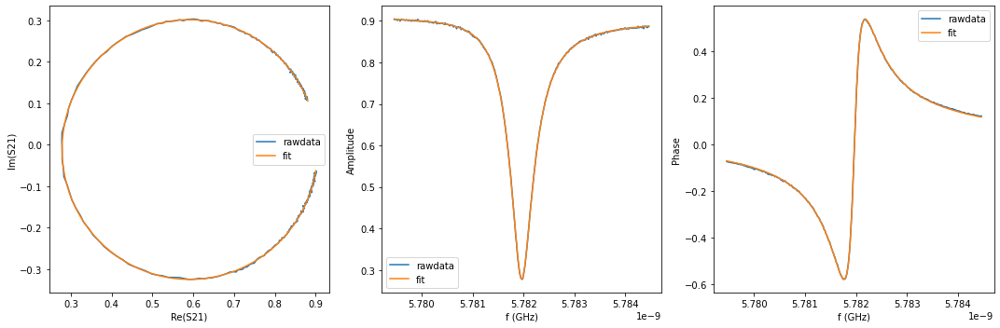

{'Qi_dia_corr': 25076.102190179954, 'Qi_no_corr': 25286.890211346352, 'absQc': 11140.018017507025, 'Qc_dia_corr(Re{Qc})': 11181.424994108147, 'Ql': 7733.195768121533, 'fr': 5.781940695377538, 'theta0': -3.055505713312003, 'phi0': 0.0860869447743934, 'phi0_err': 0.001061021167293731, 'Ql_err': 10.079844864743315, 'absQc_err': 9.62045439539321, 'fr_err': 4.878371693430512e-07, 'chi_square': 8.173501363612577e-06, 'Qi_no_corr_err': 82.09887905276923, 'Qi_dia_corr_err': 80.64725980398485, 'delay': 0.5261111028194771, 'a': 0.9041366039634889, 'alpha': 0.2899007933641215}


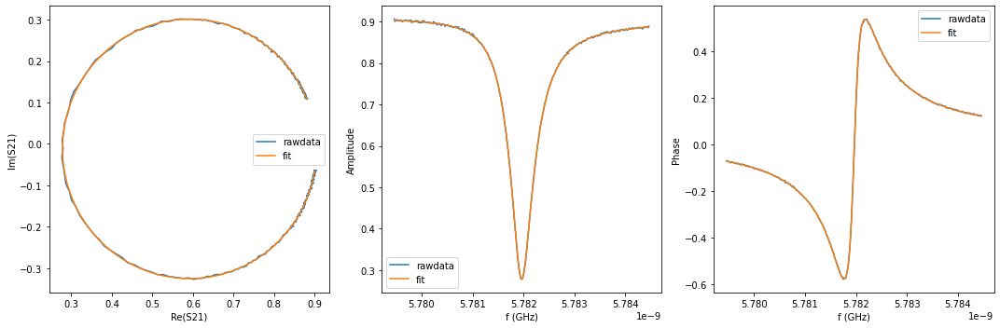

{'Qi_dia_corr': 25185.31726408303, 'Qi_no_corr': 25401.941834315516, 'absQc': 11199.338590319123, 'Qc_dia_corr(Re{Qc})': 11241.969849643192, 'Ql': 7772.54085522696, 'fr': 5.781940331570117, 'theta0': -3.054477659979082, 'phi0': 0.08711545489385092, 'phi0_err': 0.0007450010977533626, 'Ql_err': 7.83587274977361, 'absQc_err': 8.603483339801622, 'fr_err': 3.861055748400928e-07, 'chi_square': 5.229174749411702e-06, 'Qi_no_corr_err': 56.50112910719069, 'Qi_dia_corr_err': 55.821324378555374, 'delay': 0.309243371407359, 'a': 0.9037480041269905, 'alpha': -1.3057981080677732}


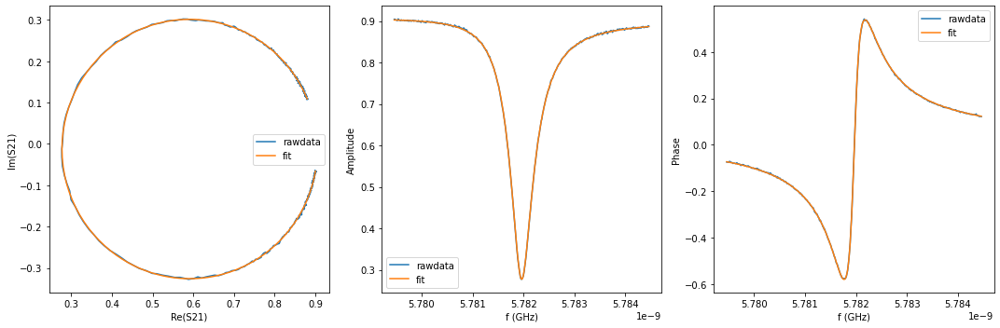

{'Qi_dia_corr': 25354.36635144665, 'Qi_no_corr': 25582.593373954507, 'absQc': 11219.338541666973, 'Qc_dia_corr(Re{Qc})': 11263.803928019133, 'Ql': 7799.040998561528, 'fr': 5.781939549170431, 'theta0': -3.0527080653015024, 'phi0': 0.08888458828829061, 'phi0_err': 0.0007801179899596697, 'Ql_err': 8.524348599446435, 'absQc_err': 8.666927590855655, 'fr_err': 3.731890592050951e-07, 'chi_square': 5.512697242623956e-06, 'Qi_no_corr_err': 66.25070098389365, 'Qi_dia_corr_err': 65.17055995617731, 'delay': 0.22089092231283242, 'a': 0.9036176799294806, 'alpha': 1.7681611062239813}


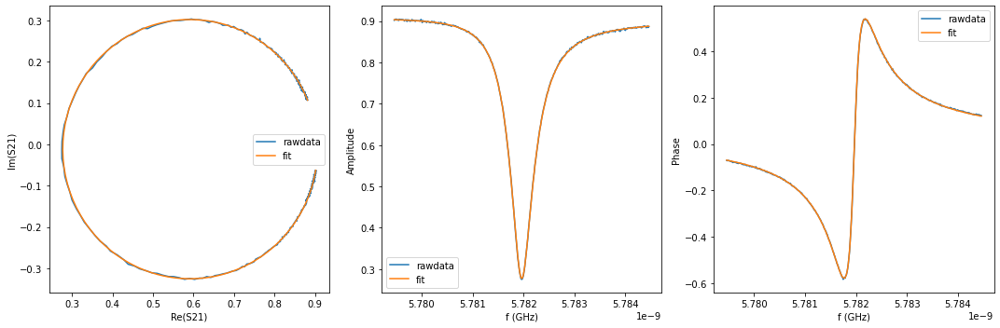

{'Qi_dia_corr': 25210.209820084918, 'Qi_no_corr': 25428.136675194593, 'absQc': 11146.774402893214, 'Qc_dia_corr(Re{Qc})': 11189.174515836456, 'Ql': 7749.621110470463, 'fr': 5.78194063177676, 'theta0': -3.054509889390262, 'phi0': 0.08708366905085191, 'phi0_err': 0.0008309539601016187, 'Ql_err': 8.264223273586126, 'absQc_err': 8.833111173938503, 'fr_err': 4.177660808678734e-07, 'chi_square': 6.044078299811623e-06, 'Qi_no_corr_err': 62.939780029177314, 'Qi_dia_corr_err': 62.264774262876685, 'delay': 0.45555464298308507, 'a': 0.9045014613794371, 'alpha': -2.2726420217663765}


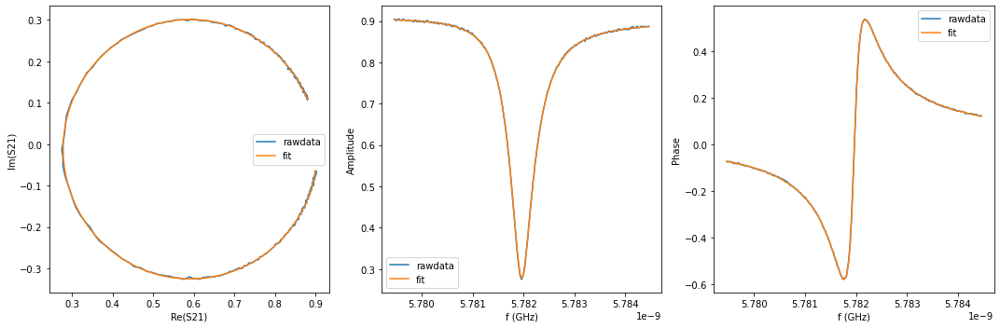

{'Qi_dia_corr': 25249.583118387, 'Qi_no_corr': 25475.93368869955, 'absQc': 11218.866180349345, 'Qc_dia_corr(Re{Qc})': 11263.330645463499, 'Ql': 7788.871771829668, 'fr': 5.7819396987986025, 'theta0': -3.052707549342466, 'phi0': 0.08888553556367931, 'phi0_err': 0.0008279225247768927, 'Ql_err': 8.223183662547301, 'absQc_err': 8.447210016025359, 'fr_err': 4.0250664534526146e-07, 'chi_square': 5.662295068787499e-06, 'Qi_no_corr_err': 65.70413701414755, 'Qi_dia_corr_err': 64.86270043515836, 'delay': 0.2949947238846339, 'a': 0.9036098184562469, 'alpha': -1.8227047086982566}


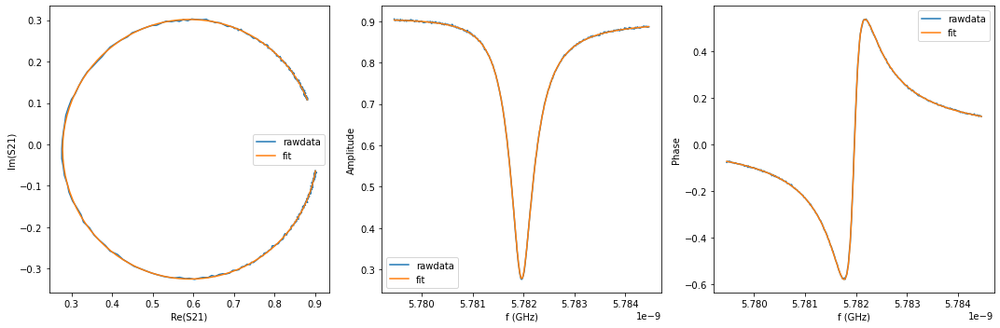

{'Qi_dia_corr': 25257.30354803188, 'Qi_no_corr': 25477.767177559002, 'absQc': 11213.089561656758, 'Qc_dia_corr(Re{Qc})': 11256.332061443358, 'Ql': 7786.258228406641, 'fr': 5.781940161105197, 'theta0': -3.053910526596426, 'phi0': 0.0876821269933672, 'phi0_err': 0.000773327648061885, 'Ql_err': 8.189531908769528, 'absQc_err': 8.454036736528828, 'fr_err': 3.729036917704224e-07, 'chi_square': 5.315531595398356e-06, 'Qi_no_corr_err': 61.71443197924188, 'Qi_dia_corr_err': 60.757002109428555, 'delay': 0.32564398003296713, 'a': 0.9040142810068174, 'alpha': -0.7093358927219744}


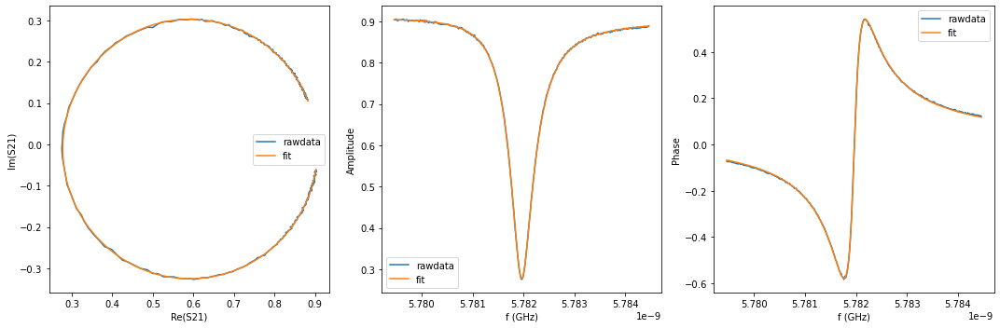

{'Qi_dia_corr': 25014.128218872647, 'Qi_no_corr': 25223.52133037668, 'absQc': 11070.665321157456, 'Qc_dia_corr(Re{Qc})': 11111.489485533106, 'Ql': 7693.826164248073, 'fr': 5.78194088499712, 'theta0': -3.055845340375375, 'phi0': 0.08574732251390521, 'phi0_err': 0.0013714887168970048, 'Ql_err': 11.650058538861419, 'absQc_err': 10.702949437060527, 'fr_err': 5.991190353471198e-07, 'chi_square': 1.148008726541634e-05, 'Qi_no_corr_err': 95.84857110477625, 'Qi_dia_corr_err': 94.5063730125818, 'delay': 0.6624040467919866, 'a': 0.9053064648724835, 'alpha': -1.041657415545612}


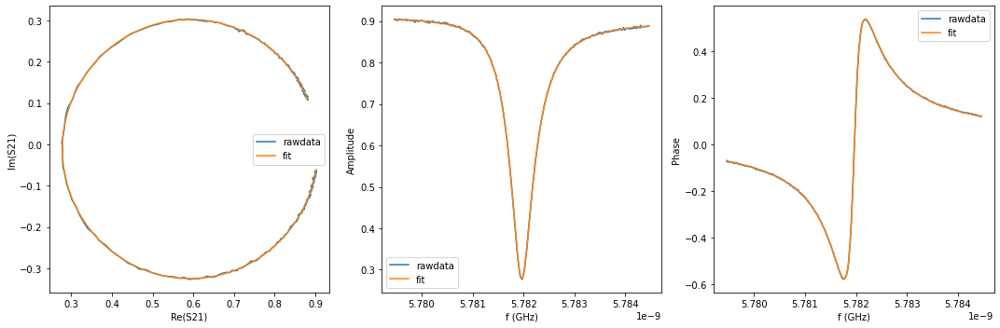

{'Qi_dia_corr': 25151.25526775277, 'Qi_no_corr': 25363.795657765524, 'absQc': 11160.62593311472, 'Qc_dia_corr(Re{Qc})': 11202.280493707844, 'Ql': 7750.3167264655995, 'fr': 5.7819406421034, 'theta0': -3.0553297170265847, 'phi0': 0.08626362821186553, 'phi0_err': 0.0008094056413936939, 'Ql_err': 8.572988846568027, 'absQc_err': 8.616867756414626, 'fr_err': 3.840369629870382e-07, 'chi_square': 5.69498592309821e-06, 'Qi_no_corr_err': 65.9644281136852, 'Qi_dia_corr_err': 65.27801485561811, 'delay': 0.4257510986956637, 'a': 0.904787154265516, 'alpha': 2.9277287328294914}


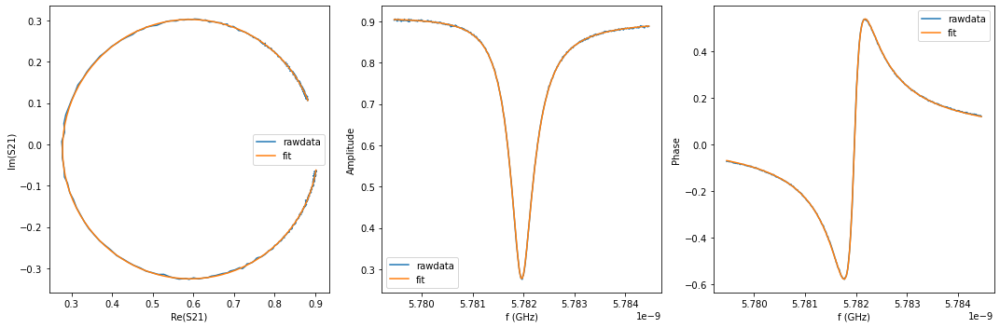

{'Qi_dia_corr': 25203.338944327894, 'Qi_no_corr': 25420.855206816756, 'absQc': 11143.4225222465, 'Qc_dia_corr(Re{Qc})': 11185.740688489308, 'Ql': 7747.324657838012, 'fr': 5.781940474300895, 'theta0': -3.054581237553753, 'phi0': 0.08701278293274763, 'phi0_err': 0.0008638675073489407, 'Ql_err': 8.41659332677261, 'absQc_err': 8.432005037668814, 'fr_err': 4.075261099787868e-07, 'chi_square': 5.955015774359012e-06, 'Qi_no_corr_err': 66.06728025309744, 'Qi_dia_corr_err': 65.26633880987487, 'delay': 0.4892222691408048, 'a': 0.9050629552083955, 'alpha': -1.049669385308249}


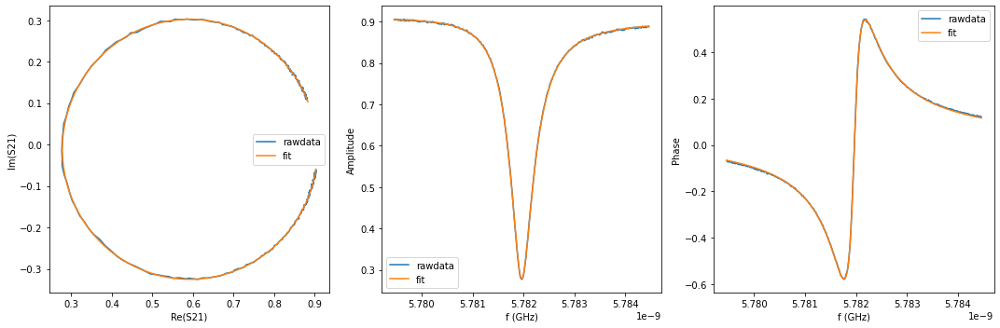

{'Qi_dia_corr': 24997.4202171799, 'Qi_no_corr': 25206.8939530631, 'absQc': 11051.924683228526, 'Qc_dia_corr(Re{Qc})': 11092.68048802269, 'Ql': 7683.225872906549, 'fr': 5.781940640003044, 'theta0': -3.0558445462291304, 'phi0': 0.08574810736066293, 'phi0_err': 0.0015485972885934552, 'Ql_err': 13.42580884928776, 'absQc_err': 11.375035626081058, 'fr_err': 6.49651915665876e-07, 'chi_square': 1.344746397034255e-05, 'Qi_no_corr_err': 114.09817093333676, 'Qi_dia_corr_err': 112.32006874667165, 'delay': 0.7578576535396903, 'a': 0.905953829364278, 'alpha': 2.4261888798504985}


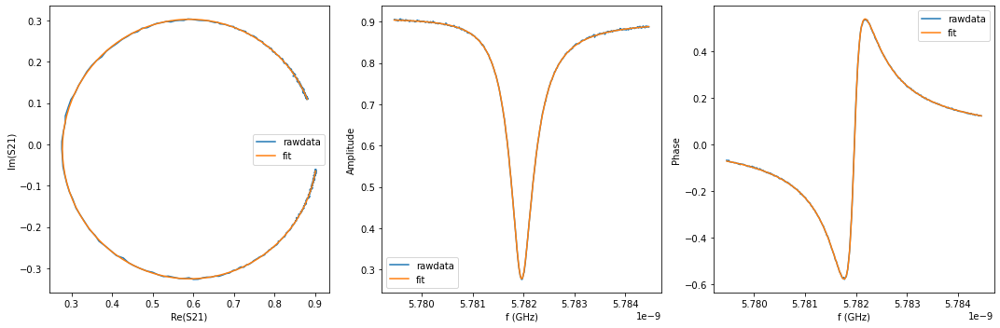

{'Qi_dia_corr': 25301.551921767044, 'Qi_no_corr': 25521.347619646316, 'absQc': 11210.843905103702, 'Qc_dia_corr(Re{Qc})': 11253.788199094868, 'Ql': 7789.239697799162, 'fr': 5.781940179950294, 'theta0': -3.0542042719026665, 'phi0': 0.08738895874320796, 'phi0_err': 0.0006936488277478184, 'Ql_err': 7.4468359353832545, 'absQc_err': 7.718874217079155, 'fr_err': 3.3715285336528666e-07, 'chi_square': 4.3691881632370845e-06, 'Qi_no_corr_err': 56.96037493415316, 'Qi_dia_corr_err': 56.06363254631186, 'delay': 0.28130219659215744, 'a': 0.9047263811600628, 'alpha': -2.319680453217047}


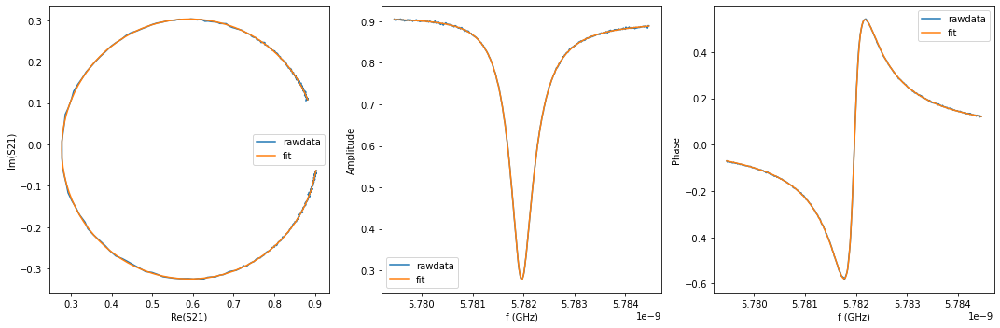

{'Qi_dia_corr': 25219.67470250449, 'Qi_no_corr': 25434.630625607944, 'absQc': 11159.64482380169, 'Qc_dia_corr(Re{Qc})': 11201.53502196087, 'Ql': 7756.443884201914, 'fr': 5.781940609751962, 'theta0': -3.055083667497167, 'phi0': 0.08651031059377175, 'phi0_err': 0.000694736262404018, 'Ql_err': 7.243410761608034, 'absQc_err': 7.638275754510056, 'fr_err': 3.464156790279484e-07, 'chi_square': 4.327040204896099e-06, 'Qi_no_corr_err': 56.49272082612556, 'Qi_dia_corr_err': 55.563967744995956, 'delay': 0.3949934400539397, 'a': 0.9053016005286939, 'alpha': 1.8106800693358653}


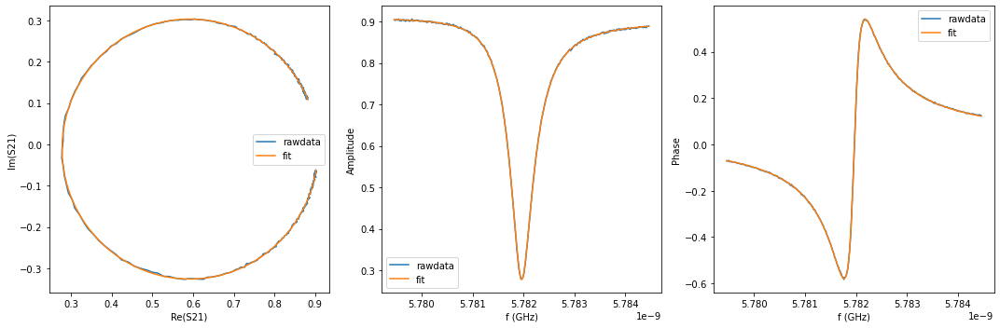

{'Qi_dia_corr': 25223.51524144467, 'Qi_no_corr': 25444.545883149498, 'absQc': 11151.26894536903, 'Qc_dia_corr(Re{Qc})': 11194.259378903302, 'Ql': 7753.317576486073, 'fr': 5.781940166816342, 'theta0': -3.053924577355618, 'phi0': 0.08766824528878474, 'phi0_err': 0.0007417840168428505, 'Ql_err': 7.626734099801753, 'absQc_err': 7.701247273266049, 'fr_err': 3.554280810827767e-07, 'chi_square': 4.665105571423691e-06, 'Qi_no_corr_err': 59.25958308458689, 'Qi_dia_corr_err': 58.65604058190603, 'delay': 0.41487211703818844, 'a': 0.90559201323368, 'alpha': 2.532973804311573}


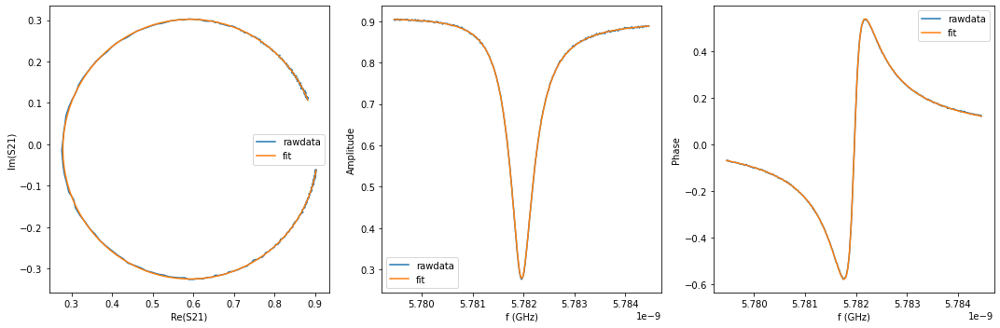

{'Qi_dia_corr': 25096.666834888438, 'Qi_no_corr': 25320.533395497092, 'absQc': 11141.194636804647, 'Qc_dia_corr(Re{Qc})': 11185.095371100584, 'Ql': 7736.906781187924, 'fr': 5.781939747774383, 'theta0': -3.052965858293879, 'phi0': 0.0886284582691805, 'phi0_err': 0.0007425805983408214, 'Ql_err': 7.398862754115975, 'absQc_err': 7.669937160891524, 'fr_err': 3.605917477892937e-07, 'chi_square': 4.62951104619279e-06, 'Qi_no_corr_err': 54.82713747795447, 'Qi_dia_corr_err': 54.03976093437114, 'delay': 0.4395215563147945, 'a': 0.9054159236128165, 'alpha': -2.8546683743129964}


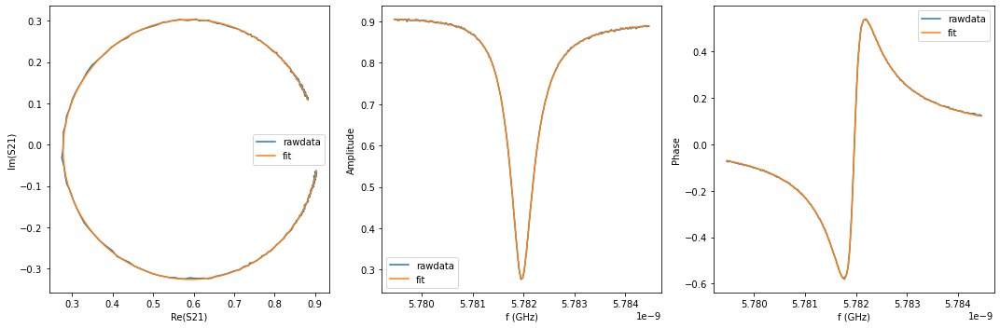

{'Qi_dia_corr': 25199.068870187453, 'Qi_no_corr': 25421.729348849436, 'absQc': 11141.696774959331, 'Qc_dia_corr(Re{Qc})': 11185.012076922096, 'Ql': 7746.571640766685, 'fr': 5.781939935254545, 'theta0': -3.053558894062246, 'phi0': 0.0880354719371301, 'phi0_err': 0.0007199102250387762, 'Ql_err': 7.3997759719735505, 'absQc_err': 7.6599078608379205, 'fr_err': 3.4961876851356884e-07, 'chi_square': 4.540367097151381e-06, 'Qi_no_corr_err': 56.056770928484646, 'Qi_dia_corr_err': 55.32821086411897, 'delay': 0.41266262566335493, 'a': 0.9059382175571146, 'alpha': 2.4526021842954995}


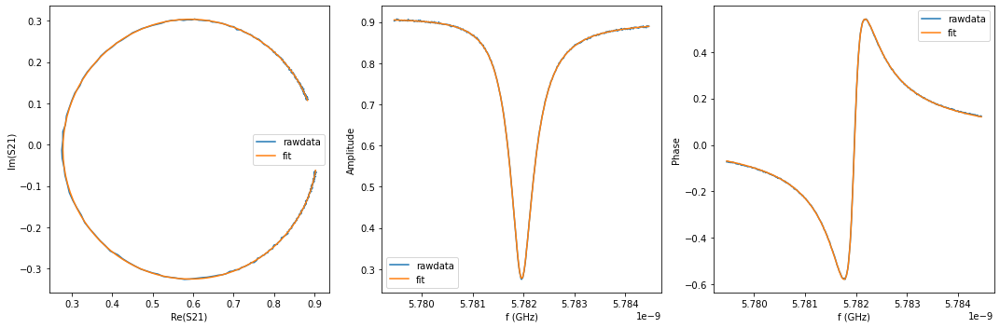

{'Qi_dia_corr': 25167.025457765692, 'Qi_no_corr': 25377.59006328788, 'absQc': 11126.358857855417, 'Qc_dia_corr(Re{Qc})': 11167.323130762654, 'Ql': 7735.058324830772, 'fr': 5.781940983746677, 'theta0': -3.0559149571098807, 'phi0': 0.08567930376709534, 'phi0_err': 0.0007876059177215467, 'Ql_err': 7.820068961381311, 'absQc_err': 7.820687724209108, 'fr_err': 3.6597763804500716e-07, 'chi_square': 4.986946288928992e-06, 'Qi_no_corr_err': 59.40992576051921, 'Qi_dia_corr_err': 58.79489093818806, 'delay': 0.4849086355968581, 'a': 0.9060073001447855, 'alpha': -1.2060822277545464}


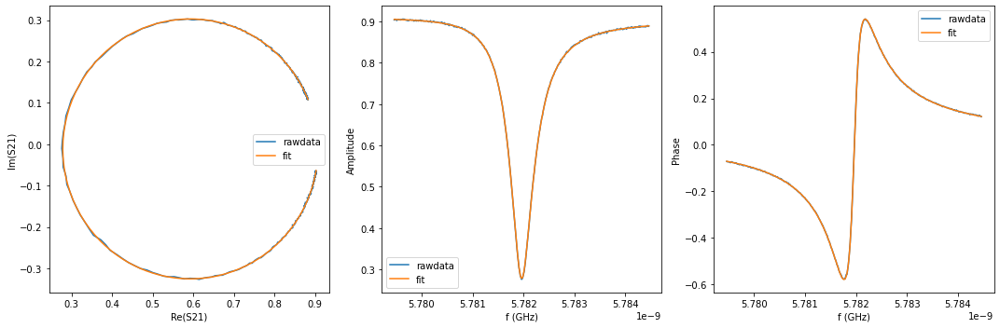

{'Qi_dia_corr': 25176.14741689167, 'Qi_no_corr': 25392.134027196287, 'absQc': 11160.135795397659, 'Qc_dia_corr(Re{Qc})': 11202.375215586027, 'Ql': 7752.72411956435, 'fr': 5.7819405948017435, 'theta0': -3.0547270646974525, 'phi0': 0.08686712949168417, 'phi0_err': 0.0006437343406232554, 'Ql_err': 6.743884322889158, 'absQc_err': 6.951397586433242, 'fr_err': 3.094635453405004e-07, 'chi_square': 3.6412992466443945e-06, 'Qi_no_corr_err': 50.191324252020934, 'Qi_dia_corr_err': 49.353968924846384, 'delay': 0.37570205505293575, 'a': 0.9060189125825561, 'alpha': 1.1096724741586783}


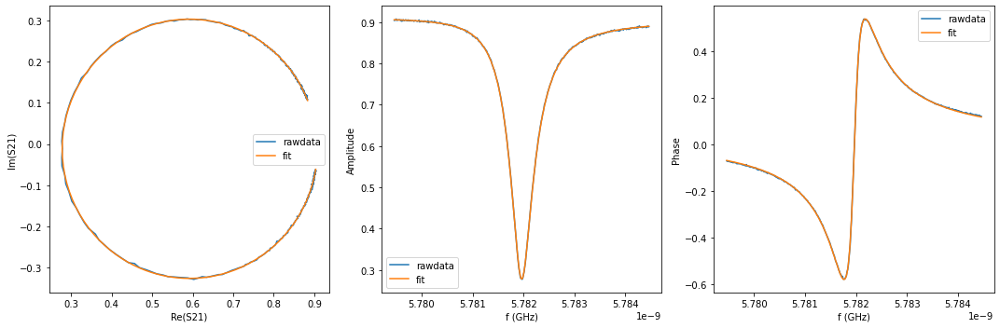

{'Qi_dia_corr': 25074.297780805908, 'Qi_no_corr': 25290.288632576805, 'absQc': 11089.91250871374, 'Qc_dia_corr(Re{Qc})': 11131.961210925314, 'Ql': 7709.33308384246, 'fr': 5.781940446968211, 'theta0': -3.0546484714263906, 'phi0': 0.08694452785691667, 'phi0_err': 0.0009922491439086313, 'Ql_err': 8.917354907889447, 'absQc_err': 8.760687327075576, 'fr_err': 4.561197869888435e-07, 'chi_square': 7.036354655204034e-06, 'Qi_no_corr_err': 70.45911480795577, 'Qi_dia_corr_err': 69.42357517096791, 'delay': 0.6036001354962349, 'a': 0.9067490415292031, 'alpha': 3.10557869475762}


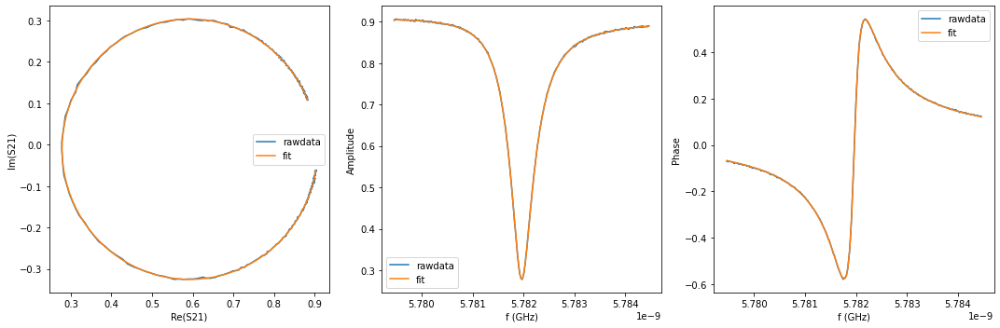

{'Qi_dia_corr': 25148.149914761492, 'Qi_no_corr': 25363.77778922908, 'absQc': 11139.367116333708, 'Qc_dia_corr(Re{Qc})': 11181.473162704197, 'Ql': 7740.057274031679, 'fr': 5.781940530432423, 'theta0': -3.054782796259159, 'phi0': 0.08681086756773111, 'phi0_err': 0.0007170337301244995, 'Ql_err': 7.120614138984873, 'absQc_err': 7.305023218095642, 'fr_err': 3.4571620205558054e-07, 'chi_square': 4.298882117241001e-06, 'Qi_no_corr_err': 54.34429963077561, 'Qi_dia_corr_err': 53.59366569123593, 'delay': 0.47637159708272114, 'a': 0.9064351604254084, 'alpha': -1.5154688508722567}


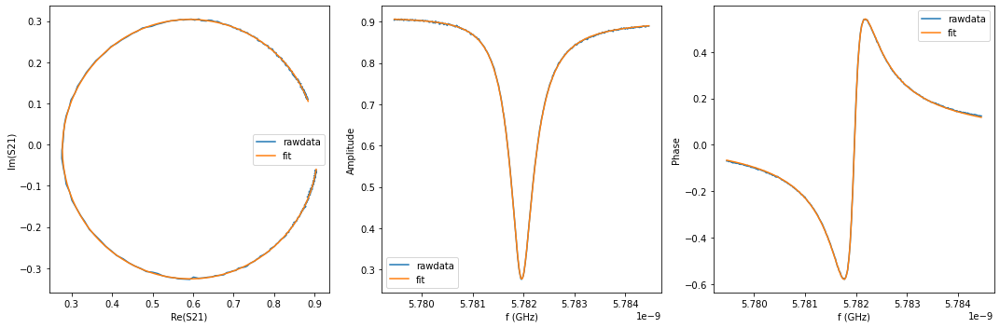

{'Qi_dia_corr': 25174.685837779358, 'Qi_no_corr': 25387.059381371982, 'absQc': 11080.633148341876, 'Qc_dia_corr(Re{Qc})': 11121.583265592652, 'Ql': 7713.805623729746, 'fr': 5.781940993977079, 'theta0': -3.0557524116450274, 'phi0': 0.08584057366304036, 'phi0_err': 0.001213346080910847, 'Ql_err': 10.542306184118175, 'absQc_err': 9.157636565539143, 'fr_err': 5.216469614329085e-07, 'chi_square': 8.545561747640209e-06, 'Qi_no_corr_err': 90.41291930313162, 'Qi_dia_corr_err': 88.43594151319935, 'delay': 0.6755186996562846, 'a': 0.9070255984634724, 'alpha': -0.5644439664954937}


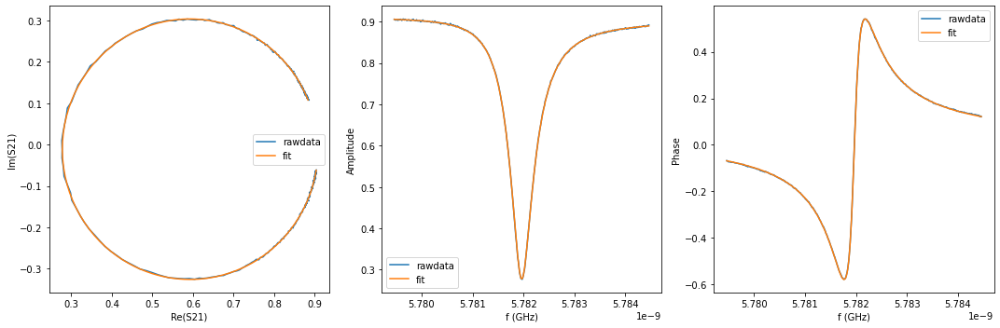

{'Qi_dia_corr': 25219.197303686702, 'Qi_no_corr': 25438.396603848007, 'absQc': 11131.485509521657, 'Qc_dia_corr(Re{Qc})': 11173.984573259462, 'Ql': 7743.178999138072, 'fr': 5.781940659163083, 'theta0': -3.0543486508741955, 'phi0': 0.08724456686585036, 'phi0_err': 0.0007147313538785972, 'Ql_err': 7.391557709038337, 'absQc_err': 7.127136239524901, 'fr_err': 3.290881755540324e-07, 'chi_square': 4.167505055808966e-06, 'Qi_no_corr_err': 58.493235084110445, 'Qi_dia_corr_err': 57.71835393493274, 'delay': 0.46916632427433896, 'a': 0.9067067601575076, 'alpha': -1.7773993293320969}


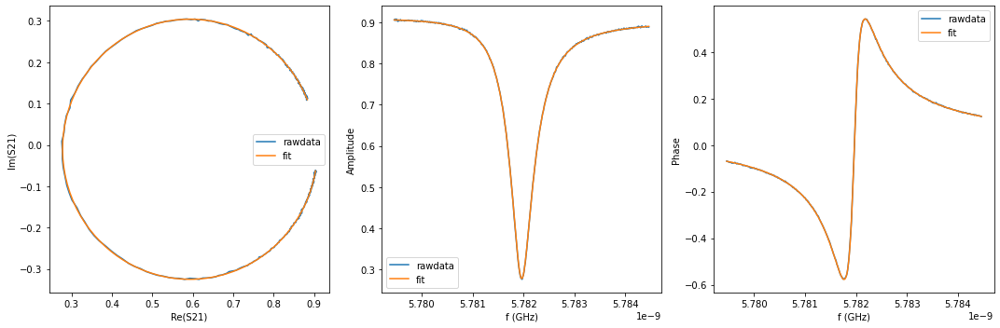

{'Qi_dia_corr': 25247.105411904224, 'Qi_no_corr': 25460.061115850945, 'absQc': 11164.081480126506, 'Qc_dia_corr(Re{Qc})': 11205.526610547578, 'Ql': 7760.951564708557, 'fr': 5.7819409669142185, 'theta0': -3.055558739028901, 'phi0': 0.08603389128727681, 'phi0_err': 0.000643444198264946, 'Ql_err': 6.467849290158072, 'absQc_err': 6.791002202815167, 'fr_err': 3.1578778798142554e-07, 'chi_square': 3.57817779363178e-06, 'Qi_no_corr_err': 48.0747295163629, 'Qi_dia_corr_err': 47.36570527266542, 'delay': 0.35970500533697797, 'a': 0.9064681835515456, 'alpha': 0.5295180080313081}


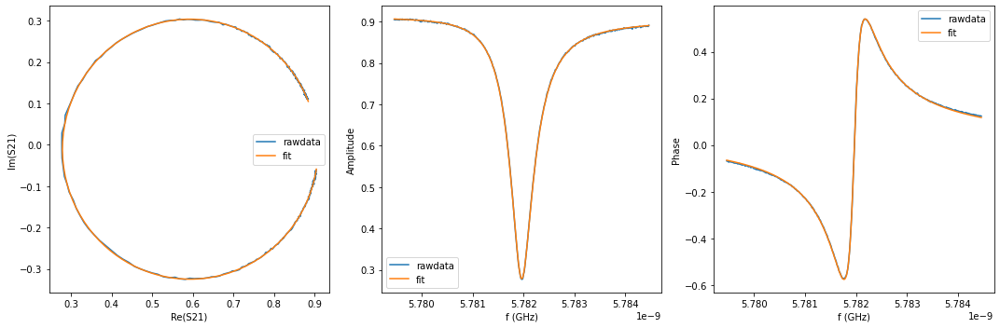

{'Qi_dia_corr': 25001.882689031238, 'Qi_no_corr': 25210.967423930884, 'absQc': 11065.572960605077, 'Qc_dia_corr(Re{Qc})': 11106.339604261411, 'Ql': 7690.1985823286095, 'fr': 5.781941004170954, 'theta0': -3.0558860412079367, 'phi0': 0.08570673163861185, 'phi0_err': 0.0015865085934196434, 'Ql_err': 12.399892675303112, 'absQc_err': 10.337771967718995, 'fr_err': 6.367168919429539e-07, 'chi_square': 1.1752449357278775e-05, 'Qi_no_corr_err': 104.67690242708441, 'Qi_dia_corr_err': 103.1164747228224, 'delay': 0.7292091246942781, 'a': 0.9075159692356527, 'alpha': 1.3867184384314366}


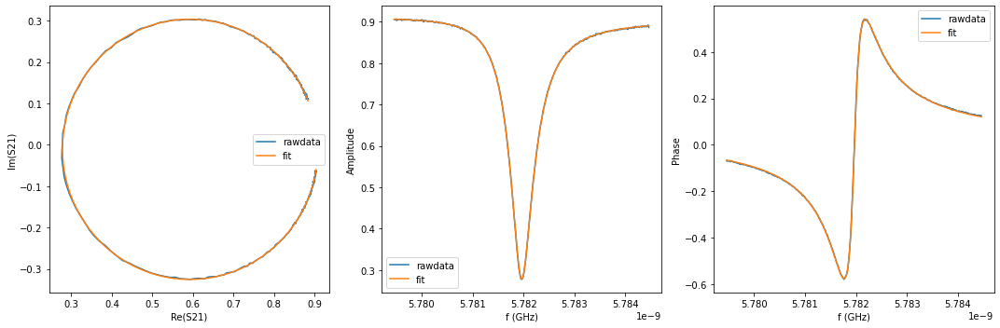

{'Qi_dia_corr': 25148.242462176247, 'Qi_no_corr': 25366.52321117058, 'absQc': 11119.392833809952, 'Qc_dia_corr(Re{Qc})': 11161.861100684575, 'Ql': 7730.663417227474, 'fr': 5.781940785985801, 'theta0': -3.0543327602295944, 'phi0': 0.08726031071130799, 'phi0_err': 0.0009839750528363327, 'Ql_err': 9.00192428960204, 'absQc_err': 8.387675563665864, 'fr_err': 4.2196813217106403e-07, 'chi_square': 6.429738237921416e-06, 'Qi_no_corr_err': 70.88068540644701, 'Qi_dia_corr_err': 69.65721294775956, 'delay': 0.5833903031920966, 'a': 0.90723385128719, 'alpha': 2.372880175087245}


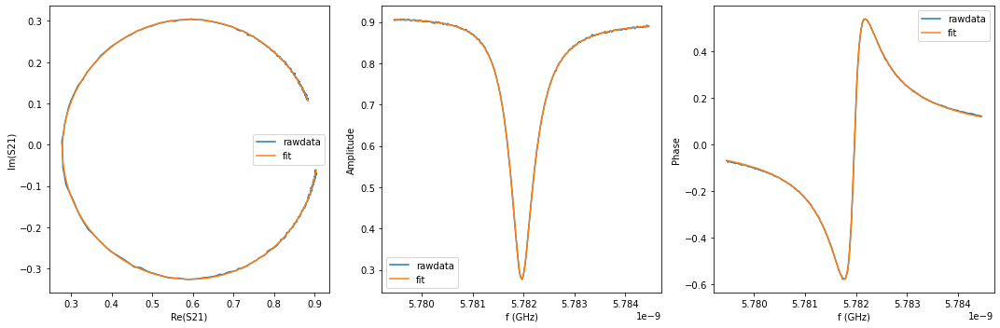

{'Qi_dia_corr': 25124.090503965053, 'Qi_no_corr': 25342.056966608096, 'absQc': 11118.530353930646, 'Qc_dia_corr(Re{Qc})': 11161.012696072814, 'Ql': 7727.972869365954, 'fr': 5.781940543586056, 'theta0': -3.054314610404551, 'phi0': 0.08727809819113355, 'phi0_err': 0.0009089082639577037, 'Ql_err': 8.34163523944304, 'absQc_err': 8.256024862787179, 'fr_err': 4.1734770407209764e-07, 'chi_square': 6.02806668561257e-06, 'Qi_no_corr_err': 65.03450776428932, 'Qi_dia_corr_err': 64.4631714191119, 'delay': 0.574299014649534, 'a': 0.907088964126582, 'alpha': 2.041928551748649}


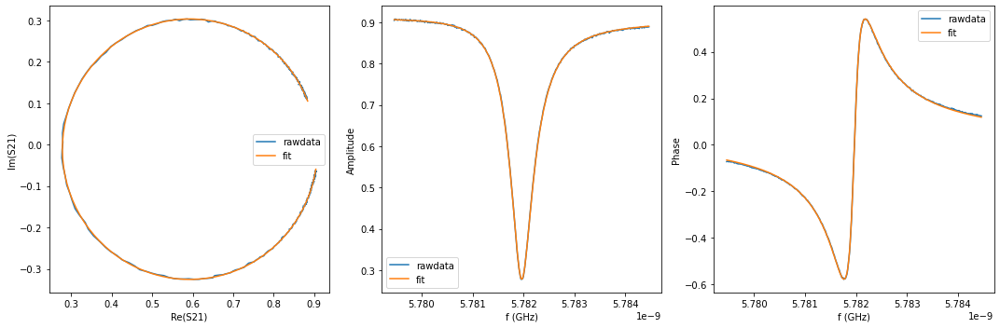

{'Qi_dia_corr': 25086.89888981698, 'Qi_no_corr': 25302.76736918071, 'absQc': 11071.247504034114, 'Qc_dia_corr(Re{Qc})': 11113.088843220834, 'Ql': 7701.464934724126, 'fr': 5.781940621853965, 'theta0': -3.0547892511336827, 'phi0': 0.08680340245611047, 'phi0_err': 0.0014153068377242707, 'Ql_err': 11.705451809342167, 'absQc_err': 10.231270827198696, 'fr_err': 6.024698256608667e-07, 'chi_square': 1.09983715668972e-05, 'Qi_no_corr_err': 99.00300038653631, 'Qi_dia_corr_err': 97.63246789515073, 'delay': 0.6880558135150958, 'a': 0.9074521108732302, 'alpha': -0.10835424529514545}


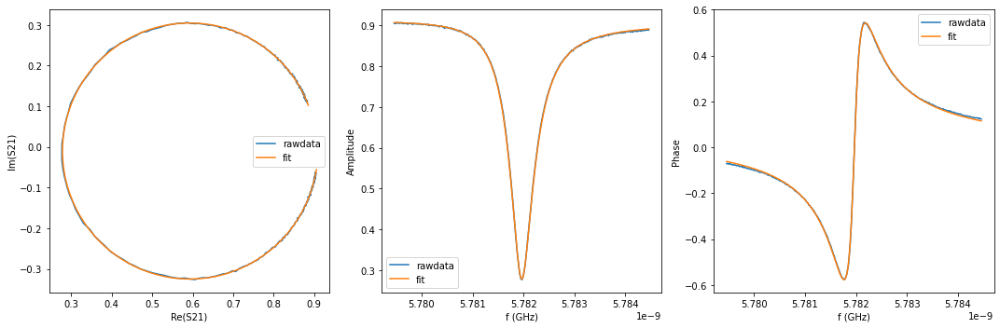

{'Qi_dia_corr': 24831.124046460543, 'Qi_no_corr': 25032.676979902222, 'absQc': 10953.372115793318, 'Qc_dia_corr(Re{Qc})': 10992.413602878263, 'Ql': 7619.403432874205, 'fr': 5.781941706717474, 'theta0': -3.0572873855310765, 'phi0': 0.08430634596397746, 'phi0_err': 0.0026295473505951144, 'Ql_err': 19.59751758847807, 'absQc_err': 14.104493523609747, 'fr_err': 1.0428169108120777e-06, 'chi_square': 2.4661572856870782e-05, 'Qi_no_corr_err': 178.1731701205353, 'Qi_dia_corr_err': 175.93976378288923, 'delay': 1.0039136548566503, 'a': 0.9087110025705947, 'alpha': -1.1996538532681051}


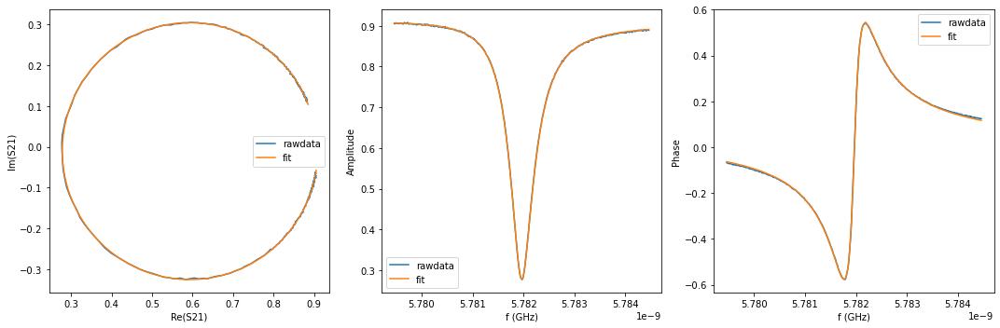

{'Qi_dia_corr': 24967.946869660067, 'Qi_no_corr': 25176.010858150392, 'absQc': 11036.458589457296, 'Qc_dia_corr(Re{Qc})': 11076.923264396051, 'Ql': 7672.881897372508, 'fr': 5.781941529659697, 'theta0': -3.05609076877943, 'phi0': 0.08550189684007765, 'phi0_err': 0.0019747458283378943, 'Ql_err': 14.653342933641905, 'absQc_err': 11.109375334011053, 'fr_err': 7.982680732039355e-07, 'chi_square': 1.4814518091896125e-05, 'Qi_no_corr_err': 132.5711859609599, 'Qi_dia_corr_err': 130.30786369047644, 'delay': 0.8379078606581446, 'a': 0.9083214433684049, 'alpha': -0.9474494509395095}


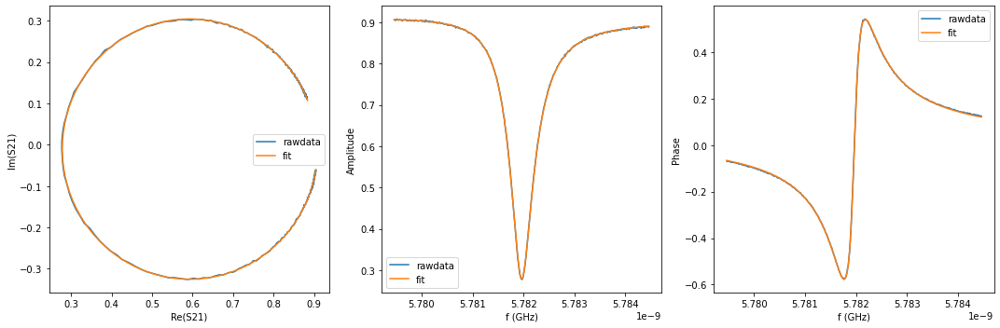

{'Qi_dia_corr': 25055.812148099383, 'Qi_no_corr': 25272.795554513064, 'absQc': 11087.655222907213, 'Qc_dia_corr(Re{Qc})': 11129.941294513776, 'Ql': 7706.616327250713, 'fr': 5.781940343472655, 'theta0': -3.0543962300982135, 'phi0': 0.08719765966306577, 'phi0_err': 0.001027654470260876, 'Ql_err': 8.860502888879113, 'absQc_err': 8.547265964728243, 'fr_err': 4.5972988399263193e-07, 'chi_square': 6.969462606834923e-06, 'Qi_no_corr_err': 70.25763505484984, 'Qi_dia_corr_err': 69.03215986175267, 'delay': 0.6111003797715159, 'a': 0.9076903748560826, 'alpha': -2.9033616626283343}


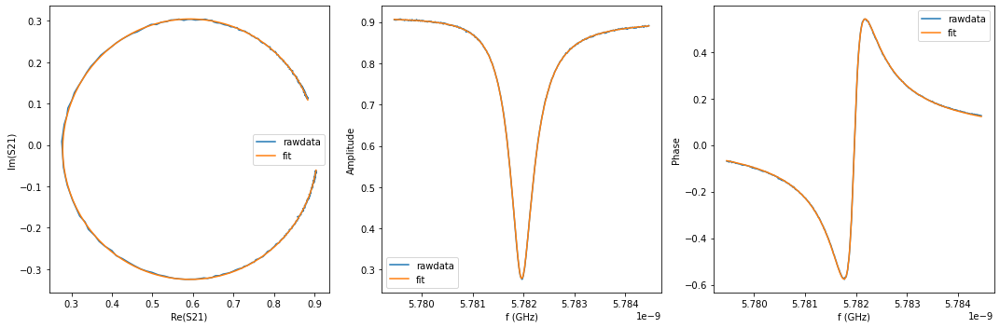

{'Qi_dia_corr': 25125.617615543895, 'Qi_no_corr': 25340.25113230972, 'absQc': 11129.188100757818, 'Qc_dia_corr(Re{Qc})': 11171.099221350989, 'Ql': 7732.951953815798, 'fr': 5.7819405976560265, 'theta0': -3.0549439478370064, 'phi0': 0.08664979774732719, 'phi0_err': 0.0007905777822966877, 'Ql_err': 7.661740669707257, 'absQc_err': 7.684473686940441, 'fr_err': 3.6542771268919553e-07, 'chi_square': 4.8491995502276e-06, 'Qi_no_corr_err': 57.87760576289504, 'Qi_dia_corr_err': 56.57474052301258, 'delay': 0.4792042463031461, 'a': 0.9073324360752049, 'alpha': -1.4114610702635215}


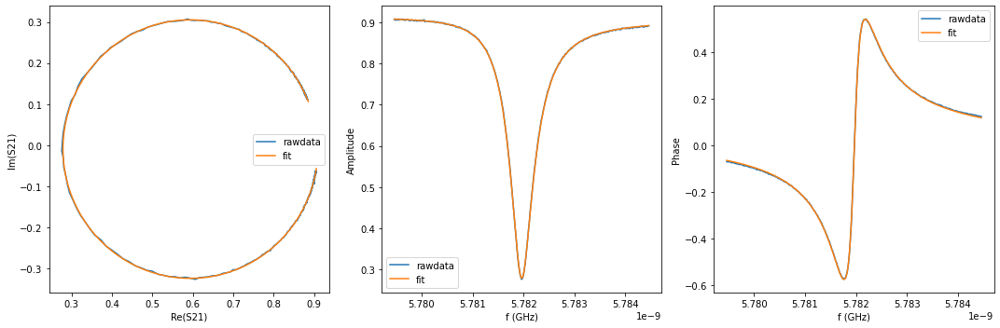

{'Qi_dia_corr': 24960.556788552403, 'Qi_no_corr': 25166.616431072576, 'absQc': 11043.225445656364, 'Qc_dia_corr(Re{Qc})': 11083.375100219819, 'Ql': 7675.278447744508, 'fr': 5.781941340577898, 'theta0': -3.056449288954347, 'phi0': 0.08514341766813752, 'phi0_err': 0.0015441985618411683, 'Ql_err': 11.650741980585074, 'absQc_err': 9.820073264698474, 'fr_err': 6.306597580151314e-07, 'chi_square': 1.0858275437526145e-05, 'Qi_no_corr_err': 98.95281467407786, 'Qi_dia_corr_err': 97.51887216043498, 'delay': 0.7498885149854108, 'a': 0.9084749917978675, 'alpha': 2.1393862200857203}


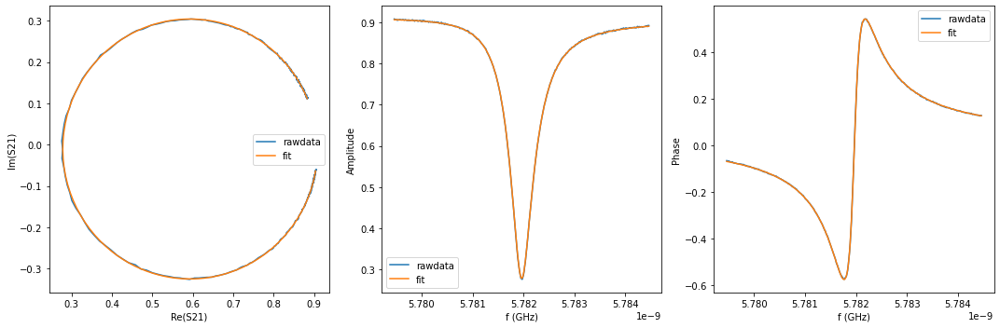

{'Qi_dia_corr': 25302.33014951698, 'Qi_no_corr': 25525.13428692104, 'absQc': 11217.810156648906, 'Qc_dia_corr(Re{Qc})': 11261.390918496087, 'Ql': 7792.95494658592, 'fr': 5.781940180327961, 'theta0': -3.0535878158770173, 'phi0': 0.08800483771277598, 'phi0_err': 0.0005911760812836959, 'Ql_err': 6.150321140409069, 'absQc_err': 6.699772828036792, 'fr_err': 3.0085079276854297e-07, 'chi_square': 3.2033319903090244e-06, 'Qi_no_corr_err': 47.62194778720866, 'Qi_dia_corr_err': 47.07301352420775, 'delay': 0.23570086062816598, 'a': 0.9069711042783785, 'alpha': 2.3087036093852085}


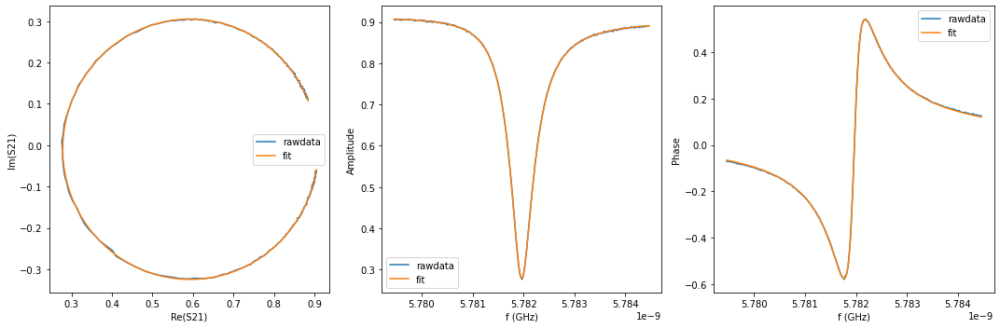

{'Qi_dia_corr': 25089.008770484168, 'Qi_no_corr': 25299.621881012168, 'absQc': 11092.873450347724, 'Qc_dia_corr(Re{Qc})': 11133.853968741012, 'Ql': 7711.631239143976, 'fr': 5.781940879904593, 'theta0': -3.055767716567169, 'phi0': 0.08582508866231346, 'phi0_err': 0.0011291125316228007, 'Ql_err': 9.499536716356566, 'absQc_err': 8.28990337947498, 'fr_err': 4.4474260134861797e-07, 'chi_square': 6.80058306611392e-06, 'Qi_no_corr_err': 75.76127869137126, 'Qi_dia_corr_err': 74.73865950598929, 'delay': 0.6125780095827686, 'a': 0.908205519643618, 'alpha': -2.849152301218843}


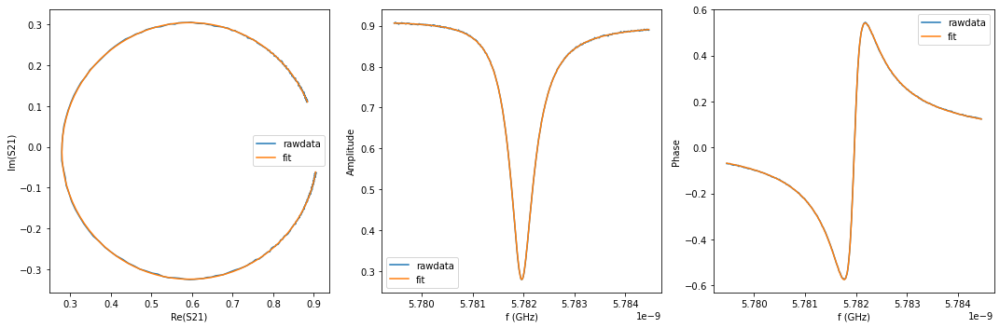

{'Qi_dia_corr': 25191.881466595147, 'Qi_no_corr': 25405.00377595412, 'absQc': 11175.75423960408, 'Qc_dia_corr(Re{Qc})': 11217.500925317738, 'Ql': 7761.459686962272, 'fr': 5.7819409894166744, 'theta0': -3.0552923706454553, 'phi0': 0.08630038278070315, 'phi0_err': 0.0005647230906414143, 'Ql_err': 6.083680241404692, 'absQc_err': 6.132959713463688, 'fr_err': 2.6836023823096536e-07, 'chi_square': 2.8294259109239543e-06, 'Qi_no_corr_err': 46.77153968073994, 'Qi_dia_corr_err': 46.22798932563774, 'delay': 0.387567546419955, 'a': 0.9076688076026911, 'alpha': 1.542688803909264}


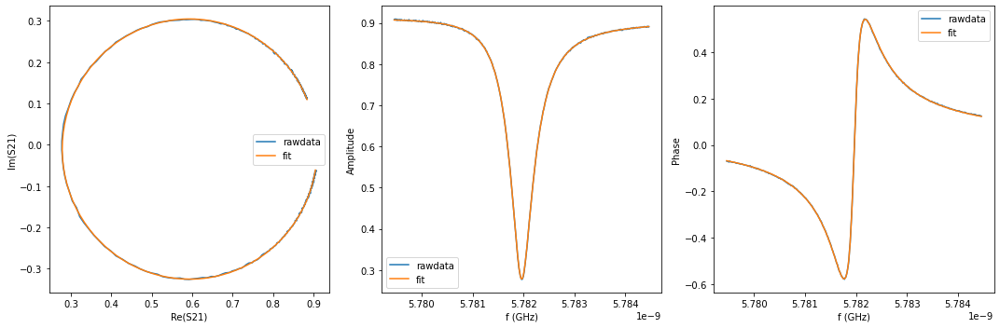

{'Qi_dia_corr': 25231.915870480047, 'Qi_no_corr': 25453.256704285373, 'absQc': 11158.811229657136, 'Qc_dia_corr(Re{Qc})': 11201.891383376698, 'Ql': 7757.772307633221, 'fr': 5.781940255462696, 'theta0': -3.0538645892776404, 'phi0': 0.08772981699949058, 'phi0_err': 0.0006219323078480176, 'Ql_err': 6.412870451662642, 'absQc_err': 6.635126383741867, 'fr_err': 3.026940418540264e-07, 'chi_square': 3.3277462400583245e-06, 'Qi_no_corr_err': 48.3935273016114, 'Qi_dia_corr_err': 47.99816989134864, 'delay': 0.421457639928836, 'a': 0.907878142374308, 'alpha': 2.774080812505832}


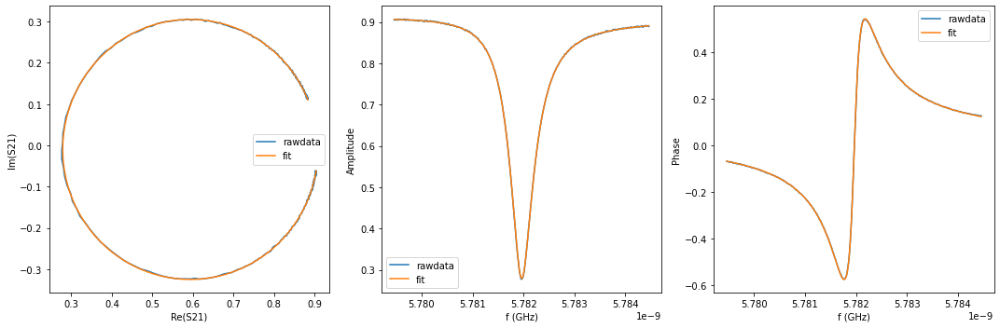

{'Qi_dia_corr': 25246.792100675688, 'Qi_no_corr': 25458.71776008146, 'absQc': 11187.88405488594, 'Qc_dia_corr(Re{Qc})': 11229.307071964076, 'Ql': 7772.321808280882, 'fr': 5.7819413312585155, 'theta0': -3.055672909189778, 'phi0': 0.08591974440001497, 'phi0_err': 0.0005401335841173606, 'Ql_err': 5.899595962637403, 'absQc_err': 6.253812752248101, 'fr_err': 2.694770527873689e-07, 'chi_square': 2.743939017807411e-06, 'Qi_no_corr_err': 43.415658274216604, 'Qi_dia_corr_err': 42.62389078924145, 'delay': 0.38108455607161246, 'a': 0.907535921754207, 'alpha': 1.307328297115007}


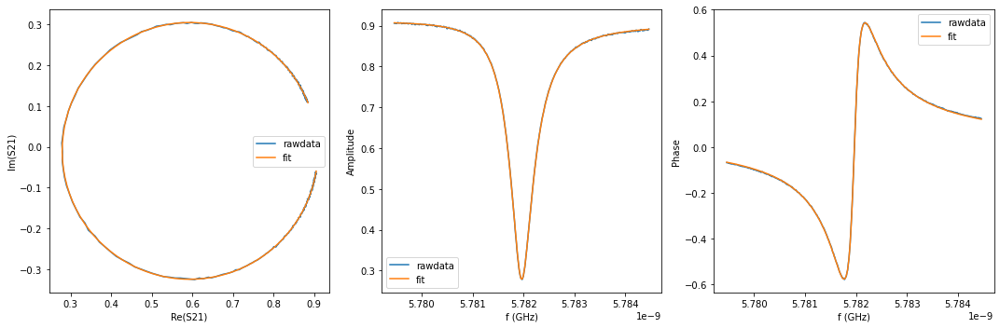

{'Qi_dia_corr': 25118.971172930273, 'Qi_no_corr': 25332.220443561408, 'absQc': 11115.683579290142, 'Qc_dia_corr(Re{Qc})': 11157.246460934906, 'Ql': 7725.682844064497, 'fr': 5.7819409244343145, 'theta0': -3.0552509662099263, 'phi0': 0.08634242084390456, 'phi0_err': 0.0009435602489729193, 'Ql_err': 8.293311876760601, 'absQc_err': 7.522822490098125, 'fr_err': 3.98709757653007e-07, 'chi_square': 5.4407508808828245e-06, 'Qi_no_corr_err': 67.05098274981437, 'Qi_dia_corr_err': 66.10962188149584, 'delay': 0.5588509272763179, 'a': 0.9084420200706985, 'alpha': 1.4824189326779151}


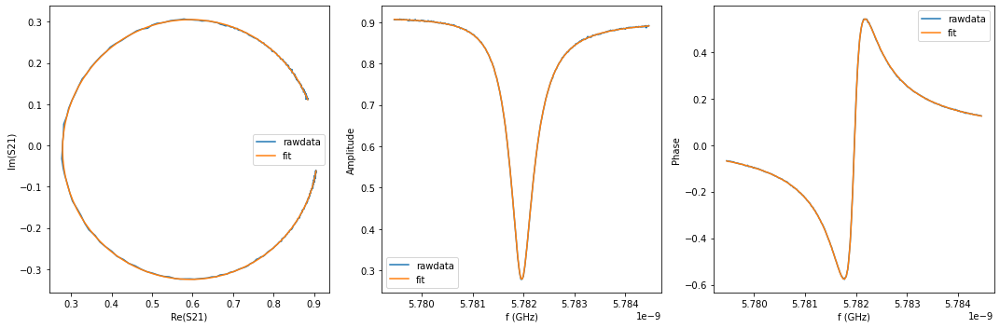

{'Qi_dia_corr': 25288.733722875837, 'Qi_no_corr': 25507.726619325324, 'absQc': 11207.843984735397, 'Qc_dia_corr(Re{Qc})': 11250.652580410038, 'Ql': 7786.522602022734, 'fr': 5.781940421299659, 'theta0': -3.054329795190907, 'phi0': 0.08726285839888637, 'phi0_err': 0.0005062200042429611, 'Ql_err': 5.471278522854842, 'absQc_err': 5.990175789867458, 'fr_err': 2.6115599002917097e-07, 'chi_square': 2.4616510115703026e-06, 'Qi_no_corr_err': 39.838912735331, 'Qi_dia_corr_err': 39.4470160772537, 'delay': 0.32532304184375327, 'a': 0.907844650789484, 'alpha': -0.7180221906338726}


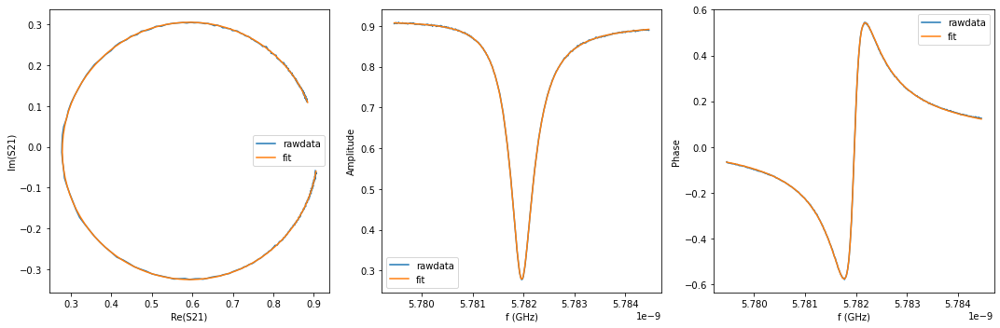

{'Qi_dia_corr': 25161.627854077724, 'Qi_no_corr': 25377.847715450207, 'absQc': 11127.597396236199, 'Qc_dia_corr(Re{Qc})': 11169.684045970562, 'Ql': 7735.680836010959, 'fr': 5.781941019357869, 'theta0': -3.054755977402804, 'phi0': 0.08683667618698888, 'phi0_err': 0.0007194613049106577, 'Ql_err': 6.961640515275274, 'absQc_err': 6.717412315171063, 'fr_err': 3.191702798256299e-07, 'chi_square': 3.839202885875395e-06, 'Qi_no_corr_err': 53.15510856397804, 'Qi_dia_corr_err': 52.48319240659114, 'delay': 0.5272387579954851, 'a': 0.9085777528634708, 'alpha': 0.3340191065317527}


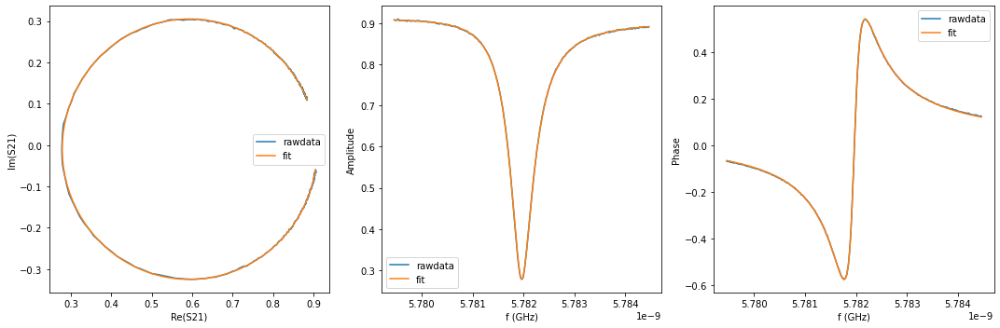

{'Qi_dia_corr': 25154.56594805811, 'Qi_no_corr': 25373.182649147846, 'absQc': 11124.55786443476, 'Qc_dia_corr(Re{Qc})': 11167.109385832277, 'Ql': 7733.77843705893, 'fr': 5.781940827807311, 'theta0': -3.054269500959697, 'phi0': 0.08732531473999601, 'phi0_err': 0.0008527381577654842, 'Ql_err': 7.6850565701163225, 'absQc_err': 7.416039196119348, 'fr_err': 3.805398567657517e-07, 'chi_square': 4.992550802045187e-06, 'Qi_no_corr_err': 60.33792322412359, 'Qi_dia_corr_err': 59.10845509210959, 'delay': 0.5680740547265134, 'a': 0.9085037394864252, 'alpha': 1.8178230753537885}


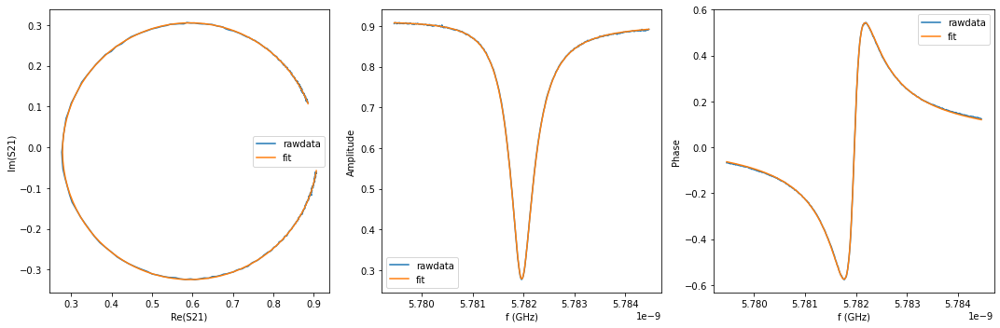

{'Qi_dia_corr': 25066.81911386731, 'Qi_no_corr': 25279.187054880862, 'absQc': 11089.71813066104, 'Qc_dia_corr(Re{Qc})': 11131.08805741912, 'Ql': 7708.207260589472, 'fr': 5.7819409300638, 'theta0': -3.055349790654542, 'phi0': 0.08624286293525135, 'phi0_err': 0.0014114616183248361, 'Ql_err': 10.509499532782469, 'absQc_err': 8.893898278236241, 'fr_err': 5.735984484515619e-07, 'chi_square': 8.891759660193335e-06, 'Qi_no_corr_err': 89.49169090882415, 'Qi_dia_corr_err': 88.37406584073581, 'delay': 0.7025459987596885, 'a': 0.9090452792137064, 'alpha': 0.4199571670329551}


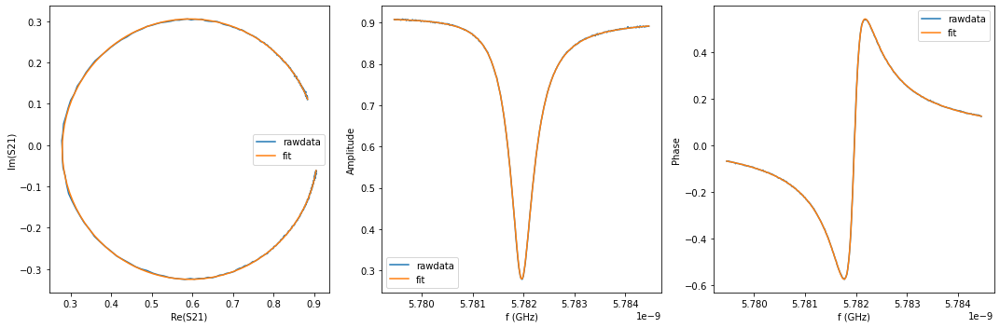

{'Qi_dia_corr': 25276.262869267663, 'Qi_no_corr': 25493.648683108826, 'absQc': 11205.799815216915, 'Qc_dia_corr(Re{Qc})': 11248.322134555068, 'Ql': 7784.223888689189, 'fr': 5.781940760399617, 'theta0': -3.0546132336737477, 'phi0': 0.08697941991604559, 'phi0_err': 0.0005058670095539967, 'Ql_err': 5.528459394518451, 'absQc_err': 5.800427894713272, 'fr_err': 2.47539937143585e-07, 'chi_square': 2.38391044575983e-06, 'Qi_no_corr_err': 40.91469138378167, 'Qi_dia_corr_err': 40.31852736650172, 'delay': 0.3414265525923075, 'a': 0.9083689073126014, 'alpha': -0.13287985688878381}


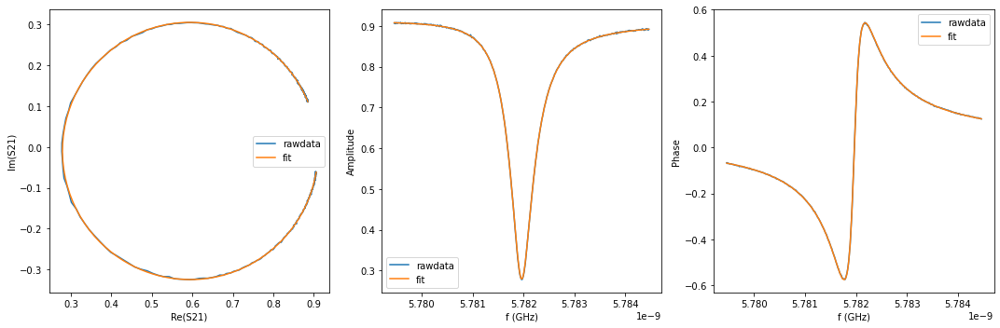

{'Qi_dia_corr': 25245.192325182117, 'Qi_no_corr': 25460.61823436076, 'absQc': 11195.245462098668, 'Qc_dia_corr(Re{Qc})': 11237.41027360124, 'Ql': 7776.051141798237, 'fr': 5.781940565458161, 'theta0': -3.0549379669459684, 'phi0': 0.08665484512225793, 'phi0_err': 0.0005161112349460229, 'Ql_err': 5.608108361131607, 'absQc_err': 5.992968256195532, 'fr_err': 2.588722492129616e-07, 'chi_square': 2.5288673090601007e-06, 'Qi_no_corr_err': 41.53700451660979, 'Qi_dia_corr_err': 40.942430722271986, 'delay': 0.3430231074553062, 'a': 0.908775552972728, 'alpha': -0.0747675328399759}


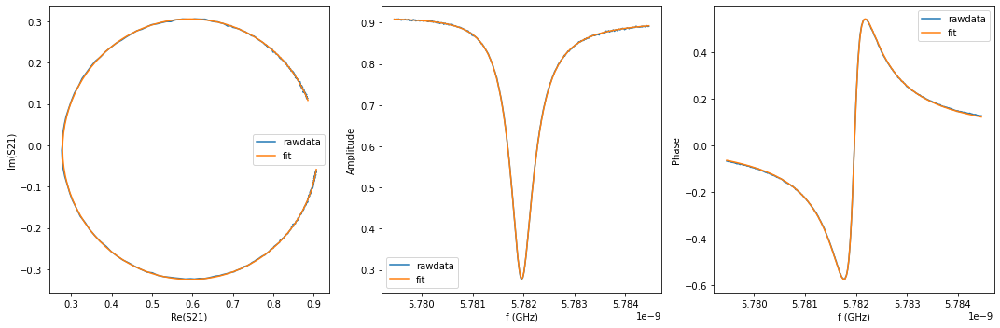

{'Qi_dia_corr': 25106.035099604433, 'Qi_no_corr': 25321.448279347656, 'absQc': 11090.0456474163, 'Qc_dia_corr(Re{Qc})': 11131.877524349307, 'Ql': 7712.29046084937, 'fr': 5.78194059752978, 'theta0': -3.0548723961540545, 'phi0': 0.08672025743573872, 'phi0_err': 0.0010992292290698275, 'Ql_err': 9.019575875410045, 'absQc_err': 7.90659093002424, 'fr_err': 4.6131890462396777e-07, 'chi_square': 6.48666229080905e-06, 'Qi_no_corr_err': 75.55511474655412, 'Qi_dia_corr_err': 73.98537723460115, 'delay': 0.6071504046532452, 'a': 0.9095142444553845, 'alpha': -3.045196918586505}


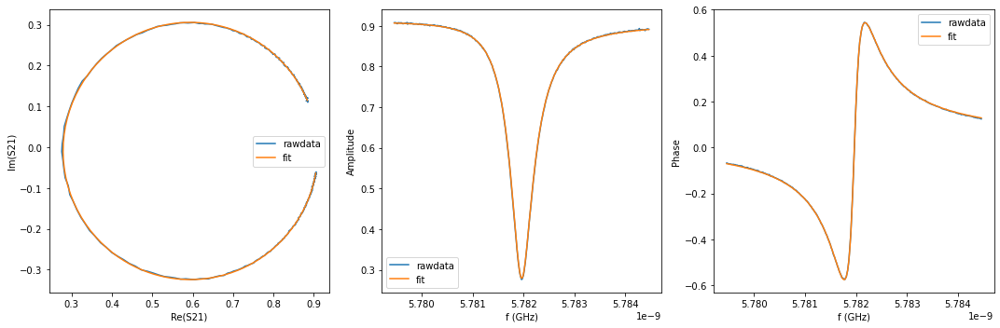

{'Qi_dia_corr': 25454.46749923929, 'Qi_no_corr': 25674.47884182596, 'absQc': 11286.574085793305, 'Qc_dia_corr(Re{Qc})': 11329.622483758065, 'Ql': 7840.0609455004105, 'fr': 5.781940602303812, 'theta0': -3.0543913352860637, 'phi0': 0.08720138534561074, 'phi0_err': 0.0007956197969331904, 'Ql_err': 7.536532512357618, 'absQc_err': 7.74312428207576, 'fr_err': 3.888497656189208e-07, 'chi_square': 4.8563992817192276e-06, 'Qi_no_corr_err': 64.03768321561684, 'Qi_dia_corr_err': 63.01934705514931, 'delay': 0.09440430727562257, 'a': 0.9078943046196213, 'alpha': -2.8229187205271877}


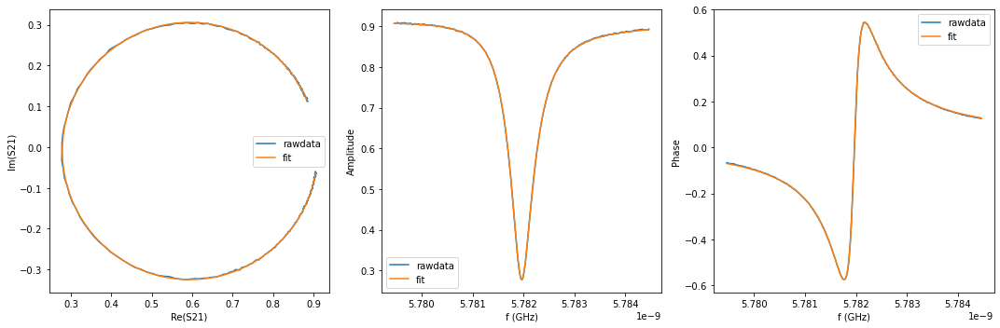

{'Qi_dia_corr': 25430.97444727086, 'Qi_no_corr': 25651.015959364267, 'absQc': 11257.364103734562, 'Qc_dia_corr(Re{Qc})': 11300.27452275118, 'Ql': 7823.774053252911, 'fr': 5.781940770108906, 'theta0': -3.054418607669145, 'phi0': 0.08717448748349105, 'phi0_err': 0.0007761247603828153, 'Ql_err': 7.065768841216841, 'absQc_err': 7.269756861555631, 'fr_err': 3.756270920010728e-07, 'chi_square': 4.441492288891023e-06, 'Qi_no_corr_err': 59.262408043295366, 'Qi_dia_corr_err': 58.434162050821755, 'delay': 0.14130379474191793, 'a': 0.9080503247732624, 'alpha': -1.119104334571032}


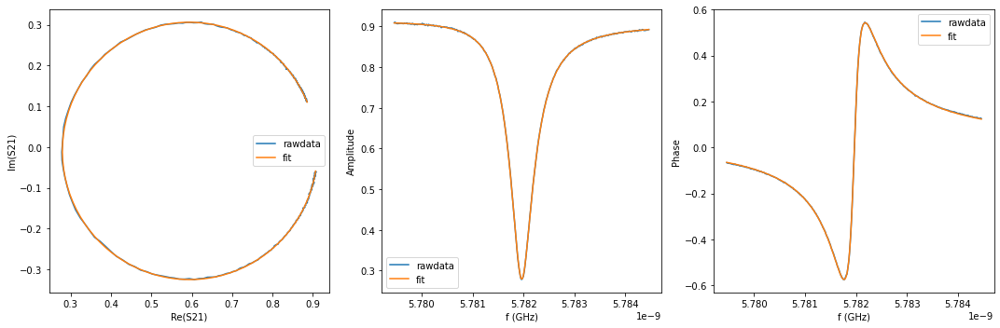

{'Qi_dia_corr': 25101.327205873476, 'Qi_no_corr': 25319.271325278525, 'absQc': 11116.942545418544, 'Qc_dia_corr(Re{Qc})': 11159.485416701134, 'Ql': 7725.08597116761, 'fr': 5.781940731879379, 'theta0': -3.054246353642385, 'phi0': 0.08734627307529652, 'phi0_err': 0.0007230427869722906, 'Ql_err': 6.695233136604794, 'absQc_err': 6.459869013184563, 'fr_err': 3.1800386292612226e-07, 'chi_square': 3.6976636095455585e-06, 'Qi_no_corr_err': 51.44593880671593, 'Qi_dia_corr_err': 50.64133729033671, 'delay': 0.5291472857509761, 'a': 0.909618787350676, 'alpha': 0.4048248072923247}


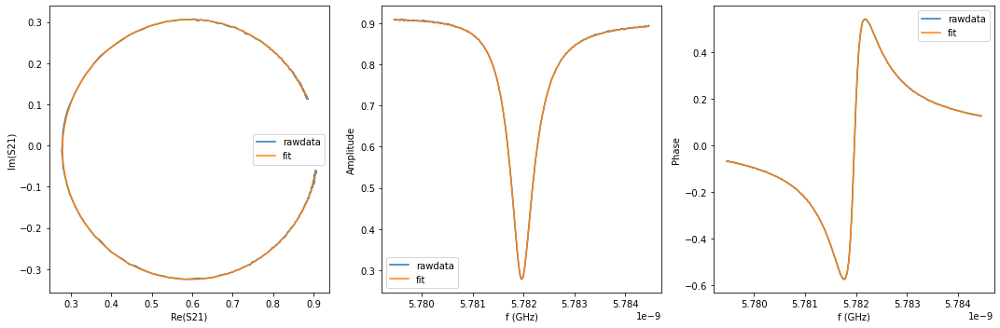

{'Qi_dia_corr': 25319.396745906328, 'Qi_no_corr': 25540.3580058948, 'absQc': 11206.6842235208, 'Qc_dia_corr(Re{Qc})': 11249.76229811459, 'Ql': 7789.000413715375, 'fr': 5.781940690406699, 'theta0': -3.054052934713094, 'phi0': 0.08754072701803194, 'phi0_err': 0.0004966622931585185, 'Ql_err': 5.0873370021384146, 'absQc_err': 5.291723153262374, 'fr_err': 2.4314323980202817e-07, 'chi_square': 2.137370292634723e-06, 'Qi_no_corr_err': 39.75361899255941, 'Qi_dia_corr_err': 39.2493815412524, 'delay': 0.28630410551132096, 'a': 0.9089852088106822, 'alpha': -2.1342802785487716}


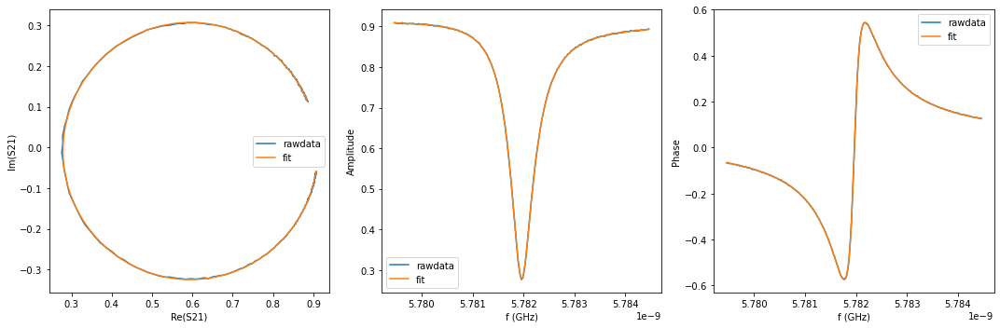

{'Qi_dia_corr': 25250.710856221252, 'Qi_no_corr': 25466.643337606252, 'absQc': 11172.762928018483, 'Qc_dia_corr(Re{Qc})': 11214.838134313788, 'Ql': 7765.758170880243, 'fr': 5.781941095297155, 'theta0': -3.0549451678205846, 'phi0': 0.08664978583112734, 'phi0_err': 0.0005152891210188817, 'Ql_err': 5.431399343892648, 'absQc_err': 5.4228531863492035, 'fr_err': 2.3828768108309465e-07, 'chi_square': 2.2497978622903965e-06, 'Qi_no_corr_err': 40.702398289030846, 'Qi_dia_corr_err': 40.052135134047624, 'delay': 0.4325038976322934, 'a': 0.9095837315154888, 'alpha': -3.105816048644234}


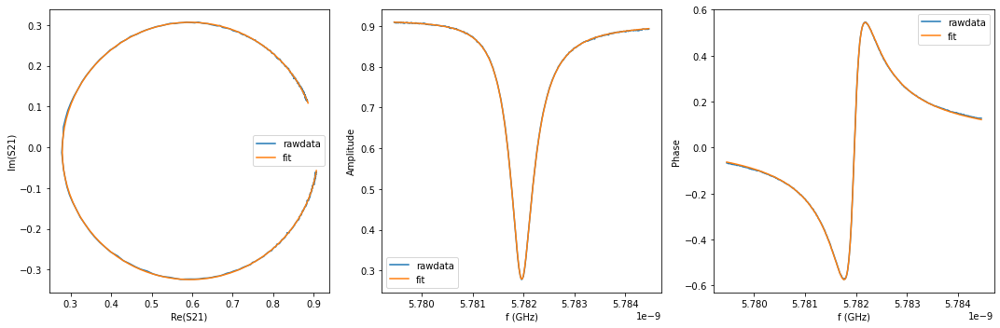

{'Qi_dia_corr': 25124.64290451349, 'Qi_no_corr': 25334.75195909625, 'absQc': 11100.38687740035, 'Qc_dia_corr(Re{Qc})': 11141.20928944661, 'Ql': 7718.525499544546, 'fr': 5.781941443133845, 'theta0': -3.055962164949422, 'phi0': 0.08563096921219948, 'phi0_err': 0.0010908516235048709, 'Ql_err': 9.30230755651937, 'absQc_err': 8.031003891354326, 'fr_err': 4.385243183556514e-07, 'chi_square': 6.445224305952916e-06, 'Qi_no_corr_err': 75.86515601125413, 'Qi_dia_corr_err': 74.8746264318709, 'delay': 0.65980590481908, 'a': 0.9102161520288201, 'alpha': -1.131759464023614}


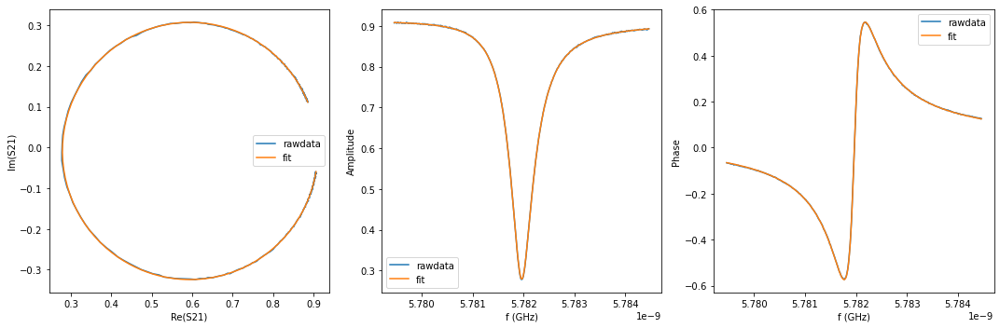

{'Qi_dia_corr': 25303.84036654678, 'Qi_no_corr': 25512.214189590773, 'absQc': 11177.274658184775, 'Qc_dia_corr(Re{Qc})': 11217.746232873187, 'Ql': 7772.172196745766, 'fr': 5.781941634832997, 'theta0': -3.0566254980005088, 'phi0': 0.08497044665407313, 'phi0_err': 0.0005421501893457564, 'Ql_err': 5.30946532886061, 'absQc_err': 5.316839794708247, 'fr_err': 2.520722985483579e-07, 'chi_square': 2.325163714246481e-06, 'Qi_no_corr_err': 40.816028950875015, 'Qi_dia_corr_err': 40.133546151489305, 'delay': 0.4309696814952608, 'a': 0.9097335823623356, 'alpha': 3.1216073074916824}


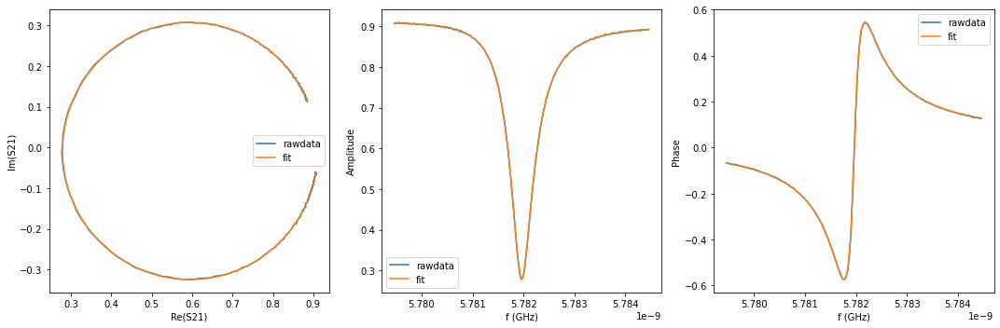

{'Qi_dia_corr': 25423.351512816113, 'Qi_no_corr': 25638.49864067272, 'absQc': 11260.38262246517, 'Qc_dia_corr(Re{Qc})': 11302.390779380368, 'Ql': 7824.066602472839, 'fr': 5.781941119024027, 'theta0': -3.055348183612232, 'phi0': 0.08624446997756116, 'phi0_err': 0.0007083447244182376, 'Ql_err': 6.4815204598262826, 'absQc_err': 6.20083612932036, 'fr_err': 3.3131070520446145e-07, 'chi_square': 3.410400164194894e-06, 'Qi_no_corr_err': 57.47459190389202, 'Qi_dia_corr_err': 56.54473569828593, 'delay': 0.19069720537263907, 'a': 0.9090690340477393, 'alpha': 0.6759564660717774}


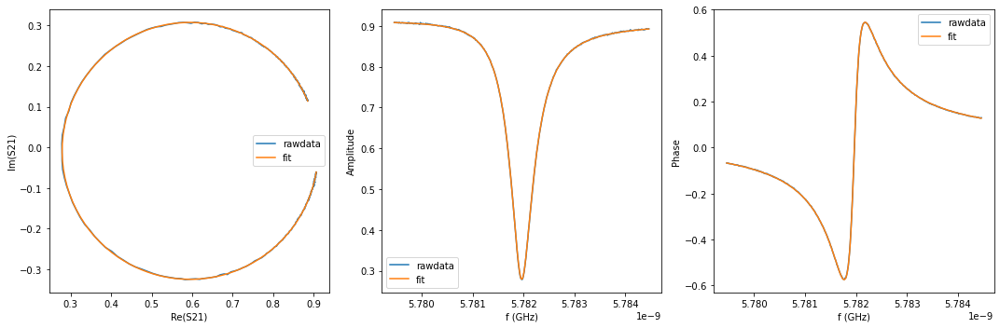

{'Qi_dia_corr': 25393.899424510484, 'Qi_no_corr': 25612.593444312166, 'absQc': 11227.908867199198, 'Qc_dia_corr(Re{Qc})': 11270.458362608964, 'Ql': 7805.970250180418, 'fr': 5.781940995915063, 'theta0': -3.0546723124599913, 'phi0': 0.08692168632086486, 'phi0_err': 0.0005113929684230046, 'Ql_err': 5.236809132172162, 'absQc_err': 5.020598769040938, 'fr_err': 2.3573375533485322e-07, 'chi_square': 2.074964158430559e-06, 'Qi_no_corr_err': 43.05800573807311, 'Qi_dia_corr_err': 42.41728816834232, 'delay': 0.268021066071891, 'a': 0.9095127288963343, 'alpha': -2.797652765759011}


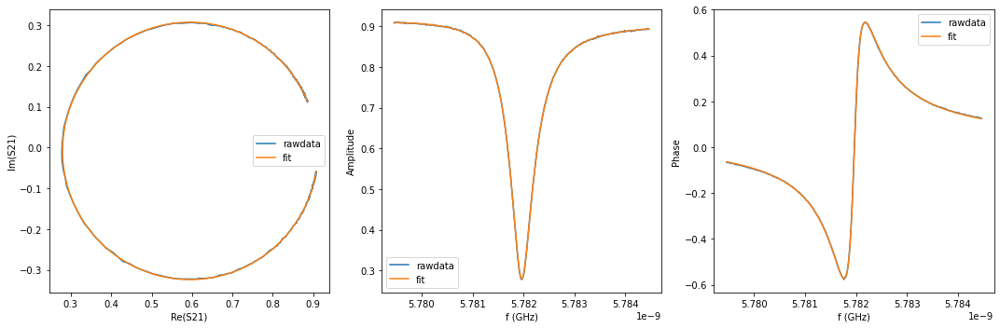

{'Qi_dia_corr': 25159.961352773797, 'Qi_no_corr': 25369.180497834117, 'absQc': 11144.004923038321, 'Qc_dia_corr(Re{Qc})': 11184.861022529409, 'Ql': 7742.799460046564, 'fr': 5.781941488493784, 'theta0': -3.056093659204368, 'phi0': 0.08549888300703519, 'phi0_err': 0.0006425147819478139, 'Ql_err': 6.451239638649754, 'absQc_err': 6.355428680304059, 'fr_err': 2.879333238995743e-07, 'chi_square': 3.2453865297871317e-06, 'Qi_no_corr_err': 48.14063625439137, 'Qi_dia_corr_err': 47.40546593576758, 'delay': 0.5135034872218823, 'a': 0.910424702779054, 'alpha': -0.16244355682553926}


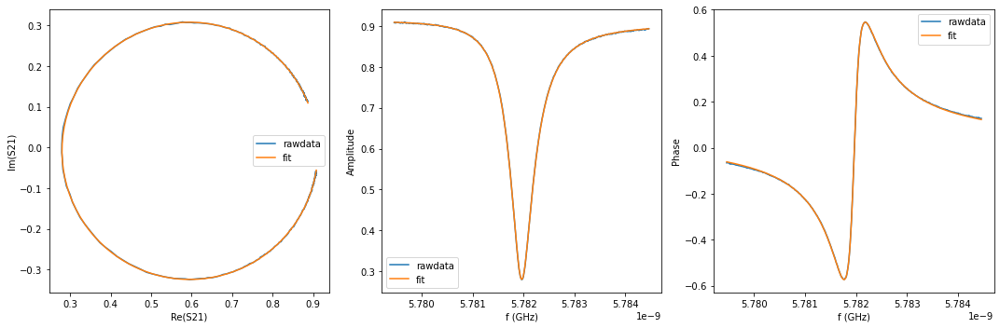

{'Qi_dia_corr': 25077.236524185657, 'Qi_no_corr': 25286.480713958972, 'absQc': 11076.833100965481, 'Qc_dia_corr(Re{Qc})': 11117.468719020699, 'Ql': 7702.656804186753, 'fr': 5.781941551153198, 'theta0': -3.056066722949383, 'phi0': 0.08552593806183684, 'phi0_err': 0.0012579919924899843, 'Ql_err': 9.553825087403457, 'absQc_err': 7.603879352174686, 'fr_err': 5.00069212835715e-07, 'chi_square': 6.613999314817313e-06, 'Qi_no_corr_err': 83.23515475792763, 'Qi_dia_corr_err': 82.00609571158097, 'delay': 0.6960252946670503, 'a': 0.9110941985583715, 'alpha': 0.18532062160410087}


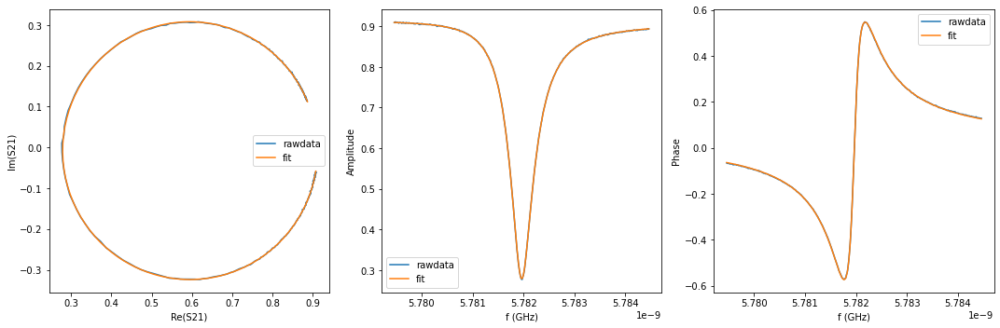

{'Qi_dia_corr': 25224.99475452469, 'Qi_no_corr': 25434.68220632381, 'absQc': 11151.207807859048, 'Qc_dia_corr(Re{Qc})': 11191.996946463636, 'Ql': 7752.371930807774, 'fr': 5.781941201883739, 'theta0': -3.0561950044870407, 'phi0': 0.08540149238826827, 'phi0_err': 0.000605065672007611, 'Ql_err': 5.6911212493306085, 'absQc_err': 6.025391966757498, 'fr_err': 2.9702252963129573e-07, 'chi_square': 2.9431261119472164e-06, 'Qi_no_corr_err': 42.76512675742545, 'Qi_dia_corr_err': 41.89160802175664, 'delay': 0.4630986524759204, 'a': 0.9105138212070847, 'alpha': -1.9935794080020117}


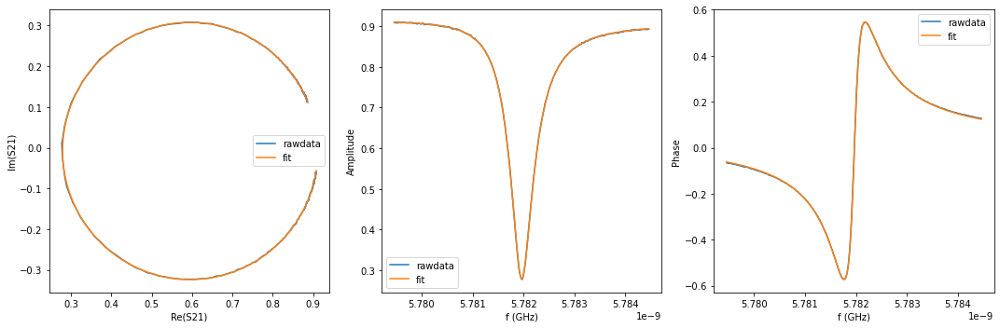

{'Qi_dia_corr': 25201.30813982401, 'Qi_no_corr': 25412.761942491517, 'absQc': 11125.872805484796, 'Qc_dia_corr(Re{Qc})': 11166.893879469946, 'Ql': 7738.087614887822, 'fr': 5.781941415627446, 'theta0': -3.055854026069478, 'phi0': 0.08574036993638784, 'phi0_err': 0.0009005776773341331, 'Ql_err': 7.576423487166517, 'absQc_err': 6.903655652481311, 'fr_err': 3.805812725514844e-07, 'chi_square': 4.732760860152657e-06, 'Qi_no_corr_err': 61.75367131938586, 'Qi_dia_corr_err': 60.497342448175935, 'delay': 0.610578451248184, 'a': 0.9109752183832033, 'alpha': -2.91857291808559}


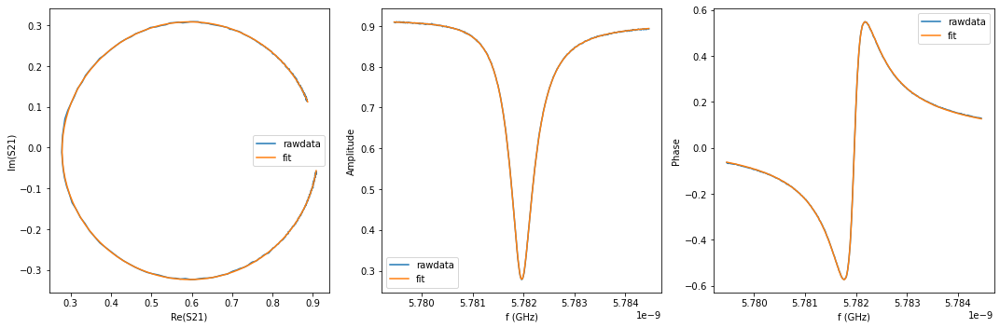

{'Qi_dia_corr': 25252.84548622132, 'Qi_no_corr': 25465.662377096724, 'absQc': 11138.453555828508, 'Qc_dia_corr(Re{Qc})': 11179.662776149567, 'Ql': 7749.076584050514, 'fr': 5.781941350912238, 'theta0': -3.0557051612333397, 'phi0': 0.08588777242654097, 'phi0_err': 0.0007032568299410001, 'Ql_err': 6.539949018183562, 'absQc_err': 6.109347557919845, 'fr_err': 2.965323656617262e-07, 'chi_square': 3.296440260620945e-06, 'Qi_no_corr_err': 50.66835528483146, 'Qi_dia_corr_err': 50.13704799196689, 'delay': 0.5193548647359265, 'a': 0.9108998610566824, 'alpha': 0.05126811445000706}


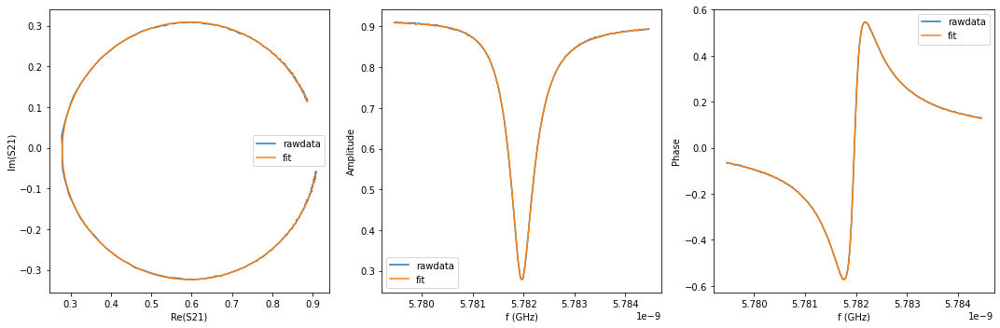

{'Qi_dia_corr': 25323.272654743912, 'Qi_no_corr': 25534.7264669121, 'absQc': 11187.190832792303, 'Qc_dia_corr(Re{Qc})': 11228.267791978154, 'Ql': 7779.056183724849, 'fr': 5.781941601474877, 'theta0': -3.0560301875700087, 'phi0': 0.08556383650301744, 'phi0_err': 0.00045880714241675253, 'Ql_err': 4.930807006091361, 'absQc_err': 5.023431314362904, 'fr_err': 2.1928559710036606e-07, 'chi_square': 1.8804100367402263e-06, 'Qi_no_corr_err': 37.36256536990965, 'Qi_dia_corr_err': 36.802433102258206, 'delay': 0.3409237735258408, 'a': 0.9104469153702867, 'alpha': -0.14807887745397152}


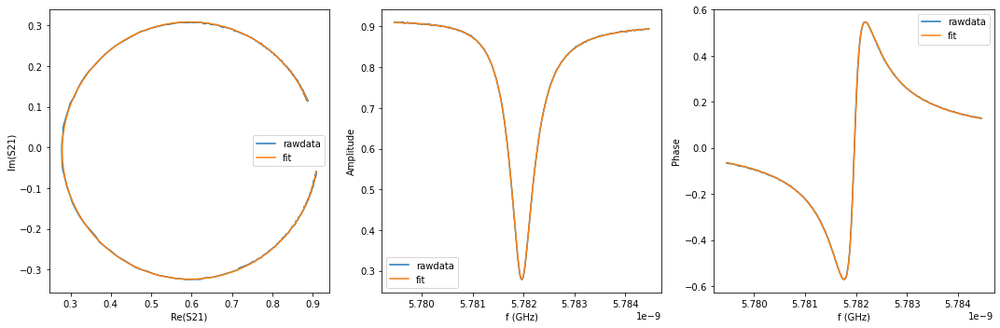

{'Qi_dia_corr': 25270.420493607497, 'Qi_no_corr': 25481.095620345946, 'absQc': 11173.590431132166, 'Qc_dia_corr(Re{Qc})': 11214.588063010406, 'Ql': 7767.501426649922, 'fr': 5.781941882231109, 'theta0': -3.056060462756501, 'phi0': 0.08553327778182286, 'phi0_err': 0.000517897777550057, 'Ql_err': 5.084573031729781, 'absQc_err': 5.492337888316534, 'fr_err': 2.627893609912735e-07, 'chi_square': 2.3293034189661315e-06, 'Qi_no_corr_err': 38.59323182491101, 'Qi_dia_corr_err': 37.933364382711765, 'delay': 0.4030705947688564, 'a': 0.9108974124910538, 'alpha': 2.109972269419171}


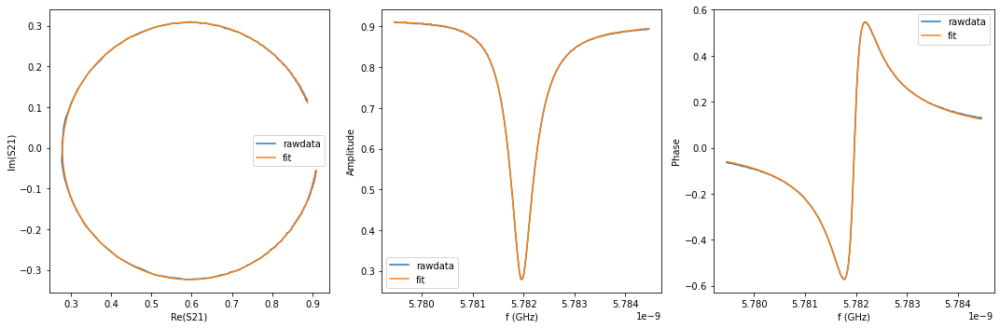

{'Qi_dia_corr': 25125.588347756922, 'Qi_no_corr': 25339.376997709696, 'absQc': 11096.348504216341, 'Qc_dia_corr(Re{Qc})': 11137.849057605958, 'Ql': 7717.001766067391, 'fr': 5.78194138903532, 'theta0': -3.0552398938997833, 'phi0': 0.08635275969000997, 'phi0_err': 0.0010972983204016625, 'Ql_err': 8.659513615394378, 'absQc_err': 7.673314769570823, 'fr_err': 4.503580535827962e-07, 'chi_square': 6.209457406671089e-06, 'Qi_no_corr_err': 71.0973611538047, 'Qi_dia_corr_err': 70.05031565932703, 'delay': 0.6794731158805402, 'a': 0.9115977401040452, 'alpha': -0.4145886097968767}


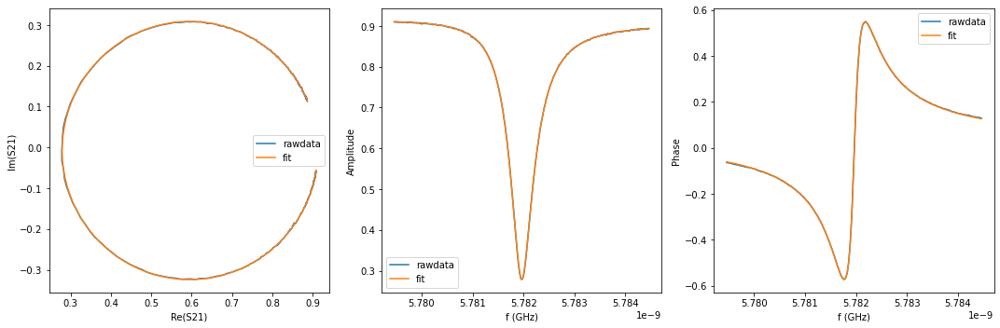

{'Qi_dia_corr': 25235.057053024135, 'Qi_no_corr': 25451.74885801499, 'absQc': 11132.611627033612, 'Qc_dia_corr(Re{Qc})': 11174.582590149714, 'Ql': 7744.960729349776, 'fr': 5.781941544366493, 'theta0': -3.054896230698218, 'phi0': 0.08669815110371311, 'phi0_err': 0.0007385893565894902, 'Ql_err': 6.455784142850464, 'absQc_err': 6.153815740159489, 'fr_err': 3.124348811696633e-07, 'chi_square': 3.486224504929499e-06, 'Qi_no_corr_err': 49.6206950069607, 'Qi_dia_corr_err': 49.09913897865912, 'delay': 0.5571236726069266, 'a': 0.9113760900022407, 'alpha': 1.4239053712270304}


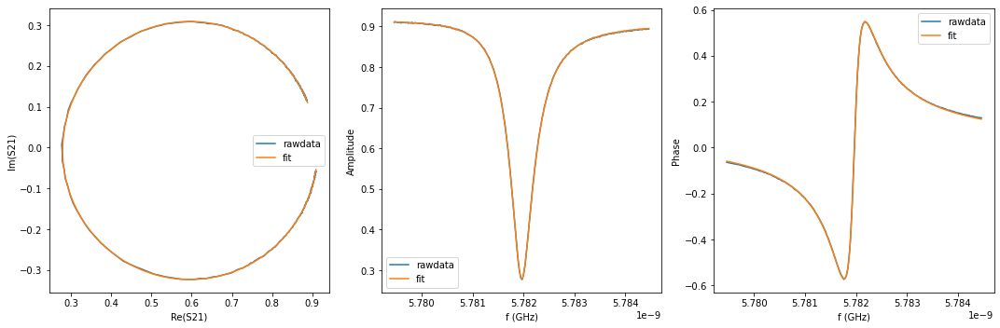

{'Qi_dia_corr': 25138.709469107525, 'Qi_no_corr': 25349.616920159668, 'absQc': 11087.78197605102, 'Qc_dia_corr(Re{Qc})': 11128.619888139432, 'Ql': 7713.805982357712, 'fr': 5.781941742901045, 'theta0': -3.0558969618649177, 'phi0': 0.08569569516641173, 'phi0_err': 0.0014607293978371803, 'Ql_err': 10.255671797014658, 'absQc_err': 8.245447284235038, 'fr_err': 5.722209933618694e-07, 'chi_square': 7.954275167659536e-06, 'Qi_no_corr_err': 89.16400042728685, 'Qi_dia_corr_err': 87.24958497277655, 'delay': 0.7195830413965708, 'a': 0.9119571846508174, 'alpha': 1.0425110102249504}


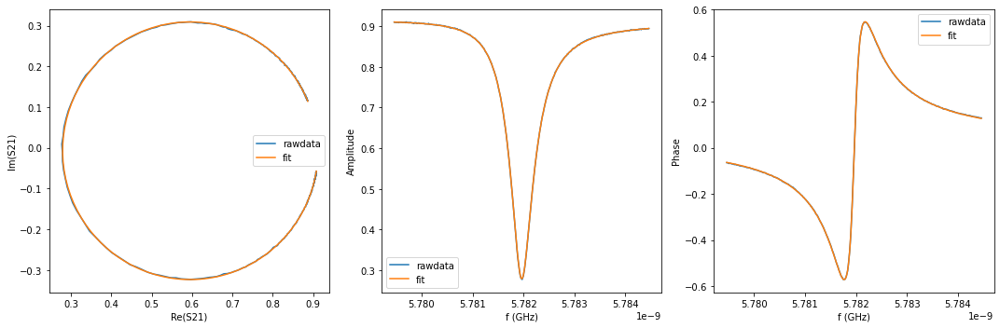

{'Qi_dia_corr': 25314.084716473826, 'Qi_no_corr': 25527.54872211115, 'absQc': 11185.858437144087, 'Qc_dia_corr(Re{Qc})': 11227.34425630019, 'Ql': 7777.745743242706, 'fr': 5.781941568461005, 'theta0': -3.0556016776827697, 'phi0': 0.08599241243001586, 'phi0_err': 0.00047339198958387105, 'Ql_err': 5.015952327238619, 'absQc_err': 5.413932426760168, 'fr_err': 2.4103503827549153e-07, 'chi_square': 2.0716273966232393e-06, 'Qi_no_corr_err': 35.76337020549438, 'Qi_dia_corr_err': 35.12617703672307, 'delay': 0.40925426494114525, 'a': 0.9112854097071674, 'alpha': 2.3353912164988486}


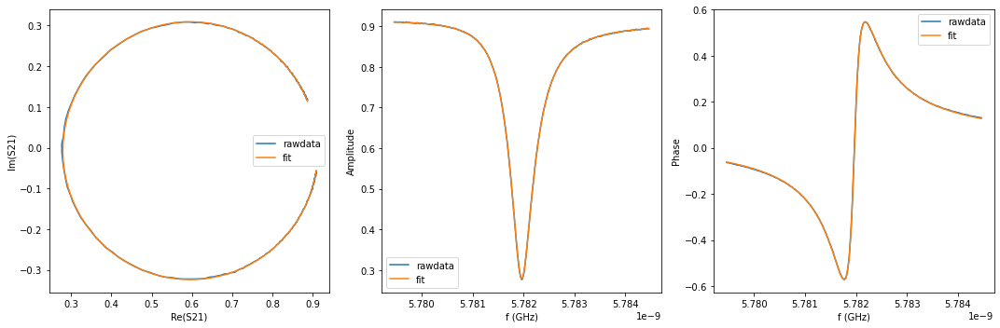

{'Qi_dia_corr': 25210.147967042547, 'Qi_no_corr': 25428.4096672404, 'absQc': 11136.5797318401, 'Qc_dia_corr(Re{Qc})': 11178.967099647754, 'Ql': 7744.717456973681, 'fr': 5.7819413160120945, 'theta0': -3.054482314367346, 'phi0': 0.08711033922244714, 'phi0_err': 0.0007323931265599074, 'Ql_err': 6.654417873505908, 'absQc_err': 6.30149759745613, 'fr_err': 3.1807330384727134e-07, 'chi_square': 3.6015999514337117e-06, 'Qi_no_corr_err': 52.07571088094932, 'Qi_dia_corr_err': 51.02629796810927, 'delay': 0.5115276695563925, 'a': 0.9117147101976095, 'alpha': -0.23174602907974332}


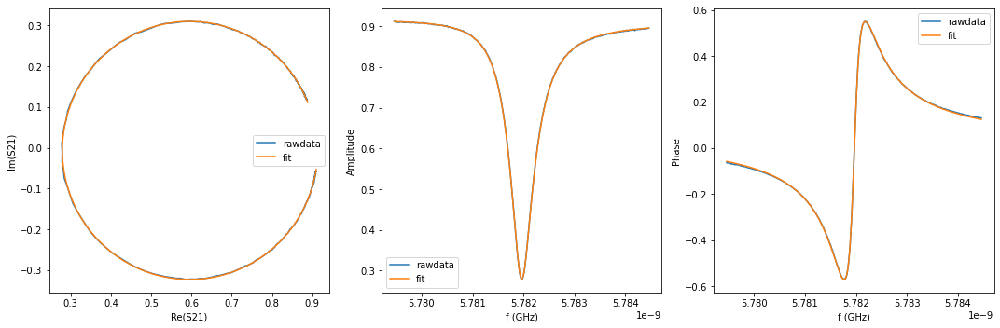

{'Qi_dia_corr': 25097.33244620645, 'Qi_no_corr': 25305.258124589775, 'absQc': 11058.098379173032, 'Qc_dia_corr(Re{Qc})': 11098.278000604103, 'Ql': 7695.330155320655, 'fr': 5.781942162856689, 'theta0': -3.0564750392713793, 'phi0': 0.08511796466831621, 'phi0_err': 0.0016118469356115191, 'Ql_err': 11.529703218244443, 'absQc_err': 8.968430525700205, 'fr_err': 6.273054036694464e-07, 'chi_square': 9.523111649783277e-06, 'Qi_no_corr_err': 101.46919094468042, 'Qi_dia_corr_err': 99.23739256169144, 'delay': 0.7562523292348107, 'a': 0.9123863600131654, 'alpha': 2.3753737411786213}


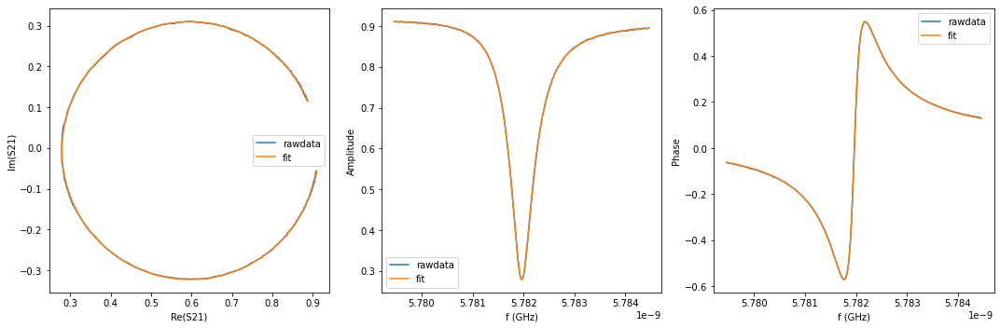

{'Qi_dia_corr': 25231.737999993788, 'Qi_no_corr': 25443.330294006973, 'absQc': 11149.555340889021, 'Qc_dia_corr(Re{Qc})': 11190.679091263204, 'Ql': 7752.37629521685, 'fr': 5.78194170911481, 'theta0': -3.055836734976243, 'phi0': 0.08575633653971301, 'phi0_err': 0.0005262406610518585, 'Ql_err': 5.154406091164553, 'absQc_err': 5.354785462880829, 'fr_err': 2.5368461270226843e-07, 'chi_square': 2.289496767470715e-06, 'Qi_no_corr_err': 38.117547981202286, 'Qi_dia_corr_err': 37.479331641293655, 'delay': 0.4608286242804592, 'a': 0.9116028551289816, 'alpha': -2.0735341123125632}


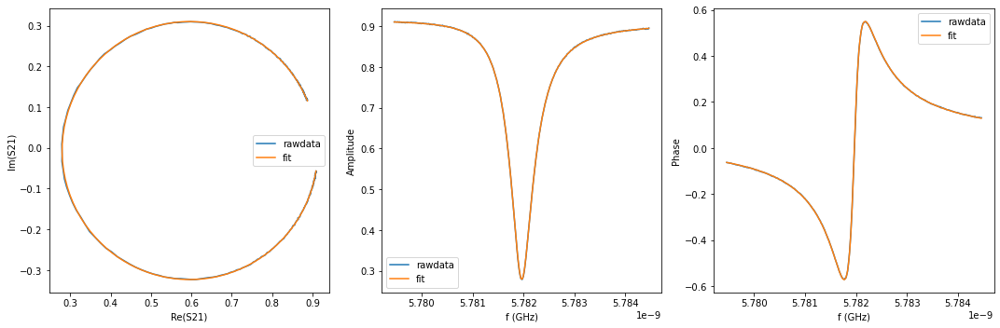

{'Qi_dia_corr': 25347.026878009212, 'Qi_no_corr': 25559.008931481607, 'absQc': 11192.98321466388, 'Qc_dia_corr(Re{Qc})': 11234.127855396933, 'Ql': 7784.110227709704, 'fr': 5.7819417486171, 'theta0': -3.0559840431336385, 'phi0': 0.08561199002252179, 'phi0_err': 0.00041240720050521106, 'Ql_err': 4.088603837807172, 'absQc_err': 4.543584578857637, 'fr_err': 2.1700769436591943e-07, 'chi_square': 1.5288793959101195e-06, 'Qi_no_corr_err': 30.372536212796142, 'Qi_dia_corr_err': 29.83286948841596, 'delay': 0.3817570405757987, 'a': 0.9116651575205281, 'alpha': 1.3372617513649636}


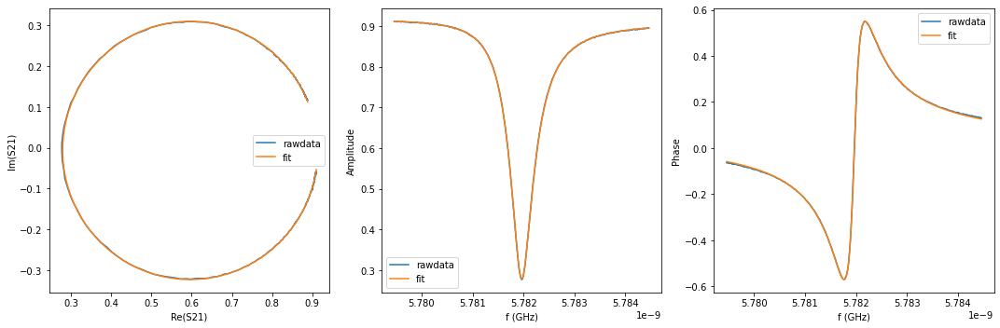

{'Qi_dia_corr': 25129.307764244742, 'Qi_no_corr': 25340.912884093595, 'absQc': 11093.490508519331, 'Qc_dia_corr(Re{Qc})': 11134.535835872526, 'Ql': 7715.761763067718, 'fr': 5.781941544561863, 'theta0': -3.0557033319103812, 'phi0': 0.08589033629520763, 'phi0_err': 0.0012954179891422155, 'Ql_err': 9.492983845021502, 'absQc_err': 8.2661473014501, 'fr_err': 4.982335186553348e-07, 'chi_square': 7.391120888738816e-06, 'Qi_no_corr_err': 77.81083094651694, 'Qi_dia_corr_err': 75.81068582947016, 'delay': 0.6683174589763544, 'a': 0.9126226761087072, 'alpha': -0.8181973132218682}


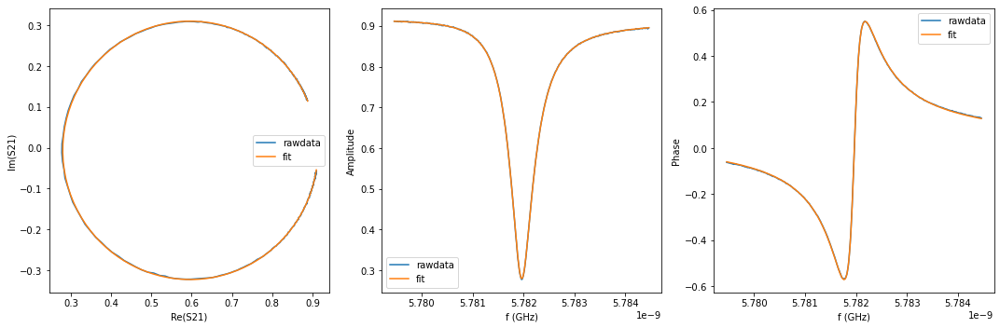

{'Qi_dia_corr': 25216.05009990588, 'Qi_no_corr': 25431.240133238178, 'absQc': 11125.019486978117, 'Qc_dia_corr(Re{Qc})': 11166.706756225505, 'Ql': 7739.387043411656, 'fr': 5.781941396199132, 'theta0': -3.0551575688046224, 'phi0': 0.08643494628004392, 'phi0_err': 0.0007787949151387263, 'Ql_err': 6.731383942026052, 'absQc_err': 6.299825623905061, 'fr_err': 3.2234073769662884e-07, 'chi_square': 3.7153044939405097e-06, 'Qi_no_corr_err': 52.323052448045225, 'Qi_dia_corr_err': 51.360106738003836, 'delay': 0.5474089709651563, 'a': 0.9125131581224285, 'alpha': 1.0729480751497222}


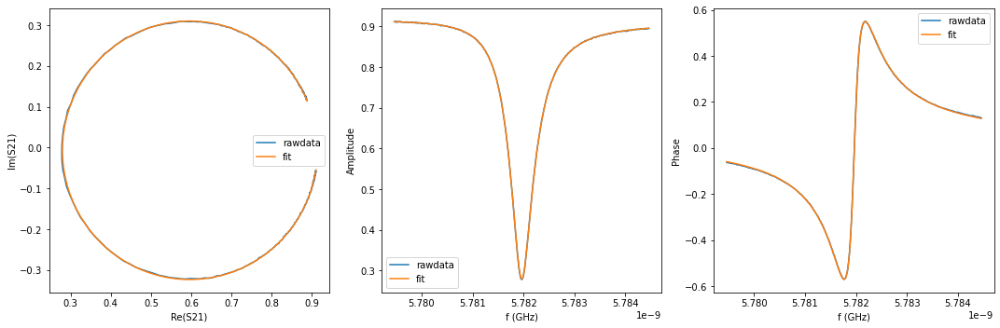

{'Qi_dia_corr': 25193.289473499855, 'Qi_no_corr': 25409.625193336728, 'absQc': 11121.526564518195, 'Qc_dia_corr(Re{Qc})': 11163.48403099272, 'Ql': 7735.6942769093475, 'fr': 5.78194132078765, 'theta0': -3.054865911427487, 'phi0': 0.08672730778552616, 'phi0_err': 0.0008552004872176191, 'Ql_err': 7.008920851668267, 'absQc_err': 6.6825280612028815, 'fr_err': 3.508796911999666e-07, 'chi_square': 4.245203182115902e-06, 'Qi_no_corr_err': 54.059379831265886, 'Qi_dia_corr_err': 52.91519476992613, 'delay': 0.5526369619506796, 'a': 0.9125933776945591, 'alpha': 1.2627763296874193}


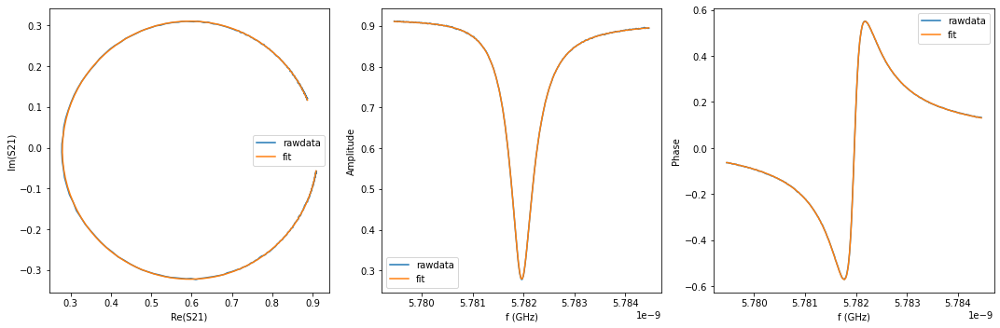

{'Qi_dia_corr': 25360.537889544434, 'Qi_no_corr': 25571.32292318109, 'absQc': 11192.56507445858, 'Qc_dia_corr(Re{Qc})': 11233.431833444785, 'Ql': 7785.0497171592415, 'fr': 5.781941875186079, 'theta0': -3.056268852148697, 'phi0': 0.08532486680107337, 'phi0_err': 0.000378077956203017, 'Ql_err': 3.9751808880256596, 'absQc_err': 4.480477629303435, 'fr_err': 2.0473063511996896e-07, 'chi_square': 1.3793939243767847e-06, 'Qi_no_corr_err': 28.595770239491074, 'Qi_dia_corr_err': 28.156227824466956, 'delay': 0.3267001423666214, 'a': 0.911964361620913, 'alpha': -0.6623149357565592}


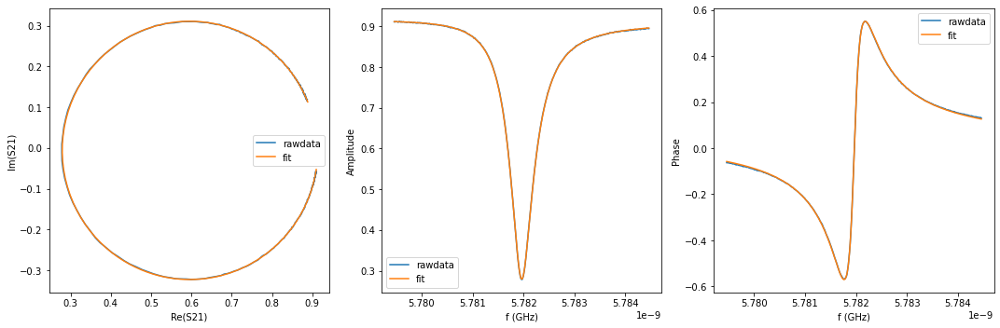

{'Qi_dia_corr': 25192.78456741959, 'Qi_no_corr': 25401.415548312558, 'absQc': 11107.083859627503, 'Qc_dia_corr(Re{Qc})': 11147.450285969964, 'Ql': 7727.944375248498, 'fr': 5.781941731734969, 'theta0': -3.056465420531052, 'phi0': 0.08512723305874134, 'phi0_err': 0.001288085784786526, 'Ql_err': 9.816365390567094, 'absQc_err': 7.846341321198978, 'fr_err': 5.028137194120397e-07, 'chi_square': 6.894891733700998e-06, 'Qi_no_corr_err': 84.83734406630607, 'Qi_dia_corr_err': 83.30940262650843, 'delay': 0.6688016259530472, 'a': 0.9128191556055932, 'alpha': -0.8002991442452912}


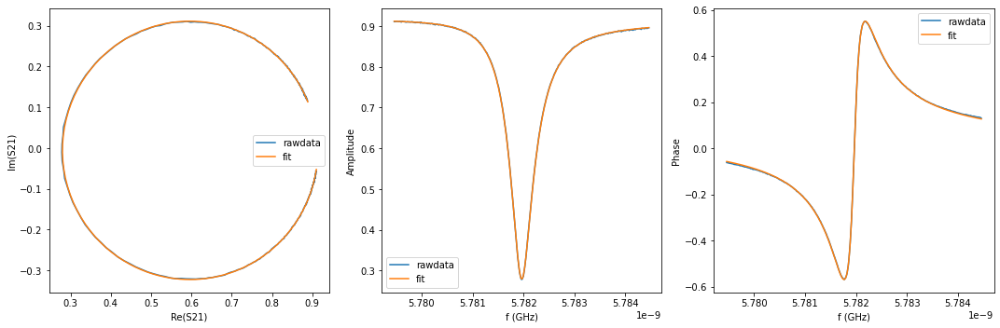

{'Qi_dia_corr': 25143.47086111659, 'Qi_no_corr': 25350.30547830934, 'absQc': 11092.851639993121, 'Qc_dia_corr(Re{Qc})': 11132.926067875933, 'Ql': 7716.323171083403, 'fr': 5.781941731527456, 'theta0': -3.0567187138864935, 'phi0': 0.08487393970329976, 'phi0_err': 0.001309870070068821, 'Ql_err': 9.604502676672567, 'absQc_err': 8.270826381468774, 'fr_err': 5.251918618702458e-07, 'chi_square': 7.611044720228089e-06, 'Qi_no_corr_err': 80.58444880830558, 'Qi_dia_corr_err': 79.38901814330605, 'delay': 0.6695837143106409, 'a': 0.9131072803179129, 'alpha': -0.7715096664475586}


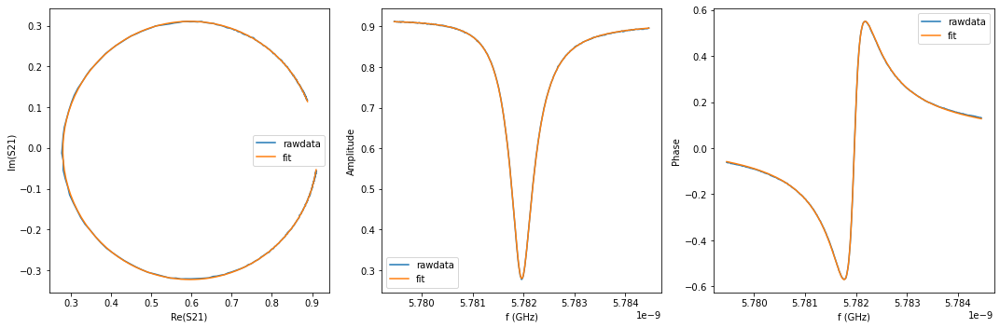

{'Qi_dia_corr': 25190.287877444534, 'Qi_no_corr': 25402.236683473373, 'absQc': 11104.689676286322, 'Qc_dia_corr(Re{Qc})': 11145.685450678857, 'Ql': 7726.861272125055, 'fr': 5.781941514423388, 'theta0': -3.0557976159528324, 'phi0': 0.08579547070712155, 'phi0_err': 0.0010738142936419337, 'Ql_err': 8.018940278588715, 'absQc_err': 7.1349004679121615, 'fr_err': 4.1562736294353444e-07, 'chi_square': 5.381399913258126e-06, 'Qi_no_corr_err': 64.3894171240262, 'Qi_dia_corr_err': 63.29710967908706, 'delay': 0.6119329076732325, 'a': 0.9128004675907458, 'alpha': -2.8660843456929084}


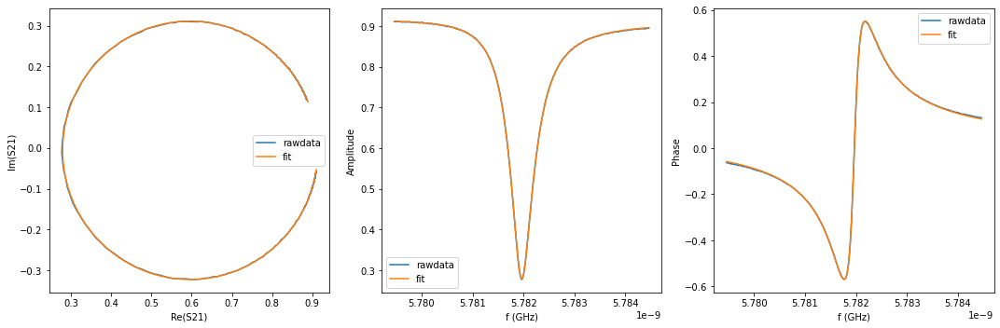

{'Qi_dia_corr': 25200.59313504972, 'Qi_no_corr': 25406.698126347375, 'absQc': 11094.529463717037, 'Qc_dia_corr(Re{Qc})': 11134.294475013305, 'Ql': 7722.352905611633, 'fr': 5.781942202722749, 'theta0': -3.0570539115109905, 'phi0': 0.08454025224240543, 'phi0_err': 0.0013797132801693442, 'Ql_err': 9.869559980749555, 'absQc_err': 8.208058226785589, 'fr_err': 5.339009766514282e-07, 'chi_square': 7.657229648396953e-06, 'Qi_no_corr_err': 83.47789051195745, 'Qi_dia_corr_err': 82.03508280015309, 'delay': 0.6632941426116078, 'a': 0.9130829194274509, 'alpha': -1.0005969760151443}


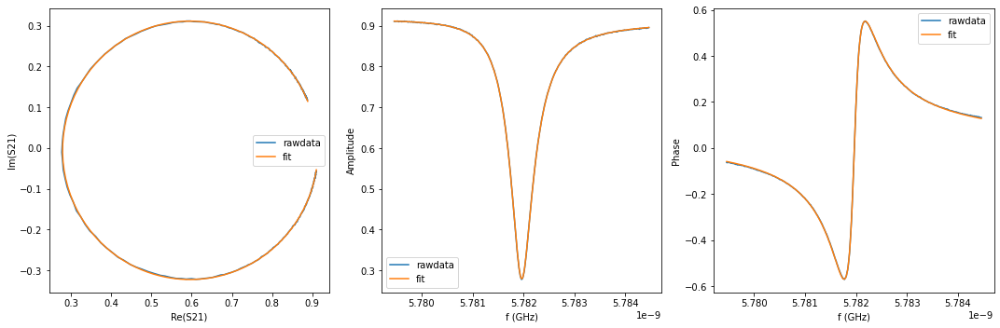

{'Qi_dia_corr': 25247.207189526085, 'Qi_no_corr': 25457.371968071235, 'absQc': 11125.53724349995, 'Qc_dia_corr(Re{Qc})': 11166.158917690605, 'Ql': 7742.05622397093, 'fr': 5.781941762845878, 'theta0': -3.0562684734599044, 'phi0': 0.0853245003431912, 'phi0_err': 0.0008480237833940756, 'Ql_err': 7.158479188647963, 'absQc_err': 6.81347216063153, 'fr_err': 3.519268563132517e-07, 'chi_square': 4.356518105704163e-06, 'Qi_no_corr_err': 55.0811220090111, 'Qi_dia_corr_err': 54.01989168033207, 'delay': 0.5721291758820161, 'a': 0.912797291351444, 'alpha': 1.9712668814724412}


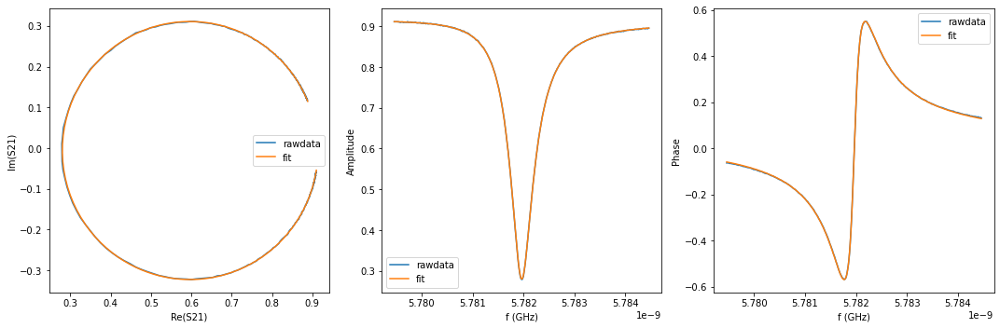

{'Qi_dia_corr': 25195.007387616304, 'Qi_no_corr': 25404.723017300137, 'absQc': 11138.162637943127, 'Qc_dia_corr(Re{Qc})': 11178.958559290093, 'Ql': 7743.283861272901, 'fr': 5.781941731295438, 'theta0': -3.056133518690353, 'phi0': 0.08545842026282333, 'phi0_err': 0.0007608407890689171, 'Ql_err': 6.6533623104715955, 'absQc_err': 6.300269428453249, 'fr_err': 3.199354158536917e-07, 'chi_square': 3.6356243356854557e-06, 'Qi_no_corr_err': 51.83365388520859, 'Qi_dia_corr_err': 50.58065899812326, 'delay': 0.5327250419917294, 'a': 0.9127082639709194, 'alpha': 0.5396528093828646}


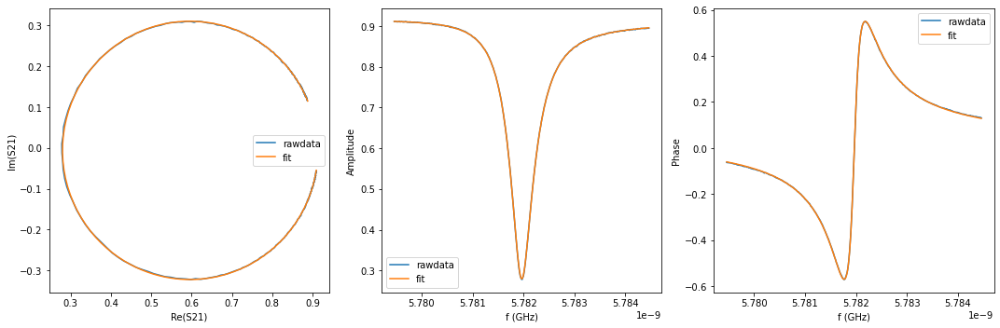

{'Qi_dia_corr': 25248.44894651726, 'Qi_no_corr': 25458.903997849487, 'absQc': 11148.736882561334, 'Qc_dia_corr(Re{Qc})': 11189.580520588543, 'Ql': 7753.425655524719, 'fr': 5.781941801443097, 'theta0': -3.0561256751293593, 'phi0': 0.08546779428699733, 'phi0_err': 0.0006477277982416229, 'Ql_err': 6.0321148770635915, 'absQc_err': 5.594681193150032, 'fr_err': 2.6417168415533646e-07, 'chi_square': 2.7297055470180043e-06, 'Qi_no_corr_err': 45.96919340184219, 'Qi_dia_corr_err': 45.297888820944834, 'delay': 0.49915015071212476, 'a': 0.9123889596667601, 'alpha': -0.6803443715511723}


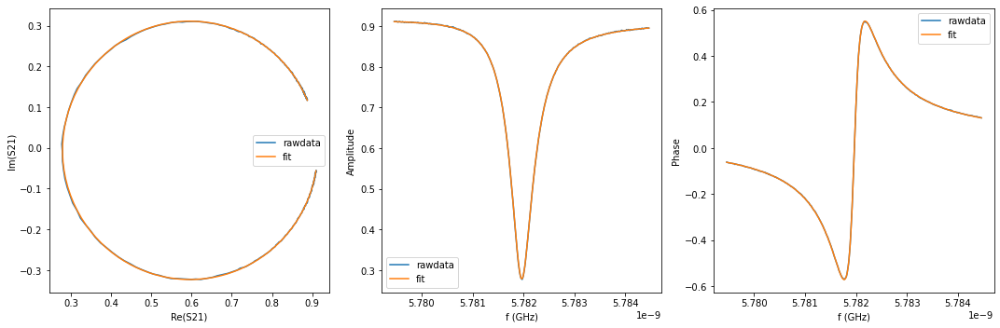

{'Qi_dia_corr': 25433.950629583305, 'Qi_no_corr': 25649.27117428061, 'absQc': 11195.220172509627, 'Qc_dia_corr(Re{Qc})': 11236.741347989828, 'Ql': 7793.545997358202, 'fr': 5.781941791026053, 'theta0': -3.0555995848301403, 'phi0': 0.08599306875965278, 'phi0_err': 0.0004052875786499454, 'Ql_err': 4.127115522787166, 'absQc_err': 4.547365618134206, 'fr_err': 2.0880225109535887e-07, 'chi_square': 1.5016537169198462e-06, 'Qi_no_corr_err': 31.754472413792936, 'Qi_dia_corr_err': 31.292702801625044, 'delay': 0.34821934215816014, 'a': 0.9121915561697881, 'alpha': 0.1200313517571759}


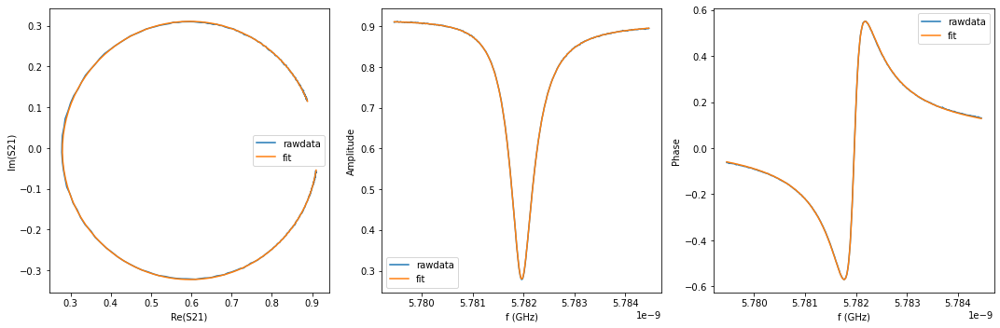

{'Qi_dia_corr': 25227.671334081504, 'Qi_no_corr': 25438.853674345748, 'absQc': 11138.408624017304, 'Qc_dia_corr(Re{Qc})': 11179.384091833997, 'Ql': 7746.57066568177, 'fr': 5.781941656545129, 'theta0': -3.0559479009906, 'phi0': 0.08564475259919298, 'phi0_err': 0.0007420157297345834, 'Ql_err': 6.403870462819956, 'absQc_err': 6.084797682811523, 'fr_err': 3.1097335118071916e-07, 'chi_square': 3.3925812600263945e-06, 'Qi_no_corr_err': 49.759374798603275, 'Qi_dia_corr_err': 48.44351769491984, 'delay': 0.5372197664150785, 'a': 0.9127787723050509, 'alpha': 0.7029180244411649}


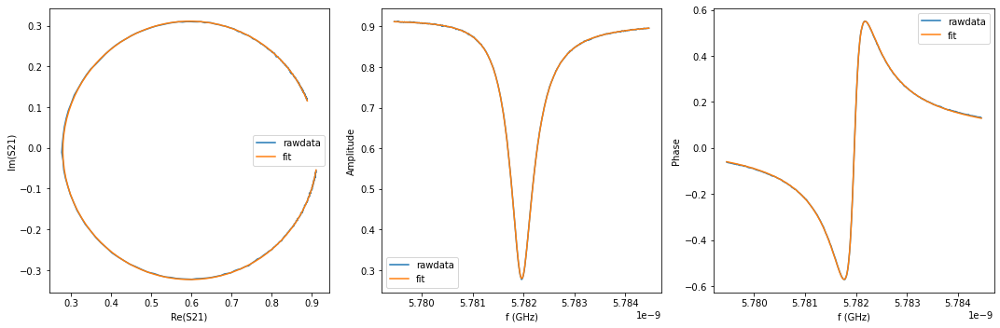

{'Qi_dia_corr': 25273.944273461417, 'Qi_no_corr': 25491.625513210638, 'absQc': 11140.736751049391, 'Qc_dia_corr(Re{Qc})': 11182.830353746202, 'Ql': 7752.584644973638, 'fr': 5.78194115940151, 'theta0': -3.0548007630449416, 'phi0': 0.08679276033579354, 'phi0_err': 0.000724060317761061, 'Ql_err': 6.340028288351975, 'absQc_err': 6.003952919469846, 'fr_err': 3.1581898091684703e-07, 'chi_square': 3.3665419836551163e-06, 'Qi_no_corr_err': 50.326077573001804, 'Qi_dia_corr_err': 49.20881059935994, 'delay': 0.5040274081871479, 'a': 0.9128356952064933, 'alpha': -0.5025606765367342}


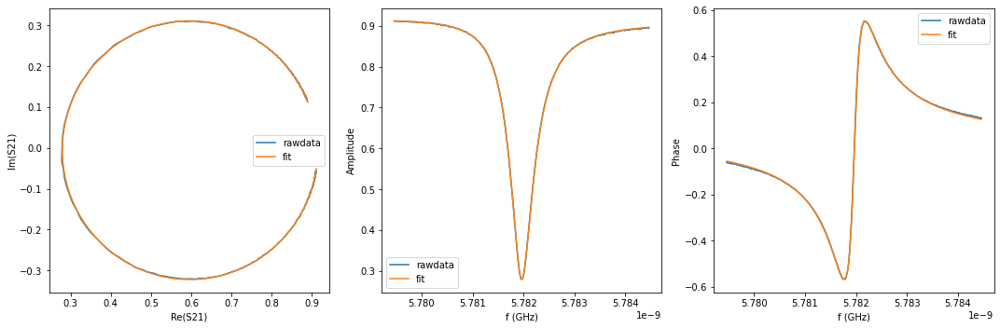

{'Qi_dia_corr': 25066.146761323474, 'Qi_no_corr': 25272.085143240325, 'absQc': 11038.605722677274, 'Qc_dia_corr(Re{Qc})': 11078.36132972634, 'Ql': 7682.822249686496, 'fr': 5.781942106601663, 'theta0': -3.0568496480218696, 'phi0': 0.08474349869234496, 'phi0_err': 0.001905511174153676, 'Ql_err': 12.671245311668658, 'absQc_err': 9.937519509510341, 'fr_err': 7.398056675009135e-07, 'chi_square': 1.2107646362124344e-05, 'Qi_no_corr_err': 111.72050087935963, 'Qi_dia_corr_err': 109.52607253585072, 'delay': 0.7906776846735423, 'a': 0.9136615848749596, 'alpha': -2.6554738788724093}


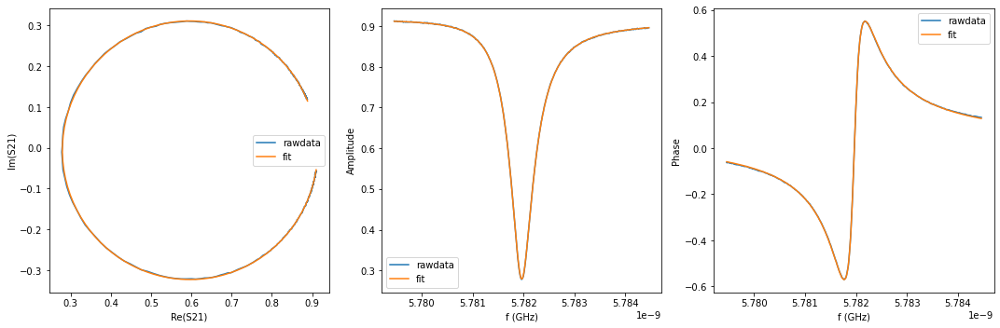

{'Qi_dia_corr': 25278.054219158395, 'Qi_no_corr': 25491.051733345077, 'absQc': 11138.98895015638, 'Qc_dia_corr(Re{Qc})': 11180.154766125885, 'Ql': 7751.685182088453, 'fr': 5.781941415490494, 'theta0': -3.0557520459452743, 'phi0': 0.08584061132073836, 'phi0_err': 0.0008098314602673488, 'Ql_err': 7.350668469691238, 'absQc_err': 6.697262080803592, 'fr_err': 3.1513977097484293e-07, 'chi_square': 3.9121486569755445e-06, 'Qi_no_corr_err': 56.220636715642314, 'Qi_dia_corr_err': 54.827697274823244, 'delay': 0.5414517561929577, 'a': 0.9127154289041464, 'alpha': 0.8569893779448605}


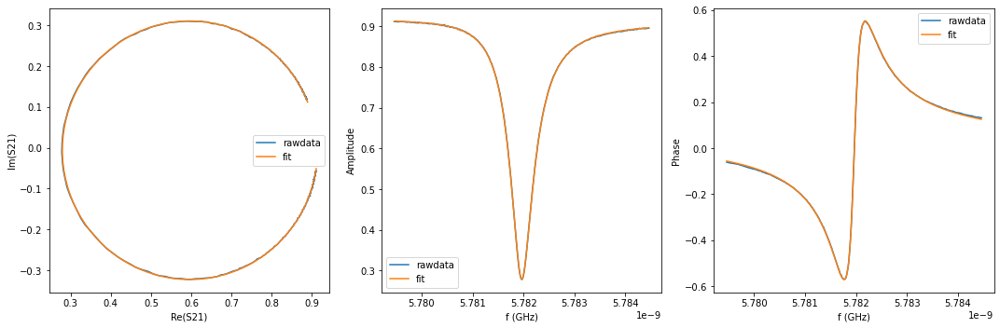

{'Qi_dia_corr': 25131.288010677137, 'Qi_no_corr': 25343.41720856459, 'absQc': 11062.368579617172, 'Qc_dia_corr(Re{Qc})': 11103.277672974464, 'Ql': 7700.9248985683325, 'fr': 5.781941961402865, 'theta0': -3.055724626286111, 'phi0': 0.0858682789221171, 'phi0_err': 0.0015604939396042913, 'Ql_err': 11.500572832949485, 'absQc_err': 8.890864399041144, 'fr_err': 6.003084429660981e-07, 'chi_square': 9.175417288189767e-06, 'Qi_no_corr_err': 100.70346046409324, 'Qi_dia_corr_err': 98.19671007952816, 'delay': 0.7892927159316672, 'a': 0.9134063948350839, 'alpha': -2.7057090715246956}


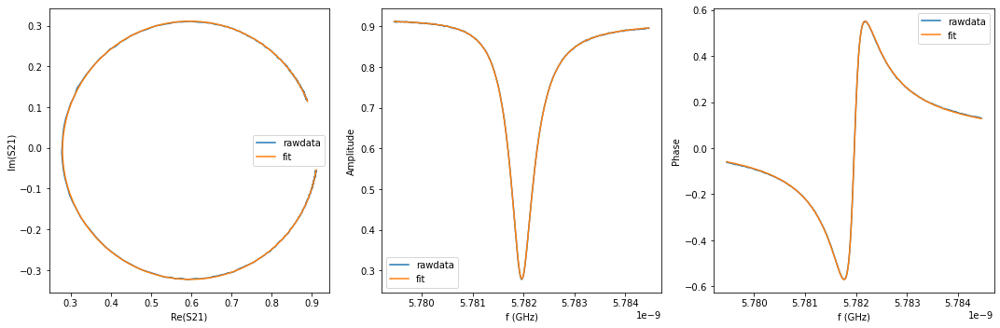

{'Qi_dia_corr': 25261.625195576093, 'Qi_no_corr': 25472.90729899622, 'absQc': 11137.51237125617, 'Qc_dia_corr(Re{Qc})': 11178.390441310106, 'Ql': 7749.2916696870025, 'fr': 5.781941649027789, 'theta0': -3.0560464343531737, 'phi0': 0.08554664622864366, 'phi0_err': 0.0007857537331557126, 'Ql_err': 6.433881750808608, 'absQc_err': 6.195244093829133, 'fr_err': 3.3343962596264523e-07, 'chi_square': 3.686262502854377e-06, 'Qi_no_corr_err': 50.22461371882948, 'Qi_dia_corr_err': 49.19504513753784, 'delay': 0.5577346953909281, 'a': 0.9128820823921164, 'alpha': 1.4482811030439025}


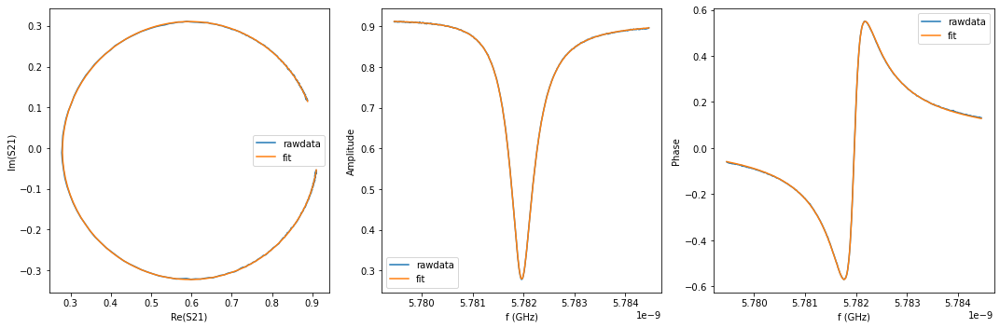

{'Qi_dia_corr': 25204.869858368416, 'Qi_no_corr': 25420.015479654114, 'absQc': 11127.258908342039, 'Qc_dia_corr(Re{Qc})': 11168.99140734519, 'Ql': 7739.430598662556, 'fr': 5.781941224713722, 'theta0': -3.0551227899047046, 'phi0': 0.08647300176017483, 'phi0_err': 0.0008048407799644999, 'Ql_err': 6.920209271935424, 'absQc_err': 6.459596498607447, 'fr_err': 3.2891858117997803e-07, 'chi_square': 3.9036658817783265e-06, 'Qi_no_corr_err': 53.38627134035804, 'Qi_dia_corr_err': 52.55774303790515, 'delay': 0.5644834814913483, 'a': 0.9128850643090348, 'alpha': 1.6937115900094295}


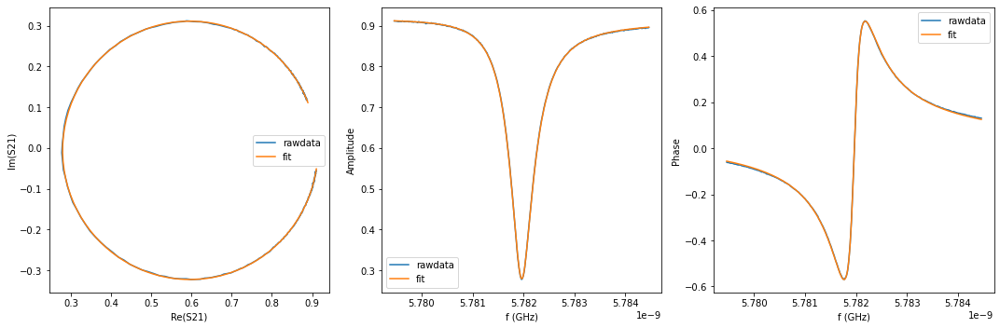

{'Qi_dia_corr': 25114.330235373996, 'Qi_no_corr': 25318.146412575123, 'absQc': 11053.699178812749, 'Qc_dia_corr(Re{Qc})': 11093.003648515545, 'Ql': 7694.390253212987, 'fr': 5.781941934449203, 'theta0': -3.057387299643525, 'phi0': 0.08420535394626824, 'phi0_err': 0.0015830054307582329, 'Ql_err': 11.752506885259017, 'absQc_err': 8.957498075645999, 'fr_err': 6.193347795423325e-07, 'chi_square': 9.47106098605983e-06, 'Qi_no_corr_err': 104.25134643242528, 'Qi_dia_corr_err': 102.59239400193488, 'delay': 0.8055025838279054, 'a': 0.913530075696177, 'alpha': -2.1171355231788302}


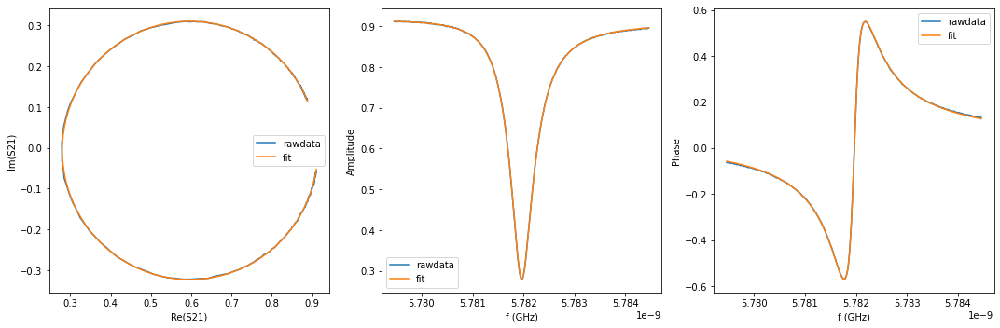

{'Qi_dia_corr': 25169.835721650426, 'Qi_no_corr': 25387.655517435214, 'absQc': 11110.555023881027, 'Qc_dia_corr(Re{Qc})': 11152.794041154017, 'Ql': 7728.349948403479, 'fr': 5.781941200182542, 'theta0': -3.054533260102591, 'phi0': 0.08705971113303926, 'phi0_err': 0.0011698353485700601, 'Ql_err': 8.779138411014369, 'absQc_err': 7.63089297962641, 'fr_err': 4.537740636574345e-07, 'chi_square': 6.220779486958932e-06, 'Qi_no_corr_err': 71.74165558173313, 'Qi_dia_corr_err': 70.1088077814788, 'delay': 0.6626104020192184, 'a': 0.9132587899080561, 'alpha': -1.0249132291136323}


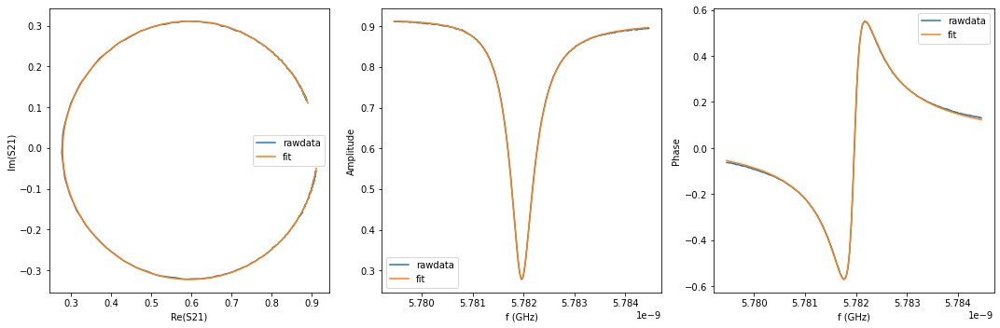

{'Qi_dia_corr': 24966.87354122741, 'Qi_no_corr': 25171.47282685638, 'absQc': 11000.096830132336, 'Qc_dia_corr(Re{Qc})': 11039.631892149793, 'Ql': 7654.869309741646, 'fr': 5.7819418963482585, 'theta0': -3.05693648545744, 'phi0': 0.08465616813235326, 'phi0_err': 0.0028353146739586352, 'Ql_err': 16.199083717088403, 'absQc_err': 11.795849476512037, 'fr_err': 1.0746890466538198e-06, 'chi_square': 1.8453050005768644e-05, 'Qi_no_corr_err': 147.0630197844952, 'Qi_dia_corr_err': 144.75109669888482, 'delay': 0.9429666975581906, 'a': 0.9140824995864313, 'alpha': 2.8768691288793633}


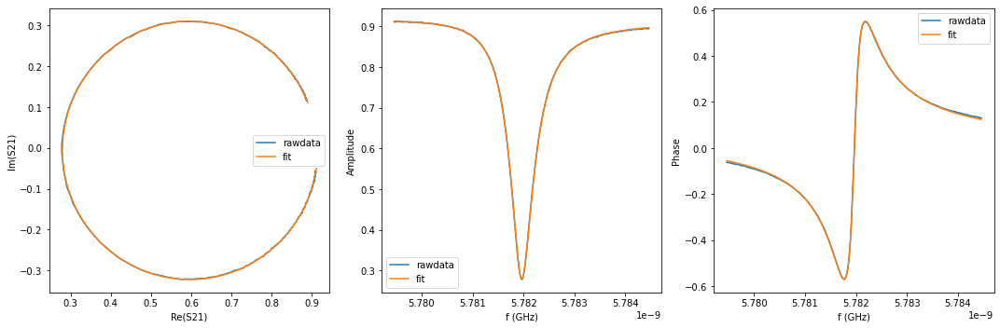

{'Qi_dia_corr': 25024.517832422745, 'Qi_no_corr': 25234.905188579272, 'absQc': 11034.708564349994, 'Qc_dia_corr(Re{Qc})': 11075.425353433538, 'Ql': 7677.496272826626, 'fr': 5.781941748482474, 'theta0': -3.0558188454714266, 'phi0': 0.08577380811836653, 'phi0_err': 0.0022199926345013513, 'Ql_err': 14.945962249239836, 'absQc_err': 10.41283969741851, 'fr_err': 8.536618016847539e-07, 'chi_square': 1.3703559490047545e-05, 'Qi_no_corr_err': 137.25495833547004, 'Qi_dia_corr_err': 135.0136717548246, 'delay': 0.874647423796728, 'a': 0.9137733054636406, 'alpha': 0.39526191042247666}


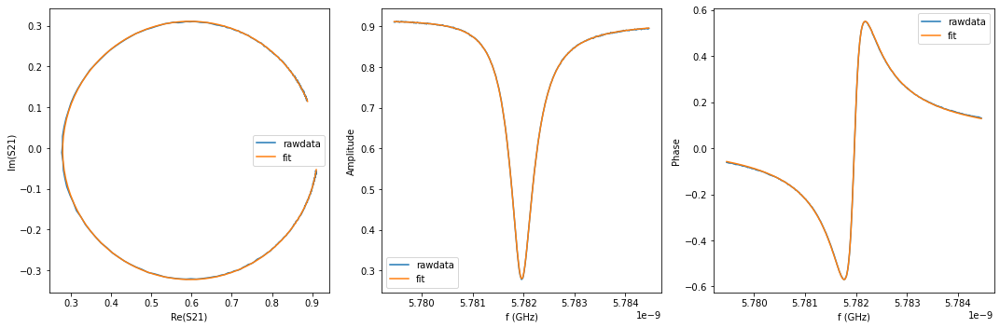

{'Qi_dia_corr': 25220.94679107068, 'Qi_no_corr': 25436.26075119423, 'absQc': 11126.829741955456, 'Qc_dia_corr(Re{Qc})': 11168.53831343969, 'Ql': 7740.7281177051655, 'fr': 5.781941660302555, 'theta0': -3.05514389843834, 'phi0': 0.0864499475298068, 'phi0_err': 0.0008635849746099881, 'Ql_err': 7.127459755018473, 'absQc_err': 6.549080003267503, 'fr_err': 3.4314701543926443e-07, 'chi_square': 4.105616984402298e-06, 'Qi_no_corr_err': 55.54407374562105, 'Qi_dia_corr_err': 54.45441090511488, 'delay': 0.5904155368532507, 'a': 0.9129491993208785, 'alpha': 2.635971582238102}


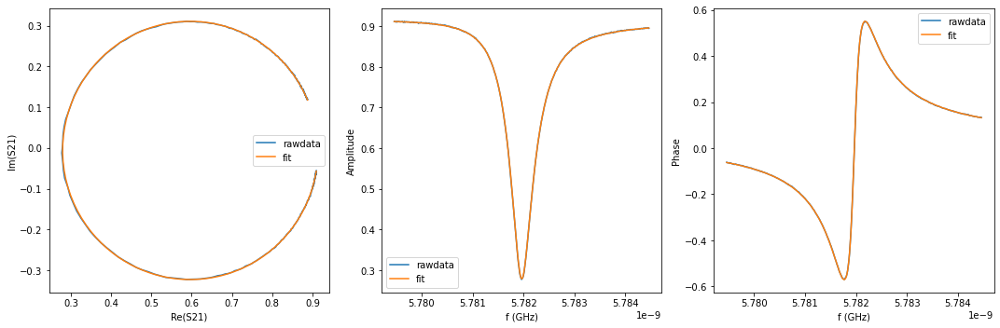

{'Qi_dia_corr': 25420.17120260837, 'Qi_no_corr': 25637.615834163415, 'absQc': 11221.310866075539, 'Qc_dia_corr(Re{Qc})': 11263.481373058828, 'Ql': 7805.101311816092, 'fr': 5.781941725774526, 'theta0': -3.055032410857558, 'phi0': 0.08656028535246618, 'phi0_err': 0.00044976178096446293, 'Ql_err': 4.457475472636656, 'absQc_err': 4.592637868778677, 'fr_err': 2.205375148793641e-07, 'chi_square': 1.666527608250423e-06, 'Qi_no_corr_err': 36.083071573270836, 'Qi_dia_corr_err': 35.72360550752345, 'delay': 0.284032319235806, 'a': 0.9121316758527499, 'alpha': -2.211790975583611}


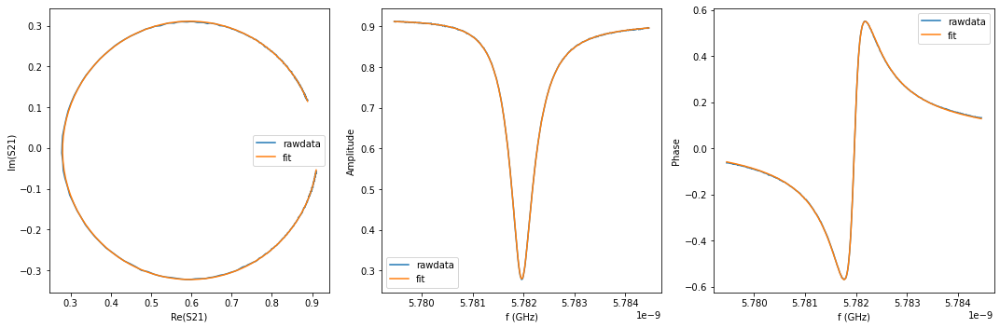

{'Qi_dia_corr': 25181.06156359604, 'Qi_no_corr': 25389.627358412046, 'absQc': 11120.254761122756, 'Qc_dia_corr(Re{Qc})': 11160.74222163896, 'Ql': 7733.22476339761, 'fr': 5.781942108875417, 'theta0': -3.056388104889575, 'phi0': 0.08520402378621414, 'phi0_err': 0.0008623064543484182, 'Ql_err': 7.531253129755615, 'absQc_err': 6.577812289370211, 'fr_err': 3.492878588525099e-07, 'chi_square': 4.201272909069045e-06, 'Qi_no_corr_err': 61.029634423942134, 'Qi_dia_corr_err': 59.64104637297366, 'delay': 0.5646676698211641, 'a': 0.9129706079183472, 'alpha': 1.6999747715115427}


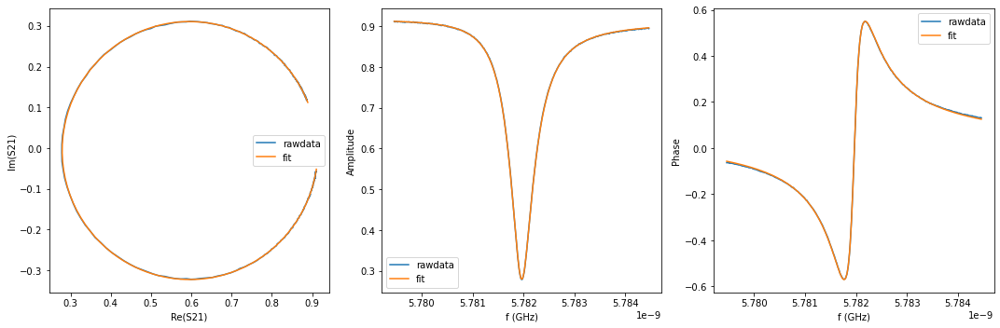

{'Qi_dia_corr': 25150.536806038217, 'Qi_no_corr': 25360.79943992893, 'absQc': 11077.905842159902, 'Qc_dia_corr(Re{Qc})': 11118.508653932298, 'Ql': 7710.058469490419, 'fr': 5.7819418433646685, 'theta0': -3.0561043599503845, 'phi0': 0.08548738567166166, 'phi0_err': 0.0014579032662891602, 'Ql_err': 10.813648783147599, 'absQc_err': 8.486959743263421, 'fr_err': 5.664352559568217e-07, 'chi_square': 8.318049881415915e-06, 'Qi_no_corr_err': 94.62994729864698, 'Qi_dia_corr_err': 92.4265722666601, 'delay': 0.7430619548902274, 'a': 0.9133015830228678, 'alpha': 1.897536282380527}


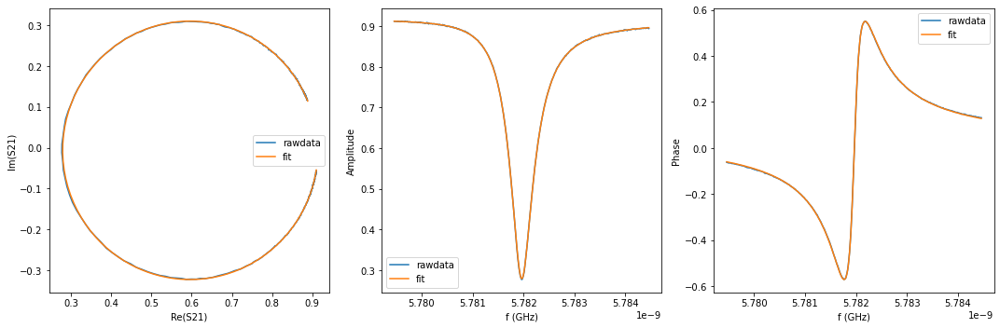

{'Qi_dia_corr': 25261.42895945815, 'Qi_no_corr': 25475.21286428138, 'absQc': 11137.701551595439, 'Qc_dia_corr(Re{Qc})': 11179.063431266157, 'Ql': 7749.596621095312, 'fr': 5.781941587349135, 'theta0': -3.0555430022095975, 'phi0': 0.08604911683818442, 'phi0_err': 0.0007181705676069981, 'Ql_err': 6.582595419063369, 'absQc_err': 6.072850615846063, 'fr_err': 2.919925808406579e-07, 'chi_square': 3.2583358165939955e-06, 'Qi_no_corr_err': 51.07163661919303, 'Qi_dia_corr_err': 49.819325789570705, 'delay': 0.5269996690321417, 'a': 0.9127679077217259, 'alpha': 0.3314498764835765}


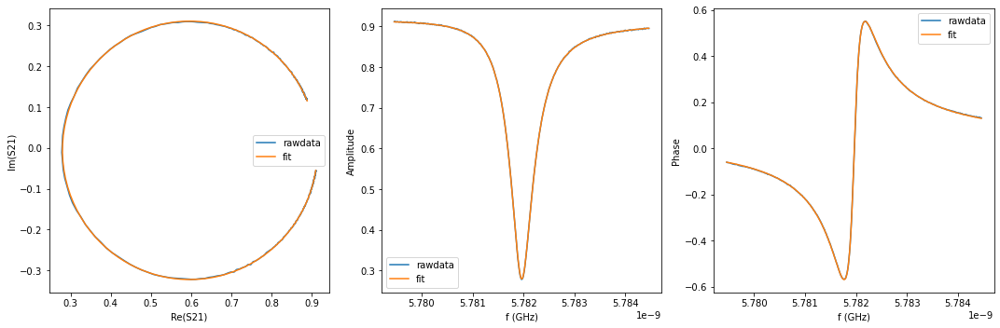

{'Qi_dia_corr': 25293.841171333537, 'Qi_no_corr': 25503.717605772687, 'absQc': 11171.544265832152, 'Qc_dia_corr(Re{Qc})': 11212.296665817985, 'Ql': 7768.612837002355, 'fr': 5.781941811445655, 'theta0': -3.0563097247674085, 'phi0': 0.08528564371403563, 'phi0_err': 0.0005180385683672331, 'Ql_err': 5.203041244854399, 'absQc_err': 5.277036960023774, 'fr_err': 2.3672589710637526e-07, 'chi_square': 2.141628410923412e-06, 'Qi_no_corr_err': 38.48367509005844, 'Qi_dia_corr_err': 37.640990694081545, 'delay': 0.4495053775624758, 'a': 0.9125488036803786, 'alpha': -2.483733695344183}


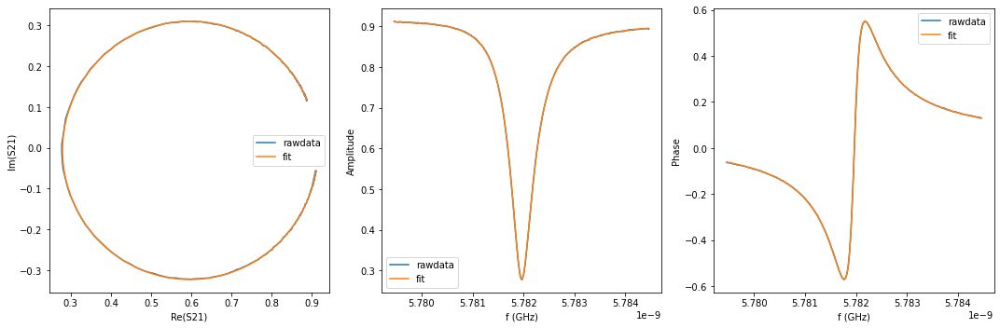

{'Qi_dia_corr': 25347.991377598028, 'Qi_no_corr': 25561.22928640366, 'absQc': 11181.40356414975, 'Qc_dia_corr(Re{Qc})': 11222.701931120639, 'Ql': 7778.713665118804, 'fr': 5.781941630746434, 'theta0': -3.055779366950963, 'phi0': 0.08581555052316762, 'phi0_err': 0.0004187591407906339, 'Ql_err': 4.505470410666617, 'absQc_err': 4.653343838627314, 'fr_err': 2.0176441183954098e-07, 'chi_square': 1.5857765255393861e-06, 'Qi_no_corr_err': 33.418559796348944, 'Qi_dia_corr_err': 32.8975042076518, 'delay': 0.42240767828835607, 'a': 0.9125986741406727, 'alpha': 2.814859041204577}


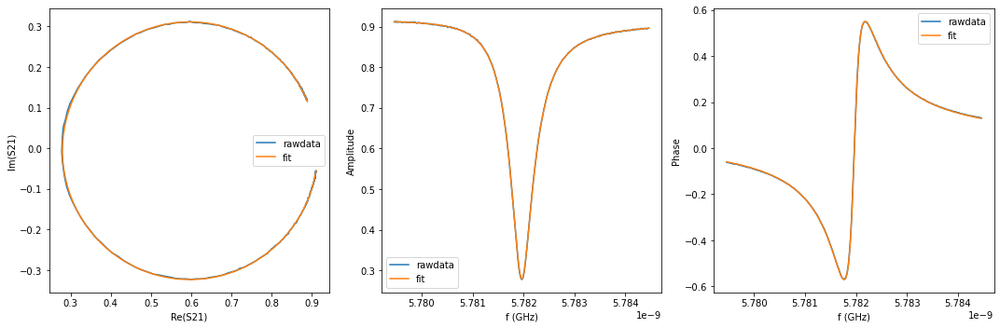

{'Qi_dia_corr': 25258.0755211005, 'Qi_no_corr': 25473.506827711433, 'absQc': 11139.84039425003, 'Qc_dia_corr(Re{Qc})': 11181.546598722012, 'Ql': 7750.474126887038, 'fr': 5.78194141218148, 'theta0': -3.0551955206668193, 'phi0': 0.08639716169529105, 'phi0_err': 0.000656478955497905, 'Ql_err': 6.005914947391586, 'absQc_err': 5.727581759740918, 'fr_err': 2.698350804709504e-07, 'chi_square': 2.790994497998772e-06, 'Qi_no_corr_err': 46.03088851867735, 'Qi_dia_corr_err': 44.77481061567741, 'delay': 0.5234617246890257, 'a': 0.9129727923126737, 'alpha': 0.20327321326047706}


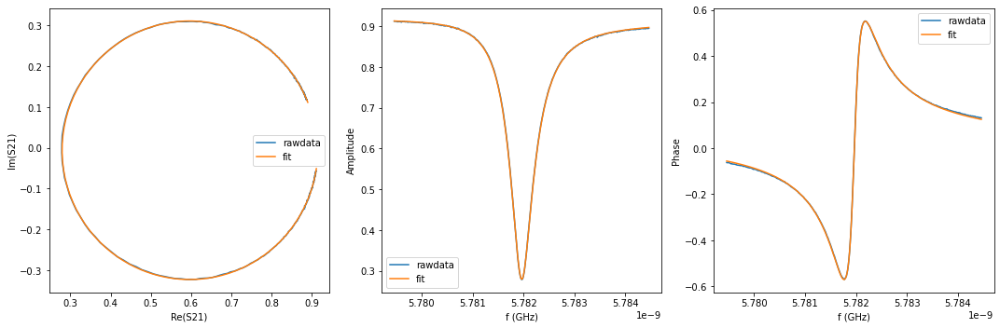

{'Qi_dia_corr': 25046.941197417065, 'Qi_no_corr': 25254.611809170114, 'absQc': 11027.39640148998, 'Qc_dia_corr(Re{Qc})': 11067.464688888567, 'Ql': 7675.777310023439, 'fr': 5.781941878291399, 'theta0': -3.056472491119252, 'phi0': 0.08511819939906365, 'phi0_err': 0.0020234301592545376, 'Ql_err': 14.573819717144307, 'absQc_err': 10.338225194675708, 'fr_err': 8.041215089009419e-07, 'chi_square': 1.3299046824545967e-05, 'Qi_no_corr_err': 134.33195288386386, 'Qi_dia_corr_err': 132.00889065547807, 'delay': 0.8254788809083529, 'a': 0.9140624636017218, 'alpha': -1.3912037362956284}


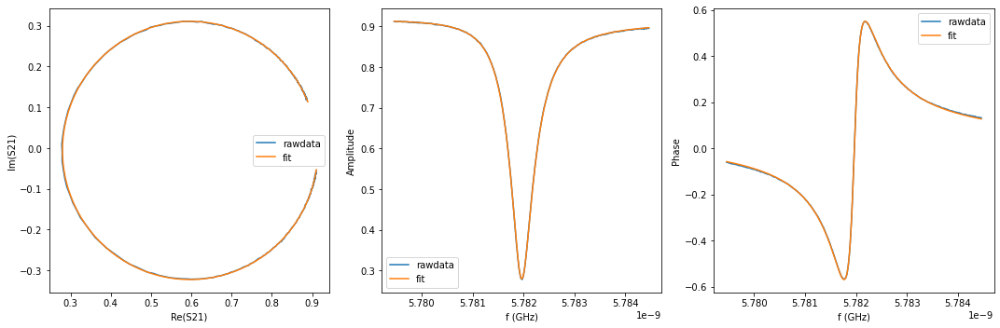

{'Qi_dia_corr': 25124.947439691565, 'Qi_no_corr': 25331.334510700122, 'absQc': 11080.348673751983, 'Qc_dia_corr(Re{Qc})': 11120.305353743574, 'Ql': 7708.515350091125, 'fr': 5.7819420140771935, 'theta0': -3.0567954628737093, 'phi0': 0.08479719071608376, 'phi0_err': 0.0012951515502366638, 'Ql_err': 9.358065020885375, 'absQc_err': 7.868394412165608, 'fr_err': 5.047060675593908e-07, 'chi_square': 6.985548663807468e-06, 'Qi_no_corr_err': 78.74483928994258, 'Qi_dia_corr_err': 77.14759440605721, 'delay': 0.653511056278523, 'a': 0.9135256015485393, 'alpha': -1.3558209004412782}


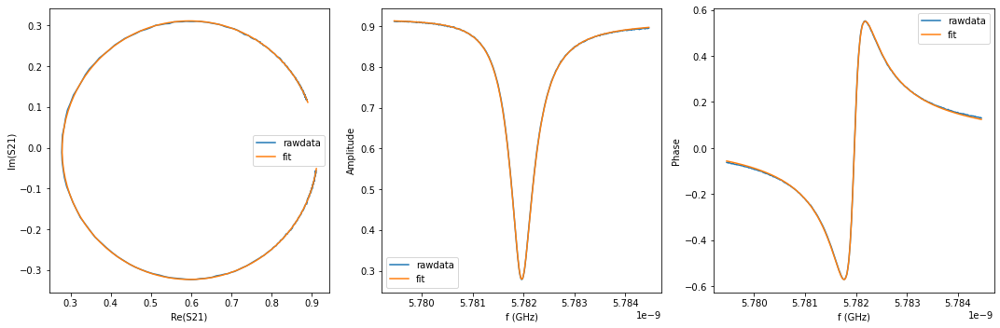

{'Qi_dia_corr': 25079.703987828885, 'Qi_no_corr': 25288.347271908773, 'absQc': 11027.486318717625, 'Qc_dia_corr(Re{Qc})': 11067.637006703704, 'Ql': 7678.934392846581, 'fr': 5.781941875666643, 'theta0': -3.056387624747313, 'phi0': 0.08520506662515401, 'phi0_err': 0.0023472005982283313, 'Ql_err': 14.829208821583384, 'absQc_err': 10.296665118385768, 'fr_err': 8.798948774094645e-07, 'chi_square': 1.3723971259966367e-05, 'Qi_no_corr_err': 136.9091692521809, 'Qi_dia_corr_err': 133.55895377057337, 'delay': 0.8321725858007775, 'a': 0.9139457647925723, 'alpha': -1.14840397058795}


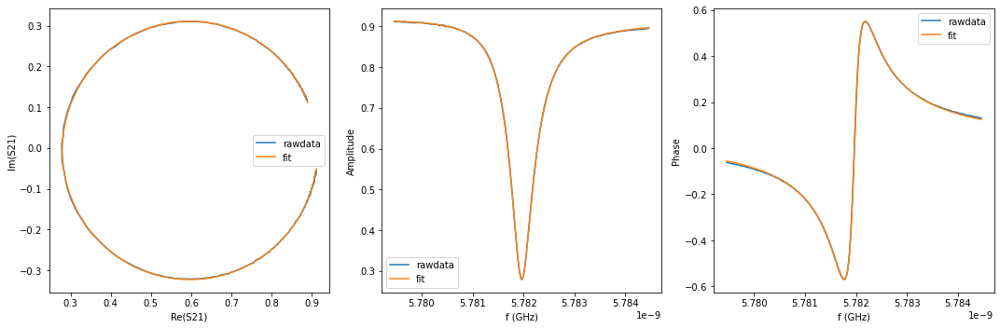

{'Qi_dia_corr': 25064.130026798142, 'Qi_no_corr': 25271.018836717525, 'absQc': 11038.300220760477, 'Qc_dia_corr(Re{Qc})': 11078.242669924057, 'Ql': 7682.5757145872685, 'fr': 5.781942050776499, 'theta0': -3.0566496995840735, 'phi0': 0.08494297736688933, 'phi0_err': 0.0019128152946132043, 'Ql_err': 12.224954319403649, 'absQc_err': 9.46997017219378, 'fr_err': 7.345556668710198e-07, 'chi_square': 1.117116220732093e-05, 'Qi_no_corr_err': 107.96201789726862, 'Qi_dia_corr_err': 106.27254887159341, 'delay': 0.8272933326405412, 'a': 0.9139086250904354, 'alpha': -1.3254924838518223}


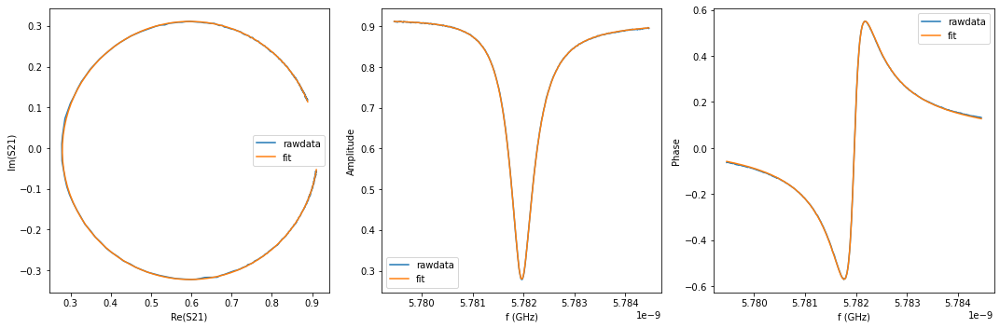

{'Qi_dia_corr': 25155.95089576706, 'Qi_no_corr': 25365.600589662565, 'absQc': 11095.216326210502, 'Qc_dia_corr(Re{Qc})': 11135.810710519092, 'Ql': 7718.884259667711, 'fr': 5.781941635062684, 'theta0': -3.0561806636531874, 'phi0': 0.08541203642507034, 'phi0_err': 0.0010669315014859395, 'Ql_err': 8.561200100213082, 'absQc_err': 7.4236396468279695, 'fr_err': 4.2943692332824196e-07, 'chi_square': 5.758588012218315e-06, 'Qi_no_corr_err': 70.5989077411857, 'Qi_dia_corr_err': 69.07764377541852, 'delay': 0.6415961626162764, 'a': 0.9132655446458432, 'alpha': -1.7882391314163861}


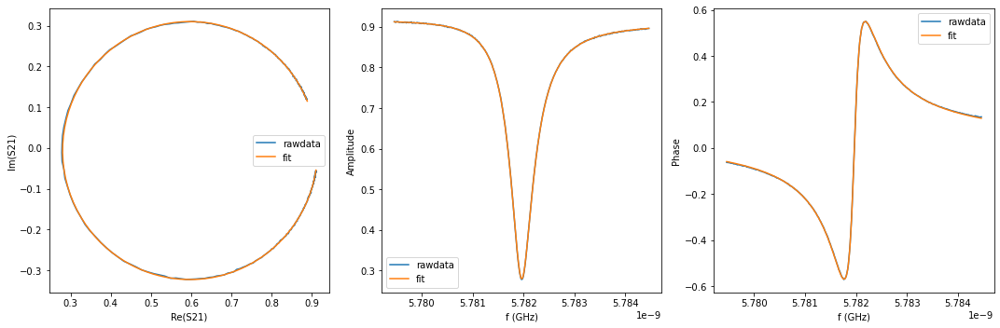

{'Qi_dia_corr': 25202.960945645715, 'Qi_no_corr': 25420.840666494325, 'absQc': 11126.585811253437, 'Qc_dia_corr(Re{Qc})': 11168.847379929342, 'Ql': 7739.181450769571, 'fr': 5.781941164576991, 'theta0': -3.054574340494129, 'phi0': 0.08702031769798482, 'phi0_err': 0.0008226506501314292, 'Ql_err': 7.120986648880753, 'absQc_err': 6.539905422296234, 'fr_err': 3.342116377632894e-07, 'chi_square': 4.00359781010809e-06, 'Qi_no_corr_err': 56.22972087676323, 'Qi_dia_corr_err': 54.76435343832703, 'delay': 0.5239212062200754, 'a': 0.9130883777225929, 'alpha': 0.2198877055172006}


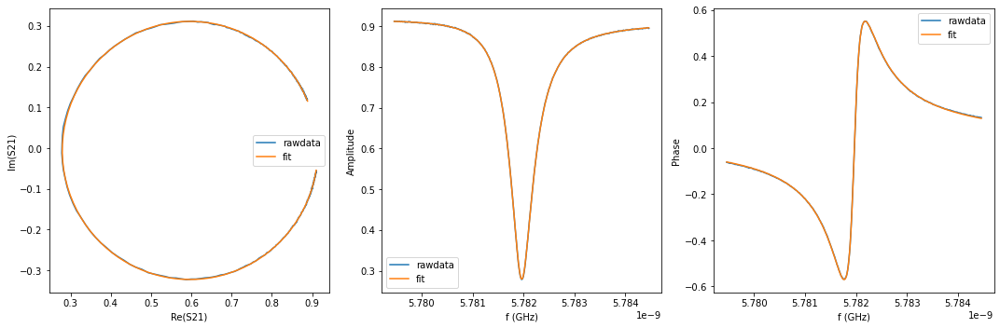

{'Qi_dia_corr': 25293.81525092732, 'Qi_no_corr': 25504.97530789752, 'absQc': 11149.214231005371, 'Qc_dia_corr(Re{Qc})': 11190.05076160533, 'Ql': 7757.924462153118, 'fr': 5.7819418858497, 'theta0': -3.0561339710840394, 'phi0': 0.08545855630362166, 'phi0_err': 0.0006778729684158876, 'Ql_err': 6.298495353974925, 'absQc_err': 5.923797686782395, 'fr_err': 2.8402036500193634e-07, 'chi_square': 3.076704977097403e-06, 'Qi_no_corr_err': 48.39935142611919, 'Qi_dia_corr_err': 47.46542609779812, 'delay': 0.49346795694104445, 'a': 0.9127439932267162, 'alpha': -0.8863972532023587}


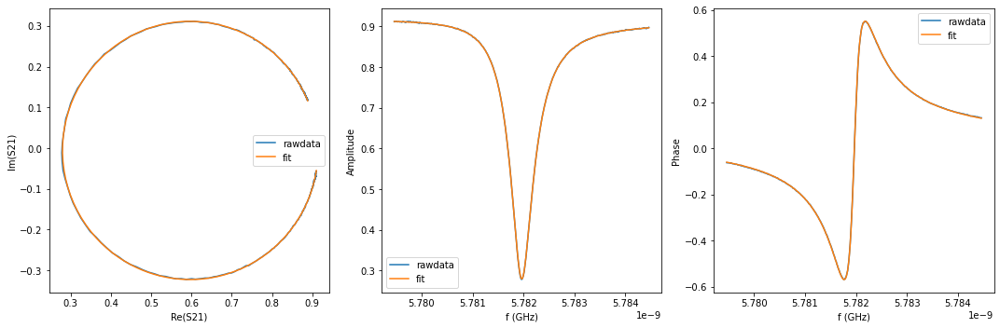

{'Qi_dia_corr': 25294.01055841222, 'Qi_no_corr': 25503.78026067923, 'absQc': 11168.604043226345, 'Qc_dia_corr(Re{Qc})': 11209.313792692217, 'Ql': 7767.196727010818, 'fr': 5.781942232709756, 'theta0': -3.056341737495768, 'phi0': 0.08525232369726249, 'phi0_err': 0.0004947698755239497, 'Ql_err': 4.999943491732821, 'absQc_err': 5.013945764117732, 'fr_err': 2.2985615604101019e-07, 'chi_square': 1.9906477703105052e-06, 'Qi_no_corr_err': 38.372829426571506, 'Qi_dia_corr_err': 37.56117959845659, 'delay': 0.434301676449755, 'a': 0.9129831317271959, 'alpha': -3.035696315167358}


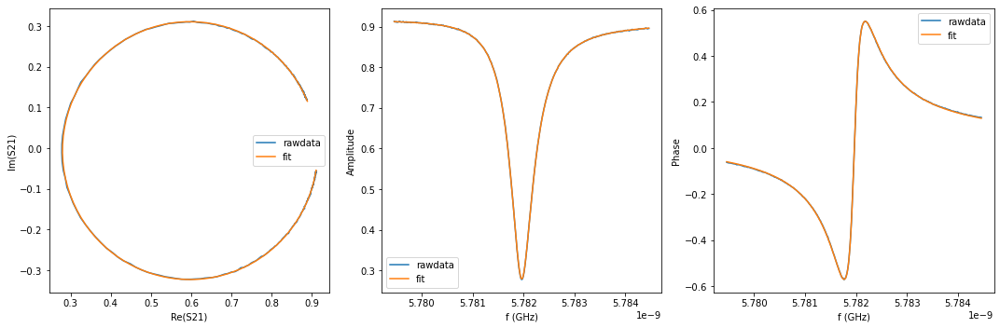

{'Qi_dia_corr': 25245.488377662263, 'Qi_no_corr': 25460.631668468202, 'absQc': 11134.920679177601, 'Qc_dia_corr(Re{Qc})': 11176.576026582603, 'Ql': 7746.9008085182895, 'fr': 5.781941615021125, 'theta0': -3.055229095761705, 'phi0': 0.08636364580436416, 'phi0_err': 0.0007687178165703662, 'Ql_err': 6.590555112741409, 'absQc_err': 6.088021375115532, 'fr_err': 3.08075217155108e-07, 'chi_square': 3.4417443735365504e-06, 'Qi_no_corr_err': 51.761940819504346, 'Qi_dia_corr_err': 50.42585088548914, 'delay': 0.5093937515917448, 'a': 0.9132081177460418, 'alpha': -0.30752787581174806}


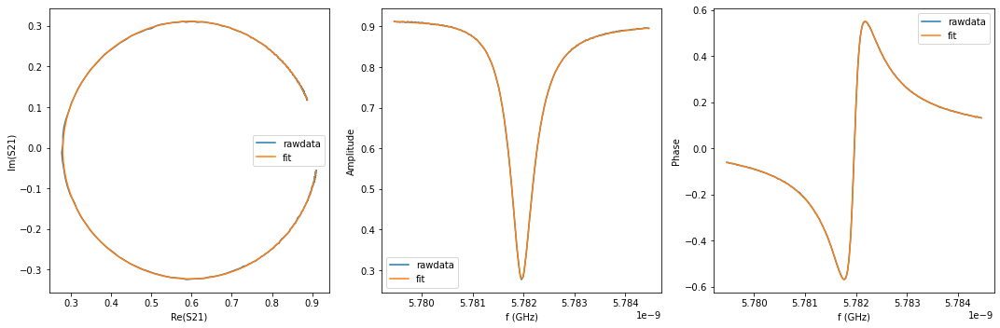

{'Qi_dia_corr': 25394.483603800036, 'Qi_no_corr': 25608.546301167036, 'absQc': 11215.170540348747, 'Qc_dia_corr(Re{Qc})': 11256.72663082125, 'Ql': 7799.435762937589, 'fr': 5.781941762591392, 'theta0': -3.0556411628356686, 'phi0': 0.08595278956331306, 'phi0_err': 0.00042391185309866117, 'Ql_err': 4.227047591826306, 'absQc_err': 4.396262020681545, 'fr_err': 2.0732686219857937e-07, 'chi_square': 1.5162687565379925e-06, 'Qi_no_corr_err': 33.98542957423542, 'Qi_dia_corr_err': 33.54716727434582, 'delay': 0.3095039857025192, 'a': 0.9124850576268738, 'alpha': -1.2863857988940357}


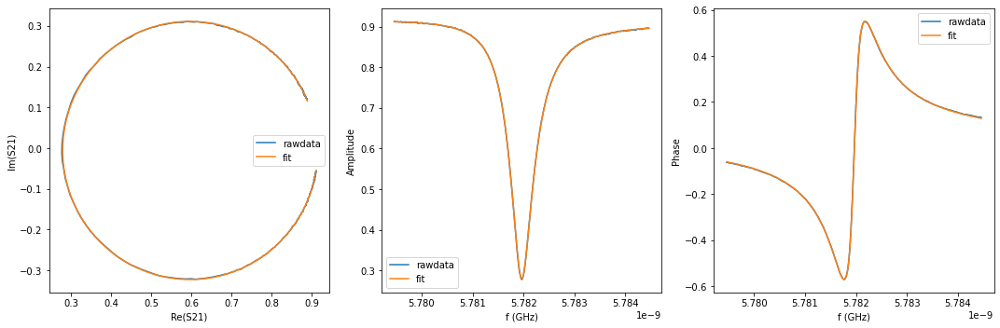

{'Qi_dia_corr': 25248.967863589965, 'Qi_no_corr': 25462.57451600896, 'absQc': 11136.379198084982, 'Qc_dia_corr(Re{Qc})': 11177.737887017382, 'Ql': 7747.786654911233, 'fr': 5.781941374428302, 'theta0': -3.0555417528722613, 'phi0': 0.08605090071753203, 'phi0_err': 0.0006526878246428147, 'Ql_err': 5.9462944329438105, 'absQc_err': 5.731830112732362, 'fr_err': 2.7744058469533435e-07, 'chi_square': 2.8754967431274907e-06, 'Qi_no_corr_err': 44.8654377072115, 'Qi_dia_corr_err': 44.04895858795774, 'delay': 0.48792824540597546, 'a': 0.9131404425421582, 'alpha': -1.0876519414655985}


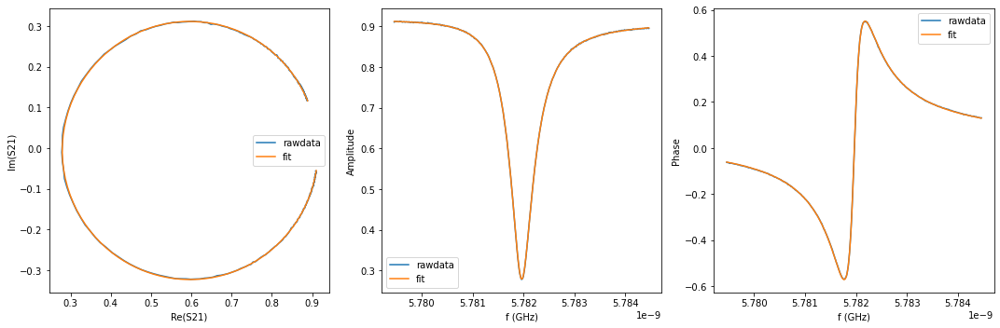

{'Qi_dia_corr': 25339.684705796262, 'Qi_no_corr': 25553.18706237479, 'absQc': 11156.48864485089, 'Qc_dia_corr(Re{Qc})': 11197.680560913104, 'Ql': 7765.904650719131, 'fr': 5.781941655265262, 'theta0': -3.0557952237742727, 'phi0': 0.08580057157190842, 'phi0_err': 0.0004329475837947349, 'Ql_err': 4.731666108629864, 'absQc_err': 4.955010277187294, 'fr_err': 2.1124946928321457e-07, 'chi_square': 1.7145177386326377e-06, 'Qi_no_corr_err': 33.602880828467896, 'Qi_dia_corr_err': 33.00002161239601, 'delay': 0.4387496757852078, 'a': 0.913130499213326, 'alpha': -2.8741976303069867}


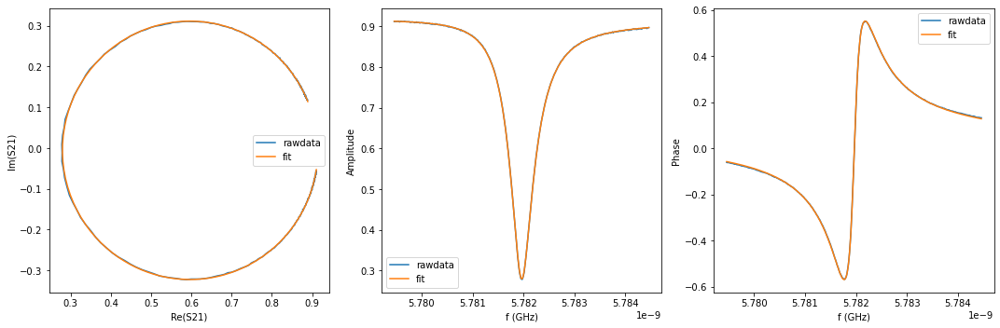

{'Qi_dia_corr': 25226.97312077138, 'Qi_no_corr': 25433.987890896977, 'absQc': 11115.765311460487, 'Qc_dia_corr(Re{Qc})': 11155.774599918937, 'Ql': 7735.16140490665, 'fr': 5.781942189329097, 'theta0': -3.056876064943539, 'phi0': 0.08471794812331225, 'phi0_err': 0.0010226313851908805, 'Ql_err': 7.9613943473510735, 'absQc_err': 6.871598601667709, 'fr_err': 3.991161039500906e-07, 'chi_square': 4.9709325483428095e-06, 'Qi_no_corr_err': 65.8795491720621, 'Qi_dia_corr_err': 64.28740927628546, 'delay': 0.6171353555131758, 'a': 0.9134748669748572, 'alpha': -2.676709809866376}


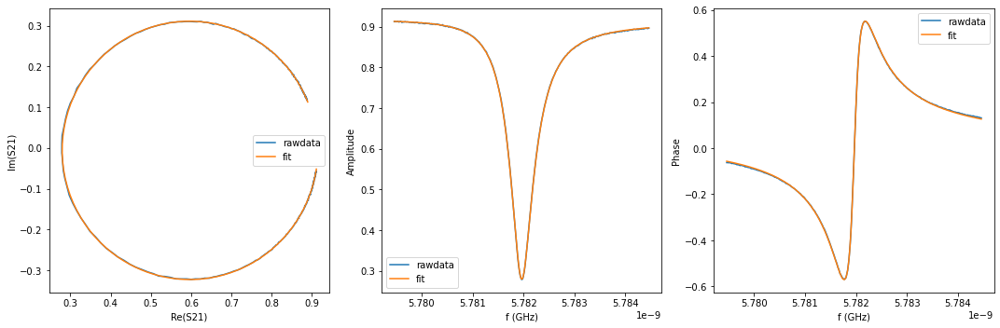

{'Qi_dia_corr': 25150.258870504553, 'Qi_no_corr': 25360.716501001392, 'absQc': 11074.320541151506, 'Qc_dia_corr(Re{Qc})': 11114.935379548719, 'Ql': 7708.313933108725, 'fr': 5.781942102023074, 'theta0': -3.056079186517834, 'phi0': 0.08551380393602645, 'phi0_err': 0.0014177693504168077, 'Ql_err': 10.061420726490105, 'absQc_err': 8.495060297750861, 'fr_err': 5.514462271578686e-07, 'chi_square': 8.210071175640606e-06, 'Qi_no_corr_err': 84.45471106825319, 'Qi_dia_corr_err': 83.04159864788478, 'delay': 0.7277196432587671, 'a': 0.9139120854765318, 'alpha': 1.340695033577576}


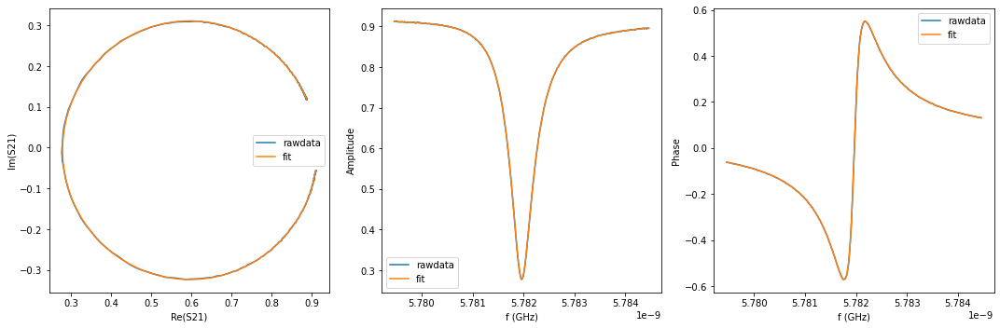

{'Qi_dia_corr': 25400.69635666255, 'Qi_no_corr': 25619.441382424597, 'absQc': 11190.08830573873, 'Qc_dia_corr(Re{Qc})': 11232.338294317566, 'Ql': 7788.304111508818, 'fr': 5.781941325129669, 'theta0': -3.054830677686115, 'phi0': 0.08676197590367798, 'phi0_err': 0.00036885543021333963, 'Ql_err': 4.2209712614814245, 'absQc_err': 4.5001129015181, 'fr_err': 1.8455927512925717e-07, 'chi_square': 1.3567427046802066e-06, 'Qi_no_corr_err': 31.51334658724599, 'Qi_dia_corr_err': 31.017284609886186, 'delay': 0.3455176626141384, 'a': 0.9125929185890532, 'alpha': 0.02163978957036945}


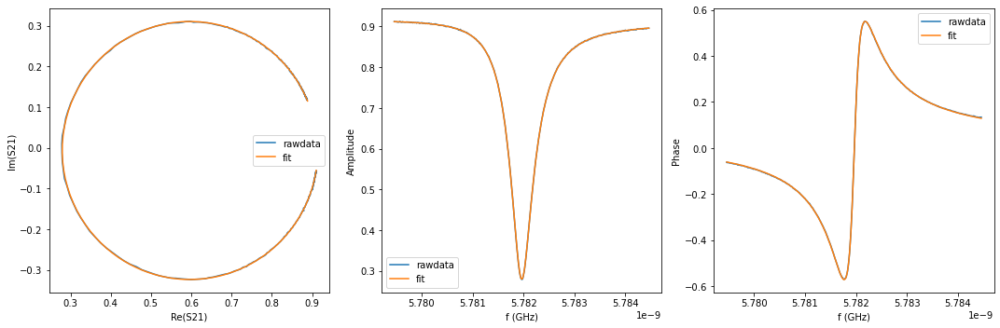

{'Qi_dia_corr': 25312.01743423799, 'Qi_no_corr': 25529.00810257682, 'absQc': 11158.823226009845, 'Qc_dia_corr(Re{Qc})': 11200.794056730336, 'Ql': 7764.800432072908, 'fr': 5.781941726352754, 'theta0': -3.054997607042784, 'phi0': 0.08659644844106049, 'phi0_err': 0.0005265385054374848, 'Ql_err': 5.164808992864184, 'absQc_err': 4.991449265249898, 'fr_err': 2.3591664388073166e-07, 'chi_square': 2.1020494241400163e-06, 'Qi_no_corr_err': 40.246282398443746, 'Qi_dia_corr_err': 39.47872243371148, 'delay': 0.4662404232611708, 'a': 0.9130893228906505, 'alpha': -1.8759216673836223}


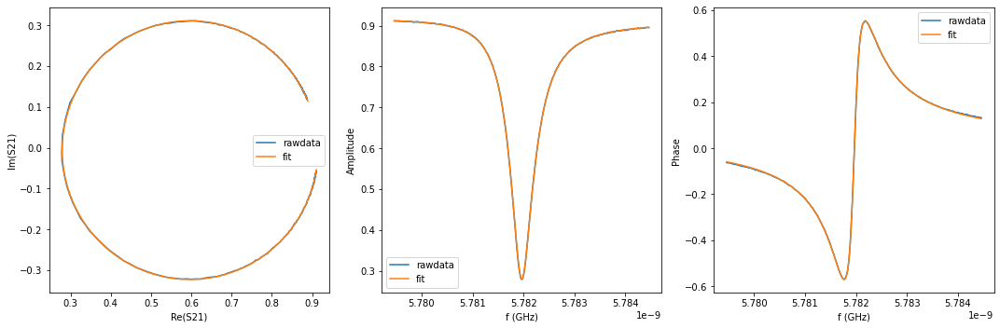

{'Qi_dia_corr': 25259.324019210067, 'Qi_no_corr': 25468.68303929826, 'absQc': 11125.037715847944, 'Qc_dia_corr(Re{Qc})': 11165.461936119666, 'Ql': 7742.860073755241, 'fr': 5.781942129480003, 'theta0': -3.056473613770638, 'phi0': 0.08511940756370323, 'phi0_err': 0.000968293207350342, 'Ql_err': 7.877333802191305, 'absQc_err': 6.958993199659869, 'fr_err': 3.8567727026402525e-07, 'chi_square': 4.889919260414961e-06, 'Qi_no_corr_err': 63.65858439801897, 'Qi_dia_corr_err': 62.35100107218092, 'delay': 0.5679803523961144, 'a': 0.9133167985626447, 'alpha': 1.8200210573138358}


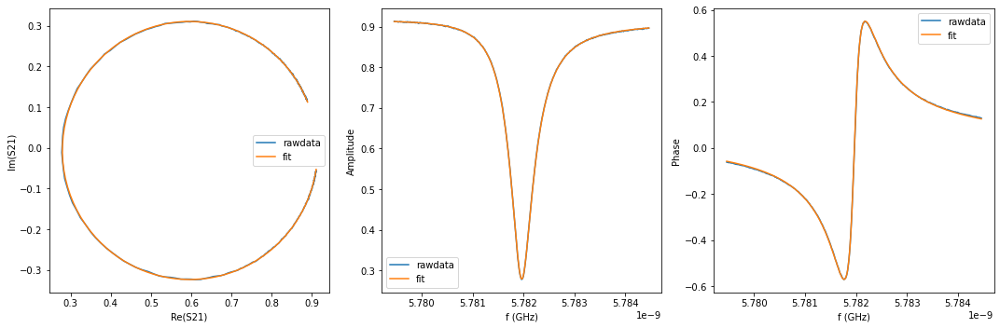

{'Qi_dia_corr': 25213.273024228274, 'Qi_no_corr': 25425.305358134196, 'absQc': 11094.907773345707, 'Qc_dia_corr(Re{Qc})': 11135.772701892896, 'Ql': 7724.254429788433, 'fr': 5.781942088040948, 'theta0': -3.055896152356476, 'phi0': 0.08569650123331687, 'phi0_err': 0.001159176233452622, 'Ql_err': 8.614390232071576, 'absQc_err': 7.5633509051364225, 'fr_err': 4.564640778584939e-07, 'chi_square': 6.160845912822442e-06, 'Qi_no_corr_err': 70.90641115317622, 'Qi_dia_corr_err': 69.64644614469, 'delay': 0.6859630613123486, 'a': 0.913628946744175, 'alpha': -0.17683932391503823}


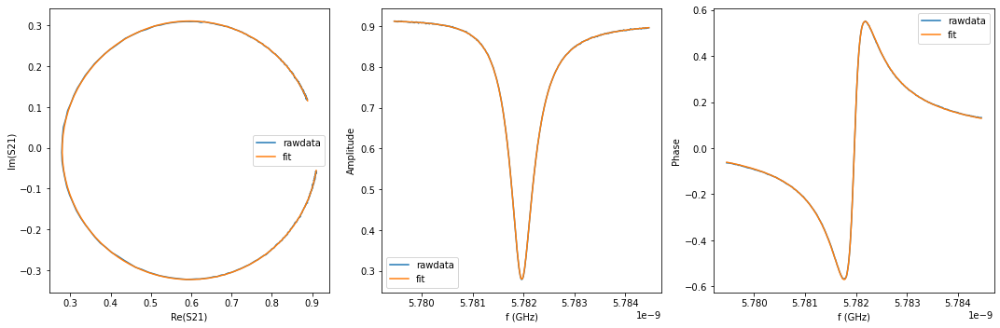

{'Qi_dia_corr': 25303.933818855086, 'Qi_no_corr': 25514.08494593914, 'absQc': 11164.74934239059, 'Qc_dia_corr(Re{Qc})': 11205.47263077841, 'Ql': 7766.287251187433, 'fr': 5.781942083962773, 'theta0': -3.0563129683146575, 'phi0': 0.08528112938704512, 'phi0_err': 0.0005482296490066469, 'Ql_err': 5.221619225145678, 'absQc_err': 5.137521440873592, 'fr_err': 2.3786393567900966e-07, 'chi_square': 2.1674275373127974e-06, 'Qi_no_corr_err': 39.10657223015057, 'Qi_dia_corr_err': 38.33694377549775, 'delay': 0.44684181741448054, 'a': 0.9130022085706615, 'alpha': -2.580768321706407}


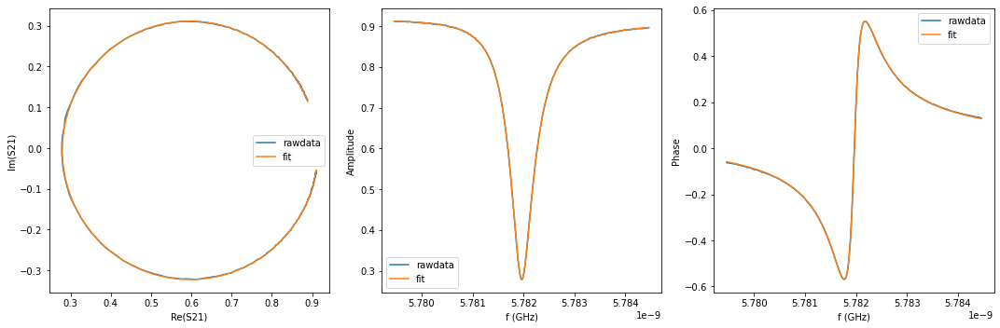

{'Qi_dia_corr': 25196.527545140543, 'Qi_no_corr': 25401.712465419347, 'absQc': 11112.870043206345, 'Qc_dia_corr(Re{Qc})': 11152.602388966689, 'Ql': 7730.772477993321, 'fr': 5.781942224312601, 'theta0': -3.0571578167616944, 'phi0': 0.08443606989716464, 'phi0_err': 0.0008600491844613012, 'Ql_err': 7.628889504015687, 'absQc_err': 6.450902875659719, 'fr_err': 3.4539158093895165e-07, 'chi_square': 4.11684888255043e-06, 'Qi_no_corr_err': 63.379716911614764, 'Qi_dia_corr_err': 61.961354946410275, 'delay': 0.5834888673695237, 'a': 0.9133440980120154, 'alpha': 2.3839624731936286}


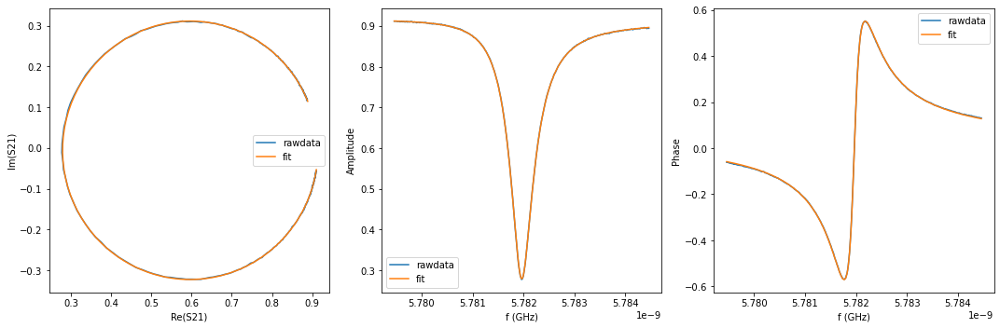

{'Qi_dia_corr': 25253.66045293293, 'Qi_no_corr': 25464.69628141425, 'absQc': 11124.835363305616, 'Qc_dia_corr(Re{Qc})': 11165.598628166214, 'Ql': 7742.3935473684905, 'fr': 5.781941878227592, 'theta0': -3.056118437804885, 'phi0': 0.08547531051878239, 'phi0_err': 0.0008242466678081335, 'Ql_err': 7.153700378748166, 'absQc_err': 6.377045203115464, 'fr_err': 3.320006915947932e-07, 'chi_square': 3.837799064148258e-06, 'Qi_no_corr_err': 57.71239860286851, 'Qi_dia_corr_err': 55.962628532209976, 'delay': 0.5878334958396951, 'a': 0.9131395441933201, 'alpha': 2.541794155033121}


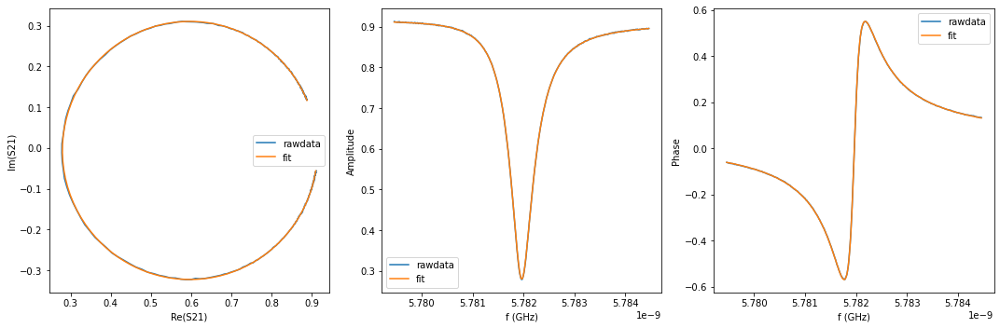

{'Qi_dia_corr': 25336.999945401367, 'Qi_no_corr': 25552.68900717017, 'absQc': 11194.783359883584, 'Qc_dia_corr(Re{Qc})': 11236.6907334107, 'Ql': 7784.394388829185, 'fr': 5.781941550390156, 'theta0': -3.0552013517453243, 'phi0': 0.08639250628878867, 'phi0_err': 0.00043176438736558943, 'Ql_err': 4.186647130214116, 'absQc_err': 4.440740703951685, 'fr_err': 2.1688850419053967e-07, 'chi_square': 1.5588430858625895e-06, 'Qi_no_corr_err': 32.64906143005247, 'Qi_dia_corr_err': 32.100039133479434, 'delay': 0.3547226475618541, 'a': 0.9123287211907771, 'alpha': 0.35631360299333087}


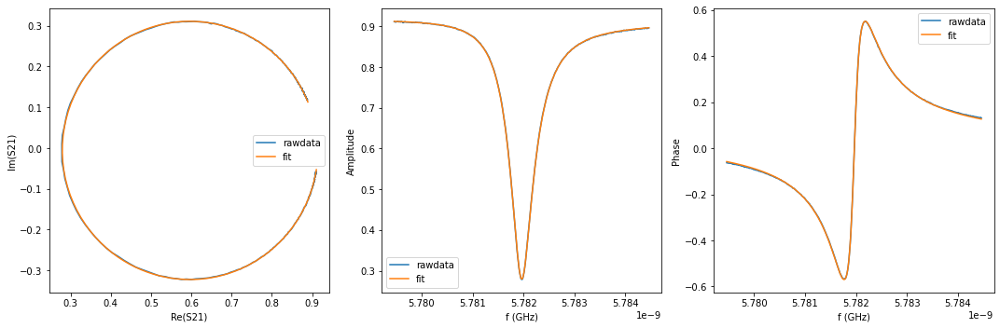

{'Qi_dia_corr': 25163.038466113554, 'Qi_no_corr': 25367.51879902741, 'absQc': 11090.28098658462, 'Qc_dia_corr(Re{Qc})': 11129.821400947005, 'Ql': 7716.672785193934, 'fr': 5.7819423996308545, 'theta0': -3.057274678768583, 'phi0': 0.08431797482120973, 'phi0_err': 0.0013832768480352804, 'Ql_err': 10.012866286285163, 'absQc_err': 7.99820535442444, 'fr_err': 5.291932285790694e-07, 'chi_square': 7.305200365319709e-06, 'Qi_no_corr_err': 85.82237277782298, 'Qi_dia_corr_err': 84.02789711032854, 'delay': 0.6672199261650209, 'a': 0.9134570641259755, 'alpha': -0.8579359586268728}


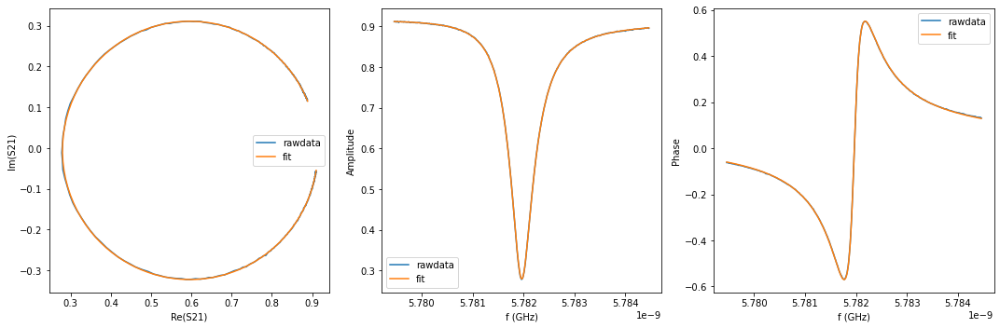

{'Qi_dia_corr': 25268.80002640268, 'Qi_no_corr': 25475.044797123508, 'absQc': 11137.77267320596, 'Qc_dia_corr(Re{Qc})': 11177.659786569868, 'Ql': 7749.615500638133, 'fr': 5.781942090336157, 'theta0': -3.0570901512540036, 'phi0': 0.08450552220616321, 'phi0_err': 0.0006045039611500207, 'Ql_err': 5.529988094424306, 'absQc_err': 5.411150603602559, 'fr_err': 2.702637281793261e-07, 'chi_square': 2.5831292412037783e-06, 'Qi_no_corr_err': 42.840291107228175, 'Qi_dia_corr_err': 41.94310642882281, 'delay': 0.5039005986876823, 'a': 0.9130079351238131, 'alpha': -0.5077948104997521}


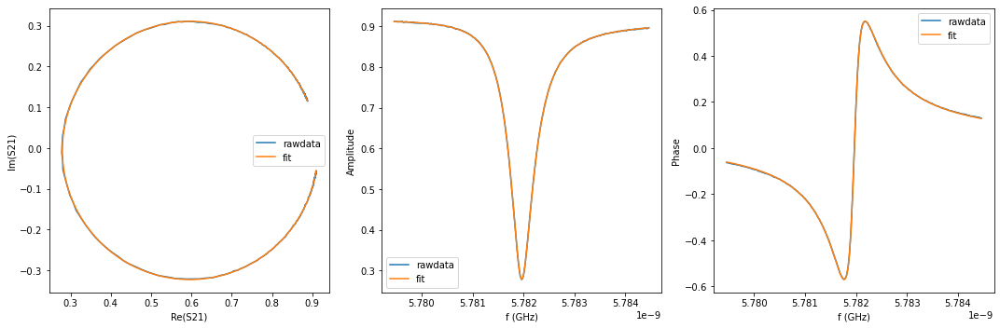

{'Qi_dia_corr': 25262.27940462246, 'Qi_no_corr': 25467.099466930762, 'absQc': 11139.211070668152, 'Qc_dia_corr(Re{Qc})': 11178.854591255673, 'Ql': 7749.576293094779, 'fr': 5.781942129983192, 'theta0': -3.057350087515673, 'phi0': 0.08424242894435845, 'phi0_err': 0.0006893164214201138, 'Ql_err': 5.939470890535802, 'absQc_err': 5.435182596412242, 'fr_err': 2.8894955562516074e-07, 'chi_square': 2.8574565328489032e-06, 'Qi_no_corr_err': 47.82353184189177, 'Qi_dia_corr_err': 46.95039427772054, 'delay': 0.4985571256053213, 'a': 0.9127304836601797, 'alpha': -0.7022463059041638}


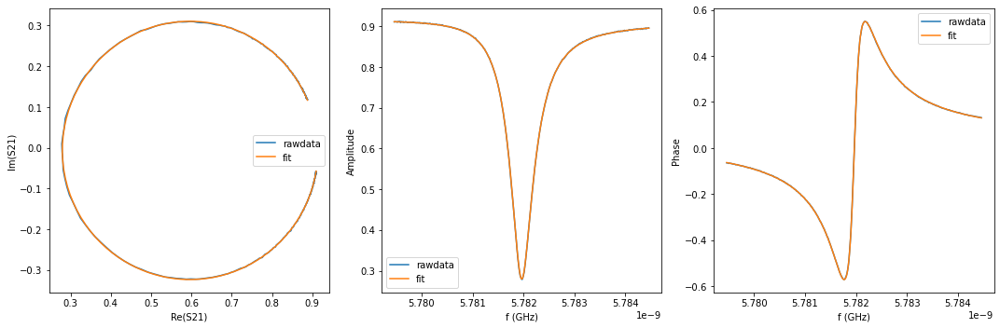

{'Qi_dia_corr': 25348.292777145805, 'Qi_no_corr': 25564.524484769132, 'absQc': 11199.05206496829, 'Qc_dia_corr(Re{Qc})': 11241.059042742614, 'Ql': 7787.556804593077, 'fr': 5.781941477760855, 'theta0': -3.0551142948929684, 'phi0': 0.08647835869682471, 'phi0_err': 0.0004061268023739301, 'Ql_err': 4.395996154659737, 'absQc_err': 4.54956402323141, 'fr_err': 1.9750271691626822e-07, 'chi_square': 1.5114278341947522e-06, 'Qi_no_corr_err': 33.69118090131865, 'Qi_dia_corr_err': 33.24468965460022, 'delay': 0.30979531217254397, 'a': 0.9123567578910174, 'alpha': -1.2764277484059565}


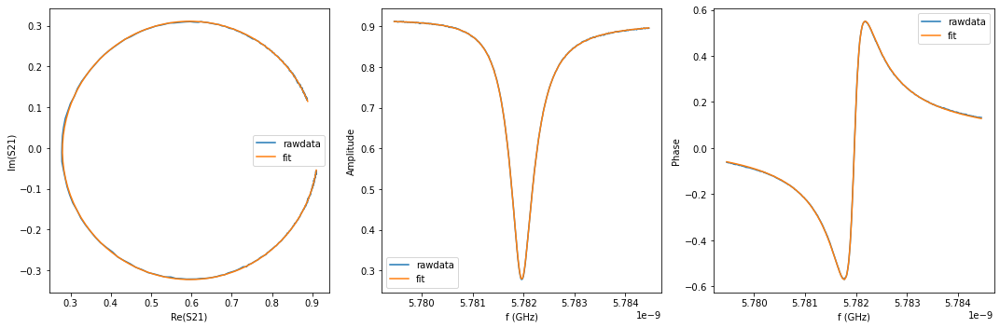

{'Qi_dia_corr': 25228.895878455867, 'Qi_no_corr': 25437.636951231256, 'absQc': 11134.620941393809, 'Qc_dia_corr(Re{Qc})': 11175.093391847045, 'Ql': 7744.625610164162, 'fr': 5.78194202427417, 'theta0': -3.0564609417065367, 'phi0': 0.08513346831365372, 'phi0_err': 0.0008289772926728561, 'Ql_err': 7.163622675687198, 'absQc_err': 6.5287652832408885, 'fr_err': 3.3047822774193337e-07, 'chi_square': 3.984683411488033e-06, 'Qi_no_corr_err': 56.12607797662698, 'Qi_dia_corr_err': 54.84470760854239, 'delay': 0.5458612151099093, 'a': 0.9129936581334194, 'alpha': 1.016763274617395}


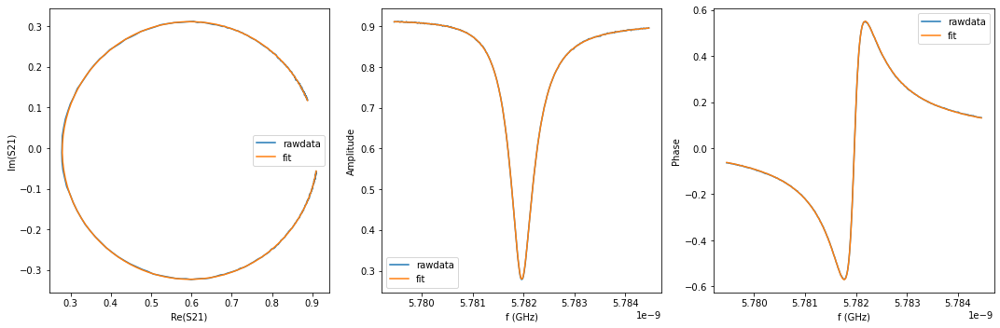

{'Qi_dia_corr': 25313.852674881975, 'Qi_no_corr': 25526.77706622086, 'absQc': 11173.78905946563, 'Qc_dia_corr(Re{Qc})': 11215.081836970896, 'Ql': 7771.8371245048875, 'fr': 5.781941874359668, 'theta0': -3.0557537494213047, 'phi0': 0.08583890416848818, 'phi0_err': 0.0004353065580963863, 'Ql_err': 4.3997673064348914, 'absQc_err': 4.660691517874972, 'fr_err': 2.1577397702486397e-07, 'chi_square': 1.6579206467575507e-06, 'Qi_no_corr_err': 32.87519199203842, 'Qi_dia_corr_err': 32.33817661646894, 'delay': 0.3532726099780398, 'a': 0.9124810645023778, 'alpha': 0.3034304278667546}


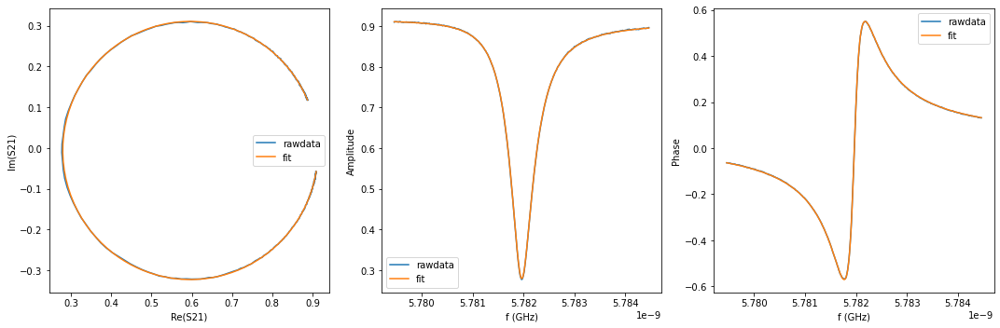

{'Qi_dia_corr': 25425.405278452705, 'Qi_no_corr': 25639.34326858375, 'absQc': 11239.936155297335, 'Qc_dia_corr(Re{Qc})': 11281.55076027453, 'Ql': 7814.268226076582, 'fr': 5.781941636401183, 'theta0': -3.055674076664222, 'phi0': 0.08591857692557137, 'phi0_err': 0.0005188879774613997, 'Ql_err': 4.693893021509676, 'absQc_err': 4.970737303760519, 'fr_err': 2.5753834418622643e-07, 'chi_square': 2.0219800704531387e-06, 'Qi_no_corr_err': 40.20989334743663, 'Qi_dia_corr_err': 39.766609922297114, 'delay': 0.2370088724215713, 'a': 0.9120184183567959, 'alpha': 2.3626734603862727}


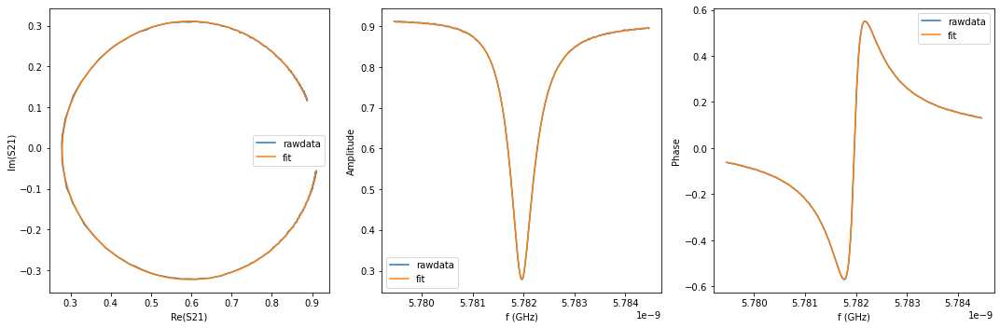

{'Qi_dia_corr': 25390.217172157805, 'Qi_no_corr': 25602.71143443256, 'absQc': 11193.068089352, 'Qc_dia_corr(Re{Qc})': 11234.172180726167, 'Ql': 7788.200061705331, 'fr': 5.7819418599754915, 'theta0': -3.056023279946416, 'phi0': 0.08556959825909677, 'phi0_err': 0.00041815235816426585, 'Ql_err': 4.534262343847703, 'absQc_err': 4.636163871866584, 'fr_err': 1.9928592916499197e-07, 'chi_square': 1.5760235199733428e-06, 'Qi_no_corr_err': 34.071699191980485, 'Qi_dia_corr_err': 33.657959348660455, 'delay': 0.3339636808391018, 'a': 0.9123280115079663, 'alpha': -0.39809306749142226}


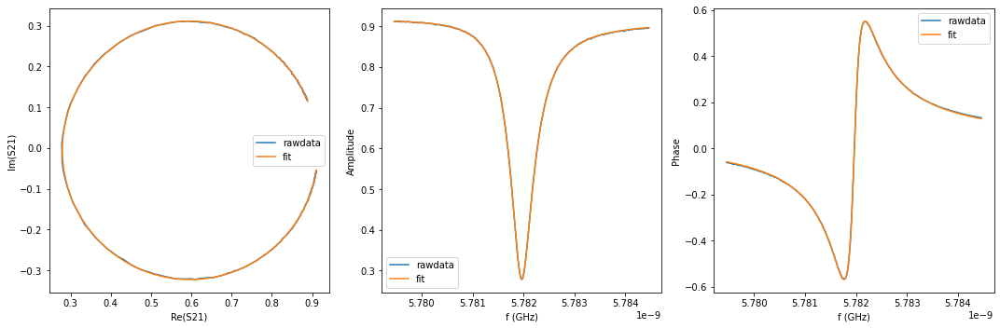

{'Qi_dia_corr': 25168.014235707313, 'Qi_no_corr': 25373.81029472968, 'absQc': 11100.22807286481, 'Qc_dia_corr(Re{Qc})': 11140.07754108794, 'Ql': 7722.0701067020345, 'fr': 5.781942198292112, 'theta0': -3.0569854979806044, 'phi0': 0.08460805307954157, 'phi0_err': 0.0009675812675802142, 'Ql_err': 7.720686625165381, 'absQc_err': 6.68009457513912, 'fr_err': 4.024479829279138e-07, 'chi_square': 4.77572739543507e-06, 'Qi_no_corr_err': 65.43382591063038, 'Qi_dia_corr_err': 64.25569008461144, 'delay': 0.594621247133274, 'a': 0.9132360174521574, 'alpha': 2.7881959317234326}


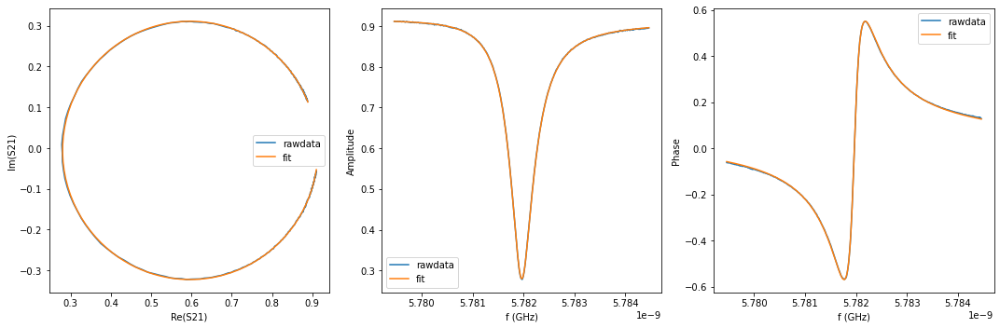

{'Qi_dia_corr': 25130.85190001228, 'Qi_no_corr': 25333.604013726304, 'absQc': 11084.362259827674, 'Qc_dia_corr(Re{Qc})': 11123.62841564489, 'Ql': 7710.667919396785, 'fr': 5.781942586632222, 'theta0': -3.0575443811674714, 'phi0': 0.08404827242232153, 'phi0_err': 0.001286526066836257, 'Ql_err': 9.526683058187627, 'absQc_err': 8.19821173786938, 'fr_err': 4.981465718293487e-07, 'chi_square': 7.333135120386413e-06, 'Qi_no_corr_err': 78.12665903465502, 'Qi_dia_corr_err': 76.94020545568183, 'delay': 0.6736851947807618, 'a': 0.9131897963691579, 'alpha': -0.6229670063449645}


In [24]:
%matplotlib inline
fr = np.array([])
Ql = np.array([])
Qc = np.array([])
Qi = np.array([])
fr_err = np.array([])
Ql_err = np.array([])
Qc_err = np.array([])
Qi_err = np.array([])
power_low = np.array([])

for i in range(len(P_l)):
    f, mag_corr, pha_corr = correct_data_with_ref(freq_l, mag_s_l[:,i], pha_s_l[:,i], f_ref_l, mag_ref_l, pha_ref_l)
    
    ss = db2mag(mag_corr)*np.exp(1j*pha_corr)
    port1 = notch_port(f/1e9, ss)
    port1.autofit(calc_errors = True)
    port1.plotall()
    print(port1.fitresults)
    power_low = np.append(power_low, P_l[i])
    fr = np.append(fr, port1.fitresults['fr'])
    Ql = np.append(Ql, port1.fitresults['Ql'])
    Qc = np.append(Qc, port1.fitresults['absQc'])
    Qi = np.append(Qi, port1.fitresults['Qi_dia_corr'])
    fr_err = np.append(fr_err, port1.fitresults['fr_err'])
    Ql_err = np.append(Ql_err, port1.fitresults['Ql_err'])
    Qc_err = np.append(Qc_err, port1.fitresults['absQc_err'])
    Qi_err = np.append(Qi_err, port1.fitresults['Qi_dia_corr_err'])
    

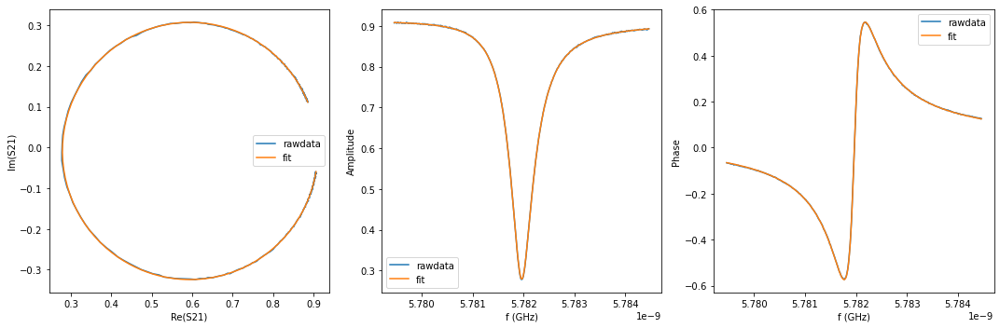

{'Qi_dia_corr': 25303.84036654678, 'Qi_no_corr': 25512.214189590773, 'absQc': 11177.274658184775, 'Qc_dia_corr(Re{Qc})': 11217.746232873187, 'Ql': 7772.172196745766, 'fr': 5.781941634832997, 'theta0': -3.0566254980005088, 'phi0': 0.08497044665407313, 'chi_square': 2.325163714246481e-06, 'delay': 0.4309696814952608, 'a': 0.9097335823623356, 'alpha': 3.1216073074916824}


In [25]:
i=250
f, mag_corr, pha_corr = correct_data_with_ref(freq_l, mag_s_l[:,i], pha_s_l[:,i], f_ref_l, mag_ref_l, pha_ref_l)

ss = db2mag(mag_corr)*np.exp(1j*pha_corr)
port1 = notch_port(f/1e9, ss)
port1.autofit()
port1.plotall()
print(port1.fitresults)

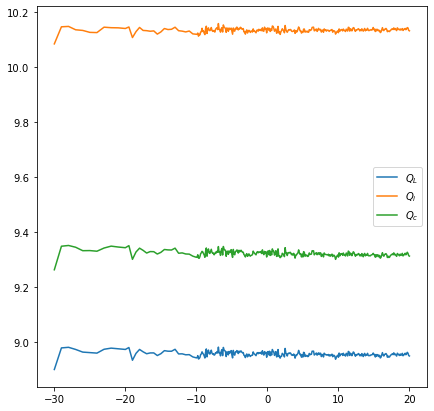

In [26]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(7,7)) 
# ax.plot(powers, fr, "--", label = r'$f_{r}$')
ax.plot(P_l[:len(Ql)], np.log(Ql), label = r'$Q_{L}$')
ax.plot(P_l[:len(Ql)], np.log(Qi), label = r'$Q_{i}$')
ax.plot(P_l[:len(Ql)], np.log(Qc), label = r'$Q_{c}$')
ax.legend()

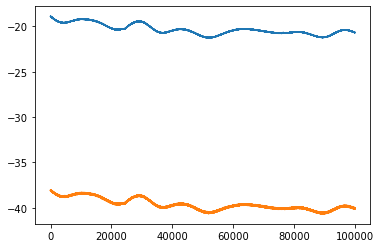

In [27]:
plt.plot(mag_ref_h)
plt.plot(mag_ref_l)

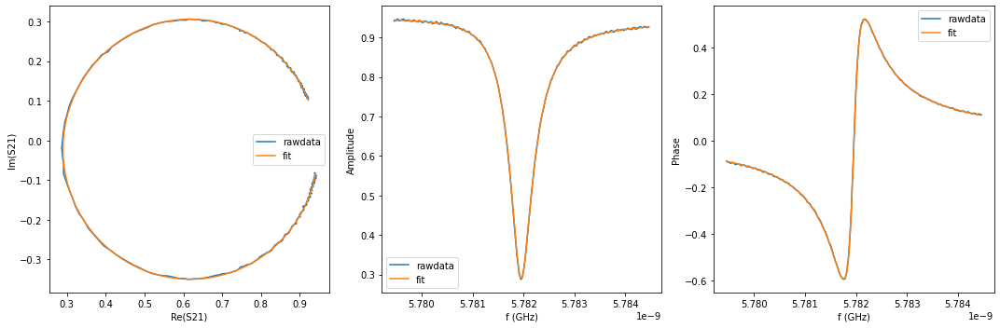

{'Qi_dia_corr': 25223.537754560173, 'Qi_no_corr': 25462.58138621086, 'absQc': 11188.284611398542, 'Qc_dia_corr(Re{Qc})': 11235.06976159559, 'Ql': 7772.875203232789, 'fr': 5.781928585315094, 'theta0': -3.0503008038872244, 'phi0': 0.09129183738600315, 'phi0_err': 0.0009836014627666837, 'Ql_err': 9.26157811954442, 'absQc_err': 9.088055781120831, 'fr_err': 4.5788988871210695e-07, 'chi_square': 6.805856999412954e-06, 'Qi_no_corr_err': 75.81622514259581, 'Qi_dia_corr_err': 74.13296060442312, 'delay': 0.1811826897808102, 'a': 0.9446104413872988, 'alpha': 0.3119158934258025}


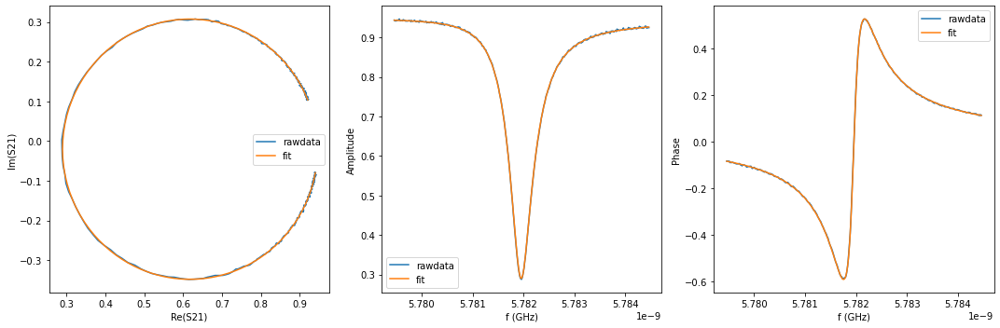

{'Qi_dia_corr': 25296.969765757403, 'Qi_no_corr': 25537.765490786125, 'absQc': 11199.816460827313, 'Qc_dia_corr(Re{Qc})': 11246.766500153975, 'Ql': 7785.441259938252, 'fr': 5.78192881630266, 'theta0': -3.0501875729801498, 'phi0': 0.09140508060964342, 'phi0_err': 0.000862744496770762, 'Ql_err': 9.065172659376111, 'absQc_err': 8.855122375182265, 'fr_err': 4.0600062616626516e-07, 'chi_square': 5.936263614148226e-06, 'Qi_no_corr_err': 73.68690445283282, 'Qi_dia_corr_err': 72.47326501462241, 'delay': 0.21495192398644175, 'a': 0.9443376867447326, 'alpha': 1.541275833762805}


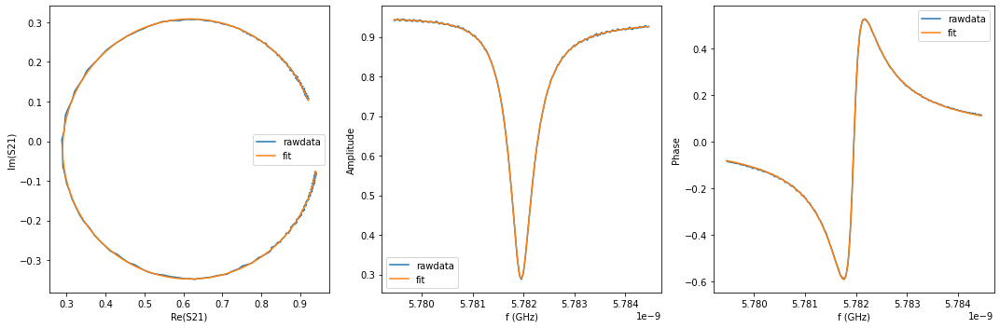

{'Qi_dia_corr': 25189.788213906217, 'Qi_no_corr': 25430.561659769857, 'absQc': 11164.723411019004, 'Qc_dia_corr(Re{Qc})': 11211.772407188706, 'Ql': 7758.518250888827, 'fr': 5.781928974709444, 'theta0': -3.0499490592744416, 'phi0': 0.09164420995344287, 'phi0_err': 0.0010063899076305624, 'Ql_err': 9.629919067192885, 'absQc_err': 9.091185107398626, 'fr_err': 4.6223706459341173e-07, 'chi_square': 7.094298332608287e-06, 'Qi_no_corr_err': 79.98352805474127, 'Qi_dia_corr_err': 77.9384936461043, 'delay': 0.3710548958558421, 'a': 0.9442850152829517, 'alpha': 0.9305293007010345}


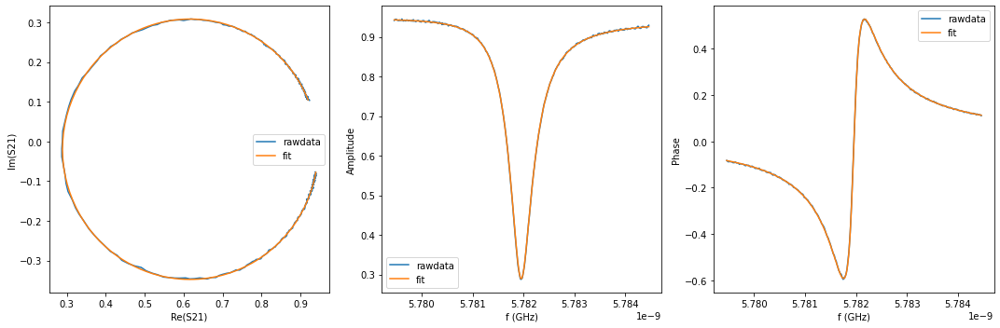

{'Qi_dia_corr': 25348.473187173317, 'Qi_no_corr': 25594.203649013587, 'absQc': 11194.024052514254, 'Qc_dia_corr(Re{Qc})': 11241.687264431515, 'Ql': 7787.875338178022, 'fr': 5.7819286488483534, 'theta0': -3.049474718854976, 'phi0': 0.09211799269829296, 'phi0_err': 0.0008218593500428333, 'Ql_err': 8.553145314305146, 'absQc_err': 8.286162667247742, 'fr_err': 3.8105807232755393e-07, 'chi_square': 5.301759396372001e-06, 'Qi_no_corr_err': 68.29239315254645, 'Qi_dia_corr_err': 67.01324244924476, 'delay': 0.242136852907439, 'a': 0.9433307752053651, 'alpha': 2.5306516980559426}


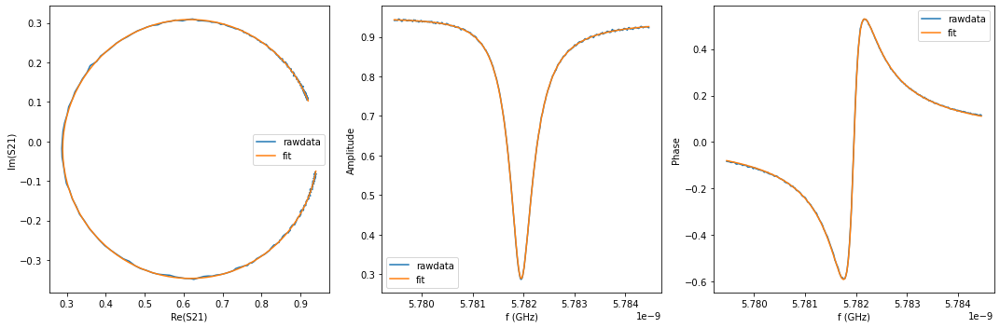

{'Qi_dia_corr': 25245.887751192473, 'Qi_no_corr': 25483.183967807337, 'absQc': 11147.498851895205, 'Qc_dia_corr(Re{Qc})': 11193.523526880017, 'Ql': 7755.076950707887, 'fr': 5.78192917554785, 'theta0': -3.0508788522791037, 'phi0': 0.09071432540948271, 'phi0_err': 0.0009775427626025192, 'Ql_err': 10.00828079665348, 'absQc_err': 9.427638770538701, 'fr_err': 4.4244039601330767e-07, 'chi_square': 7.106566468171151e-06, 'Qi_no_corr_err': 81.18310233486811, 'Qi_dia_corr_err': 78.7961076421132, 'delay': 0.42260139566683896, 'a': 0.9436550888356025, 'alpha': 2.803847317497245}


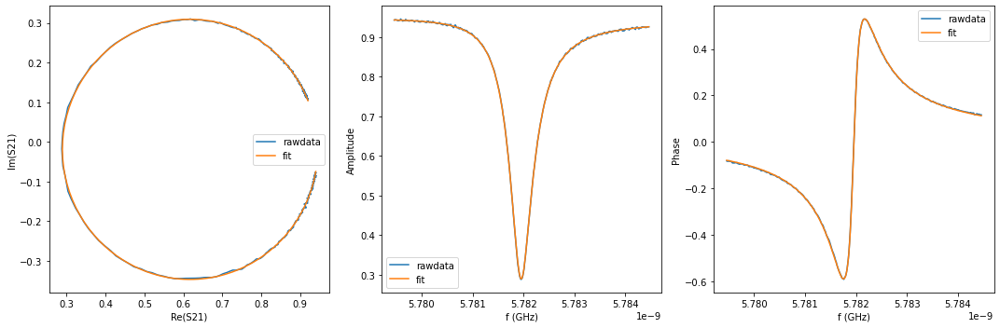

{'Qi_dia_corr': 25225.10163551922, 'Qi_no_corr': 25466.913840968642, 'absQc': 11141.668624786356, 'Qc_dia_corr(Re{Qc})': 11188.592586512399, 'Ql': 7750.748480290983, 'fr': 5.781928623629436, 'theta0': -3.0499760016540867, 'phi0': 0.09161709210261425, 'phi0_err': 0.001024502739241718, 'Ql_err': 10.87157054615223, 'absQc_err': 9.5654271837871, 'fr_err': 4.4254972802727734e-07, 'chi_square': 7.598302021984707e-06, 'Qi_no_corr_err': 88.86287389573475, 'Qi_dia_corr_err': 86.49412794435732, 'delay': 0.4053445346754635, 'a': 0.9437371449078023, 'alpha': 2.1778744591074646}


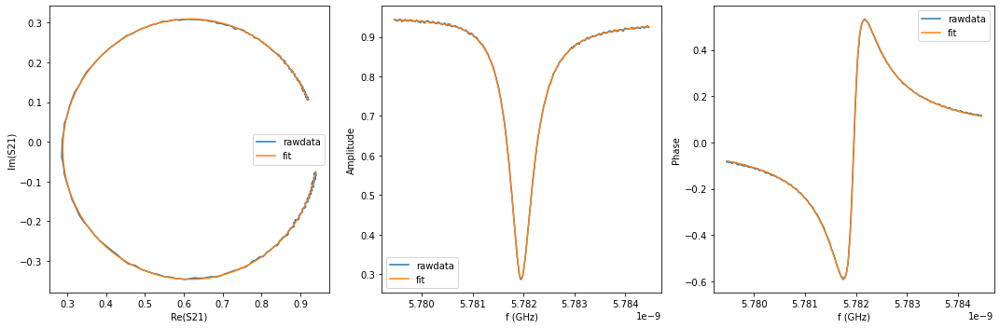

{'Qi_dia_corr': 25288.239769939162, 'Qi_no_corr': 25525.558323373854, 'absQc': 11146.976156978382, 'Qc_dia_corr(Re{Qc})': 11192.846868415885, 'Ql': 7758.7435408003075, 'fr': 5.781929256127842, 'theta0': -3.051029428666448, 'phi0': 0.09056510306699081, 'phi0_err': 0.001012676871807245, 'Ql_err': 10.759609025628437, 'absQc_err': 9.928946042488823, 'fr_err': 4.5674338117540356e-07, 'chi_square': 7.729785883784806e-06, 'Qi_no_corr_err': 88.44324440889997, 'Qi_dia_corr_err': 85.97182849225271, 'delay': 0.3837896867254678, 'a': 0.9434775393420447, 'alpha': 1.3950750440147355}


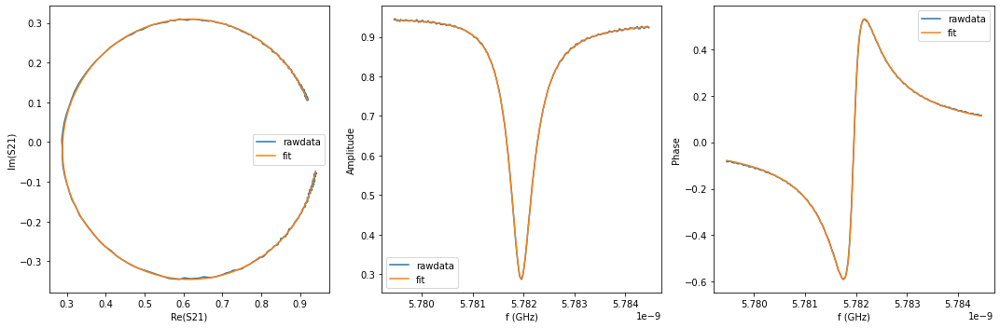

{'Qi_dia_corr': 25276.47917015841, 'Qi_no_corr': 25519.380678188754, 'absQc': 11161.00142440808, 'Qc_dia_corr(Re{Qc})': 11208.10772084737, 'Ql': 7764.963933653035, 'fr': 5.781928467807502, 'theta0': -3.0498796205793197, 'phi0': 0.09171503889831117, 'phi0_err': 0.0009021090470269267, 'Ql_err': 9.177200134807846, 'absQc_err': 9.091902297744491, 'fr_err': 4.264152613198195e-07, 'chi_square': 6.3594071485622915e-06, 'Qi_no_corr_err': 74.14410410591157, 'Qi_dia_corr_err': 72.13805268995097, 'delay': 0.4139520479087032, 'a': 0.9430822374367802, 'alpha': 2.4914935225798636}


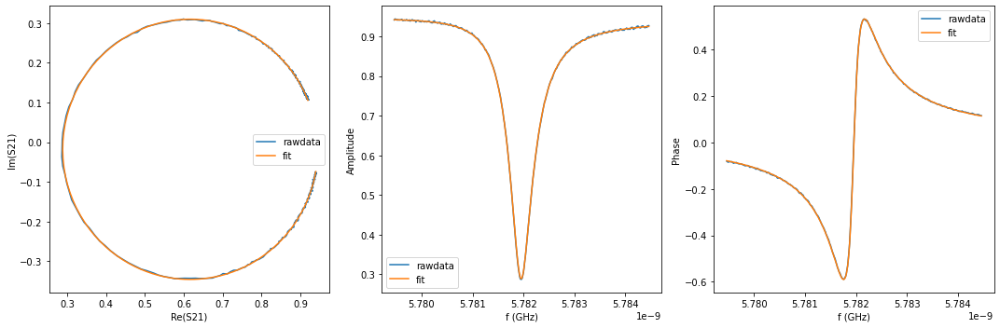

{'Qi_dia_corr': 25376.412209946822, 'Qi_no_corr': 25619.325985737487, 'absQc': 11187.51758246597, 'Qc_dia_corr(Re{Qc})': 11234.478966829576, 'Ql': 7787.048063093534, 'fr': 5.781928496469979, 'theta0': -3.050126513228985, 'phi0': 0.09146614490308473, 'phi0_err': 0.0008969434477860709, 'Ql_err': 9.104928728271762, 'absQc_err': 8.699127759463204, 'fr_err': 4.1543496662942184e-07, 'chi_square': 6.129991879873416e-06, 'Qi_no_corr_err': 75.96067749666575, 'Qi_dia_corr_err': 74.28523312939299, 'delay': 0.34285964275416525, 'a': 0.9428446443954327, 'alpha': -0.09089644171210186}


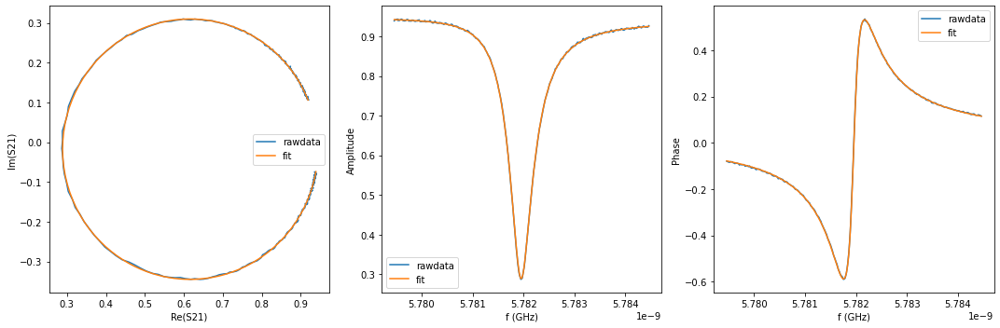

{'Qi_dia_corr': 25313.13355832272, 'Qi_no_corr': 25551.966073236505, 'absQc': 11175.565139234237, 'Qc_dia_corr(Re{Qc})': 11221.873358033283, 'Ql': 7775.030116644416, 'fr': 5.781928473739938, 'theta0': -3.0507142253317796, 'phi0': 0.09087842973452355, 'phi0_err': 0.0009192116105887981, 'Ql_err': 9.50576821661796, 'absQc_err': 8.91700527998385, 'fr_err': 4.275634229104659e-07, 'chi_square': 6.398493976486416e-06, 'Qi_no_corr_err': 79.16091334497331, 'Qi_dia_corr_err': 77.6807042518112, 'delay': 0.3329089385657649, 'a': 0.9427520905733467, 'alpha': -0.45216654331195383}


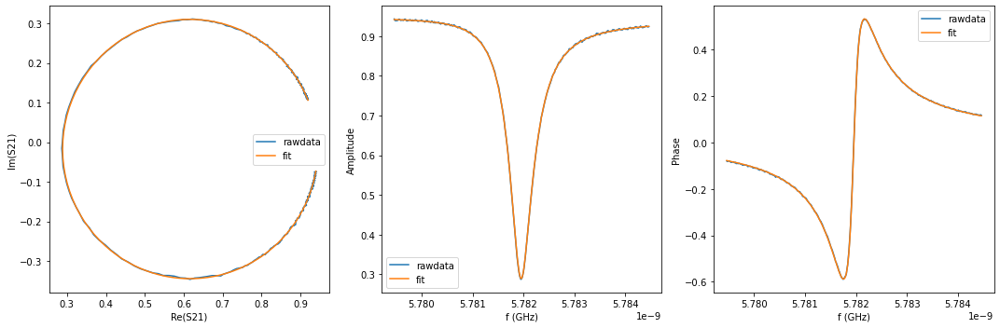

{'Qi_dia_corr': 25317.11285557761, 'Qi_no_corr': 25555.036146187023, 'absQc': 11174.009573087582, 'Qc_dia_corr(Re{Qc})': 11220.115061851071, 'Ql': 7774.561330033178, 'fr': 5.781928224673329, 'theta0': -3.0509064045088112, 'phi0': 0.0906862588719591, 'phi0_err': 0.0009172452278373148, 'Ql_err': 8.675885305898214, 'absQc_err': 8.703570307270436, 'fr_err': 4.4632018839939015e-07, 'chi_square': 5.9375618607016624e-06, 'Qi_no_corr_err': 74.34586700372166, 'Qi_dia_corr_err': 72.90026376590153, 'delay': 0.3593176855041653, 'a': 0.9427553608587, 'alpha': 0.5076873980037193}


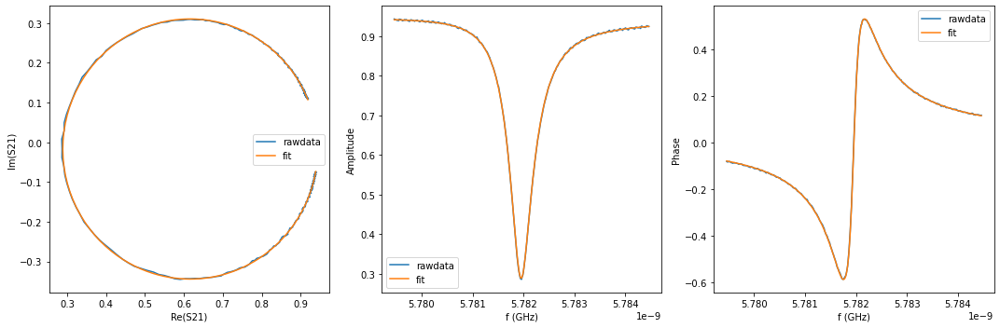

{'Qi_dia_corr': 25341.299913518138, 'Qi_no_corr': 25580.22471490781, 'absQc': 11190.800398071546, 'Qc_dia_corr(Re{Qc})': 11237.1499259188, 'Ql': 7785.020625419152, 'fr': 5.781928238143362, 'theta0': -3.0507359882787983, 'phi0': 0.09085711807896885, 'phi0_err': 0.0008690991062591381, 'Ql_err': 8.529791825812113, 'absQc_err': 8.714237935374243, 'fr_err': 4.282724884585863e-07, 'chi_square': 5.677374197984876e-06, 'Qi_no_corr_err': 70.73605967886496, 'Qi_dia_corr_err': 69.11110722923713, 'delay': 0.29205894967748575, 'a': 0.942377481685743, 'alpha': -1.9352130178470786}


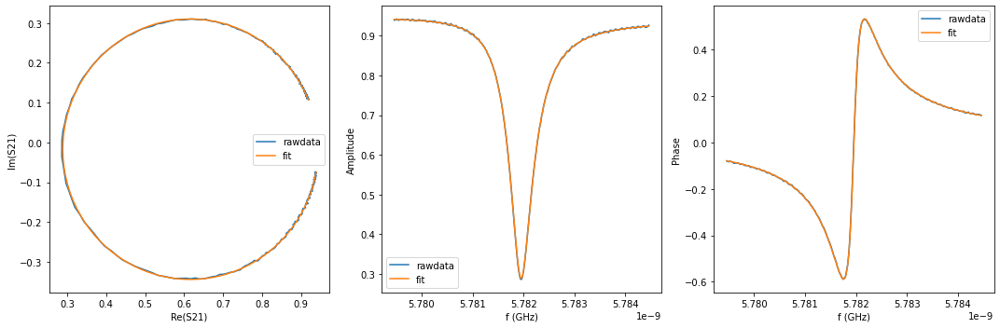

{'Qi_dia_corr': 25344.286675103074, 'Qi_no_corr': 25583.862820141578, 'absQc': 11195.67102477929, 'Qc_dia_corr(Re{Qc})': 11242.17583588997, 'Ql': 7787.7145720524695, 'fr': 5.78192809348539, 'theta0': -3.050605220752308, 'phi0': 0.09098893398872243, 'phi0_err': 0.0008381369494688276, 'Ql_err': 8.706026742724214, 'absQc_err': 8.625371764516435, 'fr_err': 4.09126615555469e-07, 'chi_square': 5.464359583481443e-06, 'Qi_no_corr_err': 71.51482521937572, 'Qi_dia_corr_err': 70.10246662085116, 'delay': 0.2760015956013065, 'a': 0.9420284969136989, 'alpha': -2.5189254907335545}


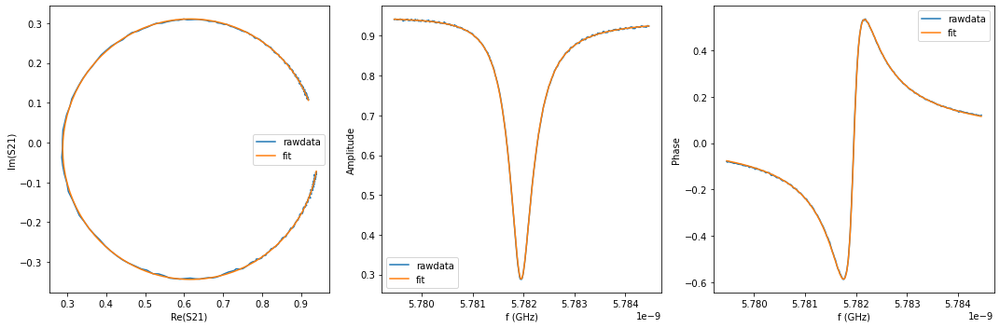

{'Qi_dia_corr': 25281.242536256534, 'Qi_no_corr': 25516.837281481865, 'absQc': 11160.034173562193, 'Qc_dia_corr(Re{Qc})': 11205.705652500512, 'Ql': 7764.260275351268, 'fr': 5.781928122706375, 'theta0': -3.0512773075191673, 'phi0': 0.09031617706266733, 'phi0_err': 0.0010009201126604465, 'Ql_err': 9.590968989888381, 'absQc_err': 9.12850786785952, 'fr_err': 4.625693332715397e-07, 'chi_square': 6.9000067810609075e-06, 'Qi_no_corr_err': 80.54862086470185, 'Qi_dia_corr_err': 78.3973173766472, 'delay': 0.39889968029105155, 'a': 0.9424828179867772, 'alpha': 1.9463598093735677}


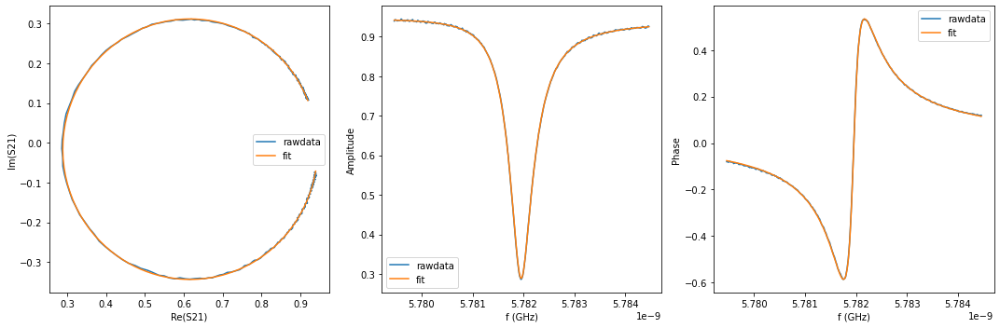

{'Qi_dia_corr': 25304.16648300812, 'Qi_no_corr': 25535.929467971593, 'absQc': 11160.612015408971, 'Qc_dia_corr(Re{Qc})': 11205.467791127394, 'Ql': 7766.306843219856, 'fr': 5.781928580593984, 'theta0': -3.052086374415723, 'phi0': 0.08950641621950595, 'phi0_err': 0.0009853525955093466, 'Ql_err': 9.837399893041745, 'absQc_err': 9.158750362005145, 'fr_err': 4.5358933756458256e-07, 'chi_square': 7.030027613812996e-06, 'Qi_no_corr_err': 83.36272780360243, 'Qi_dia_corr_err': 81.19688286486621, 'delay': 0.41630736039501376, 'a': 0.9426475075396181, 'alpha': 2.5791331982009904}


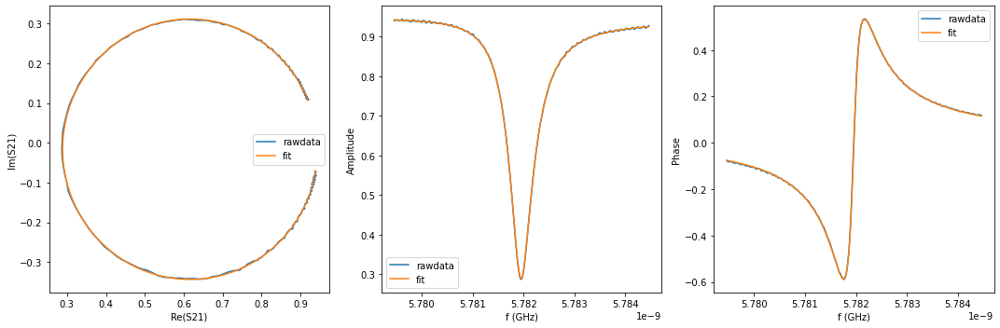

{'Qi_dia_corr': 25309.07604074993, 'Qi_no_corr': 25545.54515005419, 'absQc': 11158.249147566592, 'Qc_dia_corr(Re{Qc})': 11203.973871438811, 'Ql': 7766.0515172730575, 'fr': 5.781928060246735, 'theta0': -3.0512170356449677, 'phi0': 0.09037583254898686, 'phi0_err': 0.000978527685932754, 'Ql_err': 10.799988032791223, 'absQc_err': 9.643521769182577, 'fr_err': 4.3770403938917325e-07, 'chi_square': 7.183728032078743e-06, 'Qi_no_corr_err': 89.31962799236867, 'Qi_dia_corr_err': 86.90471048520557, 'delay': 0.41591798755159387, 'a': 0.9428545758645624, 'alpha': 2.5652807009592666}


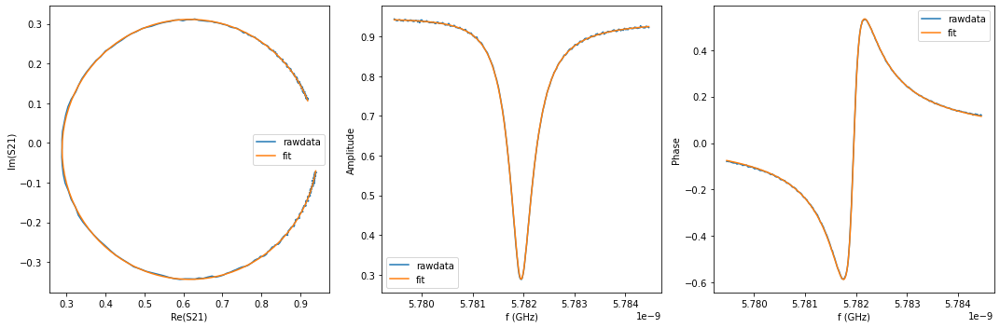

{'Qi_dia_corr': 25282.78808677879, 'Qi_no_corr': 25520.570334902866, 'absQc': 11144.2042959314, 'Qc_dia_corr(Re{Qc})': 11190.161065259581, 'Ql': 7756.939799151648, 'fr': 5.781927745123527, 'theta0': -3.0509340898058843, 'phi0': 0.09066096135265612, 'phi0_err': 0.0010063171598811902, 'Ql_err': 10.077821547027373, 'absQc_err': 9.769677291111481, 'fr_err': 4.6551901344241766e-07, 'chi_square': 7.561705881630166e-06, 'Qi_no_corr_err': 81.39800105474013, 'Qi_dia_corr_err': 78.9753906005796, 'delay': 0.458767660447517, 'a': 0.9428224741866368, 'alpha': -2.16093384118837}


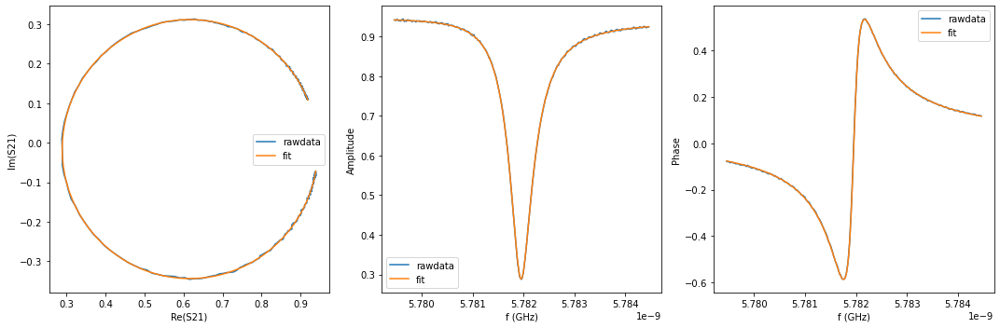

{'Qi_dia_corr': 25349.703223961253, 'Qi_no_corr': 25588.32979644925, 'absQc': 11183.450524258618, 'Qc_dia_corr(Re{Qc})': 11229.650959076242, 'Ql': 7782.212821386017, 'fr': 5.78192765073929, 'theta0': -3.0508520064515117, 'phi0': 0.09074107266848504, 'phi0_err': 0.0008723333151654505, 'Ql_err': 9.467285914235031, 'absQc_err': 8.21328129968663, 'fr_err': 3.825200671425427e-07, 'chi_square': 5.5587225238640315e-06, 'Qi_no_corr_err': 80.65682312950355, 'Qi_dia_corr_err': 78.88141936354393, 'delay': 0.33437003447724833, 'a': 0.9423725797029261, 'alpha': -0.39677928858508904}


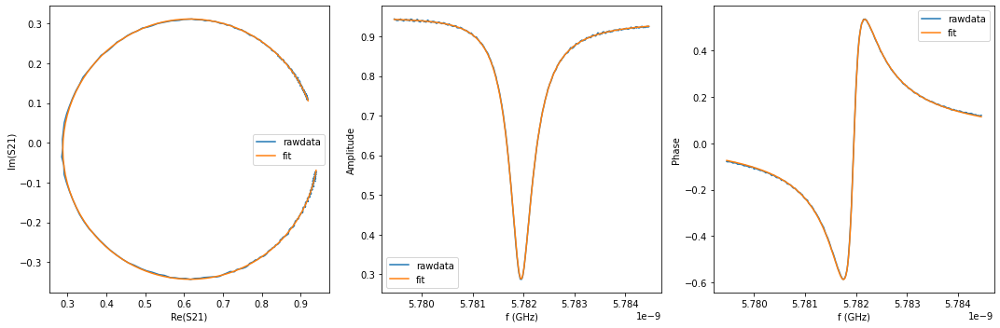

{'Qi_dia_corr': 25229.054581949204, 'Qi_no_corr': 25466.386542748776, 'absQc': 11113.02582268157, 'Qc_dia_corr(Re{Qc})': 11158.833581962606, 'Ql': 7736.827711519419, 'fr': 5.78192755840133, 'theta0': -3.050951838774811, 'phi0': 0.09064081481498218, 'phi0_err': 0.0011986344156024178, 'Ql_err': 11.474282817430584, 'absQc_err': 10.004570695085382, 'fr_err': 5.197100362256973e-07, 'chi_square': 9.066411602627195e-06, 'Qi_no_corr_err': 99.00842442576368, 'Qi_dia_corr_err': 95.75118332657802, 'delay': 0.5375742183907712, 'a': 0.9431298615615792, 'alpha': 0.7024285171510414}


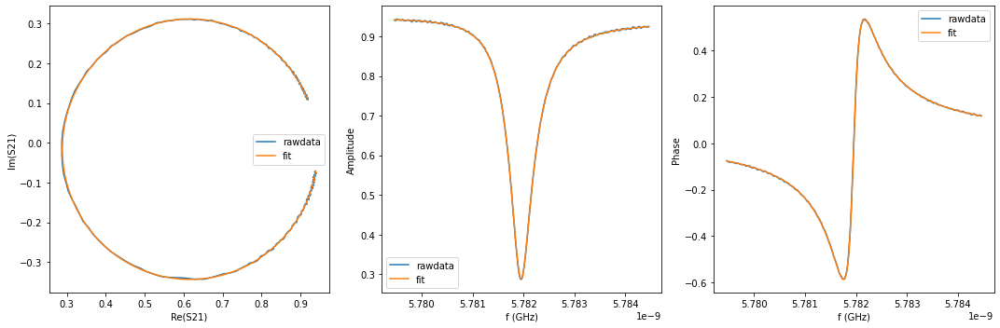

{'Qi_dia_corr': 25349.579882950486, 'Qi_no_corr': 25589.137143933473, 'absQc': 11185.260188157848, 'Qc_dia_corr(Re{Qc})': 11231.65536031299, 'Ql': 7783.163769092643, 'fr': 5.781927243831411, 'theta0': -3.050668609254909, 'phi0': 0.0909241226065984, 'phi0_err': 0.0008230034007591424, 'Ql_err': 8.245597244007294, 'absQc_err': 8.08331297492258, 'fr_err': 3.8674183238940345e-07, 'chi_square': 5.074138666147583e-06, 'Qi_no_corr_err': 68.03377909789832, 'Qi_dia_corr_err': 66.43900497726189, 'delay': 0.32955132994251035, 'a': 0.9422364637557685, 'alpha': -0.5716416608014224}


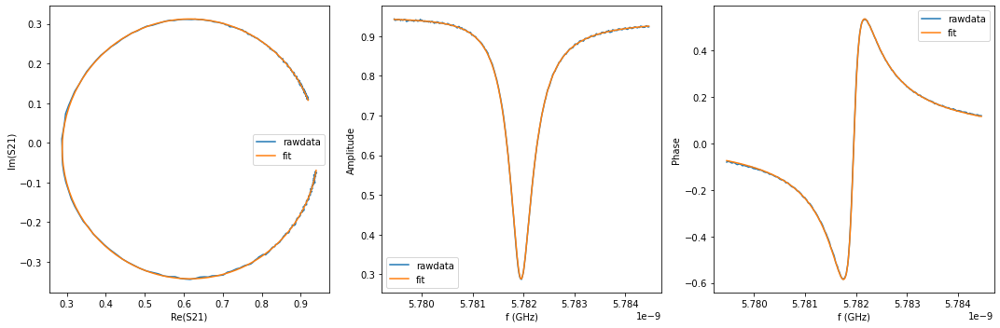

{'Qi_dia_corr': 25290.057036780167, 'Qi_no_corr': 25522.799153246393, 'absQc': 11129.698594006928, 'Qc_dia_corr(Re{Qc})': 11174.543183104664, 'Ql': 7750.114707320176, 'fr': 5.781927676796429, 'theta0': -3.0519755503808392, 'phi0': 0.08961907958602819, 'phi0_err': 0.0011566190913024266, 'Ql_err': 10.906804976397732, 'absQc_err': 9.44075199170388, 'fr_err': 5.034057124707859e-07, 'chi_square': 8.264107353998735e-06, 'Qi_no_corr_err': 94.57733247701489, 'Qi_dia_corr_err': 92.02817519254019, 'delay': 0.4691418966365457, 'a': 0.9429098120083881, 'alpha': -1.7828104269369645}


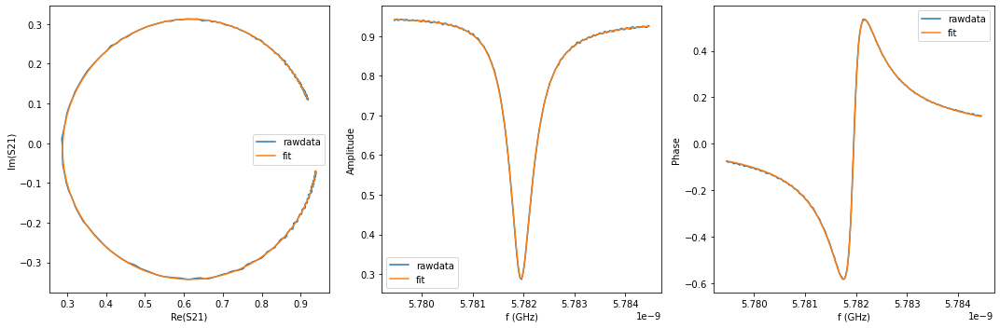

{'Qi_dia_corr': 25283.418712151473, 'Qi_no_corr': 25519.200782768316, 'absQc': 11153.721904932156, 'Qc_dia_corr(Re{Qc})': 11199.369858327878, 'Ql': 7761.423085664963, 'fr': 5.781927095313179, 'theta0': -3.0512742041049448, 'phi0': 0.09031845151085208, 'phi0_err': 0.0009942333063855183, 'Ql_err': 10.091777636759439, 'absQc_err': 8.722533588136482, 'fr_err': 4.505984032326369e-07, 'chi_square': 6.639835704342655e-06, 'Qi_no_corr_err': 91.10100442714494, 'Qi_dia_corr_err': 89.01930327109967, 'delay': 0.4203946371536898, 'a': 0.9427085458458421, 'alpha': 2.729941371214038}


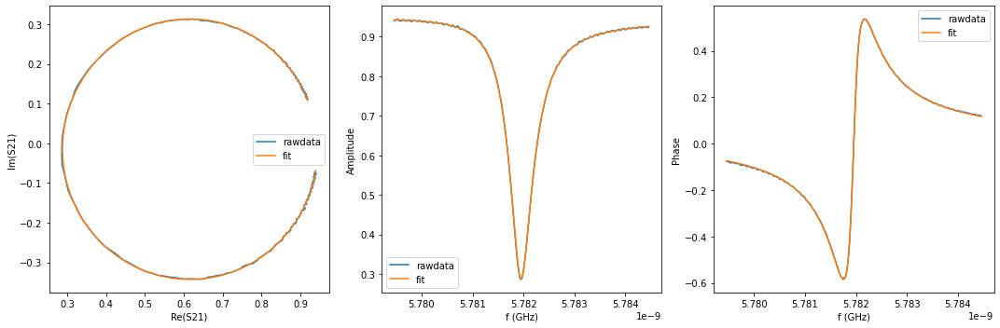

{'Qi_dia_corr': 25339.392572004388, 'Qi_no_corr': 25573.315922391637, 'absQc': 11140.620533605761, 'Qc_dia_corr(Re{Qc})': 11185.604648412937, 'Ql': 7760.067047532387, 'fr': 5.781927236027289, 'theta0': -3.0518774222919602, 'phi0': 0.08971405955531142, 'phi0_err': 0.0010324568193049717, 'Ql_err': 9.88789903878816, 'absQc_err': 8.651773793155174, 'fr_err': 4.5706445137508826e-07, 'chi_square': 6.878620255591248e-06, 'Qi_no_corr_err': 86.63053061897901, 'Qi_dia_corr_err': 84.44863107675812, 'delay': 0.4442848463803354, 'a': 0.9430059225635671, 'alpha': -2.6852351048965537}


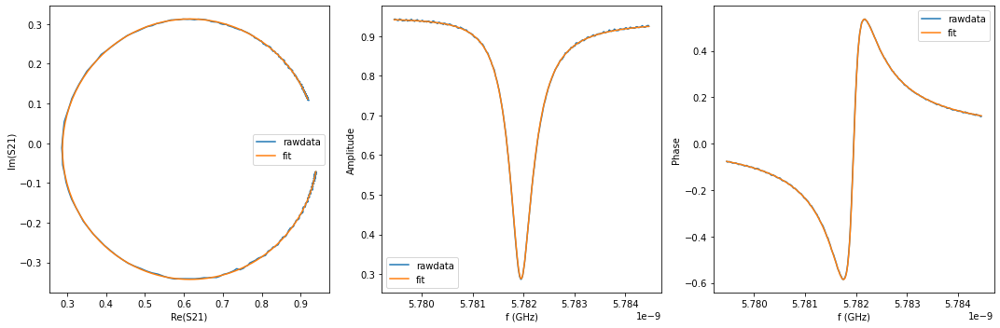

{'Qi_dia_corr': 25468.795096332004, 'Qi_no_corr': 25707.834352253944, 'absQc': 11218.093101474107, 'Qc_dia_corr(Re{Qc})': 11264.2265321591, 'Ql': 7810.037528840534, 'fr': 5.7819270600501484, 'theta0': -3.051056866071544, 'phi0': 0.09053583697733866, 'phi0_err': 0.0008980907553811263, 'Ql_err': 9.41026913767369, 'absQc_err': 8.267558426575368, 'fr_err': 4.096994506351271e-07, 'chi_square': 5.504517579760552e-06, 'Qi_no_corr_err': 84.82971105962719, 'Qi_dia_corr_err': 83.65863786044177, 'delay': 0.2146689475570885, 'a': 0.9421766095875047, 'alpha': 1.5394076221926976}


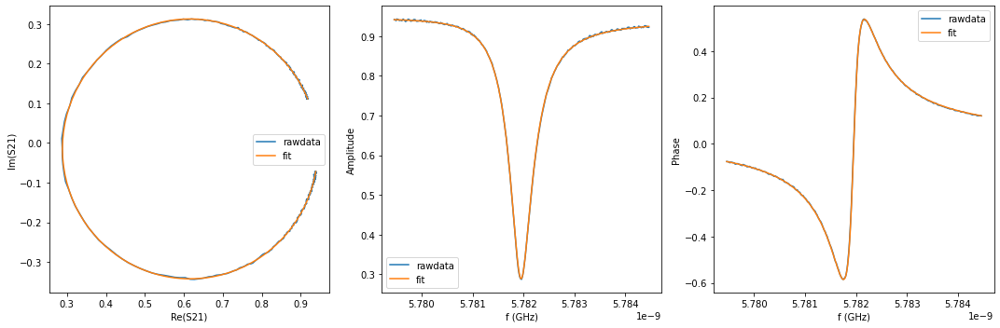

{'Qi_dia_corr': 25459.55312318212, 'Qi_no_corr': 25698.01466346497, 'absQc': 11229.7257050946, 'Qc_dia_corr(Re{Qc})': 11275.877382336404, 'Ql': 7814.766161048676, 'fr': 5.781926870687159, 'theta0': -3.0510867775769257, 'phi0': 0.09050692508079644, 'phi0_err': 0.0009401451456240371, 'Ql_err': 9.68591960531571, 'absQc_err': 8.641077661578903, 'fr_err': 4.2844468221692893e-07, 'chi_square': 5.925468704764969e-06, 'Qi_no_corr_err': 88.01601200218737, 'Qi_dia_corr_err': 86.95233655036574, 'delay': 0.1830337735533258, 'a': 0.942192548068758, 'alpha': 0.3900971683492438}


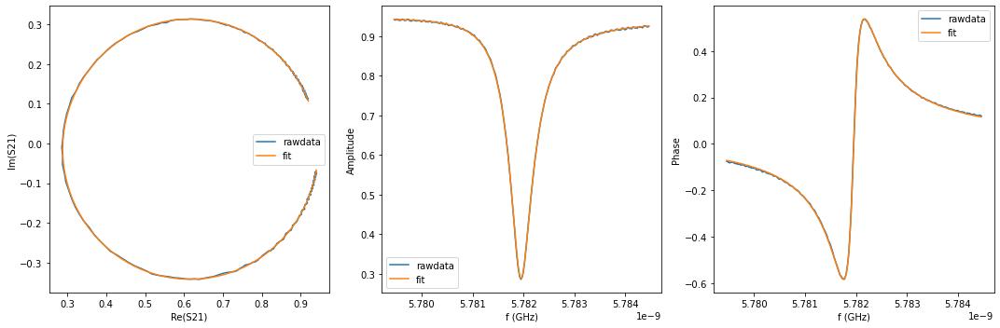

{'Qi_dia_corr': 25242.91124914667, 'Qi_no_corr': 25471.089481207568, 'absQc': 11093.631433736213, 'Qc_dia_corr(Re{Qc})': 11137.479241967201, 'Ql': 7727.855480629382, 'fr': 5.781927186210383, 'theta0': -3.052829617002609, 'phi0': 0.08876424738914081, 'phi0_err': 0.0014815161951177369, 'Ql_err': 14.081053020743301, 'absQc_err': 11.146090689834594, 'fr_err': 6.487689396514742e-07, 'chi_square': 1.223522462523214e-05, 'Qi_no_corr_err': 132.30639679219416, 'Qi_dia_corr_err': 128.750405231084, 'delay': 0.5921503137463635, 'a': 0.943370699713415, 'alpha': 2.6867504614485185}


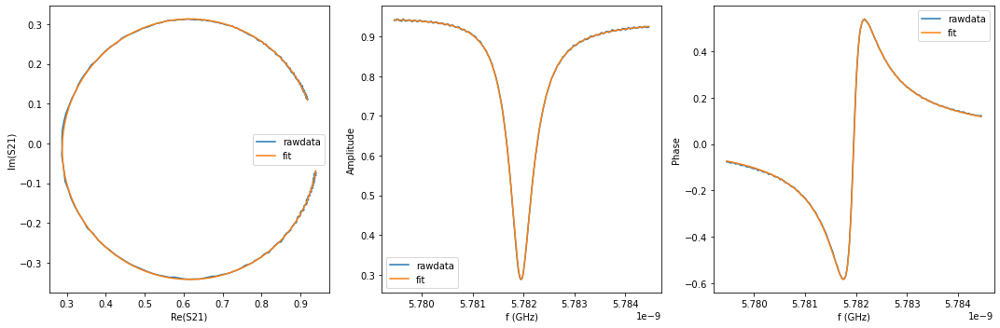

{'Qi_dia_corr': 25315.02084179093, 'Qi_no_corr': 25549.631778837993, 'absQc': 11158.22223169623, 'Qc_dia_corr(Re{Qc})': 11203.567991184736, 'Ql': 7766.416125673525, 'fr': 5.781926423176223, 'theta0': -3.051594143277931, 'phi0': 0.09000191525840508, 'phi0_err': 0.0010887323826223089, 'Ql_err': 11.076266333699213, 'absQc_err': 9.252704779482244, 'fr_err': 4.6813055207764665e-07, 'chi_square': 7.217056300750002e-06, 'Qi_no_corr_err': 97.17268334304875, 'Qi_dia_corr_err': 93.82898673581153, 'delay': 0.41216213884657255, 'a': 0.9427837607316242, 'alpha': 2.43140743127791}


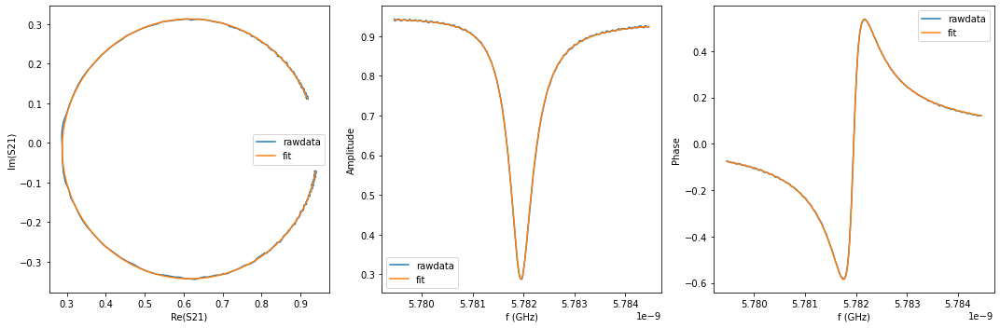

{'Qi_dia_corr': 25514.42394849757, 'Qi_no_corr': 25754.633106318925, 'absQc': 11227.17061607263, 'Qc_dia_corr(Re{Qc})': 11273.438019769696, 'Ql': 7818.754926329381, 'fr': 5.7819262442208865, 'theta0': -3.0509624373020086, 'phi0': 0.09063021628778441, 'phi0_err': 0.0009636892316120178, 'Ql_err': 9.296914946685769, 'absQc_err': 8.265951686252455, 'fr_err': 4.454841770670633e-07, 'chi_square': 5.707205868704646e-06, 'Qi_no_corr_err': 86.99136654234734, 'Qi_dia_corr_err': 86.10135587741514, 'delay': 0.18420696535862435, 'a': 0.9421669655558843, 'alpha': 0.43299951280203586}


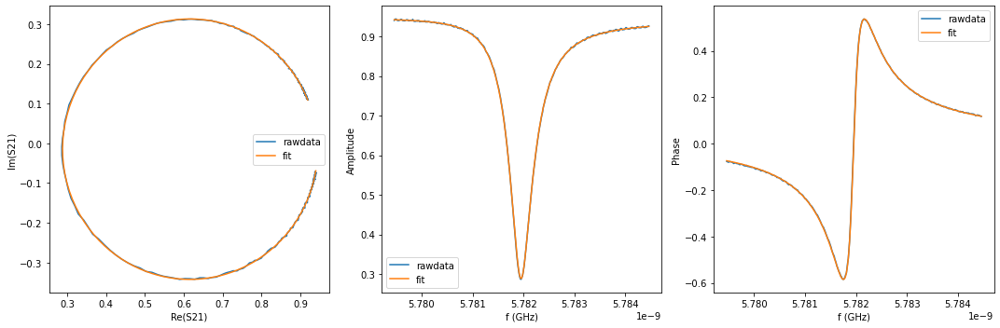

{'Qi_dia_corr': 25382.598482519523, 'Qi_no_corr': 25620.07831183562, 'absQc': 11170.458783684953, 'Qc_dia_corr(Re{Qc})': 11216.212612069326, 'Ql': 7778.848894597556, 'fr': 5.781925885371406, 'theta0': -3.051237413437044, 'phi0': 0.0903552401527489, 'phi0_err': 0.0010028195885860506, 'Ql_err': 9.596035390772142, 'absQc_err': 8.335710185278442, 'fr_err': 4.569811776109308e-07, 'chi_square': 6.27082264482279e-06, 'Qi_no_corr_err': 86.5524516903204, 'Qi_dia_corr_err': 84.91118744338587, 'delay': 0.3901254028062671, 'a': 0.94281685833907, 'alpha': 1.630823806992915}


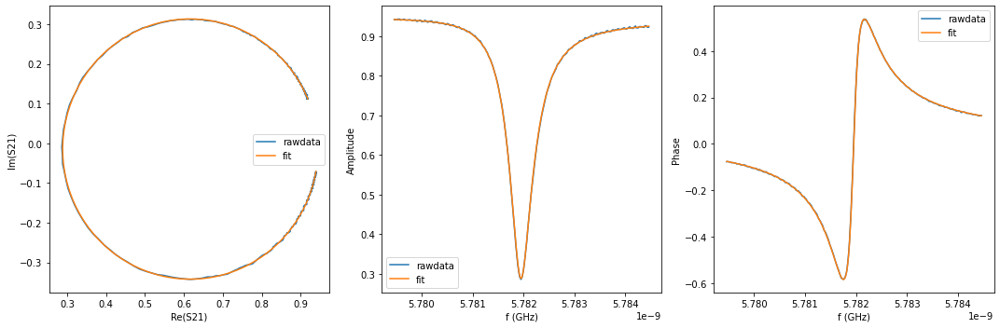

{'Qi_dia_corr': 25468.352794825558, 'Qi_no_corr': 25708.315769951576, 'absQc': 11221.681300119037, 'Qc_dia_corr(Re{Qc})': 11268.023369643637, 'Ql': 7811.820991641073, 'fr': 5.78192561376104, 'theta0': -3.0508674823291853, 'phi0': 0.09072517126060795, 'phi0_err': 0.0009764225250988615, 'Ql_err': 9.93716181193122, 'absQc_err': 8.268966311253894, 'fr_err': 4.358065136866682e-07, 'chi_square': 5.784881486898962e-06, 'Qi_no_corr_err': 90.16714899787956, 'Qi_dia_corr_err': 88.95052039299335, 'delay': 0.20387233075969938, 'a': 0.9425563872795832, 'alpha': 1.147971788133893}


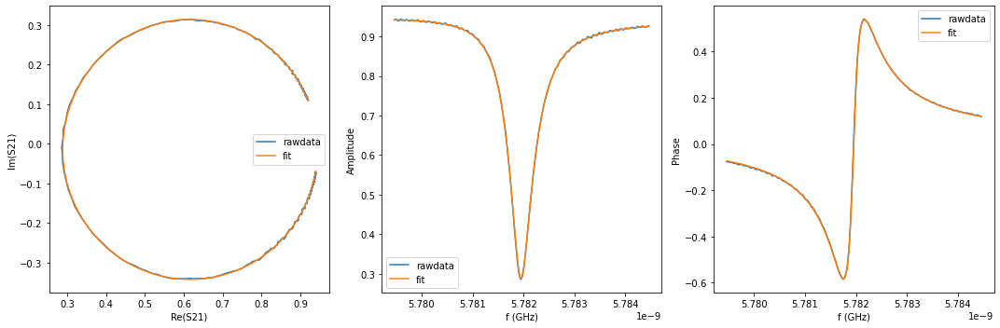

{'Qi_dia_corr': 25355.157745601227, 'Qi_no_corr': 25587.42722416334, 'absQc': 11150.115884887036, 'Qc_dia_corr(Re{Qc})': 11194.804314686206, 'Ql': 7765.973296000017, 'fr': 5.78192598477642, 'theta0': -3.0522120460732154, 'phi0': 0.08938175328424432, 'phi0_err': 0.001188052886219394, 'Ql_err': 12.332070162900333, 'absQc_err': 9.693834840210734, 'fr_err': 5.091649346545245e-07, 'chi_square': 8.317908001208891e-06, 'Qi_no_corr_err': 112.13558365451458, 'Qi_dia_corr_err': 108.99518388408795, 'delay': 0.4117930205280626, 'a': 0.9432567382291192, 'alpha': 2.4182768414153233}


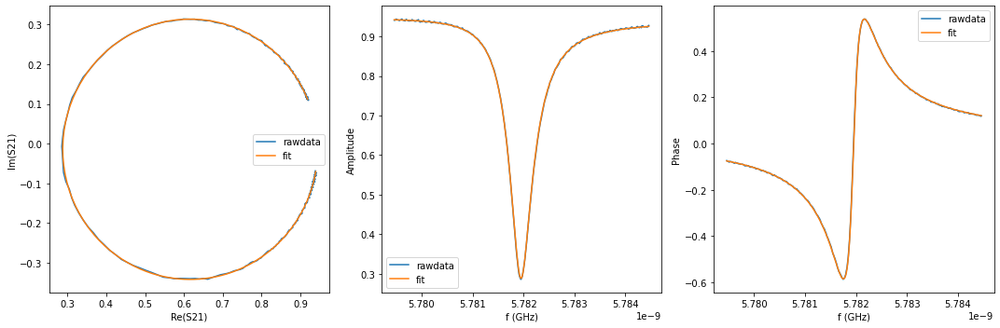

{'Qi_dia_corr': 25476.237667252084, 'Qi_no_corr': 25714.747112670215, 'absQc': 11208.886533166497, 'Qc_dia_corr(Re{Qc})': 11254.81573466556, 'Ql': 7806.211202821061, 'fr': 5.781925442994337, 'theta0': -3.051219788216052, 'phi0': 0.0903728653737408, 'phi0_err': 0.0010463809675986574, 'Ql_err': 10.083935756234993, 'absQc_err': 8.422911120265004, 'fr_err': 4.6633399663928177e-07, 'chi_square': 6.196563273240659e-06, 'Qi_no_corr_err': 95.83300382701569, 'Qi_dia_corr_err': 94.96278182969117, 'delay': 0.24073081081722564, 'a': 0.9427495527704758, 'alpha': 2.4872529619302424}


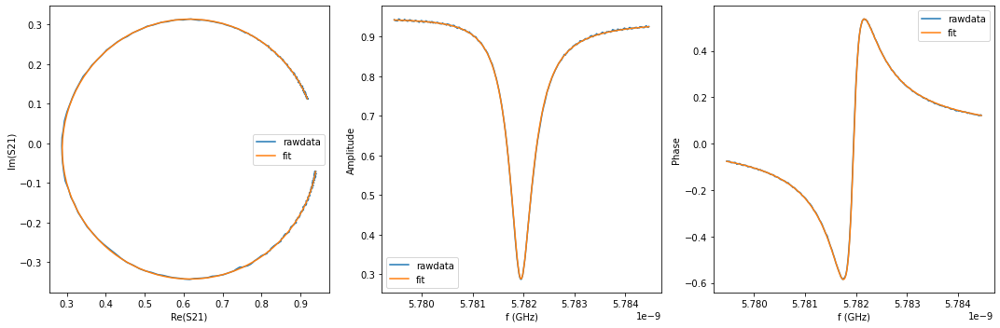

{'Qi_dia_corr': 25504.796282369134, 'Qi_no_corr': 25747.889766697408, 'absQc': 11229.153849677046, 'Qc_dia_corr(Re{Qc})': 11276.025787720017, 'Ql': 7819.094963198654, 'fr': 5.781925052041904, 'theta0': -3.0503823341584404, 'phi0': 0.09121031943135255, 'phi0_err': 0.0010642687324275374, 'Ql_err': 10.570986050280439, 'absQc_err': 8.13511043017045, 'fr_err': 4.6034783139619493e-07, 'chi_square': 6.036342541730932e-06, 'Qi_no_corr_err': 100.52554301517941, 'Qi_dia_corr_err': 99.28706086739597, 'delay': 0.1684009969163744, 'a': 0.9425170495847538, 'alpha': -0.14059665854404982}


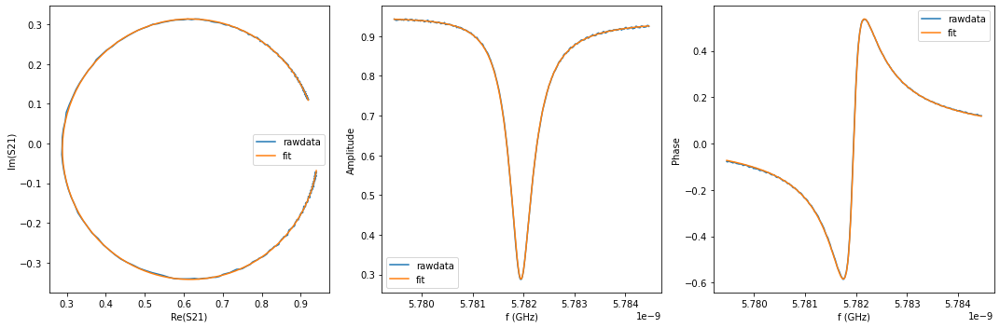

{'Qi_dia_corr': 25270.118332382703, 'Qi_no_corr': 25503.79208848804, 'absQc': 11128.791232529426, 'Qc_dia_corr(Re{Qc})': 11173.878075679793, 'Ql': 7747.921442050672, 'fr': 5.781924952489648, 'theta0': -3.051728996563815, 'phi0': 0.08986365702597816, 'phi0_err': 0.0011887521593484313, 'Ql_err': 12.228914483833982, 'absQc_err': 9.419959996594107, 'fr_err': 5.057511119115741e-07, 'chi_square': 7.720781193966884e-06, 'Qi_no_corr_err': 112.04702280474706, 'Qi_dia_corr_err': 108.38621029537516, 'delay': 0.4577498592685175, 'a': 0.9435165025187356, 'alpha': -2.195106704229341}


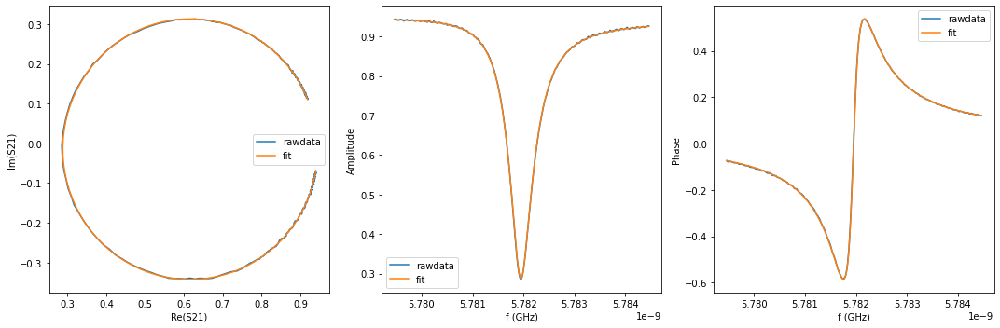

{'Qi_dia_corr': 25443.070287152215, 'Qi_no_corr': 25686.99964256975, 'absQc': 11190.7642472267, 'Qc_dia_corr(Re{Qc})': 11237.701580600533, 'Ql': 7794.864083343455, 'fr': 5.781924267776158, 'theta0': -3.050163071447717, 'phi0': 0.09142958214207612, 'phi0_err': 0.0010899957365997576, 'Ql_err': 10.333082359384376, 'absQc_err': 8.647968108489426, 'fr_err': 5.034988087872654e-07, 'chi_square': 6.3782263377412024e-06, 'Qi_no_corr_err': 100.26697924550193, 'Qi_dia_corr_err': 98.91775458394949, 'delay': 0.3107909105164001, 'a': 0.9429815789547891, 'alpha': -1.2505781345198286}


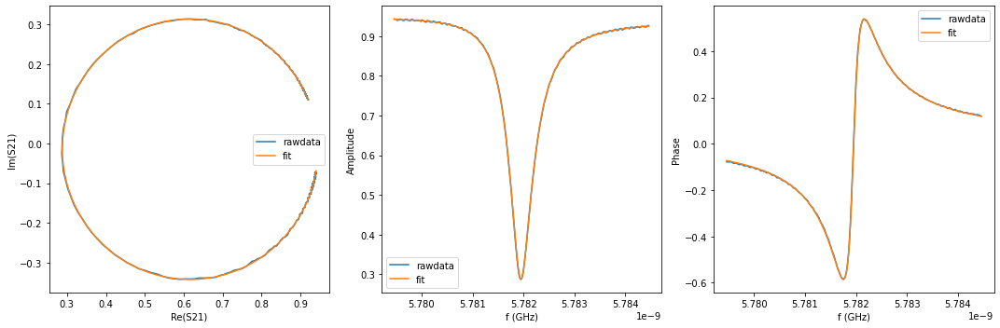

{'Qi_dia_corr': 25367.831297589873, 'Qi_no_corr': 25605.144841129895, 'absQc': 11150.291120065443, 'Qc_dia_corr(Re{Qc})': 11195.900817937649, 'Ql': 7767.689640559909, 'fr': 5.7819244943035955, 'theta0': -3.0512972184082474, 'phi0': 0.09029456700369831, 'phi0_err': 0.0011951785212652635, 'Ql_err': 11.717159962169823, 'absQc_err': 9.341601789900414, 'fr_err': 5.394046079928046e-07, 'chi_square': 7.68957038022581e-06, 'Qi_no_corr_err': 114.23565723372627, 'Qi_dia_corr_err': 112.04849606829657, 'delay': 0.4129205665933179, 'a': 0.9433114698228242, 'alpha': 2.4594838951493476}


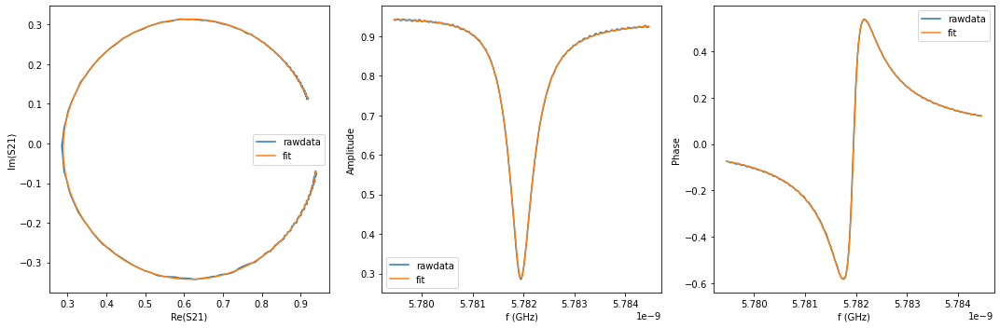

{'Qi_dia_corr': 25376.82939157026, 'Qi_no_corr': 25614.885448117668, 'absQc': 11181.061208319312, 'Qc_dia_corr(Re{Qc})': 11227.033643188091, 'Ql': 7783.509545592545, 'fr': 5.781924081569579, 'theta0': -3.051065337409483, 'phi0': 0.09052729548380961, 'phi0_err': 0.001098824721959044, 'Ql_err': 10.743242875613582, 'absQc_err': 8.551215335511156, 'fr_err': 4.885020026687049e-07, 'chi_square': 6.4352475795327775e-06, 'Qi_no_corr_err': 101.74230813639562, 'Qi_dia_corr_err': 100.25627728486512, 'delay': 0.29353421607780145, 'a': 0.9430627425323399, 'alpha': -1.877668584630488}


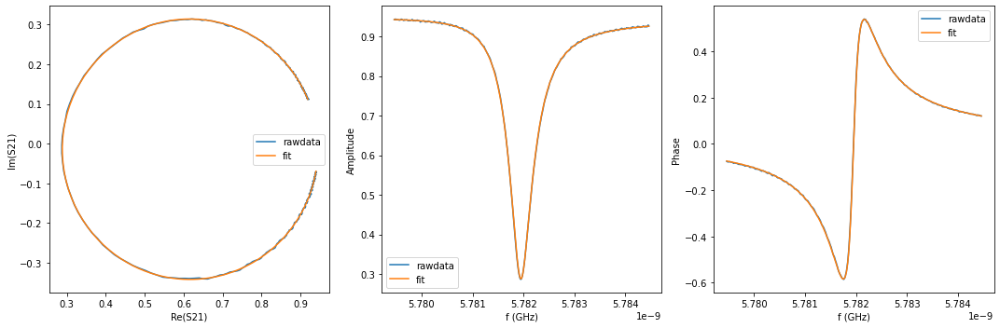

{'Qi_dia_corr': 25452.43290061535, 'Qi_no_corr': 25692.15852629378, 'absQc': 11193.004423649842, 'Qc_dia_corr(Re{Qc})': 11239.121696326805, 'Ql': 7796.426016286823, 'fr': 5.78192375650277, 'theta0': -3.050971595216706, 'phi0': 0.09062107992580822, 'phi0_err': 0.0010882118616536958, 'Ql_err': 11.473825672071678, 'absQc_err': 8.308525434667514, 'fr_err': 4.7465350520659514e-07, 'chi_square': 6.326327065998359e-06, 'Qi_no_corr_err': 111.54301192359141, 'Qi_dia_corr_err': 110.02827633275562, 'delay': 0.28030202478189403, 'a': 0.9429890285327982, 'alpha': -2.357689772885563}


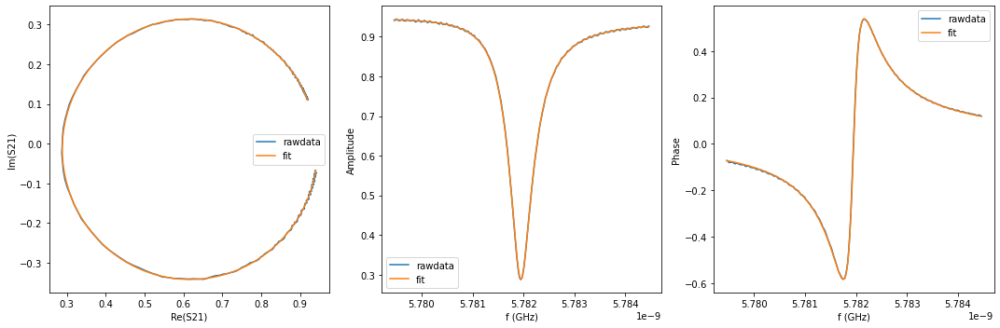

{'Qi_dia_corr': 25293.69434674553, 'Qi_no_corr': 25532.52846384155, 'absQc': 11130.62992312464, 'Qc_dia_corr(Re{Qc})': 11176.63663013859, 'Ql': 7751.463262742182, 'fr': 5.781923562544581, 'theta0': -3.050827571953745, 'phi0': 0.09076514255823007, 'phi0_err': 0.0013163420582731234, 'Ql_err': 13.176281190422385, 'absQc_err': 9.373323701049813, 'fr_err': 5.690768977780337e-07, 'chi_square': 8.61334226386339e-06, 'Qi_no_corr_err': 129.51691099609968, 'Qi_dia_corr_err': 126.30737951322737, 'delay': 0.4620953513192572, 'a': 0.9438019395413305, 'alpha': -2.0363930115604267}


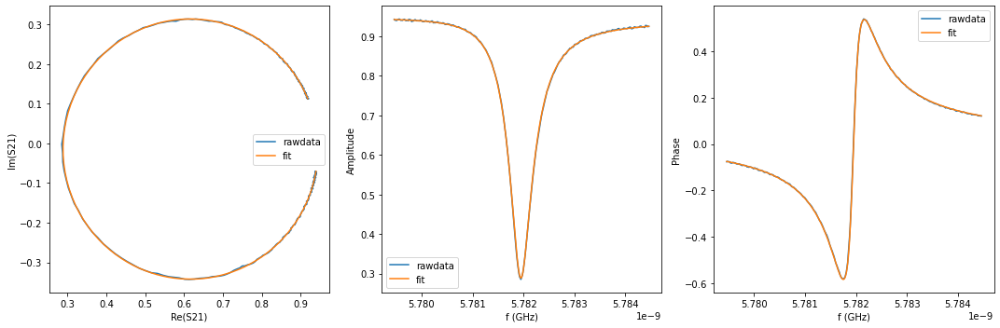

{'Qi_dia_corr': 25468.7958517599, 'Qi_no_corr': 25713.78653782458, 'absQc': 11223.282644439221, 'Qc_dia_corr(Re{Qc})': 11270.60236325425, 'Ql': 7813.102137279377, 'fr': 5.781922909814768, 'theta0': -3.0499253244422957, 'phi0': 0.09166732914749748, 'phi0_err': 0.0011032397513396565, 'Ql_err': 10.695834401817695, 'absQc_err': 8.591705534545625, 'fr_err': 4.781544173072887e-07, 'chi_square': 6.826947912006157e-06, 'Qi_no_corr_err': 100.85338443837256, 'Qi_dia_corr_err': 99.52338722033528, 'delay': 0.19764477448409914, 'a': 0.9430675680468931, 'alpha': 0.9228099747139792}


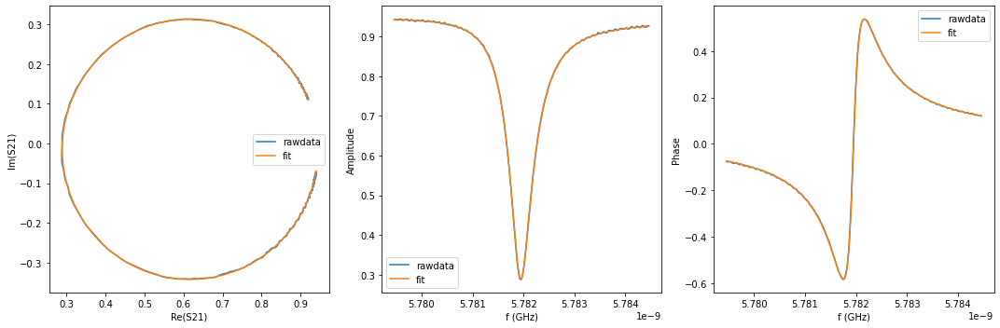

{'Qi_dia_corr': 25376.67145105432, 'Qi_no_corr': 25618.560924802376, 'absQc': 11180.71118125024, 'Qc_dia_corr(Re{Qc})': 11227.417634447129, 'Ql': 7783.6792465350645, 'fr': 5.78192287058659, 'theta0': -3.0503465821579856, 'phi0': 0.09124607143180763, 'phi0_err': 0.0011604316426435785, 'Ql_err': 12.37653027468232, 'absQc_err': 8.400356061107606, 'fr_err': 5.000961894162644e-07, 'chi_square': 6.79120472701941e-06, 'Qi_no_corr_err': 121.55479717363606, 'Qi_dia_corr_err': 119.93987018519191, 'delay': 0.29692481140038024, 'a': 0.9434675647975271, 'alpha': -1.7539473772398755}


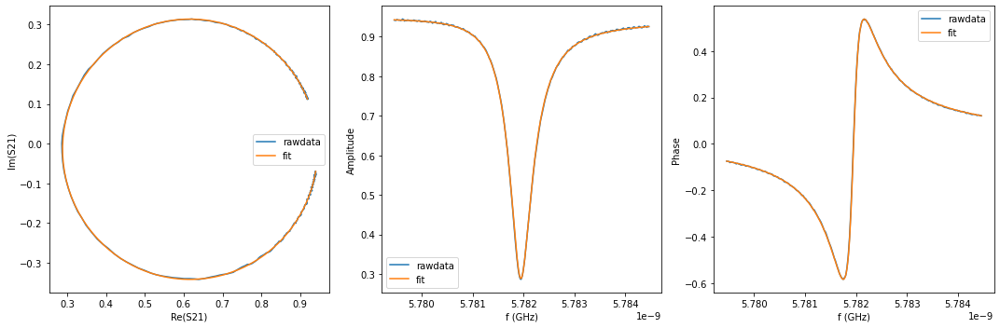

{'Qi_dia_corr': 25460.524468166303, 'Qi_no_corr': 25703.803812521182, 'absQc': 11208.444985711845, 'Qc_dia_corr(Re{Qc})': 11255.341930559633, 'Ql': 7804.988325988018, 'fr': 5.781922599998272, 'theta0': -3.0502741391542685, 'phi0': 0.0913185144355248, 'phi0_err': 0.0011370433824060761, 'Ql_err': 11.639901718971394, 'absQc_err': 8.50919080532218, 'fr_err': 4.95514267736276e-07, 'chi_square': 6.751634808016042e-06, 'Qi_no_corr_err': 113.31515554676423, 'Qi_dia_corr_err': 111.54564824308245, 'delay': 0.23793853624603456, 'a': 0.9431686252708962, 'alpha': 2.386605406801325}


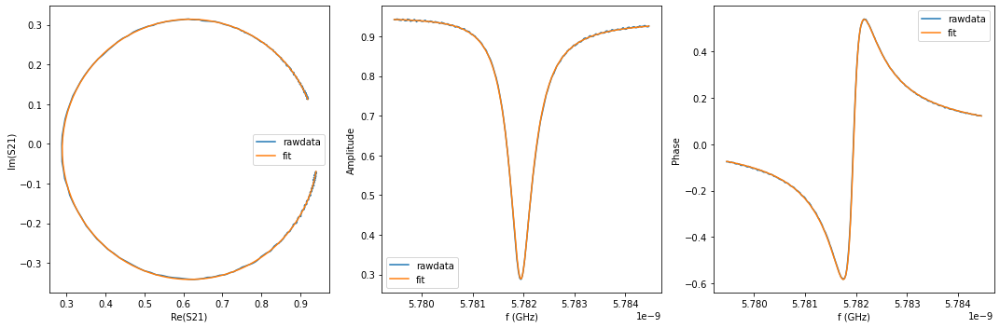

{'Qi_dia_corr': 25407.75373250933, 'Qi_no_corr': 25646.16076715227, 'absQc': 11207.164126893585, 'Qc_dia_corr(Re{Qc})': 11253.307181446558, 'Ql': 7799.044828886287, 'fr': 5.781922660445839, 'theta0': -3.0510035455753473, 'phi0': 0.09058923477458491, 'phi0_err': 0.0012364949610684996, 'Ql_err': 12.65717718218703, 'absQc_err': 8.524364468302194, 'fr_err': 5.238072848353395e-07, 'chi_square': 7.223879731647703e-06, 'Qi_no_corr_err': 123.10635815712298, 'Qi_dia_corr_err': 121.0916920102392, 'delay': 0.24661222498898383, 'a': 0.9433293223029027, 'alpha': 2.701893845671066}


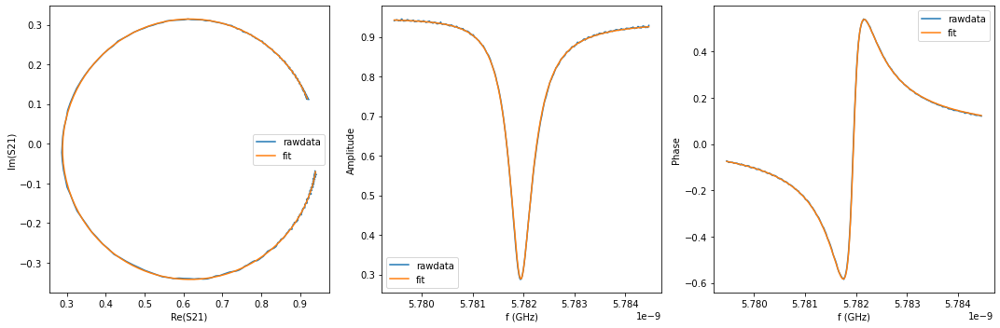

{'Qi_dia_corr': 25500.531771373466, 'Qi_no_corr': 25743.075191157808, 'absQc': 11242.272676452845, 'Qc_dia_corr(Re{Qc})': 11289.164351299796, 'Ql': 7825.008753882006, 'fr': 5.781922142668343, 'theta0': -3.050416259158428, 'phi0': 0.09117639443136547, 'phi0_err': 0.001336889309796461, 'Ql_err': 12.183539579620783, 'absQc_err': 9.105957510412566, 'fr_err': 5.776176369135276e-07, 'chi_square': 8.09626900654309e-06, 'Qi_no_corr_err': 120.39933350192824, 'Qi_dia_corr_err': 120.06016416279411, 'delay': 0.14391685418341882, 'a': 0.9432552402442188, 'alpha': -1.0287041889010682}


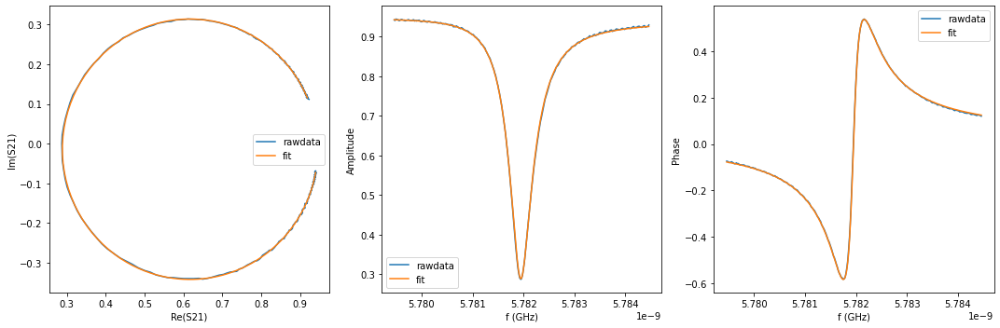

{'Qi_dia_corr': 25560.15003496035, 'Qi_no_corr': 25807.275772735014, 'absQc': 11274.388868076048, 'Qc_dia_corr(Re{Qc})': 11322.211855745565, 'Ql': 7846.49948986563, 'fr': 5.78192156652032, 'theta0': -3.049649224863887, 'phi0': 0.091943428725906, 'phi0_err': 0.0014678230816922693, 'Ql_err': 14.236638434381153, 'absQc_err': 10.852126660065244, 'fr_err': 6.363950612848173e-07, 'chi_square': 1.0427075063726006e-05, 'Qi_no_corr_err': 137.62103993150217, 'Qi_dia_corr_err': 137.34936816868063, 'delay': -0.004790517639695735, 'a': 0.9430348275681089, 'alpha': -0.14791932839182423}


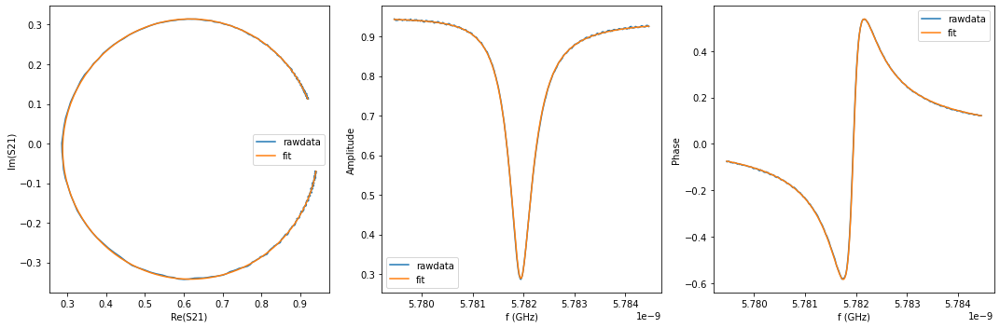

{'Qi_dia_corr': 25441.78775347097, 'Qi_no_corr': 25682.935563871863, 'absQc': 11198.153922317226, 'Qc_dia_corr(Re{Qc})': 11244.624967852527, 'Ql': 7798.07401646556, 'fr': 5.7819218354666875, 'theta0': -3.0506466930782477, 'phi0': 0.0909459605115454, 'phi0_err': 0.0012513938826748657, 'Ql_err': 12.293730269624136, 'absQc_err': 8.861032454706715, 'fr_err': 5.326727205259317e-07, 'chi_square': 7.595962282539106e-06, 'Qi_no_corr_err': 118.94603387614464, 'Qi_dia_corr_err': 117.69363390138572, 'delay': 0.24675777167607563, 'a': 0.9436878307974365, 'alpha': 2.7071584708497247}


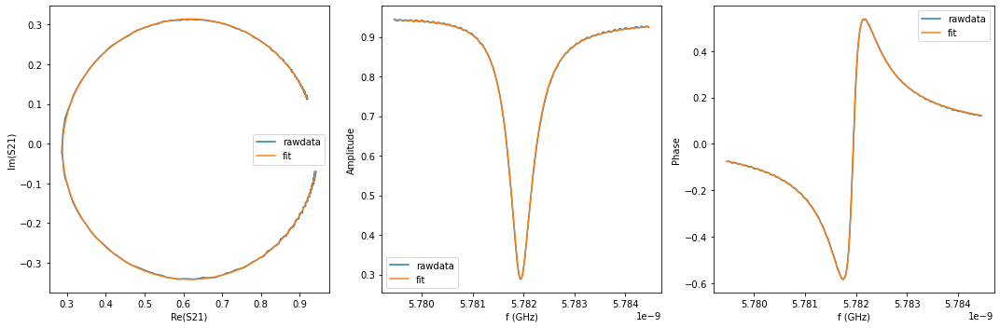

{'Qi_dia_corr': 25487.381693231608, 'Qi_no_corr': 25734.03678115358, 'absQc': 11233.094624712125, 'Qc_dia_corr(Re{Qc})': 11280.748064565134, 'Ql': 7819.726855859099, 'fr': 5.781921042932154, 'theta0': -3.049643830001309, 'phi0': 0.09194882358848383, 'phi0_err': 0.0013151868555977499, 'Ql_err': 13.097173787269803, 'absQc_err': 9.28382073052838, 'fr_err': 5.565328492710153e-07, 'chi_square': 8.029192720393914e-06, 'Qi_no_corr_err': 127.94069335226678, 'Qi_dia_corr_err': 126.61588317071748, 'delay': 0.1746601357887911, 'a': 0.943596994962005, 'alpha': 0.08817177951736989}


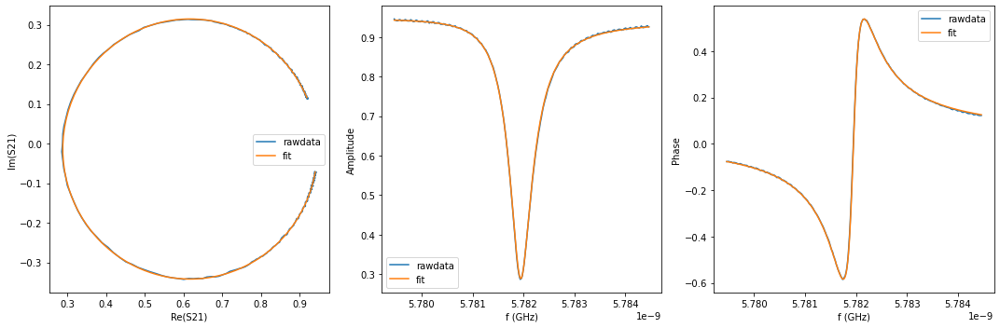

{'Qi_dia_corr': 25576.21690800854, 'Qi_no_corr': 25826.05212282596, 'absQc': 11272.53507248924, 'Qc_dia_corr(Re{Qc})': 11320.802944176716, 'Ql': 7847.3359862947555, 'fr': 5.781920640102093, 'theta0': -3.049216497991052, 'phi0': 0.09237615559874116, 'phi0_err': 0.0015043268868631264, 'Ql_err': 14.165311756043742, 'absQc_err': 10.437905644079274, 'fr_err': 6.365690658313888e-07, 'chi_square': 1.0380056546464755e-05, 'Qi_no_corr_err': 139.14718734627743, 'Qi_dia_corr_err': 137.96958688556902, 'delay': 0.013911827812047937, 'a': 0.9432268606735996, 'alpha': 0.5320805424145347}


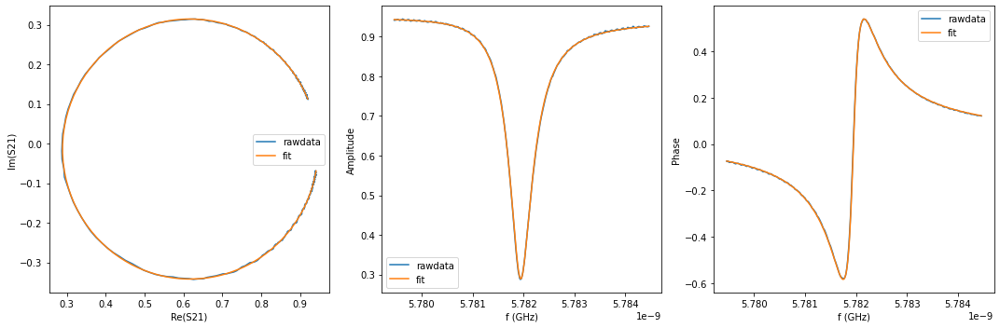

{'Qi_dia_corr': 25416.153649007116, 'Qi_no_corr': 25659.10591359362, 'absQc': 11201.588054133625, 'Qc_dia_corr(Re{Qc})': 11248.528250860727, 'Ql': 7797.539963113766, 'fr': 5.781920430936345, 'theta0': -3.0502045250311434, 'phi0': 0.09138832988542077, 'phi0_err': 0.001302486301902972, 'Ql_err': 12.805099784024415, 'absQc_err': 9.24382710158611, 'fr_err': 5.68821384897039e-07, 'chi_square': 8.256694580397398e-06, 'Qi_no_corr_err': 127.3707196945736, 'Qi_dia_corr_err': 125.4455322265145, 'delay': 0.26159634938533666, 'a': 0.9439818417175596, 'alpha': -3.0362115161153067}


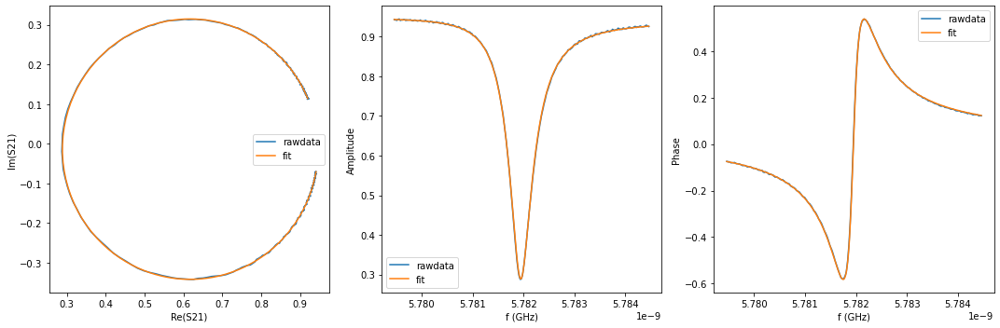

{'Qi_dia_corr': 25466.917023108792, 'Qi_no_corr': 25707.75880134221, 'absQc': 11225.735534635423, 'Qc_dia_corr(Re{Qc})': 11272.285355723416, 'Ql': 7813.734028706407, 'fr': 5.781920556382631, 'theta0': -3.050682521551735, 'phi0': 0.09091124107017644, 'phi0_err': 0.0013825474705278504, 'Ql_err': 13.49711870484757, 'absQc_err': 9.503725677949456, 'fr_err': 6.019110426073715e-07, 'chi_square': 8.867482829478339e-06, 'Qi_no_corr_err': 134.07352710175962, 'Qi_dia_corr_err': 132.680901123631, 'delay': 0.1503051321789606, 'a': 0.943888775375059, 'alpha': -0.7963025208762315}


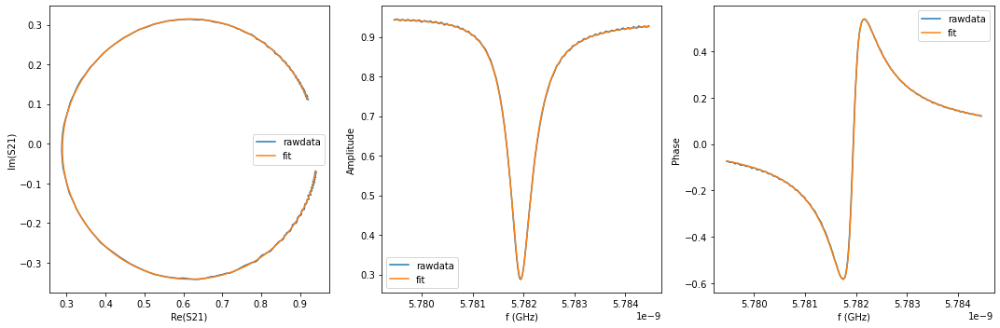

{'Qi_dia_corr': 25372.24981122556, 'Qi_no_corr': 25614.43220177811, 'absQc': 11180.195672320555, 'Qc_dia_corr(Re{Qc})': 11226.970352860308, 'Ql': 7783.048249085819, 'fr': 5.7819200015286, 'theta0': -3.0502781181703904, 'phi0': 0.09131455833625057, 'phi0_err': 0.0013336645329841354, 'Ql_err': 13.829237999576252, 'absQc_err': 9.538999663057904, 'fr_err': 5.788793369178142e-07, 'chi_square': 8.666114055769887e-06, 'Qi_no_corr_err': 139.2649284301757, 'Qi_dia_corr_err': 137.55297523122397, 'delay': 0.2936421277488962, 'a': 0.9442446836267882, 'alpha': -1.8721757539319352}


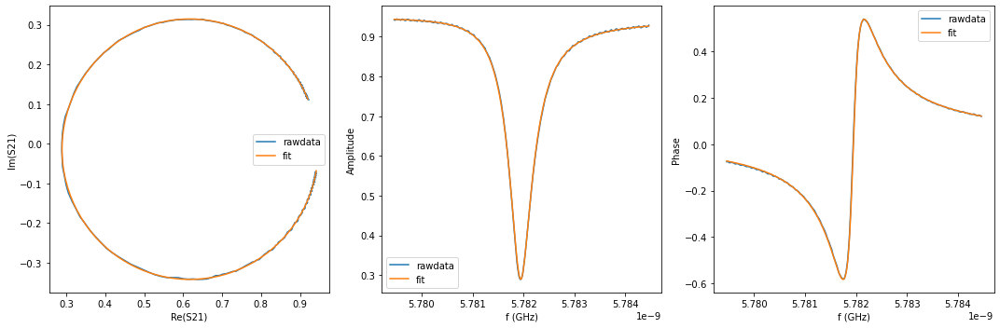

{'Qi_dia_corr': 25336.314364830996, 'Qi_no_corr': 25579.54879062916, 'absQc': 11171.154554102304, 'Qc_dia_corr(Re{Qc})': 11218.188293578514, 'Ql': 7775.4455549837585, 'fr': 5.7819193037438295, 'theta0': -3.0499900031837277, 'phi0': 0.0916031151604896, 'phi0_err': 0.001572757364305559, 'Ql_err': 14.413948862572964, 'absQc_err': 9.80722868877591, 'fr_err': 6.761592863578411e-07, 'chi_square': 1.000099274403092e-05, 'Qi_no_corr_err': 145.66763849113858, 'Qi_dia_corr_err': 143.82809859245387, 'delay': 0.3311687785160758, 'a': 0.9446046250024516, 'alpha': -0.5084630395360936}


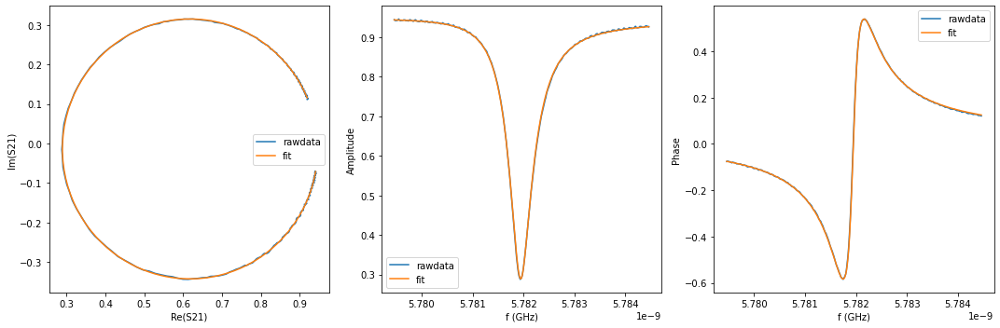

{'Qi_dia_corr': 25526.044977036454, 'Qi_no_corr': 25774.883989149694, 'absQc': 11252.582188827577, 'Qc_dia_corr(Re{Qc})': 11300.676627523158, 'Ql': 7832.9421489798215, 'fr': 5.781918582328172, 'theta0': -3.04930072857222, 'phi0': 0.09229206226308007, 'phi0_err': 0.0015749441023153743, 'Ql_err': 15.881519750013698, 'absQc_err': 10.266999902963471, 'fr_err': 6.643879584722013e-07, 'chi_square': 1.0560551038188322e-05, 'Qi_no_corr_err': 159.4404136785057, 'Qi_dia_corr_err': 158.37198187172652, 'delay': 0.07922042659712329, 'a': 0.9440693076372578, 'alpha': 2.9050115189861754}


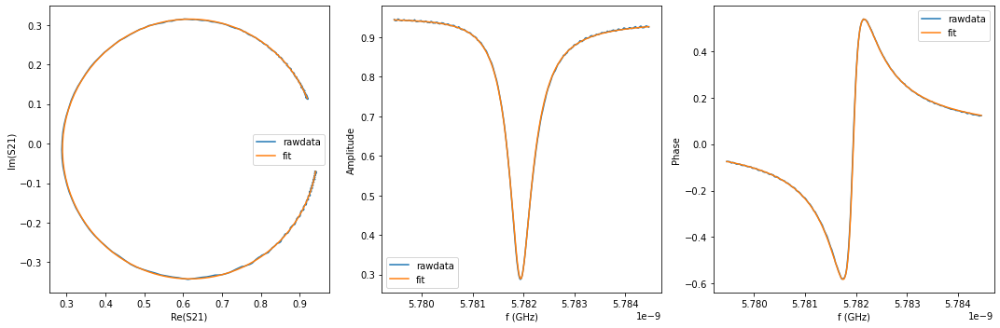

{'Qi_dia_corr': 25461.862162410085, 'Qi_no_corr': 25707.558642658, 'absQc': 11231.694385332397, 'Qc_dia_corr(Re{Qc})': 11279.246881308203, 'Ql': 7816.602080409027, 'fr': 5.781918478887891, 'theta0': -3.049735220976239, 'phi0': 0.0918574326135541, 'phi0_err': 0.001497318926987124, 'Ql_err': 15.599649796798051, 'absQc_err': 10.113518730984492, 'fr_err': 6.294254233517998e-07, 'chi_square': 9.805987588664676e-06, 'Qi_no_corr_err': 153.58081502502844, 'Qi_dia_corr_err': 152.08177660934055, 'delay': 0.14729435061757506, 'a': 0.944283329947552, 'alpha': -0.9053885292212351}


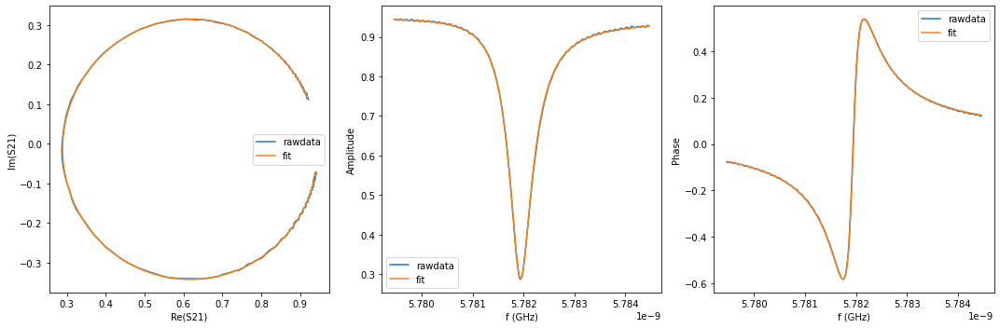

{'Qi_dia_corr': 25490.31329568932, 'Qi_no_corr': 25737.607362878865, 'absQc': 11234.82470649608, 'Qc_dia_corr(Re{Qc})': 11282.604693307496, 'Ql': 7820.894945293097, 'fr': 5.781918193349899, 'theta0': -3.049529317670582, 'phi0': 0.09206333591921124, 'phi0_err': 0.0016249276834699412, 'Ql_err': 16.226709827973213, 'absQc_err': 10.33825744724039, 'fr_err': 6.837771842080994e-07, 'chi_square': 1.0932155143544533e-05, 'Qi_no_corr_err': 162.6757610596342, 'Qi_dia_corr_err': 161.06849248437734, 'delay': 0.10645177200737782, 'a': 0.9443059586924242, 'alpha': -2.3889642158728264}


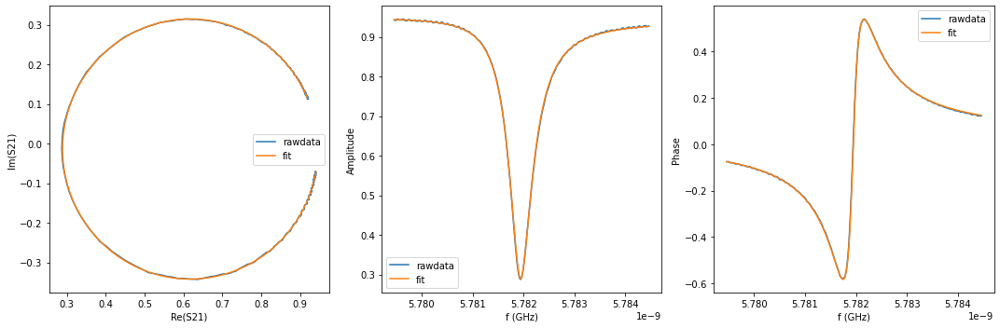

{'Qi_dia_corr': 25506.77510414099, 'Qi_no_corr': 25757.18517153464, 'absQc': 11247.358014240677, 'Qc_dia_corr(Re{Qc})': 11295.78246140468, 'Ql': 7828.776094031155, 'fr': 5.781917546796204, 'theta0': -3.048964193220645, 'phi0': 0.09262846036914822, 'phi0_err': 0.0017954081491310626, 'Ql_err': 17.178531686897713, 'absQc_err': 10.693245987665012, 'fr_err': 7.383344498386091e-07, 'chi_square': 1.1621290401798364e-05, 'Qi_no_corr_err': 174.53935345932263, 'Qi_dia_corr_err': 173.6229085763541, 'delay': 0.09755058423249192, 'a': 0.9441849249781797, 'alpha': -2.7122989026969435}


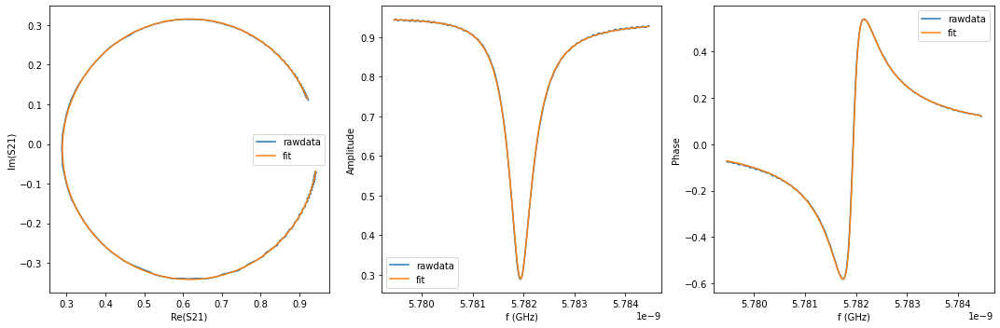

{'Qi_dia_corr': 25339.733780577564, 'Qi_no_corr': 25581.49215656062, 'absQc': 11167.940801208411, 'Qc_dia_corr(Re{Qc})': 11214.651081992408, 'Ql': 7774.067979208079, 'fr': 5.781917592485788, 'theta0': -3.0502909114543555, 'phi0': 0.09130177262322704, 'phi0_err': 0.0016914230525597218, 'Ql_err': 16.283217518526538, 'absQc_err': 10.119453605926271, 'fr_err': 7.135673560641841e-07, 'chi_square': 1.0978939716071875e-05, 'Qi_no_corr_err': 166.48143290140732, 'Qi_dia_corr_err': 164.49048184648265, 'delay': 0.3333543617352462, 'a': 0.9450960468960087, 'alpha': -0.4285948670902729}


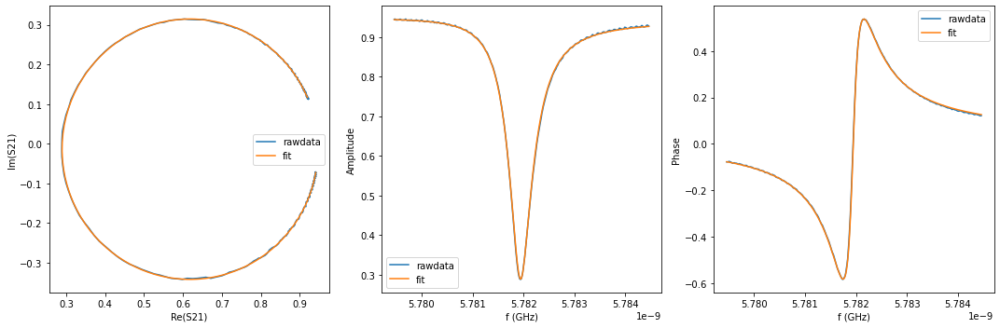

{'Qi_dia_corr': 25554.47987015412, 'Qi_no_corr': 25805.25859760093, 'absQc': 11280.3060310884, 'Qc_dia_corr(Re{Qc})': 11328.90468472242, 'Ql': 7849.178436591091, 'fr': 5.7819168707143085, 'theta0': -3.0489334569929647, 'phi0': 0.09265919659682849, 'phi0_err': 0.002044728682276012, 'Ql_err': 20.514810184128883, 'absQc_err': 11.817754725421548, 'fr_err': 8.478756356253459e-07, 'chi_square': 1.4214124358425665e-05, 'Qi_no_corr_err': 213.24921220080103, 'Qi_dia_corr_err': 213.31698997625014, 'delay': -0.040831222607099066, 'a': 0.9442578327857165, 'alpha': -1.456481503353518}


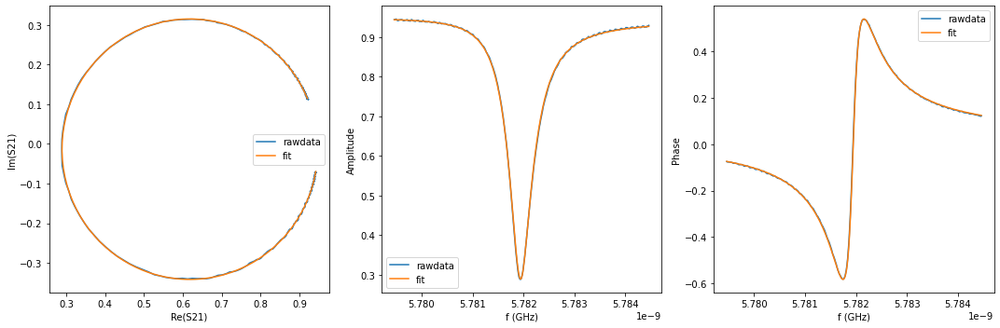

{'Qi_dia_corr': 25496.75131113304, 'Qi_no_corr': 25742.175618583067, 'absQc': 11231.73951548323, 'Qc_dia_corr(Re{Qc})': 11279.110164904292, 'Ql': 7819.821354091768, 'fr': 5.781916681007662, 'theta0': -3.049910595485166, 'phi0': 0.09168206002118778, 'phi0_err': 0.0018309480246348564, 'Ql_err': 19.493603966494323, 'absQc_err': 10.885071193728118, 'fr_err': 7.785502752880098e-07, 'chi_square': 1.204581859431757e-05, 'Qi_no_corr_err': 206.721360397331, 'Qi_dia_corr_err': 205.3022181891441, 'delay': 0.15670182076216413, 'a': 0.9447909260988814, 'alpha': -0.5629549327818342}


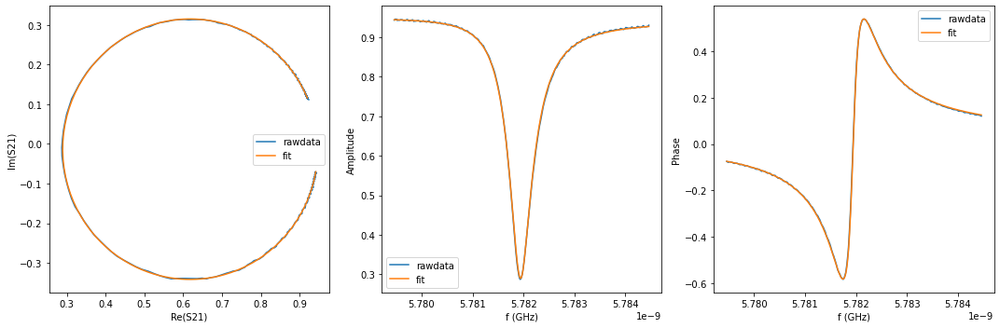

{'Qi_dia_corr': 25464.80366059255, 'Qi_no_corr': 25714.62798975956, 'absQc': 11249.065829097999, 'Qc_dia_corr(Re{Qc})': 11297.551671628271, 'Ql': 7825.666570152094, 'fr': 5.7819158453527315, 'theta0': -3.048912712812352, 'phi0': 0.09267994077744122, 'phi0_err': 0.0018649896481213932, 'Ql_err': 16.805075263908147, 'absQc_err': 11.180064417746147, 'fr_err': 7.885855432627303e-07, 'chi_square': 1.277820249374299e-05, 'Qi_no_corr_err': 169.65783630765404, 'Qi_dia_corr_err': 168.15307816023574, 'delay': 0.09463198708967639, 'a': 0.9446045143357363, 'alpha': -2.8175426598747273}


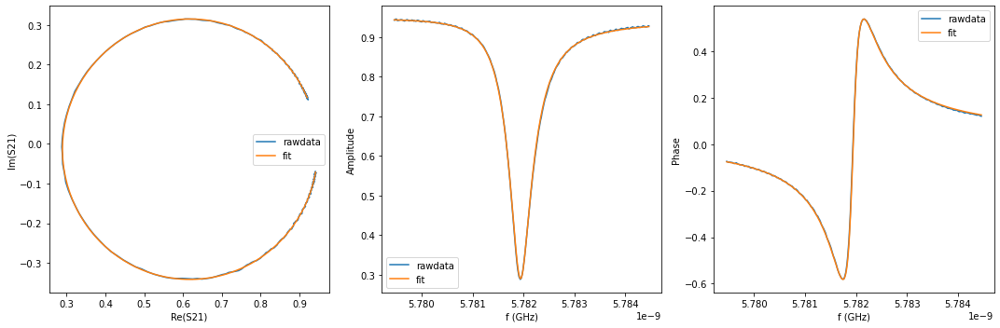

{'Qi_dia_corr': 25507.533514887014, 'Qi_no_corr': 25756.901393808403, 'absQc': 11269.180298347746, 'Qc_dia_corr(Re{Qc})': 11317.58913891491, 'Ql': 7839.316299976772, 'fr': 5.78191561018498, 'theta0': -3.04906846204088, 'phi0': 0.0925241915489134, 'phi0_err': 0.002075436283095738, 'Ql_err': 22.144869814501725, 'absQc_err': 11.514021732385016, 'fr_err': 8.677740221328245e-07, 'chi_square': 1.3982359677637775e-05, 'Qi_no_corr_err': 236.04952775351924, 'Qi_dia_corr_err': 235.22309968399736, 'delay': 0.015439570120254008, 'a': 0.9445502611047749, 'alpha': 0.5885085381158405}


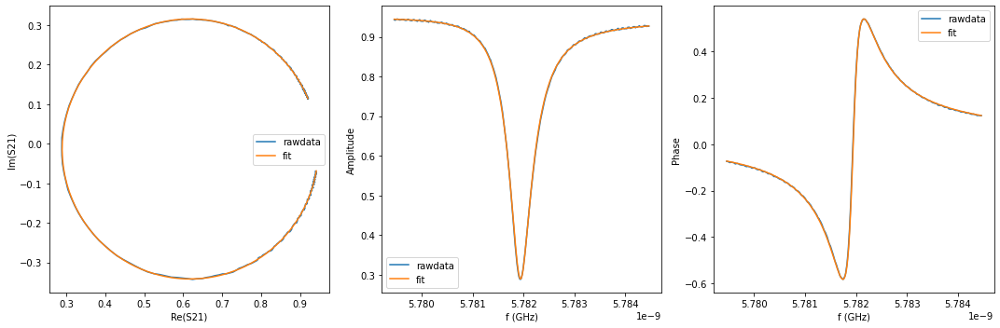

{'Qi_dia_corr': 25417.799409602692, 'Qi_no_corr': 25664.01911700548, 'absQc': 11200.089815050715, 'Qc_dia_corr(Re{Qc})': 11247.638998902881, 'Ql': 7797.267517178183, 'fr': 5.781915247232045, 'theta0': -3.049609358474008, 'phi0': 0.0919832951157852, 'phi0_err': 0.0018452545822249648, 'Ql_err': 18.866740871633557, 'absQc_err': 10.649652496600288, 'fr_err': 7.558248812158703e-07, 'chi_square': 1.2641706326466945e-05, 'Qi_no_corr_err': 191.95409910099983, 'Qi_dia_corr_err': 188.99491640098898, 'delay': 0.23398397469747995, 'a': 0.945188674161167, 'alpha': 2.2450650356373965}


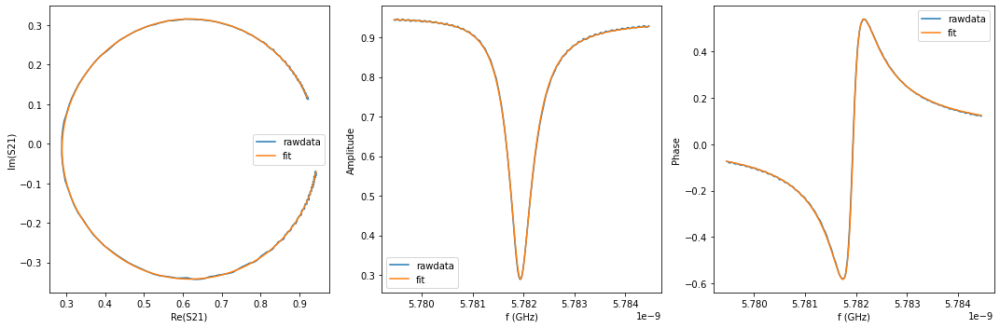

{'Qi_dia_corr': 25428.267048879716, 'Qi_no_corr': 25679.542740968613, 'absQc': 11214.174862254762, 'Qc_dia_corr(Re{Qc})': 11262.777434399653, 'Ql': 7805.5262897878, 'fr': 5.7819144845545996, 'theta0': -3.0486578951952605, 'phi0': 0.0929347583945328, 'phi0_err': 0.0019063075821588722, 'Ql_err': 20.434457983150153, 'absQc_err': 11.083747707312833, 'fr_err': 7.960226589626839e-07, 'chi_square': 1.3226428404109356e-05, 'Qi_no_corr_err': 215.13317376972256, 'Qi_dia_corr_err': 212.82046492749004, 'delay': 0.17662305163312625, 'a': 0.9453317559281769, 'alpha': 0.1612545970344517}


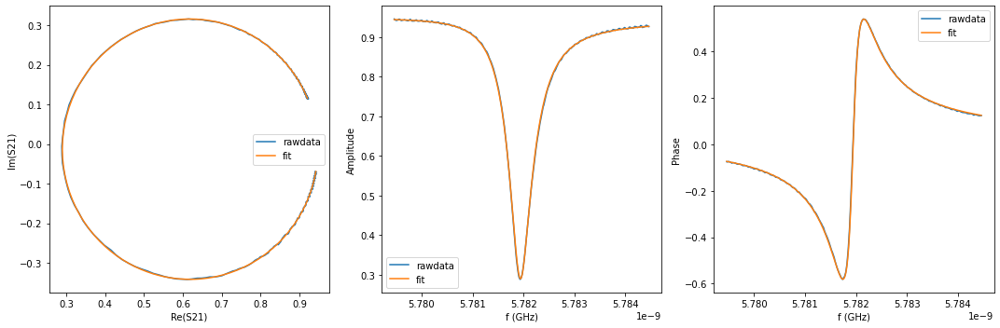

{'Qi_dia_corr': 25438.04881968364, 'Qi_no_corr': 25685.15116518833, 'absQc': 11222.818741694962, 'Qc_dia_corr(Re{Qc})': 11270.655536241375, 'Ql': 7810.231681861854, 'fr': 5.781914342879198, 'theta0': -3.0494257126616113, 'phi0': 0.0921669409281817, 'phi0_err': 0.0019379490081942521, 'Ql_err': 22.043284217915556, 'absQc_err': 11.184125960143493, 'fr_err': 7.859577805433723e-07, 'chi_square': 1.3723366044075444e-05, 'Qi_no_corr_err': 225.4719108049428, 'Qi_dia_corr_err': 223.45430068518908, 'delay': 0.1546232844728892, 'a': 0.9452096372219355, 'alpha': -0.637634167470025}


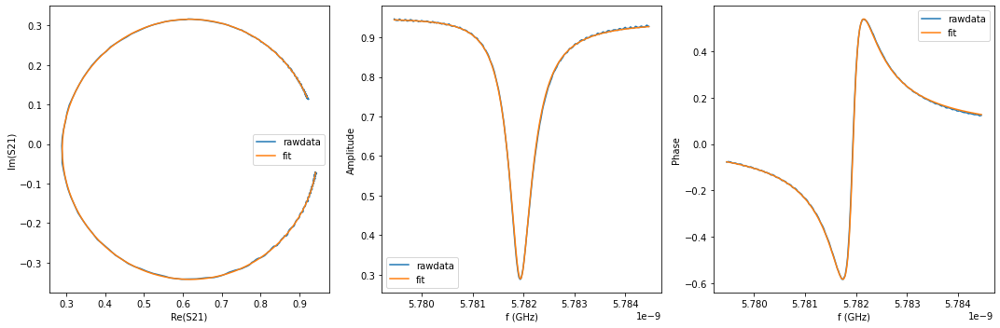

{'Qi_dia_corr': 25577.06361853694, 'Qi_no_corr': 25830.077268582027, 'absQc': 11286.290341698714, 'Qc_dia_corr(Re{Qc})': 11335.28528235993, 'Ql': 7854.371814147569, 'fr': 5.78191345959353, 'theta0': -3.048582375425058, 'phi0': 0.09301027816473512, 'phi0_err': 0.0023960726963651977, 'Ql_err': 26.05727251098842, 'absQc_err': 12.74382511948931, 'fr_err': 9.634577355382088e-07, 'chi_square': 1.7828889619665375e-05, 'Qi_no_corr_err': 267.9484295026063, 'Qi_dia_corr_err': 266.74385972749405, 'delay': -0.04889689364533411, 'a': 0.9448651675809134, 'alpha': -1.748490579658604}


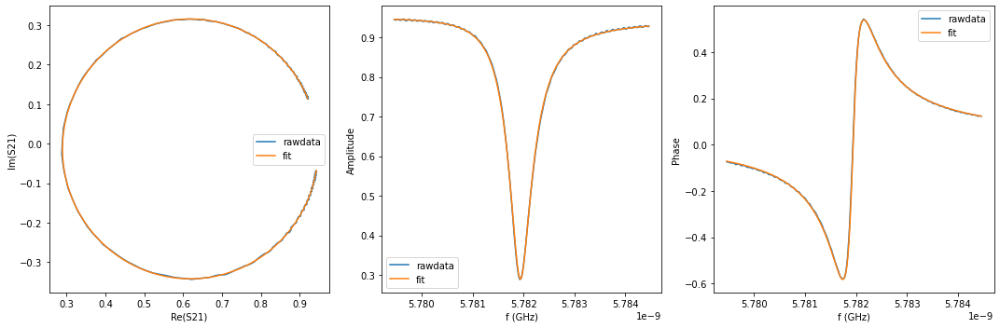

{'Qi_dia_corr': 25363.69233265239, 'Qi_no_corr': 25612.154360282846, 'absQc': 11180.631551536542, 'Qc_dia_corr(Re{Qc})': 11228.64857819556, 'Ql': 7783.049150714399, 'fr': 5.7819131979030995, 'theta0': -3.049079439259936, 'phi0': 0.09251321432985705, 'phi0_err': 0.001980845497678648, 'Ql_err': 20.272518858043266, 'absQc_err': 11.426686058266478, 'fr_err': 8.074821563838482e-07, 'chi_square': 1.4627205564730384e-05, 'Qi_no_corr_err': 204.7611506049876, 'Qi_dia_corr_err': 201.50307084180446, 'delay': 0.3006913738739019, 'a': 0.9459234449560752, 'alpha': -1.61450971017795}


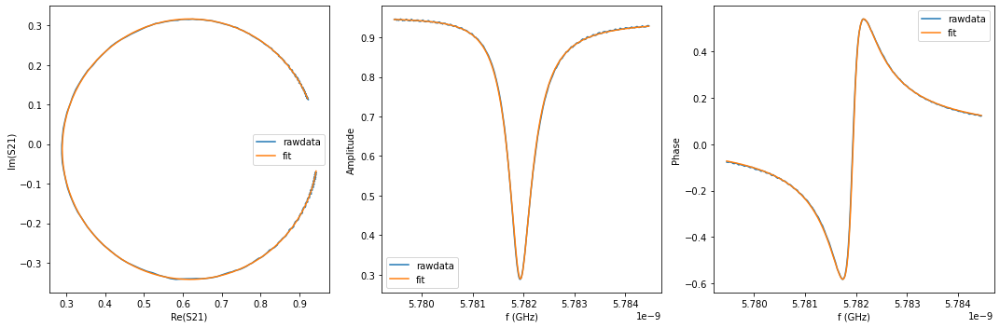

{'Qi_dia_corr': 25402.284146793856, 'Qi_no_corr': 25651.29138579833, 'absQc': 11191.133086126127, 'Qc_dia_corr(Re{Qc})': 11239.199243028661, 'Ql': 7791.75148878238, 'fr': 5.781912793375775, 'theta0': -3.049075574843213, 'phi0': 0.09251707874658043, 'phi0_err': 0.0021775644850299154, 'Ql_err': 22.82105836378689, 'absQc_err': 11.504807630993003, 'fr_err': 8.87871937280667e-07, 'chi_square': 1.477282546172567e-05, 'Qi_no_corr_err': 238.12018092347927, 'Qi_dia_corr_err': 234.82939852971782, 'delay': 0.23147468315229344, 'a': 0.9458954870855557, 'alpha': 2.154594725847046}


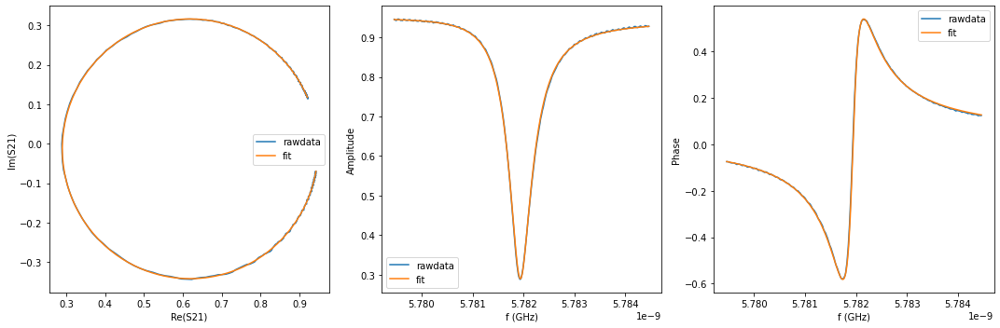

{'Qi_dia_corr': 25509.63556757531, 'Qi_no_corr': 25765.210778840497, 'absQc': 11247.662544475983, 'Qc_dia_corr(Re{Qc})': 11297.071872142717, 'Ql': 7829.664930259086, 'fr': 5.781911911616604, 'theta0': -3.048032747436248, 'phi0': 0.09356101798942024, 'phi0_err': 0.0022340980501999452, 'Ql_err': 24.749993714603658, 'absQc_err': 12.337892035849004, 'fr_err': 9.153843381440102e-07, 'chi_square': 1.7220965334690305e-05, 'Qi_no_corr_err': 256.16305592200825, 'Qi_dia_corr_err': 253.48620097162873, 'delay': 0.05729511309897622, 'a': 0.9454980507749343, 'alpha': 2.110281673645338}


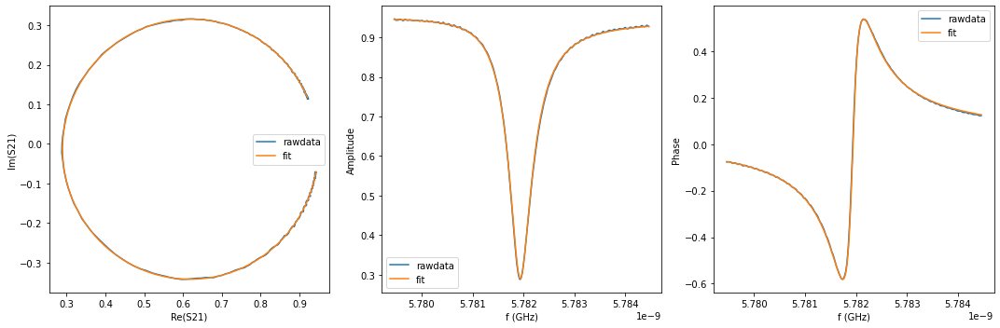

{'Qi_dia_corr': 25515.338745412297, 'Qi_no_corr': 25773.65087024246, 'absQc': 11262.778621792973, 'Qc_dia_corr(Re{Qc})': 11312.82632826612, 'Ql': 7837.7675172318395, 'fr': 5.781911203650225, 'theta0': -3.0474944775219943, 'phi0': 0.09409829772948446, 'phi0_err': 0.002390217209760945, 'Ql_err': 24.531639005303994, 'absQc_err': 12.61544486149829, 'fr_err': 9.770643856255485e-07, 'chi_square': 1.7651199877363715e-05, 'Qi_no_corr_err': 255.143718864861, 'Qi_dia_corr_err': 253.59519003453678, 'delay': 0.02241128278568186, 'a': 0.945504979050253, 'alpha': 0.8428887535337467}


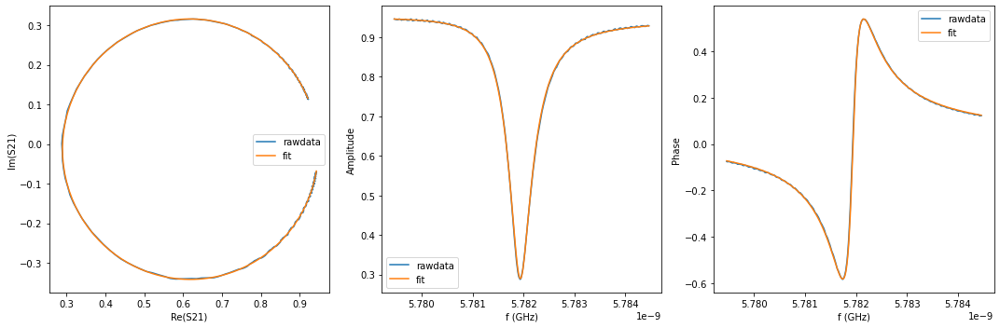

{'Qi_dia_corr': 25423.201643501176, 'Qi_no_corr': 25676.756375027642, 'absQc': 11211.052517566612, 'Qc_dia_corr(Re{Qc})': 11260.085622681088, 'Ql': 7803.756114638482, 'fr': 5.781910986580603, 'theta0': -3.0482357103758178, 'phi0': 0.09335693257470425, 'phi0_err': 0.002437112977405791, 'Ql_err': 26.580978330012172, 'absQc_err': 11.975224232637167, 'fr_err': 9.76022880355339e-07, 'chi_square': 1.6924226344441216e-05, 'Qi_no_corr_err': 275.9102693985346, 'Qi_dia_corr_err': 273.51135761007026, 'delay': 0.21208096511030203, 'a': 0.9459852894644363, 'alpha': 1.450053468890279}


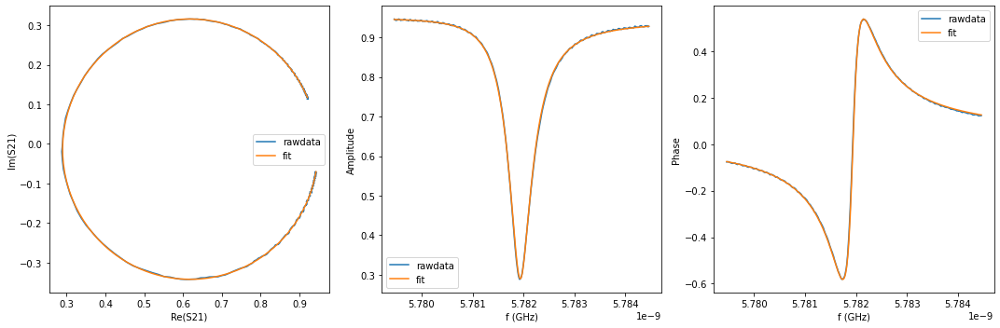

{'Qi_dia_corr': 25487.95728818613, 'Qi_no_corr': 25745.97510616292, 'absQc': 11256.17615408999, 'Qc_dia_corr(Re{Qc})': 11306.215712747737, 'Ql': 7832.010334087931, 'fr': 5.781910150222795, 'theta0': -3.0474744983177993, 'phi0': 0.09411815527199366, 'phi0_err': 0.0024944408780177684, 'Ql_err': 28.15092971863682, 'absQc_err': 12.857518521735717, 'fr_err': 9.972347215622482e-07, 'chi_square': 1.8595220936034066e-05, 'Qi_no_corr_err': 291.7373579158992, 'Qi_dia_corr_err': 289.6689964146405, 'delay': 0.05118766165335113, 'a': 0.9457556601375168, 'alpha': 1.8881391694612861}


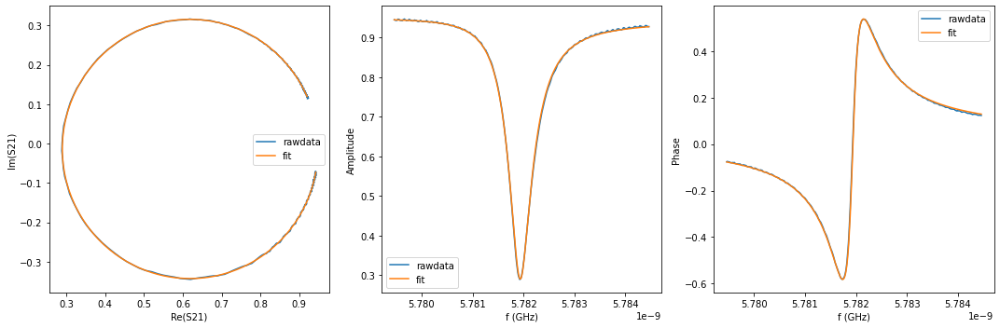

{'Qi_dia_corr': 25578.523930788153, 'Qi_no_corr': 25842.132608834454, 'absQc': 11308.9539634368, 'Qc_dia_corr(Re{Qc})': 11360.188622684052, 'Ql': 7866.458694870713, 'fr': 5.781909309918952, 'theta0': -3.046583048958964, 'phi0': 0.09500960463082887, 'phi0_err': 0.0032507999024648363, 'Ql_err': 35.82875333818978, 'absQc_err': 14.619944476318022, 'fr_err': 1.281344148892942e-06, 'chi_square': 2.4038639041504513e-05, 'Qi_no_corr_err': 375.45316314463776, 'Qi_dia_corr_err': 376.5284788768174, 'delay': -0.13786163993649642, 'a': 0.9454497041477407, 'alpha': 1.3034494357952282}


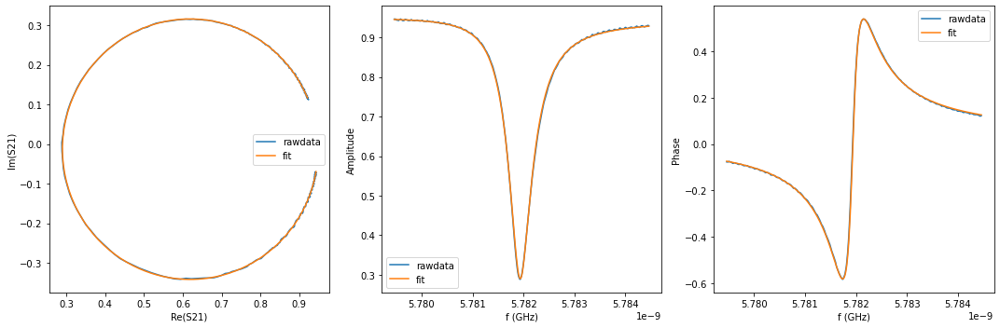

{'Qi_dia_corr': 25483.53047197975, 'Qi_no_corr': 25738.212349216712, 'absQc': 11242.453428907844, 'Qc_dia_corr(Re{Qc})': 11291.74609053365, 'Ql': 7824.646949719799, 'fr': 5.781909452315695, 'theta0': -3.0481201887445204, 'phi0': 0.09347246484527254, 'phi0_err': 0.0027978389405633026, 'Ql_err': 30.371852033310464, 'absQc_err': 13.0693210236961, 'fr_err': 1.131636599657999e-06, 'chi_square': 1.9813567596180853e-05, 'Qi_no_corr_err': 320.94081138001184, 'Qi_dia_corr_err': 320.3177931960951, 'delay': 0.09542469306752127, 'a': 0.9461011432480959, 'alpha': -2.7878252699574495}


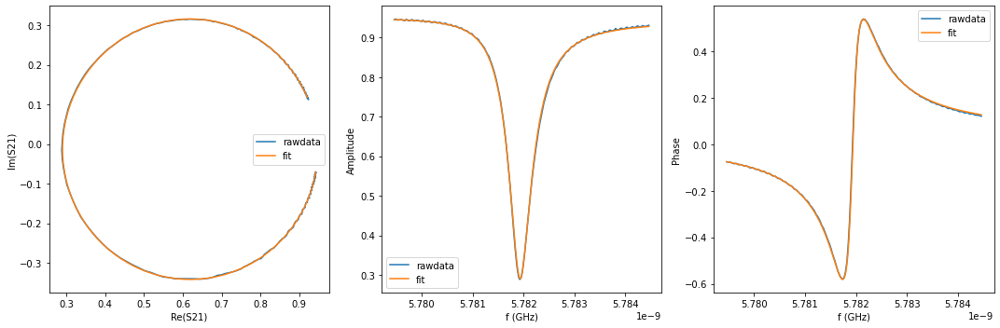

{'Qi_dia_corr': 25520.87626702261, 'Qi_no_corr': 25778.03360691086, 'absQc': 11278.295136271983, 'Qc_dia_corr(Re{Qc})': 11328.23637552778, 'Ql': 7845.684689014524, 'fr': 5.781908629918416, 'theta0': -3.047659209409086, 'phi0': 0.09393407959840598, 'phi0_err': 0.0026550443514024207, 'Ql_err': 25.60649487730893, 'absQc_err': 14.107981881376688, 'fr_err': 1.0789799681215257e-06, 'chi_square': 2.15822848032461e-05, 'Qi_no_corr_err': 266.1246869240448, 'Qi_dia_corr_err': 263.41501844481274, 'delay': -0.013401812833469187, 'a': 0.9458184460818233, 'alpha': -0.45800504425552635}


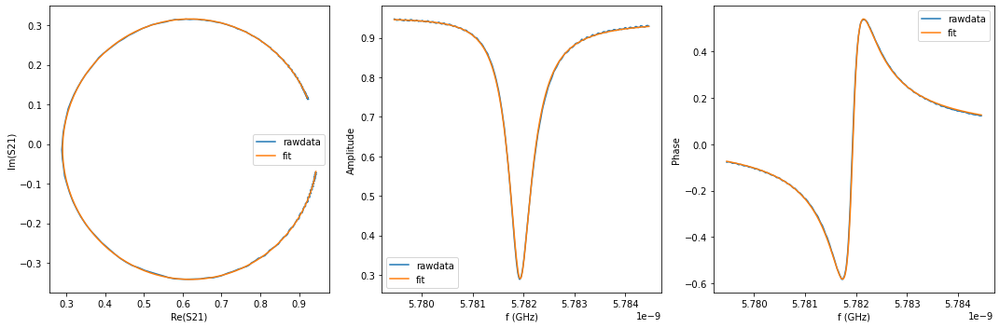

{'Qi_dia_corr': 25425.652513427583, 'Qi_no_corr': 25679.525589037337, 'absQc': 11240.466610374526, 'Qc_dia_corr(Re{Qc})': 11289.809946827876, 'Ql': 7818.253275753147, 'fr': 5.781908186340845, 'theta0': -3.0480643026572065, 'phi0': 0.09352855889945548, 'phi0_err': 0.002779855922652611, 'Ql_err': 28.005547324687903, 'absQc_err': 13.19869541323057, 'fr_err': 1.1095867772030583e-06, 'chi_square': 2.0645893966905564e-05, 'Qi_no_corr_err': 287.93568219298555, 'Qi_dia_corr_err': 286.1637177417413, 'delay': 0.11252843396013425, 'a': 0.9462399450234836, 'alpha': -2.1663308869127884}


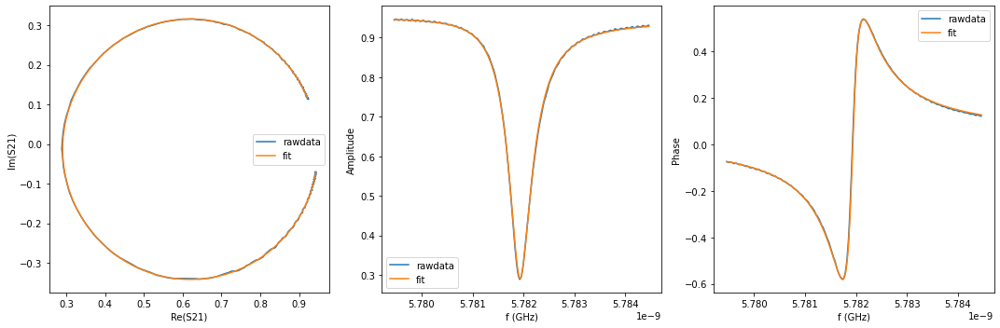

{'Qi_dia_corr': 25452.304229283825, 'Qi_no_corr': 25712.520049748862, 'absQc': 11259.475781021065, 'Qc_dia_corr(Re{Qc})': 11310.110331718359, 'Ql': 7830.507665702529, 'fr': 5.781907064955837, 'theta0': -3.0469334918791957, 'phi0': 0.09466015602407295, 'phi0_err': 0.0027537602562101573, 'Ql_err': 28.459882466411216, 'absQc_err': 13.743856534341672, 'fr_err': 1.130110507762801e-06, 'chi_square': 2.159832403884067e-05, 'Qi_no_corr_err': 301.59926492717796, 'Qi_dia_corr_err': 299.36499029643056, 'delay': 0.06495137063993411, 'a': 0.9463669025625376, 'alpha': 2.3889234310977248}


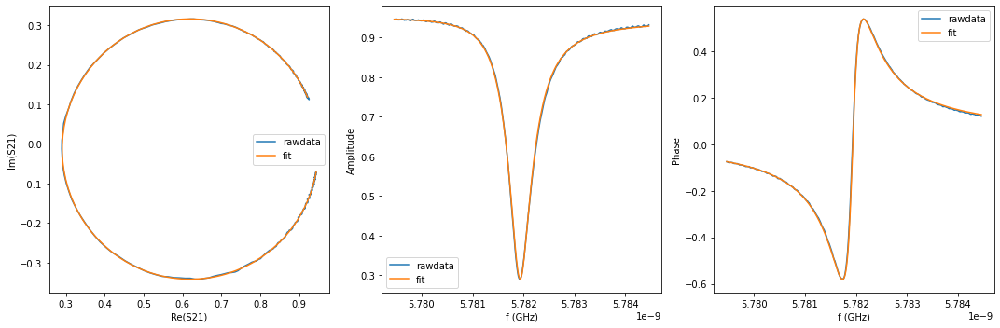

{'Qi_dia_corr': 25468.838542840618, 'Qi_no_corr': 25730.463822131496, 'absQc': 11269.910743320926, 'Qc_dia_corr(Re{Qc})': 11320.846448848244, 'Ql': 7837.218786709989, 'fr': 5.781906458099001, 'theta0': -3.0466962661178916, 'phi0': 0.09489638747190163, 'phi0_err': 0.002947062264486427, 'Ql_err': 31.002838468707612, 'absQc_err': 14.359791483611492, 'fr_err': 1.212136759771801e-06, 'chi_square': 2.296948493626207e-05, 'Qi_no_corr_err': 330.4381364890551, 'Qi_dia_corr_err': 329.70607620399323, 'delay': 0.004381769841585198, 'a': 0.9464927102778041, 'alpha': 0.18845799043729342}


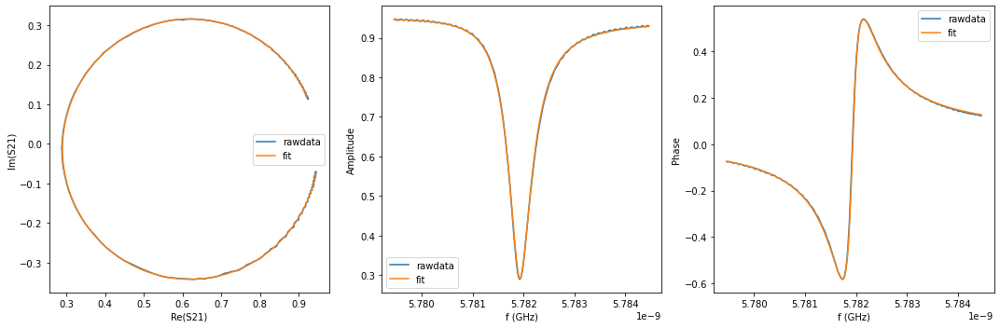

{'Qi_dia_corr': 25431.150503755423, 'Qi_no_corr': 25696.182192327302, 'absQc': 11243.894292541414, 'Qc_dia_corr(Re{Qc})': 11295.403122129383, 'Ql': 7821.455280710151, 'fr': 5.78190558082386, 'theta0': -3.0460559731678996, 'phi0': 0.09553668042189374, 'phi0_err': 0.002774963709423622, 'Ql_err': 28.515775877239978, 'absQc_err': 14.076696920258692, 'fr_err': 1.1175683734650315e-06, 'chi_square': 2.226193994681324e-05, 'Qi_no_corr_err': 295.99760459097297, 'Qi_dia_corr_err': 293.6281322041479, 'delay': 0.0925658133097718, 'a': 0.9467137890076273, 'alpha': -2.8910557379703827}


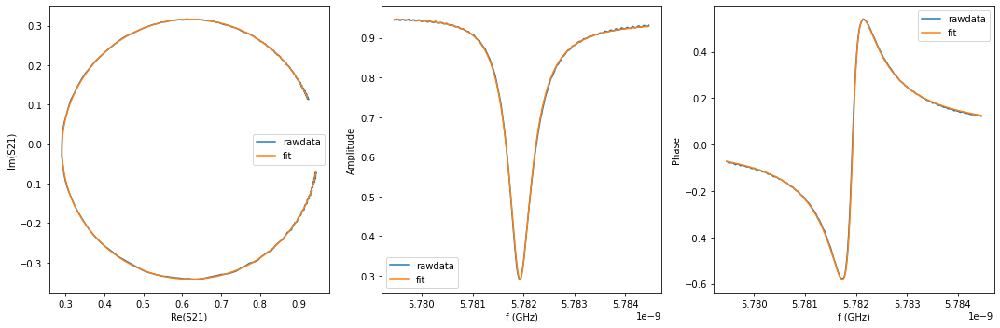

{'Qi_dia_corr': 25384.176530232995, 'Qi_no_corr': 25644.32199555338, 'absQc': 11224.446921864264, 'Qc_dia_corr(Re{Qc})': 11275.02290605498, 'Ql': 7807.240098822543, 'fr': 5.781905152389681, 'theta0': -3.046840144220054, 'phi0': 0.0947525546875016, 'phi0_err': 0.002901668367624917, 'Ql_err': 29.553185907042554, 'absQc_err': 13.946405463436706, 'fr_err': 1.1758030502601084e-06, 'chi_square': 2.304277868198379e-05, 'Qi_no_corr_err': 312.3809507587967, 'Qi_dia_corr_err': 308.9474212503681, 'delay': 0.1513350350222777, 'a': 0.9469908856706745, 'alpha': -0.7560679693977788}


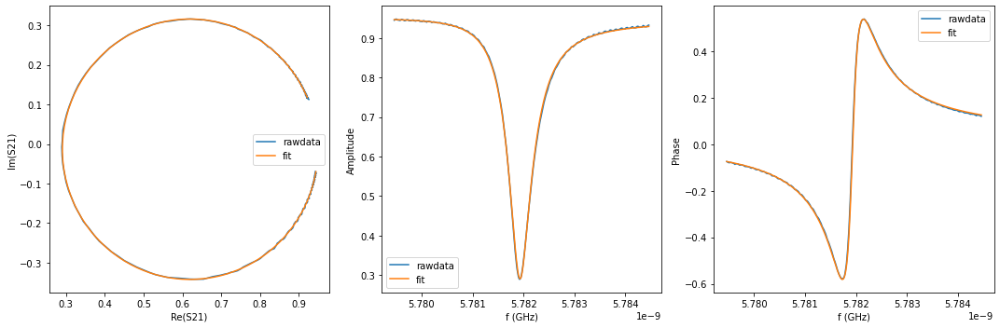

{'Qi_dia_corr': 25404.423860343722, 'Qi_no_corr': 25665.800692973615, 'absQc': 11245.724311024387, 'Qc_dia_corr(Re{Qc})': 11296.650367035621, 'Ql': 7819.523002195588, 'fr': 5.781904548536101, 'theta0': -3.046603621324606, 'phi0': 0.0949890322651869, 'phi0_err': 0.00321119032843947, 'Ql_err': 31.395208462449705, 'absQc_err': 14.438476901055555, 'fr_err': 1.2926564766031374e-06, 'chi_square': 2.499229116755186e-05, 'Qi_no_corr_err': 329.452557937895, 'Qi_dia_corr_err': 326.6088817153565, 'delay': 0.06782052766559395, 'a': 0.9468526921526392, 'alpha': 2.49297716177191}


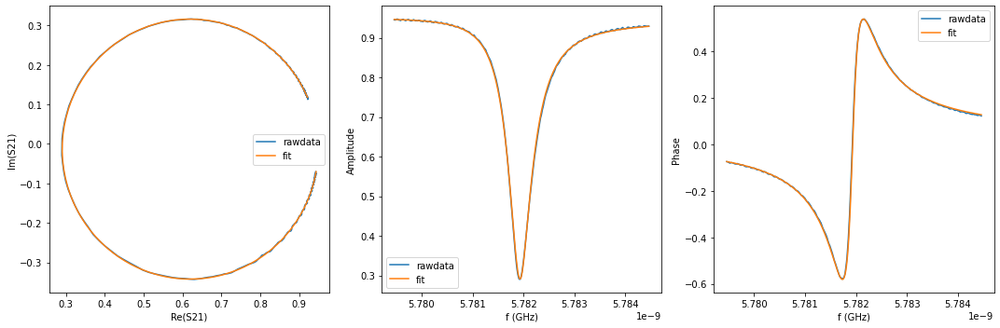

{'Qi_dia_corr': 25426.805930329505, 'Qi_no_corr': 25687.989798151222, 'absQc': 11257.080037065025, 'Qc_dia_corr(Re{Qc})': 11307.982088610119, 'Ql': 7827.072960989723, 'fr': 5.781904071394169, 'theta0': -3.0466736698746106, 'phi0': 0.0949189951045553, 'phi0_err': 0.003062430542211192, 'Ql_err': 31.7005187711776, 'absQc_err': 15.123132126832399, 'fr_err': 1.2454987399282507e-06, 'chi_square': 2.6141690418888262e-05, 'Qi_no_corr_err': 335.8267678220042, 'Qi_dia_corr_err': 332.6520095761415, 'delay': 0.0348741679350147, 'a': 0.9468662461458592, 'alpha': 1.2962678964782426}


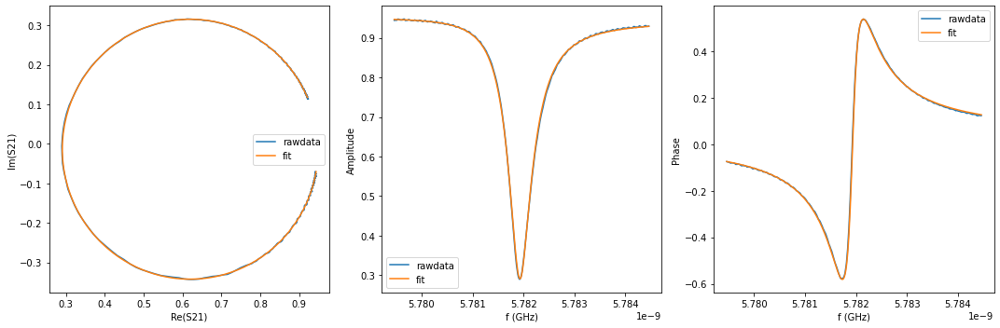

{'Qi_dia_corr': 25408.1771808544, 'Qi_no_corr': 25672.584586962064, 'absQc': 11260.128407890592, 'Qc_dia_corr(Re{Qc})': 11311.758629082395, 'Ql': 7827.115193295292, 'fr': 5.781903270487118, 'theta0': -3.0460126122191515, 'phi0': 0.0955800496263335, 'phi0_err': 0.0033211908304612283, 'Ql_err': 37.927365132929296, 'absQc_err': 15.0509807362007, 'fr_err': 1.3241459067714948e-06, 'chi_square': 2.676198943522736e-05, 'Qi_no_corr_err': 397.9830309255014, 'Qi_dia_corr_err': 396.06165599679105, 'delay': 0.04541798909247809, 'a': 0.9468423959038482, 'alpha': 1.6791281017892126}


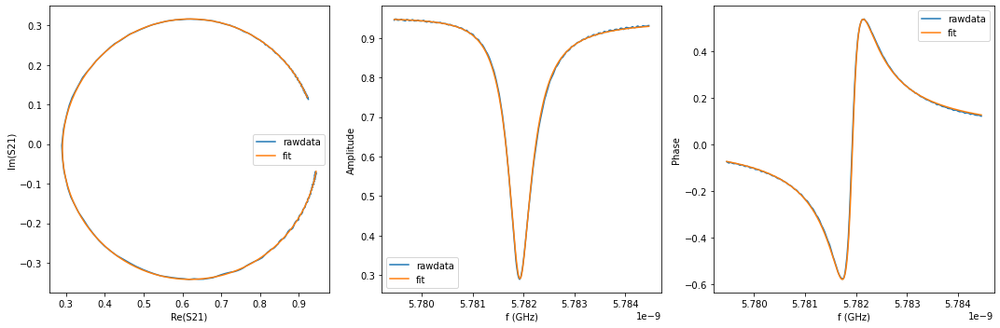

{'Qi_dia_corr': 25395.572538382905, 'Qi_no_corr': 25659.433574444894, 'absQc': 11238.578136448452, 'Qc_dia_corr(Re{Qc})': 11289.95573468858, 'Ql': 7815.4766555692495, 'fr': 5.781902411519224, 'theta0': -3.04615485537833, 'phi0': 0.09543784219991226, 'phi0_err': 0.003418303598255041, 'Ql_err': 35.032998172181884, 'absQc_err': 15.006023053054053, 'fr_err': 1.3757724515437097e-06, 'chi_square': 2.7293164611974287e-05, 'Qi_no_corr_err': 369.229351972366, 'Qi_dia_corr_err': 368.0900342739898, 'delay': 0.09043479498178848, 'a': 0.9473150639927639, 'alpha': -2.9678218556979443}


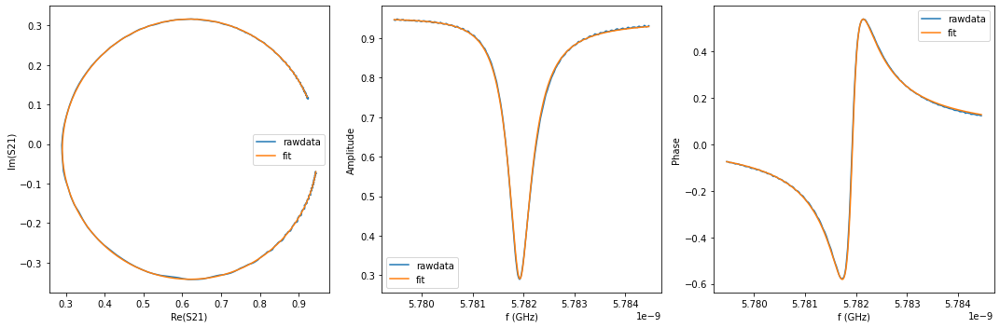

{'Qi_dia_corr': 25453.2072731982, 'Qi_no_corr': 25719.758126523986, 'absQc': 11269.861525607368, 'Qc_dia_corr(Re{Qc})': 11321.813884834442, 'Ql': 7836.2014879852495, 'fr': 5.781901657168043, 'theta0': -3.045757280132716, 'phi0': 0.09583537345707674, 'phi0_err': 0.003375339997859917, 'Ql_err': 35.59787167198545, 'absQc_err': 15.445758595166037, 'fr_err': 1.3377539654479937e-06, 'chi_square': 2.8751572151632553e-05, 'Qi_no_corr_err': 372.06849627751285, 'Qi_dia_corr_err': 366.85011448102745, 'delay': -0.00026539078409848157, 'a': 0.9469418802846704, 'alpha': 0.02011115062158523}


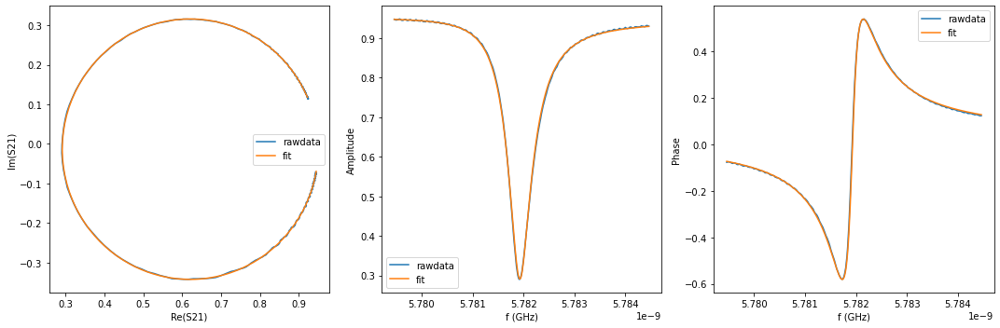

{'Qi_dia_corr': 25376.47848700522, 'Qi_no_corr': 25646.38320503838, 'absQc': 11242.436991210929, 'Qc_dia_corr(Re{Qc})': 11295.0997403869, 'Ql': 7816.1308955175, 'fr': 5.781900797208885, 'theta0': -3.044989654385319, 'phi0': 0.09660299920447434, 'phi0_err': 0.003653052851774989, 'Ql_err': 46.62082836518497, 'absQc_err': 15.186722166464591, 'fr_err': 1.4451557703194155e-06, 'chi_square': 2.8316431485913142e-05, 'Qi_no_corr_err': 496.3461920472888, 'Qi_dia_corr_err': 493.0042867082359, 'delay': 0.06853074520635799, 'a': 0.9474283757417108, 'alpha': 2.5195580369325175}


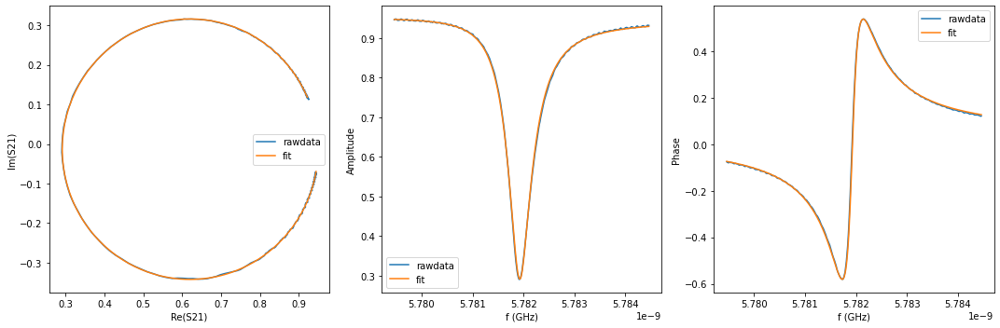

{'Qi_dia_corr': 25405.370176993532, 'Qi_no_corr': 25673.64428949117, 'absQc': 11254.319722312288, 'Qc_dia_corr(Re{Qc})': 11306.657975479598, 'Ql': 7824.406489848606, 'fr': 5.781900130255875, 'theta0': -3.0453372687366325, 'phi0': 0.09625541099457917, 'phi0_err': 0.004009610991033281, 'Ql_err': 51.56638517726811, 'absQc_err': 15.991659055295722, 'fr_err': 1.593044704069662e-06, 'chi_square': 3.144840047173314e-05, 'Qi_no_corr_err': 551.2502085862635, 'Qi_dia_corr_err': 548.476086319209, 'delay': 0.048873422305873014, 'a': 0.9473825038132079, 'alpha': 1.8053858910818612}


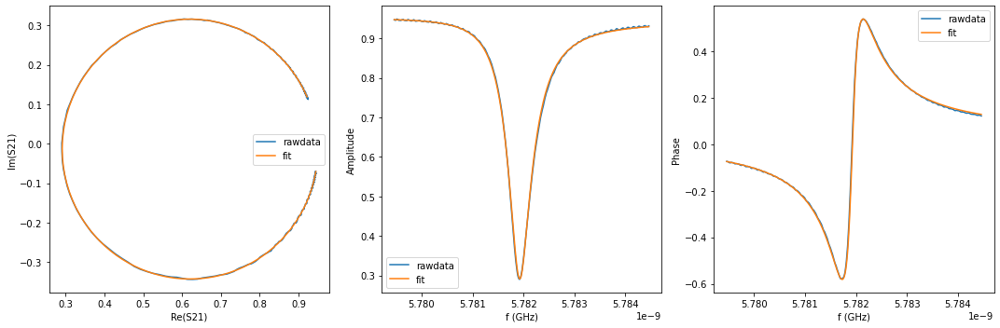

{'Qi_dia_corr': 25438.94424849588, 'Qi_no_corr': 25711.45391501746, 'absQc': 11273.091694451556, 'Qc_dia_corr(Re{Qc})': 11326.288659811737, 'Ql': 7836.991716546834, 'fr': 5.781899034767468, 'theta0': -3.0446344093504663, 'phi0': 0.09695824423932678, 'phi0_err': 0.003758208396956808, 'Ql_err': 39.8313304274644, 'absQc_err': 16.639890201442455, 'fr_err': 1.4921363440404695e-06, 'chi_square': 3.292608627036304e-05, 'Qi_no_corr_err': 418.45842235124337, 'Qi_dia_corr_err': 416.90640926519103, 'delay': -0.012222421155885527, 'a': 0.9473689638005759, 'alpha': -0.4140931702717643}


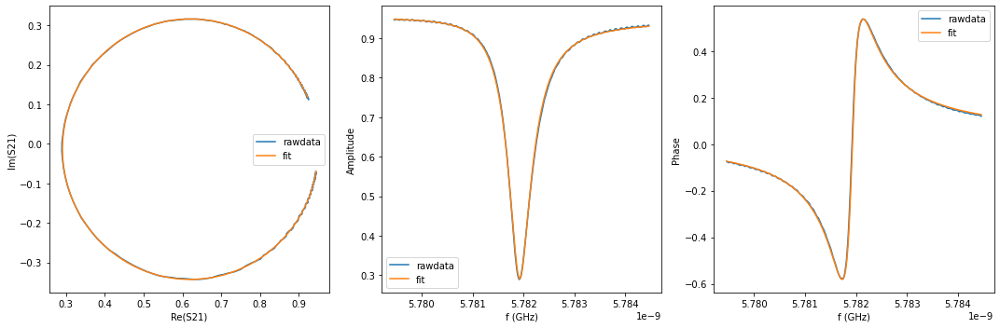

{'Qi_dia_corr': 25407.98034230001, 'Qi_no_corr': 25678.248160129762, 'absQc': 11249.048841563688, 'Qc_dia_corr(Re{Qc})': 11301.713454063618, 'Ql': 7822.285711999065, 'fr': 5.781898573207002, 'theta0': -3.0450162945224584, 'phi0': 0.09657641707109074, 'phi0_err': 0.003724700205115006, 'Ql_err': 39.72252426910235, 'absQc_err': 16.435479535109966, 'fr_err': 1.478459781999071e-06, 'chi_square': 3.336222074395417e-05, 'Qi_no_corr_err': 418.1060755915499, 'Qi_dia_corr_err': 413.9525247355023, 'delay': 0.06253529686492675, 'a': 0.9476968767588615, 'alpha': 2.3015758848526535}


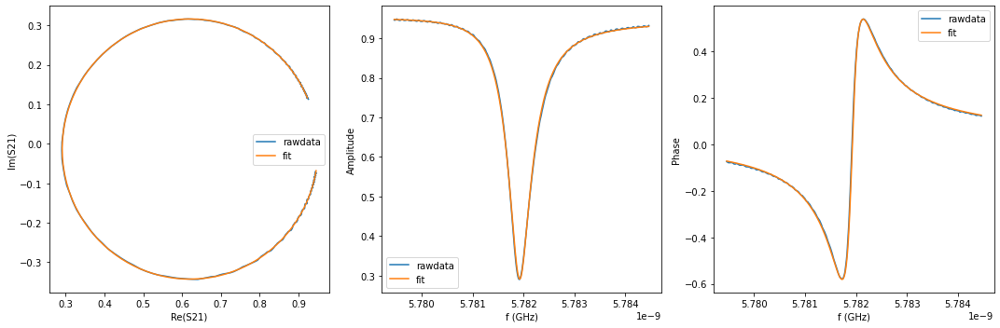

{'Qi_dia_corr': 25323.71680672489, 'Qi_no_corr': 25591.374129433047, 'absQc': 11203.602867906347, 'Qc_dia_corr(Re{Qc})': 11255.684874367056, 'Ql': 7792.2481813458535, 'fr': 5.781897981672602, 'theta0': -3.0453561950386625, 'phi0': 0.09623664933404348, 'phi0_err': 0.004049568652105875, 'Ql_err': 47.92589871412819, 'absQc_err': 15.894051739948836, 'fr_err': 1.5815891412715178e-06, 'chi_square': 3.2090598812837e-05, 'Qi_no_corr_err': 512.0686545321553, 'Qi_dia_corr_err': 507.2601692041925, 'delay': 0.1955429771752023, 'a': 0.9482182698192207, 'alpha': 0.8505354614668595}


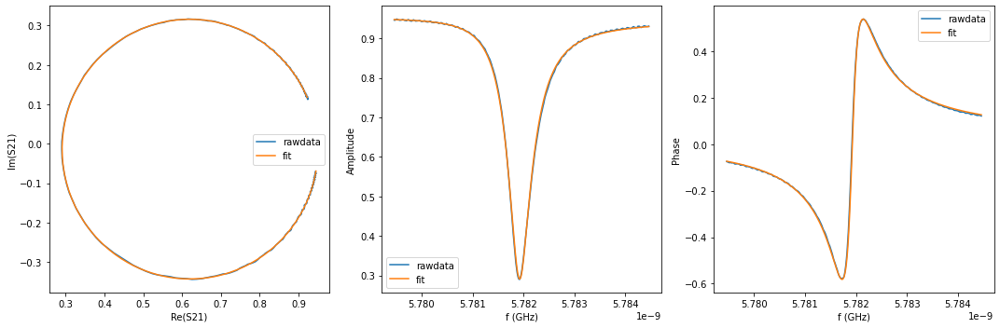

{'Qi_dia_corr': 25425.786590704443, 'Qi_no_corr': 25699.825425854848, 'absQc': 11244.01433842353, 'Qc_dia_corr(Re{Qc})': 11297.28683970833, 'Ql': 7821.850880338181, 'fr': 5.7818968377268245, 'theta0': -3.044441227282318, 'phi0': 0.09715167038671248, 'phi0_err': 0.004160136996441626, 'Ql_err': 48.71700026879519, 'absQc_err': 16.680486742586826, 'fr_err': 1.651063959763016e-06, 'chi_square': 3.449681284817492e-05, 'Qi_no_corr_err': 526.4967903773302, 'Qi_dia_corr_err': 521.0539960942513, 'delay': 0.08835148117690773, 'a': 0.94793694870143, 'alpha': -3.0435031501255785}


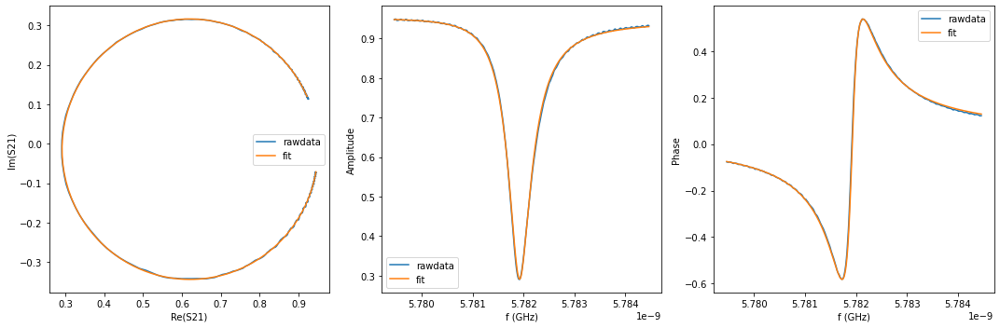

{'Qi_dia_corr': 25481.761864717068, 'Qi_no_corr': 25762.896646590278, 'absQc': 11290.875561881236, 'Qc_dia_corr(Re{Qc})': 11345.734915857567, 'Ql': 7850.365639257471, 'fr': 5.78189558644497, 'theta0': -3.0432148173164855, 'phi0': 0.09837826853328037, 'phi0_err': 0.0040206614015510286, 'Ql_err': 47.12807522647913, 'absQc_err': 17.98138923371311, 'fr_err': 1.5912053367108057e-06, 'chi_square': 3.7577999951092926e-05, 'Qi_no_corr_err': 499.1753839874087, 'Qi_dia_corr_err': 497.64667380302086, 'delay': -0.0690822649580316, 'a': 0.947808073679771, 'alpha': -2.4796002466528764}


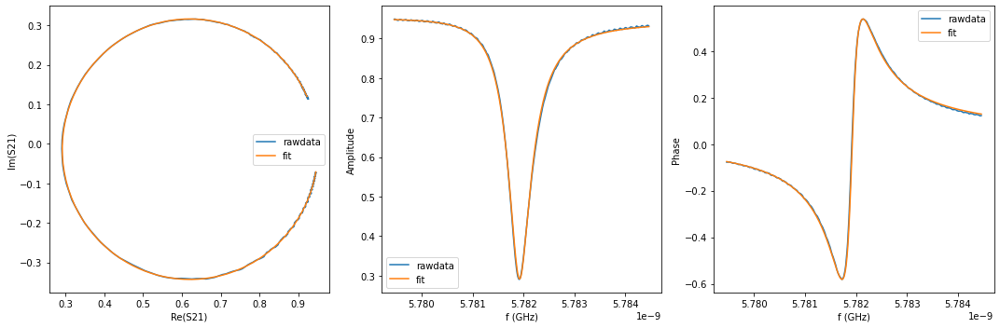

{'Qi_dia_corr': 25463.848153043702, 'Qi_no_corr': 25741.83604314091, 'absQc': 11285.545506723342, 'Qc_dia_corr(Re{Qc})': 11339.819404969849, 'Ql': 7845.833270717544, 'fr': 5.7818950673866105, 'theta0': -3.043717040573032, 'phi0': 0.09787703504969661, 'phi0_err': 0.004022929127468001, 'Ql_err': 40.594615796767016, 'absQc_err': 18.055945013989522, 'fr_err': 1.5887406190875984e-06, 'chi_square': 3.9085203427411624e-05, 'Qi_no_corr_err': 424.28380201799314, 'Qi_dia_corr_err': 421.4450296548969, 'delay': -0.06930547516003759, 'a': 0.9479525415158051, 'alpha': -2.487435845958129}


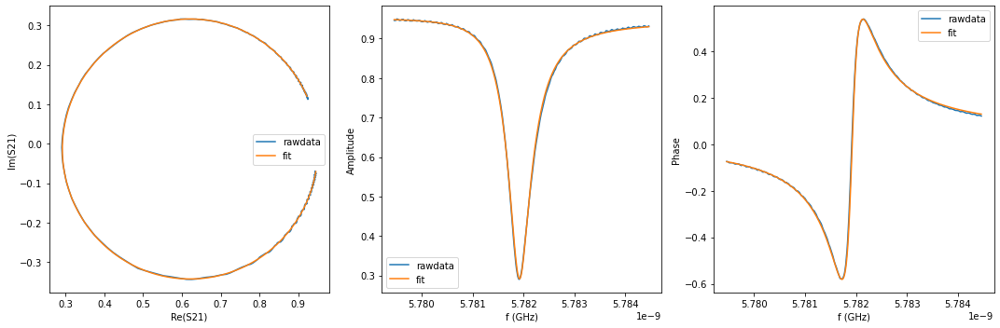

{'Qi_dia_corr': 25463.658656881988, 'Qi_no_corr': 25743.88512383814, 'absQc': 11294.809588139355, 'Qc_dia_corr(Re{Qc})': 11349.608768624146, 'Ql': 7850.500207790956, 'fr': 5.781894065126628, 'theta0': -3.04328527945825, 'phi0': 0.09830746119222233, 'phi0_err': 0.004158480866207851, 'Ql_err': 51.136054218334635, 'absQc_err': 18.62688924370589, 'fr_err': 1.6334962884264093e-06, 'chi_square': 4.1759043960379246e-05, 'Qi_no_corr_err': 535.2359955410712, 'Qi_dia_corr_err': 529.9263366353244, 'delay': -0.07499183845208714, 'a': 0.9480881185952168, 'alpha': -2.6937957492356395}


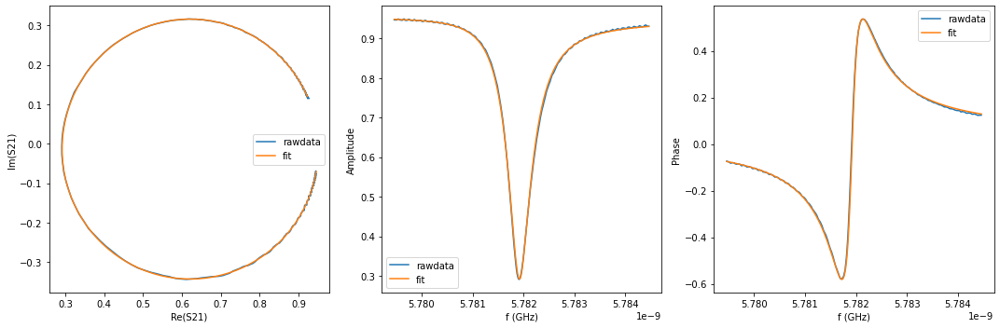

{'Qi_dia_corr': 25432.71442145362, 'Qi_no_corr': 25715.15957578255, 'absQc': 11286.132553198211, 'Qc_dia_corr(Re{Qc})': 11341.412099217861, 'Ql': 7843.636881308033, 'fr': 5.78189297175448, 'theta0': -3.0428192032574866, 'phi0': 0.09877345033230654, 'phi0_err': 0.004577641463420873, 'Ql_err': 64.11510122479541, 'absQc_err': 18.44499016067103, 'fr_err': 1.7927378424040439e-06, 'chi_square': 4.143070985580892e-05, 'Qi_no_corr_err': 679.1095154100283, 'Qi_dia_corr_err': 675.0602808115333, 'delay': -0.06393296775702394, 'a': 0.9482850630643868, 'alpha': -2.2922141611217124}


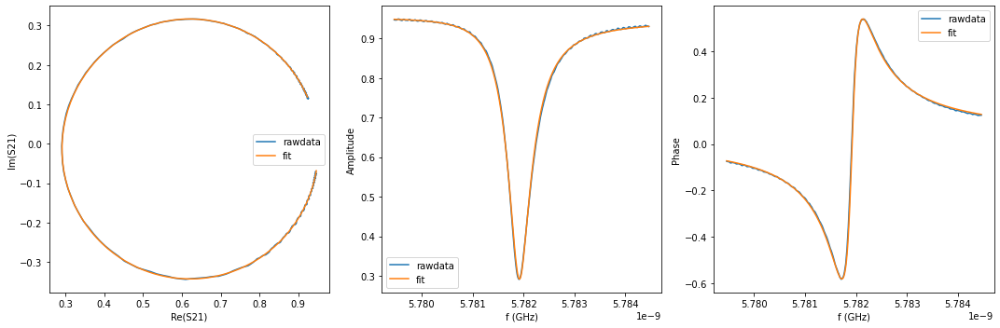

{'Qi_dia_corr': 25387.57716880287, 'Qi_no_corr': 25666.36206188717, 'absQc': 11247.085672384237, 'Qc_dia_corr(Re{Qc})': 11301.468092429363, 'Ql': 7820.233295099854, 'fr': 5.781892293694666, 'theta0': -3.0434515050110327, 'phi0': 0.0981411485787603, 'phi0_err': 0.004550521488491206, 'Ql_err': 45.31580351626206, 'absQc_err': 18.26619583651646, 'fr_err': 1.7883000689360166e-06, 'chi_square': 4.14075331274202e-05, 'Qi_no_corr_err': 475.0481711068275, 'Qi_dia_corr_err': 471.0055643000856, 'delay': 0.0859671484666537, 'a': 0.9487335250319007, 'alpha': -3.129025159718235}


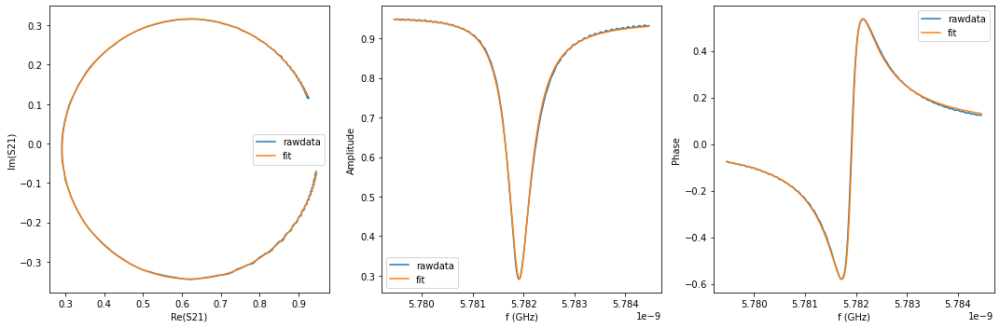

{'Qi_dia_corr': 25498.822689022327, 'Qi_no_corr': 25784.98904331657, 'absQc': 11317.90275980144, 'Qc_dia_corr(Re{Qc})': 11373.931136937175, 'Ql': 7865.478523975262, 'fr': 5.781891105904146, 'theta0': -3.0422947873286765, 'phi0': 0.09929837984284867, 'phi0_err': 0.0044554558993798385, 'Ql_err': 50.717047384330115, 'absQc_err': 20.376059199266482, 'fr_err': 1.749033510659963e-06, 'chi_square': 4.842032836620557e-05, 'Qi_no_corr_err': 528.7408102626675, 'Qi_dia_corr_err': 524.3477730830346, 'delay': -0.16551439957375236, 'a': 0.9482447938207506, 'alpha': 0.30081332953158385}


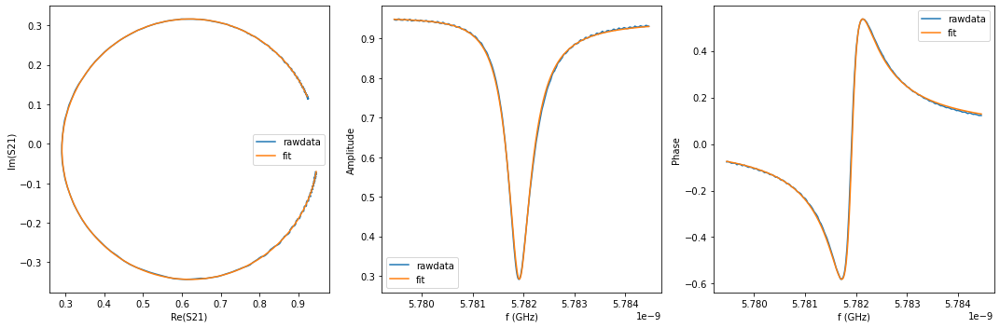

{'Qi_dia_corr': 25439.963205274482, 'Qi_no_corr': 25725.677121430403, 'absQc': 11282.7212206577, 'Qc_dia_corr(Re{Qc})': 11338.570847537254, 'Ql': 7842.966898777013, 'fr': 5.781890196858198, 'theta0': -3.042298458694591, 'phi0': 0.09929431922790097, 'phi0_err': 0.004517280950465042, 'Ql_err': 57.432381193001554, 'absQc_err': 19.48772963341408, 'fr_err': 1.7650786797943324e-06, 'chi_square': 4.6086003129801294e-05, 'Qi_no_corr_err': 601.899693398909, 'Qi_dia_corr_err': 595.8081863527182, 'delay': -0.04023100228873715, 'a': 0.9485164106457062, 'alpha': -1.4308521199485602}


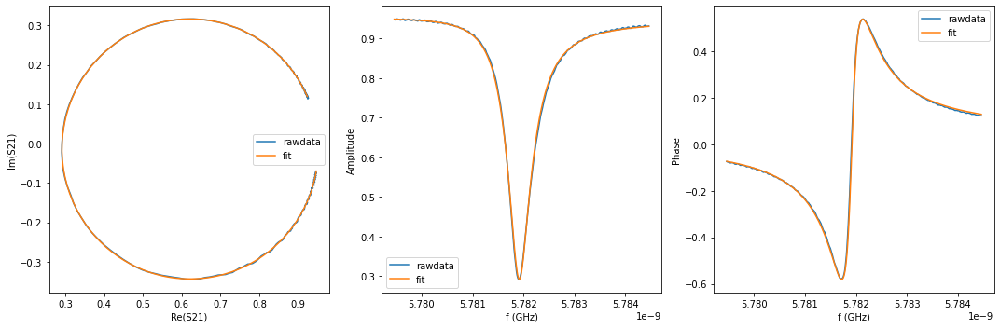

{'Qi_dia_corr': 25393.77717606461, 'Qi_no_corr': 25680.840726619517, 'absQc': 11262.507165979716, 'Qc_dia_corr(Re{Qc})': 11318.621021478244, 'Ql': 7829.031996579738, 'fr': 5.781889209583705, 'theta0': -3.0419761242384187, 'phi0': 0.09961686729032188, 'phi0_err': 0.005040692911719183, 'Ql_err': 65.00468017032964, 'absQc_err': 19.24962017148017, 'fr_err': 1.956592389724351e-06, 'chi_square': 4.637138174403967e-05, 'Qi_no_corr_err': 693.5892099140967, 'Qi_dia_corr_err': 689.4393234721681, 'delay': 0.006977899949387138, 'a': 0.9488637068960145, 'alpha': 0.2843975067653696}


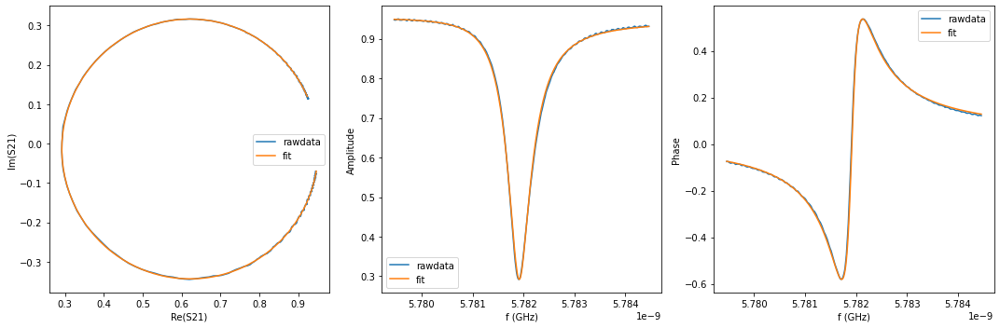

{'Qi_dia_corr': 25376.0525753742, 'Qi_no_corr': 25662.62599327521, 'absQc': 11265.197413758511, 'Qc_dia_corr(Re{Qc})': 11321.321161090975, 'Ql': 7828.637631391818, 'fr': 5.781888137434777, 'theta0': -3.0419792866076842, 'phi0': 0.09961376355447339, 'phi0_err': 0.00503636658925203, 'Ql_err': 67.27061966518166, 'absQc_err': 19.53872824309394, 'fr_err': 1.965062704254344e-06, 'chi_square': 4.79528759654635e-05, 'Qi_no_corr_err': 711.4147065432231, 'Qi_dia_corr_err': 704.9537209660971, 'delay': -0.0006507340233707498, 'a': 0.948966749049345, 'alpha': 0.0071427969621944394}


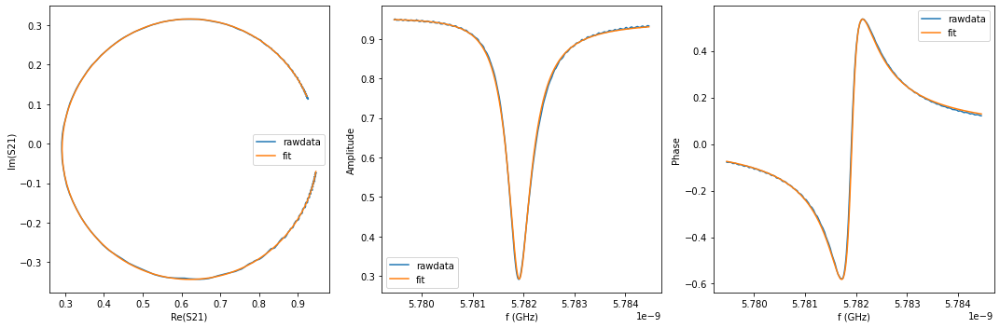

{'Qi_dia_corr': 25394.019935704287, 'Qi_no_corr': 25686.76855031541, 'absQc': 11279.347831218935, 'Qc_dia_corr(Re{Qc})': 11336.736474907277, 'Ql': 7837.718037476922, 'fr': 5.781887039586443, 'theta0': -3.040930612288824, 'phi0': 0.10066241127758493, 'phi0_err': 0.005128309206101071, 'Ql_err': 55.53968901173393, 'absQc_err': 20.06836474573348, 'fr_err': 1.9918413816521406e-06, 'chi_square': 4.994292674406699e-05, 'Qi_no_corr_err': 587.0396444558569, 'Qi_dia_corr_err': 584.813108794185, 'delay': -0.05209197737831079, 'a': 0.9488786147708261, 'alpha': -1.8617611083525938}


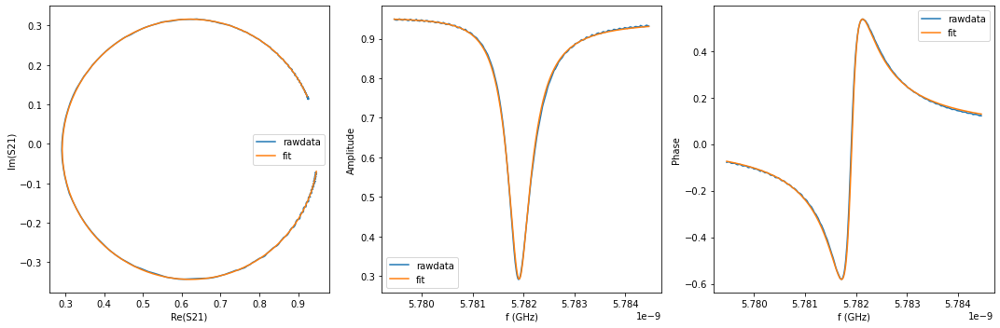

{'Qi_dia_corr': 25360.67651179958, 'Qi_no_corr': 25653.011548677583, 'absQc': 11266.558814293645, 'Qc_dia_corr(Re{Qc})': 11323.887039242954, 'Ql': 7828.3999660734435, 'fr': 5.781886022992043, 'theta0': -3.040926577959541, 'phi0': 0.10066647763293506, 'phi0_err': 0.005559569719601136, 'Ql_err': 72.0917679055649, 'absQc_err': 20.07101343337152, 'fr_err': 2.1625874077739014e-06, 'chi_square': 5.081900683447489e-05, 'Qi_no_corr_err': 766.879837962127, 'Qi_dia_corr_err': 763.3649186719423, 'delay': -0.009878471041049828, 'a': 0.9492881303433689, 'alpha': -0.3275974211385966}


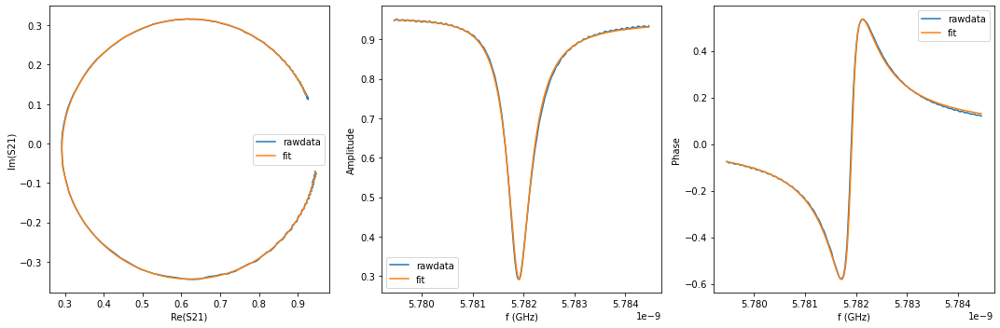

{'Qi_dia_corr': 25432.105758292222, 'Qi_no_corr': 25726.157832933095, 'absQc': 11310.59322162687, 'Qc_dia_corr(Re{Qc})': 11368.383006461972, 'Ql': 7856.469536839972, 'fr': 5.781885043408267, 'theta0': -3.040720563740632, 'phi0': 0.10087309206381456, 'phi0_err': 0.005102017291965825, 'Ql_err': 58.47373567848429, 'absQc_err': 21.706203309113334, 'fr_err': 2.0081688312549398e-06, 'chi_square': 5.717251943294385e-05, 'Qi_no_corr_err': 616.5966956793528, 'Qi_dia_corr_err': 609.745759685255, 'delay': -0.14278167701306113, 'a': 0.9489228449108195, 'alpha': 1.1270659193382417}


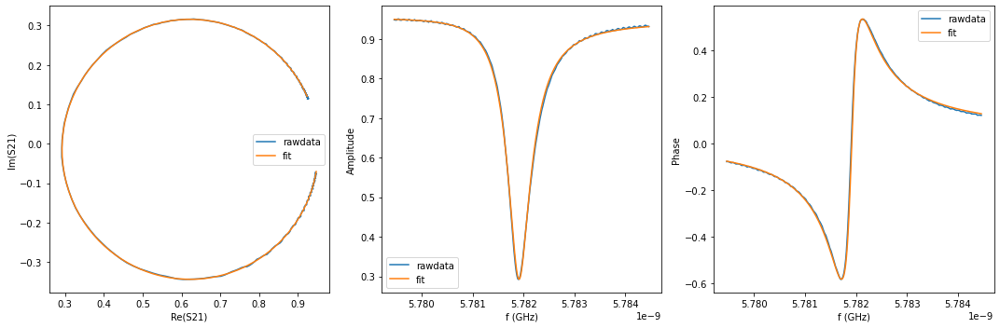

{'Qi_dia_corr': 25389.92635428321, 'Qi_no_corr': 25685.890380193603, 'absQc': 11286.639353727483, 'Qc_dia_corr(Re{Qc})': 11344.74821568975, 'Ql': 7841.156212111793, 'fr': 5.781883858061141, 'theta0': -3.040336298067268, 'phi0': 0.10125682396075279, 'phi0_err': 0.005642732703456372, 'Ql_err': 73.16312403109123, 'absQc_err': 21.37005948566791, 'fr_err': 2.168368058247885e-06, 'chi_square': 5.7360498324139074e-05, 'Qi_no_corr_err': 764.7550736627732, 'Qi_dia_corr_err': 756.2106974065191, 'delay': -0.05561513790213421, 'a': 0.9494229186270842, 'alpha': -1.9891547097465163}


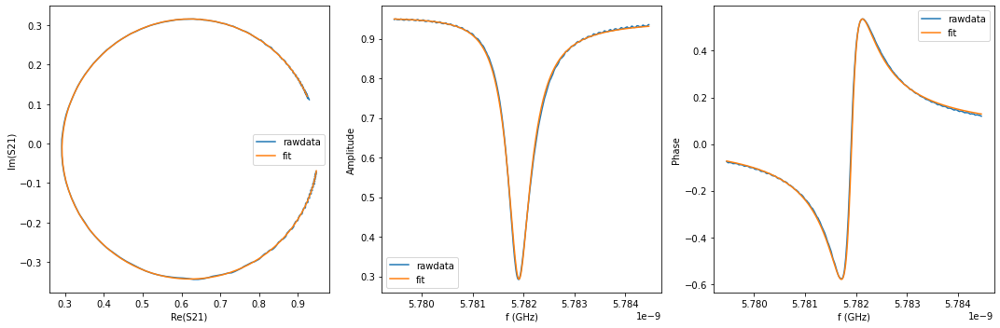

{'Qi_dia_corr': 25319.612013956066, 'Qi_no_corr': 25614.56860898672, 'absQc': 11270.286970314726, 'Qc_dia_corr(Re{Qc})': 11328.352144578259, 'Ql': 7826.614319349409, 'fr': 5.7818827617778314, 'theta0': -3.0403010826133463, 'phi0': 0.10129200608507254, 'phi0_err': 0.006034217195919215, 'Ql_err': 74.64972806363531, 'absQc_err': 21.286015471212302, 'fr_err': 2.3203997991881185e-06, 'chi_square': 5.7739320878452055e-05, 'Qi_no_corr_err': 796.1133003195671, 'Qi_dia_corr_err': 791.8531001205257, 'delay': 0.022130223579640854, 'a': 0.9495478343186026, 'alpha': 0.8355402849128988}


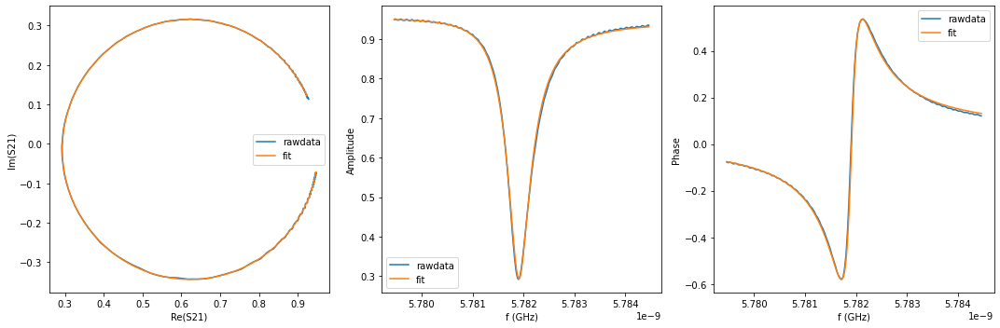

{'Qi_dia_corr': 25420.619295608765, 'Qi_no_corr': 25720.253191222273, 'absQc': 11333.121852401237, 'Qc_dia_corr(Re{Qc})': 11392.290300165925, 'Ql': 7866.78037149267, 'fr': 5.78188150635199, 'theta0': -3.0396298129641544, 'phi0': 0.10196302483303481, 'phi0_err': 0.006046556760099687, 'Ql_err': 77.34049120736968, 'absQc_err': 22.69415818745972, 'fr_err': 2.2942550178416293e-06, 'chi_square': 6.296968189666335e-05, 'Qi_no_corr_err': 815.7653602990649, 'Qi_dia_corr_err': 812.1673571150086, 'delay': -0.18586243243427983, 'a': 0.9492383643803959, 'alpha': -0.4373586267820713}


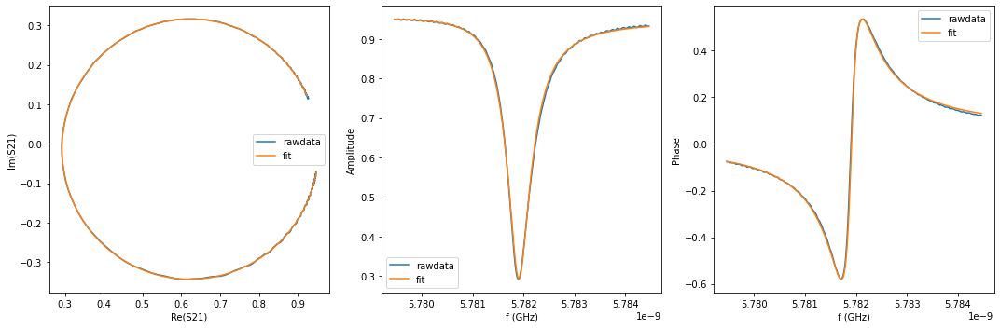

{'Qi_dia_corr': 25399.855547914147, 'Qi_no_corr': 25701.07313866618, 'absQc': 11310.114671791287, 'Qc_dia_corr(Re{Qc})': 11369.448755922702, 'Ql': 7853.897742354473, 'fr': 5.781880461943054, 'theta0': -3.0393855856241085, 'phi0': 0.10220837138734801, 'phi0_err': 0.006135928390345326, 'Ql_err': 68.97695390819433, 'absQc_err': 22.430056318142057, 'fr_err': 2.3365710146322617e-06, 'chi_square': 6.419154293080331e-05, 'Qi_no_corr_err': 720.1408106753432, 'Qi_dia_corr_err': 711.1512971669638, 'delay': -0.11529630092209692, 'a': 0.9495203707997784, 'alpha': 2.126533732796101}


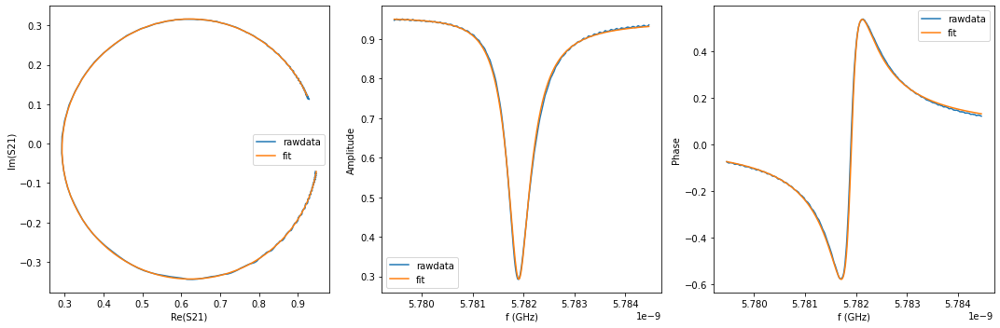

{'Qi_dia_corr': 25349.58440834372, 'Qi_no_corr': 25646.171805278922, 'absQc': 11293.6528324336, 'Qc_dia_corr(Re{Qc})': 11352.141473290081, 'Ql': 7840.832047536833, 'fr': 5.781879440664939, 'theta0': -3.0400393195962243, 'phi0': 0.10155434427842289, 'phi0_err': 0.006315868168453647, 'Ql_err': 77.41485530852526, 'absQc_err': 22.949835023719714, 'fr_err': 2.441532842400772e-06, 'chi_square': 6.635976234540869e-05, 'Qi_no_corr_err': 821.6466522300564, 'Qi_dia_corr_err': 817.9363629391635, 'delay': -0.11288585481023004, 'a': 0.9498038902390746, 'alpha': 2.213846296260983}


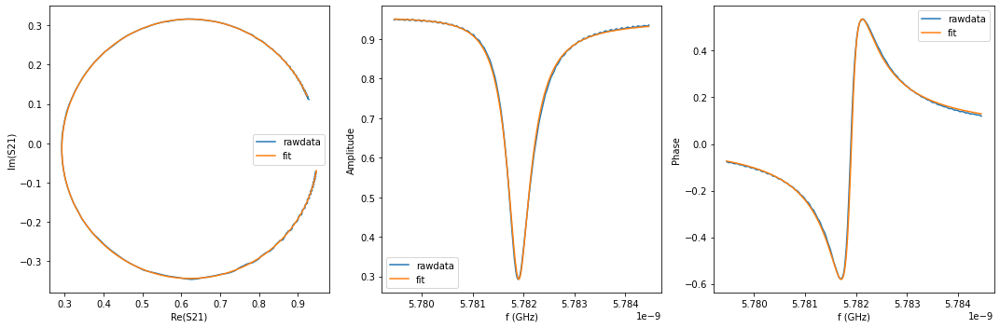

{'Qi_dia_corr': 25339.781980302283, 'Qi_no_corr': 25643.969356275156, 'absQc': 11273.116019836038, 'Qc_dia_corr(Re{Qc})': 11332.921214671525, 'Ql': 7830.722247360202, 'fr': 5.78187801740091, 'theta0': -3.038814137207328, 'phi0': 0.10277907108746416, 'phi0_err': 0.006935836142468139, 'Ql_err': 88.44961099168854, 'absQc_err': 22.933545893289747, 'fr_err': 2.6836184885137473e-06, 'chi_square': 6.713976371871438e-05, 'Qi_no_corr_err': 951.6337989239241, 'Qi_dia_corr_err': 945.2904316154307, 'delay': -0.018082635648590917, 'a': 0.9500965617972557, 'alpha': -0.6250771677260574}


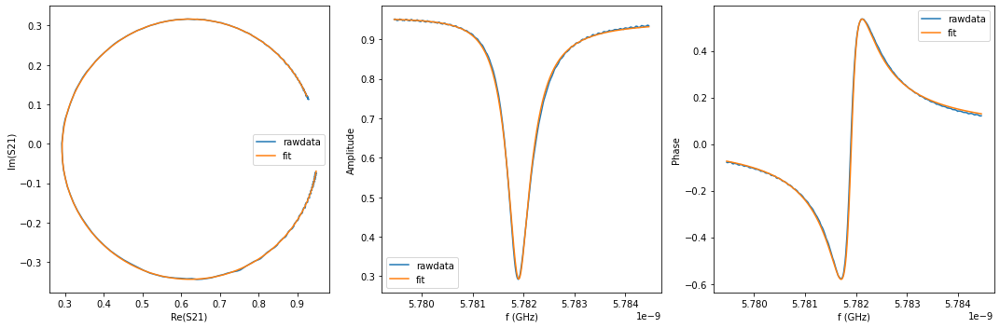

{'Qi_dia_corr': 25363.008802407647, 'Qi_no_corr': 25666.131717112665, 'absQc': 11279.949328791883, 'Qc_dia_corr(Re{Qc})': 11339.509921541496, 'Ql': 7836.085913291238, 'fr': 5.781877035647889, 'theta0': -3.0390546064703554, 'phi0': 0.1025386600340672, 'phi0_err': 0.006671292820425767, 'Ql_err': 77.43313141789828, 'absQc_err': 23.47607705283136, 'fr_err': 2.583818968912688e-06, 'chi_square': 6.997426585871161e-05, 'Qi_no_corr_err': 830.2673631440023, 'Qi_dia_corr_err': 824.506345306994, 'delay': -0.03502391826328235, 'a': 0.9503394948361097, 'alpha': -1.2400386721396532}


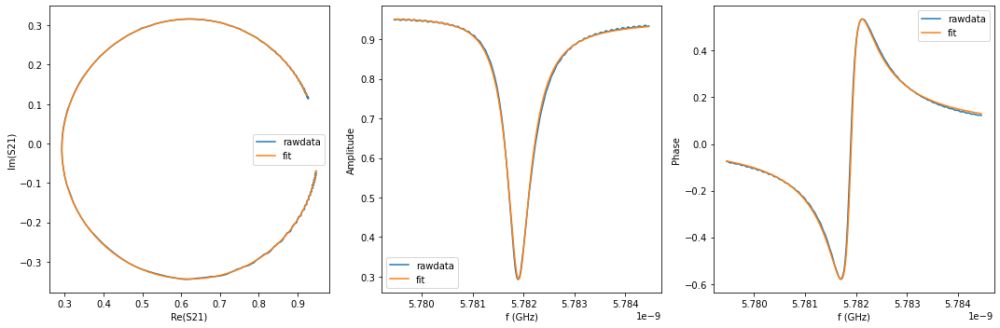

{'Qi_dia_corr': 25328.31959843067, 'Qi_no_corr': 25636.076657493486, 'absQc': 11286.500353323008, 'Qc_dia_corr(Re{Qc})': 11347.201676404515, 'Ql': 7836.440781689023, 'fr': 5.781875505500358, 'theta0': -3.03811162475868, 'phi0': 0.10348168289872882, 'phi0_err': 0.006891346278540191, 'Ql_err': 100.015354927889, 'absQc_err': 23.6215280489108, 'fr_err': 2.6328924839712446e-06, 'chi_square': 7.244697133906032e-05, 'Qi_no_corr_err': 1059.326651220809, 'Qi_dia_corr_err': 1044.3518078962559, 'delay': -0.031812443564581044, 'a': 0.9502962259379696, 'alpha': -1.1234433588904564}


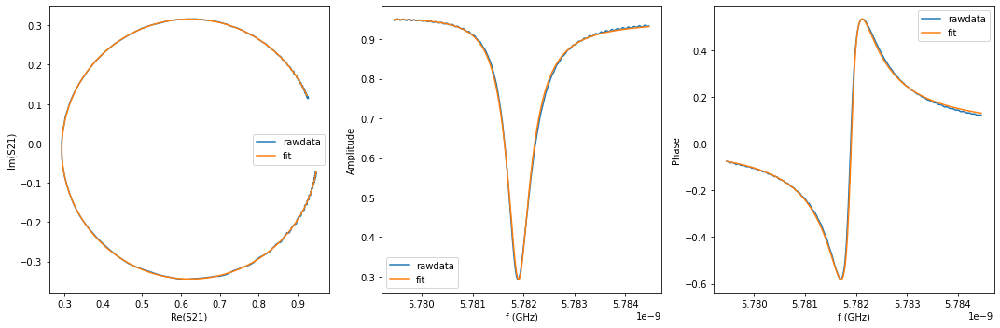

{'Qi_dia_corr': 25395.248452358355, 'Qi_no_corr': 25708.257739422046, 'absQc': 11319.094420953936, 'Qc_dia_corr(Re{Qc})': 11380.856047476505, 'Ql': 7858.898348722301, 'fr': 5.781874265775751, 'theta0': -3.037364872221488, 'phi0': 0.10422778136830493, 'phi0_err': 0.007479673847120541, 'Ql_err': 99.65051185960006, 'absQc_err': 24.78816810944066, 'fr_err': 2.855926103633001e-06, 'chi_square': 7.768998538781465e-05, 'Qi_no_corr_err': 1055.2389599989474, 'Qi_dia_corr_err': 1051.964735505361, 'delay': -0.1462882164296319, 'a': 0.9501542030031587, 'alpha': 1.0009837179684467}


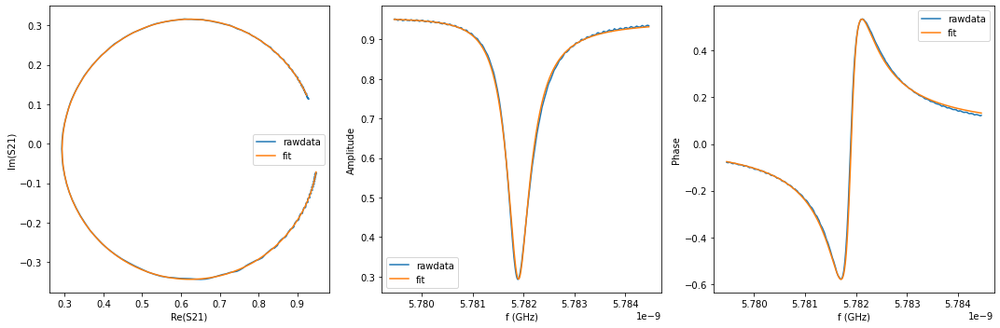

{'Qi_dia_corr': 25399.694092242564, 'Qi_no_corr': 25711.96590156754, 'absQc': 11341.248405757224, 'Qc_dia_corr(Re{Qc})': 11403.085955232858, 'Ql': 7869.918919082593, 'fr': 5.781873014355188, 'theta0': -3.037403313611518, 'phi0': 0.10419008448429837, 'phi0_err': 0.007114441991054942, 'Ql_err': 92.05065794328043, 'absQc_err': 25.924766184083502, 'fr_err': 2.7224924620633553e-06, 'chi_square': 8.226871166120203e-05, 'Qi_no_corr_err': 983.6838560138897, 'Qi_dia_corr_err': 978.1490420167328, 'delay': -0.22360303553193087, 'a': 0.9502708808151513, 'alpha': -1.8076664980432762}


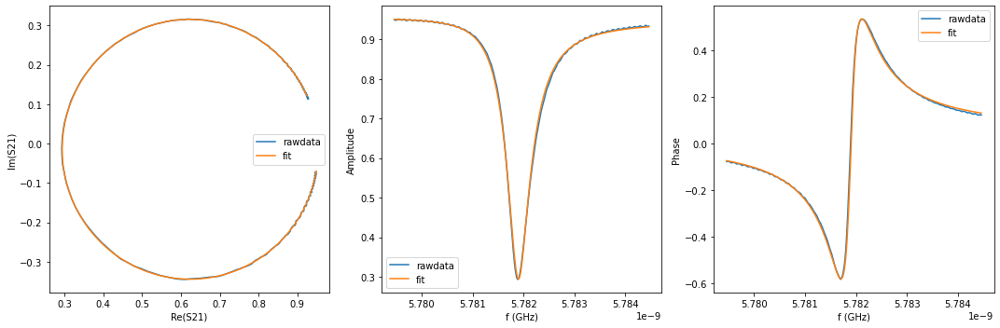

{'Qi_dia_corr': 25285.467899720134, 'Qi_no_corr': 25601.111933442684, 'absQc': 11307.36142231393, 'Qc_dia_corr(Re{Qc})': 11370.050434539162, 'Ql': 7843.213200781176, 'fr': 5.781871471463971, 'theta0': -3.0365353791177165, 'phi0': 0.10505803140887392, 'phi0_err': 0.007105579257689428, 'Ql_err': 81.14648190803764, 'absQc_err': 24.790392781034896, 'fr_err': 2.7226006201630247e-06, 'chi_square': 7.908137617558046e-05, 'Qi_no_corr_err': 847.5724634323814, 'Qi_dia_corr_err': 836.7608404852133, 'delay': -0.07314124514246814, 'a': 0.9506882564639012, 'alpha': -2.624586609686908}


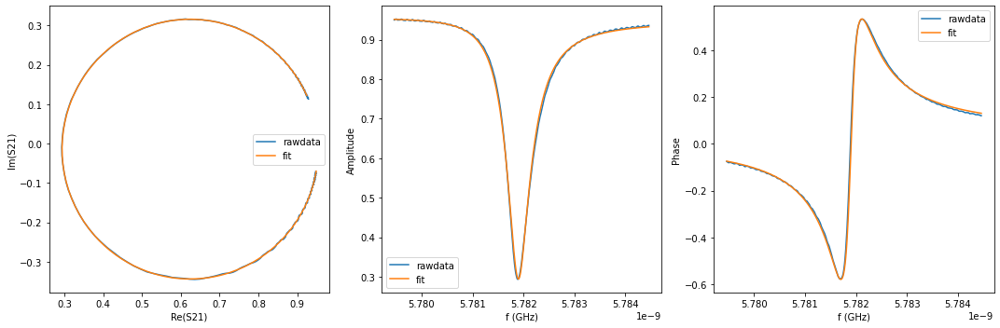

{'Qi_dia_corr': 25276.620565967096, 'Qi_no_corr': 25590.23659726265, 'absQc': 11293.752159361646, 'Qc_dia_corr(Re{Qc})': 11355.934357553911, 'Ql': 7835.643583342239, 'fr': 5.781870522894435, 'theta0': -3.036896251702862, 'phi0': 0.1046971764562445, 'phi0_err': 0.007854870219172519, 'Ql_err': 89.96224418653766, 'absQc_err': 25.475177317529404, 'fr_err': 3.051248641960761e-06, 'chi_square': 8.361176607022952e-05, 'Qi_no_corr_err': 958.9956144251652, 'Qi_dia_corr_err': 950.0025461267245, 'delay': -0.09998185231026628, 'a': 0.9509876226489214, 'alpha': 2.683816061512414}


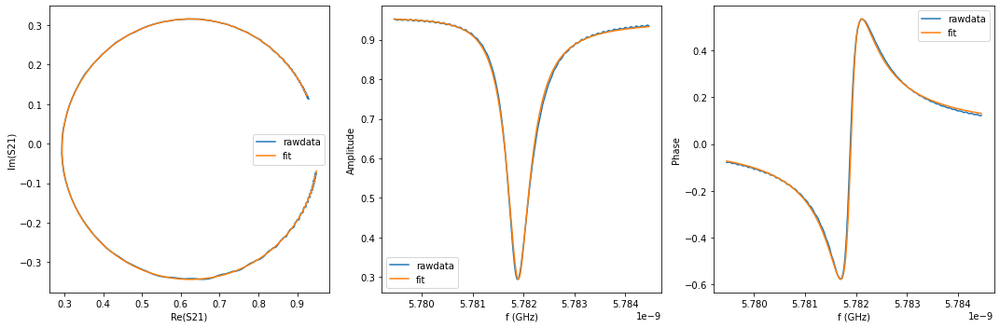

{'Qi_dia_corr': 25218.61853588194, 'Qi_no_corr': 25533.02359743024, 'absQc': 11284.174075842813, 'Qc_dia_corr(Re{Qc})': 11346.692070093879, 'Ql': 7825.665753077163, 'fr': 5.781868984914233, 'theta0': -3.036570978961916, 'phi0': 0.10502253318833268, 'phi0_err': 0.007724277599485406, 'Ql_err': 87.5332671330678, 'absQc_err': 25.97471286177025, 'fr_err': 2.9531657611094025e-06, 'chi_square': 8.737756920110793e-05, 'Qi_no_corr_err': 919.769587353799, 'Qi_dia_corr_err': 912.486360367181, 'delay': -0.04439411525256482, 'a': 0.9512197108530798, 'alpha': -1.5797071251442576}


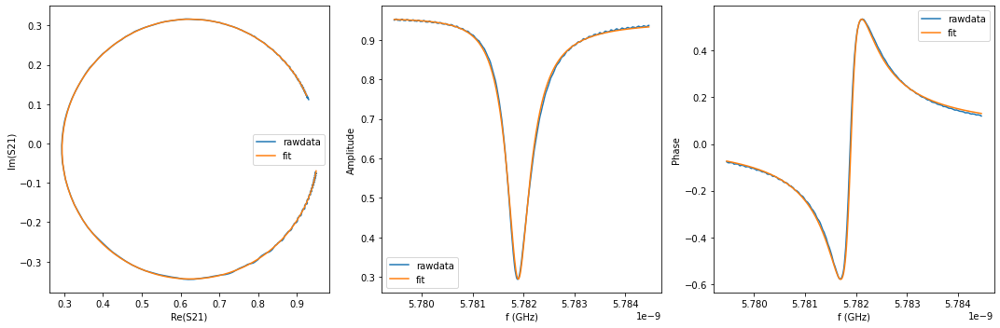

{'Qi_dia_corr': 25214.26868731035, 'Qi_no_corr': 25530.252528738827, 'absQc': 11278.011454131594, 'Qc_dia_corr(Re{Qc})': 11340.79406657606, 'Ql': 7822.441193640204, 'fr': 5.781867717755237, 'theta0': -3.0363208551516325, 'phi0': 0.10527215548277546, 'phi0_err': 0.007983164363087837, 'Ql_err': 128.786884793523, 'absQc_err': 26.070111109906286, 'fr_err': 3.053759082499124e-06, 'chi_square': 8.881653137960519e-05, 'Qi_no_corr_err': 1367.6985041122527, 'Qi_dia_corr_err': 1347.04712808764, 'delay': -0.05584854523282996, 'a': 0.9513817692869019, 'alpha': -1.9959599725956931}


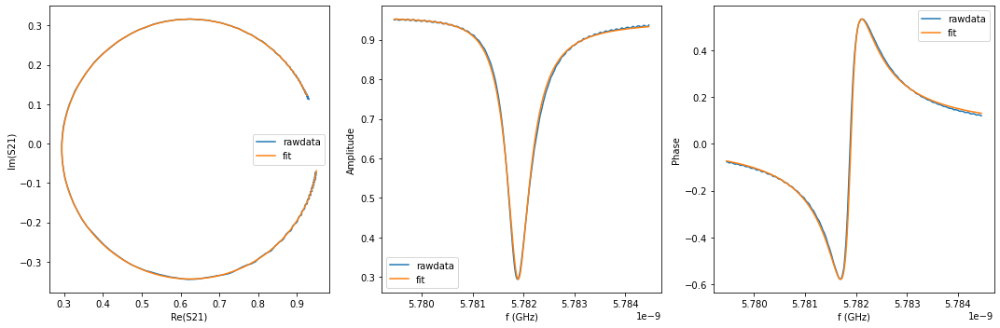

{'Qi_dia_corr': 25196.09544624239, 'Qi_no_corr': 25515.32417489563, 'absQc': 11279.006809135995, 'Qc_dia_corr(Re{Qc})': 11342.532371632176, 'Ql': 7821.517810198995, 'fr': 5.781866105861377, 'theta0': -3.0357078754604663, 'phi0': 0.10588565964205493, 'phi0_err': 0.008085306540512371, 'Ql_err': 99.88873522525459, 'absQc_err': 26.50541421318774, 'fr_err': 3.1154359636823485e-06, 'chi_square': 9.175481802927087e-05, 'Qi_no_corr_err': 1050.1959282588869, 'Qi_dia_corr_err': 1037.0296282280437, 'delay': -0.0570497884473078, 'a': 0.9515155010327188, 'alpha': -2.0391880498113832}


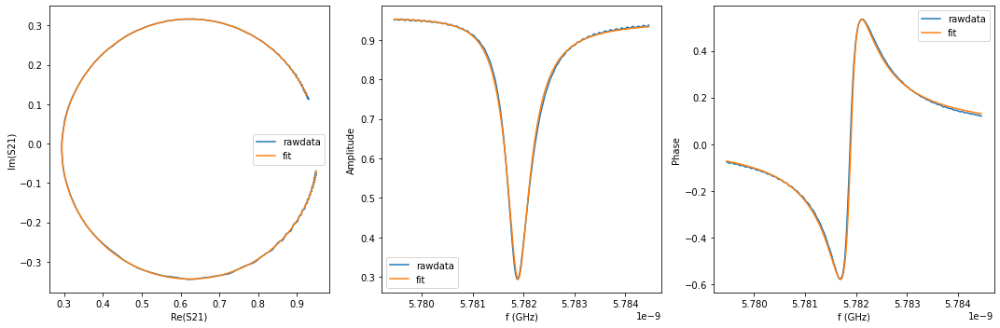

{'Qi_dia_corr': 25190.551315797133, 'Qi_no_corr': 25506.518279314456, 'absQc': 11273.343525738435, 'Qc_dia_corr(Re{Qc})': 11336.188801401891, 'Ql': 7817.966914403559, 'fr': 5.781865259250795, 'theta0': -3.03624743518545, 'phi0': 0.10534613838661777, 'phi0_err': 0.009501873333595463, 'Ql_err': 114.42461960201564, 'absQc_err': 26.809575739464275, 'fr_err': 3.6098620412505115e-06, 'chi_square': 9.471329226144462e-05, 'Qi_no_corr_err': 1215.2285806223242, 'Qi_dia_corr_err': 1211.6736658876116, 'delay': -0.033659569895117994, 'a': 0.951795387440308, 'alpha': -1.189275931265873}


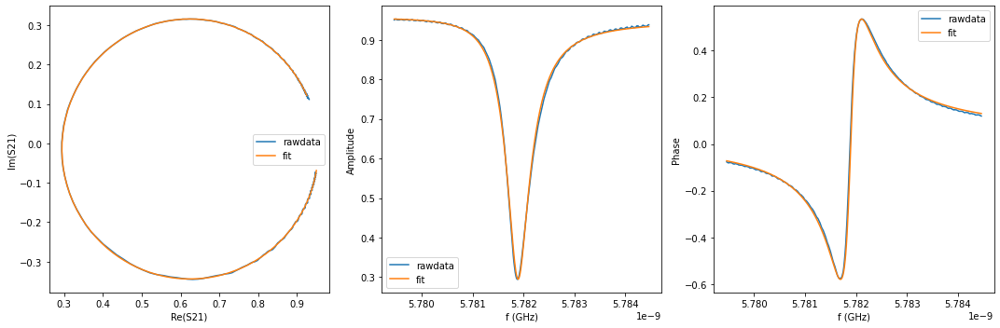

{'Qi_dia_corr': 25184.001800321636, 'Qi_no_corr': 25503.814185494983, 'absQc': 11274.79630199057, 'Qc_dia_corr(Re{Qc})': 11338.450612480852, 'Ql': 7818.4114639979825, 'fr': 5.781863704325054, 'theta0': -3.035581513242278, 'phi0': 0.10601210016462308, 'phi0_err': 0.009454897817960791, 'Ql_err': 128.91479945442754, 'absQc_err': 27.349924181039363, 'fr_err': 3.5928901248627832e-06, 'chi_square': 9.833824471793823e-05, 'Qi_no_corr_err': 1375.508666242682, 'Qi_dia_corr_err': 1359.2592900276748, 'delay': -0.011543664587325038, 'a': 0.9518314527119824, 'alpha': -0.38591975074844237}


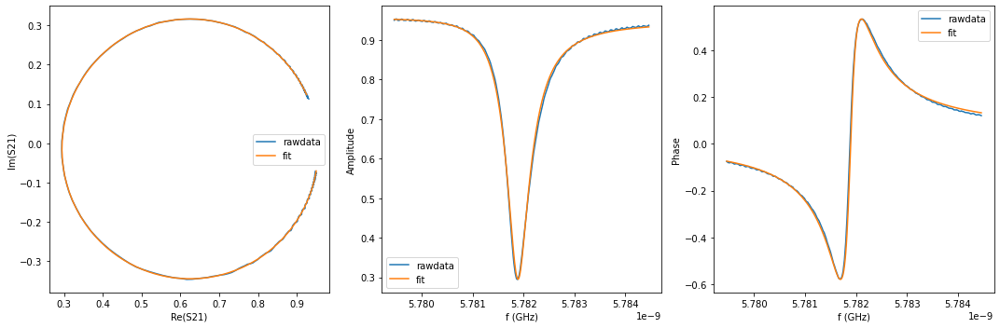

{'Qi_dia_corr': 25264.60839605221, 'Qi_no_corr': 25593.143237890363, 'absQc': 11325.401732967344, 'Qc_dia_corr(Re{Qc})': 11390.949633142292, 'Ql': 7851.1390144786355, 'fr': 5.781861822676845, 'theta0': -3.034263285372933, 'phi0': 0.10733043809269548, 'phi0_err': 0.009516155775333405, 'Ql_err': 146.62795171195125, 'absQc_err': 28.634033464666995, 'fr_err': 3.6541769706364896e-06, 'chi_square': 0.00010579926413618217, 'Qi_no_corr_err': 1555.6121398703408, 'Qi_dia_corr_err': 1539.6024707075458, 'delay': -0.17105923700572323, 'a': 0.9516556232386107, 'alpha': 0.10268187935845298}


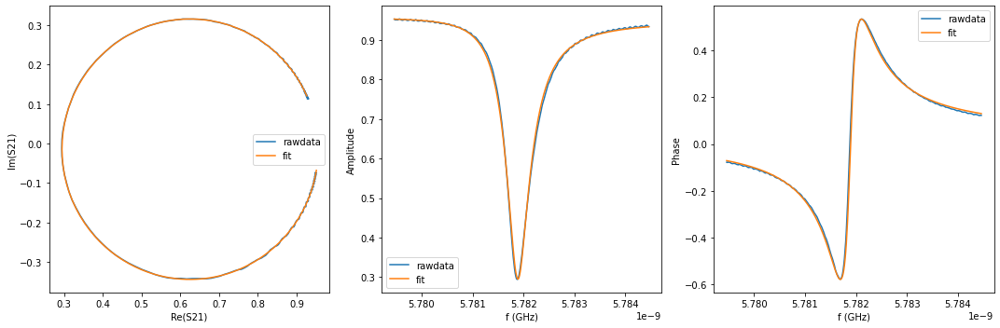

{'Qi_dia_corr': 25138.64838671618, 'Qi_no_corr': 25465.6761617906, 'absQc': 11262.422644297525, 'Qc_dia_corr(Re{Qc})': 11327.594036918788, 'Ql': 7808.877049997391, 'fr': 5.7818603101068335, 'theta0': -3.034273236916722, 'phi0': 0.10732060205975481, 'phi0_err': 0.009196502781847252, 'Ql_err': 107.95746458311757, 'absQc_err': 27.97721202989221, 'fr_err': 3.5129573126382828e-06, 'chi_square': 0.00010327898236352434, 'Qi_no_corr_err': 1140.8642191395343, 'Qi_dia_corr_err': 1130.9455650119846, 'delay': 0.03914615223785704, 'a': 0.9523931401042632, 'alpha': 1.4560145644815619}


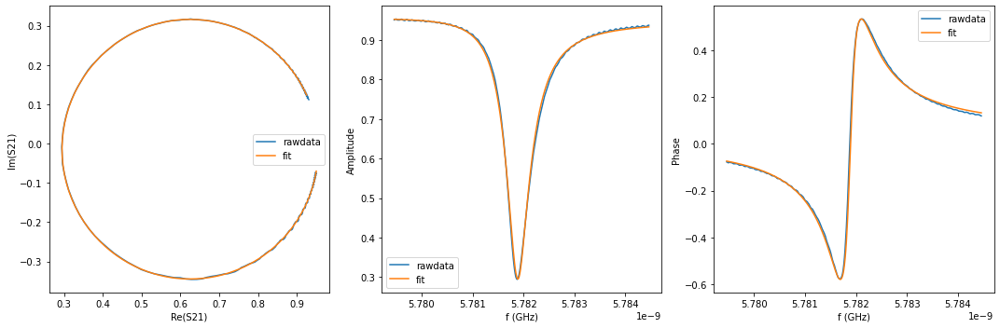

{'Qi_dia_corr': 25235.23648272625, 'Qi_no_corr': 25566.479057734694, 'absQc': 11313.661927252255, 'Qc_dia_corr(Re{Qc})': 11379.76235052204, 'Ql': 7842.98793345536, 'fr': 5.78185880383435, 'theta0': -3.033758510571625, 'phi0': 0.1078353037661721, 'phi0_err': 0.010310945698278175, 'Ql_err': 139.5379677715701, 'absQc_err': 29.26220138723601, 'fr_err': 3.88882740277065e-06, 'chi_square': 0.00011106834938737579, 'Qi_no_corr_err': 1487.2755402635364, 'Qi_dia_corr_err': 1476.3438125102082, 'delay': -0.1512113974684381, 'a': 0.9520492637633705, 'alpha': 0.8238859235328324}


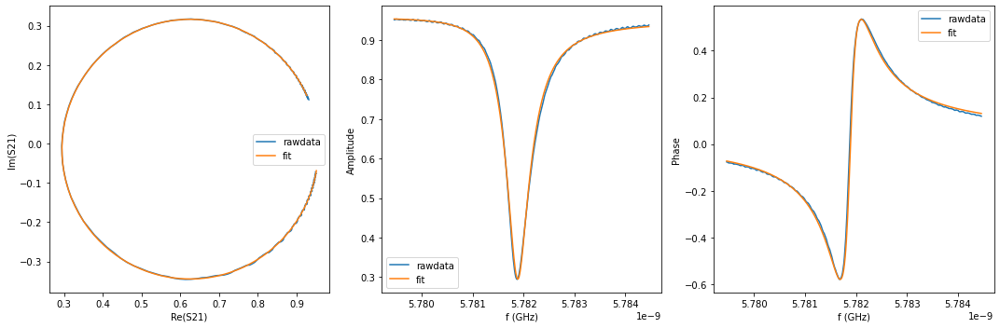

{'Qi_dia_corr': 25192.469863346807, 'Qi_no_corr': 25520.030465861237, 'absQc': 11287.381742614503, 'Qc_dia_corr(Re{Qc})': 11352.669376343374, 'Ql': 7825.986905023358, 'fr': 5.781857603961353, 'theta0': -3.0342963106698693, 'phi0': 0.1072975529361397, 'phi0_err': 0.010251853284397245, 'Ql_err': 151.3745726310064, 'absQc_err': 29.304588291178565, 'fr_err': 3.839380335799194e-06, 'chi_square': 0.00011388274891732332, 'Qi_no_corr_err': 1591.382329581383, 'Qi_dia_corr_err': 1574.4781228073823, 'delay': -0.05420270403208902, 'a': 0.9525015933397376, 'alpha': -1.935004709290658}


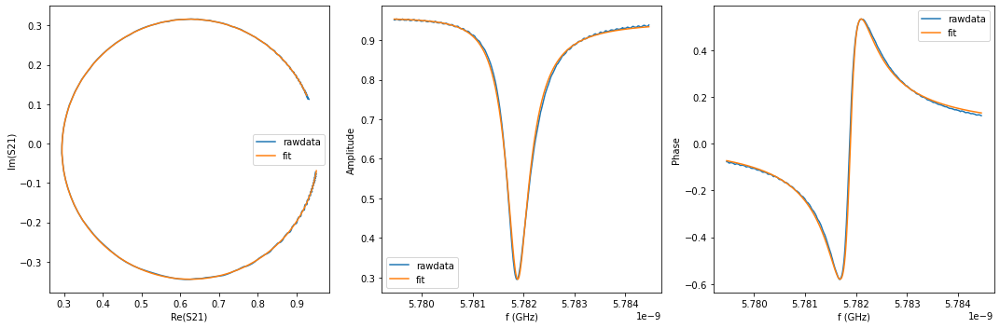

{'Qi_dia_corr': 25188.956966587095, 'Qi_no_corr': 25523.01312295541, 'absQc': 11286.475082236846, 'Qc_dia_corr(Re{Qc})': 11353.055796674329, 'Ql': 7825.831482090711, 'fr': 5.781855713828419, 'theta0': -3.033239651909962, 'phi0': 0.10835409056712636, 'phi0_err': 0.010212453252405218, 'Ql_err': 148.51910854487332, 'absQc_err': 29.92027565980886, 'fr_err': 3.856805081391862e-06, 'chi_square': 0.00011779238360091472, 'Qi_no_corr_err': 1557.3970857331562, 'Qi_dia_corr_err': 1541.0332474300105, 'delay': -0.07118072038582368, 'a': 0.9526602665330469, 'alpha': -2.5514909276999282}


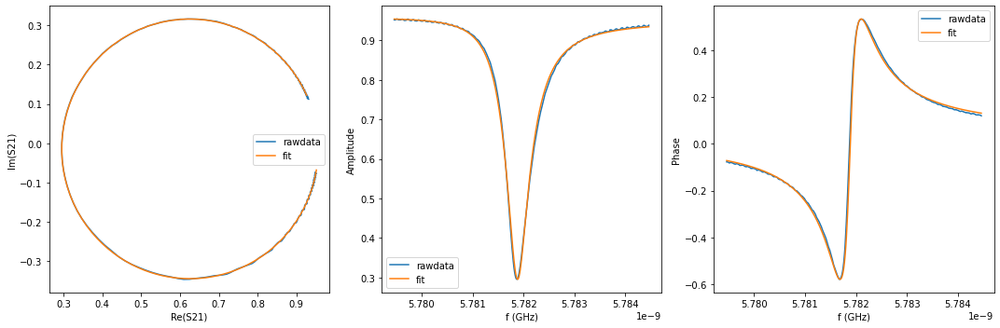

{'Qi_dia_corr': 25119.60688705902, 'Qi_no_corr': 25455.635592831073, 'absQc': 11263.730547185243, 'Qc_dia_corr(Re{Qc})': 11330.799636289852, 'Ql': 7808.561267960382, 'fr': 5.781853708754195, 'theta0': -3.0327360097051947, 'phi0': 0.10885800656498987, 'phi0_err': 0.011046580238756504, 'Ql_err': 136.51479846452665, 'absQc_err': 29.80408580438645, 'fr_err': 4.128926238441963e-06, 'chi_square': 0.00011942209714734726, 'Qi_no_corr_err': 1428.5950202202848, 'Qi_dia_corr_err': 1415.3065559782176, 'delay': 0.0005260821974593065, 'a': 0.9530800874818355, 'alpha': 0.05358922376530013}


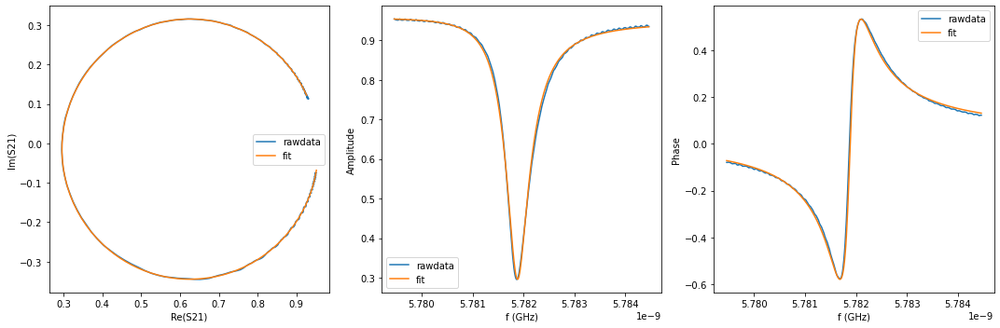

{'Qi_dia_corr': 25130.758336864248, 'Qi_no_corr': 25471.81171036266, 'absQc': 11278.457125883908, 'Qc_dia_corr(Re{Qc})': 11346.639776489917, 'Ql': 7817.160129467345, 'fr': 5.7818519588982715, 'theta0': -3.031910487292817, 'phi0': 0.10968216629697618, 'phi0_err': 0.010186100489674539, 'Ql_err': 108.16428265428775, 'absQc_err': 31.025072241462663, 'fr_err': 3.892947725629816e-06, 'chi_square': 0.00012585487849406122, 'Qi_no_corr_err': 1142.788577345, 'Qi_dia_corr_err': 1134.44793970673, 'delay': -0.02031732740266521, 'a': 0.9531992672313953, 'alpha': -0.703304738630616}


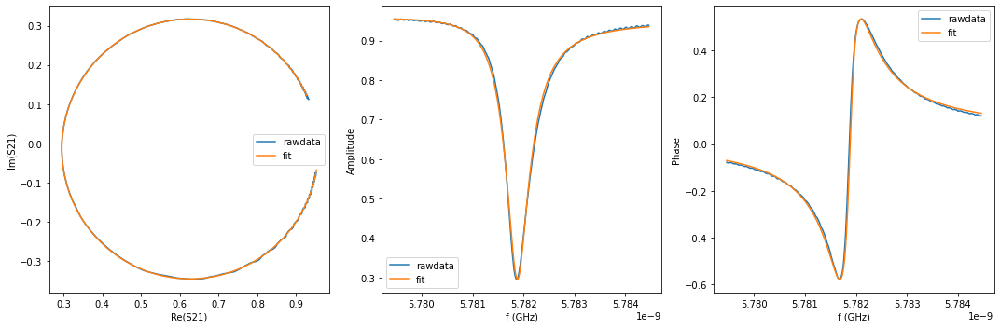

{'Qi_dia_corr': 25096.583626812673, 'Qi_no_corr': 25433.757455094896, 'absQc': 11260.537845166722, 'Qc_dia_corr(Re{Qc})': 11327.918929079364, 'Ql': 7804.967666618343, 'fr': 5.78185052339752, 'theta0': -3.032469147082169, 'phi0': 0.10912504529680846, 'phi0_err': 0.010792011031680593, 'Ql_err': 125.54373966424258, 'absQc_err': 31.523361920390503, 'fr_err': 4.157168902649913e-06, 'chi_square': 0.0001299058150000287, 'Qi_no_corr_err': 1340.5198048041918, 'Qi_dia_corr_err': 1322.9291517402373, 'delay': 0.023731188758691398, 'a': 0.9536386620778571, 'alpha': 0.8973278763188383}


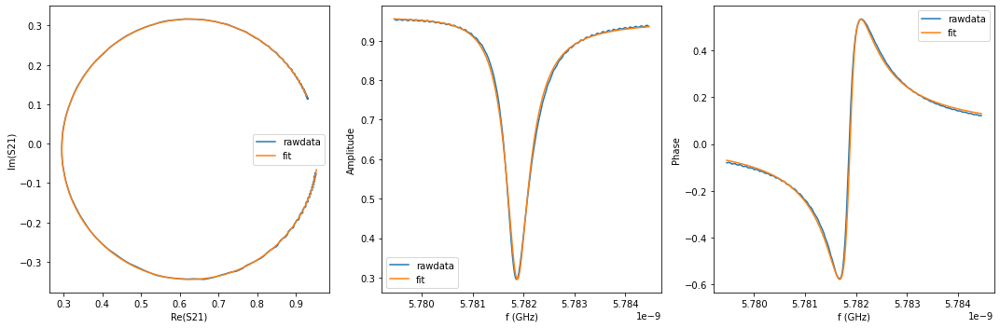

{'Qi_dia_corr': 25033.306384822306, 'Qi_no_corr': 25373.39504209623, 'absQc': 11234.814286809475, 'Qc_dia_corr(Re{Qc})': 11302.804667321647, 'Ql': 7786.9250189934, 'fr': 5.781848535307613, 'theta0': -3.0318530047882803, 'phi0': 0.10973964880151268, 'phi0_err': 0.010234502043254755, 'Ql_err': 110.63305342721794, 'absQc_err': 31.68751721324525, 'fr_err': 3.903482851541793e-06, 'chi_square': 0.00013426636443704938, 'Qi_no_corr_err': 1157.567350899717, 'Qi_dia_corr_err': 1139.3526351746602, 'delay': 0.11010424514764851, 'a': 0.954078839117263, 'alpha': -2.2477607265188624}


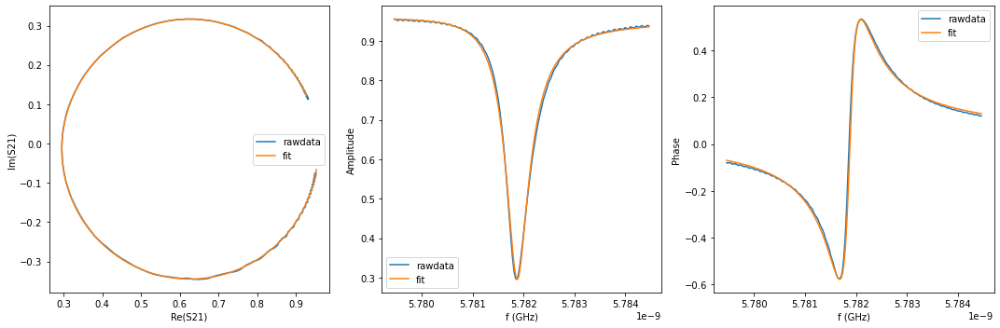

{'Qi_dia_corr': 25048.56625687304, 'Qi_no_corr': 25392.516997798364, 'absQc': 11237.294064179292, 'Qc_dia_corr(Re{Qc})': 11305.997468087955, 'Ql': 7789.916798946369, 'fr': 5.78184675437979, 'theta0': -3.0312940985413426, 'phi0': 0.1102985625443817, 'phi0_err': 0.01196038373416118, 'Ql_err': 124.62892224920192, 'absQc_err': 32.1885455731962, 'fr_err': 4.584363558278291e-06, 'chi_square': 0.0001399725446728419, 'Qi_no_corr_err': 1319.1649278235993, 'Qi_dia_corr_err': 1296.5066618548324, 'delay': 0.09358616676535433, 'a': 0.9542574274849595, 'alpha': -2.847661247657637}


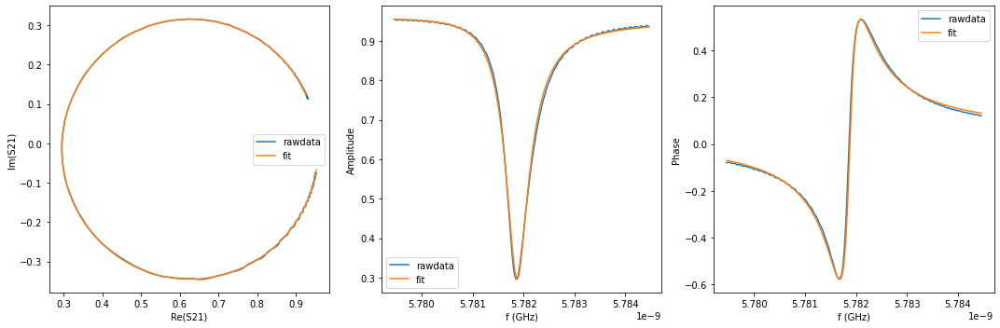

{'Qi_dia_corr': 25094.892670235444, 'Qi_no_corr': 25449.46121902368, 'absQc': 11279.813810642667, 'Qc_dia_corr(Re{Qc})': 11350.897244295615, 'Ql': 7815.70515344762, 'fr': 5.7818445039106106, 'theta0': -3.0296202492155215, 'phi0': 0.1119724043742718, 'phi0_err': 0.012177254858373378, 'Ql_err': 138.31569264759702, 'absQc_err': 32.74158570732403, 'fr_err': 4.5380093530273e-06, 'chi_square': 0.000142503115634602, 'Qi_no_corr_err': 1457.8806239827634, 'Qi_dia_corr_err': 1452.856421816631, 'delay': -0.001634512873500514, 'a': 0.9539702687987998, 'alpha': -0.02368593745586587}


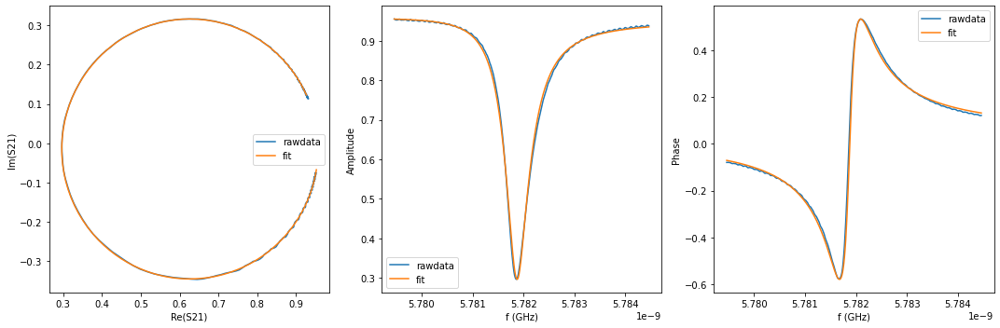

{'Qi_dia_corr': 25075.292390033257, 'Qi_no_corr': 25427.81117219116, 'absQc': 11269.380647565542, 'Qc_dia_corr(Re{Qc})': 11340.035458484923, 'Ql': 7808.654257287574, 'fr': 5.781843008265499, 'theta0': -3.0299051945829163, 'phi0': 0.11168745900687682, 'phi0_err': 0.011748859084840382, 'Ql_err': 134.50877906575323, 'absQc_err': 33.839531912411054, 'fr_err': 4.5125620734043496e-06, 'chi_square': 0.0001515786685473355, 'Qi_no_corr_err': 1426.7584056591525, 'Qi_dia_corr_err': 1403.2857693158405, 'delay': 0.002552397888816156, 'a': 0.9541697033528682, 'alpha': 0.12857860459561532}


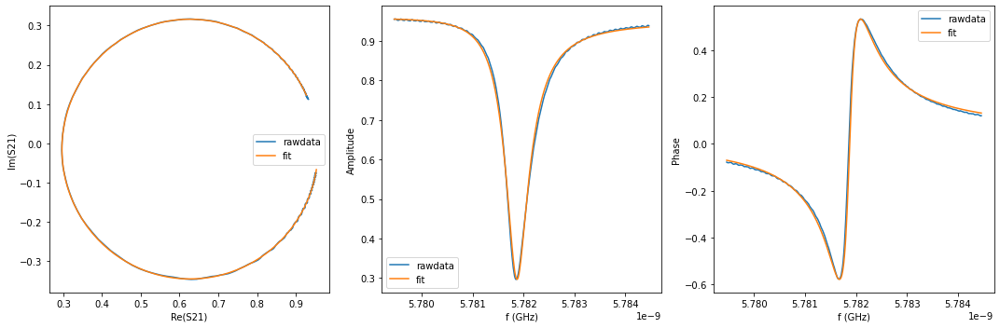

{'Qi_dia_corr': 25047.262333174534, 'Qi_no_corr': 25402.66128983908, 'absQc': 11266.61273197315, 'Qc_dia_corr(Re{Qc})': 11337.96456398809, 'Ql': 7804.95264083655, 'fr': 5.781840868320858, 'theta0': -3.029344857270508, 'phi0': 0.11224785105812898, 'phi0_err': 0.011775813403111535, 'Ql_err': 134.09696524241323, 'absQc_err': 34.00354617544278, 'fr_err': 4.445891283558069e-06, 'chi_square': 0.00015518426010849946, 'Qi_no_corr_err': 1398.3733687219196, 'Qi_dia_corr_err': 1371.3505379161716, 'delay': 0.030112804835965633, 'a': 0.9544197535633265, 'alpha': 1.1302904379105705}


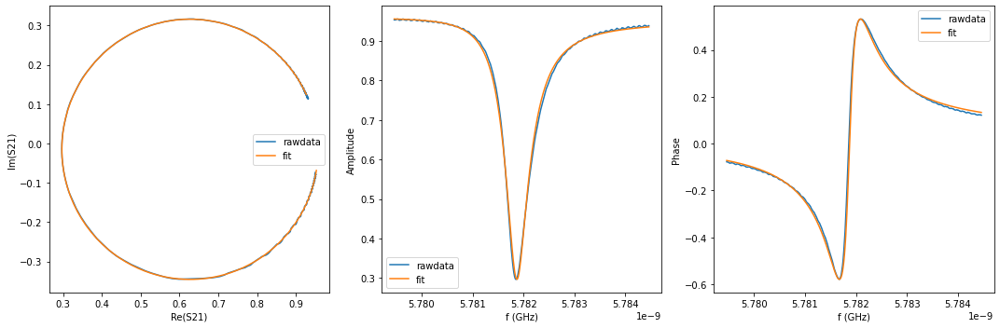

{'Qi_dia_corr': 25130.931779896422, 'Qi_no_corr': 25493.47807666176, 'absQc': 11311.771010521777, 'Qc_dia_corr(Re{Qc})': 11384.645564733759, 'Ql': 7835.197245421564, 'fr': 5.7818385548792985, 'theta0': -3.028385171001664, 'phi0': 0.11320748258812895, 'phi0_err': 0.014285507822238652, 'Ql_err': 155.4963605883249, 'absQc_err': 35.029109413859274, 'fr_err': 5.308245188830914e-06, 'chi_square': 0.00016448337099801062, 'Qi_no_corr_err': 1630.1866589611527, 'Qi_dia_corr_err': 1622.5480747165177, 'delay': -0.1117750902834891, 'a': 0.9542274426878368, 'alpha': 2.258709351231557}


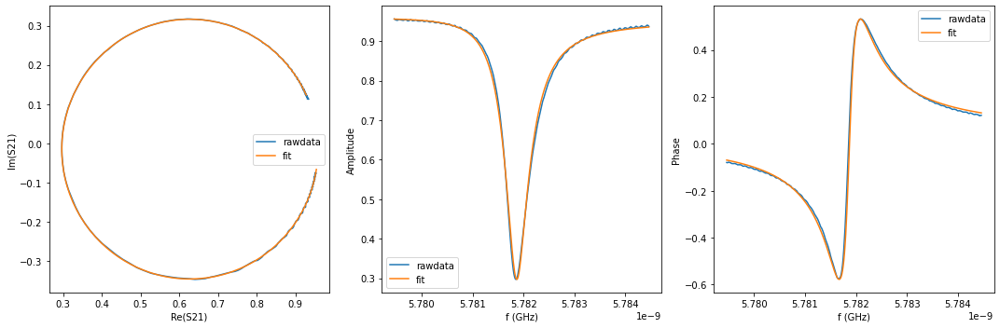

{'Qi_dia_corr': 25014.10005998515, 'Qi_no_corr': 25377.585373171678, 'absQc': 11265.521995703213, 'Qc_dia_corr(Re{Qc})': 11338.663667122371, 'Ql': 7802.060653353368, 'fr': 5.781836201698149, 'theta0': -3.02794767932861, 'phi0': 0.11364497426118295, 'phi0_err': 0.013641288973751817, 'Ql_err': 172.24649393887944, 'absQc_err': 35.645790968765226, 'fr_err': 5.185196259976698e-06, 'chi_square': 0.0001691474611033638, 'Qi_no_corr_err': 1829.5110381008494, 'Qi_dia_corr_err': 1800.4229116080267, 'delay': 0.039367655805156714, 'a': 0.9549743612990266, 'alpha': 1.4671893348939464}


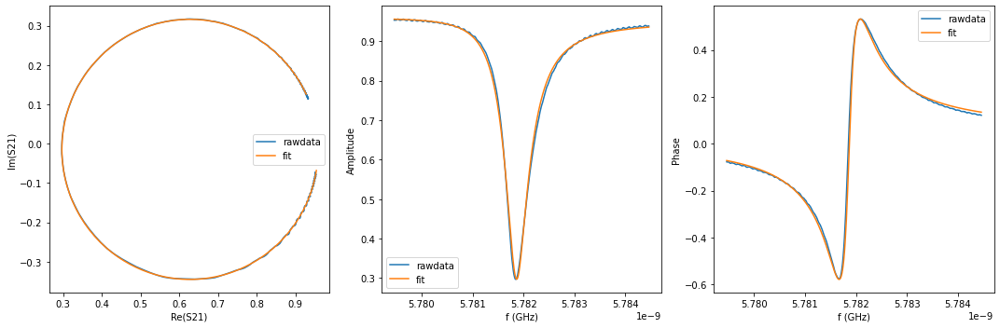

{'Qi_dia_corr': 25119.299945250084, 'Qi_no_corr': 25489.55353097145, 'absQc': 11326.455103520919, 'Qc_dia_corr(Re{Qc})': 11401.12944426728, 'Ql': 7841.868099923701, 'fr': 5.781833746905637, 'theta0': -3.027077203067549, 'phi0': 0.11451545052224435, 'phi0_err': 0.014194524884983045, 'Ql_err': 156.7967136031266, 'absQc_err': 36.790148881683606, 'fr_err': 5.261491821224091e-06, 'chi_square': 0.0001785047927448235, 'Qi_no_corr_err': 1639.7193315673803, 'Qi_dia_corr_err': 1638.2283090114117, 'delay': -0.1525332421629235, 'a': 0.9547021052427227, 'alpha': 0.7790161522820553}


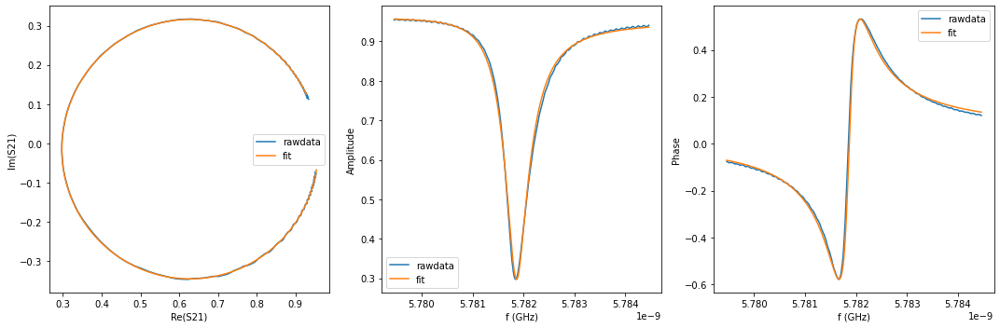

{'Qi_dia_corr': 25108.632622592442, 'Qi_no_corr': 25486.001999928176, 'absQc': 11322.72069744327, 'Qc_dia_corr(Re{Qc})': 11398.83268332552, 'Ql': 7839.741810988582, 'fr': 5.781831319353574, 'theta0': -3.025967243396199, 'phi0': 0.11562541019359443, 'phi0_err': 0.013542513169324344, 'Ql_err': 143.1582366480071, 'absQc_err': 37.010201338098526, 'fr_err': 5.062527436375757e-06, 'chi_square': 0.00018230981872787314, 'Qi_no_corr_err': 1488.4393627443394, 'Qi_dia_corr_err': 1464.2140385465937, 'delay': -0.11877351175633098, 'a': 0.9548578730968856, 'alpha': 2.005741240275083}


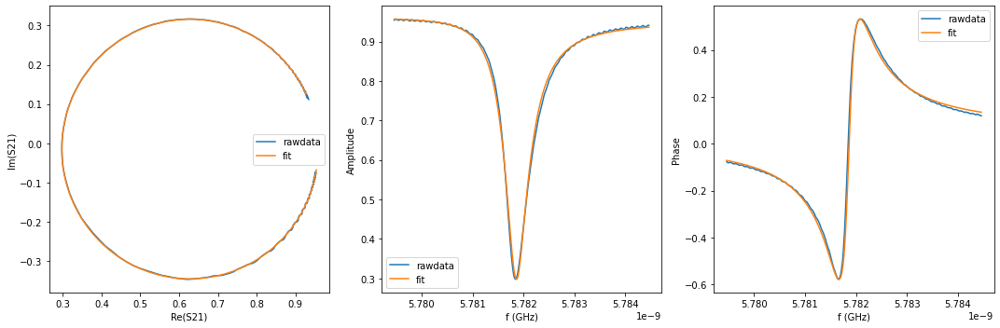

{'Qi_dia_corr': 25075.64192847287, 'Qi_no_corr': 25450.65367149724, 'absQc': 11317.462147777758, 'Qc_dia_corr(Re{Qc})': 11393.230843967327, 'Ql': 7833.8746260251155, 'fr': 5.781829292181323, 'theta0': -3.0262002143916074, 'phi0': 0.11539246045860414, 'phi0_err': 0.014544906910250403, 'Ql_err': 220.62939787200978, 'absQc_err': 37.912833132890036, 'fr_err': 5.381298686272967e-06, 'chi_square': 0.00019098918885061448, 'Qi_no_corr_err': 2302.476719855638, 'Qi_dia_corr_err': 2268.2418440984793, 'delay': -0.12478319171733393, 'a': 0.9551678907779252, 'alpha': 1.7875243180229017}


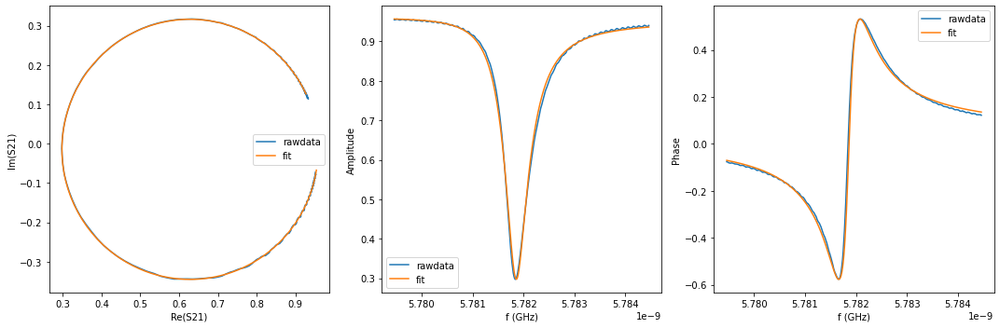

{'Qi_dia_corr': 25053.254528379377, 'Qi_no_corr': 25434.382036469102, 'absQc': 11316.305788092113, 'Qc_dia_corr(Re{Qc})': 11393.421664654436, 'Ql': 7831.778442619606, 'fr': 5.7818269393044, 'theta0': -3.0251786901881874, 'phi0': 0.11641396340160587, 'phi0_err': 0.01573584767908877, 'Ql_err': 185.29746928069923, 'absQc_err': 38.566161401260736, 'fr_err': 5.83345687212457e-06, 'chi_square': 0.00019885057133390028, 'Qi_no_corr_err': 1934.8344082645765, 'Qi_dia_corr_err': 1921.913400950582, 'delay': -0.13336877608697606, 'a': 0.9553127034390514, 'alpha': 1.4761603225058286}


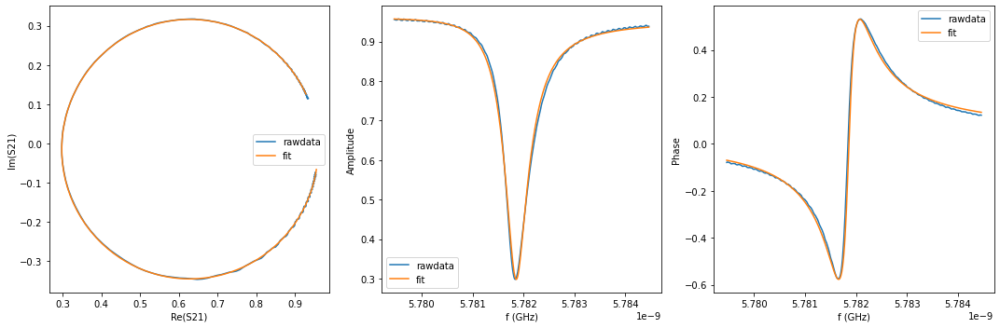

{'Qi_dia_corr': 25020.549825788003, 'Qi_no_corr': 25406.055428694835, 'absQc': 11307.03045689334, 'Qc_dia_corr(Re{Qc})': 11385.100068408987, 'Ql': 7824.649865091847, 'fr': 5.781824555605292, 'theta0': -3.024417380018174, 'phi0': 0.11717529696643847, 'phi0_err': 0.014420458081880864, 'Ql_err': 212.65122658707443, 'absQc_err': 39.34092268902678, 'fr_err': 5.447796440107207e-06, 'chi_square': 0.00020386900449734645, 'Qi_no_corr_err': 2248.469284609167, 'Qi_dia_corr_err': 2203.418440093893, 'delay': -0.07792797901017277, 'a': 0.9557160236025972, 'alpha': -2.7926121737531697}


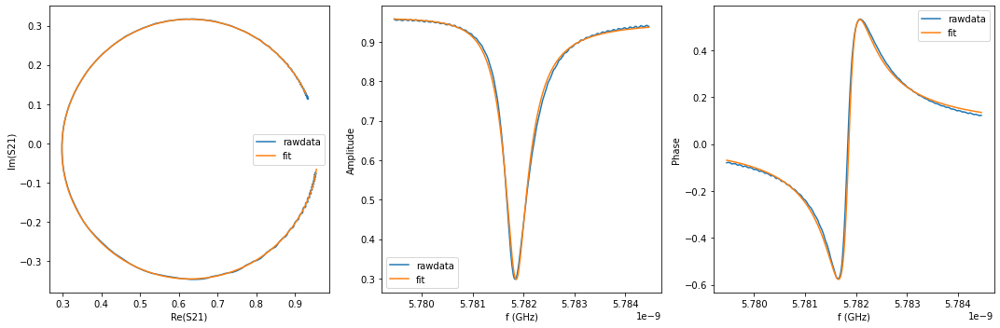

{'Qi_dia_corr': 24991.24411243316, 'Qi_no_corr': 25377.701025511447, 'absQc': 11291.538360369428, 'Qc_dia_corr(Re{Qc})': 11369.766968837106, 'Ql': 7814.541272919982, 'fr': 5.781822243484479, 'theta0': -3.0242188193007444, 'phi0': 0.11737384817819067, 'phi0_err': 0.016937952750452873, 'Ql_err': 286.2248829117523, 'absQc_err': 39.80278253389306, 'fr_err': 6.235816289577674e-06, 'chi_square': 0.00021216793279138878, 'Qi_no_corr_err': 3023.6072200922526, 'Qi_dia_corr_err': 2979.0300589924527, 'delay': -0.05237312872001223, 'a': 0.9560398943985656, 'alpha': -1.8641083355559211}


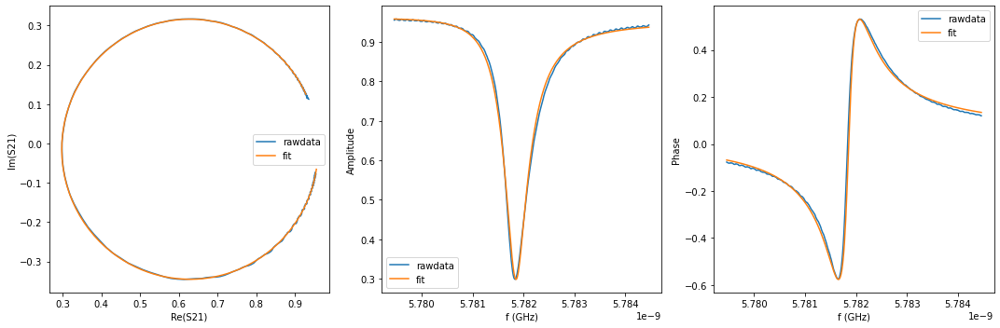

{'Qi_dia_corr': 24962.647880443197, 'Qi_no_corr': 25352.973380474632, 'absQc': 11291.835084470831, 'Qc_dia_corr(Re{Qc})': 11371.025300219073, 'Ql': 7812.337035057949, 'fr': 5.781819549561455, 'theta0': -3.0235053207442033, 'phi0': 0.11808733284558982, 'phi0_err': 0.015635475830380875, 'Ql_err': 164.66853974347475, 'absQc_err': 40.62212009091889, 'fr_err': 5.869927865528873e-06, 'chi_square': 0.00022143143654790247, 'Qi_no_corr_err': 1711.4726720781102, 'Qi_dia_corr_err': 1692.729019198849, 'delay': -0.02122946226415874, 'a': 0.9563537173846974, 'alpha': -0.7320813486010848}


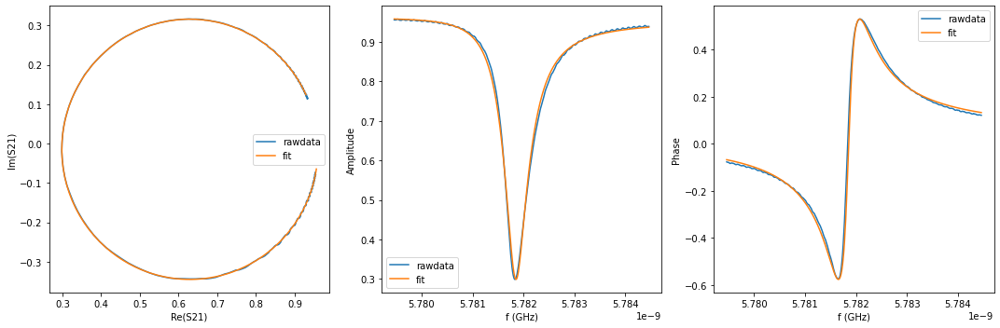

{'Qi_dia_corr': 24877.74784095119, 'Qi_no_corr': 25266.75570605287, 'absQc': 11263.315105976864, 'Qc_dia_corr(Re{Qc})': 11342.377171896329, 'Ql': 7790.497661156868, 'fr': 5.781819563454287, 'theta0': -3.023451929464362, 'phi0': 0.11814072412543092, 'phi0_err': 0.01558058706331466, 'Ql_err': 156.96431440958494, 'absQc_err': 40.29596191331223, 'fr_err': 5.9021356911401464e-06, 'chi_square': 0.00021984824703725402, 'Qi_no_corr_err': 1634.6458370940916, 'Qi_dia_corr_err': 1609.4683055660234, 'delay': 0.06315860187758345, 'a': 0.9566564438511476, 'alpha': 2.333430620233248}


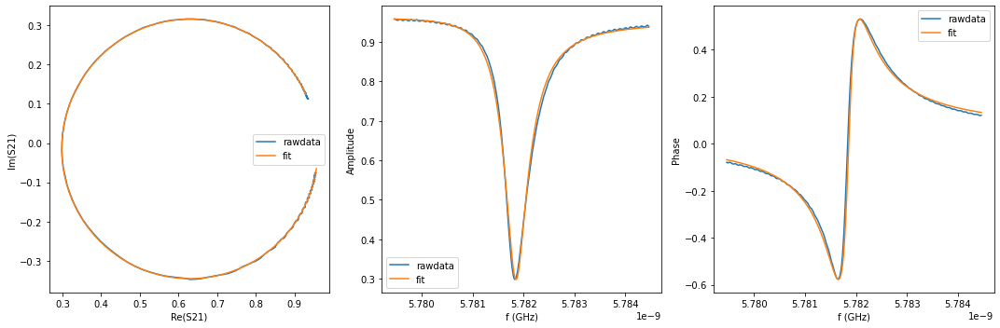

{'Qi_dia_corr': 24910.739752637674, 'Qi_no_corr': 25303.369621908783, 'absQc': 11267.720230459774, 'Qc_dia_corr(Re{Qc})': 11347.363554150674, 'Ql': 7796.084036284671, 'fr': 5.7818193918839365, 'theta0': -3.0230440315294302, 'phi0': 0.11854863082426816, 'phi0_err': 0.016568010084206344, 'Ql_err': 187.09412093639952, 'absQc_err': 40.44438684511448, 'fr_err': 6.186373450370487e-06, 'chi_square': 0.00022121017337233554, 'Qi_no_corr_err': 1954.7625207647668, 'Qi_dia_corr_err': 1940.6396055545938, 'delay': 0.041085351354907734, 'a': 0.9567096854864562, 'alpha': 1.5313106499526794}


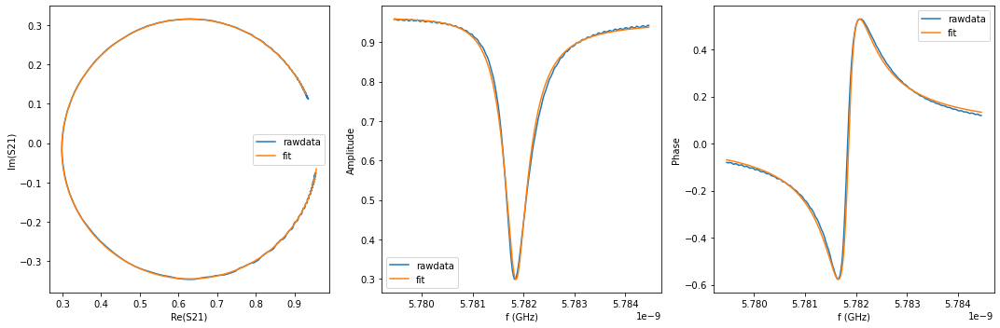

{'Qi_dia_corr': 24914.6243664442, 'Qi_no_corr': 25307.792321683442, 'absQc': 11279.8649265986, 'Qc_dia_corr(Re{Qc})': 11359.764180360164, 'Ql': 7802.316421678036, 'fr': 5.781819202282876, 'theta0': -3.0229183909159967, 'phi0': 0.11867427366032224, 'phi0_err': 0.016353700647713906, 'Ql_err': 219.36458463562755, 'absQc_err': 40.34903120693353, 'fr_err': 6.158223978713852e-06, 'chi_square': 0.0002207297372284998, 'Qi_no_corr_err': 2296.9196218206043, 'Qi_dia_corr_err': 2246.0645497250434, 'delay': -0.001210962918999789, 'a': 0.9567844486773136, 'alpha': -0.005407231614127188}


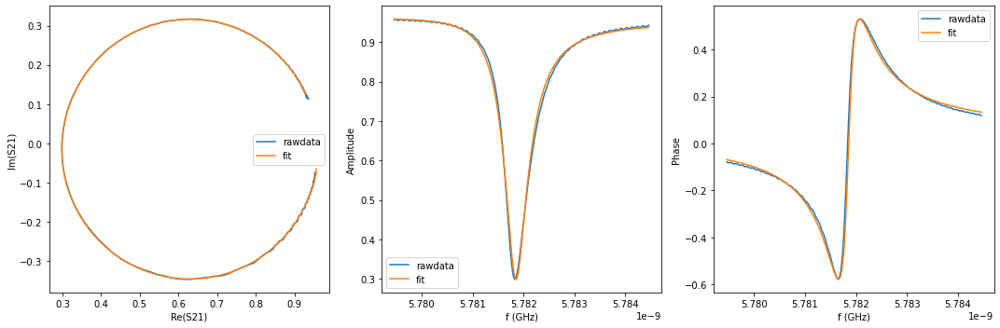

{'Qi_dia_corr': 24922.884682624965, 'Qi_no_corr': 25315.400709246314, 'absQc': 11280.648596117318, 'Qc_dia_corr(Re{Qc})': 11360.374786023927, 'Ql': 7803.414436570129, 'fr': 5.781819201176146, 'theta0': -3.023050315883955, 'phi0': 0.11854233770583811, 'phi0_err': 0.016532898698935178, 'Ql_err': 194.11698288174318, 'absQc_err': 40.573434028998456, 'fr_err': 6.148677077665677e-06, 'chi_square': 0.00022131677249069456, 'Qi_no_corr_err': 2011.497326997954, 'Qi_dia_corr_err': 1991.1081829641546, 'delay': 0.0001446493834879898, 'a': 0.9569285158710285, 'alpha': 0.04402562912416643}


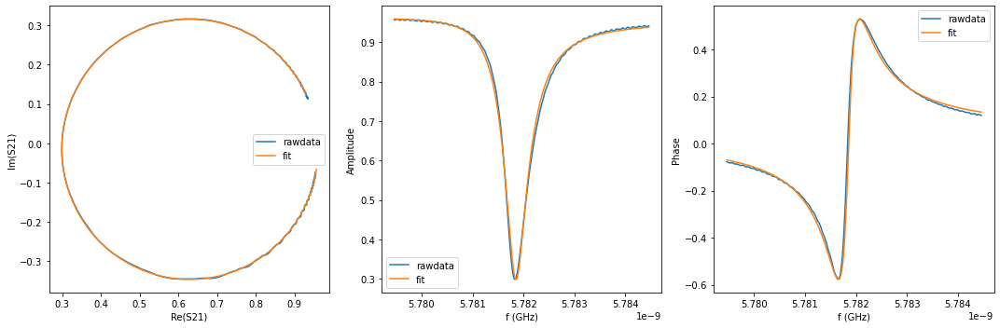

{'Qi_dia_corr': 24951.53695782199, 'Qi_no_corr': 25349.24070303268, 'absQc': 11309.582073054977, 'Qc_dia_corr(Re{Qc})': 11390.582989473643, 'Ql': 7820.472576865718, 'fr': 5.781818944315692, 'theta0': -3.022264014546626, 'phi0': 0.11932863904316736, 'phi0_err': 0.01729553023639636, 'Ql_err': 183.44392891732684, 'absQc_err': 40.60411170080932, 'fr_err': 6.4482865103121225e-06, 'chi_square': 0.000220457129802898, 'Qi_no_corr_err': 1916.617751676133, 'Qi_dia_corr_err': 1911.992540035654, 'delay': -0.06092171581635288, 'a': 0.9567686099364625, 'alpha': -2.1746306988149455}


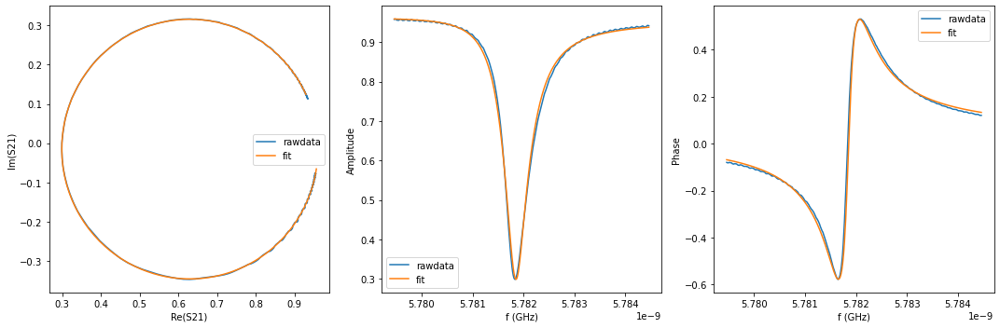

{'Qi_dia_corr': 24901.55742561368, 'Qi_no_corr': 25294.749269651256, 'absQc': 11280.82305850554, 'Qc_dia_corr(Re{Qc})': 11360.824581184006, 'Ql': 7801.5345395028, 'fr': 5.781819088252014, 'theta0': -3.0228479135721185, 'phi0': 0.1187447400176748, 'phi0_err': 0.016871350308875096, 'Ql_err': 184.11732260937868, 'absQc_err': 40.321016540945166, 'fr_err': 6.323707026537826e-06, 'chi_square': 0.00021905698542678818, 'Qi_no_corr_err': 1917.3256429054247, 'Qi_dia_corr_err': 1906.4054306350088, 'delay': 0.019905157147464395, 'a': 0.9570140535486759, 'alpha': 0.7616336734810719}


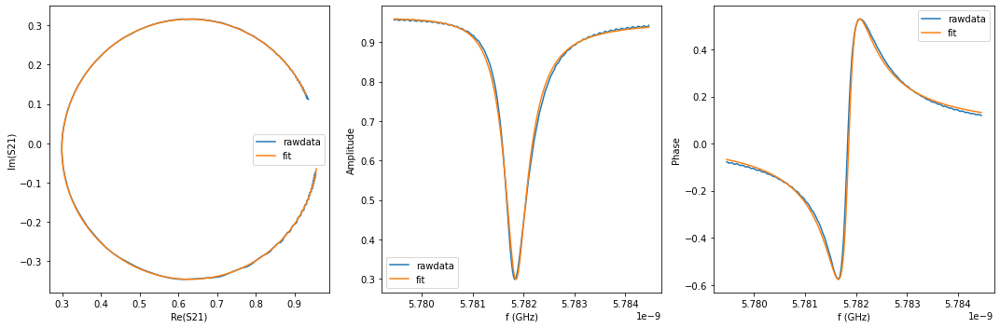

{'Qi_dia_corr': 24828.096231223568, 'Qi_no_corr': 25219.274097721333, 'absQc': 11256.595682041174, 'Qc_dia_corr(Re{Qc})': 11336.317527034651, 'Ql': 7782.76635010158, 'fr': 5.781819180277332, 'theta0': -3.022927690567232, 'phi0': 0.11866496302256116, 'phi0_err': 0.018352595756245153, 'Ql_err': 186.79288612761707, 'absQc_err': 40.33125643146781, 'fr_err': 6.811324558129968e-06, 'chi_square': 0.0002226161427509287, 'Qi_no_corr_err': 1938.786488609194, 'Qi_dia_corr_err': 1932.0561182863125, 'delay': 0.1022072092297701, 'a': 0.957340230212039, 'alpha': -2.531691681068835}


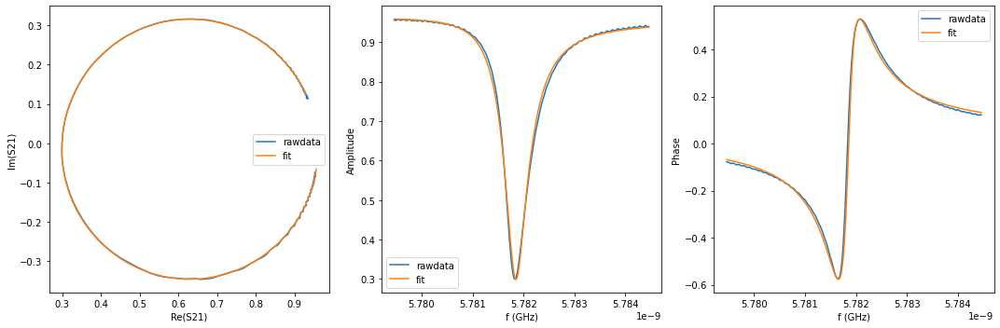

{'Qi_dia_corr': 24846.981461199935, 'Qi_no_corr': 25236.60992430685, 'absQc': 11256.81116745136, 'Qc_dia_corr(Re{Qc})': 11336.102399410627, 'Ql': 7784.519618214406, 'fr': 5.781819153109778, 'theta0': -3.023247866373483, 'phi0': 0.11834479669075429, 'phi0_err': 0.014944288070639935, 'Ql_err': 140.3908558429366, 'absQc_err': 40.479733678193725, 'fr_err': 5.690243998440844e-06, 'chi_square': 0.00022107427079643397, 'Qi_no_corr_err': 1457.9922971147428, 'Qi_dia_corr_err': 1432.862959931554, 'delay': 0.0646797263570547, 'a': 0.9573559712217811, 'alpha': 2.3879051399570694}


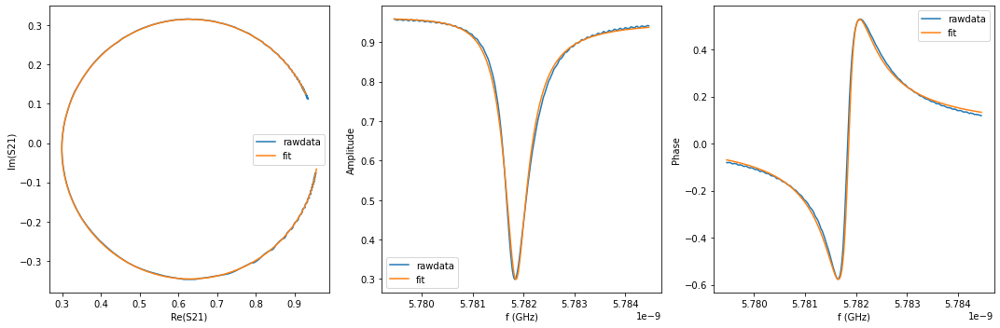

{'Qi_dia_corr': 24907.83604171256, 'Qi_no_corr': 25303.802194409276, 'absQc': 11300.12306601996, 'Qc_dia_corr(Re{Qc})': 11380.920364382766, 'Ql': 7811.62339286499, 'fr': 5.78181875432204, 'theta0': -3.022363627924389, 'phi0': 0.11922902566540447, 'phi0_err': 0.016771656988064203, 'Ql_err': 152.26147543729883, 'absQc_err': 40.42809624473954, 'fr_err': 6.3308026027102485e-06, 'chi_square': 0.00022092225806643882, 'Qi_no_corr_err': 1579.220645162798, 'Qi_dia_corr_err': 1554.3914201973078, 'delay': -0.013327495567738991, 'a': 0.9570218801030276, 'alpha': -0.44612031764265037}


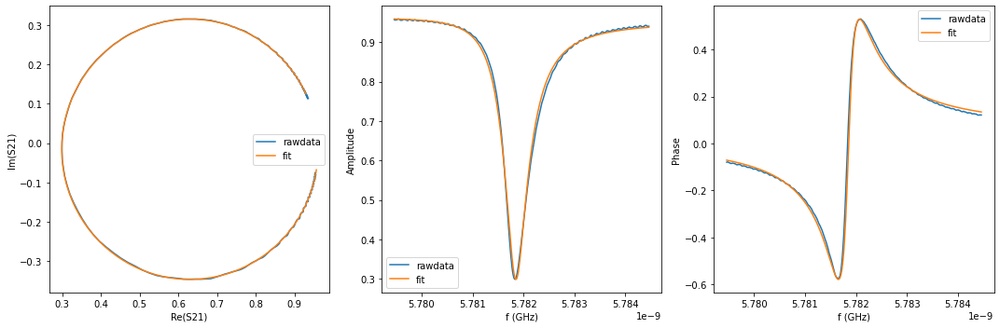

{'Qi_dia_corr': 24971.691148941714, 'Qi_no_corr': 25368.746029889717, 'absQc': 11325.407727991582, 'Qc_dia_corr(Re{Qc})': 11406.374167828992, 'Ql': 7829.895580427686, 'fr': 5.781818824494007, 'theta0': -3.022372151785342, 'phi0': 0.11922050180445122, 'phi0_err': 0.01654056068017836, 'Ql_err': 184.505706209621, 'absQc_err': 41.291192254932966, 'fr_err': 6.198258007339226e-06, 'chi_square': 0.0002249103813769598, 'Qi_no_corr_err': 1935.7840504949277, 'Qi_dia_corr_err': 1919.2590391262354, 'delay': -0.11248950060290609, 'a': 0.9568560253207662, 'alpha': 2.234330934403659}


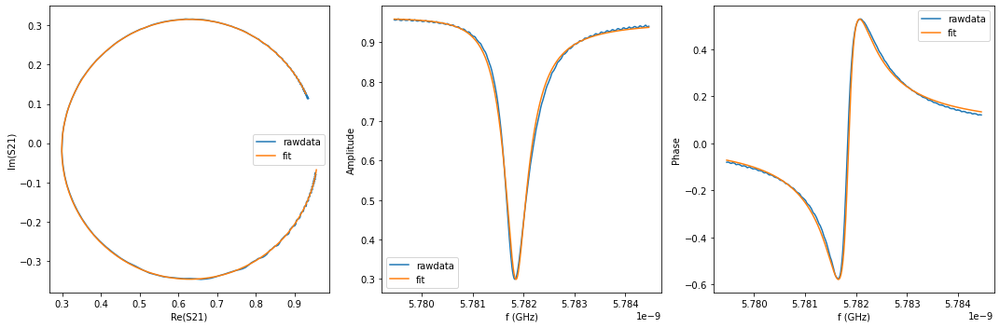

{'Qi_dia_corr': 24977.560856536827, 'Qi_no_corr': 25374.99232902964, 'absQc': 11324.675299530558, 'Qc_dia_corr(Re{Qc})': 11405.669298926492, 'Ql': 7830.140364287903, 'fr': 5.781818937109445, 'theta0': -3.022348150305943, 'phi0': 0.11924450328385017, 'phi0_err': 0.01605850212479443, 'Ql_err': 178.88321345986935, 'absQc_err': 41.21950940954681, 'fr_err': 6.0401694341395166e-06, 'chi_square': 0.00022492754338896936, 'Qi_no_corr_err': 1875.087144673416, 'Qi_dia_corr_err': 1847.6653129492504, 'delay': -0.1230901095205688, 'a': 0.9569331488680868, 'alpha': 1.8493227293562344}


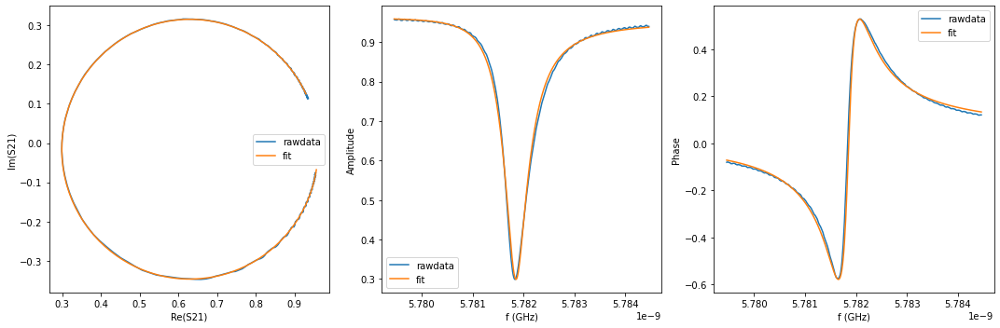

{'Qi_dia_corr': 24930.46998353505, 'Qi_no_corr': 25324.083761930004, 'absQc': 11305.155202301088, 'Qc_dia_corr(Re{Qc})': 11385.40260907647, 'Ql': 7815.960838396339, 'fr': 5.78181902764286, 'theta0': -3.022793944723303, 'phi0': 0.1187987088664897, 'phi0_err': 0.01745621229502178, 'Ql_err': 201.09727698839237, 'absQc_err': 41.1046719782345, 'fr_err': 6.478029530872222e-06, 'chi_square': 0.00022368894284650816, 'Qi_no_corr_err': 2116.3589734936468, 'Qi_dia_corr_err': 2101.3610894353087, 'delay': -0.09487438728127827, 'a': 0.9570482561017736, 'alpha': 2.874114241508063}


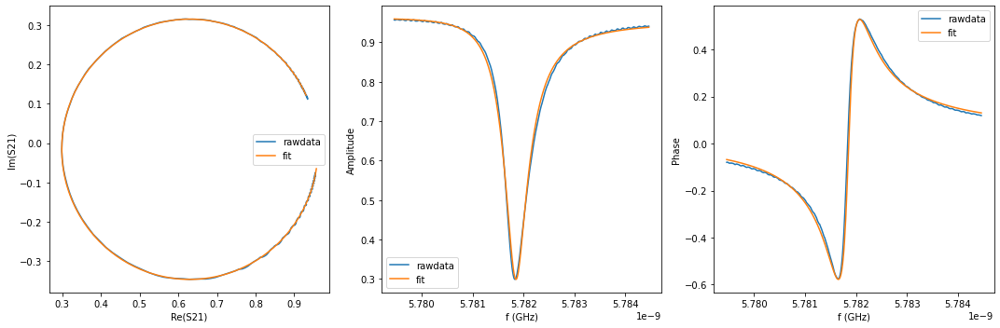

{'Qi_dia_corr': 24824.11408061553, 'Qi_no_corr': 25217.493653997233, 'absQc': 11245.757004477922, 'Qc_dia_corr(Re{Qc})': 11325.794501548191, 'Ql': 7777.4142670656865, 'fr': 5.781818849230882, 'theta0': -3.0226374354289103, 'phi0': 0.11895521816088296, 'phi0_err': 0.016181397168096266, 'Ql_err': 176.84994968143985, 'absQc_err': 40.25542908505371, 'fr_err': 6.057666177616336e-06, 'chi_square': 0.0002212623437499524, 'Qi_no_corr_err': 1832.9600667973643, 'Qi_dia_corr_err': 1802.2863111944166, 'delay': 0.13949128143693693, 'a': 0.9576272086434339, 'alpha': -1.177954776257737}


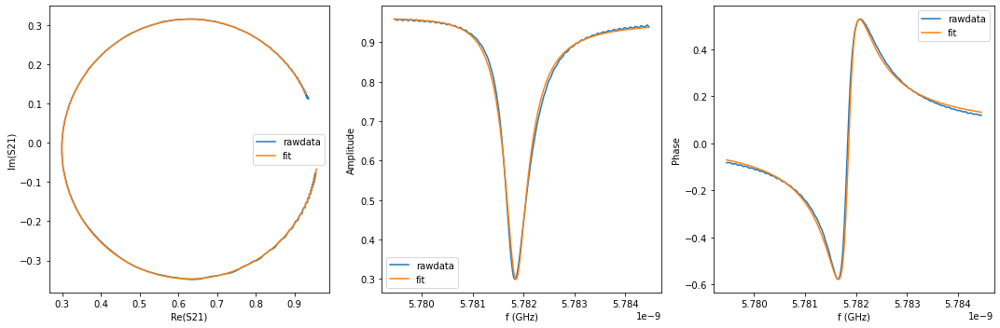

{'Qi_dia_corr': 24905.908071445716, 'Qi_no_corr': 25302.267306869133, 'absQc': 11298.184326487886, 'Qc_dia_corr(Re{Qc})': 11379.045802226725, 'Ql': 7810.550612182583, 'fr': 5.781818819796537, 'theta0': -3.022306482969992, 'phi0': 0.11928626027630763, 'phi0_err': 0.0173195969904832, 'Ql_err': 181.24924211436462, 'absQc_err': 40.753259475317215, 'fr_err': 6.469119636880486e-06, 'chi_square': 0.00022357764441609913, 'Qi_no_corr_err': 1889.280815206616, 'Qi_dia_corr_err': 1876.856311609451, 'delay': -0.03146505583388365, 'a': 0.9571222410225554, 'alpha': -1.105698037980338}


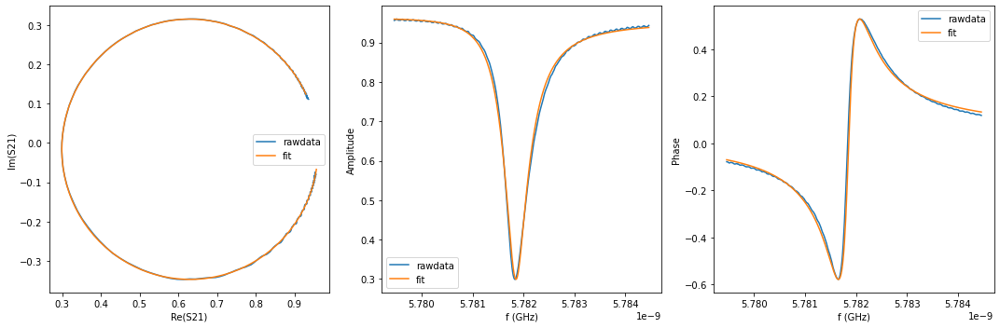

{'Qi_dia_corr': 24917.52986628346, 'Qi_no_corr': 25317.620088998545, 'absQc': 11302.122671816198, 'Qc_dia_corr(Re{Qc})': 11383.71968880795, 'Ql': 7813.895632016541, 'fr': 5.781818599531413, 'theta0': -3.021789087332784, 'phi0': 0.11980358049815598, 'phi0_err': 0.016362813107824083, 'Ql_err': 194.5610345010414, 'absQc_err': 40.55858516593614, 'fr_err': 6.065653089303e-06, 'chi_square': 0.00022031112161484016, 'Qi_no_corr_err': 2026.7416181006383, 'Qi_dia_corr_err': 2008.1659678571202, 'delay': -0.03544941512813578, 'a': 0.9572758931336727, 'alpha': -1.2501826667366627}


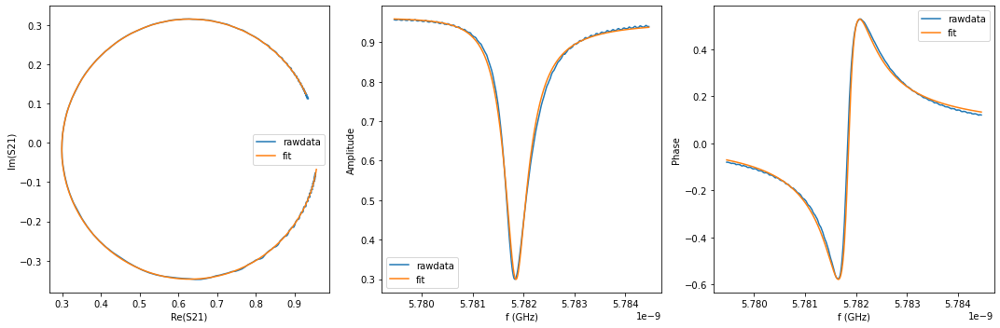

{'Qi_dia_corr': 24894.00472873583, 'Qi_no_corr': 25291.815849045903, 'absQc': 11297.302750917654, 'Qc_dia_corr(Re{Qc})': 11378.522714145694, 'Ql': 7809.133198617515, 'fr': 5.78181865918744, 'theta0': -3.022039200770261, 'phi0': 0.11955345281953234, 'phi0_err': 0.015825982042991845, 'Ql_err': 213.51620808180226, 'absQc_err': 40.918374701762204, 'fr_err': 5.903821694849795e-06, 'chi_square': 0.00022074882856458965, 'Qi_no_corr_err': 2244.090123996499, 'Qi_dia_corr_err': 2217.212332897277, 'delay': -0.04625202624252304, 'a': 0.9573043076636879, 'alpha': -1.6430294952485003}


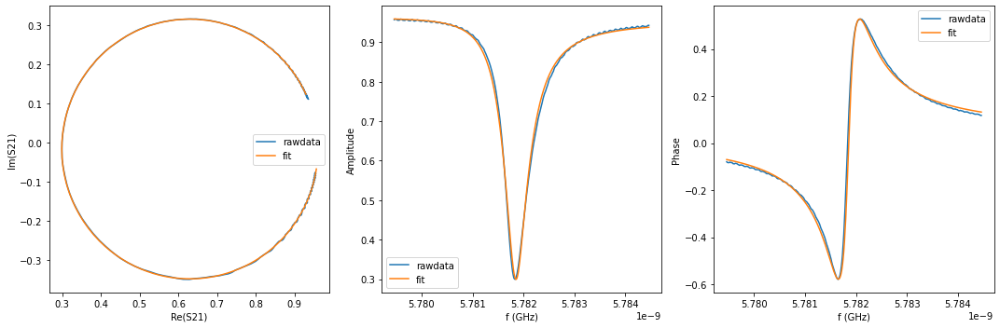

{'Qi_dia_corr': 24882.887085793274, 'Qi_no_corr': 25279.99463762165, 'absQc': 11287.263787642196, 'Qc_dia_corr(Re{Qc})': 11368.269084771442, 'Ql': 7803.209218109627, 'fr': 5.781818799272274, 'theta0': -3.0221436413649423, 'phi0': 0.11944906520639835, 'phi0_err': 0.015849786000678, 'Ql_err': 205.10377344330288, 'absQc_err': 40.56026704995084, 'fr_err': 5.9392633274831236e-06, 'chi_square': 0.0002208805318317583, 'Qi_no_corr_err': 2140.3869908640354, 'Qi_dia_corr_err': 2109.591557448248, 'delay': 0.0046427949137319065, 'a': 0.9574510119396753, 'alpha': 0.2059880116105214}


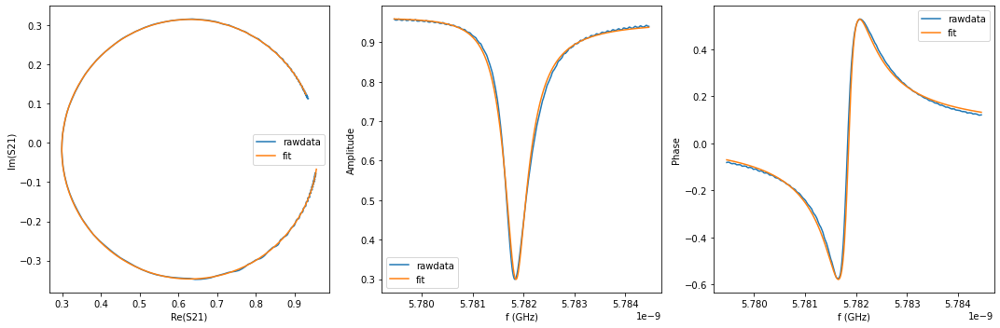

{'Qi_dia_corr': 24884.955187412503, 'Qi_no_corr': 25282.744647894106, 'absQc': 11284.687219462496, 'Qc_dia_corr(Re{Qc})': 11365.779768771577, 'Ql': 7802.239611355263, 'fr': 5.781818757163967, 'theta0': -3.02206610702824, 'phi0': 0.11952655755442353, 'phi0_err': 0.01824639997720094, 'Ql_err': 197.96512466610235, 'absQc_err': 40.39156637933951, 'fr_err': 6.805037617723642e-06, 'chi_square': 0.00022098058772384942, 'Qi_no_corr_err': 2066.718299996342, 'Qi_dia_corr_err': 2053.038757455015, 'delay': -0.001244300545044237, 'a': 0.9575082307426096, 'alpha': -0.007928742032238836}


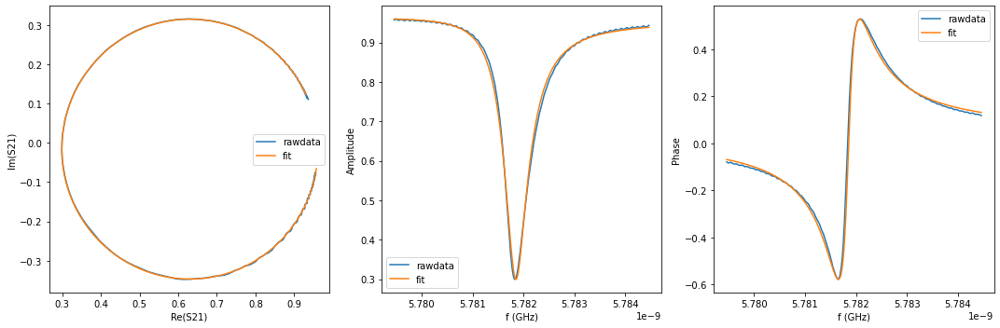

{'Qi_dia_corr': 24841.35138869343, 'Qi_no_corr': 25240.420514950023, 'absQc': 11266.10451746785, 'Qc_dia_corr(Re{Qc})': 11347.471687174104, 'Ql': 7789.3257529648, 'fr': 5.78181852568669, 'theta0': -3.021766990509776, 'phi0': 0.11982567938484974, 'phi0_err': 0.016197158821527443, 'Ql_err': 161.6799375180082, 'absQc_err': 40.28832650070617, 'fr_err': 6.031613851039922e-06, 'chi_square': 0.0002197244384515004, 'Qi_no_corr_err': 1667.6592219887727, 'Qi_dia_corr_err': 1651.816055263045, 'delay': 0.07986089911147713, 'a': 0.9577294983627211, 'alpha': 2.9388281193907386}


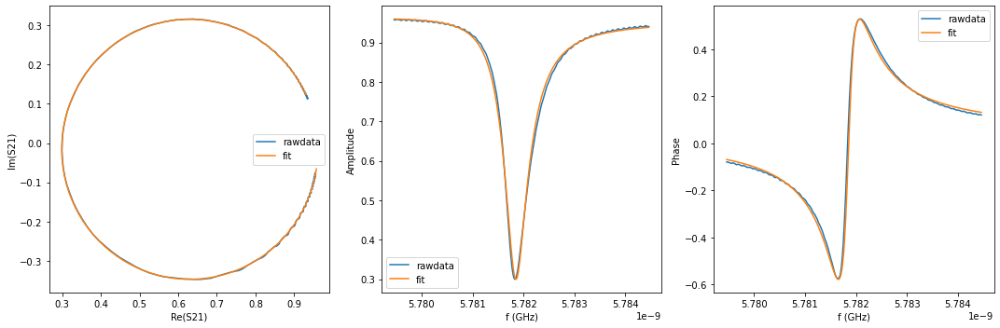

{'Qi_dia_corr': 24837.942845800593, 'Qi_no_corr': 25237.41707910621, 'absQc': 11269.091706477844, 'Qc_dia_corr(Re{Qc})': 11350.60646062536, 'Ql': 7790.467425123517, 'fr': 5.78181856046699, 'theta0': -3.021674832377759, 'phi0': 0.11991784831357528, 'phi0_err': 0.016305827376583714, 'Ql_err': 168.7078703816937, 'absQc_err': 40.40308052343138, 'fr_err': 6.15966481505936e-06, 'chi_square': 0.00022043820428446808, 'Qi_no_corr_err': 1760.6779807007943, 'Qi_dia_corr_err': 1741.320042639824, 'delay': 0.06604225973898908, 'a': 0.9577243981763516, 'alpha': 2.436909558369767}


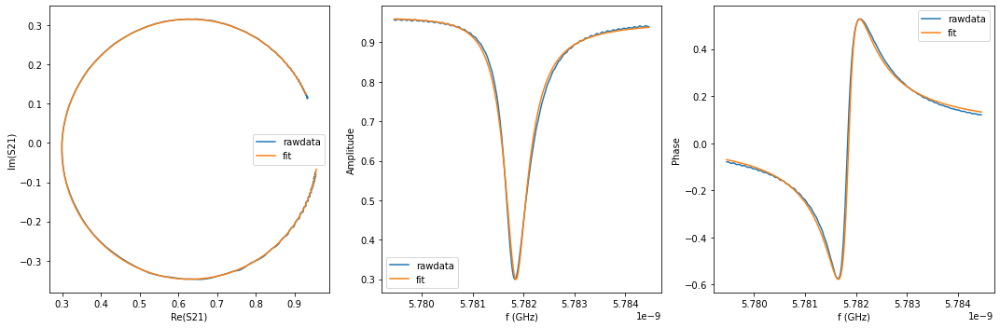

{'Qi_dia_corr': 24897.156530831613, 'Qi_no_corr': 25298.9552949217, 'absQc': 11298.47754628299, 'Qc_dia_corr(Re{Qc})': 11380.500907805801, 'Ql': 7810.375104296001, 'fr': 5.781818493387631, 'theta0': -3.0214591123371806, 'phi0': 0.1201335412526126, 'phi0_err': 0.016481853046739842, 'Ql_err': 179.6573946150819, 'absQc_err': 40.59339113597966, 'fr_err': 6.150727537600904e-06, 'chi_square': 0.00021997412375765756, 'Qi_no_corr_err': 1877.7421888049043, 'Qi_dia_corr_err': 1864.7378954983044, 'delay': -0.015238369364507655, 'a': 0.9574430471149413, 'alpha': -0.5160038980492058}


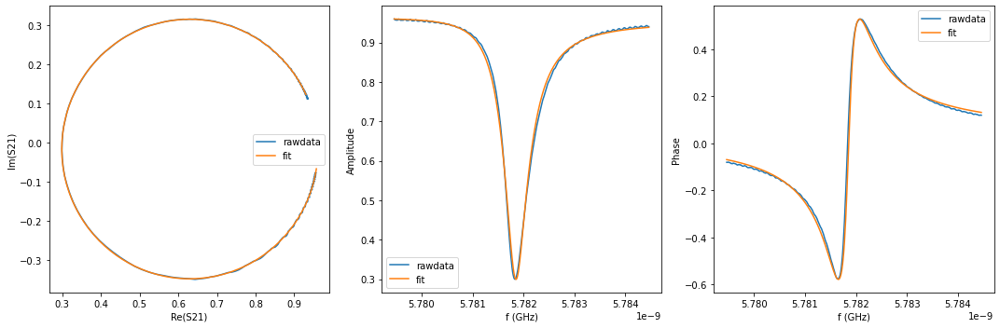

{'Qi_dia_corr': 24835.84545022446, 'Qi_no_corr': 25231.180869803164, 'absQc': 11266.95116965742, 'Qc_dia_corr(Re{Qc})': 11347.611514070622, 'Ql': 7788.850193908941, 'fr': 5.78181883292178, 'theta0': -3.0222899293978673, 'phi0': 0.11930273284244715, 'phi0_err': 0.01679926695646618, 'Ql_err': 200.47722650056994, 'absQc_err': 40.80831605787986, 'fr_err': 6.368210884635593e-06, 'chi_square': 0.00022259337204623352, 'Qi_no_corr_err': 2112.667202442008, 'Qi_dia_corr_err': 2078.359817156579, 'delay': 0.05765895311759608, 'a': 0.9576706885033736, 'alpha': 2.1320462327422796}


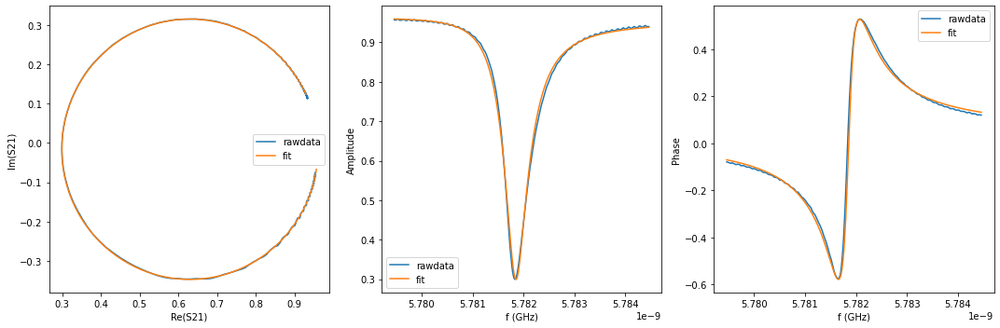

{'Qi_dia_corr': 24880.771036088743, 'Qi_no_corr': 25278.456206375136, 'absQc': 11286.388308276577, 'Qc_dia_corr(Re{Qc})': 11367.511570623363, 'Ql': 7802.644216484818, 'fr': 5.781818733562032, 'theta0': -3.0220525773828357, 'phi0': 0.11954009951461873, 'phi0_err': 0.01647005215426903, 'Ql_err': 178.0789772062296, 'absQc_err': 40.81254383496294, 'fr_err': 6.155247273003689e-06, 'chi_square': 0.0002231658491180228, 'Qi_no_corr_err': 1856.4967213278671, 'Qi_dia_corr_err': 1847.0052483319878, 'delay': -3.432424417476449e-05, 'a': 0.9574946661863677, 'alpha': 0.0363794421246292}


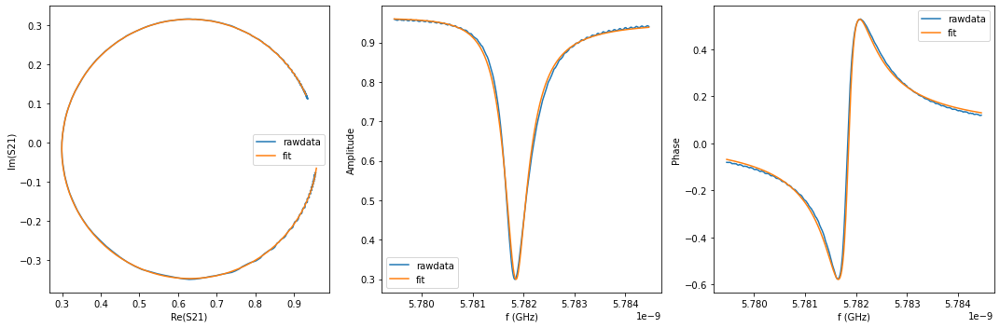

{'Qi_dia_corr': 24787.869314425727, 'Qi_no_corr': 25182.033276964255, 'absQc': 11246.686260991873, 'Qc_dia_corr(Re{Qc})': 11327.129839693815, 'Ql': 7774.48209193257, 'fr': 5.781818843485247, 'theta0': -3.0223427320577807, 'phi0': 0.11924992366959274, 'phi0_err': 0.015204205288839841, 'Ql_err': 181.90383628405044, 'absQc_err': 40.34961340324617, 'fr_err': 5.801746368227508e-06, 'chi_square': 0.00022088148054000005, 'Qi_no_corr_err': 1893.4731608403267, 'Qi_dia_corr_err': 1837.076715679873, 'delay': 0.15298204826866474, 'a': 0.9579653906503565, 'alpha': -0.6881910256838718}


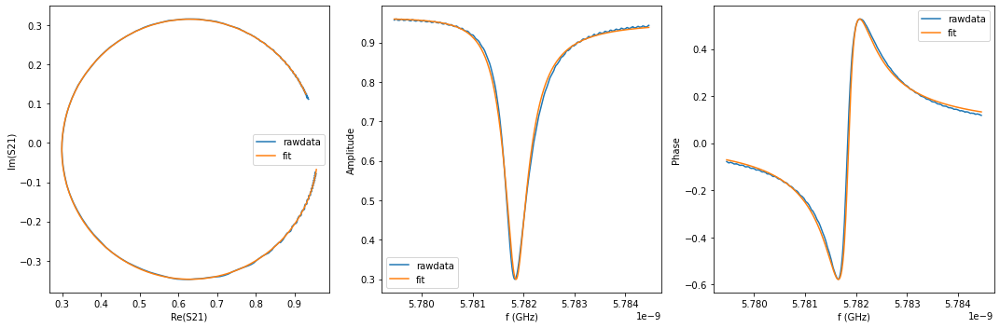

{'Qi_dia_corr': 24934.22484449583, 'Qi_no_corr': 25335.055073620337, 'absQc': 11312.491398796654, 'Qc_dia_corr(Re{Qc})': 11394.279072750835, 'Ql': 7820.512427048367, 'fr': 5.781818572471334, 'theta0': -3.0217046793833005, 'phi0': 0.11988797420649262, 'phi0_err': 0.01625260896035003, 'Ql_err': 163.91200011392854, 'absQc_err': 40.55496291927889, 'fr_err': 6.100984046771884e-06, 'chi_square': 0.00022038755435483005, 'Qi_no_corr_err': 1704.7857514436898, 'Qi_dia_corr_err': 1684.0112973192506, 'delay': -0.06176138885058721, 'a': 0.9573822837700062, 'alpha': -2.2064378484373943}


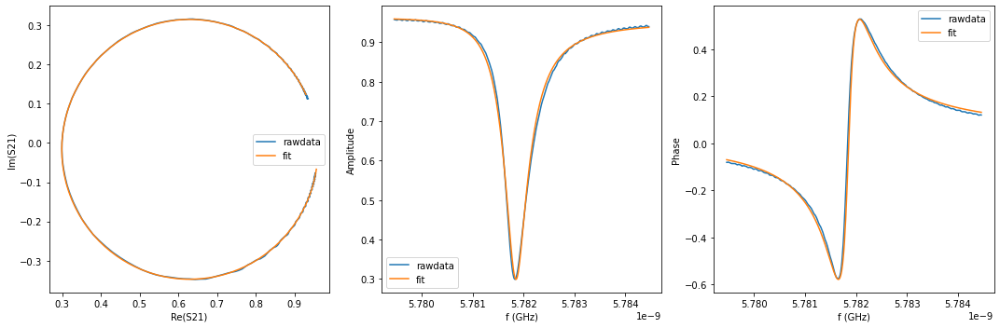

{'Qi_dia_corr': 24927.804263195478, 'Qi_no_corr': 25329.498290340995, 'absQc': 11291.257183069176, 'Qc_dia_corr(Re{Qc})': 11372.953091824238, 'Ql': 7809.830130948915, 'fr': 5.781818245282949, 'theta0': -3.021659654526406, 'phi0': 0.11993304083122626, 'phi0_err': 0.016949664938374027, 'Ql_err': 161.30859379759823, 'absQc_err': 40.4486388891019, 'fr_err': 6.399750768765797e-06, 'chi_square': 0.00022013162031438185, 'Qi_no_corr_err': 1690.5105063572983, 'Qi_dia_corr_err': 1672.7027381264143, 'delay': 0.005082185361310266, 'a': 0.9574629572341703, 'alpha': 0.22194626165008685}


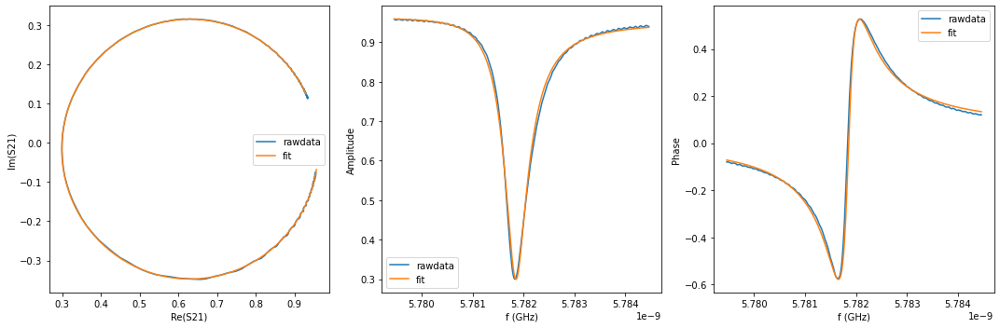

{'Qi_dia_corr': 24978.6138870562, 'Qi_no_corr': 25382.790448098483, 'absQc': 11338.160741823453, 'Qc_dia_corr(Re{Qc})': 11420.707312674323, 'Ql': 7837.3285236561815, 'fr': 5.781818127891987, 'theta0': -3.021288687430962, 'phi0': 0.12030396615883106, 'phi0_err': 0.015452218343228184, 'Ql_err': 153.82699218788255, 'absQc_err': 41.23221404856364, 'fr_err': 5.8616791774389455e-06, 'chi_square': 0.00022446647070011738, 'Qi_no_corr_err': 1604.3380825853872, 'Qi_dia_corr_err': 1568.1078275903217, 'delay': -0.13020399380958803, 'a': 0.957126148696944, 'alpha': 1.5903307249896252}


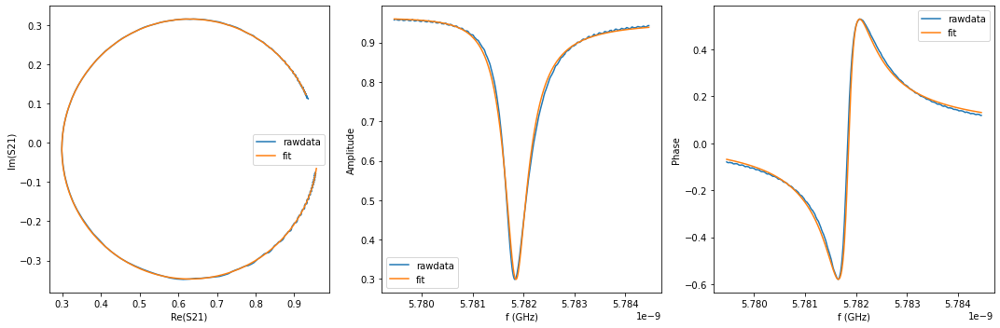

{'Qi_dia_corr': 24853.88163557908, 'Qi_no_corr': 25253.697721348573, 'absQc': 11262.556015881371, 'Qc_dia_corr(Re{Qc})': 11343.940565795878, 'Ql': 7788.892782964864, 'fr': 5.781818335314586, 'theta0': -3.021735495090379, 'phi0': 0.1198571640141882, 'phi0_err': 0.01651758858767971, 'Ql_err': 199.1275010462499, 'absQc_err': 40.629229572475595, 'fr_err': 6.147887856026803e-06, 'chi_square': 0.00022343420546755625, 'Qi_no_corr_err': 2064.9055990352686, 'Qi_dia_corr_err': 2040.4652168467526, 'delay': 0.10702466490116123, 'a': 0.9578016857584619, 'alpha': -2.3576914497548382}


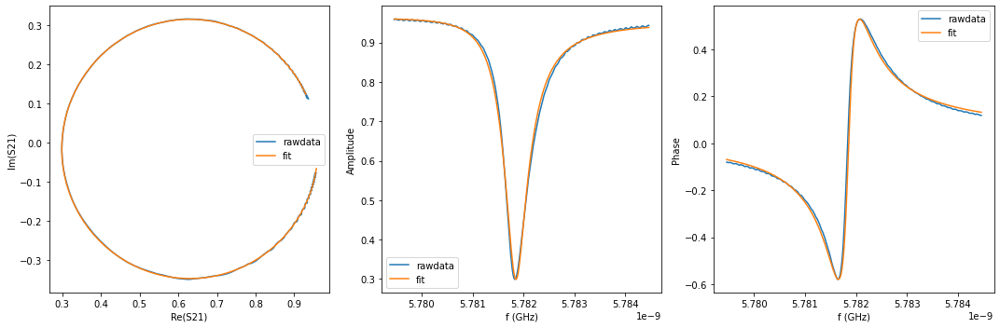

{'Qi_dia_corr': 24896.783512968752, 'Qi_no_corr': 25299.643060294864, 'absQc': 11274.015220918782, 'Qc_dia_corr(Re{Qc})': 11355.898674031558, 'Ql': 7798.742984704007, 'fr': 5.781818181126523, 'theta0': -3.0214316612385304, 'phi0': 0.12016102544078244, 'phi0_err': 0.016108150771463884, 'Ql_err': 184.24484767329102, 'absQc_err': 40.563629350391984, 'fr_err': 6.052453550857635e-06, 'chi_square': 0.0002209405893729268, 'Qi_no_corr_err': 1929.445341387918, 'Qi_dia_corr_err': 1910.1894122595645, 'delay': 0.04173890723357679, 'a': 0.9577063338867652, 'alpha': 1.5537744458567582}


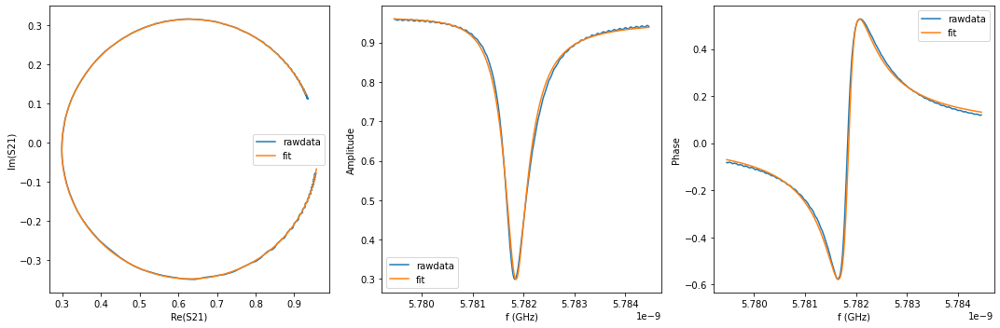

{'Qi_dia_corr': 24908.427241649533, 'Qi_no_corr': 25309.377272422502, 'absQc': 11289.479543788202, 'Qc_dia_corr(Re{Qc})': 11371.126480713392, 'Ql': 7807.066171981465, 'fr': 5.7818184781692175, 'theta0': -3.021685988899913, 'phi0': 0.11990668700159035, 'phi0_err': 0.016346233536899193, 'Ql_err': 174.91130067093889, 'absQc_err': 40.36450811220464, 'fr_err': 6.137728378402629e-06, 'chi_square': 0.00022012973927737337, 'Qi_no_corr_err': 1821.0456772621626, 'Qi_dia_corr_err': 1794.8408359713223, 'delay': 0.006089749916762102, 'a': 0.9576854969642685, 'alpha': 0.2585507903900875}


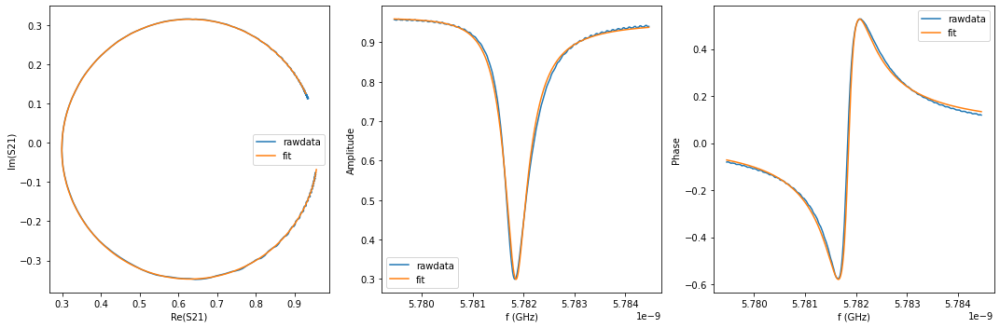

{'Qi_dia_corr': 24999.618213720525, 'Qi_no_corr': 25406.002773822, 'absQc': 11334.363953973234, 'Qc_dia_corr(Re{Qc})': 11417.162520691865, 'Ql': 7837.724761639374, 'fr': 5.781818324229672, 'theta0': -3.02108624925845, 'phi0': 0.12050640433134308, 'phi0_err': 0.01646460874717172, 'Ql_err': 215.14845286037465, 'absQc_err': 41.38483378231682, 'fr_err': 6.129607486652389e-06, 'chi_square': 0.00022567254820600907, 'Qi_no_corr_err': 2263.2684653837373, 'Qi_dia_corr_err': 2232.1895139985486, 'delay': -0.13055817234492983, 'a': 0.9573468184924984, 'alpha': 1.5777240489856155}


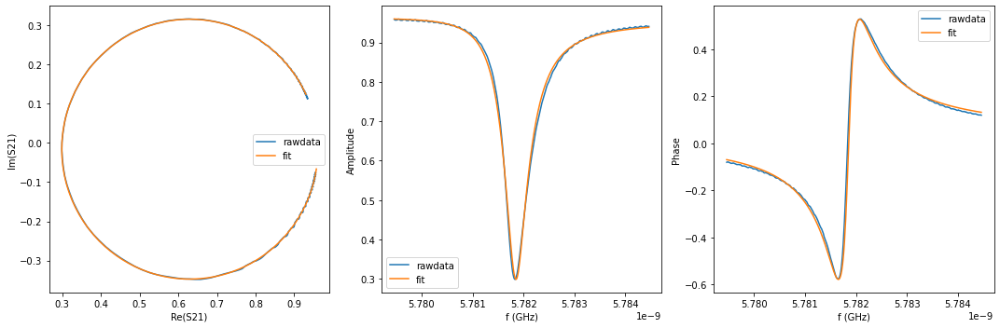

{'Qi_dia_corr': 24931.483064097196, 'Qi_no_corr': 25334.044652921133, 'absQc': 11287.56778432928, 'Qc_dia_corr(Re{Qc})': 11369.360778696455, 'Ql': 7808.496874927394, 'fr': 5.781818366978113, 'theta0': -3.0215693158600385, 'phi0': 0.12002334799783348, 'phi0_err': 0.016393352491430705, 'Ql_err': 179.78584693299186, 'absQc_err': 40.43396888800685, 'fr_err': 6.124208616200735e-06, 'chi_square': 0.00022055995668024387, 'Qi_no_corr_err': 1875.7818936224403, 'Qi_dia_corr_err': 1855.5414262269833, 'delay': 0.01146737079322914, 'a': 0.9576314543933974, 'alpha': 0.45420018670874807}


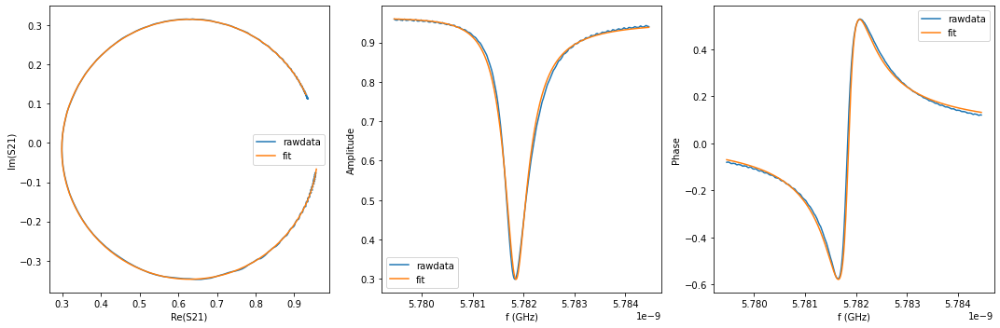

{'Qi_dia_corr': 24963.03736219208, 'Qi_no_corr': 25366.47316822993, 'absQc': 11297.576762197907, 'Qc_dia_corr(Re{Qc})': 11379.484477688082, 'Ql': 7816.367213881521, 'fr': 5.781818331799635, 'theta0': -3.0215385654445392, 'phi0': 0.12005408814525388, 'phi0_err': 0.015836303134456865, 'Ql_err': 153.0551496440657, 'absQc_err': 40.50424698486906, 'fr_err': 5.992105668178651e-06, 'chi_square': 0.00022000759733353082, 'Qi_no_corr_err': 1600.5486053437926, 'Qi_dia_corr_err': 1574.2477295106298, 'delay': 0.007198182498714123, 'a': 0.9575920829483004, 'alpha': 0.2989941482471396}


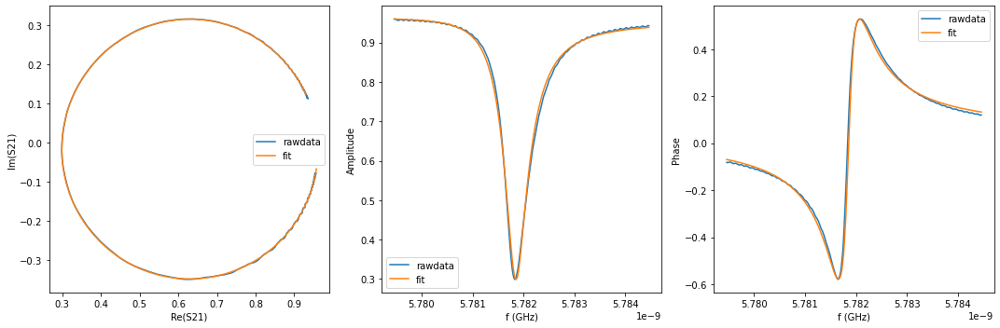

{'Qi_dia_corr': 24930.6329463742, 'Qi_no_corr': 25333.198566606647, 'absQc': 11290.858129321314, 'Qc_dia_corr(Re{Qc})': 11372.705378888657, 'Ql': 7809.990939897281, 'fr': 5.781818518689906, 'theta0': -3.0215471344095213, 'phi0': 0.12004551918027176, 'phi0_err': 0.01855395982626733, 'Ql_err': 250.8076034768987, 'absQc_err': 40.38817962397384, 'fr_err': 6.900764136401747e-06, 'chi_square': 0.0002219106691932489, 'Qi_no_corr_err': 2614.8190422356342, 'Qi_dia_corr_err': 2578.2957471994296, 'delay': 0.0020162903167342087, 'a': 0.9576685384034052, 'alpha': 0.11099060227932739}


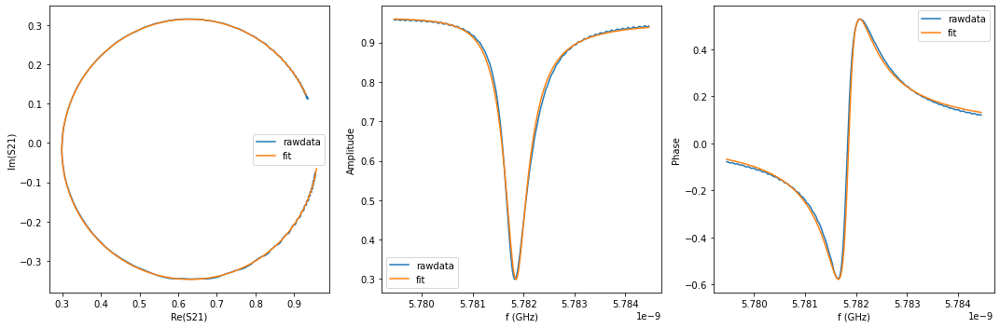

{'Qi_dia_corr': 24863.58675271224, 'Qi_no_corr': 25268.351632747366, 'absQc': 11262.55390111135, 'Qc_dia_corr(Re{Qc})': 11344.87262687377, 'Ql': 7790.28518721725, 'fr': 5.781818171586749, 'theta0': -3.021053703501714, 'phi0': 0.12053896546961666, 'phi0_err': 0.01640352407262996, 'Ql_err': 174.2060376507009, 'absQc_err': 40.17917438510538, 'fr_err': 6.158138524063664e-06, 'chi_square': 0.000218794872262636, 'Qi_no_corr_err': 1815.5754241245756, 'Qi_dia_corr_err': 1801.113593560371, 'delay': 0.09960501913684258, 'a': 0.9579216556660806, 'alpha': -2.627023738354719}


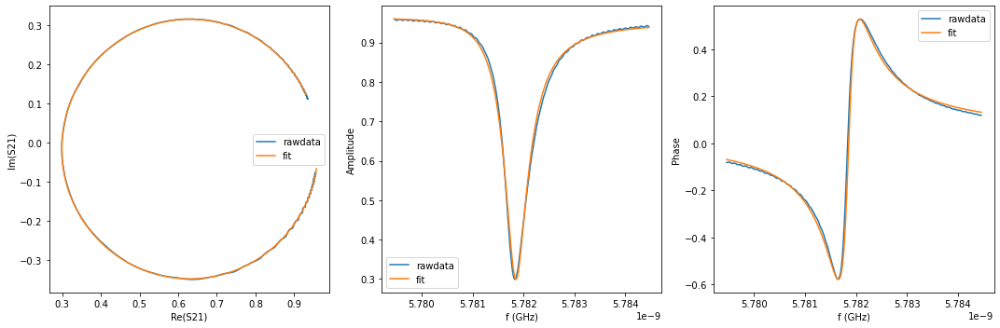

{'Qi_dia_corr': 24907.43471589533, 'Qi_no_corr': 25310.904590891907, 'absQc': 11277.702165948209, 'Qc_dia_corr(Re{Qc})': 11359.692307361682, 'Ql': 7801.577289450805, 'fr': 5.781818202636403, 'theta0': -3.021373390789294, 'phi0': 0.12021927176448016, 'phi0_err': 0.016063431749343986, 'Ql_err': 192.26966947670155, 'absQc_err': 40.48494830513813, 'fr_err': 6.08429760128128e-06, 'chi_square': 0.00022183103400553677, 'Qi_no_corr_err': 2013.1385935015908, 'Qi_dia_corr_err': 1967.882437674663, 'delay': 0.03628935759391629, 'a': 0.9578623006079443, 'alpha': 1.3560682695123951}


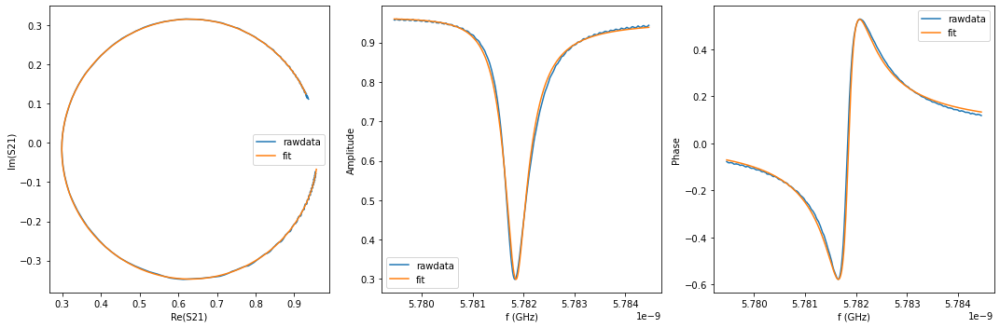

{'Qi_dia_corr': 24967.783954206134, 'Qi_no_corr': 25372.672455883567, 'absQc': 11318.975747873132, 'Qc_dia_corr(Re{Qc})': 11401.457281327772, 'Ql': 7827.194422884232, 'fr': 5.781818200648345, 'theta0': -3.02123457301317, 'phi0': 0.12035810597159873, 'phi0_err': 0.017511146812653203, 'Ql_err': 185.76529000724727, 'absQc_err': 40.878223847904394, 'fr_err': 6.4736089352751375e-06, 'chi_square': 0.00022382131055693493, 'Qi_no_corr_err': 1931.155310231835, 'Qi_dia_corr_err': 1924.278891886348, 'delay': -0.07498776924103286, 'a': 0.9575448697426842, 'alpha': -2.6862864248494063}


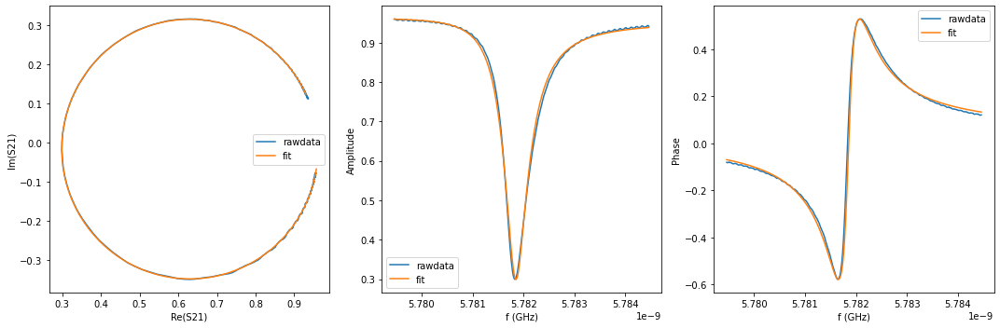

{'Qi_dia_corr': 24921.66557952667, 'Qi_no_corr': 25322.574969248857, 'absQc': 11299.105786712338, 'Qc_dia_corr(Re{Qc})': 11380.79751225227, 'Ql': 7812.925225255326, 'fr': 5.781818418132729, 'theta0': -3.0217040990058375, 'phi0': 0.1198885778699013, 'phi0_err': 0.0170319547356169, 'Ql_err': 217.86732684073638, 'absQc_err': 40.46798405722317, 'fr_err': 6.397474426145853e-06, 'chi_square': 0.00022178927592515245, 'Qi_no_corr_err': 2274.786707176237, 'Qi_dia_corr_err': 2221.8040997371536, 'delay': -0.022119245320574202, 'a': 0.9577152363813929, 'alpha': -0.7658984059948682}


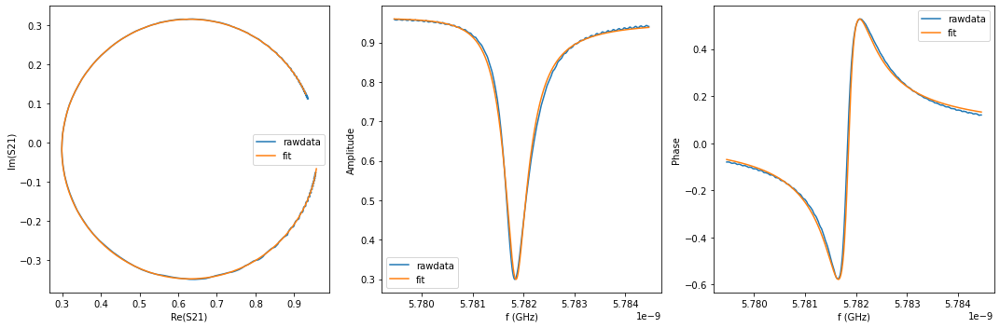

{'Qi_dia_corr': 24918.348498402647, 'Qi_no_corr': 25324.499759699702, 'absQc': 11302.213792333094, 'Qc_dia_corr(Re{Qc})': 11385.031927361253, 'Ql': 7814.594396010958, 'fr': 5.7818179600826465, 'theta0': -3.0209018540845416, 'phi0': 0.12069081280928093, 'phi0_err': 0.017645697817142703, 'Ql_err': 254.70771800163732, 'absQc_err': 40.546509371454164, 'fr_err': 6.606597714260558e-06, 'chi_square': 0.000221519626804004, 'Qi_no_corr_err': 2675.4581543198497, 'Qi_dia_corr_err': 2625.47500389218, 'delay': 0.0016146088780435396, 'a': 0.9577427766485948, 'alpha': 0.09665222914492831}


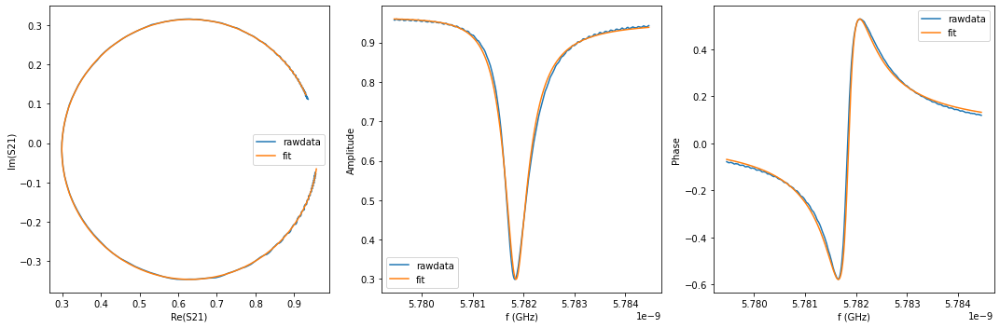

{'Qi_dia_corr': 24890.61303399184, 'Qi_no_corr': 25292.26322916769, 'absQc': 11280.419970884523, 'Qc_dia_corr(Re{Qc})': 11362.19338715728, 'Ql': 7801.105258767673, 'fr': 5.781818390849253, 'theta0': -3.021545797201065, 'phi0': 0.12004685638872804, 'phi0_err': 0.0158705519653415, 'Ql_err': 163.64548211918137, 'absQc_err': 40.48999288076749, 'fr_err': 5.930312844081066e-06, 'chi_square': 0.0002206928213205946, 'Qi_no_corr_err': 1698.047858374157, 'Qi_dia_corr_err': 1683.1210452109583, 'delay': 0.061760034243238206, 'a': 0.9579203290029199, 'alpha': 2.281580946098702}


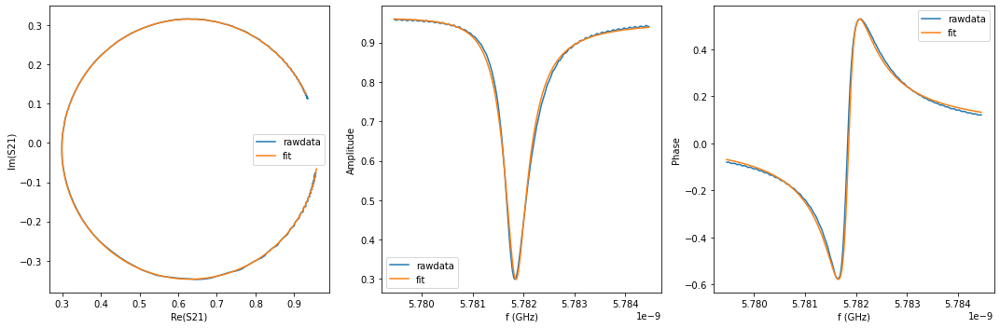

{'Qi_dia_corr': 24912.01740569985, 'Qi_no_corr': 25314.196937334105, 'absQc': 11289.488034637683, 'Qc_dia_corr(Re{Qc})': 11371.359686969075, 'Ql': 7807.528767918485, 'fr': 5.781818310392066, 'theta0': -3.0215221059094675, 'phi0': 0.12007054768032563, 'phi0_err': 0.017124640567655648, 'Ql_err': 197.37528521022662, 'absQc_err': 40.611895688060294, 'fr_err': 6.45280308382323e-06, 'chi_square': 0.00022224456580365067, 'Qi_no_corr_err': 2071.618705191418, 'Qi_dia_corr_err': 2043.1851326686044, 'delay': 0.04127620017528763, 'a': 0.9579157586161842, 'alpha': 1.537560726037413}


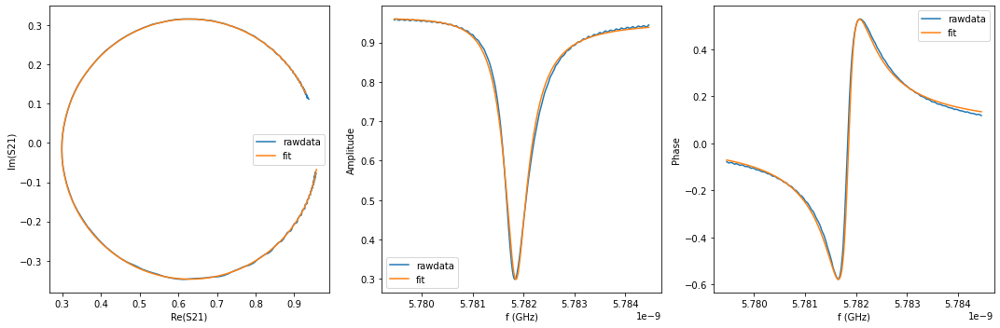

{'Qi_dia_corr': 25001.98991592028, 'Qi_no_corr': 25408.78856005108, 'absQc': 11331.69529511651, 'Qc_dia_corr(Re{Qc})': 11414.522613837189, 'Ql': 7836.71360768005, 'fr': 5.781818003166468, 'theta0': -3.0210513793114004, 'phi0': 0.12054130459038903, 'phi0_err': 0.0165114070981025, 'Ql_err': 149.35766104986726, 'absQc_err': 40.57513998991217, 'fr_err': 6.1443731213312655e-06, 'chi_square': 0.00022063441832554937, 'Qi_no_corr_err': 1542.9826842995592, 'Qi_dia_corr_err': 1521.9121363243435, 'delay': -0.1311328686661461, 'a': 0.9575259169748228, 'alpha': 1.5575036793490935}


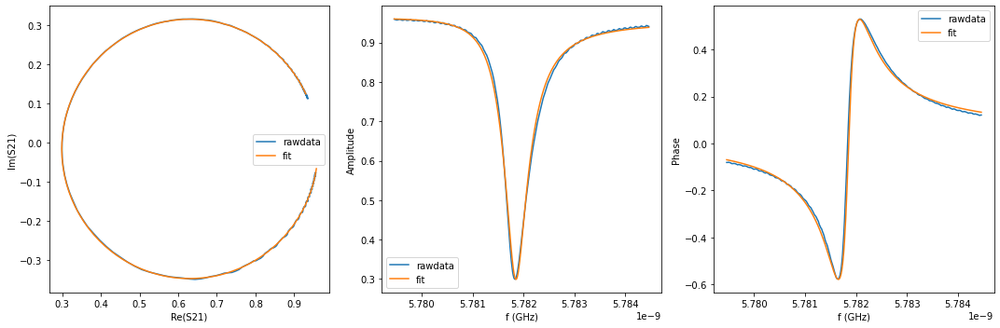

{'Qi_dia_corr': 24925.28114061036, 'Qi_no_corr': 25329.261187294323, 'absQc': 11292.928920171904, 'Qc_dia_corr(Re{Qc})': 11375.126714697084, 'Ql': 7810.607321659554, 'fr': 5.781818241089855, 'theta0': -3.0213028468551872, 'phi0': 0.12028980673460599, 'phi0_err': 0.016746202528303764, 'Ql_err': 195.83197331617222, 'absQc_err': 40.52219067491008, 'fr_err': 6.196688315553873e-06, 'chi_square': 0.00022125338677754156, 'Qi_no_corr_err': 2037.9482597018525, 'Qi_dia_corr_err': 2016.700433285118, 'delay': -0.006344603047267296, 'a': 0.9579038296563792, 'alpha': -0.19224071672255486}


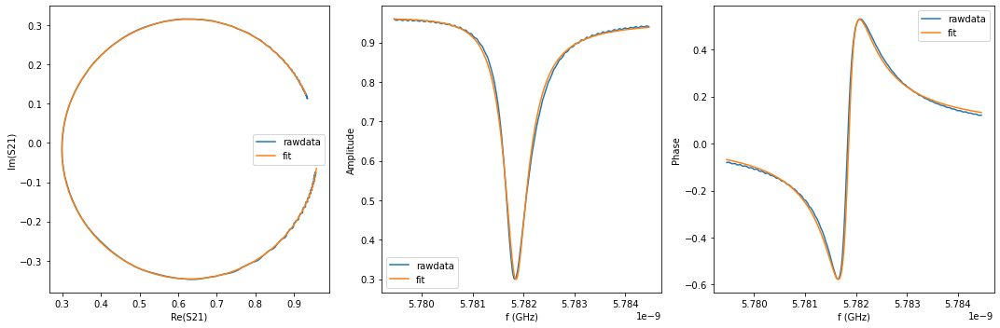

{'Qi_dia_corr': 24879.910898540755, 'Qi_no_corr': 25280.744188286873, 'absQc': 11273.933249577489, 'Qc_dia_corr(Re{Qc})': 11355.517721504117, 'Ql': 7796.907056911008, 'fr': 5.781818216620583, 'theta0': -3.0216494685341964, 'phi0': 0.11994320318062118, 'phi0_err': 0.017395008500723813, 'Ql_err': 282.42983034239205, 'absQc_err': 40.383899303364764, 'fr_err': 6.418344608262907e-06, 'chi_square': 0.00022166675717450845, 'Qi_no_corr_err': 2959.7846863802165, 'Qi_dia_corr_err': 2908.31676873566, 'delay': 0.06214801911401492, 'a': 0.9580065310109179, 'alpha': 2.296227992131649}


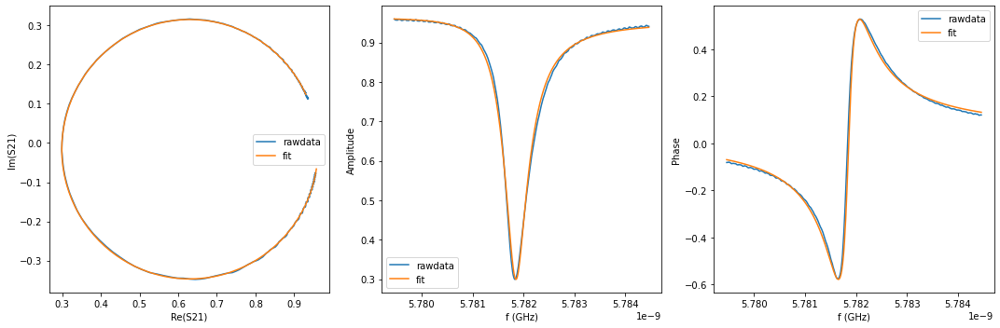

{'Qi_dia_corr': 24899.653392832028, 'Qi_no_corr': 25301.9964646986, 'absQc': 11289.533641171736, 'Qc_dia_corr(Re{Qc})': 11371.520258146771, 'Ql': 7806.38960575188, 'fr': 5.781818275500787, 'theta0': -3.021438592524633, 'phi0': 0.12015407213454452, 'phi0_err': 0.017413212688925647, 'Ql_err': 195.00738460657482, 'absQc_err': 40.596749659276526, 'fr_err': 6.49951731787016e-06, 'chi_square': 0.00022222192424668883, 'Qi_no_corr_err': 2037.0980718034705, 'Qi_dia_corr_err': 2023.8611487179205, 'delay': 0.01419607824067463, 'a': 0.9578067943998433, 'alpha': 0.5536671655653227}


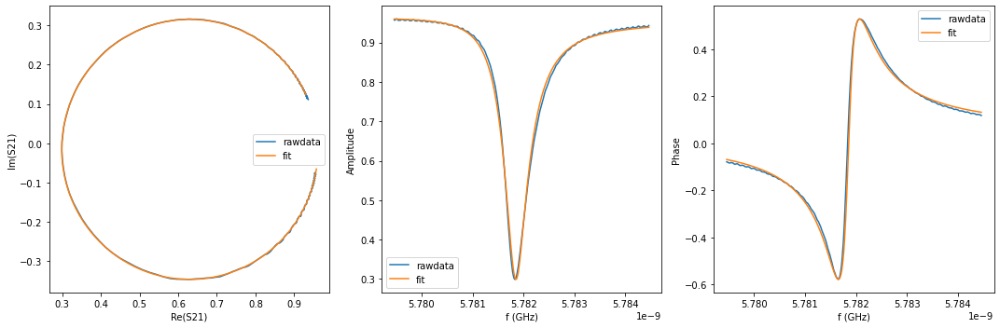

{'Qi_dia_corr': 24894.448259611414, 'Qi_no_corr': 25295.20271830415, 'absQc': 11275.184849701942, 'Qc_dia_corr(Re{Qc})': 11356.676406623441, 'Ql': 7798.880608776458, 'fr': 5.781818280134747, 'theta0': -3.0217239984046853, 'phi0': 0.11986867854206151, 'phi0_err': 0.01804065643633163, 'Ql_err': 176.08815305946516, 'absQc_err': 40.46537847405726, 'fr_err': 6.6810002812732415e-06, 'chi_square': 0.0002230313991994268, 'Qi_no_corr_err': 1827.699671527761, 'Qi_dia_corr_err': 1820.2968902127293, 'delay': 0.049298194268654574, 'a': 0.9579850826555224, 'alpha': 1.8291493995689079}


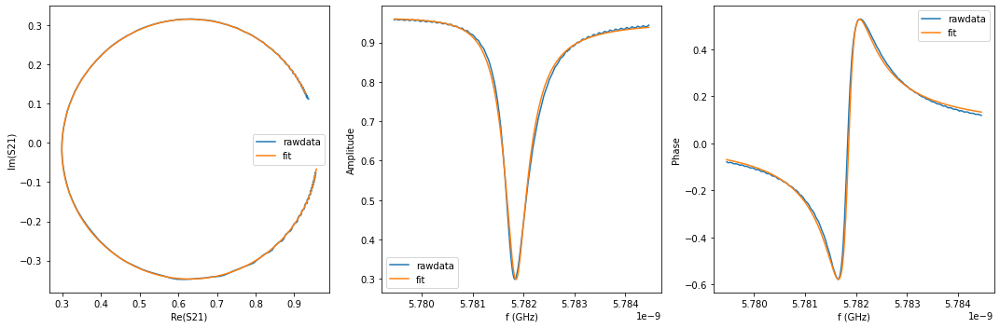

{'Qi_dia_corr': 24956.951081193438, 'Qi_no_corr': 25362.91258303649, 'absQc': 11303.935131326518, 'Qc_dia_corr(Re{Qc})': 11386.484453593568, 'Ql': 7819.071898778038, 'fr': 5.781818144732598, 'theta0': -3.0211058160669224, 'phi0': 0.12048685051552092, 'phi0_err': 0.01611924269916246, 'Ql_err': 184.56739058449472, 'absQc_err': 40.72000228921311, 'fr_err': 5.946188895496618e-06, 'chi_square': 0.00022149718821060723, 'Qi_no_corr_err': 1914.2029209253258, 'Qi_dia_corr_err': 1896.8856153589254, 'delay': -0.020791647798860155, 'a': 0.95762162814548, 'alpha': -0.7173431473818286}


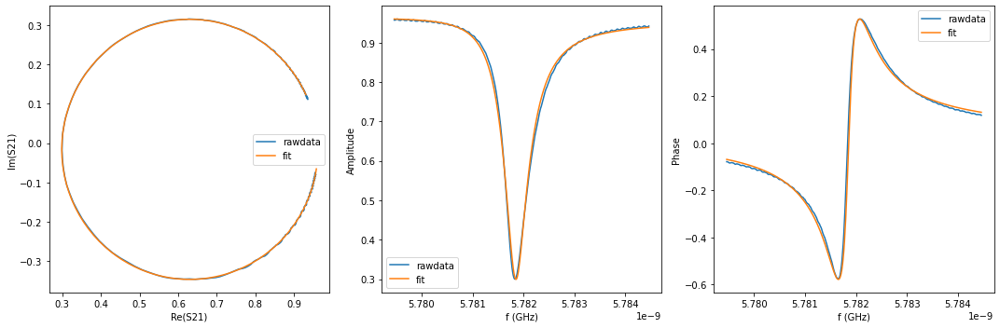

{'Qi_dia_corr': 24868.46972640433, 'Qi_no_corr': 25271.309837840963, 'absQc': 11272.50882992331, 'Qc_dia_corr(Re{Qc})': 11354.552770290962, 'Ql': 7795.328284673165, 'fr': 5.781818205108142, 'theta0': -3.021306669618448, 'phi0': 0.12028600144872581, 'phi0_err': 0.016051576438984635, 'Ql_err': 177.67043724124093, 'absQc_err': 40.608694144860024, 'fr_err': 5.978435978392289e-06, 'chi_square': 0.00022163595708246618, 'Qi_no_corr_err': 1844.5425464101709, 'Qi_dia_corr_err': 1828.9554302254412, 'delay': 0.06614585175126005, 'a': 0.9579852203331402, 'alpha': 2.4408688508841045}


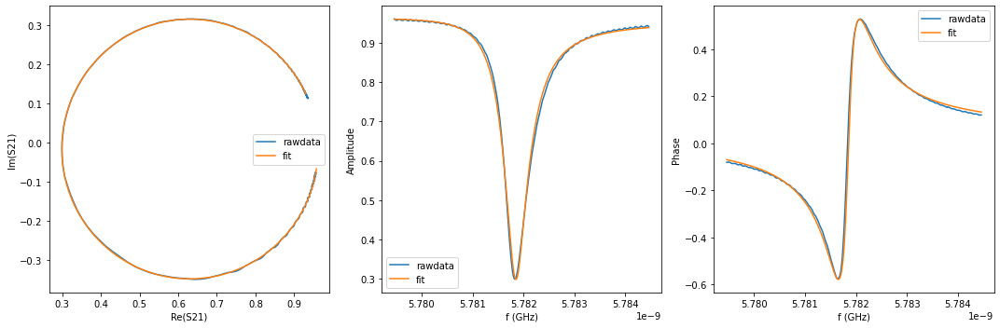

{'Qi_dia_corr': 24946.691478325527, 'Qi_no_corr': 25355.773373869622, 'absQc': 11309.574892617606, 'Qc_dia_corr(Re{Qc})': 11392.904856491237, 'Ql': 7821.090797987164, 'fr': 5.78181766906088, 'theta0': -3.0205709363205635, 'phi0': 0.12102174889444196, 'phi0_err': 0.015494057557857021, 'Ql_err': 142.7660326415803, 'absQc_err': 40.838742819883805, 'fr_err': 5.874812682516649e-06, 'chi_square': 0.00022154629263111173, 'Qi_no_corr_err': 1486.4634223400553, 'Qi_dia_corr_err': 1458.8028153692837, 'delay': -0.04152768153026881, 'a': 0.9577061608891444, 'alpha': -1.4704860580885044}


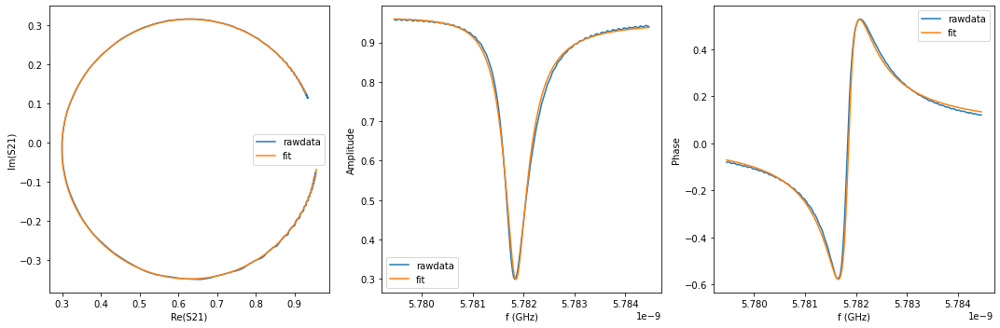

{'Qi_dia_corr': 25012.871971881897, 'Qi_no_corr': 25422.19746609279, 'absQc': 11331.171121060623, 'Qc_dia_corr(Re{Qc})': 11414.428187654454, 'Ql': 7837.737895469515, 'fr': 5.781817832358854, 'theta0': -3.020738179588948, 'phi0': 0.12085449375493455, 'phi0_err': 0.015566951850750384, 'Ql_err': 163.20952532085246, 'absQc_err': 41.29354546775418, 'fr_err': 5.899146507127869e-06, 'chi_square': 0.00022374776584579178, 'Qi_no_corr_err': 1715.5187015134518, 'Qi_dia_corr_err': 1684.2294647977046, 'delay': -0.12440207358636211, 'a': 0.957310823052926, 'alpha': 1.801658857458119}


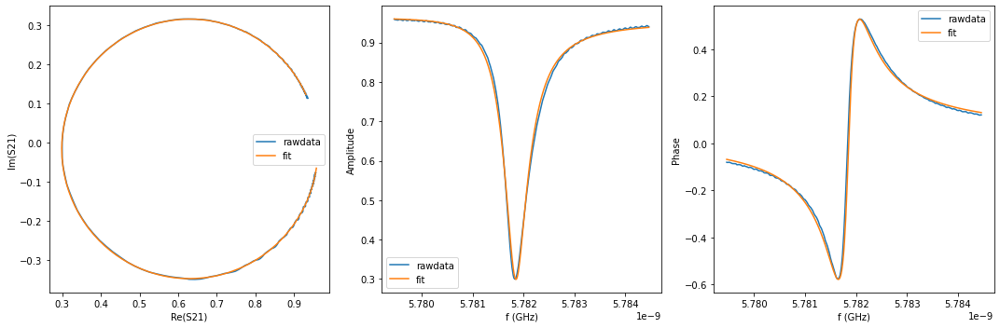

{'Qi_dia_corr': 24867.45107227343, 'Qi_no_corr': 25270.226264515008, 'absQc': 11252.671719769289, 'Qc_dia_corr(Re{Qc})': 11334.419741500682, 'Ql': 7785.733776143323, 'fr': 5.78181810818004, 'theta0': -3.021417340748745, 'phi0': 0.12017533683534638, 'phi0_err': 0.016224205333986653, 'Ql_err': 210.55061908544062, 'absQc_err': 40.184454509073944, 'fr_err': 6.1525289511339875e-06, 'chi_square': 0.000220542532403447, 'Qi_no_corr_err': 2208.163933138469, 'Qi_dia_corr_err': 2147.100160566795, 'delay': 0.11320797722335456, 'a': 0.9580694069371135, 'alpha': -2.1325172269498345}


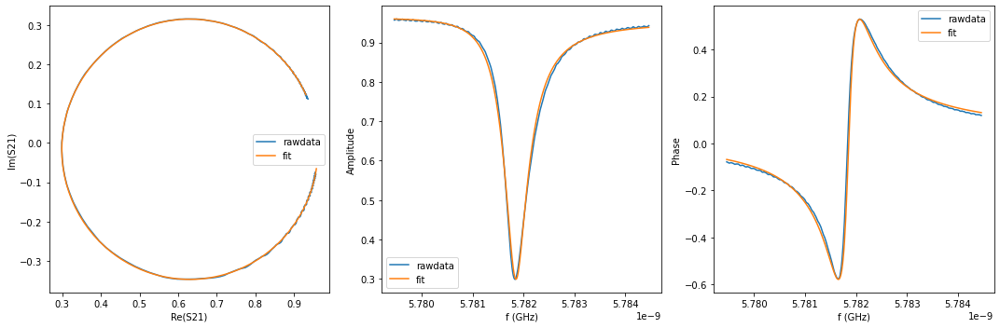

{'Qi_dia_corr': 24877.248549569966, 'Qi_no_corr': 25278.566433528376, 'absQc': 11260.03327536224, 'Qc_dia_corr(Re{Qc})': 11341.530924716253, 'Ql': 7790.049467213878, 'fr': 5.781818301845906, 'theta0': -3.0216393803130392, 'phi0': 0.11995327327675404, 'phi0_err': 0.01768308179820461, 'Ql_err': 207.0943075891158, 'absQc_err': 40.368599175910475, 'fr_err': 6.554930927723087e-06, 'chi_square': 0.0002220580068729981, 'Qi_no_corr_err': 2161.145008561251, 'Qi_dia_corr_err': 2146.5787645199084, 'delay': 0.09798145309725671, 'a': 0.9580371653830267, 'alpha': -2.685709540484056}


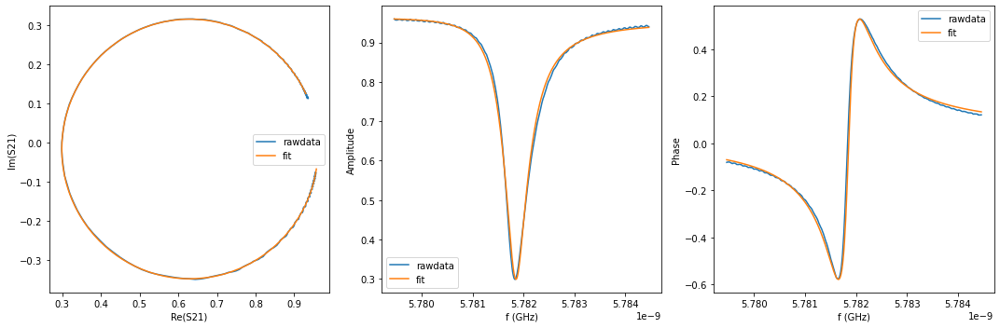

{'Qi_dia_corr': 24995.49262534525, 'Qi_no_corr': 25403.923110608448, 'absQc': 11319.958222513724, 'Qc_dia_corr(Re{Qc})': 11402.985164723512, 'Ql': 7830.636029222513, 'fr': 5.781818146233903, 'theta0': -3.020844887055014, 'phi0': 0.1207477665347788, 'phi0_err': 0.015602913921943077, 'Ql_err': 209.6345417711799, 'absQc_err': 41.112435029594025, 'fr_err': 5.918413847892326e-06, 'chi_square': 0.000224089311068894, 'Qi_no_corr_err': 2207.9558220671315, 'Qi_dia_corr_err': 2151.064079133505, 'delay': -0.07176441349498354, 'a': 0.9575404521078817, 'alpha': -2.569091737987942}


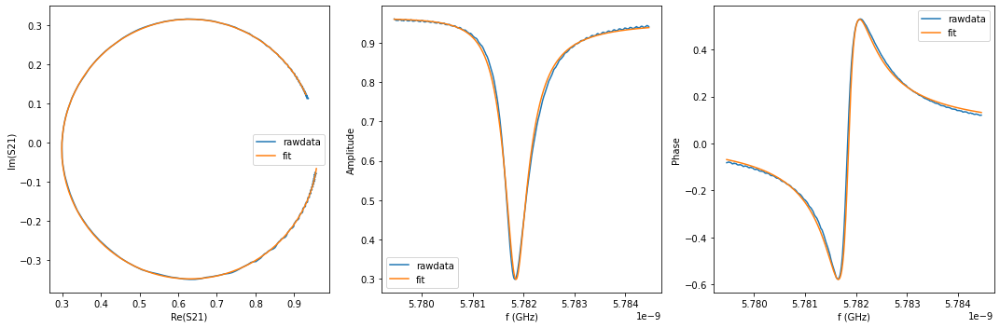

{'Qi_dia_corr': 24917.098977152287, 'Qi_no_corr': 25320.88719766297, 'absQc': 11279.569132369528, 'Qc_dia_corr(Re{Qc})': 11361.587054089623, 'Ql': 7803.419035642291, 'fr': 5.7818183409949855, 'theta0': -3.0213630391614013, 'phi0': 0.12022962268880574, 'phi0_err': 0.01810802739208883, 'Ql_err': 241.2100458427442, 'absQc_err': 40.37216251268956, 'fr_err': 6.7686329158679165e-06, 'chi_square': 0.00022165139844419884, 'Qi_no_corr_err': 2536.422950548237, 'Qi_dia_corr_err': 2487.188938911645, 'delay': 0.05158549744907148, 'a': 0.957975583930616, 'alpha': 1.9120640156444046}


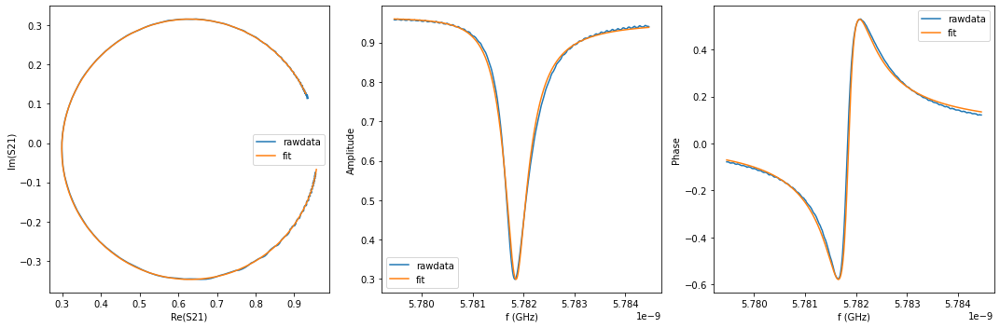

{'Qi_dia_corr': 24998.070557059287, 'Qi_no_corr': 25405.814555169018, 'absQc': 11330.987979032476, 'Qc_dia_corr(Re{Qc})': 11414.021687717264, 'Ql': 7836.092404997478, 'fr': 5.781818140095399, 'theta0': -3.0208984254871742, 'phi0': 0.12069422810261891, 'phi0_err': 0.016767465998124443, 'Ql_err': 202.23012360527838, 'absQc_err': 41.08183075129383, 'fr_err': 6.235994018470713e-06, 'chi_square': 0.00022419544390918865, 'Qi_no_corr_err': 2118.667099060759, 'Qi_dia_corr_err': 2097.3762971565784, 'delay': -0.09985618805307916, 'a': 0.9575653564212534, 'alpha': 2.693775941666497}


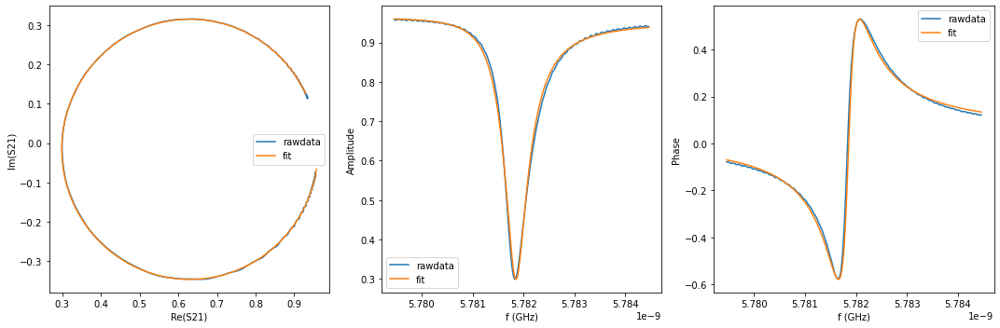

{'Qi_dia_corr': 24969.256683230684, 'Qi_no_corr': 25374.63800073323, 'absQc': 11308.098379955241, 'Qc_dia_corr(Re{Qc})': 11390.510488742571, 'Ql': 7822.178255466797, 'fr': 5.781818253438381, 'theta0': -3.0212274057899817, 'phi0': 0.1203652477998116, 'phi0_err': 0.016955207143448055, 'Ql_err': 198.01127922568264, 'absQc_err': 40.86572455381034, 'fr_err': 6.261945068954146e-06, 'chi_square': 0.00022311401976561726, 'Qi_no_corr_err': 2070.7809992985385, 'Qi_dia_corr_err': 2055.8366965558184, 'delay': -0.0545628586352684, 'a': 0.957645563228603, 'alpha': -1.9440079731691102}


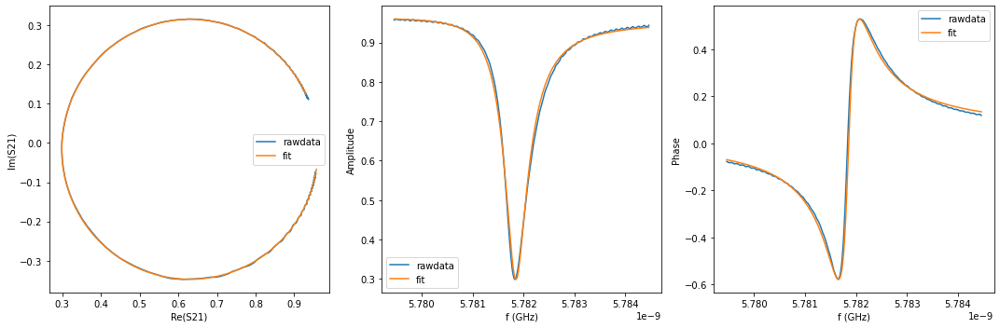

{'Qi_dia_corr': 24996.167833383992, 'Qi_no_corr': 25406.885921471854, 'absQc': 11325.113503396127, 'Qc_dia_corr(Re{Qc})': 11408.673162972464, 'Ql': 7833.384278932156, 'fr': 5.781817860644671, 'theta0': -3.02048791654936, 'phi0': 0.1211047531093912, 'phi0_err': 0.016422173896386765, 'Ql_err': 157.69994618398513, 'absQc_err': 40.58082771035053, 'fr_err': 6.184567085334095e-06, 'chi_square': 0.00022053886542496544, 'Qi_no_corr_err': 1645.6717443483885, 'Qi_dia_corr_err': 1616.3552330027453, 'delay': -0.06961114356084928, 'a': 0.9574819146668965, 'alpha': -2.4907859554539242}


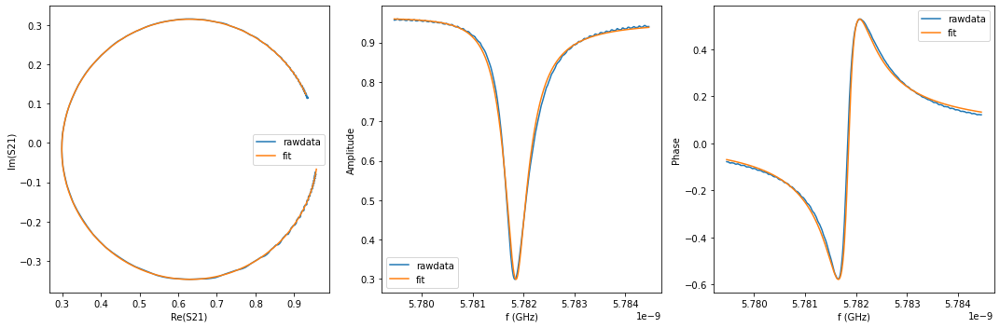

{'Qi_dia_corr': 24936.848579845213, 'Qi_no_corr': 25342.38373548214, 'absQc': 11300.255500365645, 'Qc_dia_corr(Re{Qc})': 11382.797837935695, 'Ql': 7815.359842287114, 'fr': 5.781818106555663, 'theta0': -3.0210913740625287, 'phi0': 0.12050127952726435, 'phi0_err': 0.017650398342412197, 'Ql_err': 174.30048849084656, 'absQc_err': 40.65317437080572, 'fr_err': 6.5935522061502665e-06, 'chi_square': 0.0002225168291868629, 'Qi_no_corr_err': 1819.9219572960028, 'Qi_dia_corr_err': 1814.170212501584, 'delay': -0.004879696843426505, 'a': 0.9578472954431325, 'alpha': -0.1396262856847154}


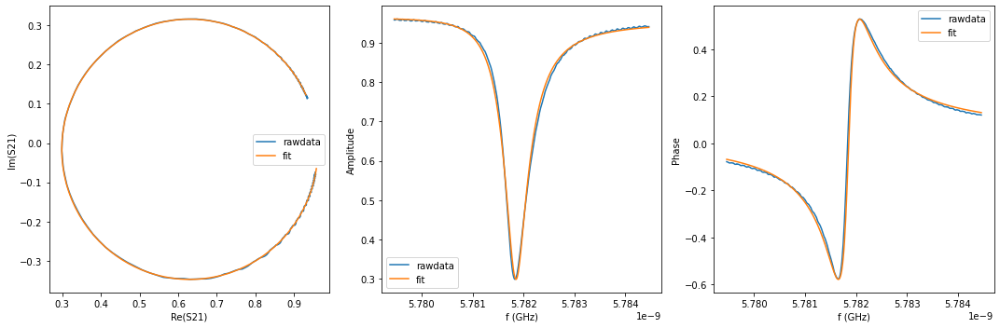

{'Qi_dia_corr': 24865.805721712117, 'Qi_no_corr': 25267.158366892734, 'absQc': 11261.65595444161, 'Qc_dia_corr(Re{Qc})': 11343.259175498588, 'Ql': 7789.742146329335, 'fr': 5.781818182532926, 'theta0': -3.021570773889868, 'phi0': 0.12002187969992541, 'phi0_err': 0.01762790330807305, 'Ql_err': 186.98141829696485, 'absQc_err': 40.29176583114609, 'fr_err': 6.525109714309613e-06, 'chi_square': 0.0002215233207431275, 'Qi_no_corr_err': 1942.8870950831545, 'Qi_dia_corr_err': 1929.058949419942, 'delay': 0.11675033377730812, 'a': 0.9581707243774753, 'alpha': -2.003866056512218}


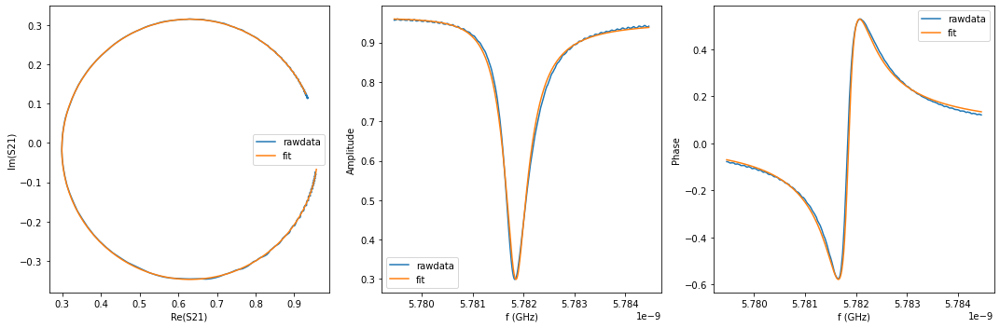

{'Qi_dia_corr': 24985.95732800386, 'Qi_no_corr': 25397.082213232403, 'absQc': 11324.754757687782, 'Qc_dia_corr(Re{Qc})': 11408.45944052659, 'Ql': 7832.280499841353, 'fr': 5.7818178494726755, 'theta0': -3.020381587938532, 'phi0': 0.12121106565126112, 'phi0_err': 0.01757589244223251, 'Ql_err': 183.06129206840376, 'absQc_err': 40.645871851496295, 'fr_err': 6.544480151752595e-06, 'chi_square': 0.00022061481064747804, 'Qi_no_corr_err': 1915.9598863970475, 'Qi_dia_corr_err': 1907.5783104221691, 'delay': -0.08321988259988784, 'a': 0.9576640155008794, 'alpha': -2.9850834907533748}


In [28]:
%matplotlib inline

for i in range(len(P_h)):
    f, mag_corr, pha_corr = correct_data_with_ref(freq_h, mag_s_h[:,i], pha_s_h[:,i], f_ref_h, mag_ref_h, pha_ref_h)
    
    ss = db2mag(mag_corr)*np.exp(1j*pha_corr)
    port1 = notch_port(f/1e9, ss)
    port1.autofit(calc_errors = True)
    port1.plotall()
    print(port1.fitresults)
    power_low = np.append(power_low, P_h[i]+20)
    fr = np.append(fr, port1.fitresults['fr'])
    Ql = np.append(Ql, port1.fitresults['Ql'])
    Qc = np.append(Qc, port1.fitresults['absQc'])
    Qi = np.append(Qi, port1.fitresults['Qi_dia_corr'])
    fr_err = np.append(fr_err, port1.fitresults['fr_err'])
    Ql_err = np.append(Ql_err, port1.fitresults['Ql_err'])
    Qc_err = np.append(Qc_err, port1.fitresults['absQc_err'])
    Qi_err = np.append(Qi_err, port1.fitresults['Qi_dia_corr_err'])
    


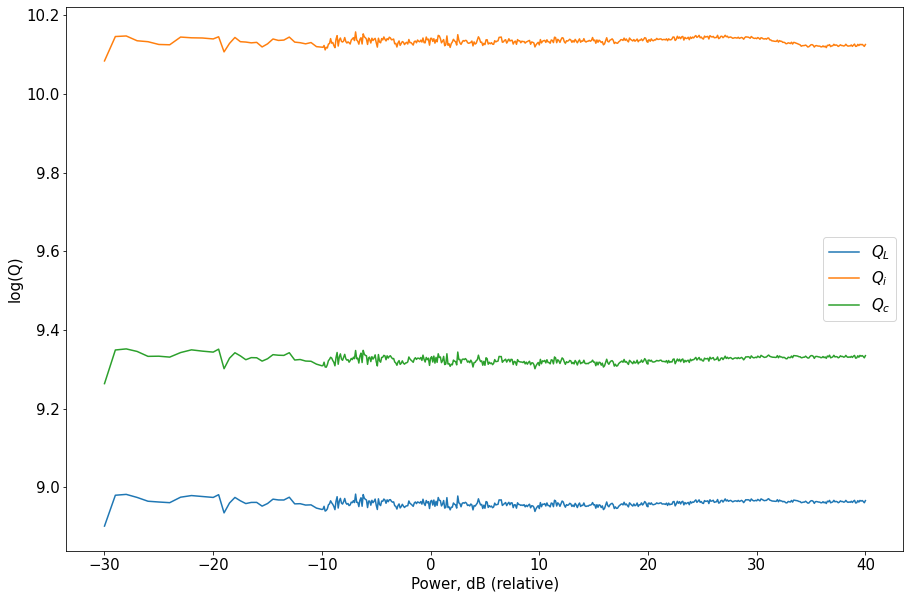

In [29]:
font = {'size'   : 15}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(15,10)) 
# ax.plot(powers, fr, "--", label = r'$f_{r}$')
# powers = np.append(P_l, P_h +20)
ax.set_xlabel('Power, dB (relative)')
ax.set_ylabel('log(Q)')

# ax.set_ylim(8.0, 10.2)

ax.plot(power_low, np.log(Ql), label = r'$Q_{L}$')
ax.plot(power_low, np.log(Qi), label = r'$Q_{i}$')
ax.plot(power_low, np.log(Qc), label = r'$Q_{c}$')
ax.legend()

In [30]:
initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm'

files = os.listdir(initial_folder)
for i in range(len(files)):
    if ".fig" in files[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files[i]) 

[0] -----------> S21_PowerSweep_Daf
[1] -----------> S21_PowerSweep_HigherPower2
[2] -----------> S21_PowerSweep_LowPower
[3] -----------> S21_PowerSweep_LowPower2
[4] -----------> S21_SpectrumSweep_Full_500mK
[5] -----------> S21_SpectrumSweep_Full_50mK
[6] -----------> S21_SpectrumSweep_Full_800mK
[7] -----------> tsweeo
[8] -----------> ZGraphs_data


In [31]:
folder = files[0]
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 
        
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[0])
read_mat(mat)

[0] -----------> Data.mat
Keys total: 26
['__header__', '__version__', '__globals__', 'Attenuation', 'Average', 'Comment', 'IF', 'MeasName', 'NMeasurementPoints', 'None', 'P', 'S', 'SampleName', 'SaveDirData', 'SaveDirFig', 'SweepEstimate', 'T', 'Testm', 'User', 'Year', 'c', 'f', 'fcenter', 'fstart', 'fstop', 'i', 'j', 'mag', 'pha', '__function_workspace__'] 

--------- CoSi2_25nm_10 -----------
Attenuation === [0]
Average === [1]
IF === [  1  10 100]
NMeasurementPoints === [801]
T === [0.01]
fcenter === [5.208283e+09 5.447359e+09 5.631761e+09 5.781961e+09 5.881769e+09]
fstart === [5.874269e+09]
fstop === [5.886769e+09]
i === [5]
j === [401]
P (1, 401) -len--> 401
f (1, 801) -len--> 801
S ---> (801, 5, 401)
c ---> (6, 5, 401)
mag ---> (801, 5, 401)
pha ---> (801, 5, 401)


In [32]:
mag_daf = mat['mag']
print('mag', shape(mag_ref_l))

pha_daf = mat['pha']
print('pha', shape(pha_ref_l))

f_daf = mat['f'][0]
print('f', shape(f_ref_l))

P_daf = mat['P'][0]
print('P', shape(P_daf)) 

mag (100001, 1)
pha (100001, 1)
f (100001,)
P (401,)


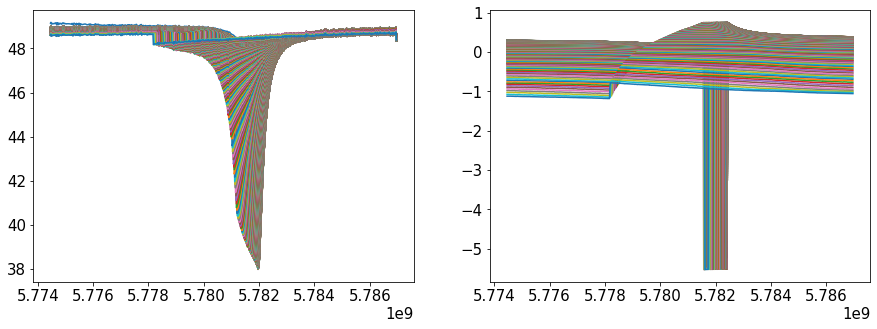

In [33]:
freq_daf = np.linspace(fcenter_l[select_res]-7.5e6, fcenter_l[select_res]+5e6, 801)
mag_s_daf = mag_daf[:,select_res,:]
pha_s_daf = pha_daf[:,select_res,:]

fig, ax = plt.subplots(1,2, figsize=(15, 5))

for i in range(len(P_daf)):
    f_l, mag_corr_l, pha_corr_l = correct_data_with_ref(freq_daf, mag_s_daf[:,i], pha_s_daf[:,i], f_ref_l, mag_ref_l, pha_ref_l)
    ax[0].plot(f_l, mag_corr_l)
    ax[1].plot(f_l, pha_corr_l)

C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


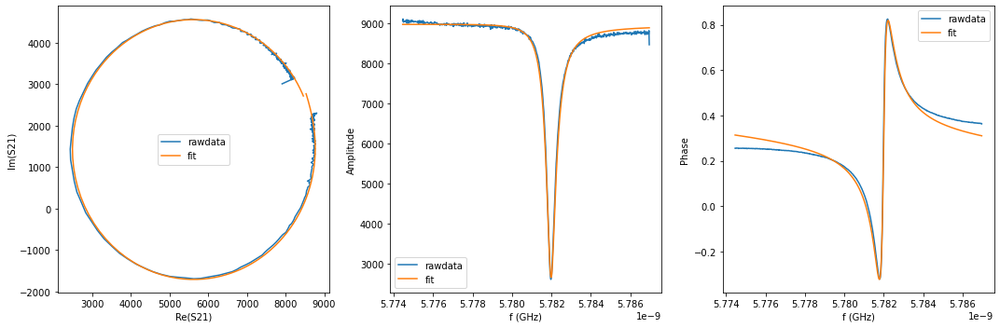

{'Qi_dia_corr': 23996.68262667655, 'Qi_no_corr': 24189.794349793683, 'absQc': 10173.257630061344, 'Qc_dia_corr(Re{Qc})': 10207.805213319998, 'Ql': 7161.442181646741, 'fr': 5.781960806545804, 'theta0': -3.059314006491258, 'phi0': 0.08229628094169011, 'phi0_err': 0.026414147171576693, 'Ql_err': 242.3677276153924, 'absQc_err': 84.3817365849209, 'fr_err': 1.0674446483365294e-05, 'chi_square': 0.0009986417398185196, 'Qi_no_corr_err': 2597.6796002640185, 'Qi_dia_corr_err': 2554.503348878372, 'delay': 1.2396737525131145, 'a': 8952.451638286413, 'alpha': 1.3470387703788893}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


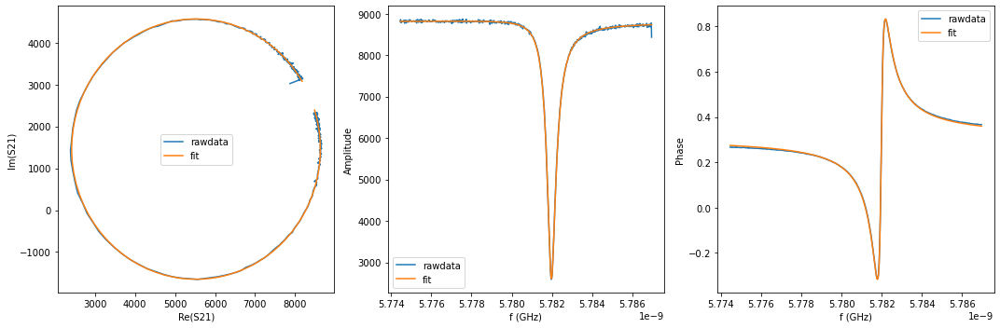

{'Qi_dia_corr': 26641.839612835138, 'Qi_no_corr': 26921.61210637912, 'absQc': 11189.505403657833, 'Qc_dia_corr(Re{Qc})': 11238.5579119436, 'Ql': 7904.242746494505, 'fr': 5.781952386440976, 'theta0': -3.048133843334055, 'phi0': 0.0934648692491213, 'phi0_err': 0.00212738979732617, 'Ql_err': 23.100974633761275, 'absQc_err': 15.493035627901836, 'fr_err': 8.362067030281422e-07, 'chi_square': 2.1926475882647477e-05, 'Qi_no_corr_err': 226.93904067022967, 'Qi_dia_corr_err': 219.8554141463783, 'delay': -0.0007439091867448281, 'a': 8798.824040297774, 'alpha': 0.2819170760503714}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


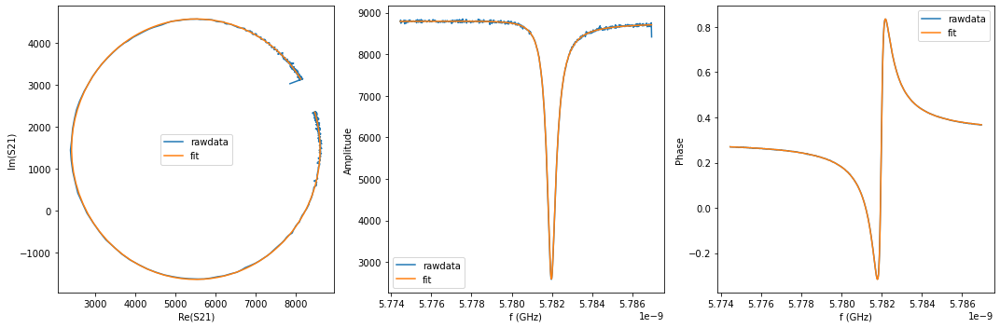

{'Qi_dia_corr': 26976.50464746294, 'Qi_no_corr': 27277.258897797143, 'absQc': 11321.053163780341, 'Qc_dia_corr(Re{Qc})': 11373.68072355006, 'Ql': 8000.538926456389, 'fr': 5.781950410421611, 'theta0': -3.045363306087226, 'phi0': 0.09623625225791206, 'phi0_err': 0.0009402925671255454, 'Ql_err': 11.186741703123438, 'absQc_err': 11.36986029182316, 'fr_err': 4.710559222091344e-07, 'chi_square': 7.248654745820861e-06, 'Qi_no_corr_err': 107.5556622120283, 'Qi_dia_corr_err': 105.08868120578603, 'delay': -0.16913432626727576, 'a': 8770.445477154759, 'alpha': 0.4505923770014813}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


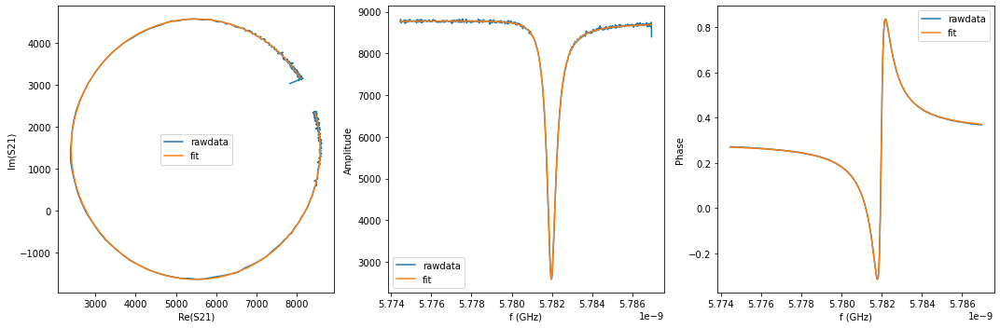

{'Qi_dia_corr': 27062.44487518818, 'Qi_no_corr': 27373.806748714593, 'absQc': 11347.073679499492, 'Qc_dia_corr(Re{Qc})': 11401.449666743489, 'Ql': 8021.837278258687, 'fr': 5.781949702720471, 'theta0': -3.0438960004647413, 'phi0': 0.09770376353726654, 'phi0_err': 0.0010223861810350395, 'Ql_err': 12.51188220909348, 'absQc_err': 11.557991534705797, 'fr_err': 4.87641530208608e-07, 'chi_square': 8.275787088613867e-06, 'Qi_no_corr_err': 125.37983968944116, 'Qi_dia_corr_err': 123.72585439368179, 'delay': -0.21804330822479195, 'a': 8752.83651152575, 'alpha': -1.3243786748306827}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


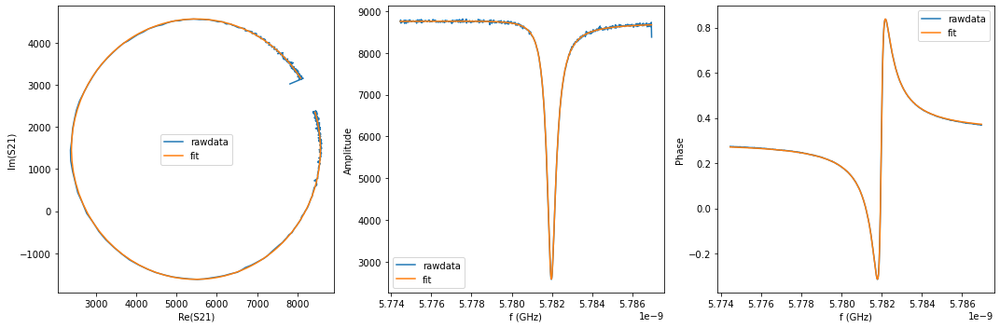

{'Qi_dia_corr': 27037.14042233367, 'Qi_no_corr': 27345.42078566351, 'absQc': 11340.330035668423, 'Qc_dia_corr(Re{Qc})': 11394.207894501602, 'Ql': 8016.028901852258, 'fr': 5.781949255459631, 'theta0': -3.044313816992487, 'phi0': 0.09728578151958266, 'phi0_err': 0.0010455832579969195, 'Ql_err': 12.040746115026584, 'absQc_err': 11.9554745192679, 'fr_err': 5.228605619699596e-07, 'chi_square': 8.542690827509222e-06, 'Qi_no_corr_err': 121.94970944981432, 'Qi_dia_corr_err': 120.5977145396599, 'delay': -0.21146715329958066, 'a': 8737.498245155532, 'alpha': -1.0838640913063753}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


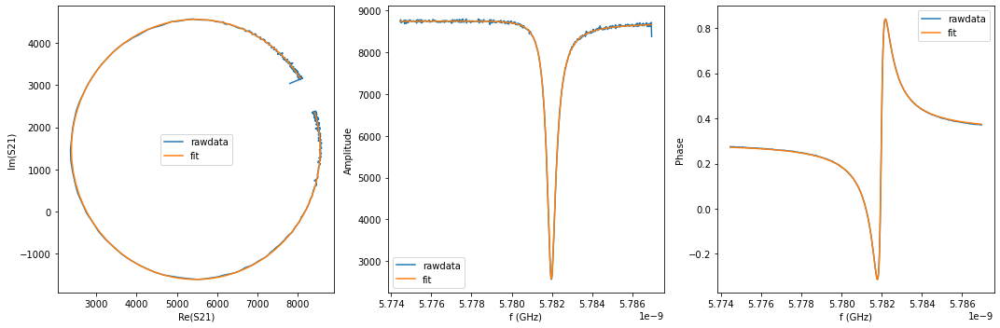

{'Qi_dia_corr': 27113.759664259298, 'Qi_no_corr': 27426.766313160275, 'absQc': 11362.710960995777, 'Qc_dia_corr(Re{Qc})': 11417.316312521854, 'Ql': 8034.199997298015, 'fr': 5.78194868910653, 'theta0': -3.0437585272561374, 'phi0': 0.09784166345222317, 'phi0_err': 0.001122566675472909, 'Ql_err': 12.552017740300334, 'absQc_err': 11.751310323122299, 'fr_err': 5.39430868089773e-07, 'chi_square': 9.290275865000472e-06, 'Qi_no_corr_err': 128.04069708457536, 'Qi_dia_corr_err': 126.19204412832737, 'delay': -0.23303900885528814, 'a': 8722.166942252135, 'alpha': -1.8661637347836018}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


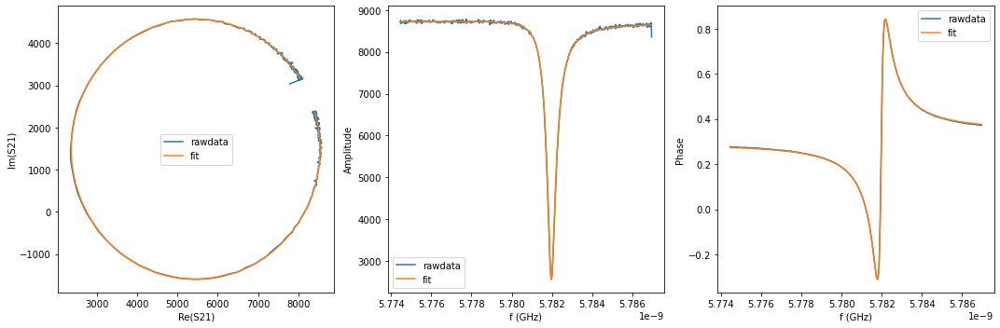

{'Qi_dia_corr': 27159.141193003823, 'Qi_no_corr': 27462.428631250325, 'absQc': 11356.38651258206, 'Qc_dia_corr(Re{Qc})': 11409.07186989446, 'Ql': 8034.092564523566, 'fr': 5.781949182943894, 'theta0': -3.0454600655186472, 'phi0': 0.09613954710495518, 'phi0_err': 0.0012426961341896166, 'Ql_err': 14.164262707548186, 'absQc_err': 12.469941601892916, 'fr_err': 5.863528006603015e-07, 'chi_square': 1.0764971064540052e-05, 'Qi_no_corr_err': 149.08093733836188, 'Qi_dia_corr_err': 147.39740413710828, 'delay': -0.23780176474259285, 'a': 8707.056067076024, 'alpha': -2.03779500422039}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


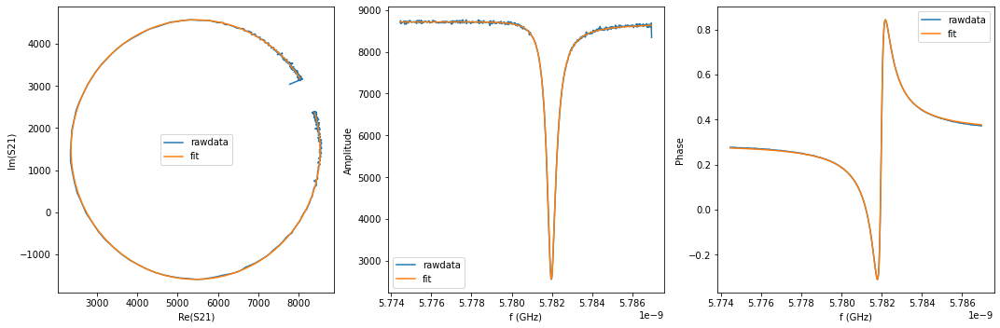

{'Qi_dia_corr': 27151.76710701699, 'Qi_no_corr': 27455.41550542334, 'absQc': 11352.08108190731, 'Qc_dia_corr(Re{Qc})': 11404.817264552874, 'Ql': 8031.337508556859, 'fr': 5.781948831760793, 'theta0': -3.0453956524771653, 'phi0': 0.09620389781375374, 'phi0_err': 0.0013301932499157401, 'Ql_err': 14.867770471389983, 'absQc_err': 12.69529596945126, 'fr_err': 6.226194706719304e-07, 'chi_square': 1.1569989245232497e-05, 'Qi_no_corr_err': 159.5264353590187, 'Qi_dia_corr_err': 157.80396891106116, 'delay': -0.2464350153376268, 'a': 8694.962691320685, 'alpha': -2.350430121935865}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


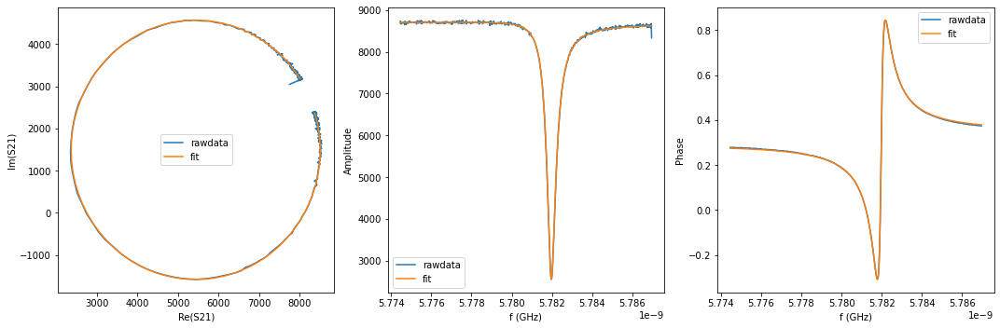

{'Qi_dia_corr': 27165.250443823083, 'Qi_no_corr': 27470.364078682363, 'absQc': 11364.95006506525, 'Qc_dia_corr(Re{Qc})': 11418.006897689753, 'Ql': 8039.057309226131, 'fr': 5.781948536266856, 'theta0': -3.045159325997757, 'phi0': 0.09644036000988171, 'phi0_err': 0.0014947001962820157, 'Ql_err': 15.45123860653139, 'absQc_err': 12.78082932836561, 'fr_err': 6.822701539249282e-07, 'chi_square': 1.3029397595310754e-05, 'Qi_no_corr_err': 163.98915566702436, 'Qi_dia_corr_err': 161.74537878216995, 'delay': -0.25448895257048454, 'a': 8684.238277602582, 'alpha': -2.641518282877025}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


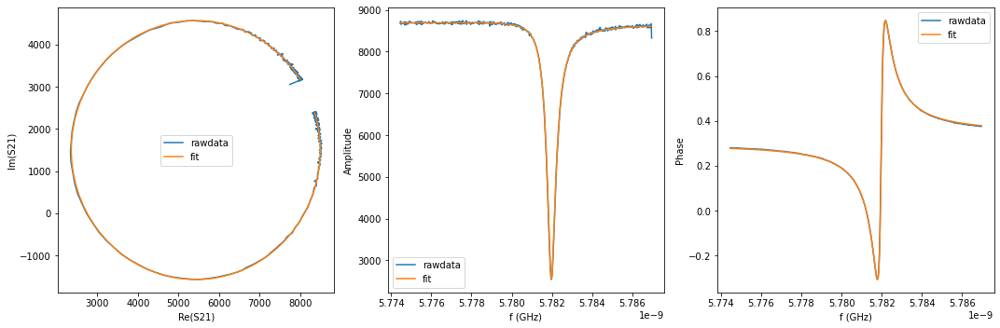

{'Qi_dia_corr': 27120.03599594168, 'Qi_no_corr': 27414.535776116776, 'absQc': 11338.492304933321, 'Qc_dia_corr(Re{Qc})': 11389.64627716978, 'Ql': 8021.037795826262, 'fr': 5.781949181674888, 'theta0': -3.0467874260254852, 'phi0': 0.09481176681413364, 'phi0_err': 0.0012210416183915244, 'Ql_err': 14.363798097507956, 'absQc_err': 12.525562374365302, 'fr_err': 5.777057245804067e-07, 'chi_square': 1.066280911760564e-05, 'Qi_no_corr_err': 152.01829857318606, 'Qi_dia_corr_err': 150.2796765218744, 'delay': -0.22406626343814012, 'a': 8673.048653219668, 'alpha': -1.5355593449133538}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


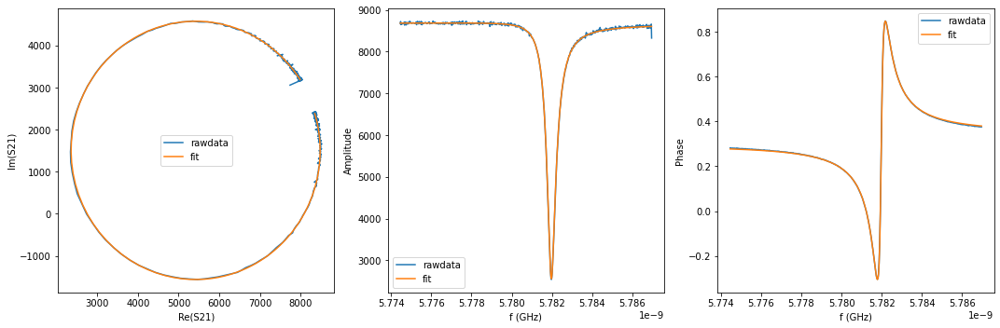

{'Qi_dia_corr': 27113.292531190047, 'Qi_no_corr': 27401.61663240922, 'absQc': 11348.80960513886, 'Qc_dia_corr(Re{Qc})': 11399.013809763397, 'Ql': 8025.091856483676, 'fr': 5.781949195554076, 'theta0': -3.047711022403486, 'phi0': 0.09388818157633927, 'phi0_err': 0.0013042360959333902, 'Ql_err': 14.554131106885862, 'absQc_err': 13.034430050551709, 'fr_err': 6.173801573238838e-07, 'chi_square': 1.1790650131576579e-05, 'Qi_no_corr_err': 150.18898880159247, 'Qi_dia_corr_err': 148.80357284460786, 'delay': -0.23319300095722884, 'a': 8664.798180238491, 'alpha': -1.8662173591817655}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


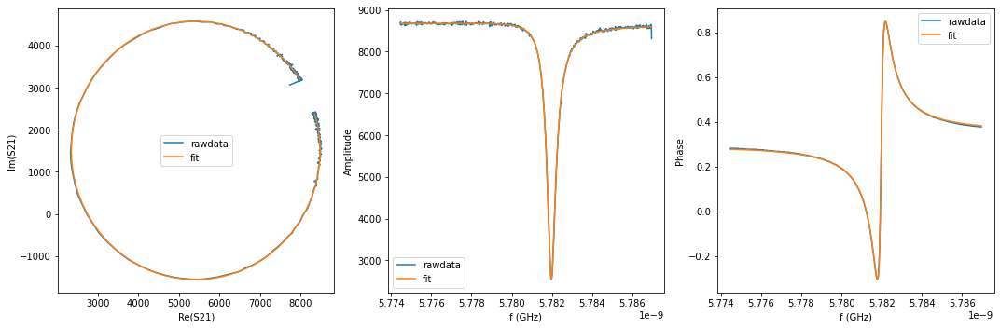

{'Qi_dia_corr': 27209.458885163604, 'Qi_no_corr': 27504.950654324603, 'absQc': 11360.569860278323, 'Qc_dia_corr(Re{Qc})': 11411.757755673647, 'Ql': 8039.823197390543, 'fr': 5.781948939291948, 'theta0': -3.046848142503554, 'phi0': 0.09475122499357957, 'phi0_err': 0.001567560535326342, 'Ql_err': 15.908500256624516, 'absQc_err': 13.047207395714953, 'fr_err': 7.257022300711115e-07, 'chi_square': 1.359043731134251e-05, 'Qi_no_corr_err': 173.92197302510075, 'Qi_dia_corr_err': 171.8067952944232, 'delay': -0.261382746846389, 'a': 8654.719525682896, 'alpha': -2.8892352394299925}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


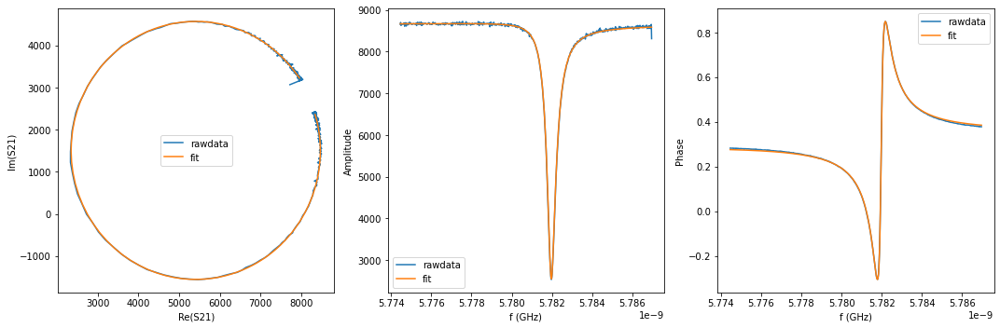

{'Qi_dia_corr': 27302.0459991623, 'Qi_no_corr': 27616.204587339045, 'absQc': 11409.366327667043, 'Qc_dia_corr(Re{Qc})': 11463.86454815449, 'Ql': 8073.76772022045, 'fr': 5.78194747546364, 'theta0': -3.044053089076432, 'phi0': 0.09754675701663812, 'phi0_err': 0.0024144123724360498, 'Ql_err': 22.961286972759563, 'absQc_err': 15.671054138719022, 'fr_err': 1.0183403828505464e-06, 'chi_square': 2.3398322237517213e-05, 'Qi_no_corr_err': 250.19612871435675, 'Qi_dia_corr_err': 245.10656576698779, 'delay': -0.3269224377387731, 'a': 8646.282251188453, 'alpha': 1.0145307476219418}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


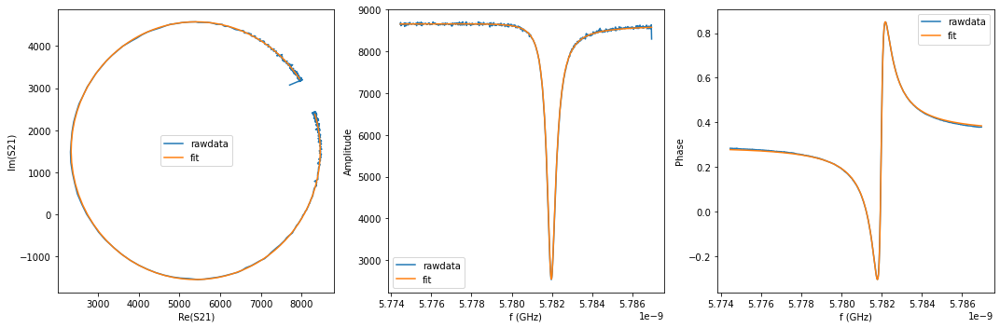

{'Qi_dia_corr': 27234.30482826064, 'Qi_no_corr': 27534.642976937957, 'absQc': 11379.506365273182, 'Qc_dia_corr(Re{Qc})': 11431.607295286472, 'Ql': 8051.843617758657, 'fr': 5.781947940048171, 'theta0': -3.0460892932287758, 'phi0': 0.09551007167342733, 'phi0_err': 0.0019645907873218666, 'Ql_err': 20.482323832326582, 'absQc_err': 14.460431387572847, 'fr_err': 8.607558182566041e-07, 'chi_square': 1.8328696950006236e-05, 'Qi_no_corr_err': 228.68057252332423, 'Qi_dia_corr_err': 224.44427384629478, 'delay': -0.28795756368134007, 'a': 8641.279306364702, 'alpha': 2.4306658702281467}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


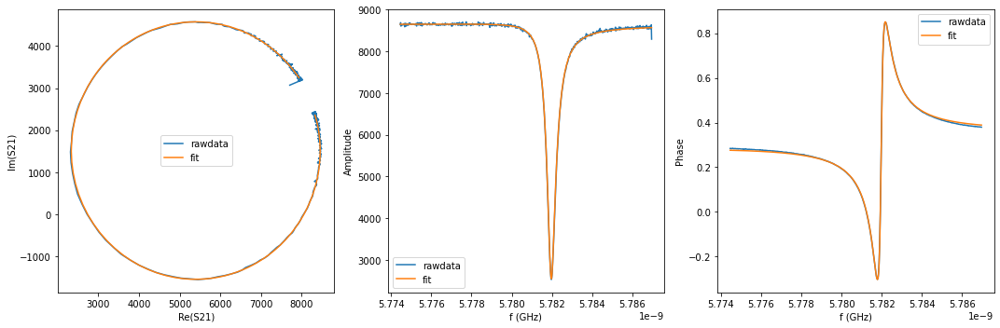

{'Qi_dia_corr': 27341.318332682247, 'Qi_no_corr': 27655.093208077993, 'absQc': 11424.577166104933, 'Qc_dia_corr(Re{Qc})': 11478.998316183326, 'Ql': 8084.708580352689, 'fr': 5.781947272178319, 'theta0': -3.0441864276022383, 'phi0': 0.09741337468644529, 'phi0_err': 0.0029613245342082367, 'Ql_err': 28.24974849078214, 'absQc_err': 17.602416385669265, 'fr_err': 1.2169866571817349e-06, 'chi_square': 3.0505962454889705e-05, 'Qi_no_corr_err': 311.2918698754685, 'Qi_dia_corr_err': 304.25745188201904, 'delay': -0.37099707235032814, 'a': 8633.17125631147, 'alpha': -0.5845575648040715}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


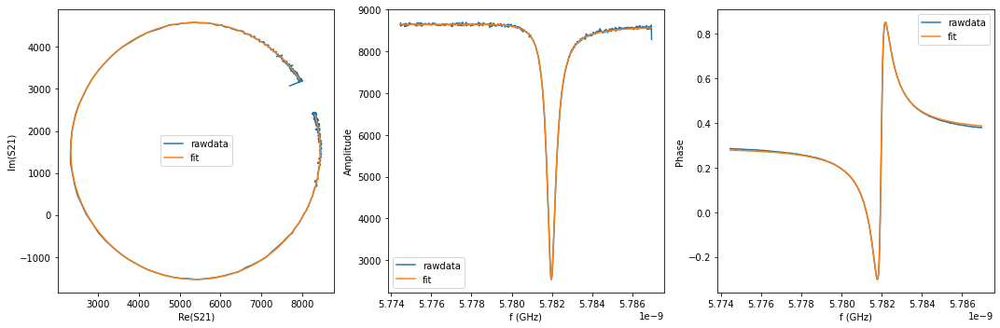

{'Qi_dia_corr': 27302.304812803322, 'Qi_no_corr': 27603.571219853264, 'absQc': 11411.742863848314, 'Qc_dia_corr(Re{Qc})': 11464.039744430913, 'Ql': 8073.877252637078, 'fr': 5.781947706779358, 'theta0': -3.0460453308795468, 'phi0': 0.09555409083554428, 'phi0_err': 0.0024466505507743166, 'Ql_err': 25.502129142122193, 'absQc_err': 16.10692693485787, 'fr_err': 1.0363740988634698e-06, 'chi_square': 2.416893636985027e-05, 'Qi_no_corr_err': 286.7105328735827, 'Qi_dia_corr_err': 282.1991856573767, 'delay': -0.32227936926094825, 'a': 8629.163238809133, 'alpha': 1.1855164975408092}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


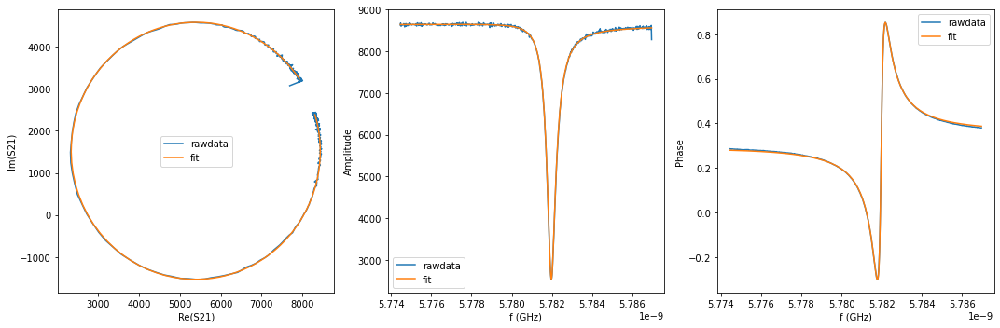

{'Qi_dia_corr': 27251.061881892096, 'Qi_no_corr': 27549.48794416285, 'absQc': 11385.094596282122, 'Qc_dia_corr(Re{Qc})': 11436.853250945562, 'Ql': 8055.910860161576, 'fr': 5.781947788799269, 'theta0': -3.046425745289954, 'phi0': 0.09517374008753232, 'phi0_err': 0.002107970087066057, 'Ql_err': 21.0236681329873, 'absQc_err': 15.211628554289373, 'fr_err': 9.223564335200452e-07, 'chi_square': 2.056231593153259e-05, 'Qi_no_corr_err': 232.22071334408034, 'Qi_dia_corr_err': 228.2034850576547, 'delay': -0.3048947890521658, 'a': 8625.105550349566, 'alpha': 1.8172229626391594}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


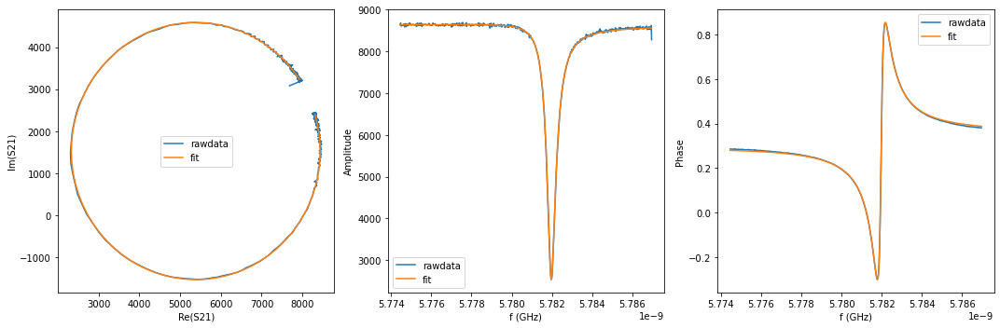

{'Qi_dia_corr': 27257.43040045477, 'Qi_no_corr': 27550.51125386979, 'absQc': 11393.22193718728, 'Qc_dia_corr(Re{Qc})': 11444.108297599421, 'Ql': 8060.06675473, 'fr': 5.781947771136415, 'theta0': -3.047261702361147, 'phi0': 0.09433780543558737, 'phi0_err': 0.0022588888649988812, 'Ql_err': 21.8676665005309, 'absQc_err': 15.50661518835625, 'fr_err': 9.74805835871007e-07, 'chi_square': 2.2027007157881222e-05, 'Qi_no_corr_err': 240.40155566632896, 'Qi_dia_corr_err': 236.67492025725633, 'delay': -0.3114130024663244, 'a': 8621.473391249288, 'alpha': 1.5812124704521295}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


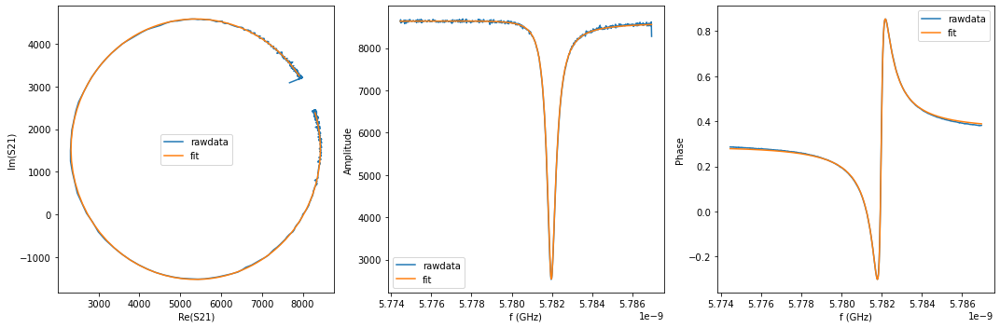

{'Qi_dia_corr': 27300.77876254045, 'Qi_no_corr': 27600.77897371438, 'absQc': 11402.411242023909, 'Qc_dia_corr(Re{Qc})': 11454.41019722392, 'Ql': 8068.966428584764, 'fr': 5.781947388103088, 'theta0': -3.0462779884208864, 'phi0': 0.0953213913593367, 'phi0_err': 0.0024355865767593087, 'Ql_err': 24.067092887194622, 'absQc_err': 16.41767544289053, 'fr_err': 1.0478899787193976e-06, 'chi_square': 2.46773197219675e-05, 'Qi_no_corr_err': 269.9898007013229, 'Qi_dia_corr_err': 265.5658160393584, 'delay': -0.33544443116807215, 'a': 8616.251260382063, 'alpha': 0.7085490647050254}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


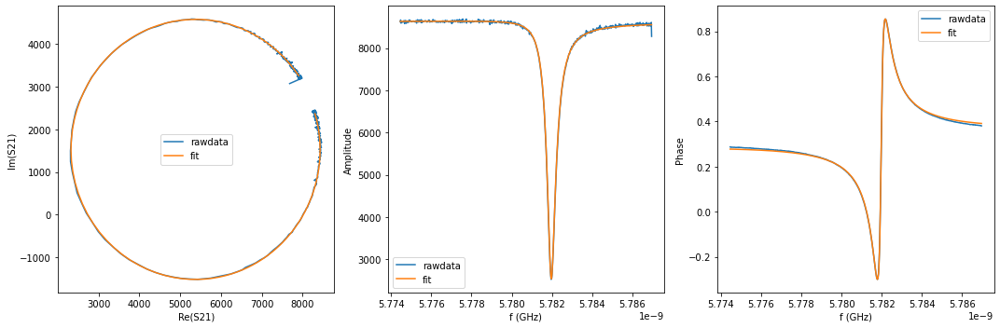

{'Qi_dia_corr': 27387.6444309383, 'Qi_no_corr': 27691.15910833891, 'absQc': 11439.473349355112, 'Qc_dia_corr(Re{Qc})': 11492.085829330654, 'Ql': 8095.250619193864, 'fr': 5.781946691680758, 'theta0': -3.0458742989170458, 'phi0': 0.0957250897257774, 'phi0_err': 0.003220490834696677, 'Ql_err': 33.423995447317814, 'absQc_err': 18.758757928026142, 'fr_err': 1.3180040038803272e-06, 'chi_square': 3.481852360447599e-05, 'Qi_no_corr_err': 378.1078786646093, 'Qi_dia_corr_err': 370.33992693700867, 'delay': -0.3851439411192859, 'a': 8612.072989062832, 'alpha': -1.095945947234729}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


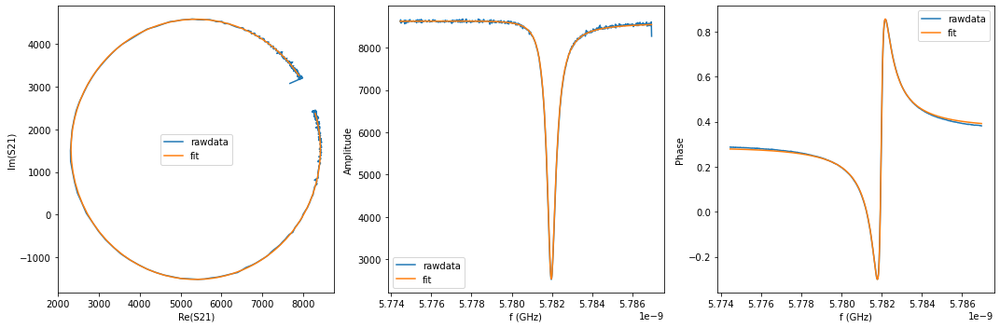

{'Qi_dia_corr': 27438.87547268947, 'Qi_no_corr': 27743.53119832501, 'absQc': 11438.260258113638, 'Qc_dia_corr(Re{Qc})': 11490.861240212042, 'Ql': 8099.112330745394, 'fr': 5.7819465967911565, 'theta0': -3.0458796507125827, 'phi0': 0.09571972527803324, 'phi0_err': 0.0031996224016573654, 'Ql_err': 33.01924945136439, 'absQc_err': 18.944779377358316, 'fr_err': 1.3092737484358626e-06, 'chi_square': 3.541937960536841e-05, 'Qi_no_corr_err': 371.89410953637463, 'Qi_dia_corr_err': 363.9116987399564, 'delay': -0.37675508144950554, 'a': 8609.356647620269, 'alpha': -0.7906025099360833}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


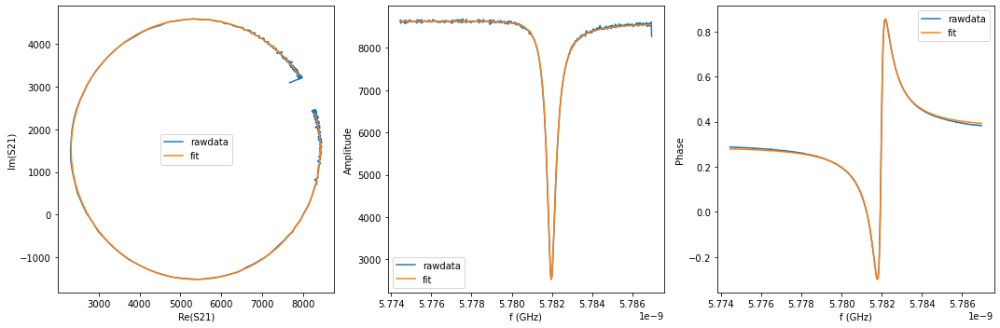

{'Qi_dia_corr': 27400.804714256497, 'Qi_no_corr': 27708.126800945825, 'absQc': 11442.187094304967, 'Qc_dia_corr(Re{Qc})': 11495.429483516114, 'Ql': 8098.059487783757, 'fr': 5.781946281363197, 'theta0': -3.045316790201838, 'phi0': 0.09628284869080982, 'phi0_err': 0.003145282810958077, 'Ql_err': 32.53910740803489, 'absQc_err': 18.285168976135186, 'fr_err': 1.2834492819456282e-06, 'chi_square': 3.321904499335188e-05, 'Qi_no_corr_err': 366.6089124463397, 'Qi_dia_corr_err': 358.69605171922257, 'delay': -0.37684418180910995, 'a': 8606.469253701034, 'alpha': -0.7933835610668636}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


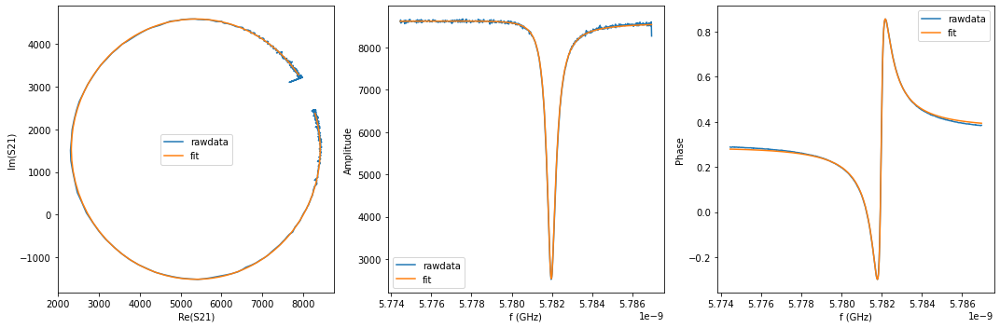

{'Qi_dia_corr': 27432.56146698056, 'Qi_no_corr': 27742.729204498683, 'absQc': 11446.39139098761, 'Qc_dia_corr(Re{Qc})': 11500.038827798826, 'Ql': 8103.119740978556, 'fr': 5.781945857795406, 'theta0': -3.0449701901545416, 'phi0': 0.09662929450251884, 'phi0_err': 0.003615612780878055, 'Ql_err': 34.660442667790335, 'absQc_err': 19.530124113814114, 'fr_err': 1.4560717179920038e-06, 'chi_square': 3.909865662768399e-05, 'Qi_no_corr_err': 388.6208204778369, 'Qi_dia_corr_err': 379.89644137018036, 'delay': -0.40095587913406566, 'a': 8604.760379717844, 'alpha': -1.668572926581828}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


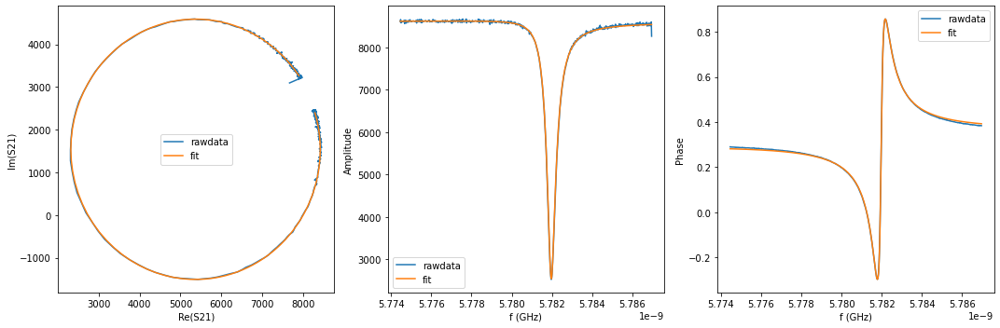

{'Qi_dia_corr': 27360.24623613987, 'Qi_no_corr': 27660.950040381842, 'absQc': 11431.27010124776, 'Qc_dia_corr(Re{Qc})': 11483.42773214976, 'Ql': 8088.560588862575, 'fr': 5.781946319044114, 'theta0': -3.0462532467177734, 'phi0': 0.09534604270765355, 'phi0_err': 0.002956612063485344, 'Ql_err': 28.845260655651863, 'absQc_err': 17.748540955604508, 'fr_err': 1.2284156901803262e-06, 'chi_square': 3.069329730762592e-05, 'Qi_no_corr_err': 323.5588415138535, 'Qi_dia_corr_err': 317.3831121653201, 'delay': -0.3500480842699387, 'a': 8603.784586892149, 'alpha': 0.18087643092725034}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


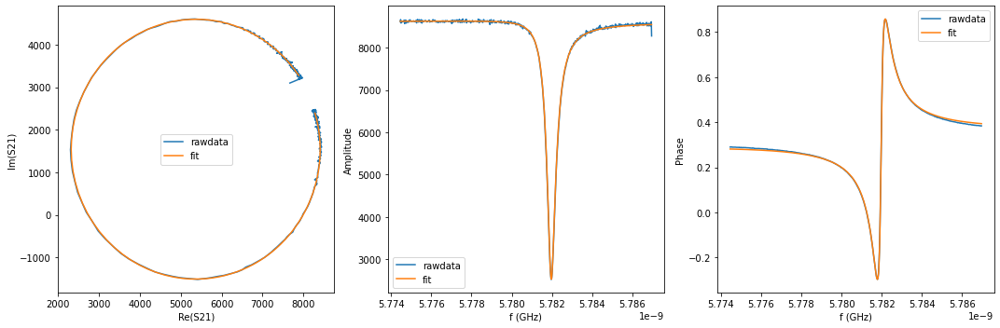

{'Qi_dia_corr': 27398.23061295125, 'Qi_no_corr': 27698.21391297766, 'absQc': 11427.969406678274, 'Qc_dia_corr(Re{Qc})': 11479.828781428103, 'Ql': 8090.089918331517, 'fr': 5.7819459975694425, 'theta0': -3.0465114795700843, 'phi0': 0.09508774704927865, 'phi0_err': 0.0032243643363321643, 'Ql_err': 32.301619862462694, 'absQc_err': 18.529351637245675, 'fr_err': 1.303927157830411e-06, 'chi_square': 3.466209475494621e-05, 'Qi_no_corr_err': 358.8476767345847, 'Qi_dia_corr_err': 351.92974008023157, 'delay': -0.3702417799316421, 'a': 8603.089606471369, 'alpha': -0.5521745584638763}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


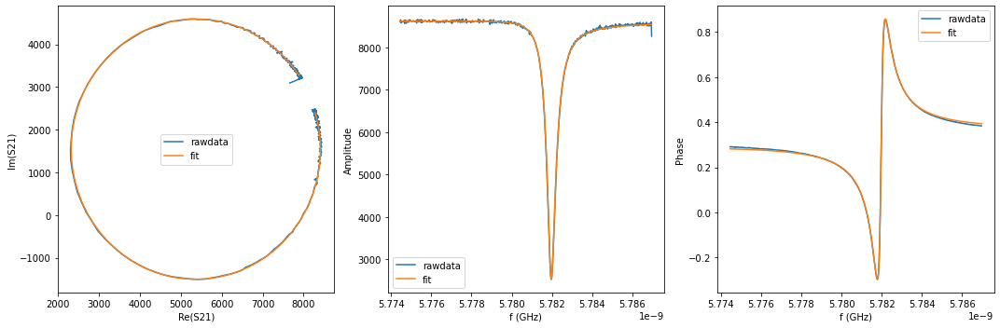

{'Qi_dia_corr': 27344.676001428354, 'Qi_no_corr': 27644.74432374313, 'absQc': 11419.30844663712, 'Qc_dia_corr(Re{Qc})': 11471.306547241467, 'Ql': 8081.185641869863, 'fr': 5.781945849029083, 'theta0': -3.046348994040673, 'phi0': 0.09525032848203145, 'phi0_err': 0.0030414547195147627, 'Ql_err': 30.85579020034646, 'absQc_err': 18.43623656704666, 'fr_err': 1.2617469783613916e-06, 'chi_square': 3.315666768738664e-05, 'Qi_no_corr_err': 347.0271956609268, 'Qi_dia_corr_err': 340.4237216061311, 'delay': -0.35547242388736655, 'a': 8601.69156149055, 'alpha': -0.015538825076738058}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


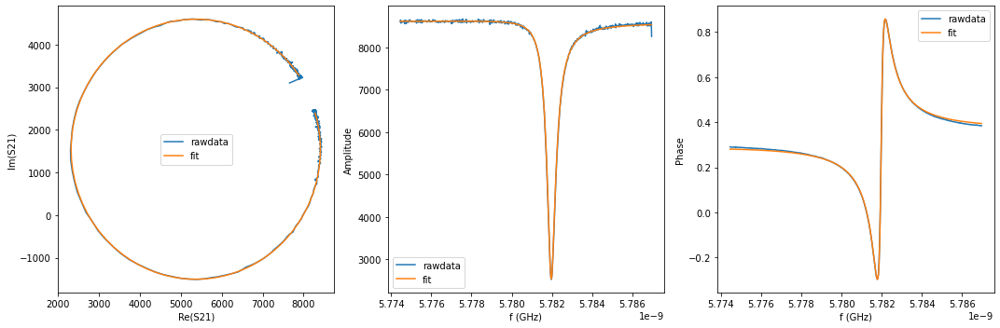

{'Qi_dia_corr': 27433.378741627173, 'Qi_no_corr': 27735.72757751209, 'absQc': 11445.643024006667, 'Qc_dia_corr(Re{Qc})': 11497.936745576872, 'Ql': 8102.147321283228, 'fr': 5.781945542831371, 'theta0': -3.046189190774285, 'phi0': 0.09541014456712901, 'phi0_err': 0.0033983519404682033, 'Ql_err': 33.230523106032656, 'absQc_err': 19.214349377421936, 'fr_err': 1.3787621906218718e-06, 'chi_square': 3.7194102260843365e-05, 'Qi_no_corr_err': 371.32390227328585, 'Qi_dia_corr_err': 364.02271664362377, 'delay': -0.38316955097391253, 'a': 8599.71383142883, 'alpha': -1.0212959030336117}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


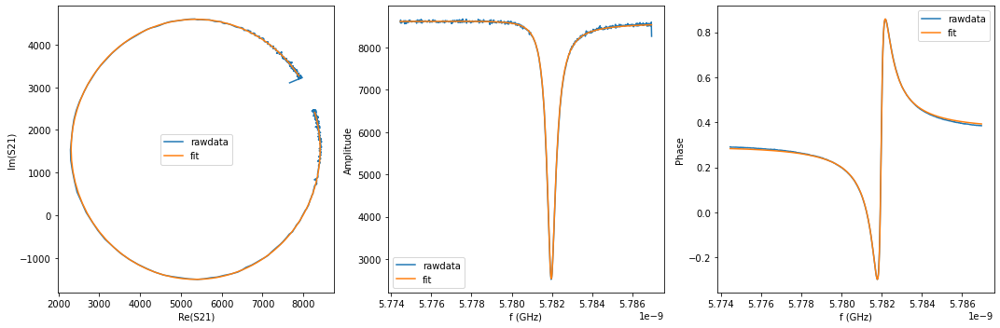

{'Qi_dia_corr': 27374.77460831881, 'Qi_no_corr': 27673.074602733555, 'absQc': 11408.964297617495, 'Qc_dia_corr(Re{Qc})': 11460.450777538163, 'Ql': 8078.419883693854, 'fr': 5.781945771574601, 'theta0': -3.0467746621407708, 'phi0': 0.09482513558835082, 'phi0_err': 0.0026844004274163783, 'Ql_err': 29.028999047146296, 'absQc_err': 17.11712997230734, 'fr_err': 1.1272657099921864e-06, 'chi_square': 2.7685198096256108e-05, 'Qi_no_corr_err': 332.06257791848196, 'Qi_dia_corr_err': 326.0144660940528, 'delay': -0.3275746191110472, 'a': 8600.425120934568, 'alpha': 0.9983157567953251}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


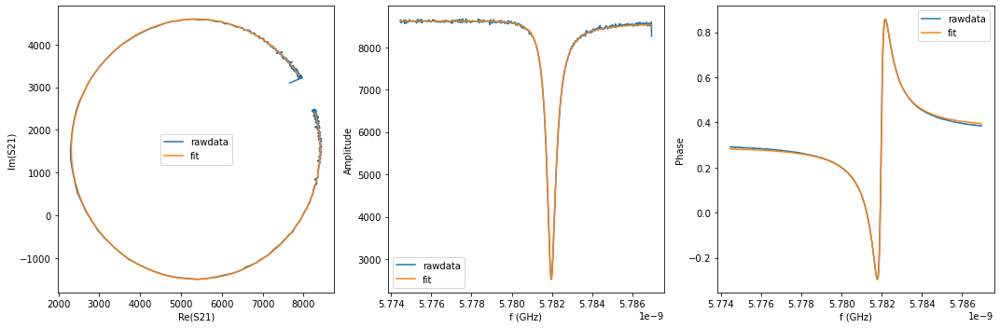

{'Qi_dia_corr': 27416.360963447718, 'Qi_no_corr': 27718.613951667383, 'absQc': 11441.115585223213, 'Qc_dia_corr(Re{Qc})': 11493.416199616739, 'Ql': 8098.418192200531, 'fr': 5.781945202288212, 'theta0': -3.0461638070152257, 'phi0': 0.09543521394840586, 'phi0_err': 0.003292469927007684, 'Ql_err': 32.80255527006831, 'absQc_err': 19.093277131650517, 'fr_err': 1.345592213236822e-06, 'chi_square': 3.627470854762925e-05, 'Qi_no_corr_err': 368.04377926364714, 'Qi_dia_corr_err': 360.5876238616747, 'delay': -0.37195027002670056, 'a': 8598.617201589046, 'alpha': -0.6130131991240968}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


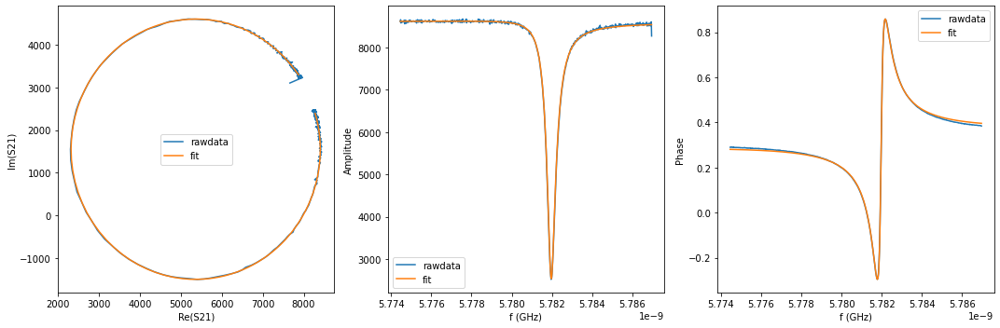

{'Qi_dia_corr': 27469.169609647182, 'Qi_no_corr': 27774.222673523942, 'absQc': 11470.978421382171, 'Qc_dia_corr(Re{Qc})': 11523.83333638606, 'Ql': 8118.126549745451, 'fr': 5.7819448031040634, 'theta0': -3.0457859538754612, 'phi0': 0.09581319805389504, 'phi0_err': 0.0038274973715260495, 'Ql_err': 37.40604055423334, 'absQc_err': 20.537607205592437, 'fr_err': 1.5277864737904157e-06, 'chi_square': 4.323811754503528e-05, 'Qi_no_corr_err': 418.0746031942791, 'Qi_dia_corr_err': 409.24399871247203, 'delay': -0.4110473426918559, 'a': 8596.828927999186, 'alpha': -2.032916811937294}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


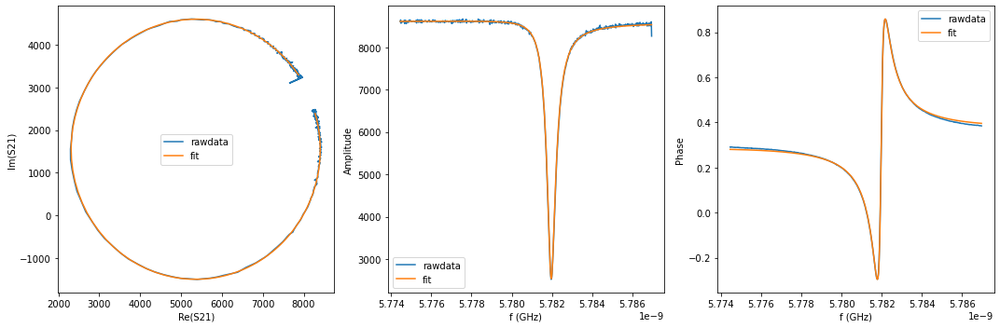

{'Qi_dia_corr': 27454.91505273235, 'Qi_no_corr': 27756.48833903602, 'absQc': 11457.998754251306, 'Qc_dia_corr(Re{Qc})': 11510.190222707202, 'Ql': 8110.110124722405, 'fr': 5.781944643674435, 'theta0': -3.0463330399342397, 'phi0': 0.09526595960039747, 'phi0_err': 0.0036904772744625488, 'Ql_err': 35.631182942921264, 'absQc_err': 20.855418743241103, 'fr_err': 1.5073956275715813e-06, 'chi_square': 4.339776196032435e-05, 'Qi_no_corr_err': 401.24295503417085, 'Qi_dia_corr_err': 393.02590339503746, 'delay': -0.40894176849370284, 'a': 8594.556618554494, 'alpha': -1.9565899507125655}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


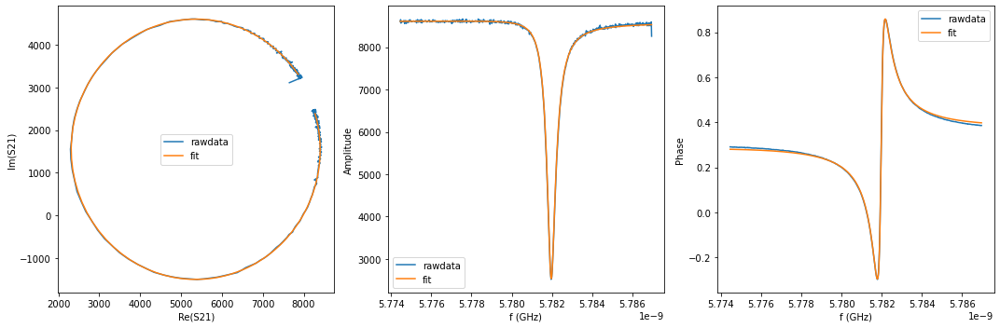

{'Qi_dia_corr': 27509.45871325615, 'Qi_no_corr': 27822.792163889273, 'absQc': 11469.073469239684, 'Qc_dia_corr(Re{Qc})': 11523.176870400814, 'Ql': 8121.315755950806, 'fr': 5.7819435682679385, 'theta0': -3.04465746255278, 'phi0': 0.09694183547963207, 'phi0_err': 0.004465026919326605, 'Ql_err': 41.26819942935127, 'absQc_err': 21.755035353185548, 'fr_err': 1.758934815620433e-06, 'chi_square': 5.0043843208127055e-05, 'Qi_no_corr_err': 465.37044193065105, 'Qi_dia_corr_err': 454.0375723137703, 'delay': -0.43682536453173315, 'a': 8593.745996553054, 'alpha': -2.9689984584923144}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


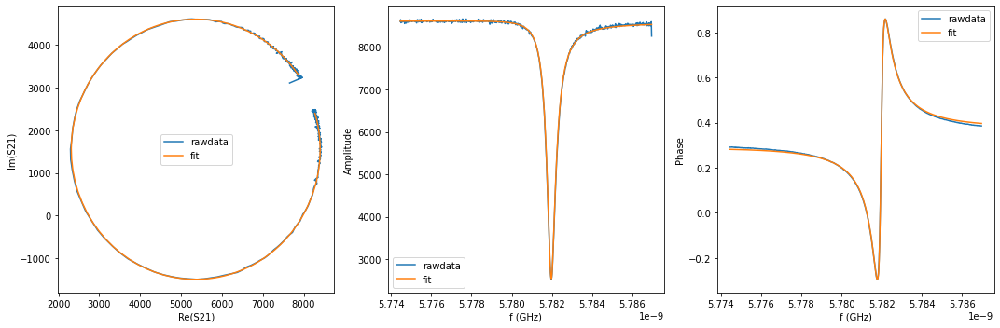

{'Qi_dia_corr': 27429.012474297182, 'Qi_no_corr': 27731.265027591315, 'absQc': 11446.848208556845, 'Qc_dia_corr(Re{Qc})': 11499.153051592628, 'Ql': 8102.3703078486415, 'fr': 5.7819441175779644, 'theta0': -3.0461838699804615, 'phi0': 0.09541524687883489, 'phi0_err': 0.0037248319335153376, 'Ql_err': 36.405474181120745, 'absQc_err': 20.241812518262083, 'fr_err': 1.5066055033525502e-06, 'chi_square': 4.173330416709422e-05, 'Qi_no_corr_err': 411.0265826090019, 'Qi_dia_corr_err': 402.6050386063159, 'delay': -0.3999702437470759, 'a': 8594.631690106447, 'alpha': -1.6301722454857144}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


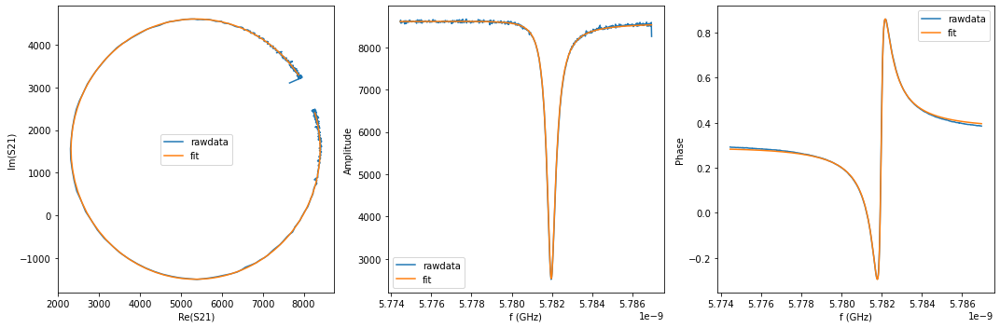

{'Qi_dia_corr': 27394.133506036927, 'Qi_no_corr': 27690.433417067998, 'absQc': 11430.07982469639, 'Qc_dia_corr(Re{Qc})': 11481.340705907503, 'Ql': 8090.483434650688, 'fr': 5.781944463368581, 'theta0': -3.0470679960845435, 'phi0': 0.09453082433768306, 'phi0_err': 0.0031503786559741458, 'Ql_err': 34.49279333487468, 'absQc_err': 19.098930751683543, 'fr_err': 1.2924836453292122e-06, 'chi_square': 3.55680782049753e-05, 'Qi_no_corr_err': 390.8832436028471, 'Qi_dia_corr_err': 384.4151671870257, 'delay': -0.37885785368127434, 'a': 8594.38505180936, 'alpha': -0.8631013943618425}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


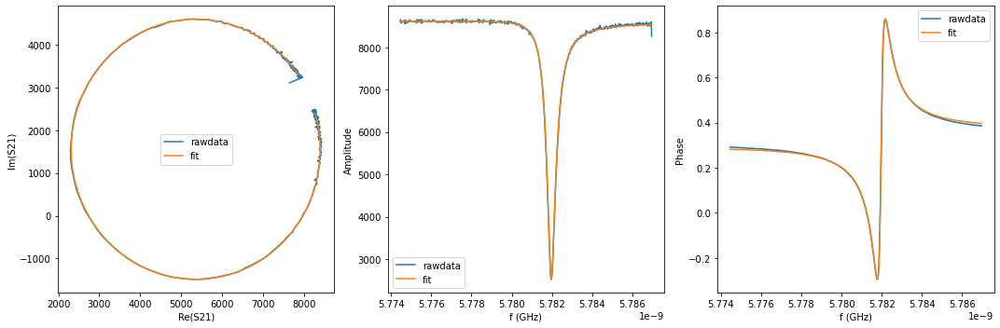

{'Qi_dia_corr': 27409.364162900132, 'Qi_no_corr': 27709.23232976091, 'absQc': 11433.064359769343, 'Qc_dia_corr(Re{Qc})': 11484.908190720826, 'Ql': 8093.5832431798935, 'fr': 5.781943943950172, 'theta0': -3.046546387674311, 'phi0': 0.09505244276170599, 'phi0_err': 0.003448705502742551, 'Ql_err': 34.59570416444231, 'absQc_err': 19.489293389815156, 'fr_err': 1.410920587129429e-06, 'chi_square': 3.7884914375162174e-05, 'Qi_no_corr_err': 393.48974215482684, 'Qi_dia_corr_err': 385.3153848483899, 'delay': -0.3947361471640477, 'a': 8594.609310126296, 'alpha': -1.4397350617304012}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


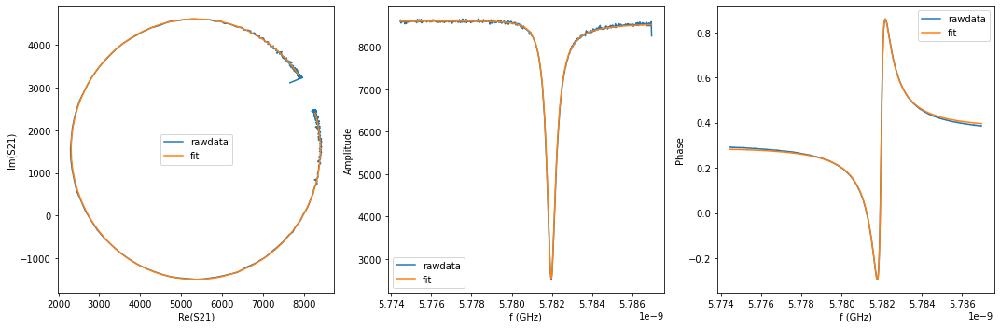

{'Qi_dia_corr': 27372.32345532275, 'Qi_no_corr': 27668.125016076057, 'absQc': 11434.193839327754, 'Qc_dia_corr(Re{Qc})': 11485.48754245768, 'Ql': 8090.637943351708, 'fr': 5.781943894140968, 'theta0': -3.047054751358442, 'phi0': 0.09454402079250282, 'phi0_err': 0.003348711107518119, 'Ql_err': 35.25921095366512, 'absQc_err': 19.198852539931124, 'fr_err': 1.3733972866806915e-06, 'chi_square': 3.641601076147847e-05, 'Qi_no_corr_err': 402.89651989609763, 'Qi_dia_corr_err': 396.38258317665543, 'delay': -0.3840919837738623, 'a': 8593.489130282562, 'alpha': -1.0533635426819998}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


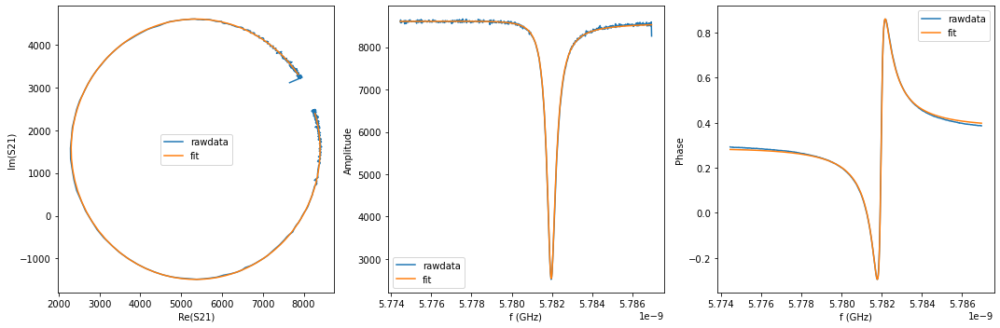

{'Qi_dia_corr': 27481.084906287393, 'Qi_no_corr': 27785.44673030929, 'absQc': 11457.294734847723, 'Qc_dia_corr(Re{Qc})': 11509.859050076331, 'Ql': 8112.227653901773, 'fr': 5.781943166971268, 'theta0': -3.0459915849822297, 'phi0': 0.09560727073574957, 'phi0_err': 0.003976799382956913, 'Ql_err': 40.496801138680524, 'absQc_err': 21.16619466338682, 'fr_err': 1.5956884869917817e-06, 'chi_square': 4.5859304691256e-05, 'Qi_no_corr_err': 461.10819951262806, 'Qi_dia_corr_err': 450.5440246398597, 'delay': -0.4245251762520401, 'a': 8592.710433762486, 'alpha': -2.521358641236344}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


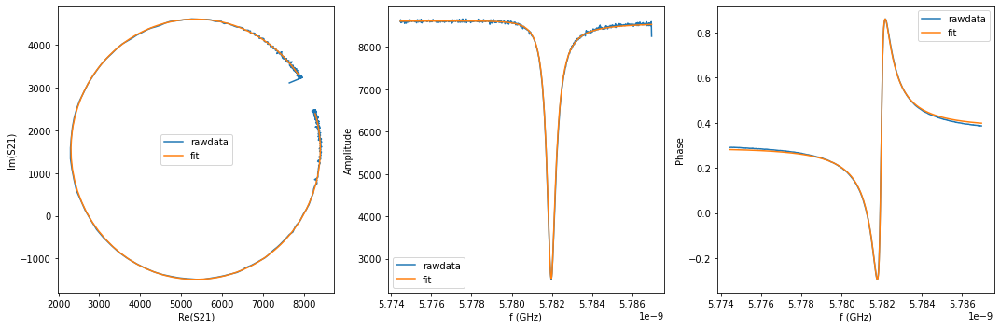

{'Qi_dia_corr': 27505.02250268387, 'Qi_no_corr': 27811.261929217704, 'absQc': 11468.402200975923, 'Qc_dia_corr(Re{Qc})': 11521.299412820485, 'Ql': 8119.996557602591, 'fr': 5.781942748410646, 'theta0': -3.045736827359932, 'phi0': 0.0958621047327909, 'phi0_err': 0.003934635367983011, 'Ql_err': 42.03369327823416, 'absQc_err': 21.148071325408626, 'fr_err': 1.5645931152552637e-06, 'chi_square': 4.579011106970924e-05, 'Qi_no_corr_err': 476.56734012935243, 'Qi_dia_corr_err': 466.4409162838002, 'delay': -0.4315145045286303, 'a': 8591.587258061429, 'alpha': -2.774994207426732}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


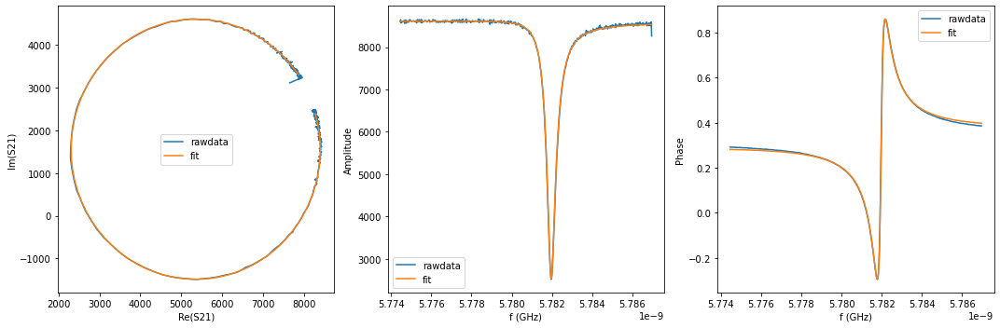

{'Qi_dia_corr': 27487.203438123706, 'Qi_no_corr': 27787.44143170995, 'absQc': 11452.670451882268, 'Qc_dia_corr(Re{Qc})': 11504.462085928259, 'Ql': 8110.079052843427, 'fr': 5.781943068317431, 'theta0': -3.046675071429139, 'phi0': 0.09492371108573118, 'phi0_err': 0.0037661023182891185, 'Ql_err': 41.29535631678722, 'absQc_err': 21.14685024211762, 'fr_err': 1.5179758147987542e-06, 'chi_square': 4.495628057250736e-05, 'Qi_no_corr_err': 471.3156417336827, 'Qi_dia_corr_err': 462.2730129820952, 'delay': -0.4190075406906542, 'a': 8592.676506396385, 'alpha': -2.320699499677403}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


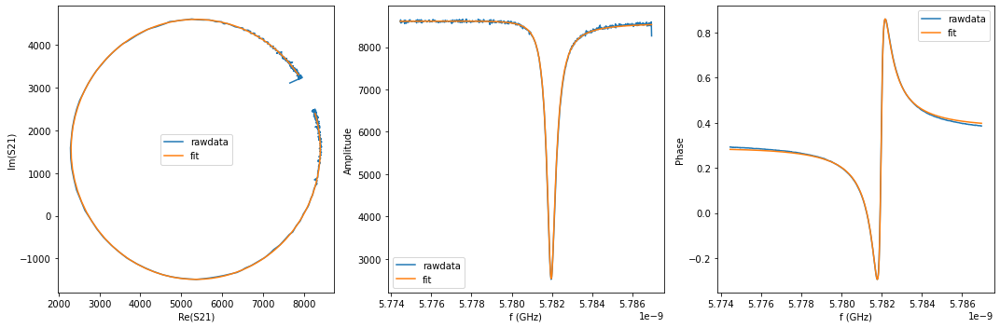

{'Qi_dia_corr': 27491.144771975498, 'Qi_no_corr': 27795.995597061214, 'absQc': 11456.146488230652, 'Qc_dia_corr(Re{Qc})': 11508.745655202, 'Ql': 8112.550817079305, 'fr': 5.781942514935909, 'theta0': -3.0459551101898192, 'phi0': 0.09564361456078788, 'phi0_err': 0.0037568722411117457, 'Ql_err': 39.506258048433075, 'absQc_err': 20.748141411822807, 'fr_err': 1.5118027320792618e-06, 'chi_square': 4.357883910002534e-05, 'Qi_no_corr_err': 449.1103471351725, 'Qi_dia_corr_err': 440.246681033056, 'delay': -0.4151750862048574, 'a': 8592.460566724216, 'alpha': -2.181517876706036}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


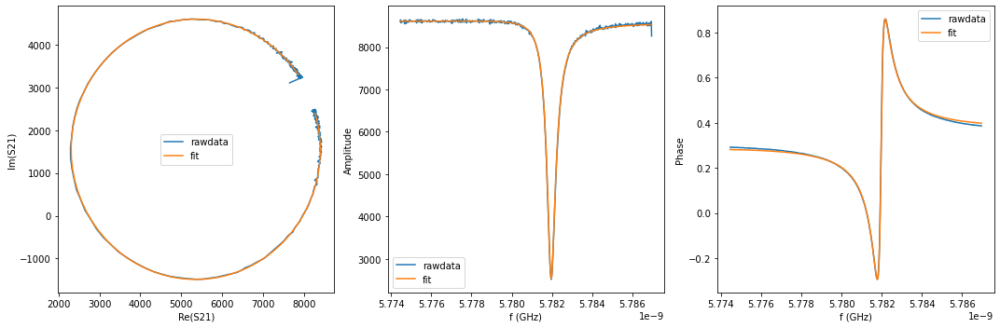

{'Qi_dia_corr': 27483.940444930522, 'Qi_no_corr': 27791.617295358657, 'absQc': 11450.618270317464, 'Qc_dia_corr(Re{Qc})': 11503.678321863064, 'Ql': 8109.405495803377, 'fr': 5.781941873286557, 'theta0': -3.045515733003842, 'phi0': 0.09608321763471102, 'phi0_err': 0.003982779005331343, 'Ql_err': 40.2281272307344, 'absQc_err': 21.56429514800271, 'fr_err': 1.606173330333349e-06, 'chi_square': 4.733635180390072e-05, 'Qi_no_corr_err': 457.9976913374881, 'Qi_dia_corr_err': 449.14856042674415, 'delay': -0.427472592663867, 'a': 8592.412274487335, 'alpha': -2.628109539400365}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


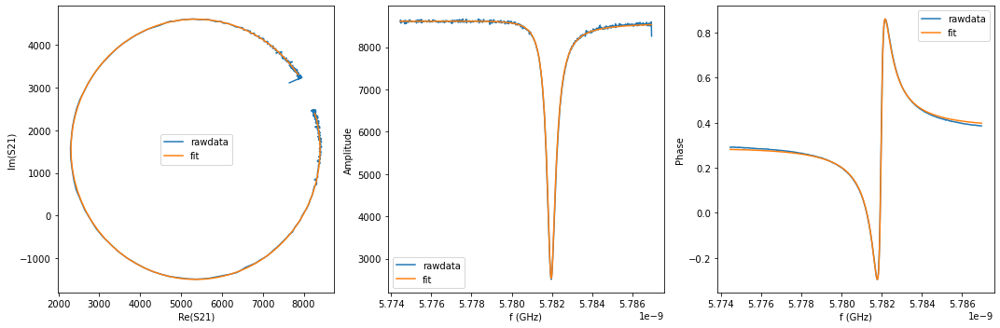

{'Qi_dia_corr': 27490.212703157722, 'Qi_no_corr': 27797.950485773978, 'absQc': 11460.290528136084, 'Qc_dia_corr(Re{Qc})': 11513.426688684383, 'Ql': 8114.795274216032, 'fr': 5.781941916309451, 'theta0': -3.0454874124464144, 'phi0': 0.09611141082641425, 'phi0_err': 0.003967769324284231, 'Ql_err': 40.668546073467205, 'absQc_err': 21.5059024091349, 'fr_err': 1.6068012849459357e-06, 'chi_square': 4.655749599317362e-05, 'Qi_no_corr_err': 466.65115653355633, 'Qi_dia_corr_err': 457.7845422014794, 'delay': -0.4200391326353022, 'a': 8592.19718499007, 'alpha': -2.358297935436909}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


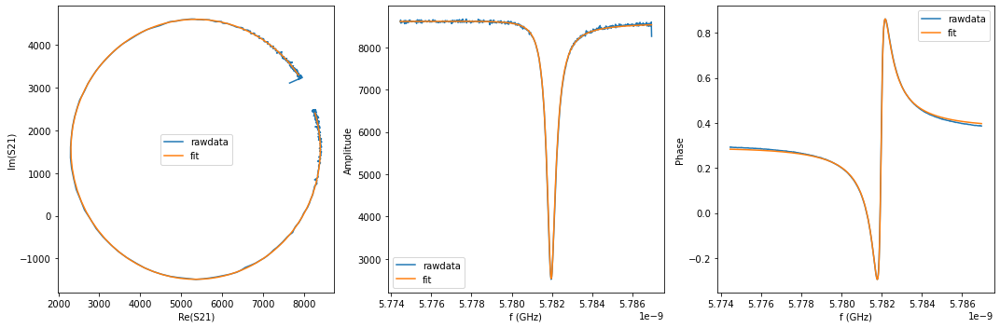

{'Qi_dia_corr': 27439.9862536003, 'Qi_no_corr': 27740.275318978554, 'absQc': 11429.40242934675, 'Qc_dia_corr(Re{Qc})': 11481.169610706542, 'Ql': 8094.393121093187, 'fr': 5.781942091620953, 'theta0': -3.046601059784149, 'phi0': 0.09499757247857021, 'phi0_err': 0.003450921549147267, 'Ql_err': 36.83075616954558, 'absQc_err': 19.815674508771032, 'fr_err': 1.4109076899273244e-06, 'chi_square': 3.900929287122756e-05, 'Qi_no_corr_err': 421.9159282950361, 'Qi_dia_corr_err': 413.94207070144114, 'delay': -0.3854125457287151, 'a': 8592.785123752876, 'alpha': -1.1003144222615806}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


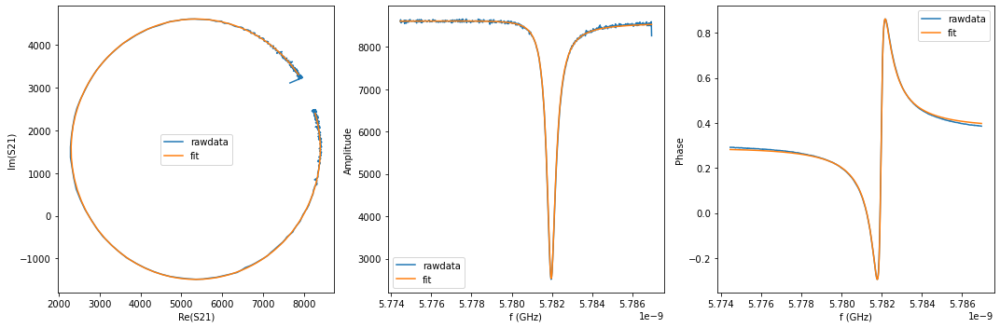

{'Qi_dia_corr': 27467.248734800247, 'Qi_no_corr': 27765.374486453715, 'absQc': 11442.310391546296, 'Qc_dia_corr(Re{Qc})': 11493.721288603567, 'Ql': 8103.004143195147, 'fr': 5.781941875691259, 'theta0': -3.0469802645660184, 'phi0': 0.09461811080473816, 'phi0_err': 0.00364470750568392, 'Ql_err': 37.839389166172765, 'absQc_err': 20.923075977672866, 'fr_err': 1.4941896848496887e-06, 'chi_square': 4.307354549554189e-05, 'Qi_no_corr_err': 433.7837449586126, 'Qi_dia_corr_err': 426.2179132998194, 'delay': -0.410446762137148, 'a': 8591.871975939748, 'alpha': -2.009630350310927}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


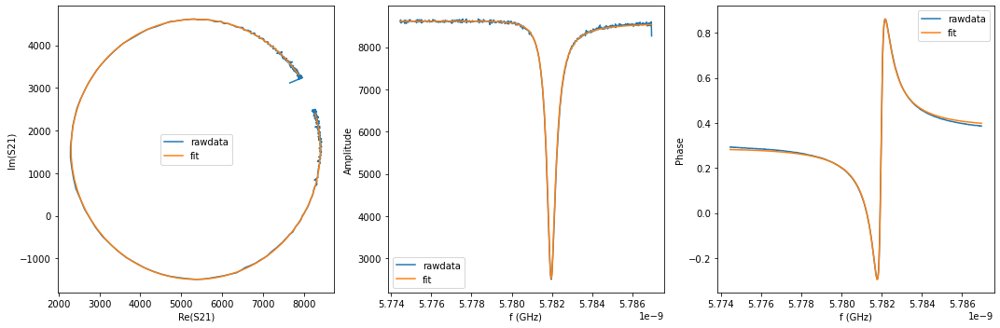

{'Qi_dia_corr': 27513.00890782266, 'Qi_no_corr': 27815.998738113507, 'absQc': 11455.927011633761, 'Qc_dia_corr(Re{Qc})': 11508.122144305098, 'Ql': 8114.143760866523, 'fr': 5.781941160972667, 'theta0': -3.0463205073376862, 'phi0': 0.0952778725787752, 'phi0_err': 0.0039863212234562415, 'Ql_err': 41.073049446452465, 'absQc_err': 21.668917842026875, 'fr_err': 1.6089363686394416e-06, 'chi_square': 4.759077624116126e-05, 'Qi_no_corr_err': 469.57010643209344, 'Qi_dia_corr_err': 461.33251967841676, 'delay': -0.4256715979847763, 'a': 8592.389733906864, 'alpha': -2.5624506866951275}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


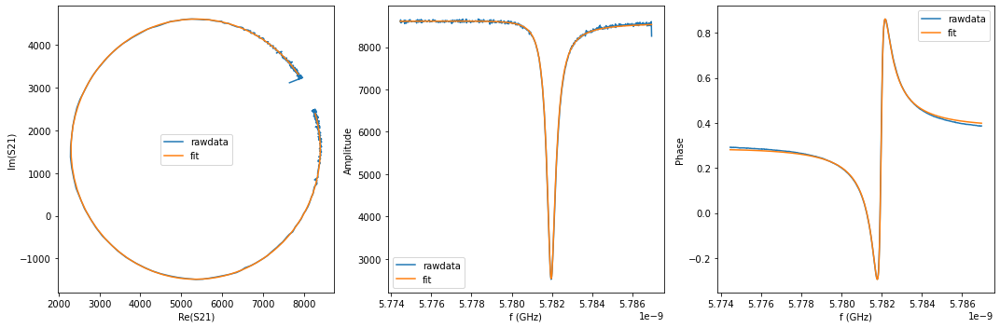

{'Qi_dia_corr': 27534.965051518528, 'Qi_no_corr': 27837.751542506998, 'absQc': 11464.90613622407, 'Qc_dia_corr(Re{Qc})': 11517.065242524179, 'Ql': 8120.499409664194, 'fr': 5.781940933899303, 'theta0': -3.0463905498217208, 'phi0': 0.09520794603424773, 'phi0_err': 0.0041466426423241495, 'Ql_err': 45.51864523095917, 'absQc_err': 22.21666989824895, 'fr_err': 1.64499620325116e-06, 'chi_square': 5.069996127131848e-05, 'Qi_no_corr_err': 518.082254472724, 'Qi_dia_corr_err': 508.30714693480866, 'delay': -0.438205450740224, 'a': 8592.68676181529, 'alpha': -3.017745606104863}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


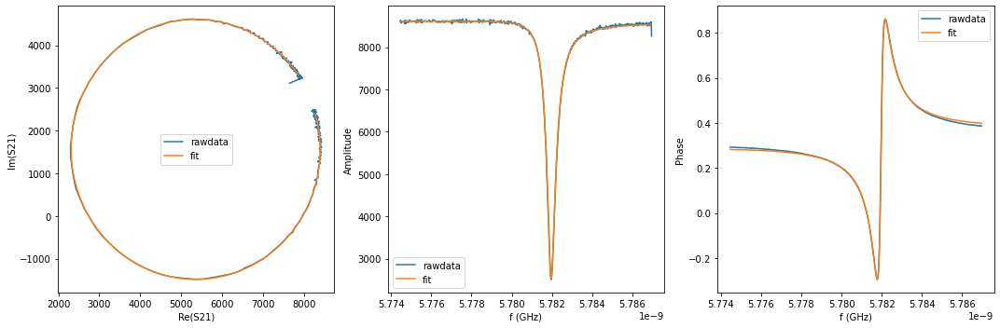

{'Qi_dia_corr': 27443.29628000777, 'Qi_no_corr': 27743.02492762673, 'absQc': 11443.22549744372, 'Qc_dia_corr(Re{Qc})': 11495.009541075975, 'Ql': 8101.558245157471, 'fr': 5.781940699451003, 'theta0': -3.0466426484449287, 'phi0': 0.09495579690746064, 'phi0_err': 0.003978951235546263, 'Ql_err': 43.0254687789103, 'absQc_err': 21.758219404832616, 'fr_err': 1.6159710181248118e-06, 'chi_square': 4.73805084736575e-05, 'Qi_no_corr_err': 497.7596348529592, 'Qi_dia_corr_err': 489.52400669513867, 'delay': -0.41613338184793564, 'a': 8594.535183517954, 'alpha': -2.2159677806525395}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


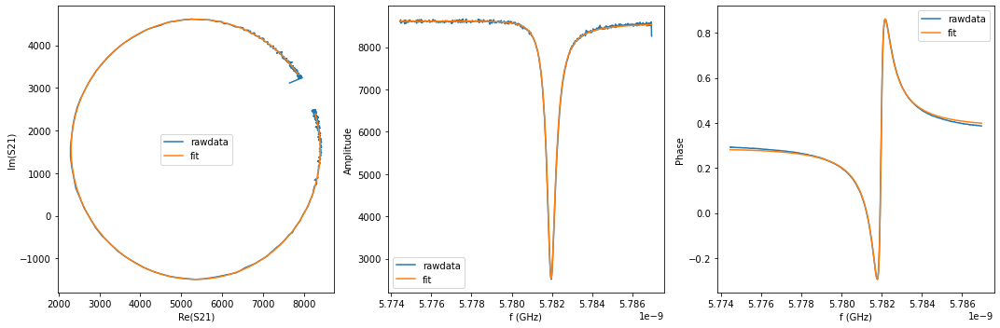

{'Qi_dia_corr': 27506.6932639881, 'Qi_no_corr': 27809.705901834375, 'absQc': 11452.399615339218, 'Qc_dia_corr(Re{Qc})': 11504.590374647749, 'Ql': 8111.838654031311, 'fr': 5.781940202034591, 'theta0': -3.0463102336570493, 'phi0': 0.09528851178173238, 'phi0_err': 0.004114692208061485, 'Ql_err': 42.77028595990892, 'absQc_err': 22.159431118992536, 'fr_err': 1.6665711412633543e-06, 'chi_square': 4.9543448026697125e-05, 'Qi_no_corr_err': 493.6474903452115, 'Qi_dia_corr_err': 484.30922783564813, 'delay': -0.43443273573649305, 'a': 8594.336415027003, 'alpha': -2.8807529833747445}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


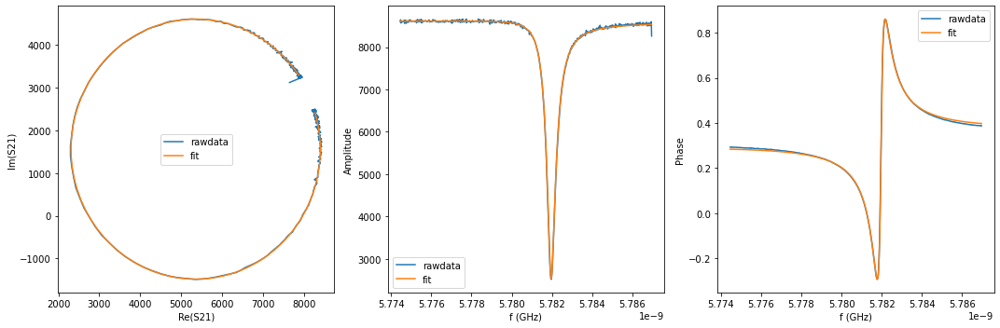

{'Qi_dia_corr': 27405.86460148782, 'Qi_no_corr': 27706.11991636134, 'absQc': 11418.469847208306, 'Qc_dia_corr(Re{Qc})': 11470.260654755666, 'Ql': 8086.001585189408, 'fr': 5.781940104835684, 'theta0': -3.0465338266742594, 'phi0': 0.09506447247071179, 'phi0_err': 0.0033114450555281685, 'Ql_err': 37.386018292730576, 'absQc_err': 20.28593951855434, 'fr_err': 1.3765326965571902e-06, 'chi_square': 3.9100465418533427e-05, 'Qi_no_corr_err': 431.69479988704853, 'Qi_dia_corr_err': 426.16148144883664, 'delay': -0.38340532996869864, 'a': 8595.872463171949, 'alpha': -1.0268276939360506}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


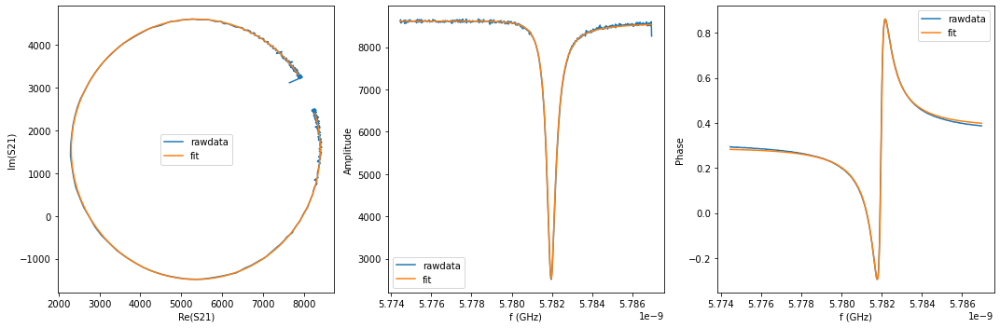

{'Qi_dia_corr': 27411.392381212347, 'Qi_no_corr': 27716.293039790344, 'absQc': 11436.19280328212, 'Qc_dia_corr(Re{Qc})': 11488.92220928543, 'Ql': 8095.753415651698, 'fr': 5.781939278050374, 'theta0': -3.045753985260772, 'phi0': 0.09584468525471812, 'phi0_err': 0.003866533973501323, 'Ql_err': 39.18385859884197, 'absQc_err': 21.58538117818554, 'fr_err': 1.585842424159495e-06, 'chi_square': 4.639342912994393e-05, 'Qi_no_corr_err': 450.14575761258425, 'Qi_dia_corr_err': 441.6992011230586, 'delay': -0.415916678480055, 'a': 8595.052827113284, 'alpha': -2.2078402320274404}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


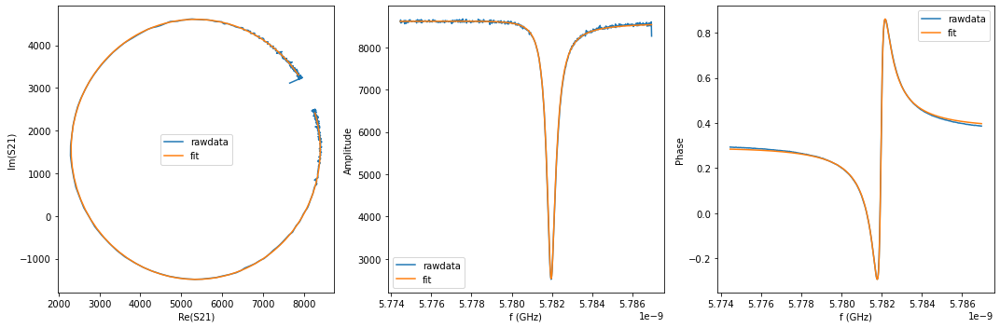

{'Qi_dia_corr': 27400.23598957624, 'Qi_no_corr': 27698.67094235645, 'absQc': 11427.211894654625, 'Qc_dia_corr(Re{Qc})': 11478.790889821255, 'Ql': 8089.749268461484, 'fr': 5.781939475108455, 'theta0': -3.046763934607716, 'phi0': 0.09483444797957312, 'phi0_err': 0.003201595148432867, 'Ql_err': 37.23544472827186, 'absQc_err': 20.460921674562357, 'fr_err': 1.3427837448185515e-06, 'chi_square': 3.8698588689426824e-05, 'Qi_no_corr_err': 431.74160773220734, 'Qi_dia_corr_err': 426.2682555718689, 'delay': -0.37914336049268244, 'a': 8595.933392520163, 'alpha': -0.872063227813454}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


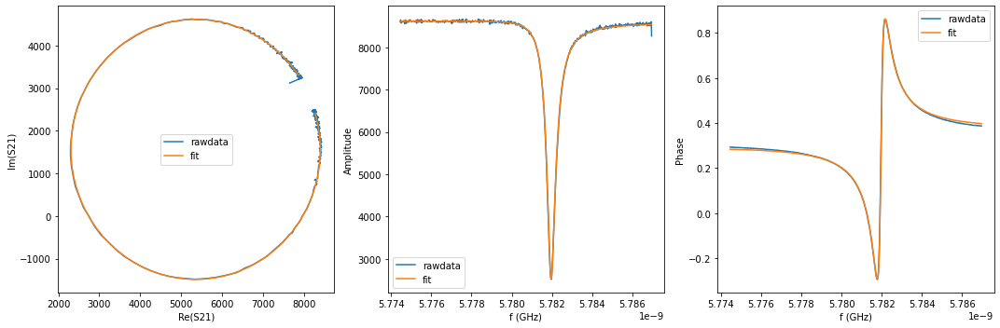

{'Qi_dia_corr': 27427.273150895624, 'Qi_no_corr': 27724.67734416024, 'absQc': 11423.964556569146, 'Qc_dia_corr(Re{Qc})': 11475.236104843492, 'Ql': 8090.337645048709, 'fr': 5.781938730181579, 'theta0': -3.047032125141685, 'phi0': 0.09456582908997883, 'phi0_err': 0.0033574681510266705, 'Ql_err': 41.44092490811464, 'absQc_err': 20.904708894143713, 'fr_err': 1.391385914930956e-06, 'chi_square': 4.032266634639902e-05, 'Qi_no_corr_err': 486.51594279031866, 'Qi_dia_corr_err': 481.14583512569294, 'delay': -0.3871928286388995, 'a': 8597.570727746264, 'alpha': -1.1645666421644982}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


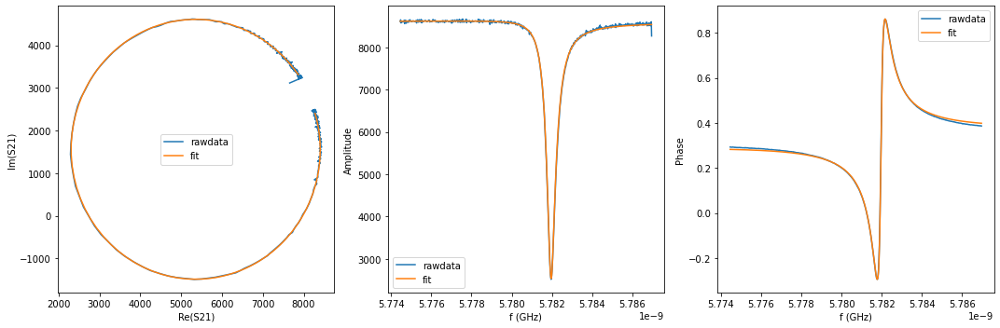

{'Qi_dia_corr': 27478.813508749627, 'Qi_no_corr': 27784.855889032435, 'absQc': 11451.316085716267, 'Qc_dia_corr(Re{Qc})': 11504.122215061816, 'Ql': 8109.179646428117, 'fr': 5.78193798597831, 'theta0': -3.0457471537764516, 'phi0': 0.09585100847242804, 'phi0_err': 0.00397721147764472, 'Ql_err': 45.16113138748662, 'absQc_err': 22.061938239496584, 'fr_err': 1.6142217566175983e-06, 'chi_square': 4.83616327930926e-05, 'Qi_no_corr_err': 523.9279654786296, 'Qi_dia_corr_err': 515.0212051578228, 'delay': -0.41613744261670244, 'a': 8597.504602440802, 'alpha': -2.2158373501937914}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


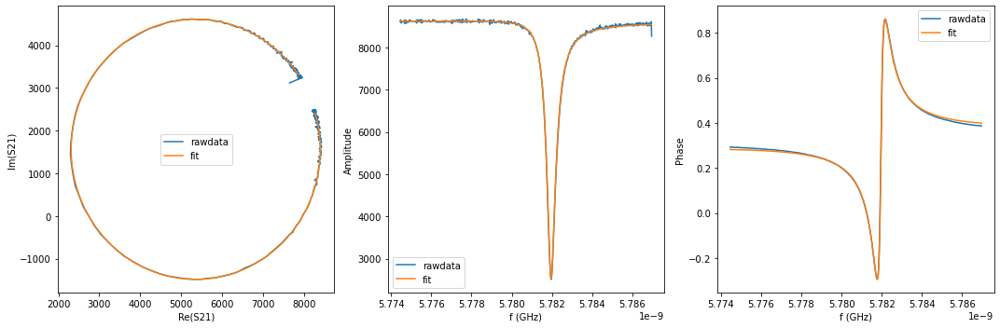

{'Qi_dia_corr': 27460.575909065396, 'Qi_no_corr': 27766.162856526847, 'absQc': 11453.431821102839, 'Qc_dia_corr(Re{Qc})': 11506.249427000486, 'Ql': 8108.647114404303, 'fr': 5.781937628846889, 'theta0': -3.045745641700931, 'phi0': 0.09585256334967444, 'phi0_err': 0.003976111883783059, 'Ql_err': 42.84627994051313, 'absQc_err': 22.247508262755485, 'fr_err': 1.616928618664577e-06, 'chi_square': 4.913652167713825e-05, 'Qi_no_corr_err': 492.58294629912194, 'Qi_dia_corr_err': 484.60347775009467, 'delay': -0.42715389916523655, 'a': 8597.051874231665, 'alpha': -2.6159681046598147}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


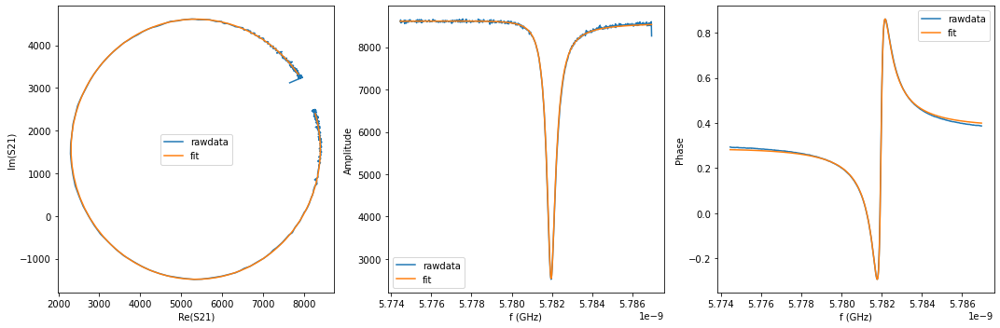

{'Qi_dia_corr': 27457.547951892855, 'Qi_no_corr': 27762.117422860123, 'absQc': 11461.130881466222, 'Qc_dia_corr(Re{Qc})': 11513.856333235184, 'Ql': 8112.15988184583, 'fr': 5.7819372676345, 'theta0': -3.0458613201511646, 'phi0': 0.09573717746759987, 'phi0_err': 0.003949343547865654, 'Ql_err': 43.59271323006784, 'absQc_err': 22.57325230241511, 'fr_err': 1.616467344269782e-06, 'chi_square': 4.988768955253696e-05, 'Qi_no_corr_err': 502.37024859976697, 'Qi_dia_corr_err': 494.6785424687084, 'delay': -0.4398436004930689, 'a': 8597.066169712267, 'alpha': -3.0768105198416285}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


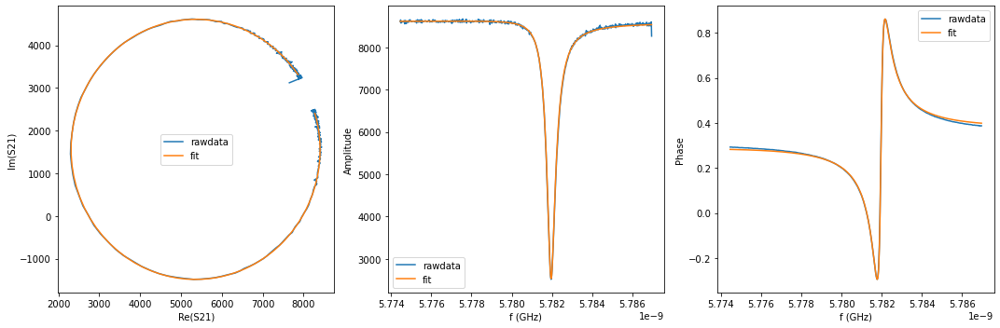

{'Qi_dia_corr': 27441.25434044112, 'Qi_no_corr': 27748.074078083286, 'absQc': 11451.23404393108, 'Qc_dia_corr(Re{Qc})': 11504.317555193205, 'Ql': 8106.002522988929, 'fr': 5.781936788364587, 'theta0': -3.0454962962353265, 'phi0': 0.09610180043430229, 'phi0_err': 0.0038383203721203364, 'Ql_err': 43.93582783560795, 'absQc_err': 22.018759384593892, 'fr_err': 1.5781742694720662e-06, 'chi_square': 4.708427912115057e-05, 'Qi_no_corr_err': 510.49264380441065, 'Qi_dia_corr_err': 503.4684790401605, 'delay': -0.4192854452149692, 'a': 8598.807275187439, 'alpha': -2.3300548390918783}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


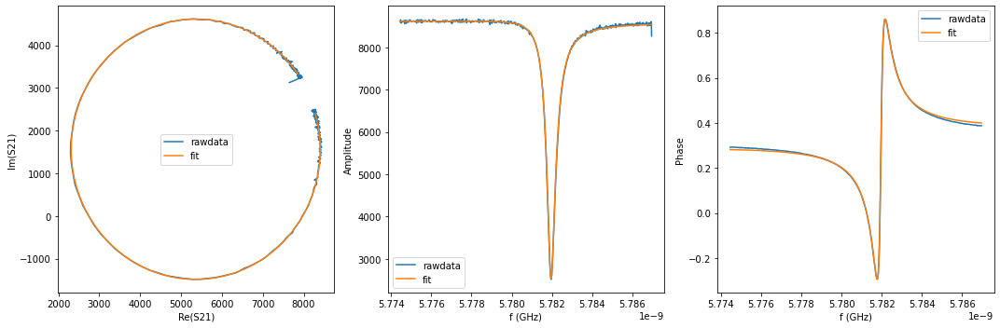

{'Qi_dia_corr': 27456.967791955358, 'Qi_no_corr': 27765.705774808845, 'absQc': 11454.805761894624, 'Qc_dia_corr(Re{Qc})': 11508.191293585212, 'Ql': 8109.29674373859, 'fr': 5.781936267084841, 'theta0': -3.0452398906337996, 'phi0': 0.09635877691040266, 'phi0_err': 0.004122806915741437, 'Ql_err': 45.07016493581095, 'absQc_err': 23.019442821214724, 'fr_err': 1.668638816511124e-06, 'chi_square': 5.2707037171105876e-05, 'Qi_no_corr_err': 517.9321172452844, 'Qi_dia_corr_err': 510.5695758167348, 'delay': -0.4415381816657904, 'a': 8598.449034054878, 'alpha': -3.1382572877493082}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


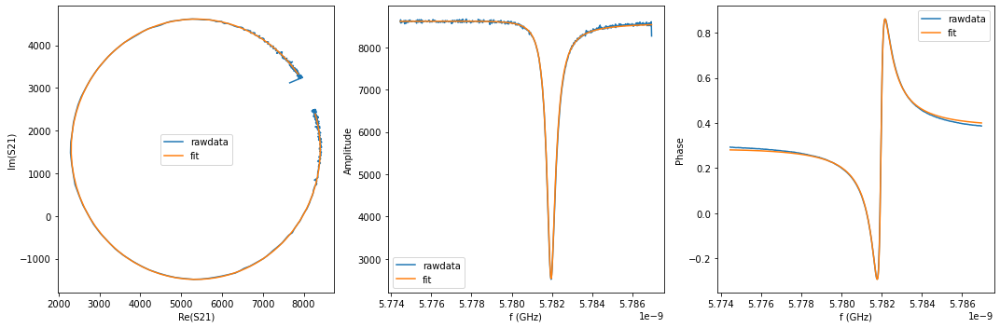

{'Qi_dia_corr': 27517.527409281734, 'Qi_no_corr': 27823.727117125552, 'absQc': 11482.164779461707, 'Qc_dia_corr(Re{Qc})': 11535.134354820926, 'Ql': 8127.957517874089, 'fr': 5.781935889183055, 'theta0': -3.045727987410394, 'phi0': 0.09587011442249599, 'phi0_err': 0.0045696169025961075, 'Ql_err': 47.796608375342885, 'absQc_err': 24.226951109458366, 'fr_err': 1.8439403179298343e-06, 'chi_square': 5.8672668310983854e-05, 'Qi_no_corr_err': 552.3442441329435, 'Qi_dia_corr_err': 543.4278746768605, 'delay': -0.46220388150023284, 'a': 8598.534768366046, 'alpha': 2.3942056485168792}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


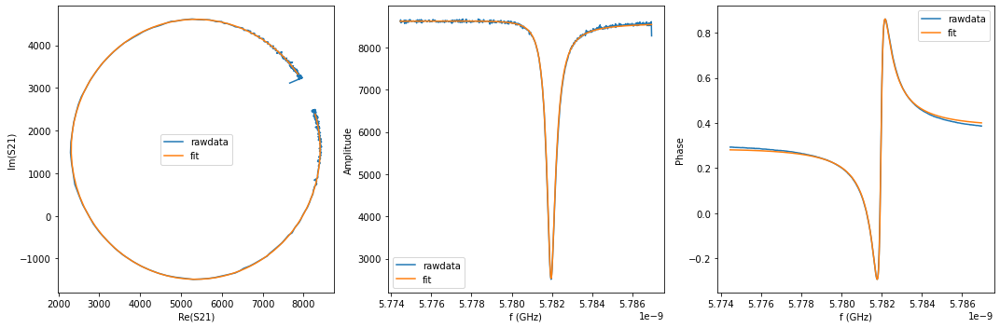

{'Qi_dia_corr': 27495.788635033558, 'Qi_no_corr': 27804.702364845318, 'absQc': 11488.958417691172, 'Qc_dia_corr(Re{Qc})': 11542.542391235293, 'Ql': 8129.735507564645, 'fr': 5.781935285396172, 'theta0': -3.0452039758517166, 'phi0': 0.0963939707084086, 'phi0_err': 0.004545463844314205, 'Ql_err': 51.63301999259175, 'absQc_err': 24.85797362178939, 'fr_err': 1.8385696487093936e-06, 'chi_square': 6.105330920799233e-05, 'Qi_no_corr_err': 598.7091146544649, 'Qi_dia_corr_err': 589.584310575031, 'delay': -0.46427349669651635, 'a': 8598.63536191892, 'alpha': 2.3189414038249754}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


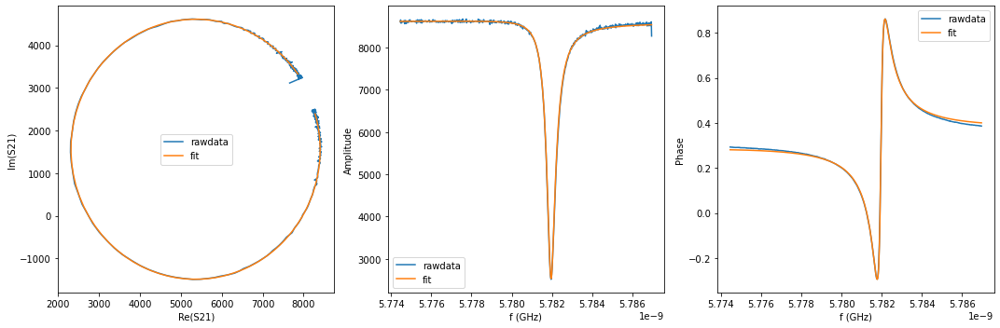

{'Qi_dia_corr': 27510.20197001413, 'Qi_no_corr': 27823.78618486103, 'absQc': 11481.24124141365, 'Qc_dia_corr(Re{Qc})': 11535.499949760491, 'Ql': 8127.499771806656, 'fr': 5.781934474253907, 'theta0': -3.0445691352501334, 'phi0': 0.09702907462275731, 'phi0_err': 0.00457869378382409, 'Ql_err': 48.690636884310614, 'absQc_err': 24.306830395064207, 'fr_err': 1.8386466321871172e-06, 'chi_square': 5.971968070153883e-05, 'Qi_no_corr_err': 559.7332970038698, 'Qi_dia_corr_err': 549.325245154516, 'delay': -0.4619316646534031, 'a': 8598.986688713268, 'alpha': 2.4041084109655277}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


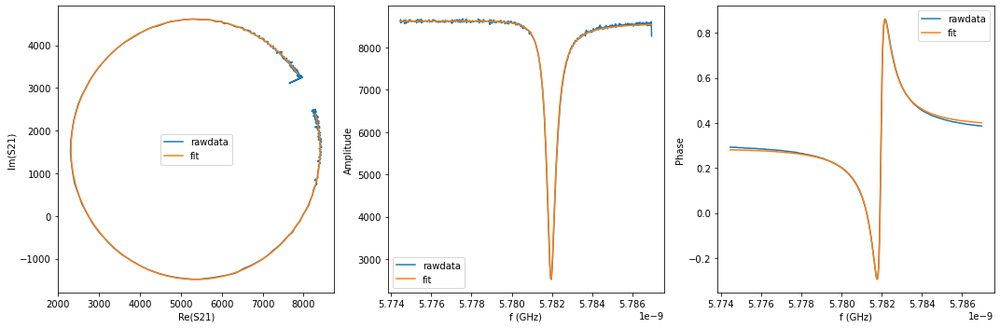

{'Qi_dia_corr': 27521.565598416764, 'Qi_no_corr': 27833.577084151162, 'absQc': 11498.883139459678, 'Qc_dia_corr(Re{Qc})': 11552.993272607138, 'Ql': 8137.173429382166, 'fr': 5.781934112849402, 'theta0': -3.0447760829994066, 'phi0': 0.09682258902607943, 'phi0_err': 0.0046789677661456695, 'Ql_err': 53.74323104685471, 'absQc_err': 25.091877115264097, 'fr_err': 1.8735695348439783e-06, 'chi_square': 6.251830586625532e-05, 'Qi_no_corr_err': 623.1672884079111, 'Qi_dia_corr_err': 613.911878249309, 'delay': -0.47340479024860166, 'a': 8599.784740196214, 'alpha': 1.987357199403032}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


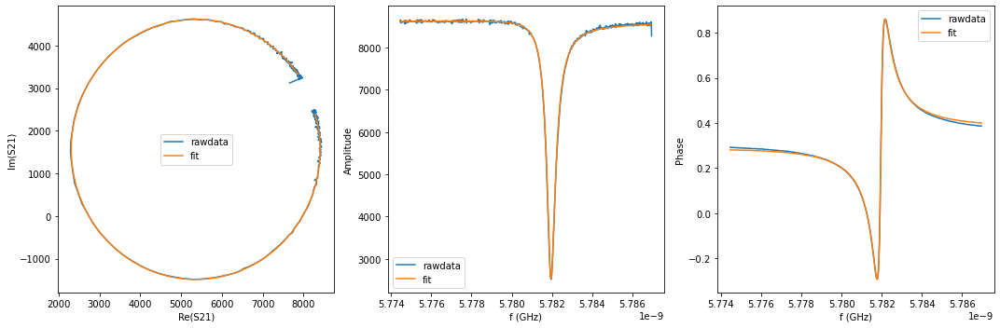

{'Qi_dia_corr': 27525.36661944529, 'Qi_no_corr': 27830.033600075647, 'absQc': 11487.223189091801, 'Qc_dia_corr(Re{Qc})': 11539.945856694781, 'Ql': 8131.030326919266, 'fr': 5.781934389280398, 'theta0': -3.0459713748863595, 'phi0': 0.09562628542957081, 'phi0_err': 0.00431739635885362, 'Ql_err': 49.703304457880925, 'absQc_err': 24.648215053239895, 'fr_err': 1.7558470280513905e-06, 'chi_square': 5.873920351855979e-05, 'Qi_no_corr_err': 575.9228912303198, 'Qi_dia_corr_err': 568.1377735189, 'delay': -0.46237755746633896, 'a': 8600.366633840578, 'alpha': 2.387947852870178}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


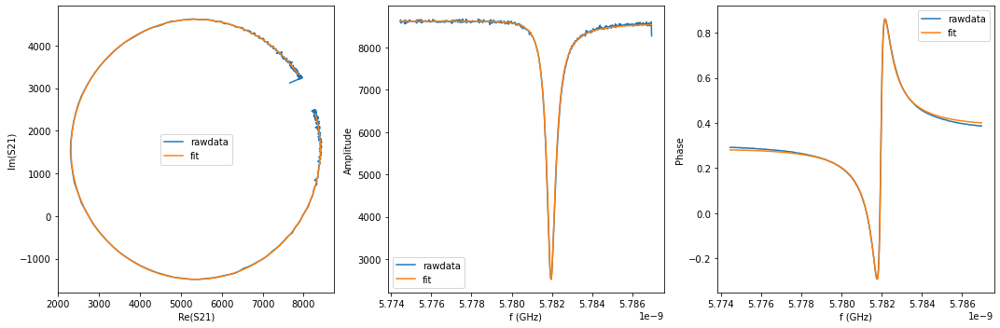

{'Qi_dia_corr': 27511.065677034712, 'Qi_no_corr': 27817.246170756553, 'absQc': 11477.169245607947, 'Qc_dia_corr(Re{Qc})': 11530.114173995198, 'Ql': 8124.901181646097, 'fr': 5.781933735337866, 'theta0': -3.0457289269401873, 'phi0': 0.09586867000045518, 'phi0_err': 0.004439245200985066, 'Ql_err': 57.66732927451106, 'absQc_err': 24.85822433546065, 'fr_err': 1.7981838174360657e-06, 'chi_square': 5.90553197981687e-05, 'Qi_no_corr_err': 678.4051091445137, 'Qi_dia_corr_err': 672.006767514508, 'delay': -0.4620158696528804, 'a': 8601.889473767078, 'alpha': 2.401158719502123}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


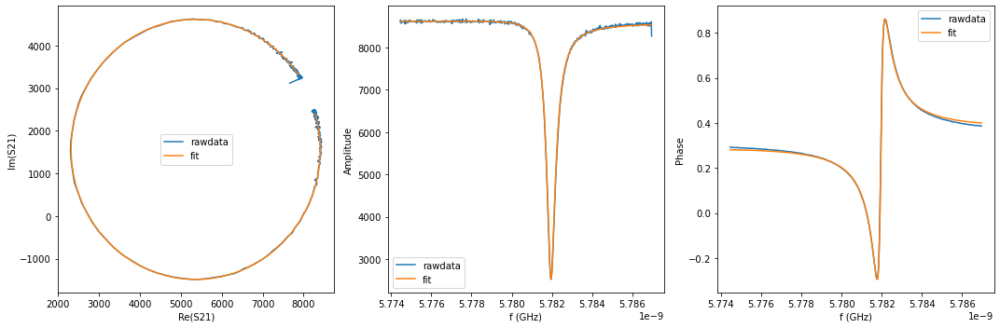

{'Qi_dia_corr': 27474.793064842477, 'Qi_no_corr': 27781.372075147843, 'absQc': 11471.74829022148, 'Qc_dia_corr(Re{Qc})': 11524.851312271652, 'Ql': 8119.122878298735, 'fr': 5.781933247907676, 'theta0': -3.0455640129669512, 'phi0': 0.09603374163505726, 'phi0_err': 0.003986810686336292, 'Ql_err': 50.28488814834217, 'absQc_err': 23.814279203282062, 'fr_err': 1.6081985593411824e-06, 'chi_square': 5.389235836409868e-05, 'Qi_no_corr_err': 579.6738801697675, 'Qi_dia_corr_err': 573.9211307751558, 'delay': -0.4451176791221844, 'a': 8601.895134466358, 'alpha': 3.0146591056729943}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


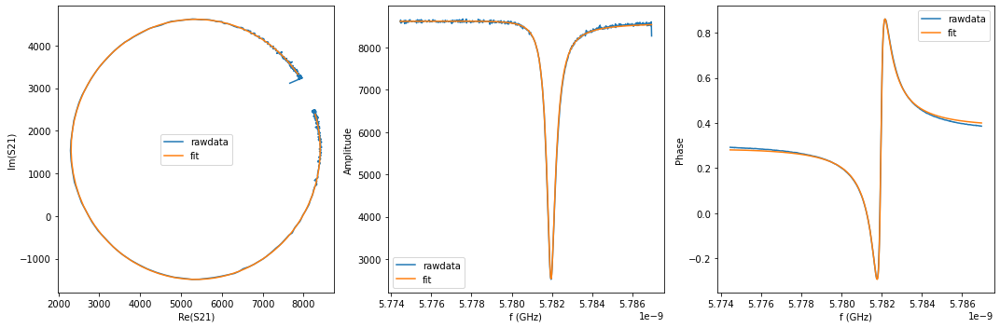

{'Qi_dia_corr': 27508.94083614828, 'Qi_no_corr': 27813.977770562473, 'absQc': 11478.85526724027, 'Qc_dia_corr(Re{Qc})': 11531.627398816303, 'Ql': 8125.467179405462, 'fr': 5.7819328034385205, 'theta0': -3.0458924592574568, 'phi0': 0.09570569386327417, 'phi0_err': 0.0041729629311684745, 'Ql_err': 51.068407767216534, 'absQc_err': 25.03213213301463, 'fr_err': 1.698755582277059e-06, 'chi_square': 5.779867912731536e-05, 'Qi_no_corr_err': 595.7464508605166, 'Qi_dia_corr_err': 591.7328030379396, 'delay': -0.46124199686828776, 'a': 8603.786665806036, 'alpha': 2.4292521912224476}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


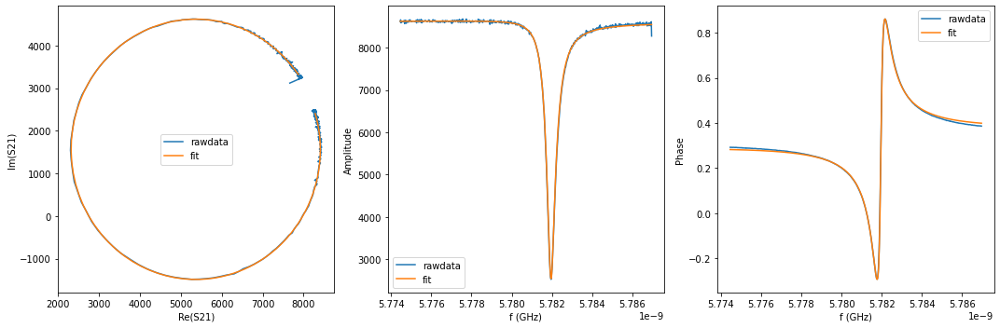

{'Qi_dia_corr': 27425.368924937695, 'Qi_no_corr': 27727.782035659973, 'absQc': 11458.358374274483, 'Qc_dia_corr(Re{Qc})': 11510.81028374834, 'Ql': 8107.837622299109, 'fr': 5.781932488829452, 'theta0': -3.0460966236113647, 'phi0': 0.09550096359025963, 'phi0_err': 0.0038002920556741903, 'Ql_err': 47.40417209082598, 'absQc_err': 24.248179419816918, 'fr_err': 1.5492217339059226e-06, 'chi_square': 5.119602731733846e-05, 'Qi_no_corr_err': 548.2995695557715, 'Qi_dia_corr_err': 547.6075803000563, 'delay': -0.4264117341248858, 'a': 8605.398465928316, 'alpha': -2.588920313242309}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


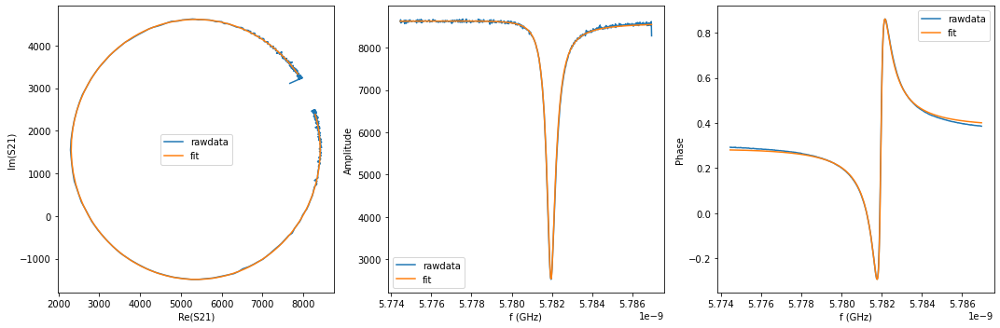

{'Qi_dia_corr': 27483.060069833282, 'Qi_no_corr': 27793.22159393656, 'absQc': 11487.898766880906, 'Qc_dia_corr(Re{Qc})': 11541.737612783956, 'Ql': 8128.22325696993, 'fr': 5.781931573129824, 'theta0': -3.0449710112011545, 'phi0': 0.09662649719606049, 'phi0_err': 0.004341821093148946, 'Ql_err': 49.71888559968254, 'absQc_err': 25.877550379540928, 'fr_err': 1.7882326399754745e-06, 'chi_square': 6.252624983613292e-05, 'Qi_no_corr_err': 575.0096947278682, 'Qi_dia_corr_err': 569.9663050062668, 'delay': -0.47599749860344137, 'a': 8604.51591160758, 'alpha': 1.8932046300859338}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


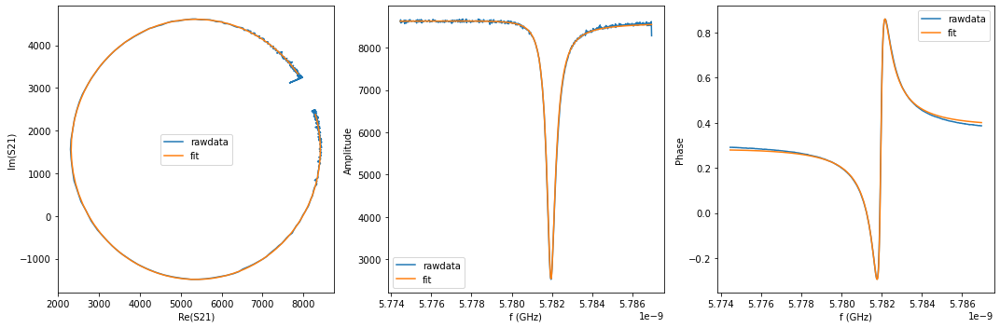

{'Qi_dia_corr': 27483.96351629615, 'Qi_no_corr': 27797.797929377037, 'absQc': 11495.174803912016, 'Qc_dia_corr(Re{Qc})': 11549.712597529822, 'Ql': 8132.256842234219, 'fr': 5.781930765670601, 'theta0': -3.044379034661916, 'phi0': 0.09721857127125151, 'phi0_err': 0.0045694402596219985, 'Ql_err': 50.80794096110122, 'absQc_err': 25.97285175486313, 'fr_err': 1.8415863857126416e-06, 'chi_square': 6.49224020768659e-05, 'Qi_no_corr_err': 580.6053043449801, 'Qi_dia_corr_err': 576.5269821415525, 'delay': -0.48964923337584026, 'a': 8605.162634462113, 'alpha': 1.3969925513044636}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


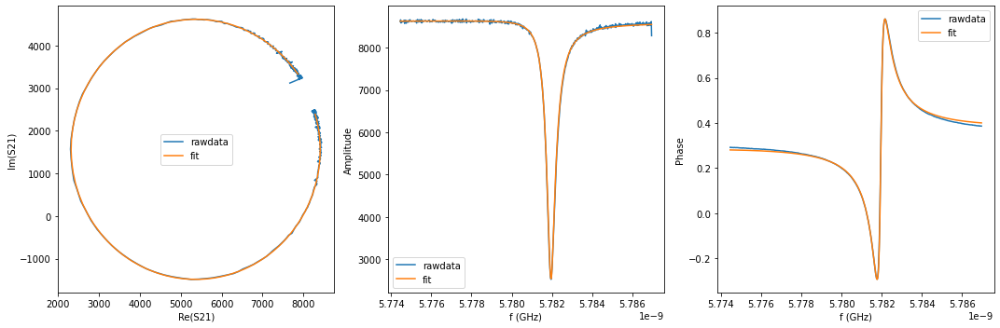

{'Qi_dia_corr': 27449.81827861116, 'Qi_no_corr': 27756.65172203578, 'absQc': 11476.28710823207, 'Qc_dia_corr(Re{Qc})': 11529.572819280773, 'Ql': 8119.28226186139, 'fr': 5.781930845536279, 'theta0': -3.0454178092972226, 'phi0': 0.09617920377508289, 'phi0_err': 0.004281792922411838, 'Ql_err': 56.360665910484904, 'absQc_err': 25.689359935821127, 'fr_err': 1.7298969153512195e-06, 'chi_square': 5.9024055863266835e-05, 'Qi_no_corr_err': 648.3626905513281, 'Qi_dia_corr_err': 648.4519405422737, 'delay': -0.4661914953728405, 'a': 8606.586279464262, 'alpha': 2.2491832755513057}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


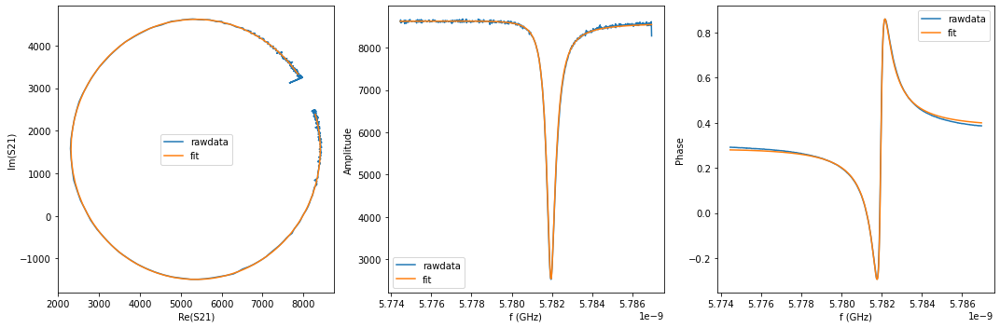

{'Qi_dia_corr': 27478.871221782745, 'Qi_no_corr': 27787.258555886085, 'absQc': 11481.995721549556, 'Qc_dia_corr(Re{Qc})': 11535.489756897485, 'Ql': 8124.7578983338435, 'fr': 5.7819302785931335, 'theta0': -3.045254662969402, 'phi0': 0.09634243818244184, 'phi0_err': 0.00446957991213769, 'Ql_err': 57.971107483350394, 'absQc_err': 25.96393638875665, 'fr_err': 1.7854316017599004e-06, 'chi_square': 6.235419224765857e-05, 'Qi_no_corr_err': 669.8482064772444, 'Qi_dia_corr_err': 668.4964548792016, 'delay': -0.46885942701591116, 'a': 8607.387922230451, 'alpha': 2.15196155873509}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


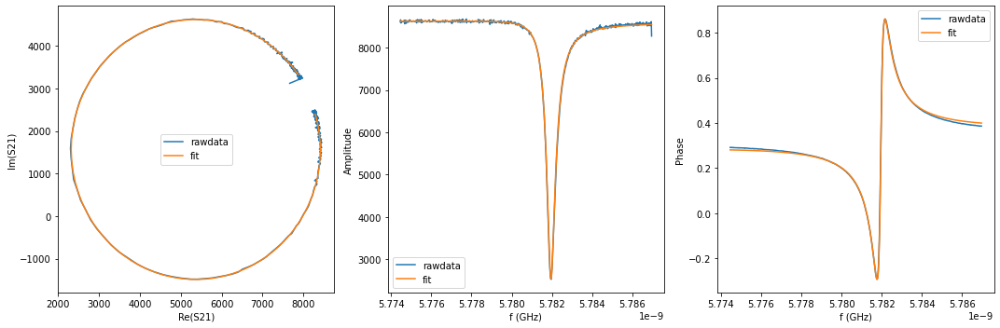

{'Qi_dia_corr': 27440.91218022699, 'Qi_no_corr': 27741.90299283069, 'absQc': 11474.706327093845, 'Qc_dia_corr(Re{Qc})': 11527.003286966708, 'Ql': 8117.228779279651, 'fr': 5.781930161492345, 'theta0': -3.046304061010141, 'phi0': 0.09529263670889054, 'phi0_err': 0.00425285436023902, 'Ql_err': 58.661453400586, 'absQc_err': 25.292638330449925, 'fr_err': 1.7125232734979664e-06, 'chi_square': 5.8244248857451214e-05, 'Qi_no_corr_err': 681.0519603144938, 'Qi_dia_corr_err': 679.1372798042445, 'delay': -0.4542116174066188, 'a': 8607.734432712457, 'alpha': 2.68409554938672}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


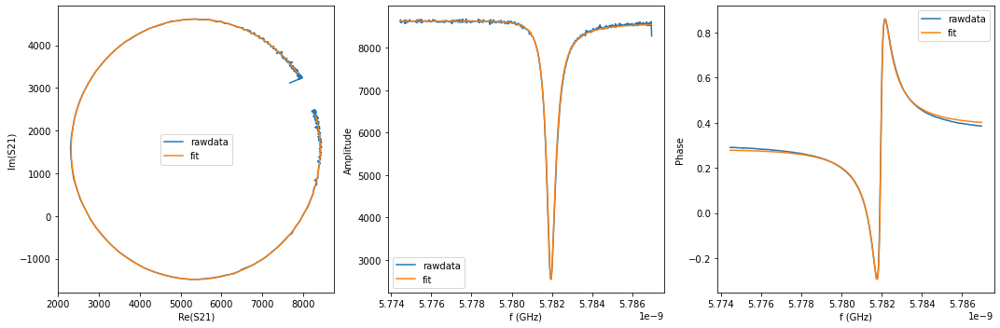

{'Qi_dia_corr': 27549.84637523747, 'Qi_no_corr': 27863.383115942732, 'absQc': 11520.76378571367, 'Qc_dia_corr(Re{Qc})': 11575.232409613585, 'Ql': 8150.676868822006, 'fr': 5.781928889538502, 'theta0': -3.044547199952409, 'phi0': 0.09704960873129682, 'phi0_err': 0.0050823057756745164, 'Ql_err': 65.48631571414057, 'absQc_err': 28.18851181702473, 'fr_err': 2.0210361064173332e-06, 'chi_square': 7.491485028083453e-05, 'Qi_no_corr_err': 763.7455052780182, 'Qi_dia_corr_err': 759.4475081911037, 'delay': -0.5167671394424894, 'a': 8606.872237981626, 'alpha': 0.4119196096357296}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


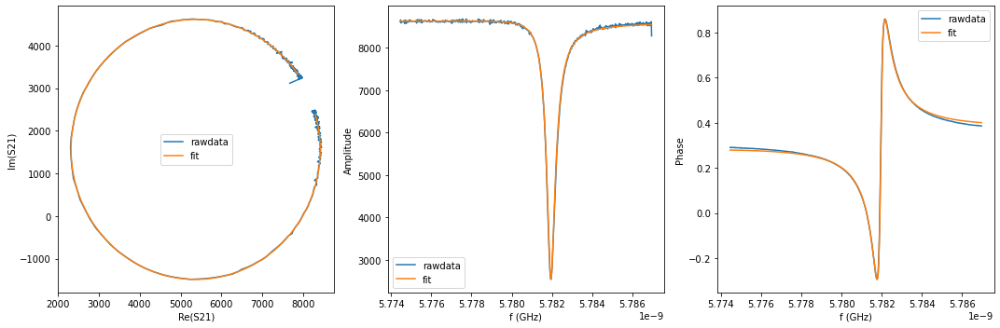

{'Qi_dia_corr': 27481.939873774067, 'Qi_no_corr': 27793.339771583513, 'absQc': 11498.126871909162, 'Qc_dia_corr(Re{Qc})': 11552.280200293015, 'Ql': 8133.352460149827, 'fr': 5.781928267189373, 'theta0': -3.044732359053486, 'phi0': 0.09686424920108606, 'phi0_err': 0.004661080580605498, 'Ql_err': 63.39061171963369, 'absQc_err': 27.186224322184486, 'fr_err': 1.850616956666701e-06, 'chi_square': 6.61954562405599e-05, 'Qi_no_corr_err': 731.9194905795277, 'Qi_dia_corr_err': 731.9476544526648, 'delay': -0.48830950793089783, 'a': 8608.91399862986, 'alpha': 1.4456421695126984}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


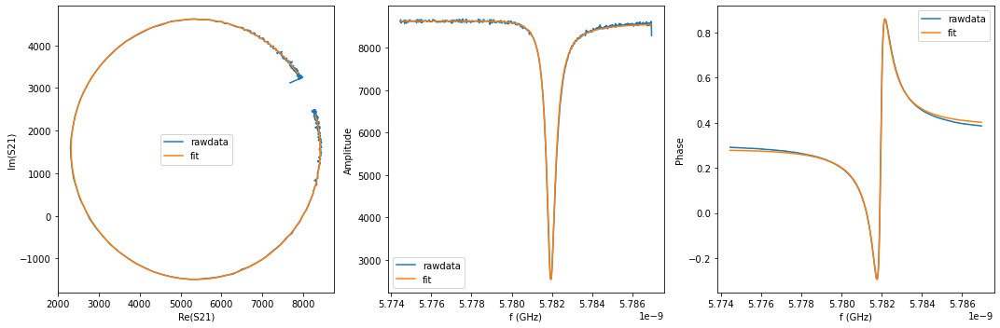

{'Qi_dia_corr': 27531.113351222026, 'Qi_no_corr': 27849.272072448886, 'absQc': 11523.675725738325, 'Qc_dia_corr(Re{Qc})': 11579.045147232147, 'Ql': 8150.925915065404, 'fr': 5.7819273723686315, 'theta0': -3.043764022623579, 'phi0': 0.09783332875524511, 'phi0_err': 0.005254096346080708, 'Ql_err': 58.08843836970049, 'absQc_err': 28.760245993268622, 'fr_err': 2.121061550084404e-06, 'chi_square': 8.054418953489415e-05, 'Qi_no_corr_err': 669.1280078189262, 'Qi_dia_corr_err': 662.0531607305893, 'delay': -0.5311872165600828, 'a': 8609.066501419697, 'alpha': -0.1116585417046357}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


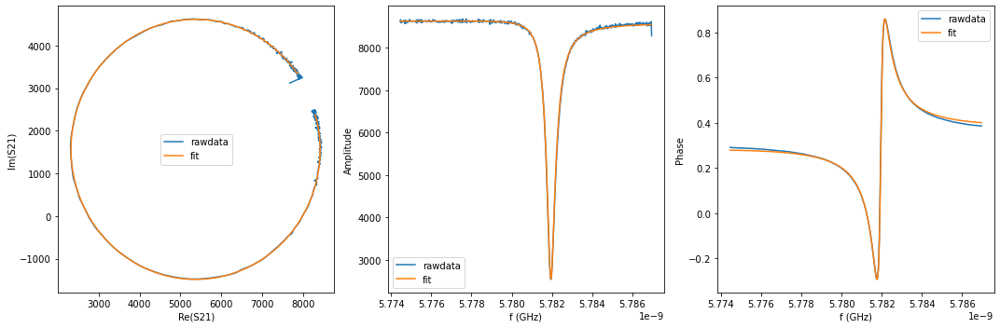

{'Qi_dia_corr': 27420.200753856698, 'Qi_no_corr': 27729.4702836309, 'absQc': 11482.236309041804, 'Qc_dia_corr(Re{Qc})': 11536.11424621837, 'Ql': 8119.930454154208, 'fr': 5.7819271565861206, 'theta0': -3.044911763431431, 'phi0': 0.09668517212155593, 'phi0_err': 0.004931821392859961, 'Ql_err': 68.11359767298515, 'absQc_err': 26.7537938034431, 'fr_err': 1.932892768521666e-06, 'chi_square': 6.767716665365653e-05, 'Qi_no_corr_err': 788.4187471833625, 'Qi_dia_corr_err': 787.1101998969638, 'delay': -0.49425582297213977, 'a': 8610.540144844796, 'alpha': 1.2293460693910967}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


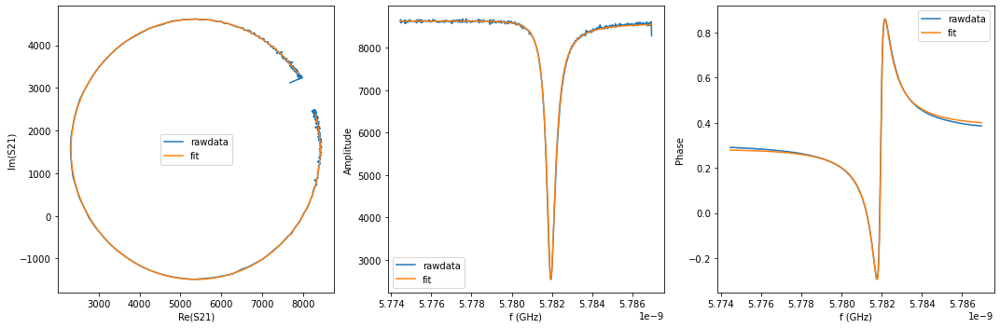

{'Qi_dia_corr': 27465.502293822206, 'Qi_no_corr': 27775.417606082327, 'absQc': 11501.687599115685, 'Qc_dia_corr(Re{Qc})': 11555.68241394407, 'Ql': 8133.59779370548, 'fr': 5.7819266642978455, 'theta0': -3.0448888383024726, 'phi0': 0.09670801704292319, 'phi0_err': 0.004727353651551385, 'Ql_err': 61.70975446199739, 'absQc_err': 27.610898364650925, 'fr_err': 1.8796912204527697e-06, 'chi_square': 6.828278356834365e-05, 'Qi_no_corr_err': 704.9203829211777, 'Qi_dia_corr_err': 706.0535046871535, 'delay': -0.4910437098656289, 'a': 8610.933256836799, 'alpha': 1.345928871462964}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


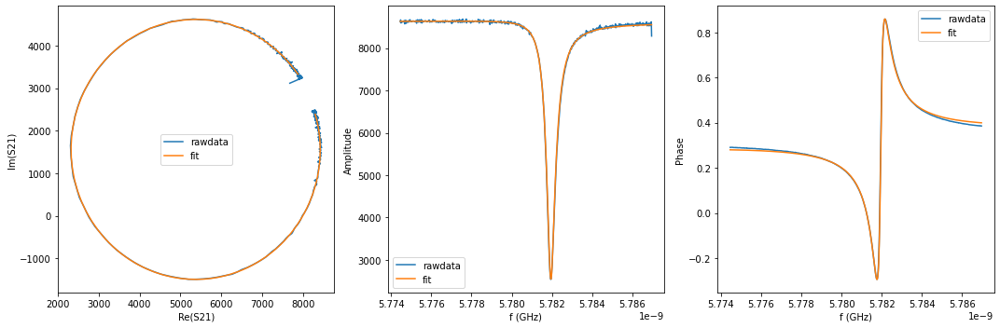

{'Qi_dia_corr': 27416.558171789056, 'Qi_no_corr': 27727.136279490533, 'absQc': 11472.167751962328, 'Qc_dia_corr(Re{Qc})': 11526.191437227151, 'Ql': 8114.694037032027, 'fr': 5.781926035518178, 'theta0': -3.0447391473269594, 'phi0': 0.09685765770729535, 'phi0_err': 0.004497319547023292, 'Ql_err': 64.6666233013006, 'absQc_err': 24.910146937973526, 'fr_err': 1.764028734309888e-06, 'chi_square': 6.0281356631280945e-05, 'Qi_no_corr_err': 737.8938877303426, 'Qi_dia_corr_err': 734.3114829767325, 'delay': -0.46334320429989484, 'a': 8613.223112003834, 'alpha': 2.3521028061362297}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


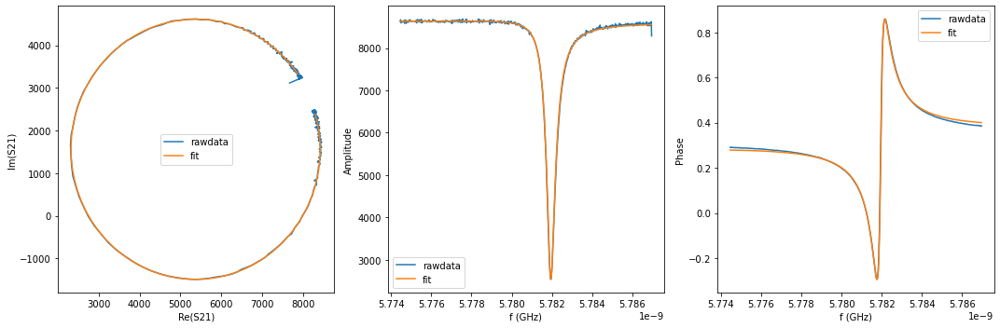

{'Qi_dia_corr': 27433.83994724483, 'Qi_no_corr': 27746.151496033533, 'absQc': 11489.116597939275, 'Qc_dia_corr(Re{Qc})': 11543.532276449576, 'Ql': 8124.801617730916, 'fr': 5.781925325904957, 'theta0': -3.0444612827791846, 'phi0': 0.09713559677968853, 'phi0_err': 0.0046627587626313985, 'Ql_err': 66.04835813867162, 'absQc_err': 26.90654266548221, 'fr_err': 1.859698412906647e-06, 'chi_square': 6.779603838797796e-05, 'Qi_no_corr_err': 754.0529167849942, 'Qi_dia_corr_err': 751.3762469799209, 'delay': -0.4933926274616638, 'a': 8613.421005621942, 'alpha': 1.2604402696196548}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


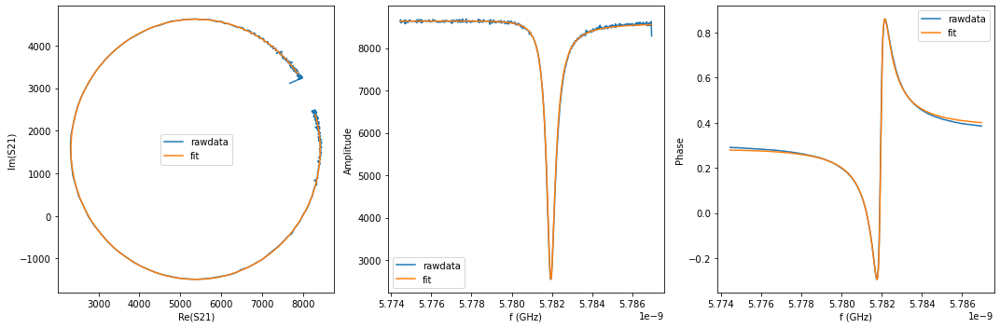

{'Qi_dia_corr': 27443.415999830686, 'Qi_no_corr': 27753.684356050933, 'absQc': 11486.326234037406, 'Qc_dia_corr(Re{Qc})': 11540.324253326213, 'Ql': 8124.051648207867, 'fr': 5.781924828961729, 'theta0': -3.0448213361394463, 'phi0': 0.09677527044342195, 'phi0_err': 0.004818326839637404, 'Ql_err': 73.78012589910136, 'absQc_err': 26.573919667233277, 'fr_err': 1.9018486021402463e-06, 'chi_square': 6.71416332215155e-05, 'Qi_no_corr_err': 855.5418447031475, 'Qi_dia_corr_err': 851.2889361759223, 'delay': -0.49263476729825884, 'a': 8615.311586229109, 'alpha': 1.2882297173528028}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


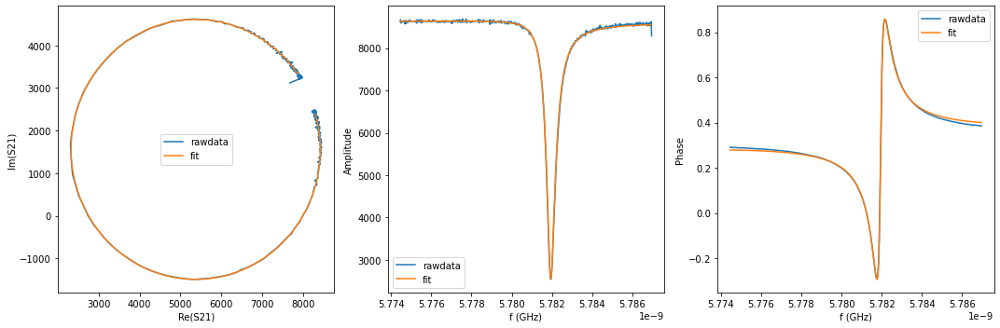

{'Qi_dia_corr': 27435.870886328306, 'Qi_no_corr': 27752.626143735888, 'absQc': 11490.507645314074, 'Qc_dia_corr(Re{Qc})': 11545.697645099666, 'Ql': 8126.052434964331, 'fr': 5.781923766888172, 'theta0': -3.043780720776983, 'phi0': 0.0978156295948182, 'phi0_err': 0.004992801407372041, 'Ql_err': 74.32666705753019, 'absQc_err': 26.66594262374715, 'fr_err': 1.948035633109324e-06, 'chi_square': 6.950384942275452e-05, 'Qi_no_corr_err': 850.7303443484979, 'Qi_dia_corr_err': 846.4980152697696, 'delay': -0.48992038848615577, 'a': 8614.730674714812, 'alpha': 1.3866327611806508}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


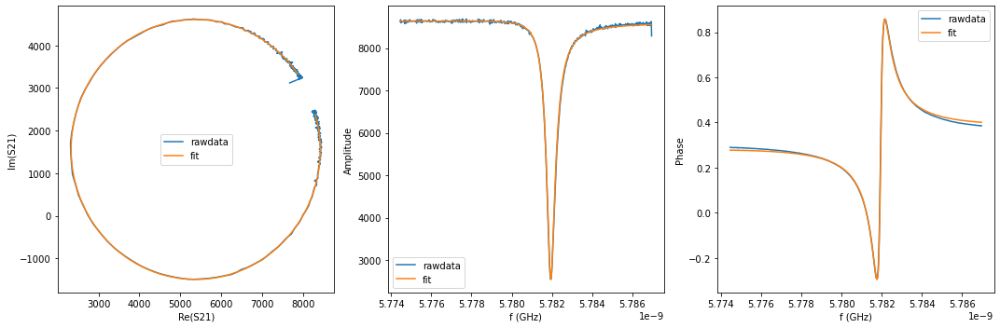

{'Qi_dia_corr': 27461.97845072853, 'Qi_no_corr': 27781.914306525403, 'absQc': 11509.291540374566, 'Qc_dia_corr(Re{Qc})': 11565.1086358339, 'Ql': 8137.957194529114, 'fr': 5.781922828969467, 'theta0': -3.043309329685035, 'phi0': 0.09828756636529935, 'phi0_err': 0.005256353315984998, 'Ql_err': 72.26983304425617, 'absQc_err': 28.150670921281034, 'fr_err': 2.083214519613787e-06, 'chi_square': 7.567132413651755e-05, 'Qi_no_corr_err': 834.7866440634355, 'Qi_dia_corr_err': 832.2481532494689, 'delay': -0.5135267094329622, 'a': 8615.411205115719, 'alpha': 0.5289422517479131}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


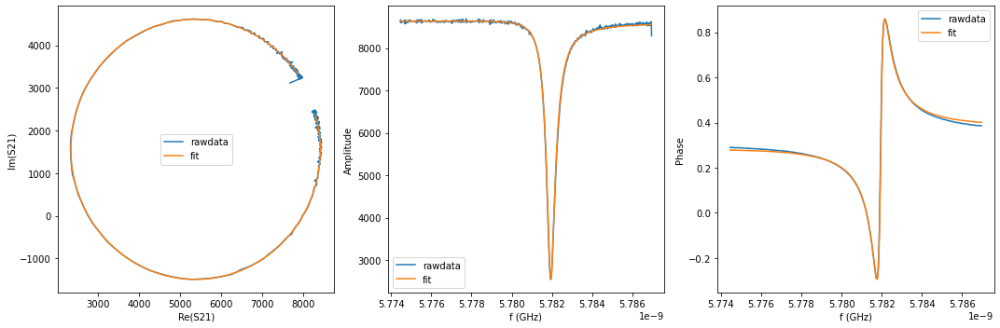

{'Qi_dia_corr': 27460.497453282827, 'Qi_no_corr': 27778.999463274948, 'absQc': 11506.39693527067, 'Qc_dia_corr(Re{Qc})': 11561.94352146733, 'Ql': 8136.2598724075915, 'fr': 5.781922349619051, 'theta0': -3.043533847803895, 'phi0': 0.0980623480314237, 'phi0_err': 0.005049967286834668, 'Ql_err': 77.83403686921963, 'absQc_err': 27.81727681753887, 'fr_err': 1.9757764131209716e-06, 'chi_square': 7.41233286230905e-05, 'Qi_no_corr_err': 889.617477883824, 'Qi_dia_corr_err': 884.8559928507683, 'delay': -0.5112694776553948, 'a': 8615.824436880073, 'alpha': 0.6109533078493806}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


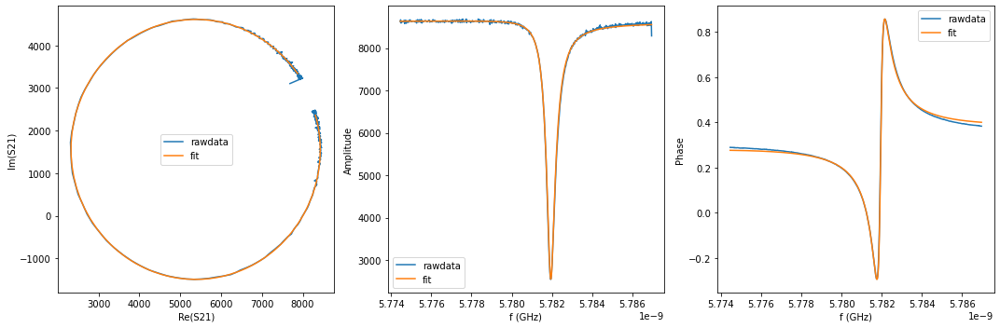

{'Qi_dia_corr': 27456.540394937136, 'Qi_no_corr': 27773.499798836045, 'absQc': 11514.54801092952, 'Qc_dia_corr(Re{Qc})': 11569.921837713773, 'Ql': 8139.862240387232, 'fr': 5.7819217977715915, 'theta0': -3.043720619634776, 'phi0': 0.09787582101995712, 'phi0_err': 0.005413505310825742, 'Ql_err': 79.13417406939264, 'absQc_err': 29.074629153944823, 'fr_err': 2.1067535373797776e-06, 'chi_square': 8.080756363808556e-05, 'Qi_no_corr_err': 906.686260154204, 'Qi_dia_corr_err': 903.6963395957057, 'delay': -0.5238068458556842, 'a': 8616.481505094047, 'alpha': 0.15523869159365875}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


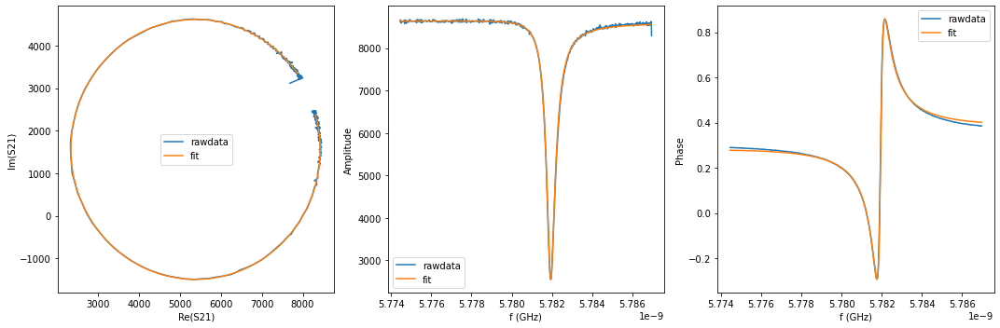

{'Qi_dia_corr': 27458.95447422953, 'Qi_no_corr': 27776.717473301993, 'absQc': 11512.625677521848, 'Qc_dia_corr(Re{Qc})': 11568.110630809306, 'Ql': 8139.177832340546, 'fr': 5.781921180650478, 'theta0': -3.0436144819589876, 'phi0': 0.09798173667965931, 'phi0_err': 0.005324814863311195, 'Ql_err': 84.73864641414322, 'absQc_err': 28.294062702519543, 'fr_err': 2.067108134083594e-06, 'chi_square': 7.749107598201644e-05, 'Qi_no_corr_err': 976.9066046027436, 'Qi_dia_corr_err': 971.236231622365, 'delay': -0.5220521805646688, 'a': 8617.108231508915, 'alpha': 0.21933455613485942}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


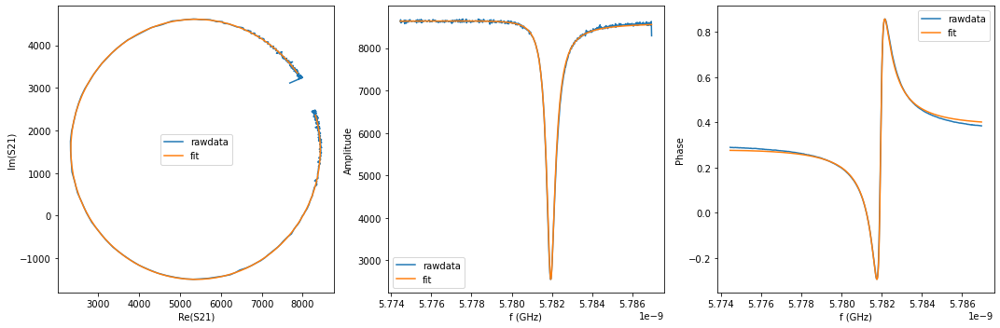

{'Qi_dia_corr': 27470.12058794921, 'Qi_no_corr': 27795.424698640327, 'absQc': 11522.192301608842, 'Qc_dia_corr(Re{Qc})': 11579.033483575666, 'Ql': 8145.5655992730235, 'fr': 5.781919804460192, 'theta0': -3.042470348889224, 'phi0': 0.09912614453704549, 'phi0_err': 0.00573562012499865, 'Ql_err': 81.16966098234859, 'absQc_err': 29.618328941542206, 'fr_err': 2.2124705471868186e-06, 'chi_square': 8.590903352699405e-05, 'Qi_no_corr_err': 933.8213729544526, 'Qi_dia_corr_err': 929.6334626565143, 'delay': -0.5447764254995455, 'a': 8617.601963551788, 'alpha': -0.60604787158392}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


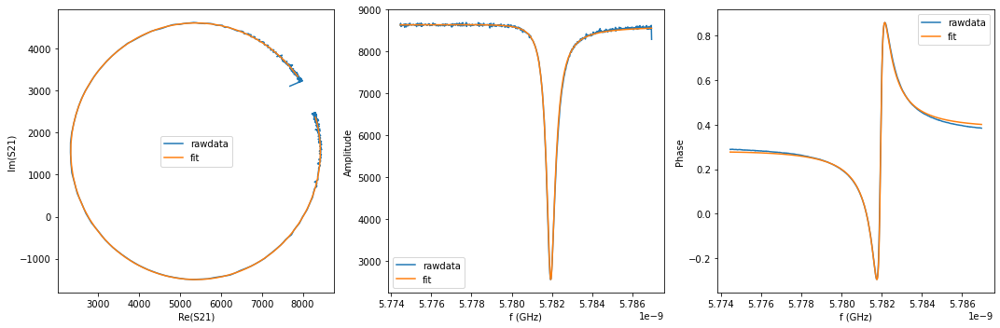

{'Qi_dia_corr': 27456.050076323576, 'Qi_no_corr': 27777.222912820318, 'absQc': 11514.489127631814, 'Qc_dia_corr(Re{Qc})': 11570.595515642955, 'Ql': 8140.1525822083895, 'fr': 5.781919468211823, 'theta0': -3.0430774763647643, 'phi0': 0.0985187621596351, 'phi0_err': 0.005572048992189321, 'Ql_err': 91.7274830107823, 'absQc_err': 28.284330378036294, 'fr_err': 2.1660872197811006e-06, 'chi_square': 7.950042532009709e-05, 'Qi_no_corr_err': 1057.6204734265004, 'Qi_dia_corr_err': 1049.874871222025, 'delay': -0.5215936228023834, 'a': 8618.803379856408, 'alpha': 0.23574942563809642}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


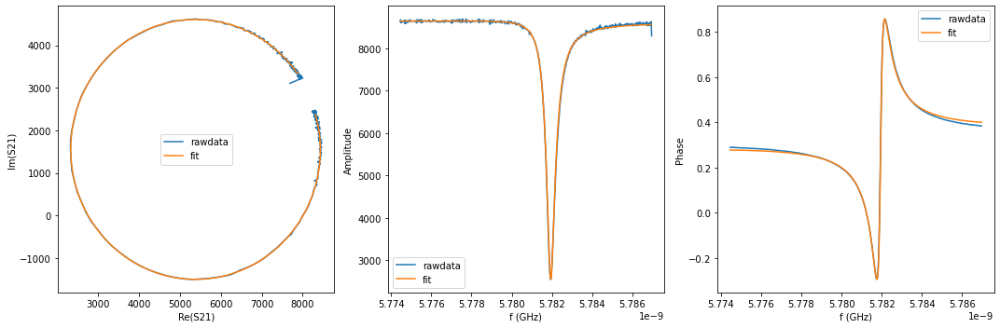

{'Qi_dia_corr': 27420.946315835576, 'Qi_no_corr': 27743.27955517864, 'absQc': 11492.931775605044, 'Qc_dia_corr(Re{Qc})': 11549.17193353437, 'Ql': 8126.462987751417, 'fr': 5.78191852690489, 'theta0': -3.042868447374877, 'phi0': 0.0987277490615261, 'phi0_err': 0.005410590764625601, 'Ql_err': 90.25313665316038, 'absQc_err': 27.624181088310923, 'fr_err': 2.0901551960075395e-06, 'chi_square': 7.634917049257074e-05, 'Qi_no_corr_err': 1044.5508376811456, 'Qi_dia_corr_err': 1035.6025062332317, 'delay': -0.506385908257475, 'a': 8620.117774884444, 'alpha': 0.7879172092617815}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


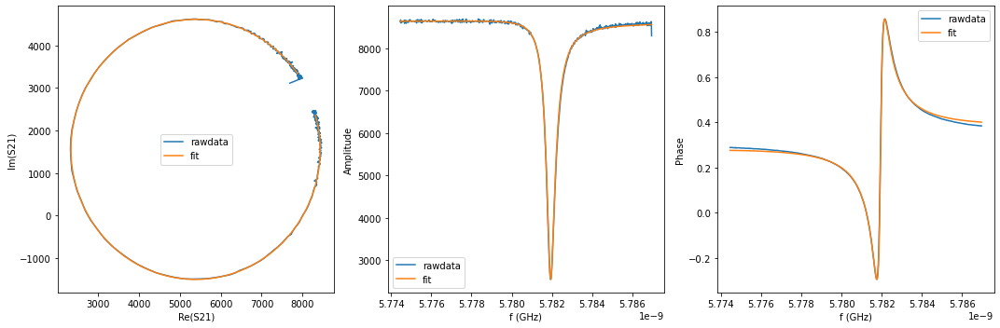

{'Qi_dia_corr': 27449.3747708081, 'Qi_no_corr': 27769.068209488483, 'absQc': 11516.04314931062, 'Qc_dia_corr(Re{Qc})': 11571.935095412558, 'Ql': 8140.228617297593, 'fr': 5.781917981370689, 'theta0': -3.043271614796711, 'phi0': 0.098324461378114, 'phi0_err': 0.005703740722688177, 'Ql_err': 94.55471133077245, 'absQc_err': 28.777380754065405, 'fr_err': 2.206833107655776e-06, 'chi_square': 8.272690800087113e-05, 'Qi_no_corr_err': 1098.424689833577, 'Qi_dia_corr_err': 1088.1761704585938, 'delay': -0.5359431455013193, 'a': 8620.815947437632, 'alpha': -0.28566030987350427}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


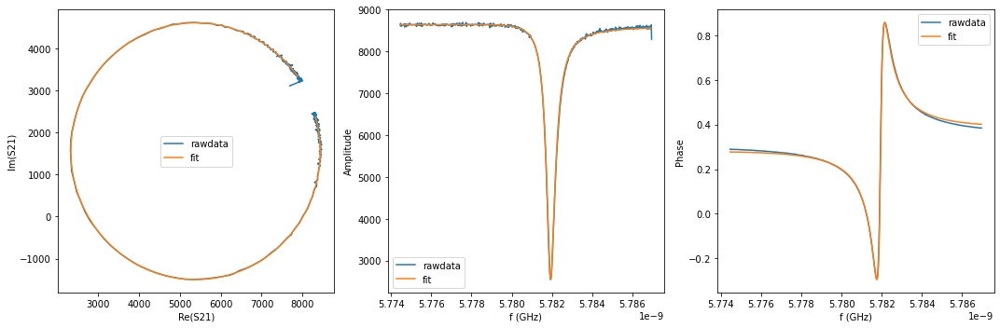

{'Qi_dia_corr': 27423.86058357328, 'Qi_no_corr': 27746.041679778325, 'absQc': 11510.029013687303, 'Qc_dia_corr(Re{Qc})': 11566.398620048198, 'Ql': 8135.244794186301, 'fr': 5.781917207586007, 'theta0': -3.0428282531632633, 'phi0': 0.09876770423626098, 'phi0_err': 0.005572578919591817, 'Ql_err': 84.49724820997172, 'absQc_err': 28.333284182204576, 'fr_err': 2.183416205531357e-06, 'chi_square': 8.112373412987096e-05, 'Qi_no_corr_err': 972.3213413911756, 'Qi_dia_corr_err': 963.1332936071617, 'delay': -0.522547791050412, 'a': 8622.163390122276, 'alpha': 0.20098564325717758}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


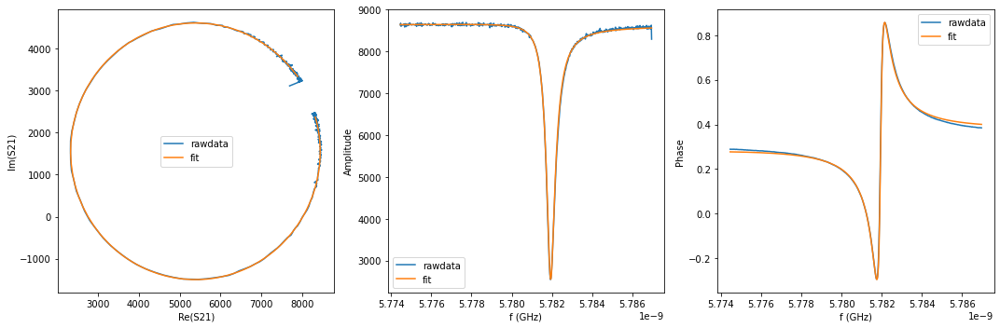

{'Qi_dia_corr': 27368.040108689613, 'Qi_no_corr': 27689.163689035264, 'absQc': 11491.240023607168, 'Qc_dia_corr(Re{Qc})': 11547.470585291592, 'Ql': 8120.968541755569, 'fr': 5.781916339483823, 'theta0': -3.042869343658093, 'phi0': 0.09872659696515824, 'phi0_err': 0.005401763048805701, 'Ql_err': 89.12596594775376, 'absQc_err': 27.851687045105162, 'fr_err': 2.1096606645065684e-06, 'chi_square': 7.655389926078256e-05, 'Qi_no_corr_err': 1033.046132582029, 'Qi_dia_corr_err': 1024.9839457177893, 'delay': -0.5110534024925929, 'a': 8624.263902387773, 'alpha': 0.6183757154352646}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


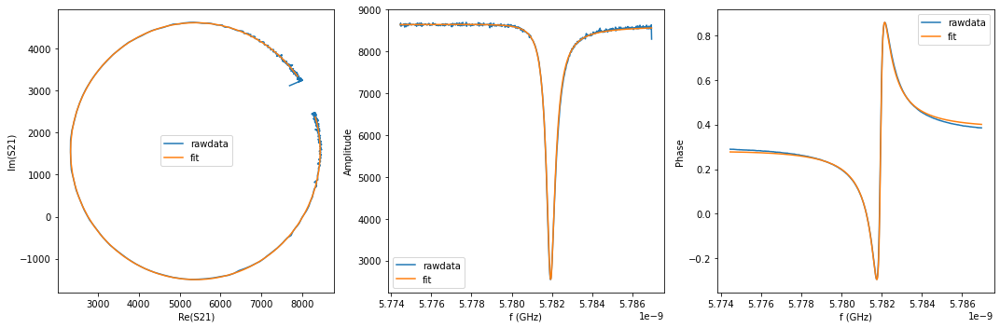

{'Qi_dia_corr': 27427.12761371371, 'Qi_no_corr': 27746.696970274064, 'absQc': 11507.092751312111, 'Qc_dia_corr(Re{Qc})': 11562.966575096943, 'Ql': 8133.8341557354415, 'fr': 5.7819157455116015, 'theta0': -3.043249104048171, 'phi0': 0.0983466555495925, 'phi0_err': 0.0055481709138501135, 'Ql_err': 88.2672263018812, 'absQc_err': 28.37364756638523, 'fr_err': 2.1472206376317097e-06, 'chi_square': 8.01156028306117e-05, 'Qi_no_corr_err': 1015.9476604343993, 'Qi_dia_corr_err': 1008.6540566467067, 'delay': -0.5161288647811255, 'a': 8624.782124240153, 'alpha': 0.43408668327426586}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


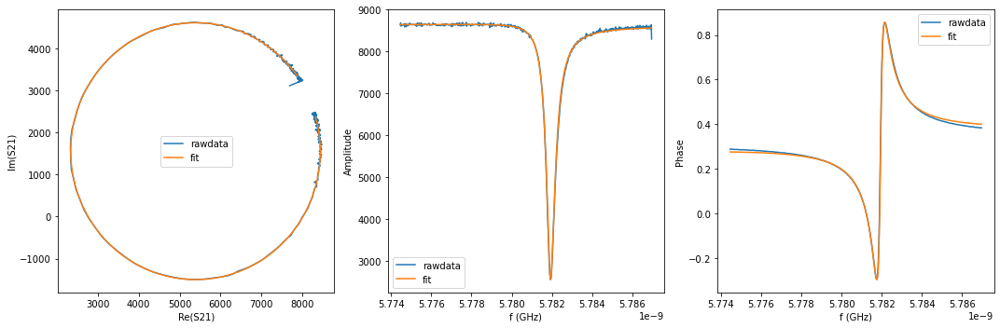

{'Qi_dia_corr': 27379.68079950992, 'Qi_no_corr': 27703.637431268624, 'absQc': 11512.856693744927, 'Qc_dia_corr(Re{Qc})': 11569.74573476096, 'Ql': 8133.006653397609, 'fr': 5.781914577075052, 'theta0': -3.042387973535149, 'phi0': 0.09920772979035254, 'phi0_err': 0.0055212498802364104, 'Ql_err': 89.25761319310874, 'absQc_err': 28.57161223500352, 'fr_err': 2.161316576220378e-06, 'chi_square': 8.150250993151033e-05, 'Qi_no_corr_err': 1034.536930001895, 'Qi_dia_corr_err': 1022.2439445065884, 'delay': -0.5264265372753493, 'a': 8624.836055801146, 'alpha': 0.05959598593557717}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


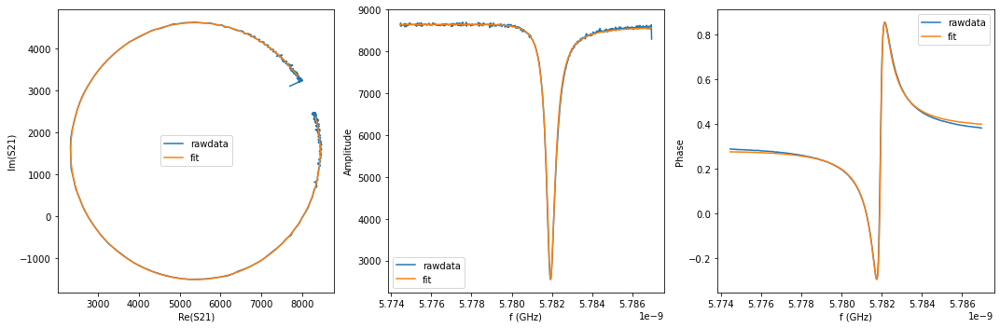

{'Qi_dia_corr': 27374.301579059385, 'Qi_no_corr': 27697.798793462858, 'absQc': 11503.66191341255, 'Qc_dia_corr(Re{Qc})': 11560.402169835605, 'Ql': 8127.914300138312, 'fr': 5.781913849768906, 'theta0': -3.042477757138357, 'phi0': 0.09911787113272358, 'phi0_err': 0.005662182922012709, 'Ql_err': 102.47707926842324, 'absQc_err': 28.496571610989914, 'fr_err': 2.160162332131719e-06, 'chi_square': 8.114323164109925e-05, 'Qi_no_corr_err': 1190.4854924634024, 'Qi_dia_corr_err': 1177.1495969040118, 'delay': -0.5211489789390055, 'a': 8626.21544763995, 'alpha': 0.2513072455974024}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


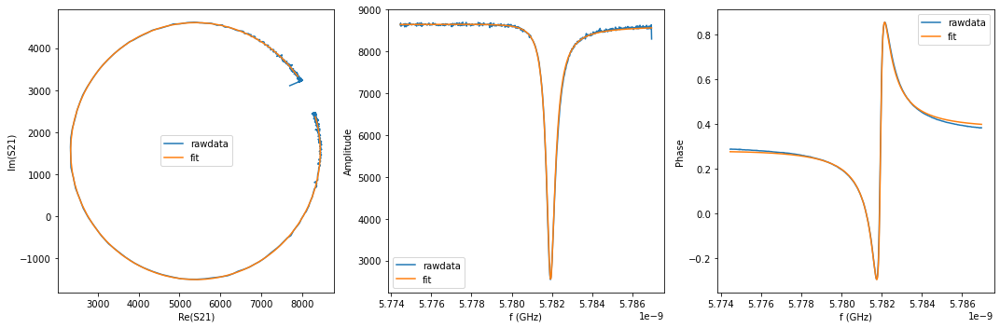

{'Qi_dia_corr': 27344.283990757755, 'Qi_no_corr': 27666.70595251063, 'absQc': 11500.040281678706, 'Qc_dia_corr(Re{Qc})': 11556.681568886892, 'Ql': 8123.427741809649, 'fr': 5.7819131099006515, 'theta0': -3.042548201204208, 'phi0': 0.09904727244926112, 'phi0_err': 0.005616276358186426, 'Ql_err': 91.74431996743692, 'absQc_err': 27.931494123503054, 'fr_err': 2.1565900853839644e-06, 'chi_square': 7.881383422314497e-05, 'Qi_no_corr_err': 1057.937618805419, 'Qi_dia_corr_err': 1048.2980574440414, 'delay': -0.5036262937264976, 'a': 8627.026152612132, 'alpha': 0.8874369448292526}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


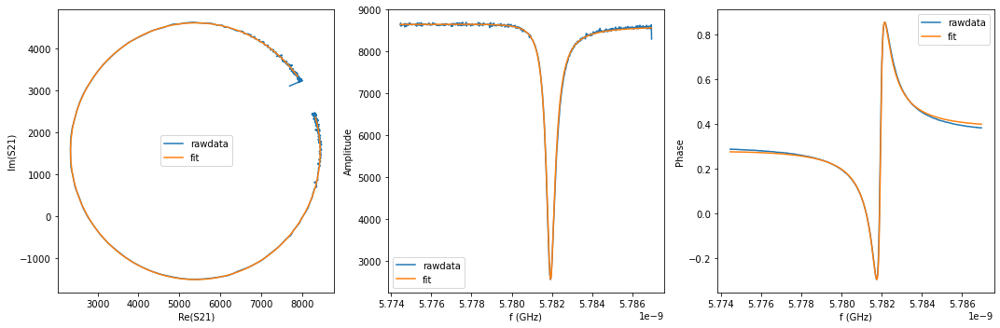

{'Qi_dia_corr': 27339.828072508877, 'Qi_no_corr': 27663.32467251261, 'absQc': 11500.138317774676, 'Qc_dia_corr(Re{Qc})': 11556.986586165196, 'Ql': 8123.185126460907, 'fr': 5.781912170394518, 'theta0': -3.04236848412909, 'phi0': 0.09922691680202513, 'phi0_err': 0.005744482304318037, 'Ql_err': 95.81977606776539, 'absQc_err': 28.503919616760538, 'fr_err': 2.1870164692442393e-06, 'chi_square': 8.271101895970634e-05, 'Qi_no_corr_err': 1103.4946076216743, 'Qi_dia_corr_err': 1091.4688848858889, 'delay': -0.5159710966051414, 'a': 8628.17636158118, 'alpha': 0.43892353009537016}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


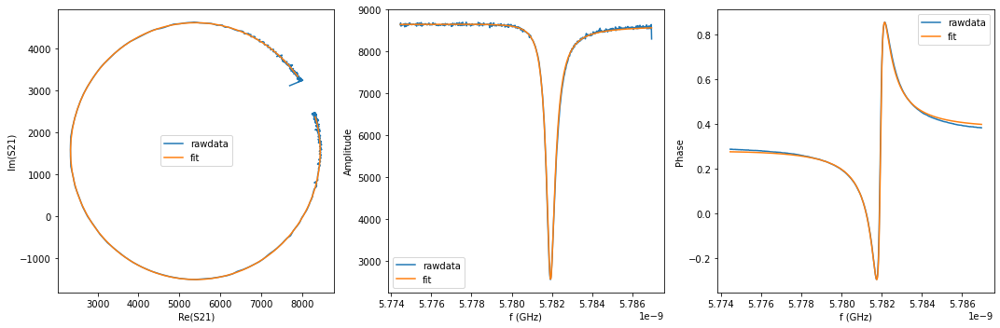

{'Qi_dia_corr': 27304.302680879082, 'Qi_no_corr': 27625.056345385085, 'absQc': 11493.416058546069, 'Qc_dia_corr(Re{Qc})': 11549.865992517267, 'Ql': 8116.530291361315, 'fr': 5.781911509145548, 'theta0': -3.042686384763165, 'phi0': 0.09890888074687597, 'phi0_err': 0.005228794568255873, 'Ql_err': 81.43607640669181, 'absQc_err': 27.687331634616086, 'fr_err': 2.0286023247954168e-06, 'chi_square': 7.812776002075649e-05, 'Qi_no_corr_err': 928.2930028379136, 'Qi_dia_corr_err': 914.4454604996404, 'delay': -0.5038033718552938, 'a': 8629.18399214542, 'alpha': 0.8810226671792243}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


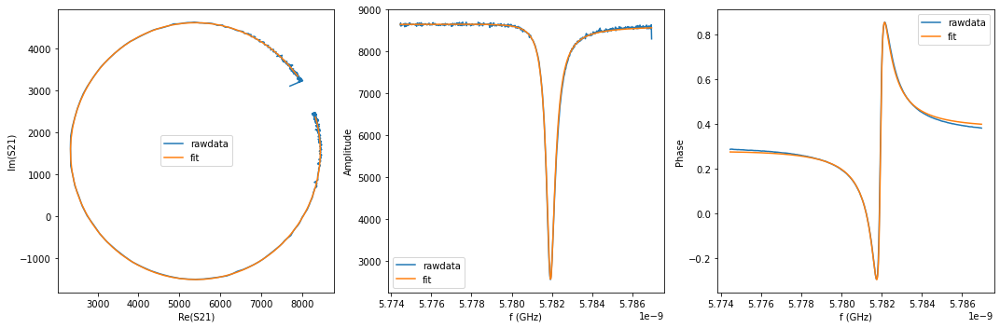

{'Qi_dia_corr': 27378.492727240195, 'Qi_no_corr': 27704.13668926792, 'absQc': 11511.554241180826, 'Qc_dia_corr(Re{Qc})': 11568.729548297493, 'Ql': 8132.399675660798, 'fr': 5.781910419870629, 'theta0': -3.042133582790851, 'phi0': 0.09946160067361863, 'phi0_err': 0.005869746170090491, 'Ql_err': 103.85631824773374, 'absQc_err': 29.019488848831653, 'fr_err': 2.2344621447728103e-06, 'chi_square': 8.576567376332066e-05, 'Qi_no_corr_err': 1200.4482237842253, 'Qi_dia_corr_err': 1185.3660257508043, 'delay': -0.5256308130027608, 'a': 8629.594375188699, 'alpha': 0.08807949024226258}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


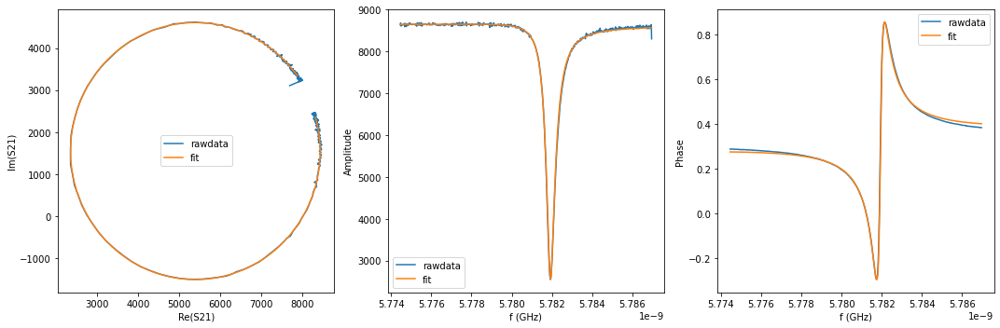

{'Qi_dia_corr': 27343.273387567362, 'Qi_no_corr': 27674.449575436643, 'absQc': 11519.224203408676, 'Qc_dia_corr(Re{Qc})': 11577.591700035779, 'Ql': 8133.664406255475, 'fr': 5.781909075848793, 'theta0': -3.0411396410822076, 'phi0': 0.10045557421017927, 'phi0_err': 0.006278825654396627, 'Ql_err': 117.79428931186376, 'absQc_err': 29.86294244621033, 'fr_err': 2.3982307059990327e-06, 'chi_square': 9.070355286045634e-05, 'Qi_no_corr_err': 1366.8164684739395, 'Qi_dia_corr_err': 1350.2203238735092, 'delay': -0.5475675194095119, 'a': 8630.420907686801, 'alpha': -0.708804481812704}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


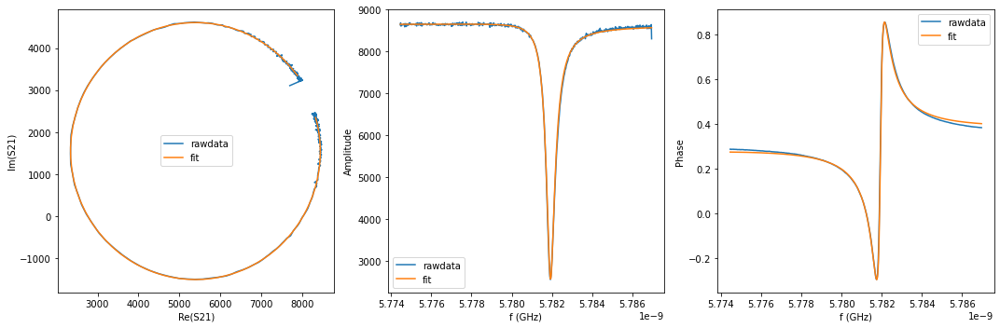

{'Qi_dia_corr': 27413.11188734175, 'Qi_no_corr': 27746.111866497515, 'absQc': 11534.12873081866, 'Qc_dia_corr(Re{Qc})': 11592.668627392763, 'Ql': 8147.282735069179, 'fr': 5.781908199540859, 'theta0': -3.041056641657846, 'phi0': 0.10053845052594365, 'phi0_err': 0.006399923081781645, 'Ql_err': 117.81338018566362, 'absQc_err': 30.79280731404738, 'fr_err': 2.431592999722937e-06, 'chi_square': 9.593772924941965e-05, 'Qi_no_corr_err': 1365.585815866543, 'Qi_dia_corr_err': 1349.8858790936483, 'delay': -0.5652729264683793, 'a': 8632.034661491873, 'alpha': -1.351849141030596}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


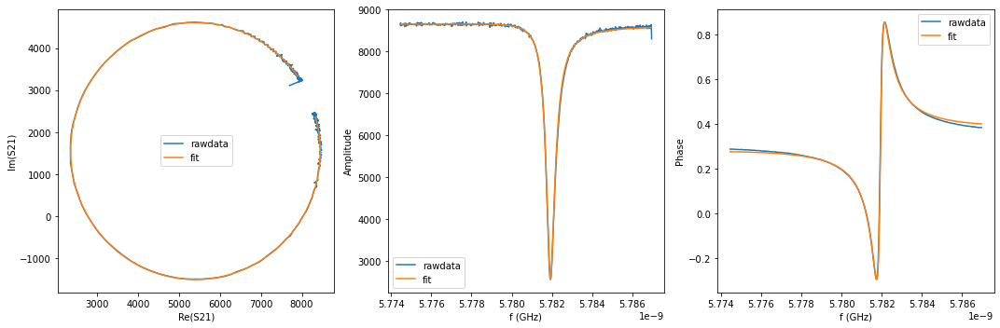

{'Qi_dia_corr': 27300.36327243927, 'Qi_no_corr': 27625.13919661202, 'absQc': 11499.16700638559, 'Qc_dia_corr(Re{Qc})': 11556.39383005487, 'Ql': 8119.405045760312, 'fr': 5.781907742366318, 'theta0': -3.0420352517705638, 'phi0': 0.09955957455264242, 'phi0_err': 0.00566847592283461, 'Ql_err': 88.58805006025008, 'absQc_err': 28.79860097822347, 'fr_err': 2.2083426341097106e-06, 'chi_square': 8.381042148892064e-05, 'Qi_no_corr_err': 1024.7296623902537, 'Qi_dia_corr_err': 1010.7510115267695, 'delay': -0.5220032505992749, 'a': 8635.049898962385, 'alpha': 0.2196617741693536}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


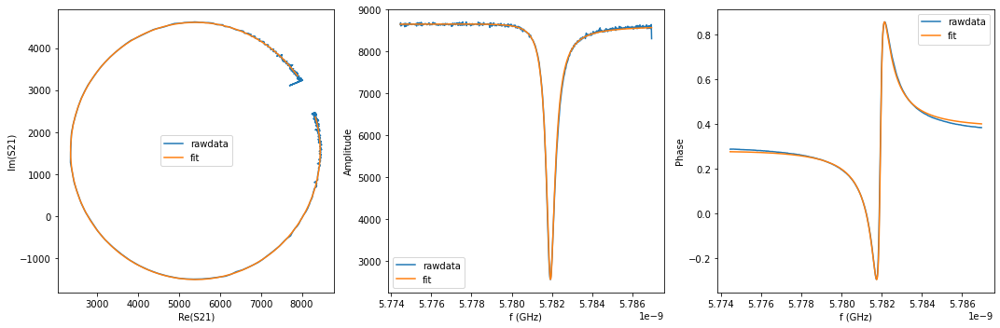

{'Qi_dia_corr': 27359.840652389343, 'Qi_no_corr': 27686.161511131766, 'absQc': 11514.44856636963, 'Qc_dia_corr(Re{Qc})': 11571.84890068371, 'Ql': 8132.2939130249515, 'fr': 5.781906733585604, 'theta0': -3.0419508608655987, 'phi0': 0.09964385381327706, 'phi0_err': 0.005996503169482752, 'Ql_err': 98.43337536051631, 'absQc_err': 29.83617482195148, 'fr_err': 2.2955757287073747e-06, 'chi_square': 9.023843807204546e-05, 'Qi_no_corr_err': 1135.2467992446095, 'Qi_dia_corr_err': 1121.8489268892233, 'delay': -0.5302824697169086, 'a': 8635.581438303878, 'alpha': -0.08094468934546985}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


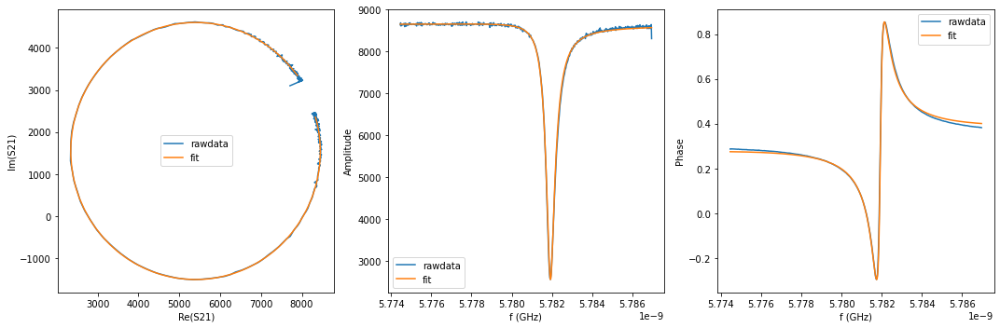

{'Qi_dia_corr': 27385.675839823652, 'Qi_no_corr': 27723.659633339936, 'absQc': 11530.394792946101, 'Qc_dia_corr(Re{Qc})': 11589.88495571953, 'Ql': 8143.483401898299, 'fr': 5.781904025140011, 'theta0': -3.0402304599024186, 'phi0': 0.10136405040667827, 'phi0_err': 0.006528159191760258, 'Ql_err': 133.37232869989037, 'absQc_err': 30.556799455508763, 'fr_err': 2.468240139519211e-06, 'chi_square': 9.700020657750974e-05, 'Qi_no_corr_err': 1540.033882205722, 'Qi_dia_corr_err': 1517.8315358286727, 'delay': -0.5512959961242027, 'a': 8635.55570197979, 'alpha': -0.8440614111907918}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


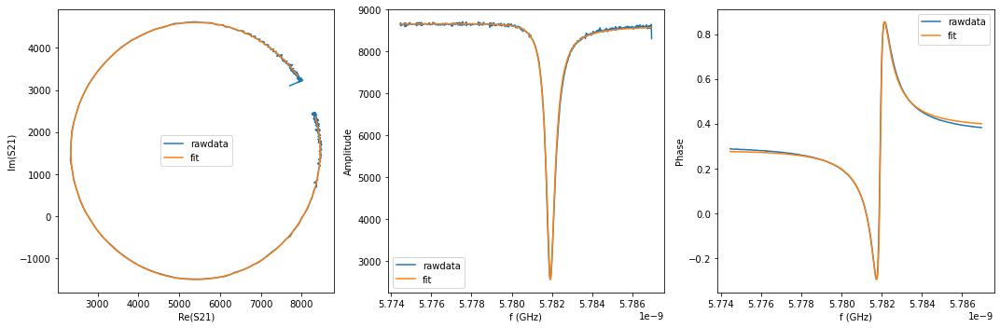

{'Qi_dia_corr': 27339.162802953873, 'Qi_no_corr': 27670.301737332487, 'absQc': 11520.907808446264, 'Qc_dia_corr(Re{Qc})': 11579.303428811058, 'Ql': 8134.145361737996, 'fr': 5.781903661944706, 'theta0': -3.0411220694592953, 'phi0': 0.10047236006052565, 'phi0_err': 0.006316246098738847, 'Ql_err': 118.0277388522537, 'absQc_err': 30.30477260791696, 'fr_err': 2.372779537262721e-06, 'chi_square': 9.38426269270442e-05, 'Qi_no_corr_err': 1363.8253163548911, 'Qi_dia_corr_err': 1346.1934580544253, 'delay': -0.5352099797476577, 'a': 8638.673676508019, 'alpha': -0.25992545857635196}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


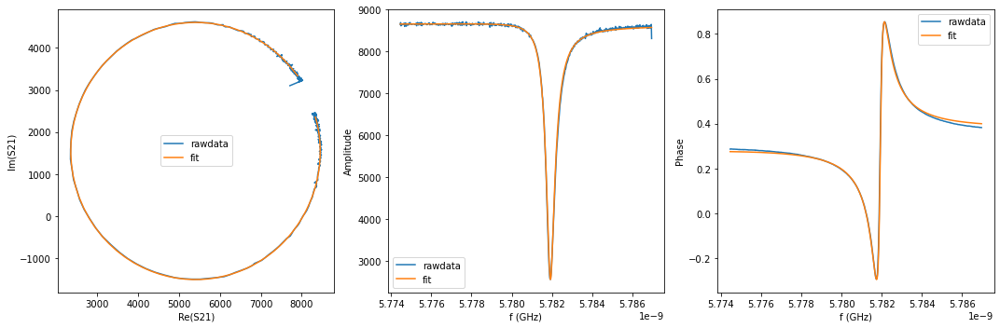

{'Qi_dia_corr': 27286.87418617933, 'Qi_no_corr': 27614.682672791187, 'absQc': 11513.267550255126, 'Qc_dia_corr(Re{Qc})': 11571.22433147286, 'Ql': 8125.527356144913, 'fr': 5.781902655364653, 'theta0': -3.0414654506022414, 'phi0': 0.10012877607692318, 'phi0_err': 0.006122451831404089, 'Ql_err': 101.3524590626326, 'absQc_err': 30.36966846909488, 'fr_err': 2.3090520425717662e-06, 'chi_square': 9.303975594546808e-05, 'Qi_no_corr_err': 1156.8507221121479, 'Qi_dia_corr_err': 1146.6477946249327, 'delay': -0.532754603693538, 'a': 8639.938815185404, 'alpha': -0.17099654746245693}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


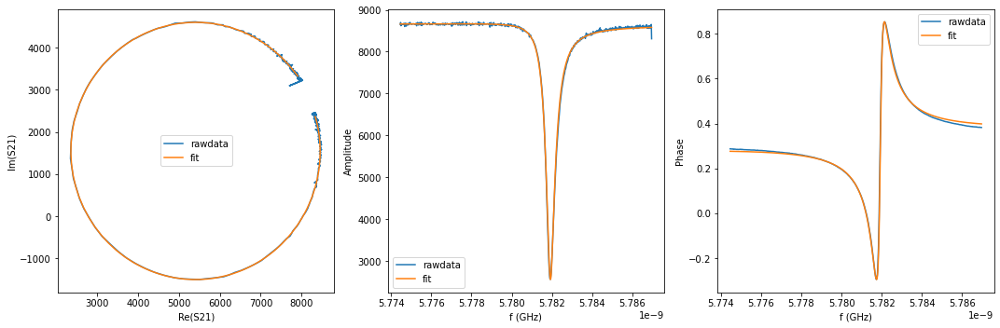

{'Qi_dia_corr': 27261.41698074279, 'Qi_no_corr': 27589.34381290988, 'absQc': 11494.76103967473, 'Qc_dia_corr(Re{Qc})': 11552.659776346083, 'Ql': 8114.1148189775095, 'fr': 5.781901848744318, 'theta0': -3.041434983971192, 'phi0': 0.1001590270353951, 'phi0_err': 0.0058054441644867704, 'Ql_err': 96.93588786819423, 'absQc_err': 28.64626729103702, 'fr_err': 2.204659551300623e-06, 'chi_square': 8.534937961034867e-05, 'Qi_no_corr_err': 1101.9202045129105, 'Qi_dia_corr_err': 1086.6455700112124, 'delay': -0.5005112326535337, 'a': 8641.200702976315, 'alpha': 0.9997263186483049}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


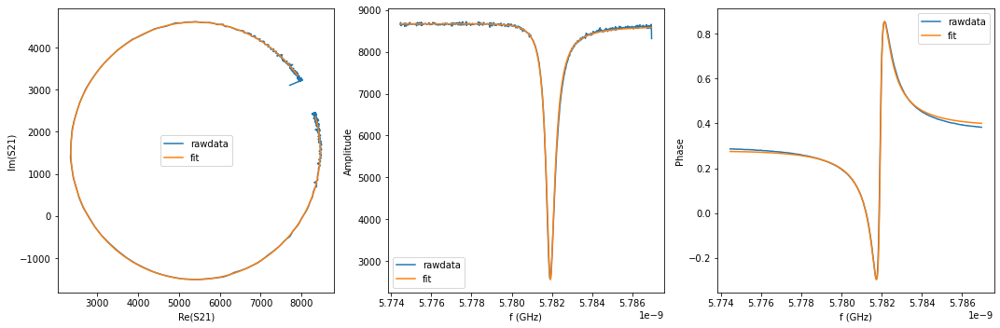

{'Qi_dia_corr': 27307.71019027155, 'Qi_no_corr': 27644.508471985962, 'absQc': 11523.809546110195, 'Qc_dia_corr(Re{Qc})': 11583.36293025958, 'Ql': 8133.360500183169, 'fr': 5.781900216849298, 'theta0': -3.0401476239263143, 'phi0': 0.10144651531687508, 'phi0_err': 0.006523615042913399, 'Ql_err': 135.47597020052638, 'absQc_err': 30.66564874705787, 'fr_err': 2.4438854221271768e-06, 'chi_square': 9.76873789083047e-05, 'Qi_no_corr_err': 1560.680620814761, 'Qi_dia_corr_err': 1536.4231506422102, 'delay': -0.5443859850125765, 'a': 8641.132709739435, 'alpha': -0.5938495429940986}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


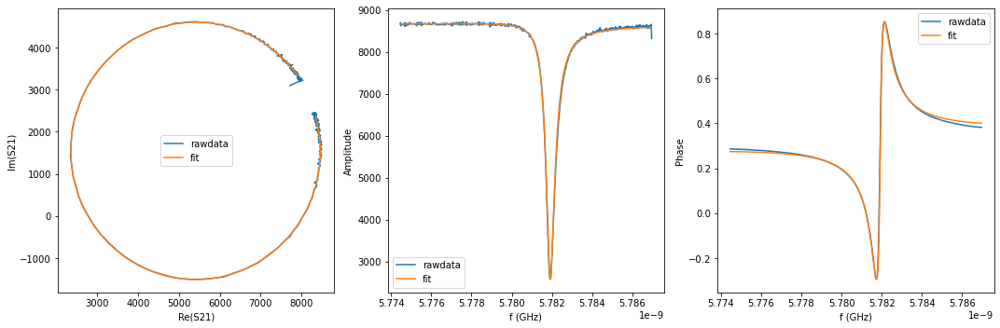

{'Qi_dia_corr': 27311.577331049448, 'Qi_no_corr': 27649.447560416425, 'absQc': 11524.202775798238, 'Qc_dia_corr(Re{Qc})': 11583.931544116736, 'Ql': 8133.983879221725, 'fr': 5.781899083972308, 'theta0': -3.040000571773831, 'phi0': 0.10159341778943, 'phi0_err': 0.006583028957846887, 'Ql_err': 139.72781868726778, 'absQc_err': 31.576477543547263, 'fr_err': 2.506530898419518e-06, 'chi_square': 0.00010125912418552443, 'Qi_no_corr_err': 1624.7577051345122, 'Qi_dia_corr_err': 1598.2816197656534, 'delay': -0.5512936874558845, 'a': 8643.049446432848, 'alpha': -0.8446848355004697}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


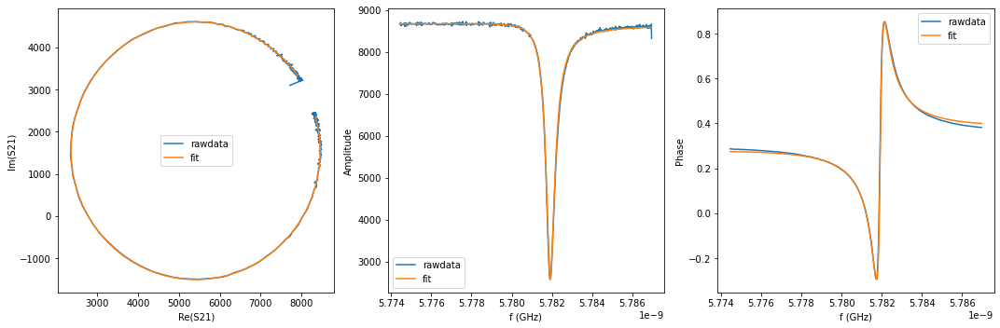

{'Qi_dia_corr': 27274.669641614073, 'Qi_no_corr': 27607.663349116418, 'absQc': 11523.793927218494, 'Qc_dia_corr(Re{Qc})': 11582.82174577147, 'Ql': 8130.160372014598, 'fr': 5.781898319402736, 'theta0': -3.0405939222508716, 'phi0': 0.10099986346411784, 'phi0_err': 0.006453898143647371, 'Ql_err': 108.8121407145888, 'absQc_err': 31.49065523731596, 'fr_err': 2.4762897689318807e-06, 'chi_square': 0.00010072100559177234, 'Qi_no_corr_err': 1255.4116464157662, 'Qi_dia_corr_err': 1237.3891730946655, 'delay': -0.5419474369347189, 'a': 8644.23847368137, 'alpha': -0.5055468257457214}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


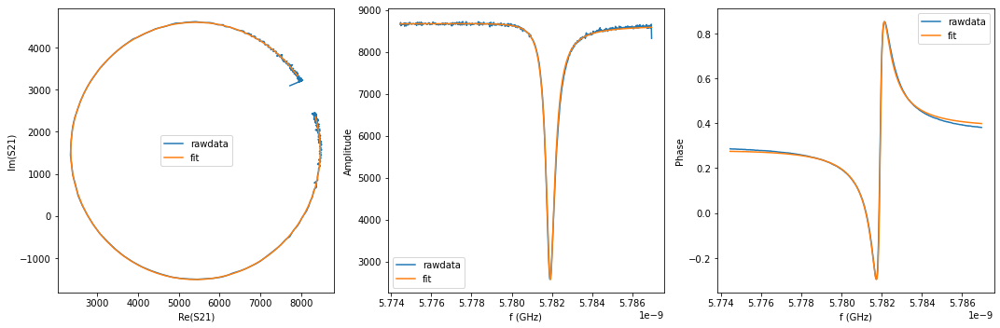

{'Qi_dia_corr': 27211.98734850707, 'Qi_no_corr': 27545.88962145646, 'absQc': 11505.436292756094, 'Qc_dia_corr(Re{Qc})': 11564.706990229071, 'Ql': 8115.664980574046, 'fr': 5.781897015842943, 'theta0': -3.0403067590764645, 'phi0': 0.10128691866507043, 'phi0_err': 0.006366416139816635, 'Ql_err': 118.84605007020721, 'absQc_err': 30.621969447861, 'fr_err': 2.4259079711308117e-06, 'chi_square': 9.521525548664524e-05, 'Qi_no_corr_err': 1373.6130212530875, 'Qi_dia_corr_err': 1356.0093017030188, 'delay': -0.5228230364792167, 'a': 8646.029734883237, 'alpha': 0.18907900226053492}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


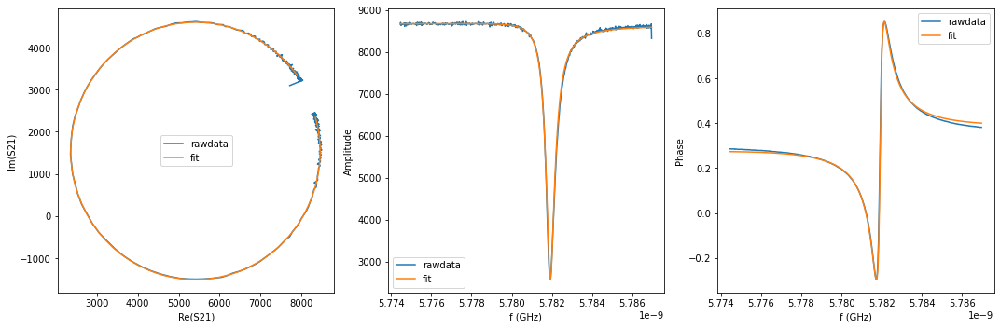

{'Qi_dia_corr': 27275.65824180478, 'Qi_no_corr': 27614.142117082964, 'absQc': 11525.316615338777, 'Qc_dia_corr(Re{Qc})': 11585.322269227945, 'Ql': 8131.480129455798, 'fr': 5.781895653298665, 'theta0': -3.0397708787462103, 'phi0': 0.10182271048045989, 'phi0_err': 0.0069022944818775585, 'Ql_err': 131.49546759618303, 'absQc_err': 32.376396760998816, 'fr_err': 2.597023715181335e-06, 'chi_square': 0.00010567599588743244, 'Qi_no_corr_err': 1524.1940203524957, 'Qi_dia_corr_err': 1504.7710292552972, 'delay': -0.5603072939174607, 'a': 8646.045930987186, 'alpha': -1.1725726838638462}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


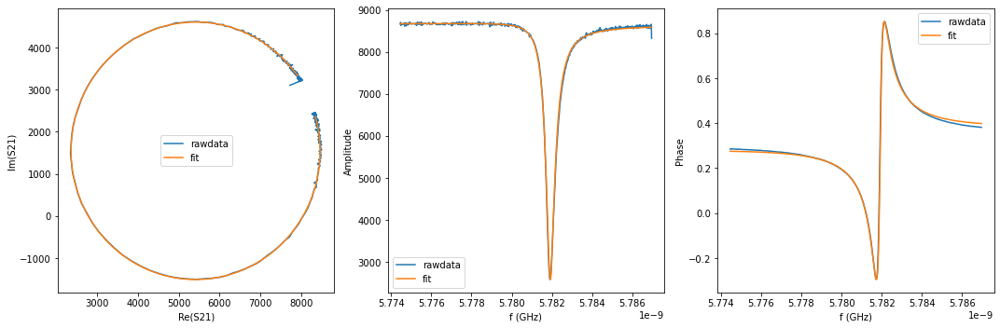

{'Qi_dia_corr': 27165.649225364752, 'Qi_no_corr': 27498.17417628217, 'absQc': 11503.183256923801, 'Qc_dia_corr(Re{Qc})': 11562.38928362198, 'Ql': 8110.398139918839, 'fr': 5.781894822516495, 'theta0': -3.0403516321846316, 'phi0': 0.10124175301573654, 'phi0_err': 0.006171927510606627, 'Ql_err': 97.93193009861442, 'absQc_err': 30.668835951896245, 'fr_err': 2.3687897003739625e-06, 'chi_square': 9.682052922044119e-05, 'Qi_no_corr_err': 1113.0080003799173, 'Qi_dia_corr_err': 1097.5923700936166, 'delay': -0.5177122254548019, 'a': 8648.888908536404, 'alpha': 0.3746274903034885}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


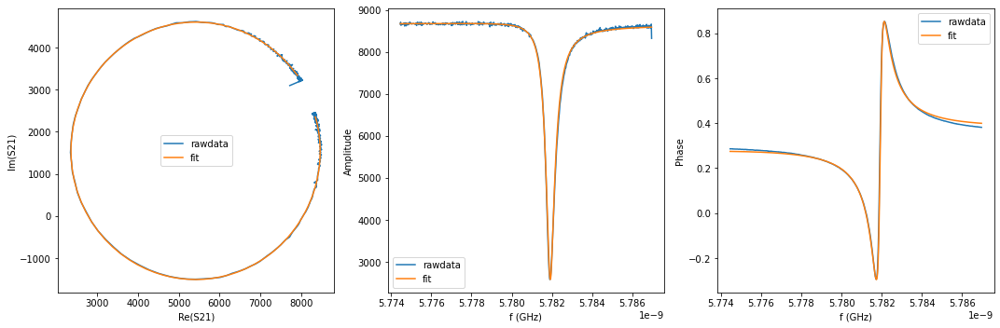

{'Qi_dia_corr': 27207.865075256992, 'Qi_no_corr': 27542.496013767883, 'absQc': 11514.580762715257, 'Qc_dia_corr(Re{Qc})': 11574.092607658637, 'Ql': 8119.918870842079, 'fr': 5.781893462733614, 'theta0': -3.0401415294449854, 'phi0': 0.10145173826532342, 'phi0_err': 0.006768976911645976, 'Ql_err': 130.81243524905645, 'absQc_err': 31.512105929058613, 'fr_err': 2.5307833372688288e-06, 'chi_square': 0.00010258151490971128, 'Qi_no_corr_err': 1501.3334588601776, 'Qi_dia_corr_err': 1481.6523132626926, 'delay': -0.5377839115615421, 'a': 8649.541557165989, 'alpha': -0.3543607804799051}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


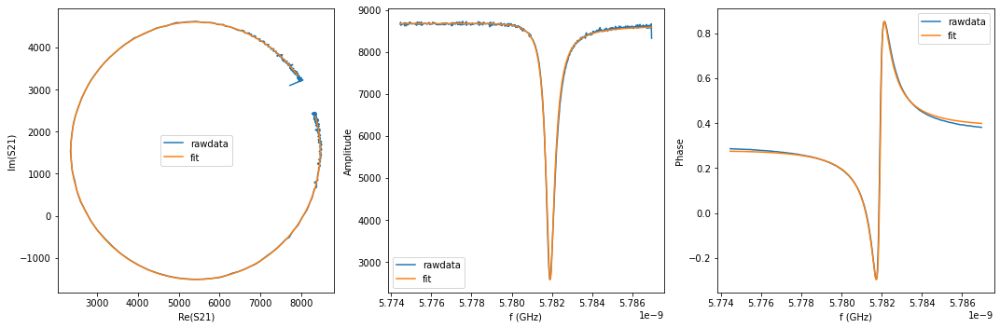

{'Qi_dia_corr': 27206.53067361543, 'Qi_no_corr': 27544.307952363786, 'absQc': 11511.279699029716, 'Qc_dia_corr(Re{Qc})': 11571.318478621444, 'Ql': 8118.434570387393, 'fr': 5.7818921984703335, 'theta0': -3.0396806100079936, 'phi0': 0.10191250164317774, 'phi0_err': 0.006864246049358136, 'Ql_err': 137.01477213987664, 'absQc_err': 31.281048097517452, 'fr_err': 2.5588458374025902e-06, 'chi_square': 0.00010155742044563012, 'Qi_no_corr_err': 1574.1260864964606, 'Qi_dia_corr_err': 1554.7153247851272, 'delay': -0.5233087529265776, 'a': 8649.351689984816, 'alpha': 0.17106002730106917}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


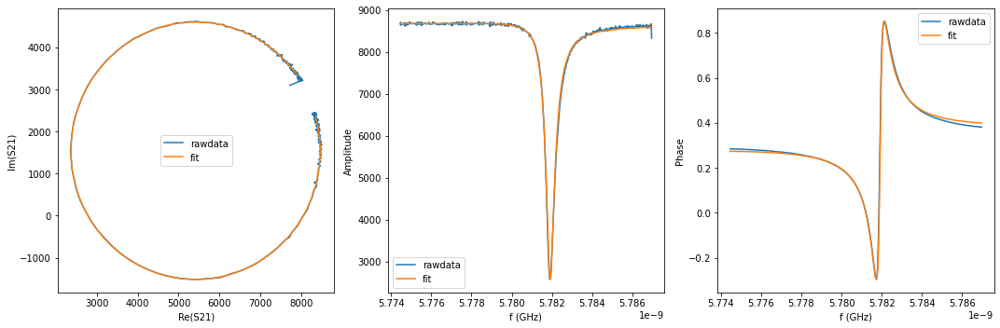

{'Qi_dia_corr': 27221.979762524352, 'Qi_no_corr': 27563.620120836593, 'absQc': 11526.145900661308, 'Qc_dia_corr(Re{Qc})': 11586.95472805991, 'Ql': 8127.505979146612, 'fr': 5.78189077170543, 'theta0': -3.0390978833520843, 'phi0': 0.10249525804454367, 'phi0_err': 0.006959770494279385, 'Ql_err': 144.5602342354727, 'absQc_err': 32.05852735891075, 'fr_err': 2.5961338040906078e-06, 'chi_square': 0.00010604184374181089, 'Qi_no_corr_err': 1660.2812763212453, 'Qi_dia_corr_err': 1638.251920328774, 'delay': -0.5452463469401471, 'a': 8650.682673054345, 'alpha': -0.6259255982316567}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


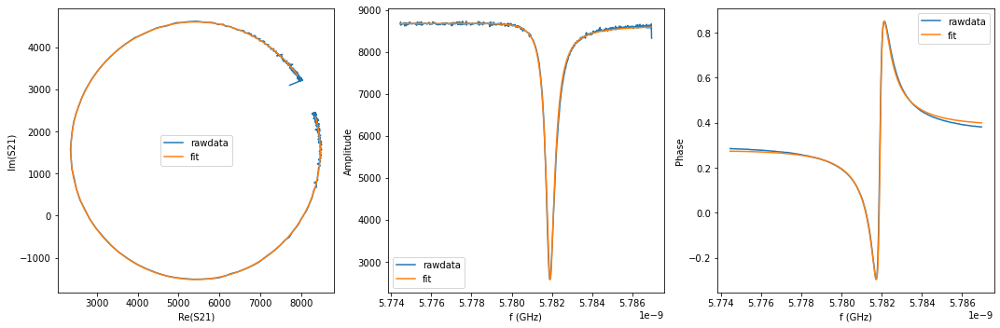

{'Qi_dia_corr': 27233.244027579298, 'Qi_no_corr': 27578.396868357926, 'absQc': 11529.730483877487, 'Qc_dia_corr(Re{Qc})': 11591.147490392947, 'Ql': 8130.5729677542995, 'fr': 5.781889254441884, 'theta0': -3.0386046190161187, 'phi0': 0.1029883390454192, 'phi0_err': 0.007216128192299086, 'Ql_err': 172.0998217950409, 'absQc_err': 32.71798736918862, 'fr_err': 2.6605734711446046e-06, 'chi_square': 0.00011034268304658141, 'Qi_no_corr_err': 1986.708807486215, 'Qi_dia_corr_err': 1956.2076405565822, 'delay': -0.551443072256071, 'a': 8652.013893723633, 'alpha': -0.8509035851786874}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


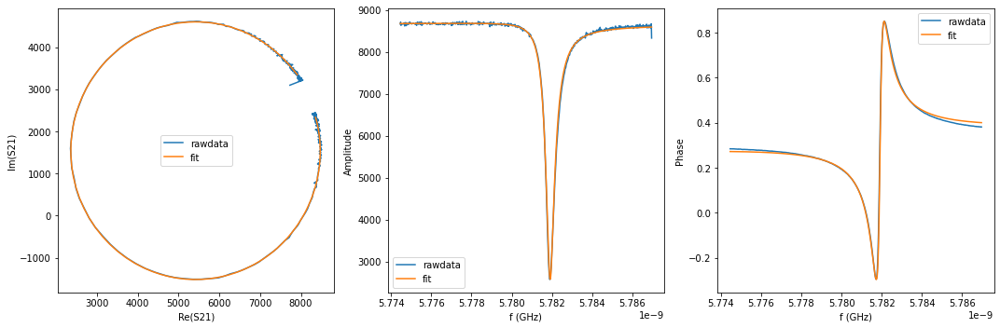

{'Qi_dia_corr': 27231.783805743016, 'Qi_no_corr': 27577.765093215305, 'absQc': 11540.422564510067, 'Qc_dia_corr(Re{Qc})': 11602.107062115554, 'Ql': 8135.833524425758, 'fr': 5.7818877377246, 'theta0': -3.038429126360848, 'phi0': 0.10316376505417528, 'phi0_err': 0.007394315836877382, 'Ql_err': 164.84705341128307, 'absQc_err': 33.98169138160427, 'fr_err': 2.7560165279550045e-06, 'chi_square': 0.00011870498719968896, 'Qi_no_corr_err': 1898.3534346356423, 'Qi_dia_corr_err': 1868.7799297911945, 'delay': -0.5839360761804917, 'a': 8652.710755278065, 'alpha': -2.0312854546292702}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


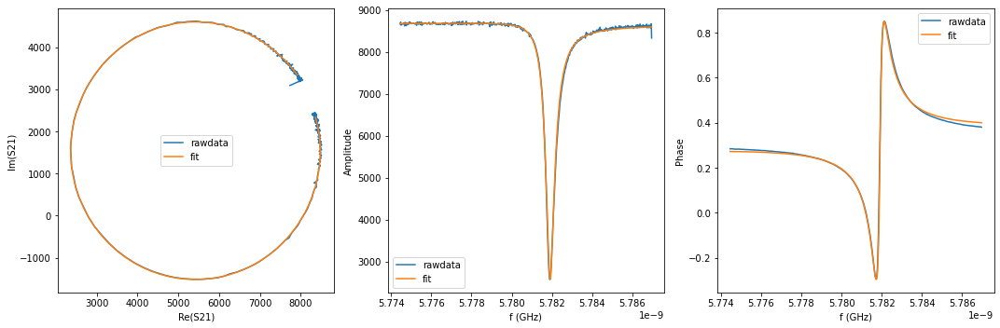

{'Qi_dia_corr': 27205.131808790156, 'Qi_no_corr': 27549.89895958867, 'absQc': 11532.988691203213, 'Qc_dia_corr(Re{Qc})': 11594.499139732316, 'Ql': 8129.713341135108, 'fr': 5.781886513686508, 'theta0': -3.0385408604488013, 'phi0': 0.10305181255331791, 'phi0_err': 0.007417833571011917, 'Ql_err': 169.72143135967326, 'absQc_err': 33.73304829036679, 'fr_err': 2.7650972992136023e-06, 'chi_square': 0.00011756334612979795, 'Qi_no_corr_err': 1955.548920104173, 'Qi_dia_corr_err': 1923.8275490772671, 'delay': -0.5763815566403317, 'a': 8654.378419980363, 'alpha': -1.757106632644915}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


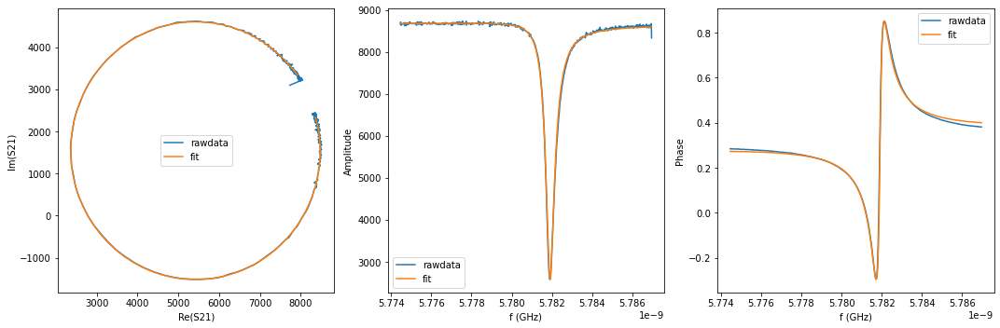

{'Qi_dia_corr': 27216.466111378966, 'Qi_no_corr': 27560.71552243404, 'absQc': 11542.951951609704, 'Qc_dia_corr(Re{Qc})': 11604.42596017087, 'Ql': 8135.605573022268, 'fr': 5.781885396102187, 'theta0': -3.038615262442922, 'phi0': 0.10297714369613856, 'phi0_err': 0.007514135790536132, 'Ql_err': 187.28558172590414, 'absQc_err': 33.87124372855323, 'fr_err': 2.7540024191498857e-06, 'chi_square': 0.00011990545525620983, 'Qi_no_corr_err': 2143.140155251471, 'Qi_dia_corr_err': 2108.2730662277067, 'delay': -0.5730174732637053, 'a': 8655.629985696916, 'alpha': -1.6348444462697402}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


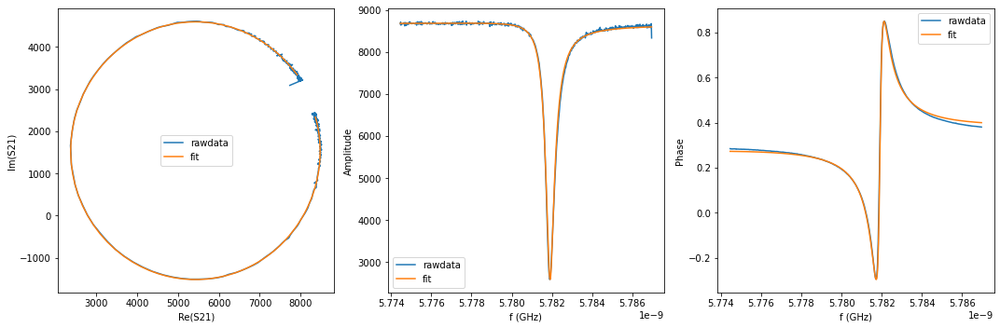

{'Qi_dia_corr': 27193.750042537922, 'Qi_no_corr': 27543.530777300803, 'absQc': 11540.190504836015, 'Qc_dia_corr(Re{Qc})': 11602.719282111386, 'Ql': 8132.736134599902, 'fr': 5.781883624237764, 'theta0': -3.037727222386983, 'phi0': 0.1038652584890231, 'phi0_err': 0.007501996641919572, 'Ql_err': 168.54177588112702, 'absQc_err': 34.0624216897511, 'fr_err': 2.7594032242472324e-06, 'chi_square': 0.00012061258574871914, 'Qi_no_corr_err': 1931.5701919548203, 'Qi_dia_corr_err': 1901.36197528364, 'delay': -0.5724234195971712, 'a': 8657.623162160984, 'alpha': -1.6134020761692343}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


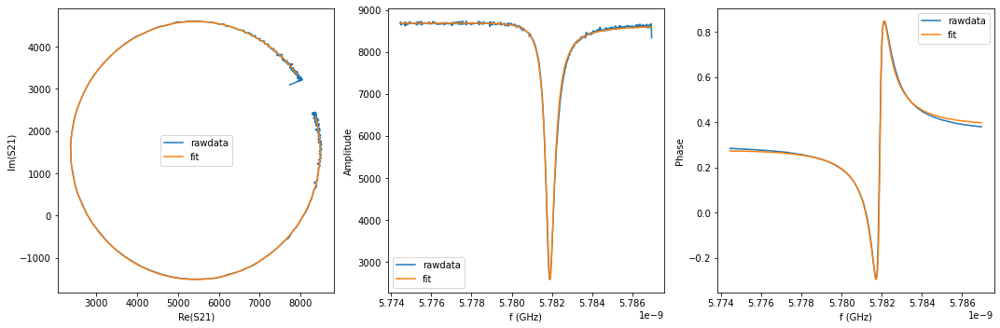

{'Qi_dia_corr': 27099.159097122643, 'Qi_no_corr': 27447.09044021809, 'absQc': 11521.355899064489, 'Qc_dia_corr(Re{Qc})': 11583.786217738196, 'Ql': 8114.96805908801, 'fr': 5.781882322878064, 'theta0': -3.037724073020613, 'phi0': 0.1038682347339107, 'phi0_err': 0.007449194923618843, 'Ql_err': 167.24361373708302, 'absQc_err': 32.96278737890958, 'fr_err': 2.7425984868633947e-06, 'chi_square': 0.00011319755282607026, 'Qi_no_corr_err': 1916.1642918792927, 'Qi_dia_corr_err': 1888.332393880078, 'delay': -0.53896392189584, 'a': 8659.696841031446, 'alpha': -0.3981513251079132}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


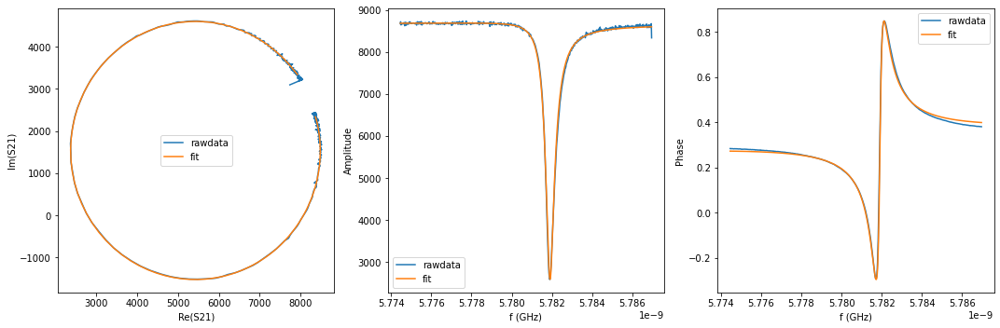

{'Qi_dia_corr': 27118.406171194336, 'Qi_no_corr': 27465.780393700104, 'absQc': 11529.42367893088, 'Qc_dia_corr(Re{Qc})': 11591.75383752869, 'Ql': 8120.604222038022, 'fr': 5.781881011397373, 'theta0': -3.037842995193755, 'phi0': 0.1037490993234933, 'phi0_err': 0.007627171485862833, 'Ql_err': 181.28031077553024, 'absQc_err': 33.775357362290386, 'fr_err': 2.8161322522787693e-06, 'chi_square': 0.0001196795852635653, 'Qi_no_corr_err': 2073.0806178290572, 'Qi_dia_corr_err': 2040.009071024681, 'delay': -0.561880432144712, 'a': 8660.959191043405, 'alpha': -1.2307018351552959}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


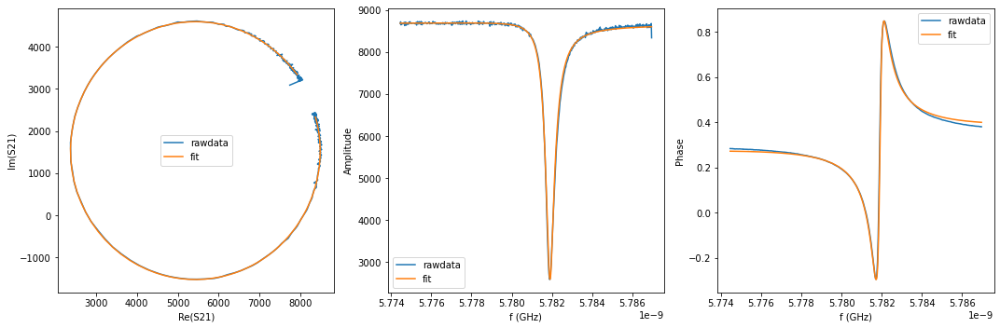

{'Qi_dia_corr': 27131.941054525418, 'Qi_no_corr': 27485.346134705662, 'absQc': 11536.94787789174, 'Qc_dia_corr(Re{Qc})': 11600.371867115791, 'Ql': 8126.047270812561, 'fr': 5.781879165331315, 'theta0': -3.0369746793420775, 'phi0': 0.10461739222818697, 'phi0_err': 0.007905209435486183, 'Ql_err': 195.1922622808259, 'absQc_err': 34.50568228769835, 'fr_err': 2.889251491372767e-06, 'chi_square': 0.00012505360668172458, 'Qi_no_corr_err': 2231.1282682606316, 'Qi_dia_corr_err': 2195.093073293601, 'delay': -0.5773660748562484, 'a': 8662.69974538118, 'alpha': -1.7932590961598427}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


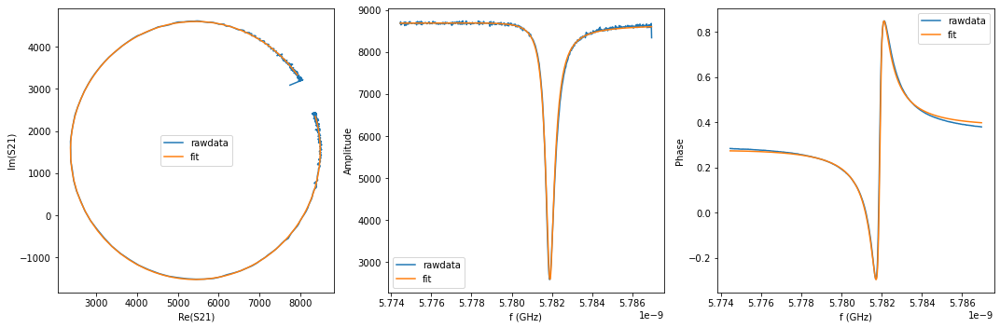

{'Qi_dia_corr': 27059.494142024287, 'Qi_no_corr': 27407.71559488745, 'absQc': 11507.78436160627, 'Qc_dia_corr(Re{Qc})': 11570.301545025497, 'Ql': 8104.793238242023, 'fr': 5.781878164771931, 'theta0': -3.037590724854982, 'phi0': 0.10400114118594657, 'phi0_err': 0.007488065525368195, 'Ql_err': 174.08473307651954, 'absQc_err': 33.37559964452803, 'fr_err': 2.7556658662289206e-06, 'chi_square': 0.00011612340400215112, 'Qi_no_corr_err': 1993.8118894415513, 'Qi_dia_corr_err': 1964.1043398401375, 'delay': -0.5329074611955154, 'a': 8663.889059372104, 'alpha': -0.17857151102115318}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


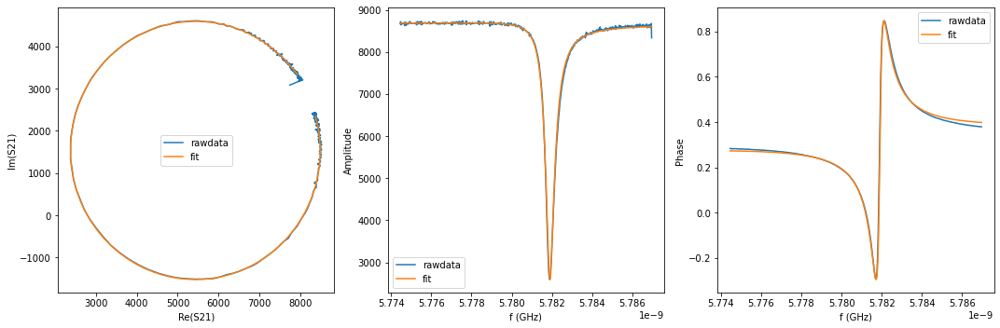

{'Qi_dia_corr': 27067.715197621117, 'Qi_no_corr': 27416.262816479677, 'absQc': 11526.990673634213, 'Qc_dia_corr(Re{Qc})': 11589.7375063655, 'Ql': 8115.064291474571, 'fr': 5.781876857355734, 'theta0': -3.0374869121868127, 'phi0': 0.10410467586253995, 'phi0_err': 0.007980774906103999, 'Ql_err': 188.64152641350697, 'absQc_err': 34.57746887140958, 'fr_err': 2.9367821508565996e-06, 'chi_square': 0.00012486613940630188, 'Qi_no_corr_err': 2160.04084415129, 'Qi_dia_corr_err': 2127.0067728722047, 'delay': -0.5500215634062091, 'a': 8665.335898570573, 'alpha': -0.8001079164186322}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


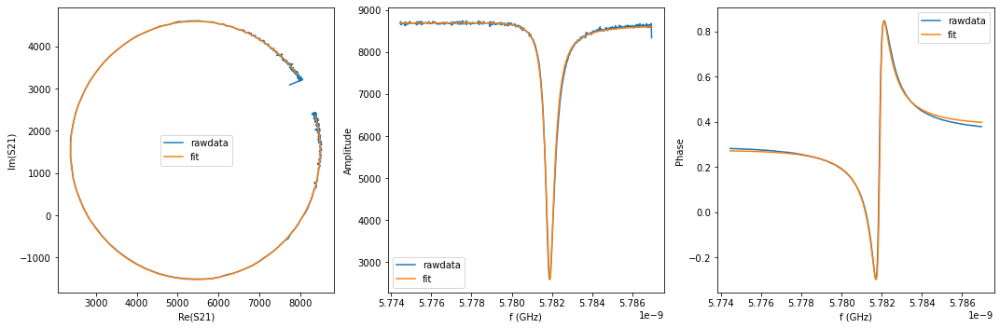

{'Qi_dia_corr': 27069.527372979854, 'Qi_no_corr': 27423.17911093463, 'absQc': 11530.835260130312, 'Qc_dia_corr(Re{Qc})': 11594.528181849384, 'Ql': 8117.575704138893, 'fr': 5.7818748943271485, 'theta0': -3.036725939337388, 'phi0': 0.10486560218098531, 'phi0_err': 0.007986325466431753, 'Ql_err': 175.217889400618, 'absQc_err': 34.89280958623951, 'fr_err': 2.9462301098198874e-06, 'chi_square': 0.00012883756012382083, 'Qi_no_corr_err': 1993.8727990061611, 'Qi_dia_corr_err': 1961.4939970536996, 'delay': -0.5601216363124407, 'a': 8665.707174616447, 'alpha': -1.1671146619673052}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


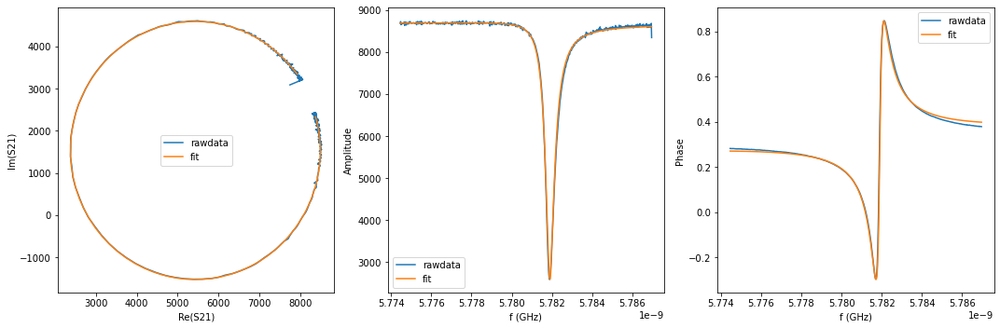

{'Qi_dia_corr': 27119.581543307333, 'Qi_no_corr': 27476.476730380396, 'absQc': 11542.734809117885, 'Qc_dia_corr(Re{Qc})': 11606.90328853338, 'Ql': 8128.141801805291, 'fr': 5.781873343771318, 'theta0': -3.036390846346905, 'phi0': 0.10520054125209802, 'phi0_err': 0.007944549323766597, 'Ql_err': 173.58908673350282, 'absQc_err': 35.48109990352037, 'fr_err': 2.9480528479962077e-06, 'chi_square': 0.0001335468798040397, 'Qi_no_corr_err': 1968.3524019331662, 'Qi_dia_corr_err': 1931.5566185691523, 'delay': -0.57838786926089, 'a': 8666.84168224163, 'alpha': -1.8306025830441819}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


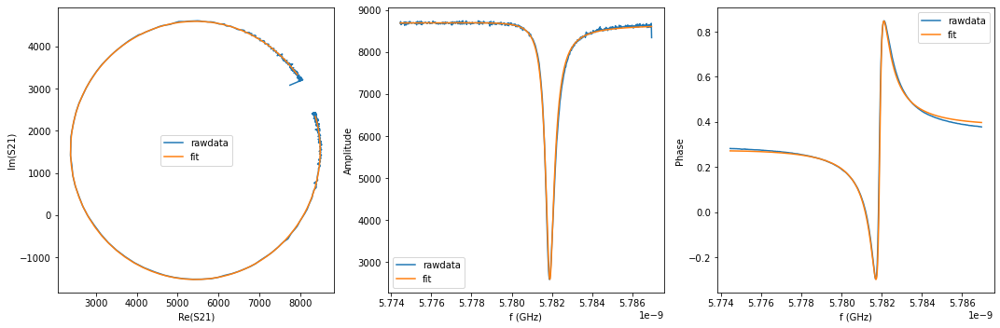

{'Qi_dia_corr': 27055.128069787203, 'Qi_no_corr': 27408.994714091117, 'absQc': 11523.984276672869, 'Qc_dia_corr(Re{Qc})': 11587.707407337024, 'Ql': 8112.937471328023, 'fr': 5.781871876022393, 'theta0': -3.036669758620545, 'phi0': 0.1049213846338455, 'phi0_err': 0.008232484415282492, 'Ql_err': 212.25775427117605, 'absQc_err': 34.82346570286671, 'fr_err': 3.031955411318225e-06, 'chi_square': 0.00013000287656534466, 'Qi_no_corr_err': 2417.519036070639, 'Qi_dia_corr_err': 2373.9993699938573, 'delay': -0.549097795203866, 'a': 8668.843693080984, 'alpha': -0.7668721934531173}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


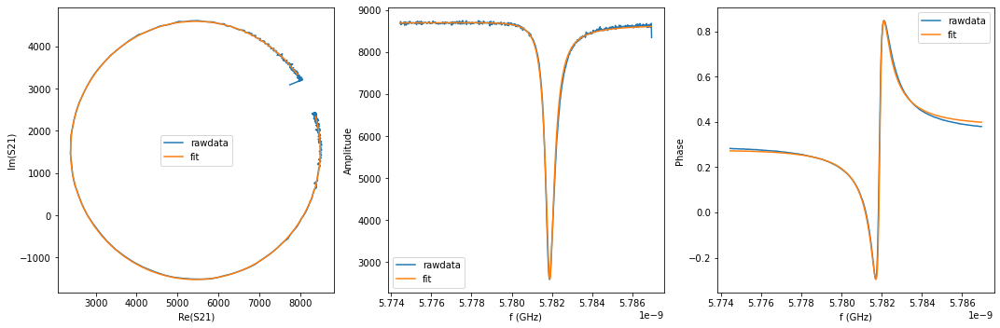

{'Qi_dia_corr': 27053.804958006065, 'Qi_no_corr': 27407.472659768027, 'absQc': 11538.438504658045, 'Qc_dia_corr(Re{Qc})': 11602.292622653056, 'Ql': 8119.965059173892, 'fr': 5.781870220845129, 'theta0': -3.0366277562508057, 'phi0': 0.1049631675183066, 'phi0_err': 0.008410023811277227, 'Ql_err': 202.43976072236876, 'absQc_err': 35.86708978460513, 'fr_err': 3.0863163752379237e-06, 'chi_square': 0.00013580166869572264, 'Qi_no_corr_err': 2308.442381664742, 'Qi_dia_corr_err': 2270.1152263384915, 'delay': -0.565944879488174, 'a': 8670.676089986368, 'alpha': -1.3785910689757765}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


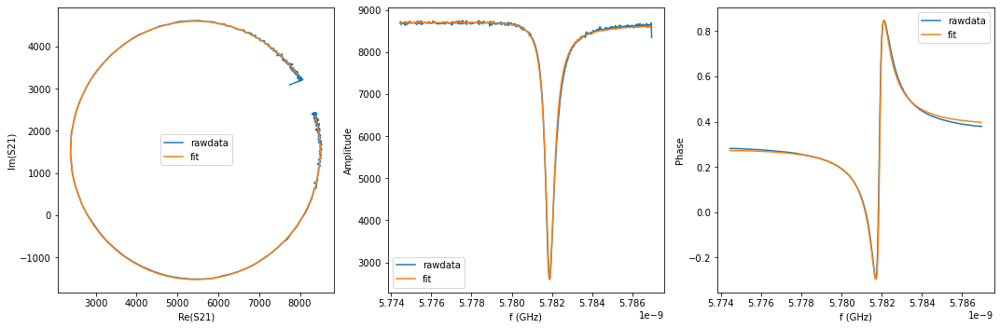

{'Qi_dia_corr': 27023.10910679252, 'Qi_no_corr': 27376.60515213073, 'absQc': 11531.186444497478, 'Qc_dia_corr(Re{Qc})': 11595.074133157175, 'Ql': 8113.663748881786, 'fr': 5.781868893848292, 'theta0': -3.0365672228363123, 'phi0': 0.1050234868029834, 'phi0_err': 0.008216872265248008, 'Ql_err': 189.99735776545455, 'absQc_err': 35.5668910223498, 'fr_err': 3.0278466437950335e-06, 'chi_square': 0.00013417988189897283, 'Qi_no_corr_err': 2155.73481959113, 'Qi_dia_corr_err': 2119.9636648198302, 'delay': -0.5369432716331816, 'a': 8672.643747197291, 'alpha': -0.3254082306219841}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


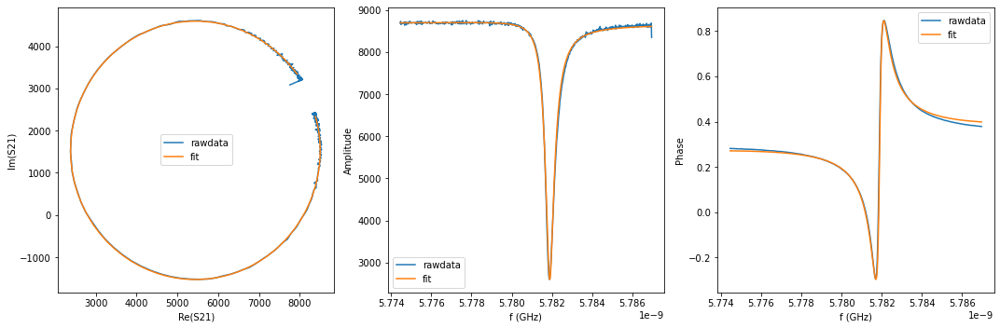

{'Qi_dia_corr': 27074.728937888693, 'Qi_no_corr': 27435.57058746417, 'absQc': 11552.984115677207, 'Qc_dia_corr(Re{Qc})': 11618.187645652066, 'Ql': 8129.6348021840395, 'fr': 5.781866771297776, 'theta0': -3.0355958192198393, 'phi0': 0.10599482936316863, 'phi0_err': 0.008309914571656002, 'Ql_err': 170.84476272287017, 'absQc_err': 36.8612623665932, 'fr_err': 3.0963352724818897e-06, 'chi_square': 0.0001441876175385239, 'Qi_no_corr_err': 1932.2822005351443, 'Qi_dia_corr_err': 1894.9016673312055, 'delay': -0.5775524250497657, 'a': 8673.374439867835, 'alpha': -1.8005135018531606}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


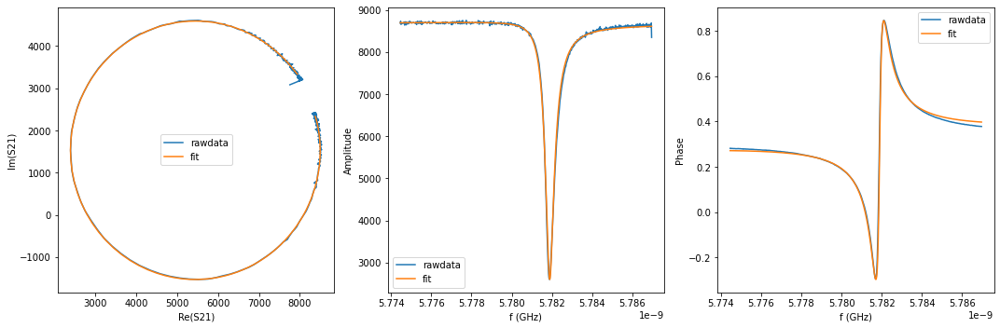

{'Qi_dia_corr': 27021.63495879803, 'Qi_no_corr': 27380.574787995232, 'absQc': 11538.016031186395, 'Qc_dia_corr(Re{Qc})': 11602.964297414785, 'Ql': 8117.393363874886, 'fr': 5.781865254611708, 'theta0': -3.0357340565999458, 'phi0': 0.10585639300689574, 'phi0_err': 0.008175414283594347, 'Ql_err': 166.75896076838487, 'absQc_err': 36.46622168958352, 'fr_err': 3.060258533752512e-06, 'chi_square': 0.00014168913923943456, 'Qi_no_corr_err': 1882.3916570294548, 'Qi_dia_corr_err': 1844.038791358773, 'delay': -0.5572674803201862, 'a': 8675.60471889604, 'alpha': -1.0641347001304462}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


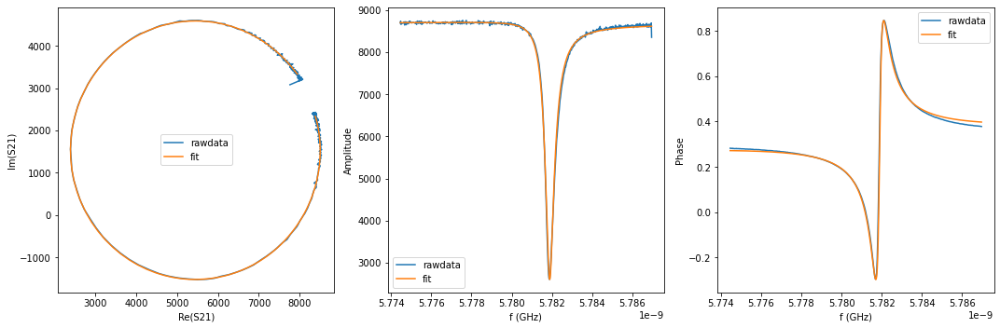

{'Qi_dia_corr': 26988.310662966345, 'Qi_no_corr': 27345.703994702122, 'absQc': 11530.846832122932, 'Qc_dia_corr(Re{Qc})': 11595.596258423171, 'Ql': 8110.779314864278, 'fr': 5.781863632370694, 'theta0': -3.0358625933991044, 'phi0': 0.10572768308975795, 'phi0_err': 0.008205005534955734, 'Ql_err': 152.22953575652159, 'absQc_err': 36.678637362165006, 'fr_err': 3.0982911191420946e-06, 'chi_square': 0.00014383499712035164, 'Qi_no_corr_err': 1715.336155670737, 'Qi_dia_corr_err': 1677.694841770593, 'delay': -0.5542003101028293, 'a': 8677.183154504646, 'alpha': -0.952748330923092}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


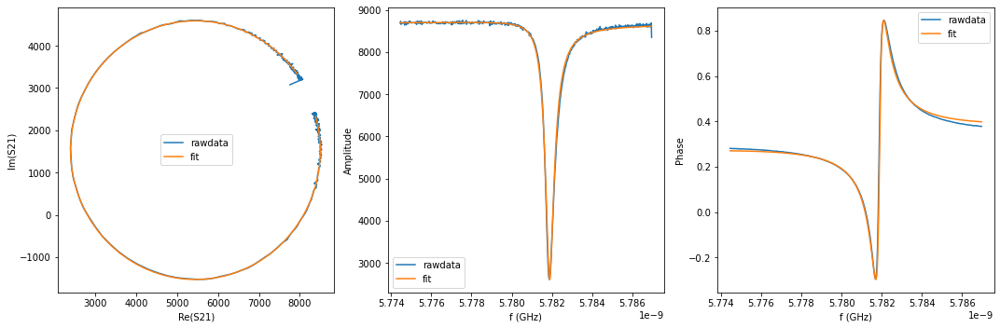

{'Qi_dia_corr': 27015.84022876655, 'Qi_no_corr': 27375.798631278733, 'absQc': 11545.65069337819, 'Qc_dia_corr(Re{Qc})': 11610.89628879824, 'Ql': 8120.751254984029, 'fr': 5.781861821167853, 'theta0': -3.03552769555401, 'phi0': 0.10606236451622361, 'phi0_err': 0.008396149382507111, 'Ql_err': 126.6477558726841, 'absQc_err': 37.89719274751322, 'fr_err': 3.1982841640482407e-06, 'chi_square': 0.0001518953713693773, 'Qi_no_corr_err': 1425.6675735471833, 'Qi_dia_corr_err': 1397.719832422316, 'delay': -0.5808342596333206, 'a': 8677.220160449222, 'alpha': -1.9203743117708396}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


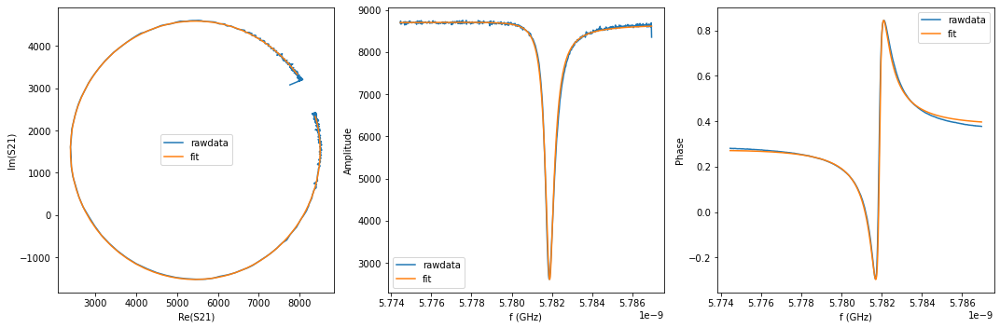

{'Qi_dia_corr': 26941.438638004664, 'Qi_no_corr': 27295.824175816233, 'absQc': 11525.887746517843, 'Qc_dia_corr(Re{Qc})': 11590.26415071526, 'Ql': 8103.934366123404, 'fr': 5.781860582573028, 'theta0': -3.036143068602266, 'phi0': 0.10544668039481067, 'phi0_err': 0.008467497783648846, 'Ql_err': 169.39406214138847, 'absQc_err': 37.132521609323014, 'fr_err': 3.170344967774819e-06, 'chi_square': 0.00014771048869863785, 'Qi_no_corr_err': 1906.763435789448, 'Qi_dia_corr_err': 1869.5540487807689, 'delay': -0.5558432747268215, 'a': 8679.98983249562, 'alpha': -1.0127369756400388}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


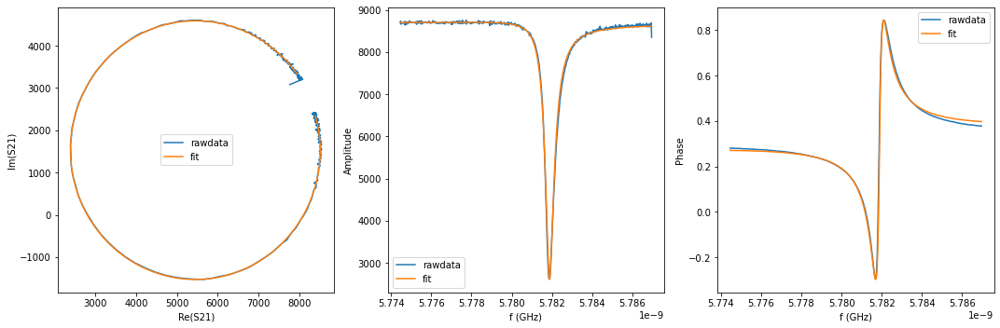

{'Qi_dia_corr': 26983.08960719419, 'Qi_no_corr': 27347.057497814963, 'absQc': 11546.913248833327, 'Qc_dia_corr(Re{Qc})': 11613.054615417446, 'Ql': 8118.8445015051175, 'fr': 5.781858029200813, 'theta0': -3.0348109969759602, 'phi0': 0.10677871389391541, 'phi0_err': 0.008849679587036106, 'Ql_err': 145.2723626868672, 'absQc_err': 38.425875978563184, 'fr_err': 3.343717759166099e-06, 'chi_square': 0.00015502768142001088, 'Qi_no_corr_err': 1646.6595435987176, 'Qi_dia_corr_err': 1622.0887948160082, 'delay': -0.568316027549823, 'a': 8681.236154667204, 'alpha': -1.4656467286891075}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


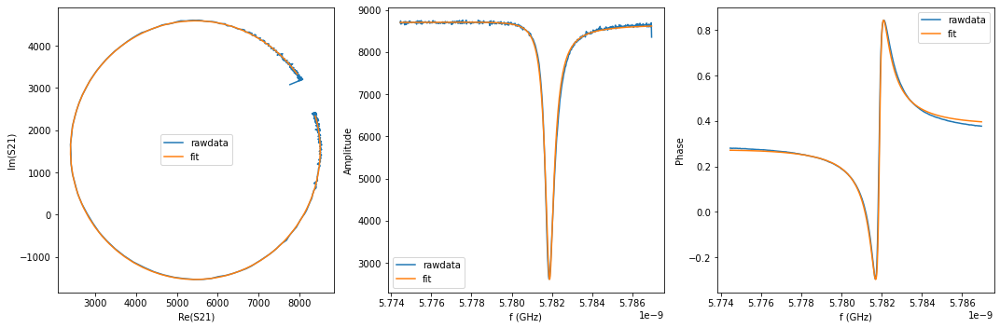

{'Qi_dia_corr': 26909.636934533453, 'Qi_no_corr': 27270.523054876583, 'absQc': 11522.256912503519, 'Qc_dia_corr(Re{Qc})': 11587.91857319642, 'Ql': 8099.908618069045, 'fr': 5.781856466602546, 'theta0': -3.0350836608329645, 'phi0': 0.10650585878540457, 'phi0_err': 0.008343342537373283, 'Ql_err': 140.67250960201116, 'absQc_err': 37.33861149242044, 'fr_err': 3.154954268541818e-06, 'chi_square': 0.00014949334920540466, 'Qi_no_corr_err': 1571.5127497295637, 'Qi_dia_corr_err': 1535.8255036582866, 'delay': -0.5435578461882672, 'a': 8683.341609854971, 'alpha': -0.566552003774701}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


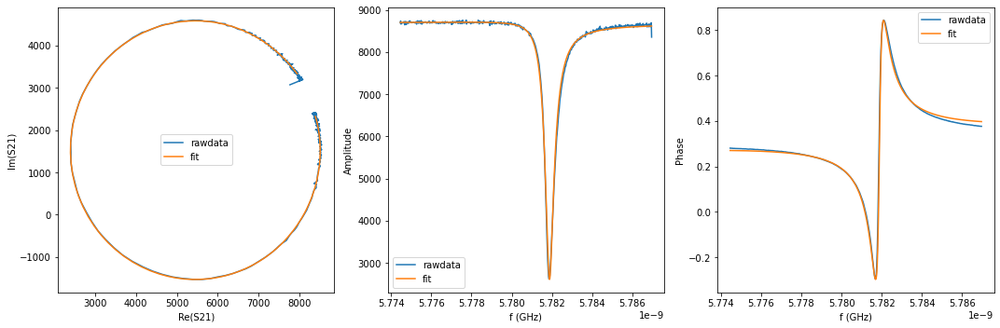

{'Qi_dia_corr': 26951.854605792792, 'Qi_no_corr': 27318.124609316437, 'absQc': 11542.553198409012, 'Qc_dia_corr(Re{Qc})': 11609.213380300269, 'Ql': 8114.138104948751, 'fr': 5.78185432123284, 'theta0': -3.034374555282844, 'phi0': 0.10721483397773034, 'phi0_err': 0.008866314052906147, 'Ql_err': 143.88757538016293, 'absQc_err': 39.18222536026213, 'fr_err': 3.3745399007142452e-06, 'chi_square': 0.0001622924935529823, 'Qi_no_corr_err': 1628.0050821085147, 'Qi_dia_corr_err': 1594.4220590650855, 'delay': -0.5723897274444799, 'a': 8683.848365190024, 'alpha': -1.614003956998049}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


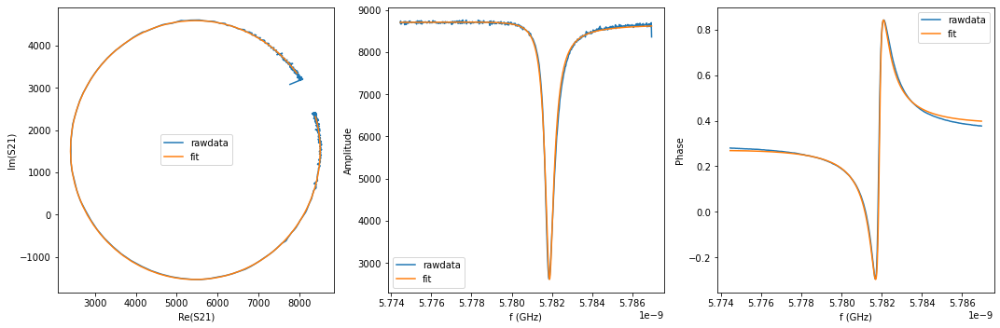

{'Qi_dia_corr': 26938.765701511897, 'Qi_no_corr': 27307.413956589837, 'absQc': 11556.949025559641, 'Qc_dia_corr(Re{Qc})': 11624.271934733184, 'Ql': 8120.302686065285, 'fr': 5.781852246341462, 'theta0': -3.033912150127397, 'phi0': 0.1076771077540343, 'phi0_err': 0.009301149521603245, 'Ql_err': 179.83468597521255, 'absQc_err': 40.134094155440465, 'fr_err': 3.492850344715084e-06, 'chi_square': 0.00017159984170120356, 'Qi_no_corr_err': 2026.156032283219, 'Qi_dia_corr_err': 1982.517527900126, 'delay': -0.6019633018742796, 'a': 8685.55400522417, 'alpha': -2.6881567452259194}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


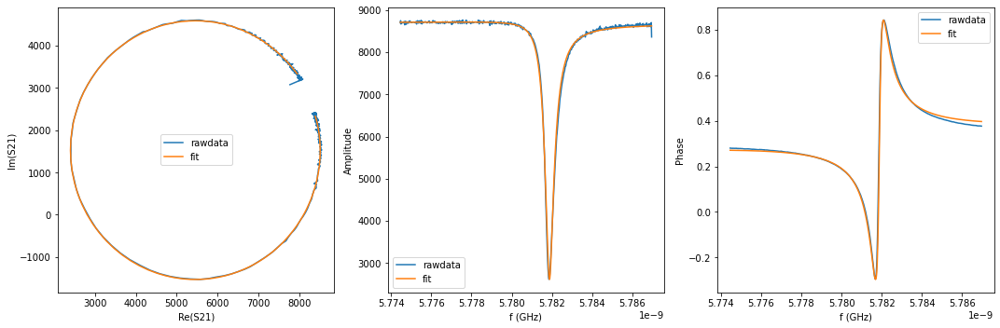

{'Qi_dia_corr': 26883.46662196023, 'Qi_no_corr': 27248.49514050687, 'absQc': 11534.889851642665, 'Qc_dia_corr(Re{Qc})': 11601.575044044232, 'Ql': 8104.202099233703, 'fr': 5.781850625496893, 'theta0': -3.0343185958335686, 'phi0': 0.10727029374305193, 'phi0_err': 0.009277153511827004, 'Ql_err': 169.93705306811236, 'absQc_err': 39.56058845780827, 'fr_err': 3.4914779173185168e-06, 'chi_square': 0.00016592048424728359, 'Qi_no_corr_err': 1923.1172009001898, 'Qi_dia_corr_err': 1889.1586233298704, 'delay': -0.5597304582945152, 'a': 8687.466956747025, 'alpha': -1.1541988891793409}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


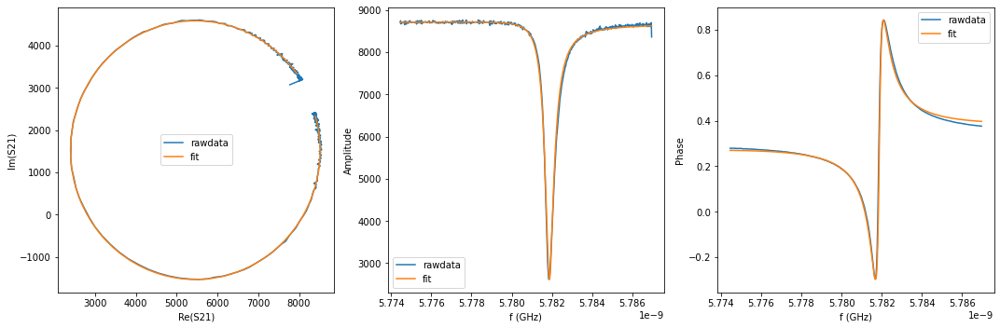

{'Qi_dia_corr': 26924.249790524784, 'Qi_no_corr': 27295.2712440552, 'absQc': 11546.38277135556, 'Qc_dia_corr(Re{Qc})': 11614.084370057395, 'Ql': 8114.012073399158, 'fr': 5.781848455523015, 'theta0': -3.0335615455967013, 'phi0': 0.10802721146023758, 'phi0_err': 0.009685848593385157, 'Ql_err': 231.09530270974938, 'absQc_err': 40.26131037800917, 'fr_err': 3.586826689836202e-06, 'chi_square': 0.00017087266770099313, 'Qi_no_corr_err': 2628.877315526704, 'Qi_dia_corr_err': 2578.9777876195244, 'delay': -0.5745279801979943, 'a': 8688.574863138458, 'alpha': -1.691842024460955}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


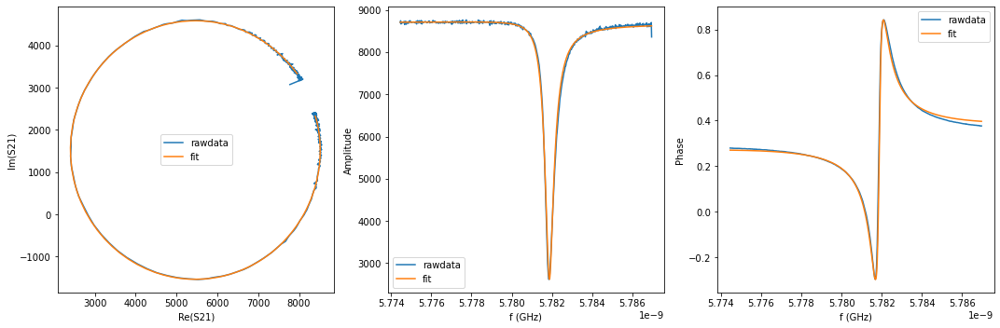

{'Qi_dia_corr': 26872.982926668097, 'Qi_no_corr': 27241.84767052579, 'absQc': 11535.458658207923, 'Qc_dia_corr(Re{Qc})': 11602.898426328531, 'Ql': 8103.894708738268, 'fr': 5.781846585221361, 'theta0': -3.033718576897102, 'phi0': 0.10786992238555922, 'phi0_err': 0.009961607054266228, 'Ql_err': 253.7394077190798, 'absQc_err': 40.032189440321005, 'fr_err': 3.640546243991929e-06, 'chi_square': 0.0001721353101954234, 'Qi_no_corr_err': 2872.2062998078595, 'Qi_dia_corr_err': 2817.4036835424013, 'delay': -0.5626461336063187, 'a': 8690.124108846245, 'alpha': -1.2604365499815218}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


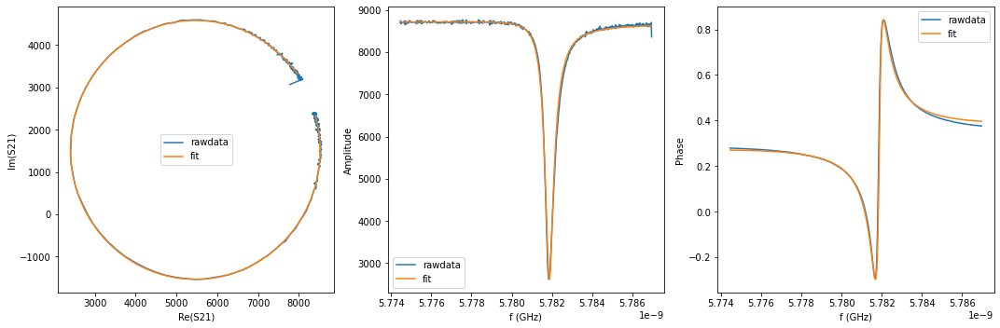

{'Qi_dia_corr': 26850.7365830214, 'Qi_no_corr': 27219.587003315657, 'absQc': 11533.515741891333, 'Qc_dia_corr(Re{Qc})': 11601.04177707179, 'Ql': 8100.965160250294, 'fr': 5.781844622881199, 'theta0': -3.0336406683245727, 'phi0': 0.1079476048584889, 'phi0_err': 0.009799717119989877, 'Ql_err': 239.9354633482191, 'absQc_err': 40.41591957818961, 'fr_err': 3.596083092960619e-06, 'chi_square': 0.00017530944332078754, 'Qi_no_corr_err': 2706.5974347331926, 'Qi_dia_corr_err': 2653.7906524370374, 'delay': -0.5582427715602105, 'a': 8691.204558683497, 'alpha': -1.100684611823748}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


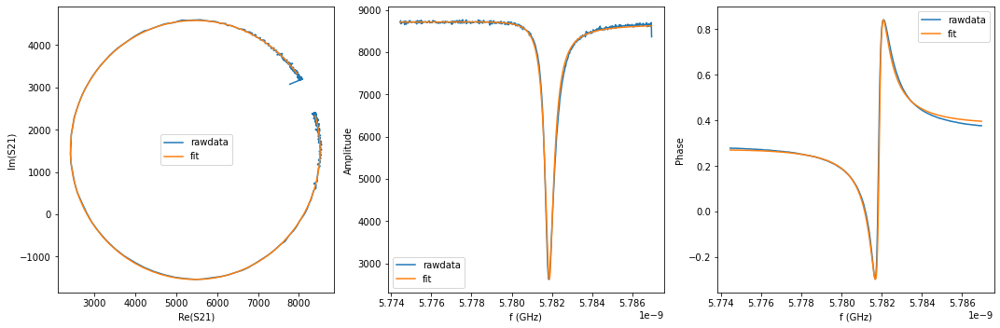

{'Qi_dia_corr': 26842.5248592428, 'Qi_no_corr': 27213.03878592548, 'absQc': 11535.409417623086, 'Qc_dia_corr(Re{Qc})': 11603.301435972833, 'Ql': 8101.319109459435, 'fr': 5.7818425705816905, 'theta0': -3.033358624960993, 'phi0': 0.10822947609210977, 'phi0_err': 0.010004683604569398, 'Ql_err': 277.0692762545576, 'absQc_err': 40.793864334192534, 'fr_err': 3.6290964532936865e-06, 'chi_square': 0.00017791183060107235, 'Qi_no_corr_err': 3127.17110453507, 'Qi_dia_corr_err': 3067.8329902881064, 'delay': -0.5580049624531123, 'a': 8692.489808455115, 'alpha': -1.092241273564138}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


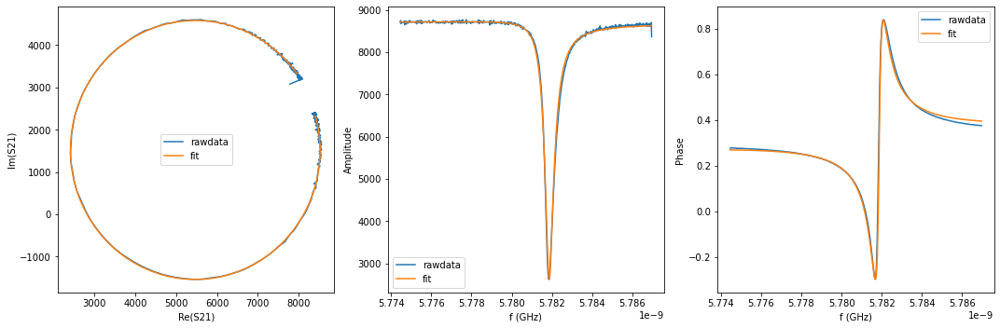

{'Qi_dia_corr': 26831.612315399707, 'Qi_no_corr': 27206.26543694827, 'absQc': 11538.107270630828, 'Qc_dia_corr(Re{Qc})': 11606.839782563335, 'Ql': 8102.0490746868845, 'fr': 5.781840357961796, 'theta0': -3.0327065288185096, 'phi0': 0.10888139050261668, 'phi0_err': 0.010317868631283587, 'Ql_err': 282.0197401154337, 'absQc_err': 41.0906812353131, 'fr_err': 3.773882668832428e-06, 'chi_square': 0.0001817158500932017, 'Qi_no_corr_err': 3184.846876584665, 'Qi_dia_corr_err': 3121.353160292086, 'delay': -0.5622908925317575, 'a': 8694.192321060233, 'alpha': -1.247812272141798}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


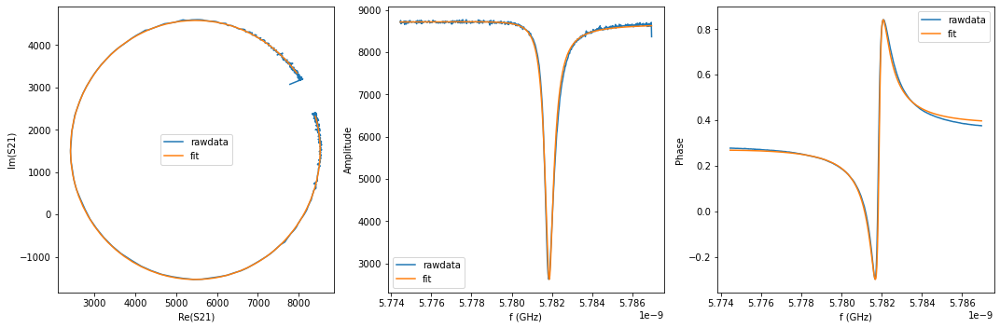

{'Qi_dia_corr': 26865.076657910122, 'Qi_no_corr': 27241.81861024649, 'absQc': 11563.228913567787, 'Qc_dia_corr(Re{Qc})': 11632.47112175372, 'Ql': 8117.587909636157, 'fr': 5.781838086589353, 'theta0': -3.0324234309369897, 'phi0': 0.10916417184277928, 'phi0_err': 0.010754999227208163, 'Ql_err': 289.96214048631964, 'absQc_err': 42.76499946842354, 'fr_err': 3.919484791837631e-06, 'chi_square': 0.00019561401378656343, 'Qi_no_corr_err': 3268.8857023088885, 'Qi_dia_corr_err': 3205.2488610261767, 'delay': -0.5919335588177895, 'a': 8695.25304463107, 'alpha': -2.324479677023182}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


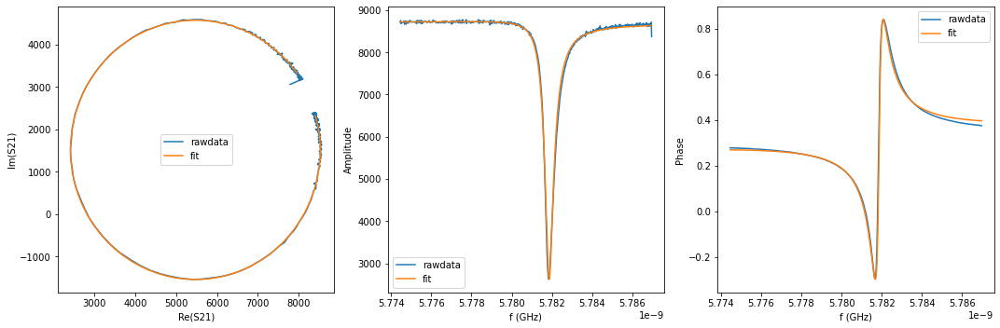

{'Qi_dia_corr': 26794.126995252922, 'Qi_no_corr': 27173.587931393984, 'absQc': 11544.236800348719, 'Qc_dia_corr(Re{Qc})': 11614.113400433078, 'Ql': 8102.168341547493, 'fr': 5.781835890486411, 'theta0': -3.0318371678563665, 'phi0': 0.10975033018818671, 'phi0_err': 0.010360503237467884, 'Ql_err': 255.7930367430353, 'absQc_err': 42.2598956413967, 'fr_err': 3.837764857672598e-06, 'chi_square': 0.00019190853864662957, 'Qi_no_corr_err': 2878.4847091168967, 'Qi_dia_corr_err': 2818.1597989094166, 'delay': -0.5668765947134176, 'a': 8696.92838001574, 'alpha': -1.414692534996403}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


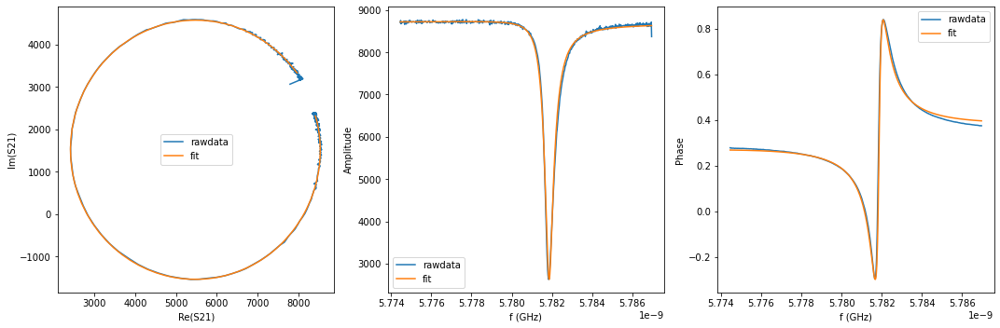

{'Qi_dia_corr': 26801.170973850654, 'Qi_no_corr': 27182.21991293114, 'absQc': 11558.005614175856, 'Qc_dia_corr(Re{Qc})': 11628.303347123277, 'Ql': 8109.716608118112, 'fr': 5.781833567992743, 'theta0': -3.0315736262007817, 'phi0': 0.11001363496338455, 'phi0_err': 0.010592744795303316, 'Ql_err': 252.1114341466753, 'absQc_err': 43.39550958207463, 'fr_err': 3.931792364390052e-06, 'chi_square': 0.00020115204815646364, 'Qi_no_corr_err': 2835.7459012883905, 'Qi_dia_corr_err': 2776.1971791646492, 'delay': -0.5832874960020074, 'a': 8698.13955592382, 'alpha': -2.0108674300328095}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


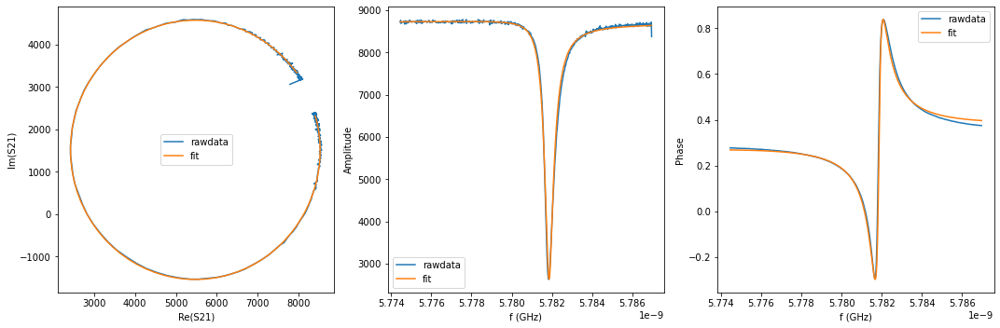

{'Qi_dia_corr': 26790.551956624968, 'Qi_no_corr': 27173.71924357738, 'absQc': 11563.254201253492, 'Qc_dia_corr(Re{Qc})': 11634.06003684188, 'Ql': 8111.542933380837, 'fr': 5.7818312245015875, 'theta0': -3.031203606959466, 'phi0': 0.11038355644724236, 'phi0_err': 0.010416590560470762, 'Ql_err': 167.6945579429453, 'absQc_err': 44.06142753385054, 'fr_err': 3.917432684029926e-06, 'chi_square': 0.0002086391357083714, 'Qi_no_corr_err': 1856.8874651988945, 'Qi_dia_corr_err': 1811.3259232676405, 'delay': -0.5923058404170037, 'a': 8700.543230375664, 'alpha': -2.3383891593551005}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


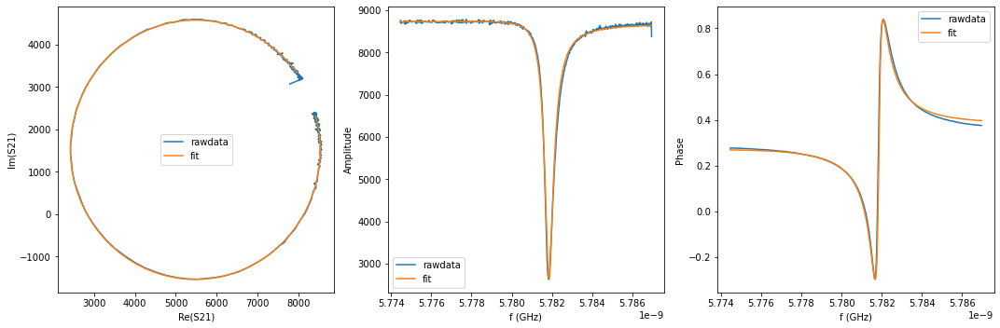

{'Qi_dia_corr': 26787.485841924503, 'Qi_no_corr': 27172.23425467948, 'absQc': 11563.107991103378, 'Qc_dia_corr(Re{Qc})': 11634.218095268046, 'Ql': 8111.338659480255, 'fr': 5.7818288312222785, 'theta0': -3.030966794634818, 'phi0': 0.11061996309814227, 'phi0_err': 0.010419690293834239, 'Ql_err': 178.82021038574587, 'absQc_err': 44.388633191367, 'fr_err': 3.8787354296718186e-06, 'chi_square': 0.00021100179898276734, 'Qi_no_corr_err': 1973.3475050759782, 'Qi_dia_corr_err': 1929.590364689187, 'delay': -0.587688974047899, 'a': 8701.958785989296, 'alpha': -2.1708266212494283}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


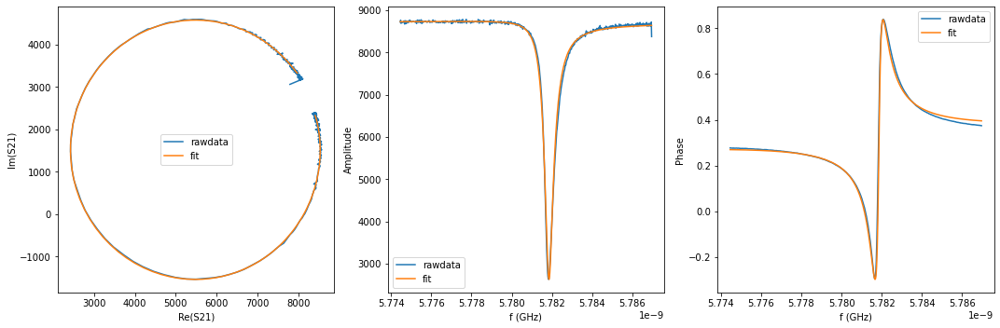

{'Qi_dia_corr': 26722.29014104597, 'Qi_no_corr': 27103.541610655986, 'absQc': 11544.076537943072, 'Qc_dia_corr(Re{Qc})': 11614.655838568855, 'Ql': 8095.851019840388, 'fr': 5.781826915907376, 'theta0': -3.031287637701037, 'phi0': 0.11029877028778738, 'phi0_err': 0.01077945682744771, 'Ql_err': 200.17913267221113, 'absQc_err': 43.99705671338984, 'fr_err': 3.973872103355334e-06, 'chi_square': 0.00020941134994220852, 'Qi_no_corr_err': 2208.420774116946, 'Qi_dia_corr_err': 2162.8563118059888, 'delay': -0.5577745219500656, 'a': 8703.33671549719, 'alpha': -1.0844457566475765}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


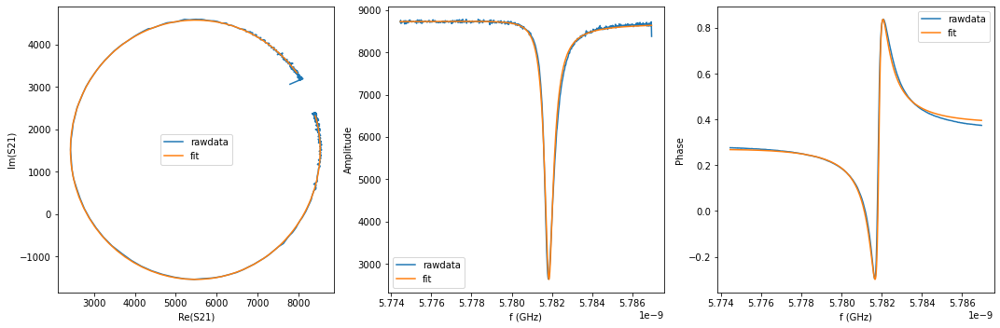

{'Qi_dia_corr': 26757.26512442047, 'Qi_no_corr': 27144.47649346151, 'absQc': 11559.558307602581, 'Qc_dia_corr(Re{Qc})': 11631.237328661044, 'Ql': 8107.117523232727, 'fr': 5.781824294627368, 'theta0': -3.030510055264752, 'phi0': 0.11107628786210799, 'phi0_err': 0.011483280589436711, 'Ql_err': 283.2401232757203, 'absQc_err': 45.03385066074557, 'fr_err': 4.165389341536181e-06, 'chi_square': 0.00021939477397982528, 'Qi_no_corr_err': 3163.4556096037486, 'Qi_dia_corr_err': 3098.755149361185, 'delay': -0.5803522870136897, 'a': 8705.169603589839, 'alpha': -1.9047225460285875}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


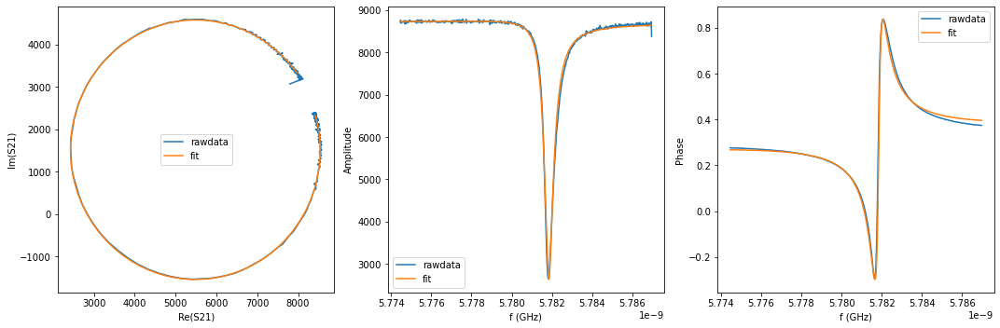

{'Qi_dia_corr': 26731.41608175013, 'Qi_no_corr': 27121.596840760492, 'absQc': 11567.525065114261, 'Qc_dia_corr(Re{Qc})': 11639.988955242961, 'Ql': 8108.991256629746, 'fr': 5.781819334657198, 'theta0': -3.029944453443306, 'phi0': 0.11164135512844978, 'phi0_err': 0.01205882407806234, 'Ql_err': 287.832368517129, 'absQc_err': 46.515288556211615, 'fr_err': 4.363583806589627e-06, 'chi_square': 0.00023406506957764352, 'Qi_no_corr_err': 3204.7217098387273, 'Qi_dia_corr_err': 3141.151282793146, 'delay': -0.589908194499575, 'a': 8707.35920624371, 'alpha': -2.2517562768494903}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


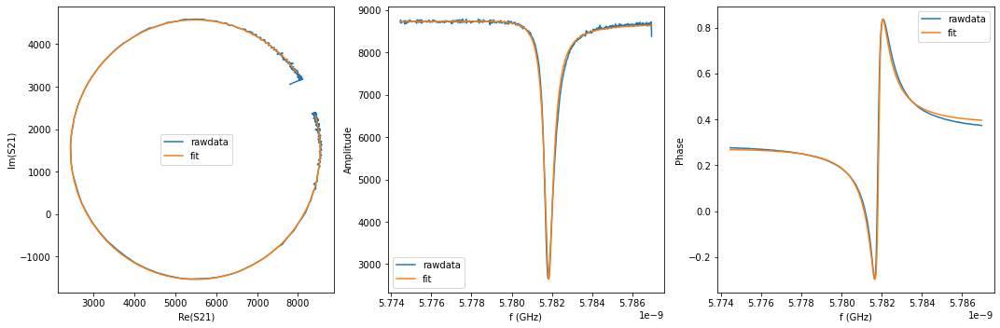

{'Qi_dia_corr': 26708.319896372872, 'Qi_no_corr': 27099.89948110506, 'absQc': 11571.981130408969, 'Qc_dia_corr(Re{Qc})': 11644.88468454238, 'Ql': 8109.23907688, 'fr': 5.781816920081427, 'theta0': -3.029629223819859, 'phi0': 0.11195631366805014, 'phi0_err': 0.012390618551314087, 'Ql_err': 262.6955816317477, 'absQc_err': 47.03804244154631, 'fr_err': 4.5174205327963775e-06, 'chi_square': 0.0002398671760384232, 'Qi_no_corr_err': 2913.98758461733, 'Qi_dia_corr_err': 2860.430535702875, 'delay': -0.5935607378142078, 'a': 8708.71280814778, 'alpha': -2.3845234891063773}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


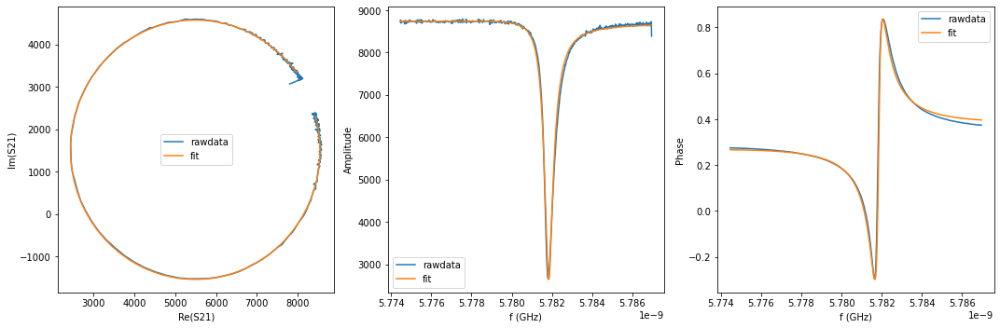

{'Qi_dia_corr': 26734.18328905466, 'Qi_no_corr': 27130.349427873432, 'absQc': 11589.203168607306, 'Qc_dia_corr(Re{Qc})': 11663.03098954077, 'Ql': 8120.422641027936, 'fr': 5.781814147541861, 'theta0': -3.029008245558431, 'phi0': 0.11257673979202869, 'phi0_err': 0.012850690772307561, 'Ql_err': 208.3925216493595, 'absQc_err': 48.409469924504975, 'fr_err': 4.6587437785548084e-06, 'chi_square': 0.00025113143094096665, 'Qi_no_corr_err': 2304.7284608983578, 'Qi_dia_corr_err': 2276.6911141964815, 'delay': -0.6140786166022203, 'a': 8710.065238998011, 'alpha': -3.129786271268976}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


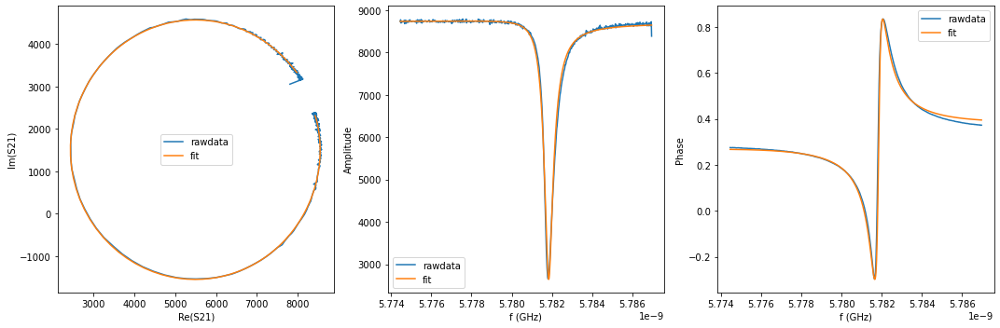

{'Qi_dia_corr': 26682.38137528689, 'Qi_no_corr': 27078.287524388055, 'absQc': 11570.953749268485, 'Qc_dia_corr(Re{Qc})': 11644.786175546153, 'Ql': 8106.7985354643715, 'fr': 5.781811701117822, 'theta0': -3.028916350917623, 'phi0': 0.11266850774136394, 'phi0_err': 0.012934877242570102, 'Ql_err': 226.81754881875176, 'absQc_err': 48.3973240720682, 'fr_err': 4.684473735773062e-06, 'chi_square': 0.0002530221332991071, 'Qi_no_corr_err': 2515.138407445323, 'Qi_dia_corr_err': 2477.8005856876425, 'delay': -0.5869866057274322, 'a': 8712.865703071953, 'alpha': -2.14586994888284}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


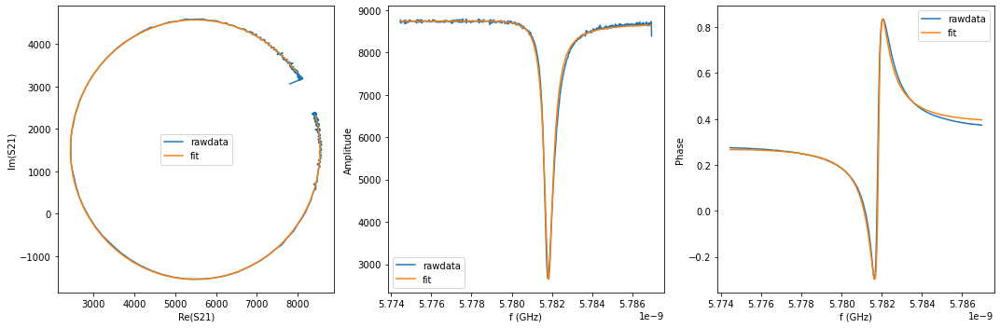

{'Qi_dia_corr': 26687.38123865836, 'Qi_no_corr': 27088.348478410182, 'absQc': 11579.388532236719, 'Qc_dia_corr(Re{Qc})': 11654.238207485148, 'Ql': 8111.840412118478, 'fr': 5.781808706381143, 'theta0': -3.028187932891774, 'phi0': 0.11339678088239945, 'phi0_err': 0.013135040726190159, 'Ql_err': 291.4796979391014, 'absQc_err': 49.02613194386573, 'fr_err': 4.726478743904748e-06, 'chi_square': 0.0002603970610020166, 'Qi_no_corr_err': 3229.271254530086, 'Qi_dia_corr_err': 3168.2559940083624, 'delay': -0.6056313803781354, 'a': 8714.253445831519, 'alpha': -2.8230158173431277}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


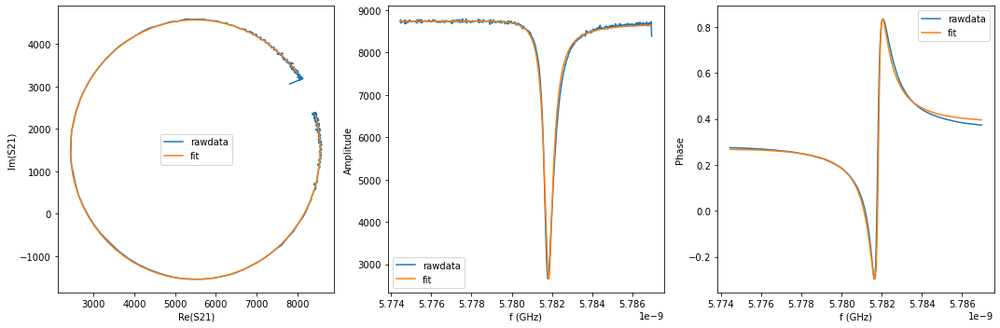

{'Qi_dia_corr': 26640.793090972846, 'Qi_no_corr': 27041.301008364335, 'absQc': 11587.33628928052, 'Qc_dia_corr(Re{Qc})': 11662.465766524356, 'Ql': 8111.511831733234, 'fr': 5.781806093568177, 'theta0': -3.028015769093337, 'phi0': 0.11356863594071516, 'phi0_err': 0.012936406901328211, 'Ql_err': 222.87700867786356, 'absQc_err': 50.03451508305835, 'fr_err': 4.703252164617251e-06, 'chi_square': 0.00026939824227103983, 'Qi_no_corr_err': 2446.196368653473, 'Qi_dia_corr_err': 2403.8921766379367, 'delay': -0.5982539105141768, 'a': 8715.650919369386, 'alpha': -2.555323780146757}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


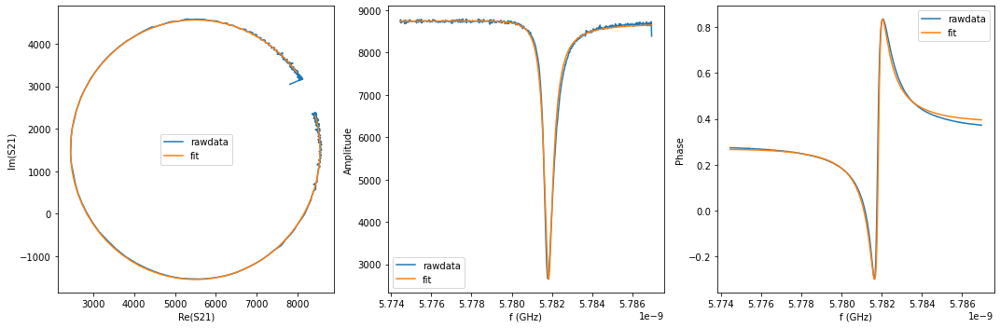

{'Qi_dia_corr': 26652.961312437994, 'Qi_no_corr': 27056.58661255601, 'absQc': 11587.818517510288, 'Qc_dia_corr(Re{Qc})': 11663.465077611692, 'Ql': 8113.123085071529, 'fr': 5.781803218543324, 'theta0': -3.0276301576128053, 'phi0': 0.11395432176671765, 'phi0_err': 0.012896916169959444, 'Ql_err': 201.1123038241077, 'absQc_err': 50.69174672237233, 'fr_err': 4.7806908636905235e-06, 'chi_square': 0.00027464145054175413, 'Qi_no_corr_err': 2226.1181394160785, 'Qi_dia_corr_err': 2187.6055598593352, 'delay': -0.6003317587816273, 'a': 8717.323523375624, 'alpha': -2.6311669632818018}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


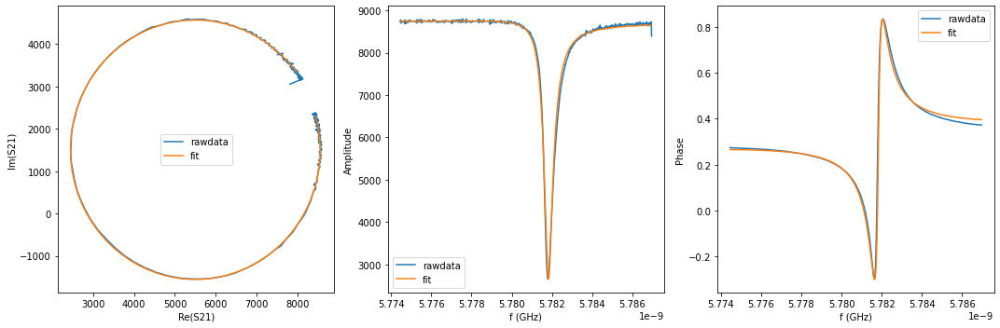

{'Qi_dia_corr': 26660.283940592068, 'Qi_no_corr': 27065.625077327506, 'absQc': 11597.9563734675, 'Qc_dia_corr(Re{Qc})': 11674.01342904976, 'Ql': 8118.904847626778, 'fr': 5.781800481409999, 'theta0': -3.027372044671547, 'phi0': 0.1142117348149054, 'phi0_err': 0.014169726400684238, 'Ql_err': 322.76543504786616, 'absQc_err': 51.59560067186933, 'fr_err': 5.0882109339081e-06, 'chi_square': 0.00028594567697368757, 'Qi_no_corr_err': 3593.924685197606, 'Qi_dia_corr_err': 3522.3654481260714, 'delay': -0.6169342554198404, 'a': 8718.154113091241, 'alpha': 3.0487923810515007}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


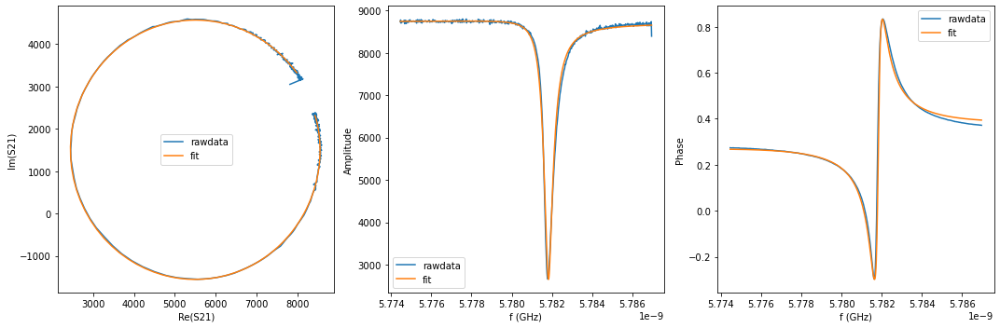

{'Qi_dia_corr': 26577.468863499187, 'Qi_no_corr': 26978.1534268081, 'absQc': 11566.167286631793, 'Qc_dia_corr(Re{Qc})': 11641.411286735673, 'Ql': 8095.455565003101, 'fr': 5.781797951632145, 'theta0': -3.0278251340344475, 'phi0': 0.1137580968430713, 'phi0_err': 0.013938145107229342, 'Ql_err': 318.7562217056602, 'absQc_err': 51.39120269522825, 'fr_err': 5.055997151281253e-06, 'chi_square': 0.00028549489284709136, 'Qi_no_corr_err': 3548.062703305294, 'Qi_dia_corr_err': 3475.312784302065, 'delay': -0.5742472287428495, 'a': 8720.733578719342, 'alpha': -1.6839589923651157}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


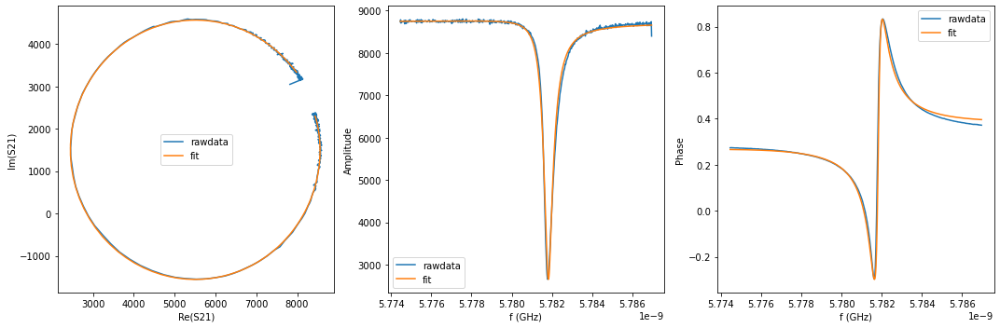

{'Qi_dia_corr': 26596.24610358658, 'Qi_no_corr': 27005.508322836416, 'absQc': 11597.657892196217, 'Qc_dia_corr(Re{Qc})': 11674.81022805222, 'Ql': 8113.3408847471555, 'fr': 5.781794538602978, 'theta0': -3.0265551259362513, 'phi0': 0.11502813551044386, 'phi0_err': 0.01462527961172094, 'Ql_err': 377.1003701281574, 'absQc_err': 52.89583397752097, 'fr_err': 5.265183366121955e-06, 'chi_square': 0.00030121140726746033, 'Qi_no_corr_err': 4189.3194685156805, 'Qi_dia_corr_err': 4097.6194931715745, 'delay': -0.6170925316711148, 'a': 8722.063587571012, 'alpha': 3.0429685584943535}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


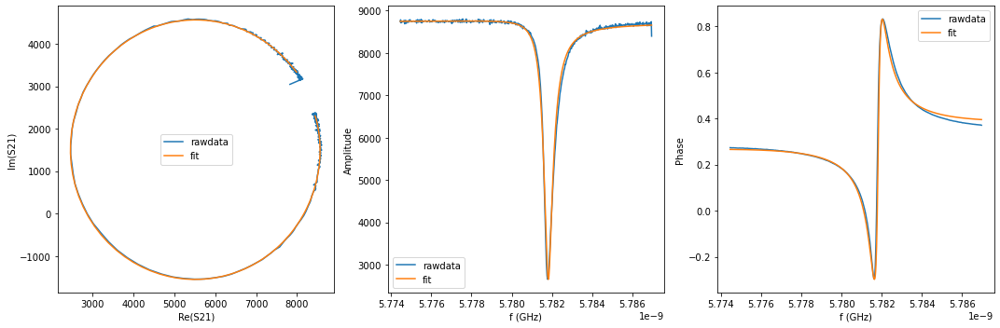

{'Qi_dia_corr': 26550.26445791554, 'Qi_no_corr': 26959.508537707607, 'absQc': 11595.26814356932, 'Qc_dia_corr(Re{Qc})': 11672.652277767826, 'Ql': 8108.01559292582, 'fr': 5.781791597679509, 'theta0': -3.0263711606410966, 'phi0': 0.11521165367965992, 'phi0_err': 0.014823835994946436, 'Ql_err': 374.41745254524596, 'absQc_err': 53.56833041081588, 'fr_err': 5.374052575776506e-06, 'chi_square': 0.00030959343099678025, 'Qi_no_corr_err': 4150.207234118768, 'Qi_dia_corr_err': 4057.8368212678934, 'delay': -0.6123041758851494, 'a': 8723.055766084308, 'alpha': -3.0661808391424463}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


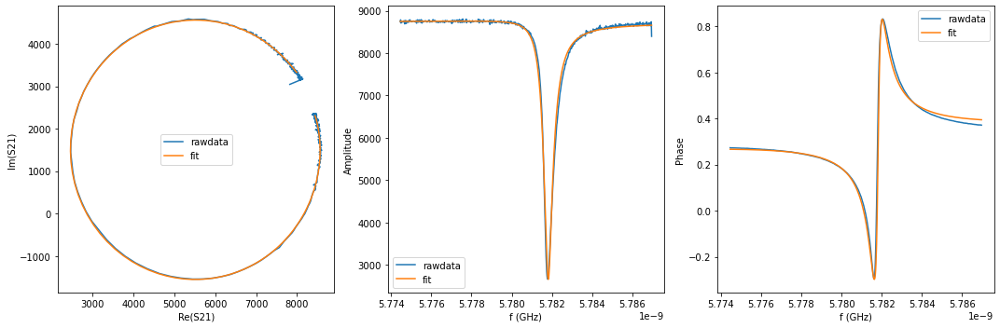

{'Qi_dia_corr': 26511.759955330363, 'Qi_no_corr': 26920.78806866816, 'absQc': 11589.659711741317, 'Qc_dia_corr(Re{Qc})': 11667.152698077978, 'Ql': 8101.769542302948, 'fr': 5.781788721078156, 'theta0': -3.026262464449669, 'phi0': 0.11531994594942879, 'phi0_err': 0.015044853806167865, 'Ql_err': 371.6131716577932, 'absQc_err': 53.65608879497983, 'fr_err': 5.405886155689084e-06, 'chi_square': 0.00031320900075954895, 'Qi_no_corr_err': 4100.396408933921, 'Qi_dia_corr_err': 4012.493994892899, 'delay': -0.5924552741093562, 'a': 8724.930133971904, 'alpha': -2.3455008738532244}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


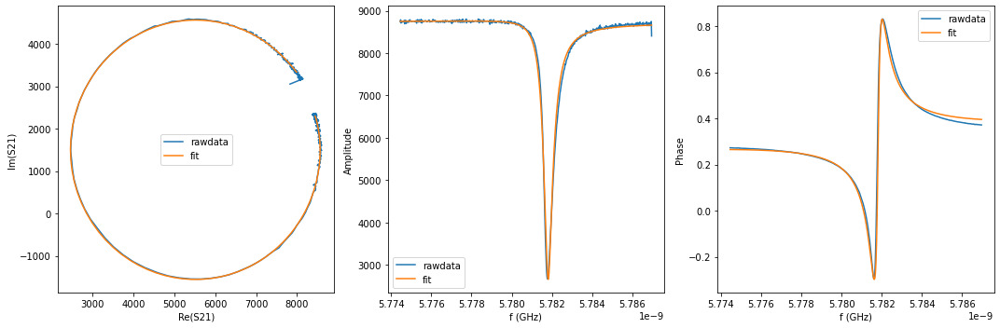

{'Qi_dia_corr': 26521.138785559164, 'Qi_no_corr': 26931.72358496152, 'absQc': 11603.052794437408, 'Qc_dia_corr(Re{Qc})': 11680.963562877763, 'Ql': 8109.303853870656, 'fr': 5.781785811336901, 'theta0': -3.026019893489577, 'phi0': 0.11556227803097746, 'phi0_err': 0.01425285539458198, 'Ql_err': 213.74554415906164, 'absQc_err': 55.077994602927454, 'fr_err': 5.316067800600955e-06, 'chi_square': 0.00032831040533209184, 'Qi_no_corr_err': 2324.424236640363, 'Qi_dia_corr_err': 2262.2752207242183, 'delay': -0.6240809680693266, 'a': 8726.655809063344, 'alpha': 2.7888970230999717}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


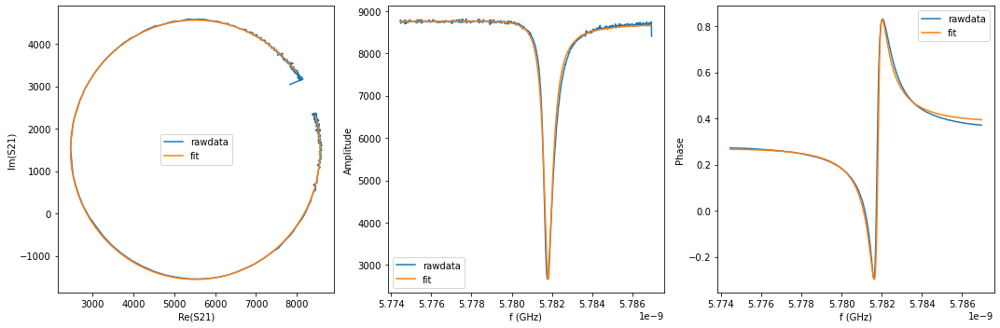

{'Qi_dia_corr': 26488.09852057323, 'Qi_no_corr': 26900.987750297543, 'absQc': 11584.794646249478, 'Qc_dia_corr(Re{Qc})': 11663.086464584761, 'Ql': 8097.598631551547, 'fr': 5.781782908391224, 'theta0': -3.0256484356191153, 'phi0': 0.11593369651688223, 'phi0_err': 0.014661013749277018, 'Ql_err': 216.4681202951978, 'absQc_err': 55.265422173766545, 'fr_err': 5.429631996571675e-06, 'chi_square': 0.00033058437212039155, 'Qi_no_corr_err': 2369.629489930158, 'Qi_dia_corr_err': 2326.8696027398937, 'delay': -0.5940155226418612, 'a': 8728.636860455756, 'alpha': -2.402316359635179}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


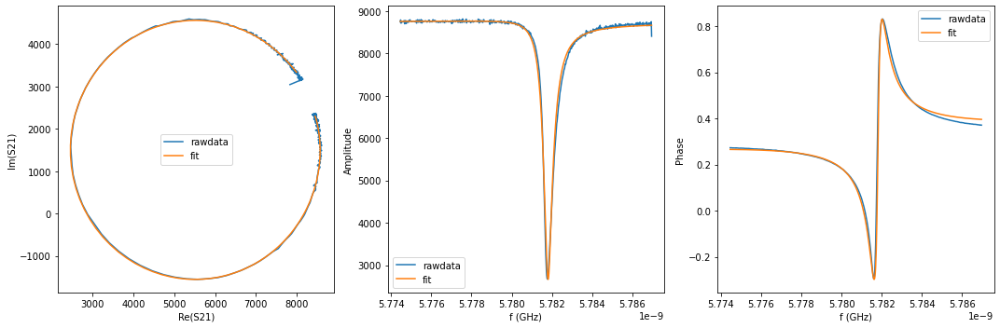

{'Qi_dia_corr': 26515.719492183445, 'Qi_no_corr': 26932.583418519658, 'absQc': 11608.840159958387, 'Qc_dia_corr(Re{Qc})': 11688.043507245502, 'Ql': 8112.208293596371, 'fr': 5.781779619295446, 'theta0': -3.02509875490499, 'phi0': 0.11648269469059704, 'phi0_err': 0.016130844402805745, 'Ql_err': 383.70998323716526, 'absQc_err': 56.955200337145946, 'fr_err': 5.787717556257151e-06, 'chi_square': 0.00034786463108918436, 'Qi_no_corr_err': 4245.316665705878, 'Qi_dia_corr_err': 4154.2319423880845, 'delay': -0.6231294709382721, 'a': 8729.700074416563, 'alpha': 2.823521552646584}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


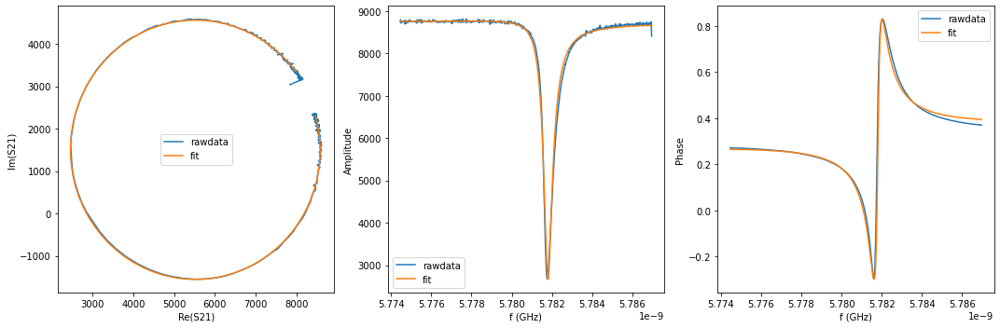

{'Qi_dia_corr': 26475.079399094513, 'Qi_no_corr': 26892.553136821138, 'absQc': 11601.544133920297, 'Qc_dia_corr(Re{Qc})': 11681.005472632352, 'Ql': 8105.012565855602, 'fr': 5.781776305235616, 'theta0': -3.0248734322063497, 'phi0': 0.11670765024548993, 'phi0_err': 0.015507672021642558, 'Ql_err': 310.69008052538635, 'absQc_err': 57.40876232914454, 'fr_err': 5.740574361016949e-06, 'chi_square': 0.00035450281048075307, 'Qi_no_corr_err': 3428.326933184476, 'Qi_dia_corr_err': 3345.10559605151, 'delay': -0.6155775905460847, 'a': 8731.451842733766, 'alpha': 3.0975569801117504}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


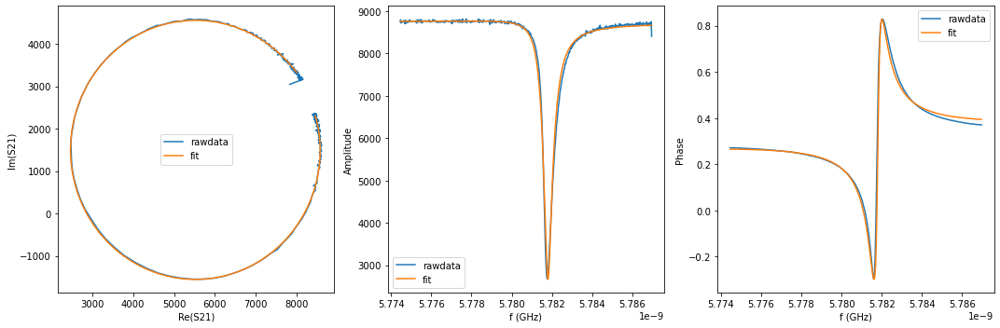

{'Qi_dia_corr': 26400.457583353458, 'Qi_no_corr': 26817.87357004103, 'absQc': 11587.509574636524, 'Qc_dia_corr(Re{Qc})': 11667.215500421304, 'Ql': 8091.375253140995, 'fr': 5.781773099163247, 'theta0': -3.024624269574952, 'phi0': 0.11695646893485909, 'phi0_err': 0.015551870247479924, 'Ql_err': 282.7814779019263, 'absQc_err': 57.55356391606027, 'fr_err': 5.81014195277561e-06, 'chi_square': 0.00035998871171544385, 'Qi_no_corr_err': 3103.5723507423772, 'Qi_dia_corr_err': 3022.17105845699, 'delay': -0.6013531455670144, 'a': 8733.157501955196, 'alpha': -2.669069410628328}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


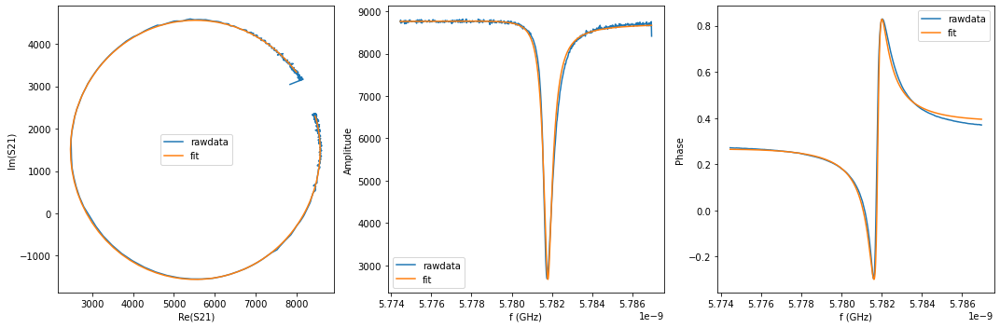

{'Qi_dia_corr': 26438.82933554222, 'Qi_no_corr': 26861.012295232893, 'absQc': 11608.476540367836, 'Qc_dia_corr(Re{Qc})': 11689.14318818021, 'Ql': 8105.525717076344, 'fr': 5.781769715288616, 'theta0': -3.024030847572412, 'phi0': 0.11754948617348224, 'phi0_err': 0.016551622081322444, 'Ql_err': 348.06336194162714, 'absQc_err': 58.63731489139212, 'fr_err': 6.001372539308707e-06, 'chi_square': 0.0003756398652991394, 'Qi_no_corr_err': 3798.6066830437726, 'Qi_dia_corr_err': 3709.0624216662845, 'delay': -0.6233045174546618, 'a': 8734.476850506386, 'alpha': 2.8168019181832893}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


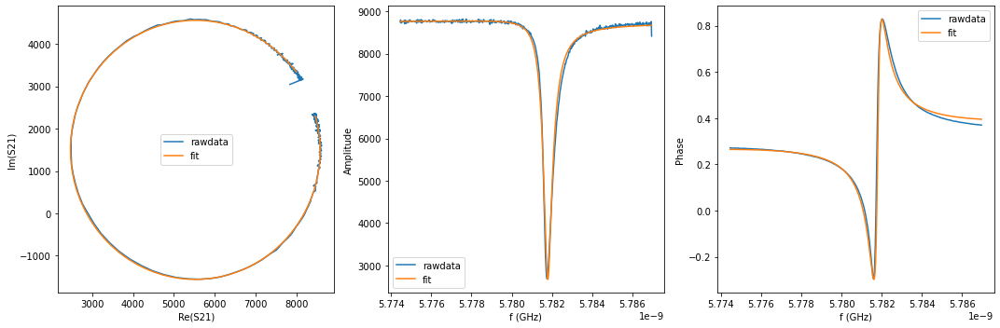

{'Qi_dia_corr': 26420.982835166753, 'Qi_no_corr': 26847.611513967, 'absQc': 11609.604711296668, 'Qc_dia_corr(Re{Qc})': 11691.239147843578, 'Ql': 8104.854893653368, 'fr': 5.781766061214619, 'theta0': -3.0233371865942225, 'phi0': 0.11824273207378048, 'phi0_err': 0.017390457893738973, 'Ql_err': 317.4142053708935, 'absQc_err': 59.601434169576315, 'fr_err': 6.233911459699857e-06, 'chi_square': 0.0003881991391228223, 'Qi_no_corr_err': 3453.4527315762957, 'Qi_dia_corr_err': 3387.2746114494857, 'delay': -0.6256910825048673, 'a': 8735.798219479753, 'alpha': 2.7302050050337483}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


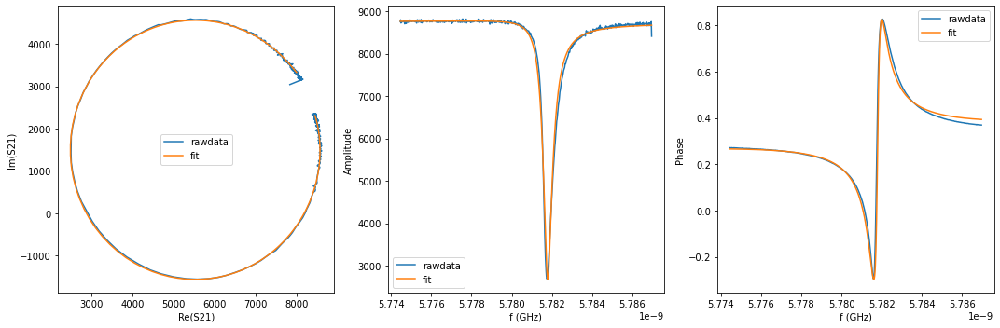

{'Qi_dia_corr': 26333.981622470812, 'Qi_no_corr': 26755.842647395297, 'absQc': 11592.104081136511, 'Qc_dia_corr(Re{Qc})': 11673.122461254356, 'Ql': 8087.956180359282, 'fr': 5.781762969591202, 'theta0': -3.0236929401784773, 'phi0': 0.11788668718248291, 'phi0_err': 0.017396923306000317, 'Ql_err': 271.01410625703045, 'absQc_err': 59.93455133249682, 'fr_err': 6.253953883687079e-06, 'chi_square': 0.0003922042533547472, 'Qi_no_corr_err': 2939.237804719694, 'Qi_dia_corr_err': 2895.0575529294847, 'delay': -0.587837152900708, 'a': 8737.40650467113, 'alpha': -2.1782690290149076}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


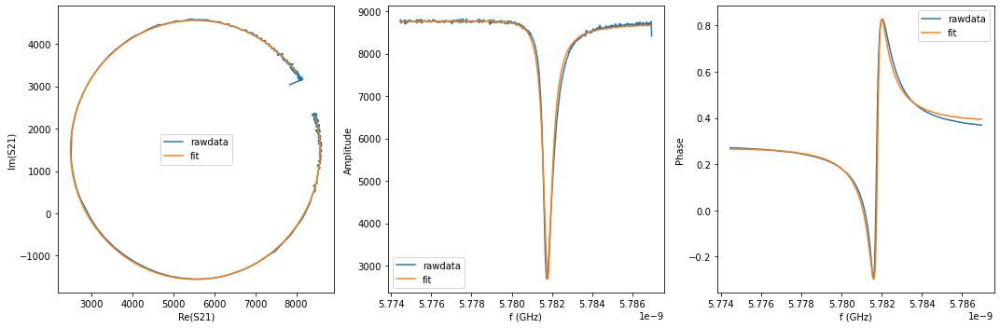

{'Qi_dia_corr': 26321.233184622313, 'Qi_no_corr': 26743.101853635682, 'absQc': 11589.988666472475, 'Qc_dia_corr(Re{Qc})': 11671.057228855016, 'Ql': 8085.76201878027, 'fr': 5.781759768415159, 'theta0': -3.0236452275294328, 'phi0': 0.11793367811412948, 'phi0_err': 0.017881520535146363, 'Ql_err': 383.43886939447543, 'absQc_err': 60.89390300109709, 'fr_err': 6.413091542331407e-06, 'chi_square': 0.0004051043210882483, 'Qi_no_corr_err': 4195.14979318369, 'Qi_dia_corr_err': 4105.948520000507, 'delay': -0.5914674683849105, 'a': 8738.72247832348, 'alpha': -2.310433856808228}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


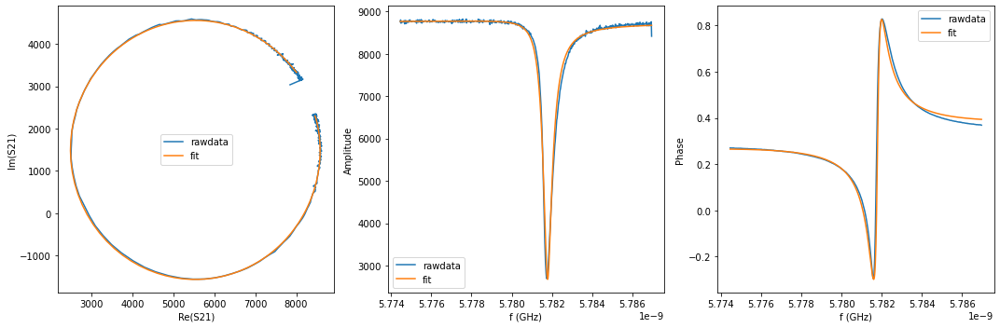

{'Qi_dia_corr': 26317.614767101608, 'Qi_no_corr': 26743.20985990026, 'absQc': 11593.00311692541, 'Qc_dia_corr(Re{Qc})': 11674.846521395579, 'Ql': 8087.238962539948, 'fr': 5.781756092918112, 'theta0': -3.0231011064615623, 'phi0': 0.11847733771154692, 'phi0_err': 0.018624090472915696, 'Ql_err': 429.35838048539955, 'absQc_err': 61.679266238443915, 'fr_err': 6.665448635818608e-06, 'chi_square': 0.000419068414536155, 'Qi_no_corr_err': 4689.9447336925905, 'Qi_dia_corr_err': 4583.073834878577, 'delay': -0.6034308280836205, 'a': 8739.76042130837, 'alpha': -2.744989248990476}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


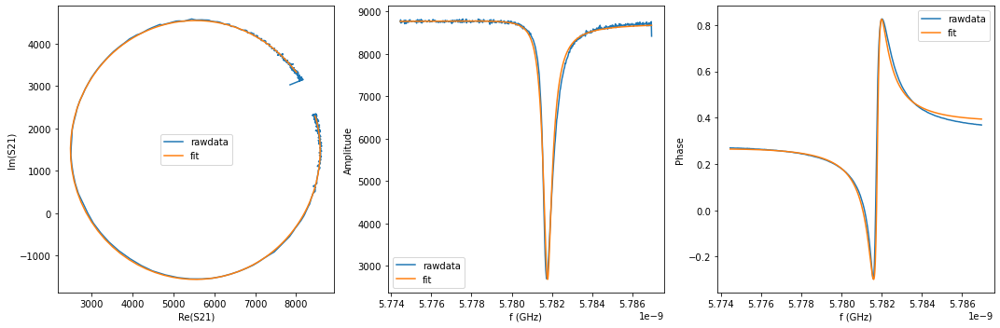

{'Qi_dia_corr': 26302.152202284775, 'Qi_no_corr': 26734.65057988026, 'absQc': 11607.645378818343, 'Qc_dia_corr(Re{Qc})': 11691.113123371013, 'Ql': 8093.577484043894, 'fr': 5.781752144987993, 'theta0': -3.022012955962442, 'phi0': 0.11956529193912639, 'phi0_err': 0.018644486034306205, 'Ql_err': 409.9159821358732, 'absQc_err': 62.71135363473816, 'fr_err': 6.680581332844809e-06, 'chi_square': 0.00043099602664119864, 'Qi_no_corr_err': 4459.822751730345, 'Qi_dia_corr_err': 4359.619527857497, 'delay': -0.616029936616913, 'a': 8741.1030847225, 'alpha': 3.0805405469434928}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


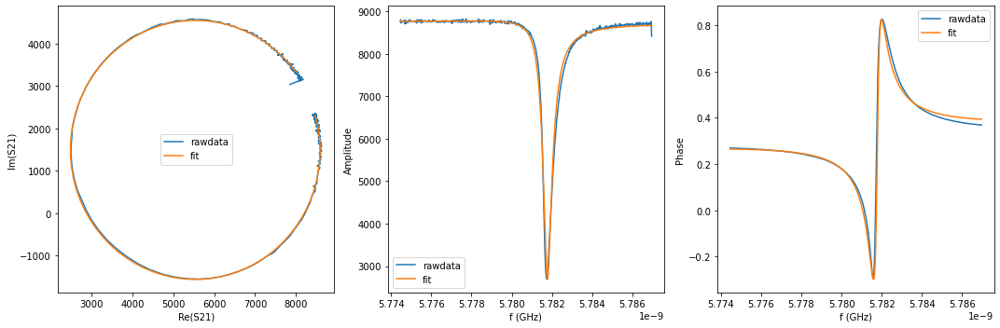

{'Qi_dia_corr': 26284.338799163263, 'Qi_no_corr': 26714.38861872289, 'absQc': 11607.08206261964, 'Qc_dia_corr(Re{Qc})': 11690.185874583642, 'Ql': 8091.4457466580125, 'fr': 5.7817488175071095, 'theta0': -3.0222689129712936, 'phi0': 0.11930877212284459, 'phi0_err': 0.0188537330468703, 'Ql_err': 303.9182938527561, 'absQc_err': 63.73261199105873, 'fr_err': 6.823995450796176e-06, 'chi_square': 0.0004446061112755815, 'Qi_no_corr_err': 3288.9135377965526, 'Qi_dia_corr_err': 3229.009774593887, 'delay': -0.6047286508758338, 'a': 8742.680052831058, 'alpha': -2.7923366402326355}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


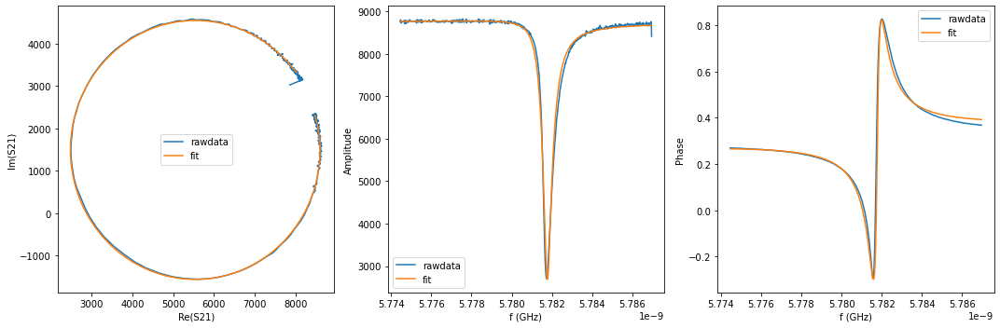

{'Qi_dia_corr': 26205.961121779397, 'Qi_no_corr': 26635.370939989003, 'absQc': 11584.737242109277, 'Qc_dia_corr(Re{Qc})': 11667.892889657604, 'Ql': 8073.335957495075, 'fr': 5.7817452167146515, 'theta0': -3.022117003704199, 'phi0': 0.11946011373593075, 'phi0_err': 0.018002541176363004, 'Ql_err': 245.73968772957372, 'absQc_err': 64.38535518223337, 'fr_err': 6.7450576368038394e-06, 'chi_square': 0.0004528988581058422, 'Qi_no_corr_err': 2660.596106399414, 'Qi_dia_corr_err': 2592.9268007847736, 'delay': -0.5777030201846497, 'a': 8744.811430255148, 'alpha': -1.8108953843353635}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


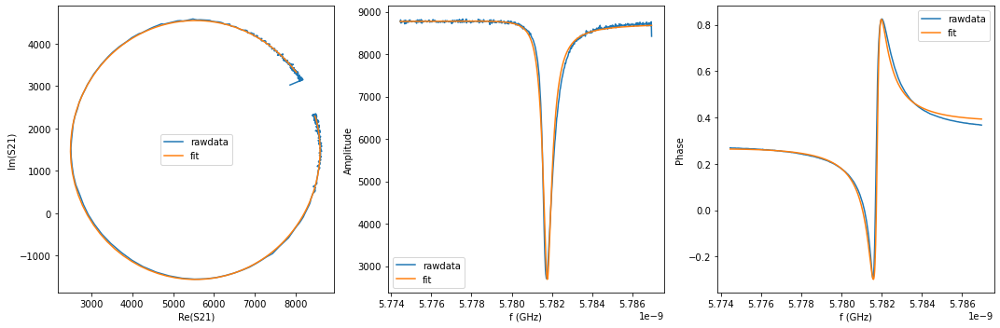

{'Qi_dia_corr': 26232.95014224178, 'Qi_no_corr': 26666.205919951168, 'absQc': 11614.900932869754, 'Qc_dia_corr(Re{Qc})': 11699.060305674204, 'Ql': 8090.814646675093, 'fr': 5.7817414548872295, 'theta0': -3.0215571836031607, 'phi0': 0.12001939835703555, 'phi0_err': 0.02020726705434622, 'Ql_err': 423.99985024410086, 'absQc_err': 65.93857069376426, 'fr_err': 7.2898375103047895e-06, 'chi_square': 0.0004759592212103758, 'Qi_no_corr_err': 4609.233721613672, 'Qi_dia_corr_err': 4502.024883657962, 'delay': -0.6159923203074926, 'a': 8745.472530616604, 'alpha': 3.081380215338562}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


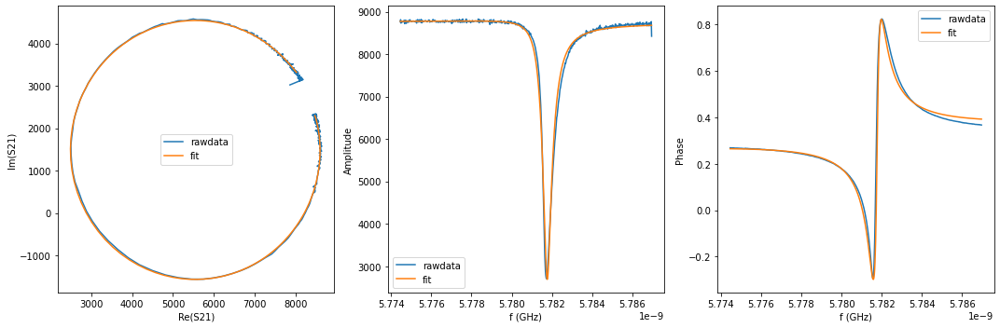

{'Qi_dia_corr': 26170.008999468217, 'Qi_no_corr': 26606.90641644702, 'absQc': 11601.104399826594, 'Qc_dia_corr(Re{Qc})': 11686.169760737335, 'Ql': 8078.659226147125, 'fr': 5.781737275949552, 'theta0': -3.020845164442963, 'phi0': 0.12073107573918154, 'phi0_err': 0.02003477999991362, 'Ql_err': 404.43504673443726, 'absQc_err': 66.38889373568298, 'fr_err': 7.333390641974285e-06, 'chi_square': 0.00048327798724527365, 'Qi_no_corr_err': 4391.40963081931, 'Qi_dia_corr_err': 4281.152283572172, 'delay': -0.5935559882489766, 'a': 8746.96457143372, 'alpha': -2.3868959567607715}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


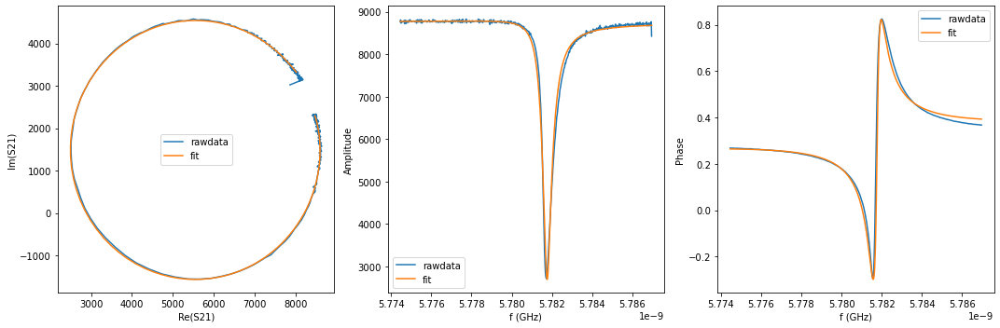

{'Qi_dia_corr': 26147.248259458047, 'Qi_no_corr': 26585.209904907777, 'absQc': 11605.866386603719, 'Qc_dia_corr(Re{Qc})': 11691.355820133404, 'Ql': 8078.96566362943, 'fr': 5.781733153265281, 'theta0': -3.0205709888343737, 'phi0': 0.12100512675159297, 'phi0_err': 0.0197307956108879, 'Ql_err': 297.6612835993222, 'absQc_err': 67.51032491231874, 'fr_err': 7.370309995956966e-06, 'chi_square': 0.0005017128097041351, 'Qi_no_corr_err': 3187.996892893318, 'Qi_dia_corr_err': 3089.20189906855, 'delay': -0.606462360794911, 'a': 8748.841866394061, 'alpha': -2.8558158988409383}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


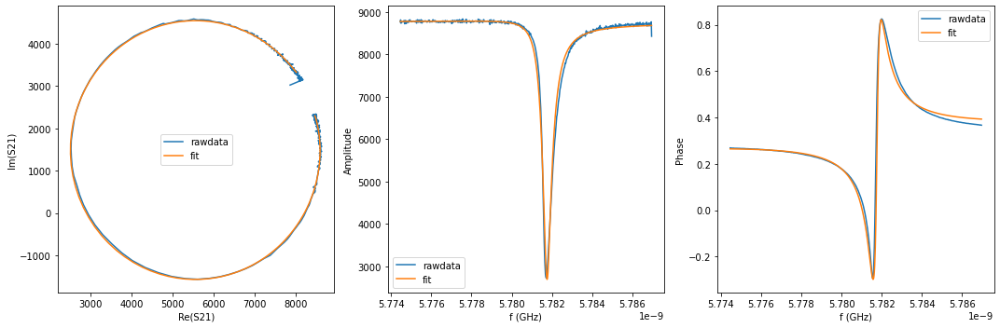

{'Qi_dia_corr': 26133.328355987956, 'Qi_no_corr': 26576.607493528372, 'absQc': 11610.95347029414, 'Qc_dia_corr(Re{Qc})': 11697.639506013069, 'Ql': 8080.63529634599, 'fr': 5.781728945031937, 'theta0': -3.0197560695647905, 'phi0': 0.12181731266658574, 'phi0_err': 0.02074222025814651, 'Ql_err': 311.60941750576495, 'absQc_err': 68.69078098967759, 'fr_err': 7.456650463988153e-06, 'chi_square': 0.000517666302793131, 'Qi_no_corr_err': 3322.4550669801015, 'Qi_dia_corr_err': 3257.576761459648, 'delay': -0.6036179314715091, 'a': 8749.748119644732, 'alpha': -2.752291427142335}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


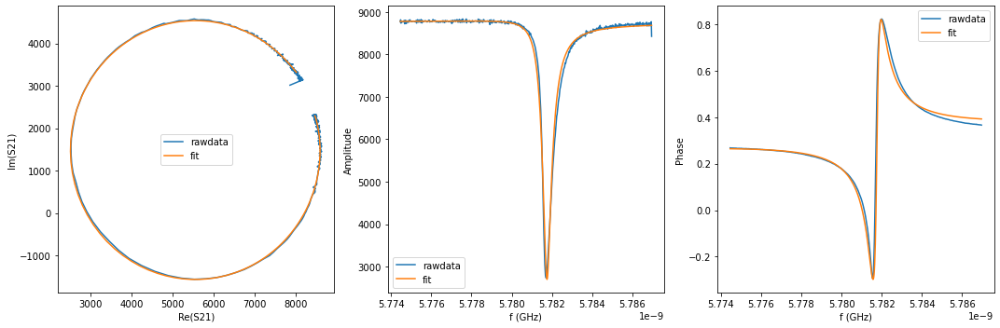

{'Qi_dia_corr': 26081.57424968321, 'Qi_no_corr': 26523.773954711018, 'absQc': 11608.045948266898, 'Qc_dia_corr(Re{Qc})': 11694.822438379788, 'Ql': 8074.337589213402, 'fr': 5.781725091421753, 'theta0': -3.0196772971323105, 'phi0': 0.12189562804053845, 'phi0_err': 0.021582949121422362, 'Ql_err': 425.8079014948968, 'absQc_err': 69.63939241036203, 'fr_err': 7.83146464273595e-06, 'chi_square': 0.0005338219188190258, 'Qi_no_corr_err': 4589.9574624126735, 'Qi_dia_corr_err': 4477.120297122697, 'delay': -0.6018918818563188, 'a': 8752.055158368332, 'alpha': -2.689908796592047}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


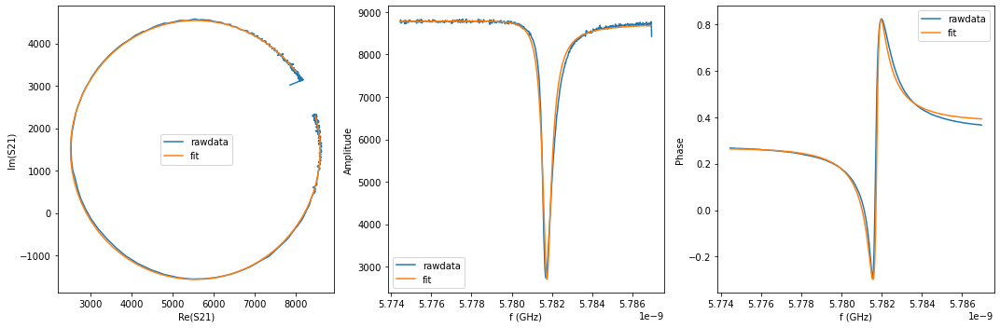

{'Qi_dia_corr': 26090.48153740616, 'Qi_no_corr': 26535.40696925536, 'absQc': 11611.38571776317, 'Qc_dia_corr(Re{Qc})': 11698.682936206093, 'Ql': 8077.0314827200855, 'fr': 5.7817210411012505, 'theta0': -3.01933156515864, 'phi0': 0.12224107193651731, 'phi0_err': 0.02228643508466377, 'Ql_err': 446.2720969756263, 'absQc_err': 70.54282334826108, 'fr_err': 8.031706378440742e-06, 'chi_square': 0.0005492562845801869, 'Qi_no_corr_err': 4808.530842060349, 'Qi_dia_corr_err': 4692.895126259847, 'delay': -0.6147540823433034, 'a': 8752.788832774573, 'alpha': 3.1257962563501587}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


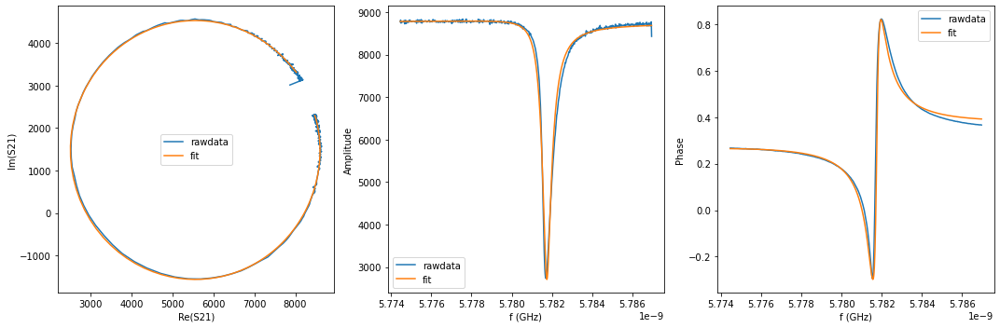

{'Qi_dia_corr': 26019.521989046687, 'Qi_no_corr': 26464.283354481624, 'absQc': 11603.792612039222, 'Qc_dia_corr(Re{Qc})': 11691.418974909786, 'Ql': 8066.760609118116, 'fr': 5.78171701187855, 'theta0': -3.0190624037629203, 'phi0': 0.12250967919340262, 'phi0_err': 0.02302946892782621, 'Ql_err': 426.68734346329774, 'absQc_err': 71.32773791463337, 'fr_err': 8.32581615019083e-06, 'chi_square': 0.0005648734343144351, 'Qi_no_corr_err': 4578.020150740618, 'Qi_dia_corr_err': 4470.037964128271, 'delay': -0.5917096401741532, 'a': 8755.114626271468, 'alpha': -2.3203032094918594}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


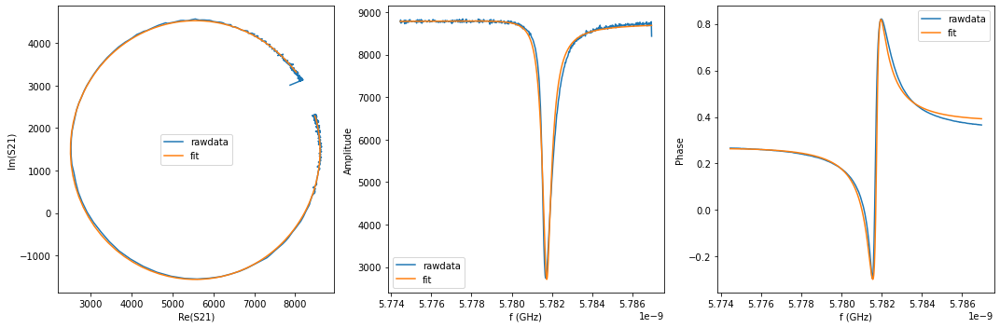

{'Qi_dia_corr': 26025.538084499443, 'Qi_no_corr': 26474.266811135923, 'absQc': 11622.127055818704, 'Qc_dia_corr(Re{Qc})': 11710.767349505433, 'Ql': 8076.546396050321, 'fr': 5.7817126774674765, 'theta0': -3.018456108141307, 'phi0': 0.12311535768606861, 'phi0_err': 0.02284840559234498, 'Ql_err': 294.42860341504866, 'absQc_err': 73.30011892532875, 'fr_err': 8.318224568957221e-06, 'chi_square': 0.0005871626242994879, 'Qi_no_corr_err': 3145.7388612153327, 'Qi_dia_corr_err': 3095.408375863359, 'delay': -0.6124949276661966, 'a': 8754.947196620406, 'alpha': -3.075550492596573}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


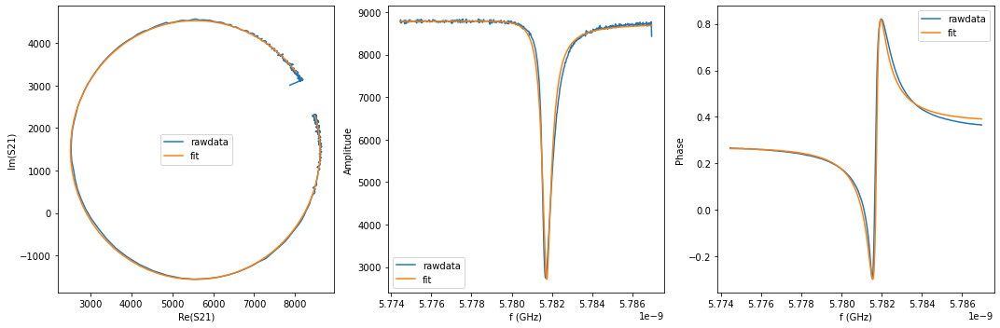

{'Qi_dia_corr': 25948.0688574469, 'Qi_no_corr': 26393.200295601477, 'absQc': 11603.516907116544, 'Qc_dia_corr(Re{Qc})': 11691.694506548385, 'Ql': 8060.010664316491, 'fr': 5.781708738374701, 'theta0': -3.0186773639941227, 'phi0': 0.12289344893195482, 'phi0_err': 0.023877146407031154, 'Ql_err': 434.091319072742, 'absQc_err': 73.66575516262412, 'fr_err': 8.697907731328902e-06, 'chi_square': 0.0006001050014459398, 'Qi_no_corr_err': 4655.103787993284, 'Qi_dia_corr_err': 4541.360965136147, 'delay': -0.5917031718369807, 'a': 8757.218965393266, 'alpha': -2.3205399070130635}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


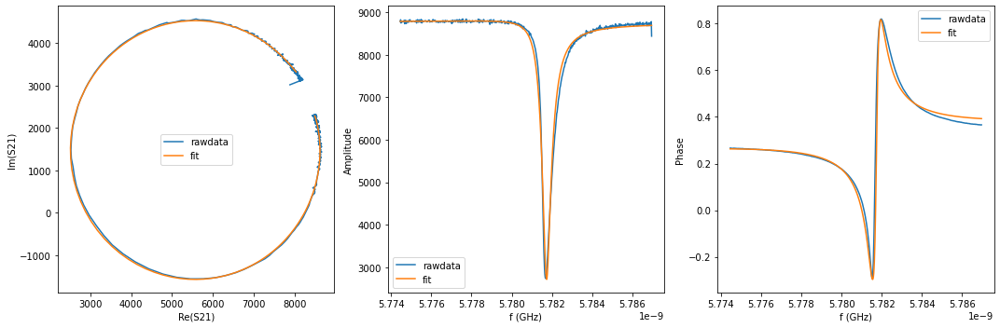

{'Qi_dia_corr': 25941.653230826687, 'Qi_no_corr': 26396.24879510418, 'absQc': 11625.865372827455, 'Qc_dia_corr(Re{Qc})': 11716.292939014776, 'Ql': 8071.072362892598, 'fr': 5.781703870219024, 'theta0': -3.0172482496485937, 'phi0': 0.12432258498991608, 'phi0_err': 0.024237547530761343, 'Ql_err': 409.8630431476987, 'absQc_err': 75.04098927383131, 'fr_err': 8.84915261679652e-06, 'chi_square': 0.0006223758704014937, 'Qi_no_corr_err': 4367.243032645617, 'Qi_dia_corr_err': 4253.509166570776, 'delay': -0.6251431949193277, 'a': 8758.856256632163, 'alpha': 2.7482269846347123}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


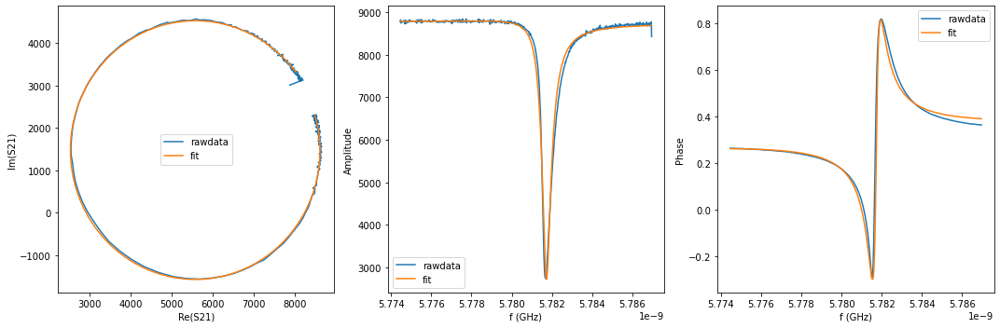

{'Qi_dia_corr': 25922.299381400597, 'Qi_no_corr': 26376.188465361538, 'absQc': 11621.029797873907, 'Qc_dia_corr(Re{Qc})': 11711.377429189168, 'Ql': 8066.866105482233, 'fr': 5.7816994804065285, 'theta0': -3.0172758206076162, 'phi0': 0.12429366326277641, 'phi0_err': 0.024044623728861497, 'Ql_err': 313.90295603307635, 'absQc_err': 76.16531386810883, 'fr_err': 8.892577147242055e-06, 'chi_square': 0.0006403727161174182, 'Qi_no_corr_err': 3330.600640475543, 'Qi_dia_corr_err': 3242.4699040468954, 'delay': -0.6066575406995351, 'a': 8759.714353703548, 'alpha': -2.863600919996003}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


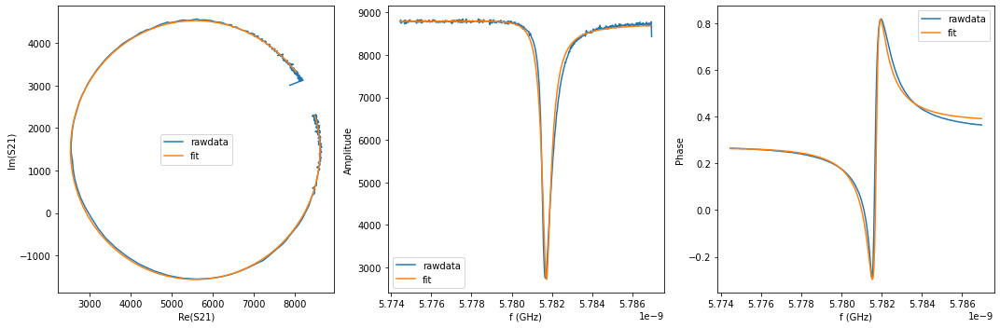

{'Qi_dia_corr': 25862.398434651324, 'Qi_no_corr': 26317.689371756976, 'absQc': 11624.623732182441, 'Qc_dia_corr(Re{Qc})': 11715.724176192522, 'Ql': 8063.115066523653, 'fr': 5.781694794548461, 'theta0': -3.0167812209440954, 'phi0': 0.12478790599934408, 'phi0_err': 0.025482592112118594, 'Ql_err': 409.27926213708923, 'absQc_err': 77.56772978519169, 'fr_err': 9.275436870266676e-06, 'chi_square': 0.0006650465880955091, 'Qi_no_corr_err': 4345.058033077104, 'Qi_dia_corr_err': 4237.588115210388, 'delay': -0.609937070435793, 'a': 8761.726751374008, 'alpha': -2.982599056632082}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


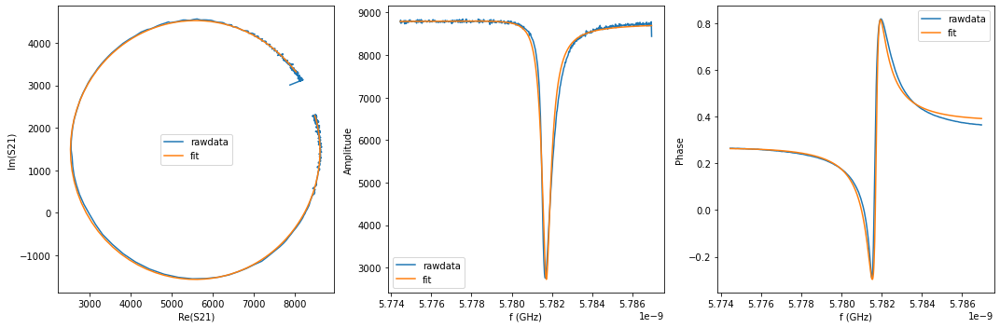

{'Qi_dia_corr': 25837.06891151947, 'Qi_no_corr': 26296.41650968548, 'absQc': 11631.744776668, 'Qc_dia_corr(Re{Qc})': 11723.942496472988, 'Ql': 8064.540832135545, 'fr': 5.7816899993965265, 'theta0': -3.0160747597996966, 'phi0': 0.12549408865598138, 'phi0_err': 0.025981528748154074, 'Ql_err': 405.5475428398681, 'absQc_err': 78.90234253094096, 'fr_err': 9.493831483408491e-06, 'chi_square': 0.0006875226240536929, 'Qi_no_corr_err': 4295.442859610853, 'Qi_dia_corr_err': 4184.987820787433, 'delay': -0.612378456811272, 'a': 8762.760881414055, 'alpha': -3.071489493812967}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


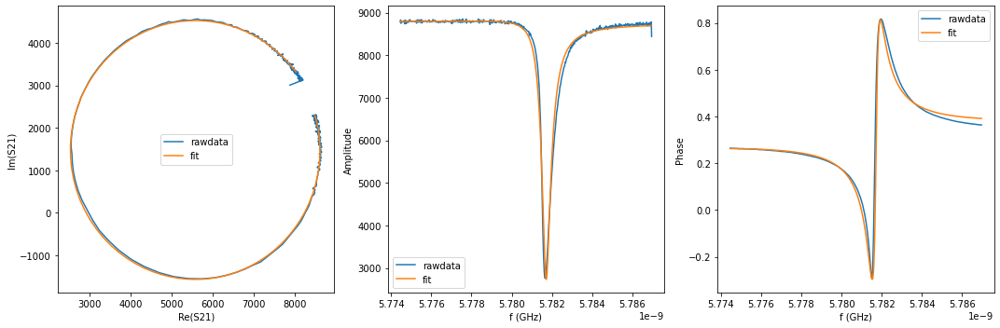

{'Qi_dia_corr': 25805.66437845584, 'Qi_no_corr': 26267.01808538719, 'absQc': 11634.578000870966, 'Qc_dia_corr(Re{Qc})': 11727.445177817446, 'Ql': 8063.134599113307, 'fr': 5.781685169190663, 'theta0': -3.015637481821767, 'phi0': 0.12593064318822347, 'phi0_err': 0.025869737684080837, 'Ql_err': 354.6737014982209, 'absQc_err': 80.20974808610258, 'fr_err': 9.548066816967085e-06, 'chi_square': 0.0007087667156728553, 'Qi_no_corr_err': 3740.520288929176, 'Qi_dia_corr_err': 3638.0269884049544, 'delay': -0.6147934889455627, 'a': 8764.508825064286, 'alpha': 3.1237891179652197}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


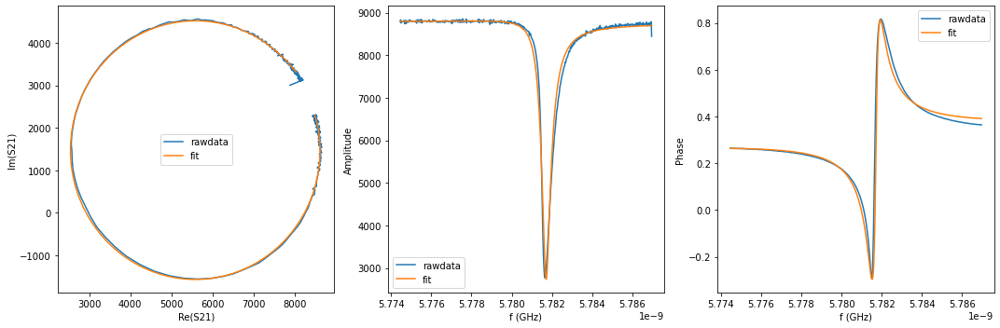

{'Qi_dia_corr': 25716.456368613897, 'Qi_no_corr': 26178.799254899146, 'absQc': 11619.108658918607, 'Qc_dia_corr(Re{Qc})': 11712.56920536102, 'Ql': 8047.38489220706, 'fr': 5.78168039644378, 'theta0': -3.0151545703655342, 'phi0': 0.12641315841237033, 'phi0_err': 0.025977047281048708, 'Ql_err': 280.7119270038767, 'absQc_err': 81.00445328856986, 'fr_err': 9.635606175023646e-06, 'chi_square': 0.0007253362708936789, 'Qi_no_corr_err': 2928.5163545778787, 'Qi_dia_corr_err': 2850.5874301744198, 'delay': -0.5960568176411934, 'a': 8765.957183021344, 'alpha': -2.4789754294767343}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


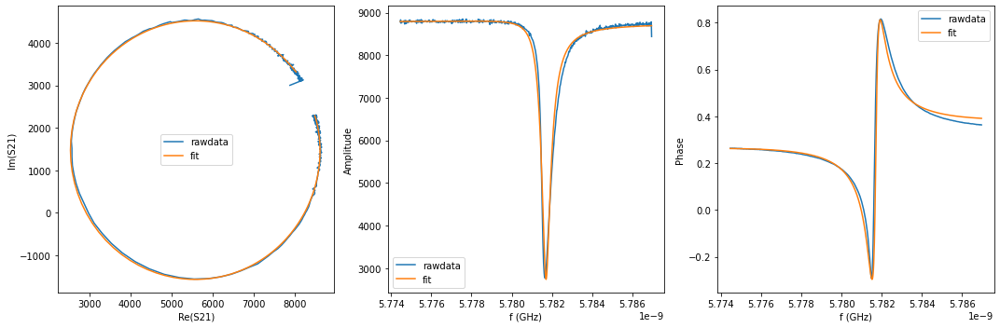

{'Qi_dia_corr': 25710.530430290826, 'Qi_no_corr': 26176.416273206494, 'absQc': 11634.518116145045, 'Qc_dia_corr(Re{Qc})': 11728.982265536419, 'Ql': 8054.548089458044, 'fr': 5.78167550338552, 'theta0': -3.0145650970903928, 'phi0': 0.1270019105129154, 'phi0_err': 0.028455005515713182, 'Ql_err': 452.9485061489904, 'absQc_err': 82.55221912736293, 'fr_err': 1.0322179887312811e-05, 'chi_square': 0.0007549856671985192, 'Qi_no_corr_err': 4766.549958992426, 'Qi_dia_corr_err': 4646.445417440398, 'delay': -0.6150624192910662, 'a': 8766.375788127965, 'alpha': 3.1139398010478043}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


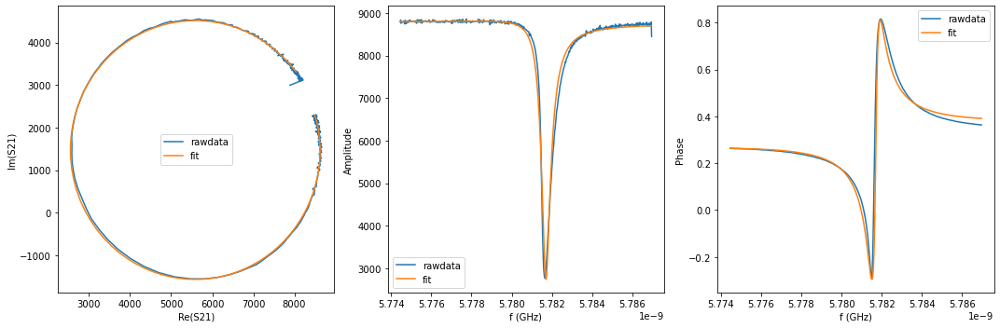

{'Qi_dia_corr': 25673.905323913114, 'Qi_no_corr': 26140.490651875698, 'absQc': 11637.937998721964, 'Qc_dia_corr(Re{Qc})': 11732.868472661052, 'Ql': 8052.780920994913, 'fr': 5.781670425551027, 'theta0': -3.0142722096935604, 'phi0': 0.1272943064365535, 'phi0_err': 0.029670438767198368, 'Ql_err': 456.6625515485056, 'absQc_err': 84.00741125528084, 'fr_err': 1.0756428762734325e-05, 'chi_square': 0.0007834408140536063, 'Qi_no_corr_err': 4792.54934274738, 'Qi_dia_corr_err': 4672.876790205046, 'delay': -0.6027215827578511, 'a': 8768.348227065011, 'alpha': -2.721093251810838}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


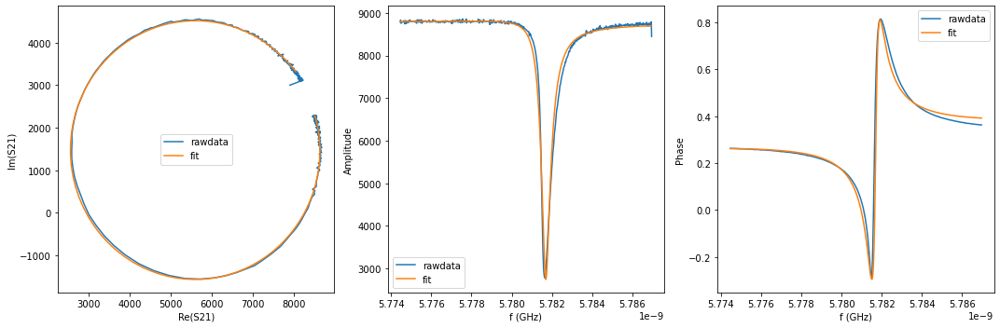

{'Qi_dia_corr': 25673.665414129857, 'Qi_no_corr': 26143.589769974355, 'absQc': 11657.503379258202, 'Qc_dia_corr(Re{Qc})': 11753.431311034332, 'Ql': 8062.438429656991, 'fr': 5.781665317251816, 'theta0': -3.013715535060287, 'phi0': 0.12785008650062585, 'phi0_err': 0.029453764138064654, 'Ql_err': 364.2552612152103, 'absQc_err': 85.9408245944727, 'fr_err': 1.0679079991184966e-05, 'chi_square': 0.0008121795468733879, 'Qi_no_corr_err': 3795.175325663064, 'Qi_dia_corr_err': 3718.453368364708, 'delay': -0.6349155253827196, 'a': 8769.101039763123, 'alpha': 2.392626428051429}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


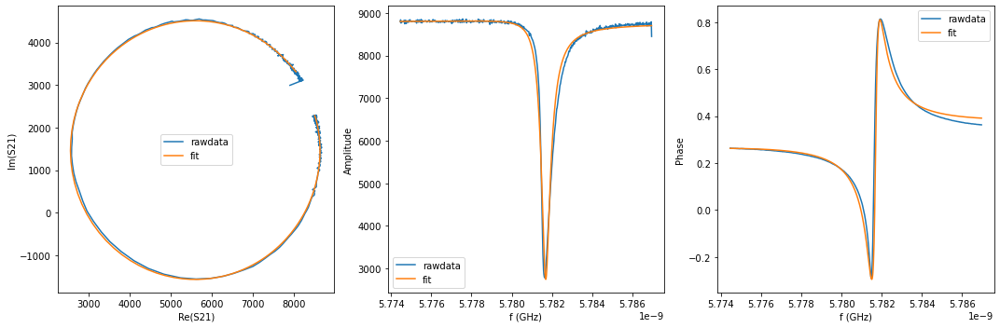

{'Qi_dia_corr': 25593.655876688023, 'Qi_no_corr': 26064.76963919048, 'absQc': 11645.682454977066, 'Qc_dia_corr(Re{Qc})': 11742.25552661948, 'Ql': 8049.2811309224935, 'fr': 5.781660409485356, 'theta0': -3.013224566435311, 'phi0': 0.1283409819576158, 'phi0_err': 0.028691850484335497, 'Ql_err': 318.72471350862327, 'absQc_err': 86.95728559726302, 'fr_err': 1.0798600777422982e-05, 'chi_square': 0.0008317870268652268, 'Qi_no_corr_err': 3307.2393325476323, 'Qi_dia_corr_err': 3186.878982248187, 'delay': -0.6138973706872957, 'a': 8770.959982666169, 'alpha': -3.1273460021211417}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


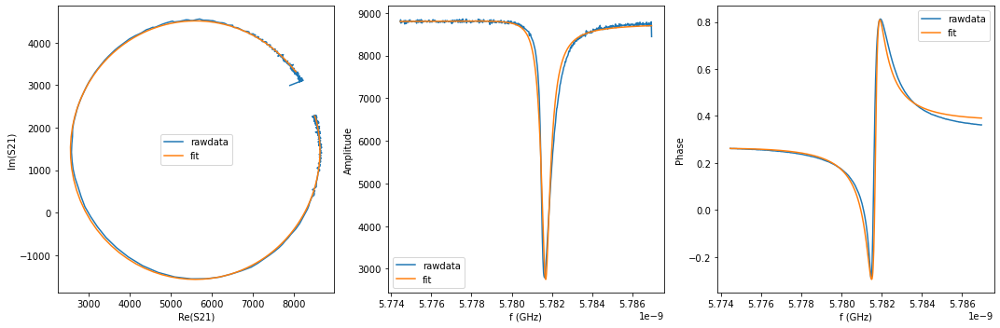

{'Qi_dia_corr': 25597.87482981705, 'Qi_no_corr': 26072.73677998818, 'absQc': 11661.389667173586, 'Qc_dia_corr(Re{Qc})': 11758.955078389037, 'Ql': 8057.542916935873, 'fr': 5.781654894776097, 'theta0': -3.0126563576767267, 'phi0': 0.12890783434732964, 'phi0_err': 0.03154382335095279, 'Ql_err': 452.38089065574565, 'absQc_err': 88.64092552581916, 'fr_err': 1.1466872005278898e-05, 'chi_square': 0.0008682005522193937, 'Qi_no_corr_err': 4707.845647849286, 'Qi_dia_corr_err': 4583.963524171764, 'delay': -0.6249956727568277, 'a': 8771.796763156075, 'alpha': 2.752597049787627}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


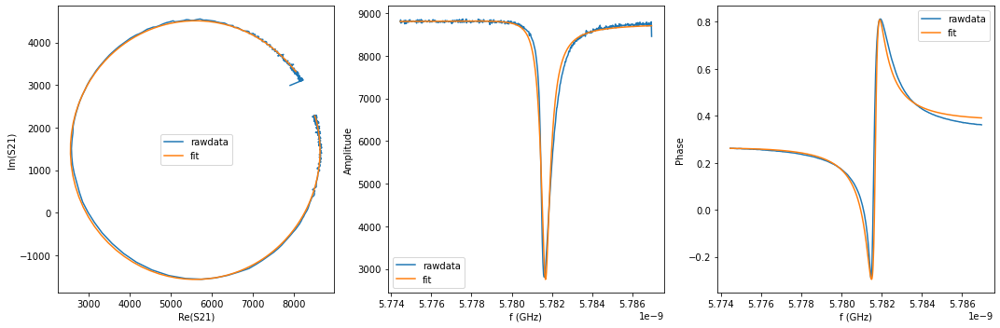

{'Qi_dia_corr': 25532.807721681507, 'Qi_no_corr': 26011.047194485192, 'absQc': 11650.759791808889, 'Qc_dia_corr(Re{Qc})': 11749.332445343118, 'Ql': 8046.572563728479, 'fr': 5.781649247283224, 'theta0': -3.0119379510410447, 'phi0': 0.12962558363949558, 'phi0_err': 0.030869677913243656, 'Ql_err': 343.8229800231276, 'absQc_err': 90.14478142548452, 'fr_err': 1.1455266373428799e-05, 'chi_square': 0.0008965971146764884, 'Qi_no_corr_err': 3553.915728811883, 'Qi_dia_corr_err': 3441.850969960134, 'delay': -0.6262634432343969, 'a': 8773.722977825972, 'alpha': 2.70649009638688}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


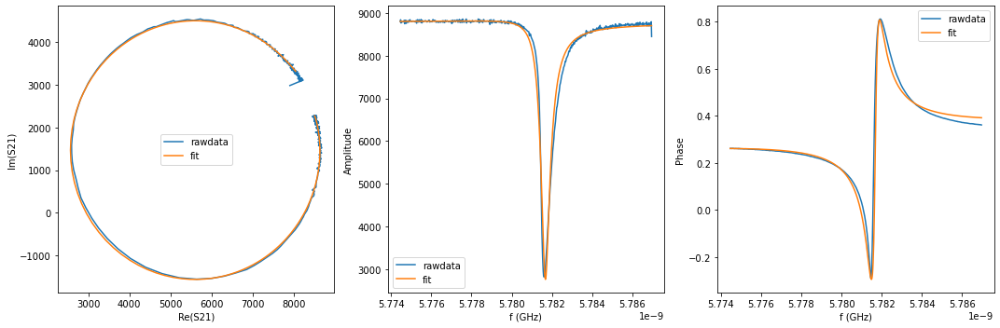

{'Qi_dia_corr': 25497.86087764337, 'Qi_no_corr': 25980.109689160174, 'absQc': 11662.569421104314, 'Qc_dia_corr(Re{Qc})': 11762.435485412407, 'Ql': 8049.236663792989, 'fr': 5.781643572722602, 'theta0': -3.0111614864681036, 'phi0': 0.13040165099376402, 'phi0_err': 0.033124889921766605, 'Ql_err': 464.9890149155704, 'absQc_err': 91.81791260988629, 'fr_err': 1.2033369896694539e-05, 'chi_square': 0.000930859821846096, 'Qi_no_corr_err': 4818.689484121892, 'Qi_dia_corr_err': 4693.002238955254, 'delay': -0.6417802663687359, 'a': 8775.607100816662, 'alpha': 2.1429975460429986}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


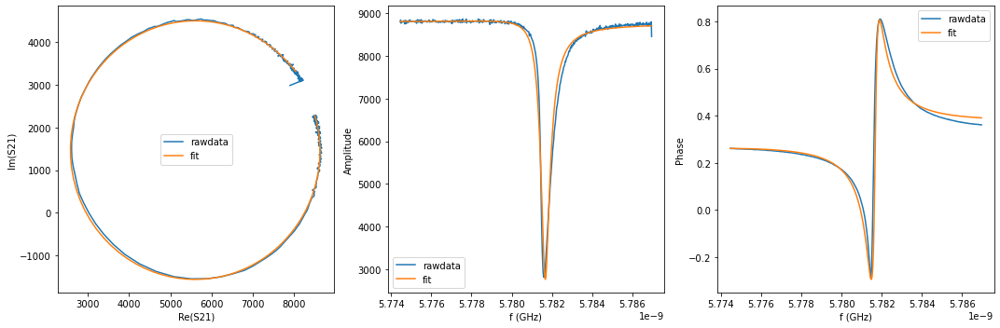

{'Qi_dia_corr': 25443.372755023272, 'Qi_no_corr': 25926.764145613357, 'absQc': 11658.623520484205, 'Qc_dia_corr(Re{Qc})': 11759.084335483378, 'Ql': 8042.231331053842, 'fr': 5.781637984873939, 'theta0': -3.010753465401067, 'phi0': 0.13080859164004754, 'phi0_err': 0.03444874081053516, 'Ql_err': 458.97055654123005, 'absQc_err': 93.27499965156879, 'fr_err': 1.2510942384512506e-05, 'chi_square': 0.0009634893453720527, 'Qi_no_corr_err': 4742.045308154712, 'Qi_dia_corr_err': 4622.028886471726, 'delay': -0.6294253905087439, 'a': 8776.67288106696, 'alpha': 2.5916914689201254}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


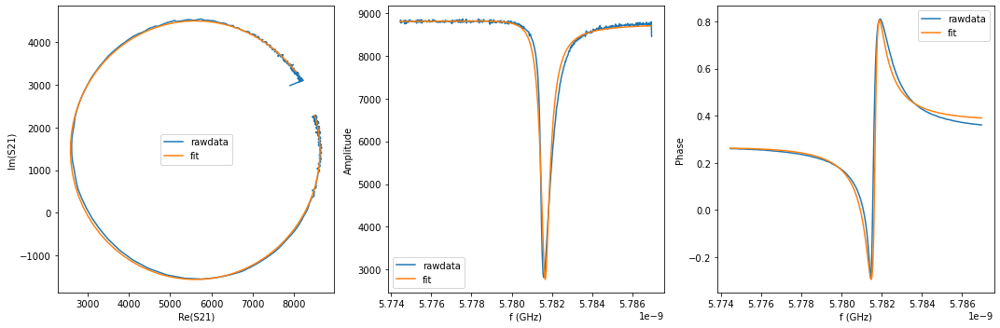

{'Qi_dia_corr': 25390.18969760188, 'Qi_no_corr': 25874.12294549401, 'absQc': 11656.197326818237, 'Qc_dia_corr(Re{Qc})': 11757.14882867599, 'Ql': 8036.006101805976, 'fr': 5.781631993565174, 'theta0': -3.010420028455727, 'phi0': 0.1311389265473534, 'phi0_err': 0.033444117606073326, 'Ql_err': 333.74960912868863, 'absQc_err': 95.22278195128784, 'fr_err': 1.2346614538473711e-05, 'chi_square': 0.000999478360300614, 'Qi_no_corr_err': 3406.3246243245458, 'Qi_dia_corr_err': 3306.049393408159, 'delay': -0.6145833858945016, 'a': 8778.118501633306, 'alpha': 3.130551553995198}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


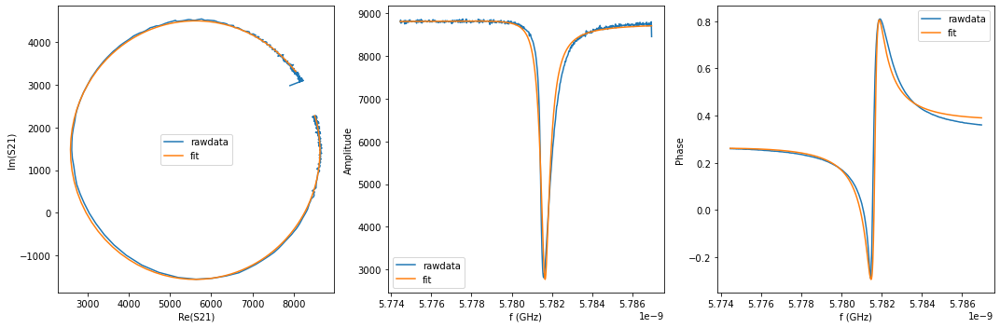

{'Qi_dia_corr': 25335.83743972918, 'Qi_no_corr': 25817.202976946486, 'absQc': 11655.343785480869, 'Qc_dia_corr(Re{Qc})': 11756.181246529368, 'Ql': 8030.102095370886, 'fr': 5.781626264114295, 'theta0': -3.010486856157027, 'phi0': 0.13107012939041318, 'phi0_err': 0.036311708733508814, 'Ql_err': 459.69521328025394, 'absQc_err': 96.88020181001022, 'fr_err': 1.3196504008761176e-05, 'chi_square': 0.001041585461323913, 'Qi_no_corr_err': 4713.48499640659, 'Qi_dia_corr_err': 4593.285362139616, 'delay': -0.6208770091958103, 'a': 8779.607989083364, 'alpha': 2.9019596992269623}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


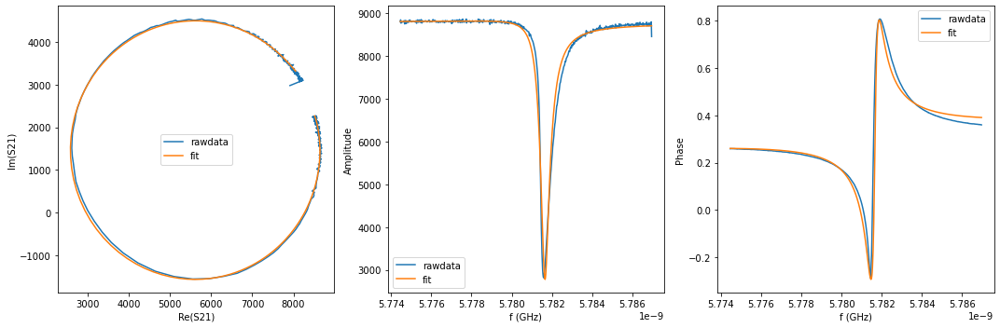

{'Qi_dia_corr': 25329.601616109223, 'Qi_no_corr': 25819.03063770234, 'absQc': 11676.98273114138, 'Qc_dia_corr(Re{Qc})': 11779.925204059704, 'Ql': 8040.544788736764, 'fr': 5.781622708570398, 'theta0': -3.0092572628544345, 'phi0': 0.1322993789825292, 'phi0_err': 0.03757468613920754, 'Ql_err': 490.36862216958167, 'absQc_err': 97.88406890260829, 'fr_err': 1.3507532430699906e-05, 'chi_square': 0.0010579560201477312, 'Qi_no_corr_err': 5022.791983188828, 'Qi_dia_corr_err': 4906.659595556465, 'delay': -0.6476787731697204, 'a': 8779.861289577657, 'alpha': 1.928289235605476}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


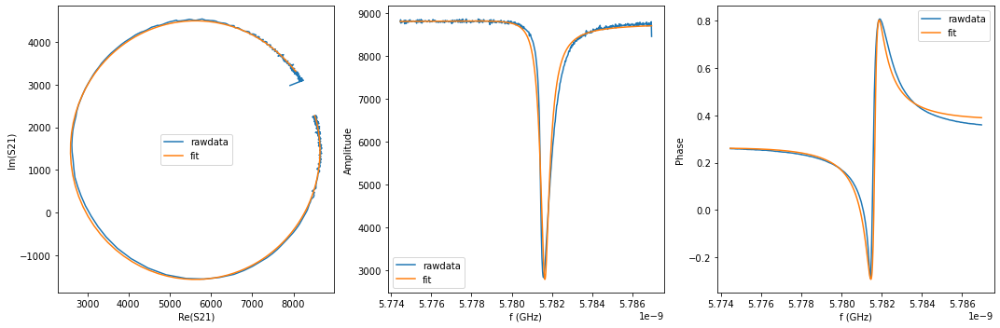

{'Qi_dia_corr': 25265.125523573326, 'Qi_no_corr': 25754.42408826109, 'absQc': 11671.123386641266, 'Qc_dia_corr(Re{Qc})': 11774.460017640493, 'Ql': 8031.494034591017, 'fr': 5.781616636700905, 'theta0': -3.0089716283015266, 'phi0': 0.1325835935447529, 'phi0_err': 0.0391417198703938, 'Ql_err': 470.0690040641139, 'absQc_err': 99.49390722374062, 'fr_err': 1.4078051649452496e-05, 'chi_square': 0.0010964398460237231, 'Qi_no_corr_err': 4792.333542244654, 'Qi_dia_corr_err': 4688.872330572034, 'delay': -0.6296305922180127, 'a': 8781.707331863701, 'alpha': 2.5839011936963585}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


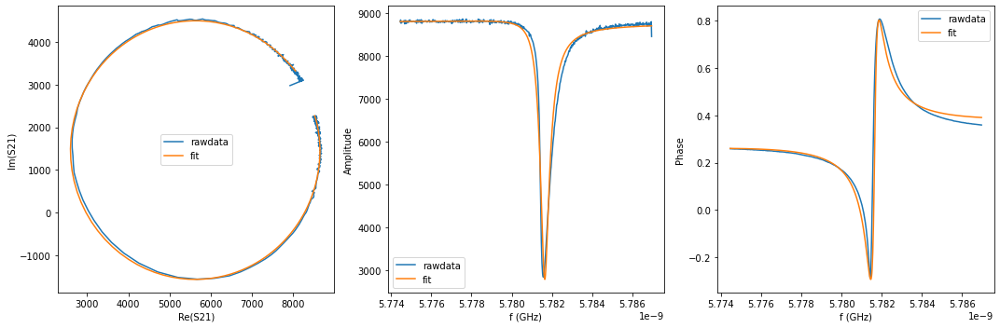

{'Qi_dia_corr': 25223.406719550905, 'Qi_no_corr': 25716.259549930364, 'absQc': 11683.222432849429, 'Qc_dia_corr(Re{Qc})': 11787.863814852672, 'Ql': 8033.501121781936, 'fr': 5.78160975469593, 'theta0': -3.008210132688391, 'phi0': 0.1333432301392988, 'phi0_err': 0.037107537065822, 'Ql_err': 424.3165272418943, 'absQc_err': 102.11493921076394, 'fr_err': 1.361824623755261e-05, 'chi_square': 0.00114478442179579, 'Qi_no_corr_err': 4295.626632479569, 'Qi_dia_corr_err': 4169.787811273639, 'delay': -0.6473078461370085, 'a': 8782.35405542806, 'alpha': 1.9418094115196014}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


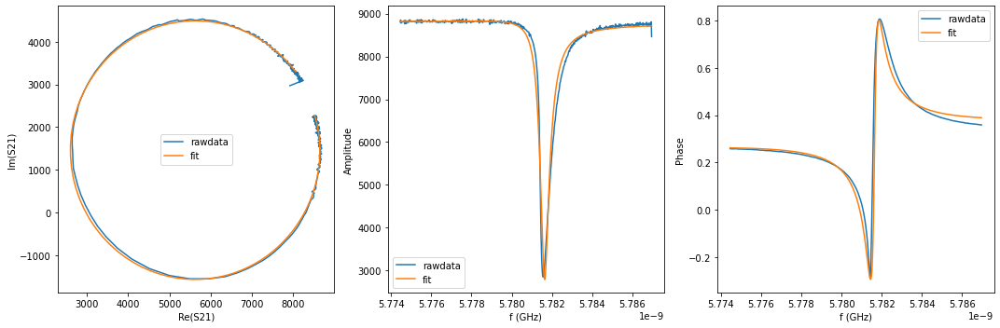

{'Qi_dia_corr': 25106.38679235362, 'Qi_no_corr': 25596.019698741886, 'absQc': 11652.724194880077, 'Qc_dia_corr(Re{Qc})': 11757.110133375194, 'Ql': 8007.340029719169, 'fr': 5.781603984653201, 'theta0': -3.0081971020903615, 'phi0': 0.13335446272212725, 'phi0_err': 0.040425384709536424, 'Ql_err': 470.49922394033354, 'absQc_err': 103.08593102800516, 'fr_err': 1.463133458470854e-05, 'chi_square': 0.0011813315713795657, 'Qi_no_corr_err': 4759.790126733258, 'Qi_dia_corr_err': 4648.016629236713, 'delay': -0.602348518942574, 'a': 8784.90106600087, 'alpha': -2.7086558683029356}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


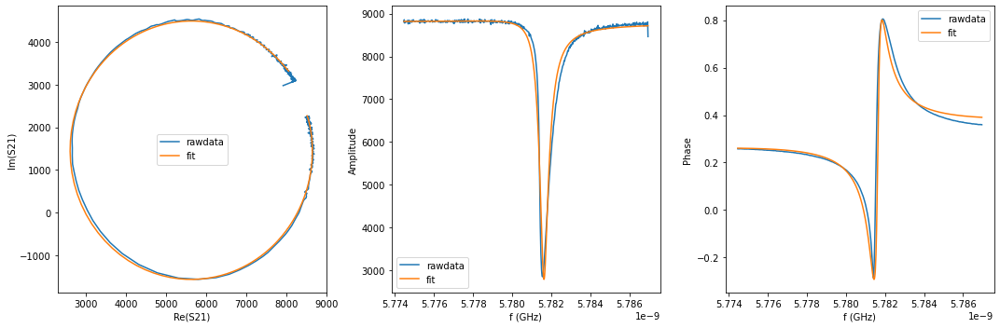

{'Qi_dia_corr': 25106.16043682779, 'Qi_no_corr': 25601.042906825933, 'absQc': 11683.281028440802, 'Qc_dia_corr(Re{Qc})': 11789.332858194139, 'Ql': 8022.250300714178, 'fr': 5.781597306789424, 'theta0': -3.0073167831360195, 'phi0': 0.1342318466670243, 'phi0_err': 0.041110166584170445, 'Ql_err': 374.48260605884997, 'absQc_err': 106.25178795211757, 'fr_err': 1.4761906518150118e-05, 'chi_square': 0.0012346218984190913, 'Qi_no_corr_err': 3769.0469571088156, 'Qi_dia_corr_err': 3737.4599046013955, 'delay': -0.6396373882061678, 'a': 8786.148917394292, 'alpha': 2.2202314822736056}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


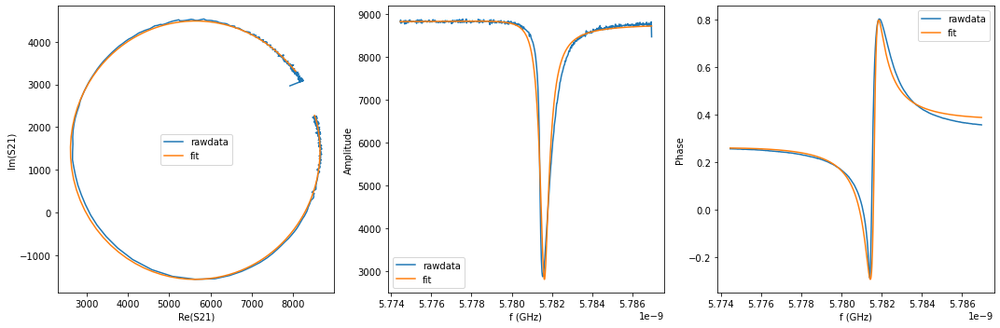

{'Qi_dia_corr': 25018.242529081086, 'Qi_no_corr': 25514.766378797587, 'absQc': 11671.351452877556, 'Qc_dia_corr(Re{Qc})': 11778.280267078379, 'Ql': 8008.1445176122015, 'fr': 5.781590747598949, 'theta0': -3.0066978088724214, 'phi0': 0.13484987251609692, 'phi0_err': 0.04179519682443352, 'Ql_err': 461.0664765523566, 'absQc_err': 107.44215205698436, 'fr_err': 1.5186708956276045e-05, 'chi_square': 0.0012750390028951526, 'Qi_no_corr_err': 4625.9172677868, 'Qi_dia_corr_err': 4509.543310868781, 'delay': -0.6206858010288666, 'a': 8788.028061241233, 'alpha': 2.9084204814649066}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


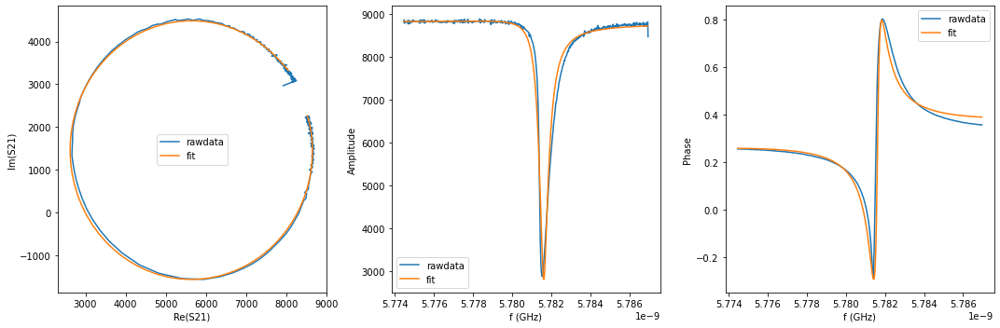

{'Qi_dia_corr': 24991.31903706836, 'Qi_no_corr': 25493.144571522047, 'absQc': 11695.440073287835, 'Qc_dia_corr(Re{Qc})': 11804.180890458972, 'Ql': 8017.340467876884, 'fr': 5.781583514439559, 'theta0': -3.0057047781766886, 'phi0': 0.13583989149188255, 'phi0_err': 0.04124790478602701, 'Ql_err': 390.50672274597014, 'absQc_err': 110.63088481572856, 'fr_err': 1.5260077732510166e-05, 'chi_square': 0.0013362989622049903, 'Qi_no_corr_err': 3891.5095189319313, 'Qi_dia_corr_err': 3768.1020444907713, 'delay': -0.6571830531130095, 'a': 8788.682301433391, 'alpha': 1.5829264184724818}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


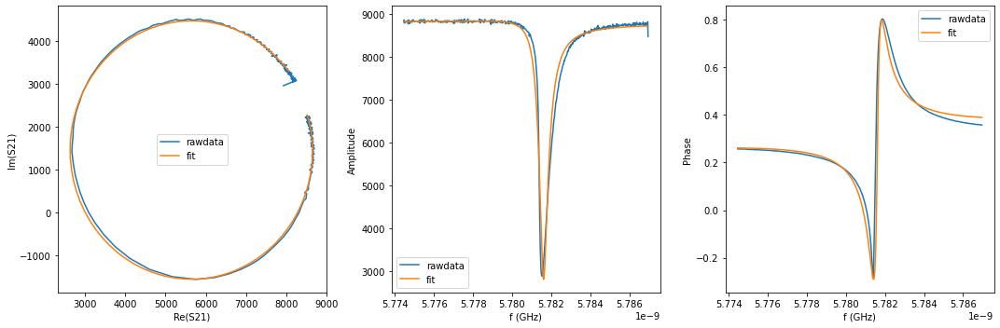

{'Qi_dia_corr': 24892.676205547745, 'Qi_no_corr': 25391.485240982296, 'absQc': 11678.163912462982, 'Qc_dia_corr(Re{Qc})': 11786.792673871027, 'Ql': 7999.156544418402, 'fr': 5.781576651080293, 'theta0': -3.0056722135099845, 'phi0': 0.13587003828084473, 'phi0_err': 0.04402001429356744, 'Ql_err': 444.73869370147224, 'absQc_err': 112.4040244116888, 'fr_err': 1.6046930715608842e-05, 'chi_square': 0.0013919898270706792, 'Qi_no_corr_err': 4416.431686985231, 'Qi_dia_corr_err': 4302.8396663678695, 'delay': -0.6173341981446595, 'a': 8790.808003653314, 'alpha': 3.0303146486679324}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


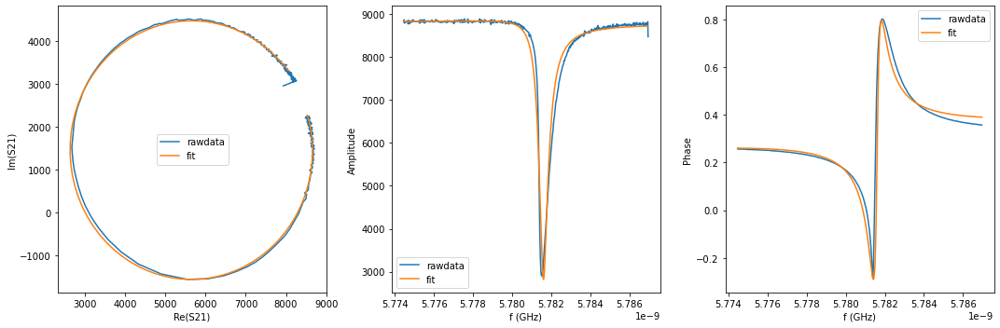

{'Qi_dia_corr': 24822.46216908007, 'Qi_no_corr': 25327.13256816794, 'absQc': 11693.401293082221, 'Qc_dia_corr(Re{Qc})': 11804.205066612014, 'Ql': 7999.893405985548, 'fr': 5.781569128066971, 'theta0': -3.0044157974947043, 'phi0': 0.13712423144947336, 'phi0_err': 0.044965408833761114, 'Ql_err': 452.9301905783558, 'absQc_err': 114.98065029511936, 'fr_err': 1.638900300238008e-05, 'chi_square': 0.001443918617598366, 'Qi_no_corr_err': 4491.298364511182, 'Qi_dia_corr_err': 4384.290302462804, 'delay': -0.6387352705756856, 'a': 8791.62529661962, 'alpha': 2.2529058364439076}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


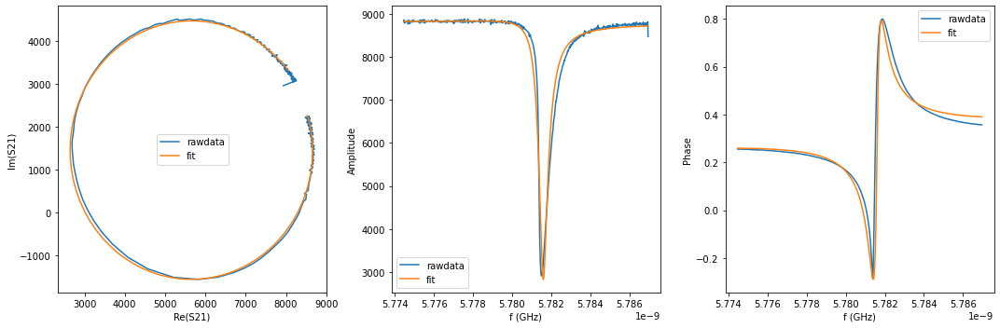

{'Qi_dia_corr': 24733.132686724544, 'Qi_no_corr': 25239.758991164, 'absQc': 11700.14704586533, 'Qc_dia_corr(Re{Qc})': 11812.310031475452, 'Ql': 7994.3054349623035, 'fr': 5.781561336346892, 'theta0': -3.0036206003933814, 'phi0': 0.13791662178442174, 'phi0_err': 0.04630441548555396, 'Ql_err': 466.1488380214604, 'absQc_err': 117.59629773713733, 'fr_err': 1.6799832294374502e-05, 'chi_square': 0.0015098254497847954, 'Qi_no_corr_err': 4582.699190339277, 'Qi_dia_corr_err': 4473.900104597027, 'delay': -0.6531140457596639, 'a': 8792.317590304523, 'alpha': 1.730545482493104}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


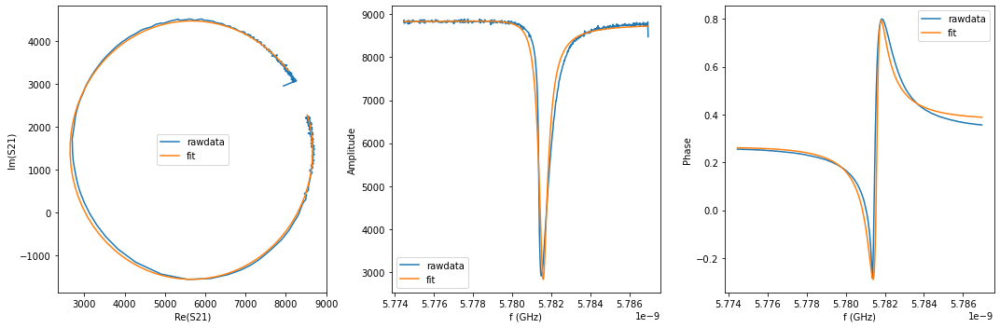

{'Qi_dia_corr': 24614.354370771525, 'Qi_no_corr': 25117.001720595224, 'absQc': 11668.9643674579, 'Qc_dia_corr(Re{Qc})': 11780.730880482444, 'Ql': 7967.424245252872, 'fr': 5.781554084534066, 'theta0': -3.0036764112212757, 'phi0': 0.13785695586832475, 'phi0_err': 0.048737137393886014, 'Ql_err': 474.4656710964998, 'absQc_err': 119.48119008759012, 'fr_err': 1.762145664237761e-05, 'chi_square': 0.0015711841489652887, 'Qi_no_corr_err': 4654.594575876378, 'Qi_dia_corr_err': 4564.189694530093, 'delay': -0.609824627654613, 'a': 8795.04883595712, 'alpha': -2.980281044040114}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


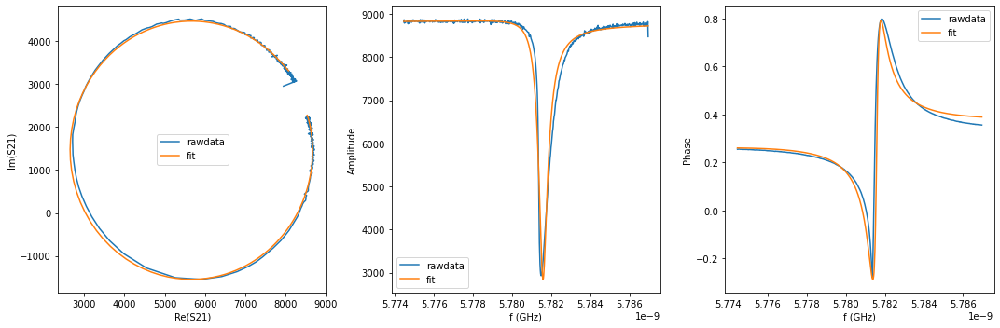

{'Qi_dia_corr': 24539.259995424596, 'Qi_no_corr': 25043.587638422905, 'absQc': 11684.897307175053, 'Qc_dia_corr(Re{Qc})': 11798.030273169486, 'Ql': 7967.433184125478, 'fr': 5.781545986965743, 'theta0': -3.0029318616314744, 'phi0': 0.1385965709935787, 'phi0_err': 0.04594063496186249, 'Ql_err': 404.51607448528694, 'absQc_err': 122.93498639415286, 'fr_err': 1.685049062156888e-05, 'chi_square': 0.0016462022421783208, 'Qi_no_corr_err': 3916.4215777313434, 'Qi_dia_corr_err': 3822.102175902416, 'delay': -0.6263003171944964, 'a': 8796.02821147678, 'alpha': 2.7046163860669923}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


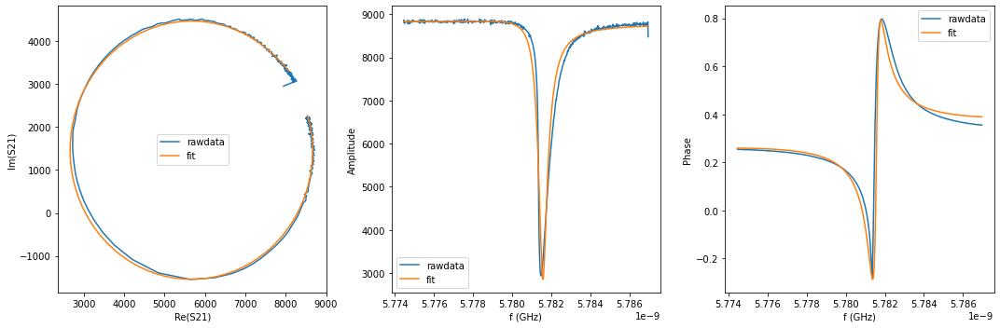

{'Qi_dia_corr': 24461.545045205996, 'Qi_no_corr': 24968.58553192655, 'absQc': 11694.862746242401, 'Qc_dia_corr(Re{Qc})': 11809.517508311343, 'Ql': 7964.44945789693, 'fr': 5.7815379314252935, 'theta0': -3.0020666888186005, 'phi0': 0.13945913434012824, 'phi0_err': 0.04916772690663019, 'Ql_err': 446.3661477608702, 'absQc_err': 125.77279712941042, 'fr_err': 1.7960044603032775e-05, 'chi_square': 0.001718458233558474, 'Qi_no_corr_err': 4320.879282074198, 'Qi_dia_corr_err': 4225.274456325675, 'delay': -0.639743792780898, 'a': 8796.892242037591, 'alpha': 2.2161878072063894}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


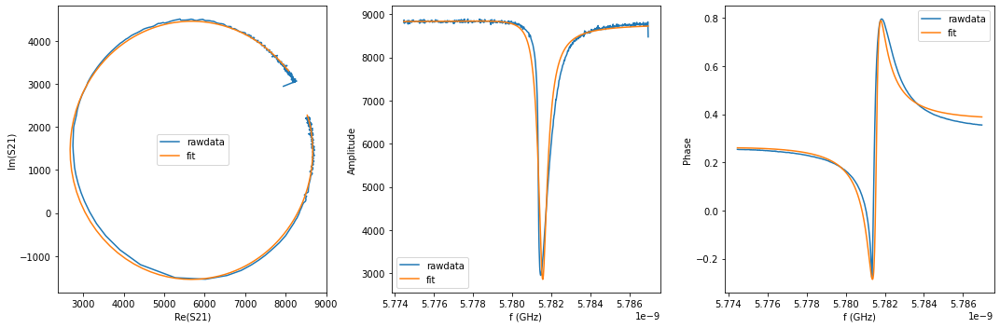

{'Qi_dia_corr': 24347.8413010348, 'Qi_no_corr': 24854.306265892228, 'absQc': 11679.509511352227, 'Qc_dia_corr(Re{Qc})': 11794.80241440542, 'Ql': 7945.682657417841, 'fr': 5.781529834890626, 'theta0': -3.001585511280682, 'phi0': 0.13993467741725757, 'phi0_err': 0.04913059399769723, 'Ql_err': 408.7596743957001, 'absQc_err': 128.6445493816688, 'fr_err': 1.786510533890085e-05, 'chi_square': 0.0018008564606205861, 'Qi_no_corr_err': 3914.864520702094, 'Qi_dia_corr_err': 3848.377610385234, 'delay': -0.6201666087011065, 'a': 8799.013366860787, 'alpha': 2.927083446482292}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


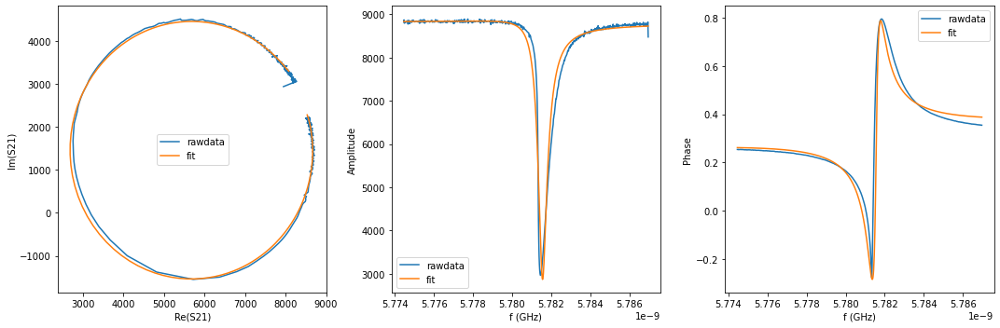

{'Qi_dia_corr': 24210.658161028005, 'Qi_no_corr': 24711.520207941183, 'absQc': 11661.443327626834, 'Qc_dia_corr(Re{Qc})': 11776.411424136635, 'Ql': 7922.6976422368425, 'fr': 5.781522060894172, 'theta0': -3.0016701562928034, 'phi0': 0.13984635034106924, 'phi0_err': 0.0521763584396711, 'Ql_err': 461.2337515417027, 'absQc_err': 131.212342615504, 'fr_err': 1.896548199795491e-05, 'chi_square': 0.0018784861119959906, 'Qi_no_corr_err': 4408.312541482927, 'Qi_dia_corr_err': 4327.345794949894, 'delay': -0.5948594630895214, 'a': 8800.585370149382, 'alpha': -2.437106224525033}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


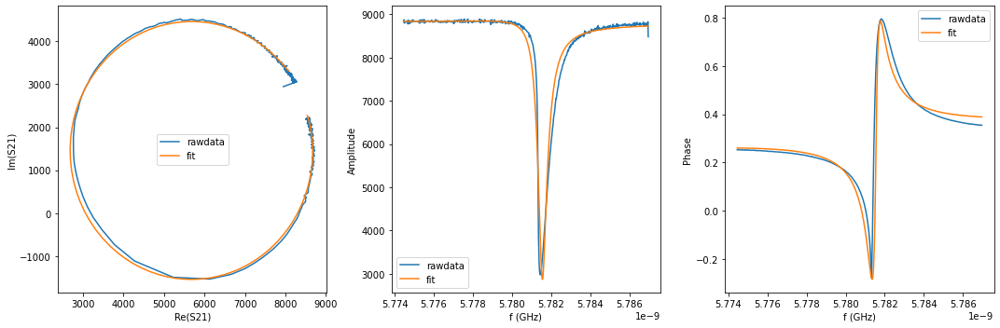

{'Qi_dia_corr': 24168.572597089205, 'Qi_no_corr': 24675.045138811747, 'absQc': 11678.335488855117, 'Qc_dia_corr(Re{Qc})': 11795.322518802188, 'Ql': 7926.730619225529, 'fr': 5.781513075702235, 'theta0': -3.0005500993661927, 'phi0': 0.14095761644764998, 'phi0_err': 0.05128793903747007, 'Ql_err': 426.08617693312016, 'absQc_err': 135.09814461520733, 'fr_err': 1.8821876765540342e-05, 'chi_square': 0.001981320132982266, 'Qi_no_corr_err': 4027.9952013603033, 'Qi_dia_corr_err': 3932.1382286132016, 'delay': -0.6272641691668774, 'a': 8801.328155871748, 'alpha': 2.6693144695509283}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


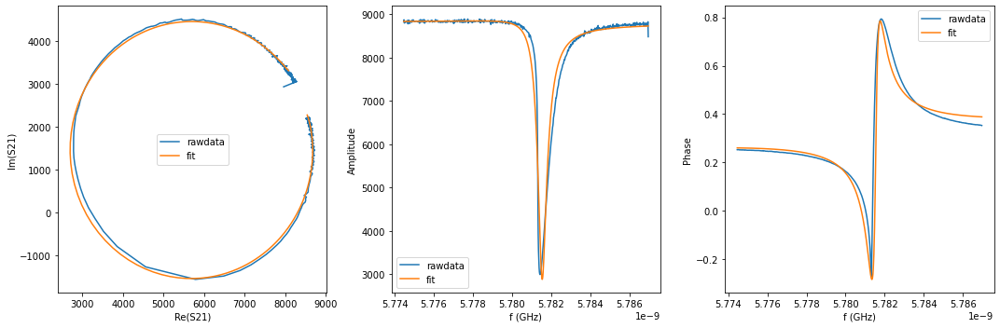

{'Qi_dia_corr': 24045.463993586152, 'Qi_no_corr': 24553.409497481505, 'absQc': 11675.654854280354, 'Qc_dia_corr(Re{Qc})': 11794.127811697488, 'Ql': 7912.904733198329, 'fr': 5.78150374222704, 'theta0': -2.999642985955751, 'phi0': 0.1418586794510457, 'phi0_err': 0.05715467382118977, 'Ql_err': 484.36681747851196, 'absQc_err': 138.54278616552122, 'fr_err': 2.0564577350873207e-05, 'chi_square': 0.0020838689769652682, 'Qi_no_corr_err': 4584.160685417628, 'Qi_dia_corr_err': 4530.467137368075, 'delay': -0.6198108540059104, 'a': 8802.082488416869, 'alpha': 2.9399187573526646}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


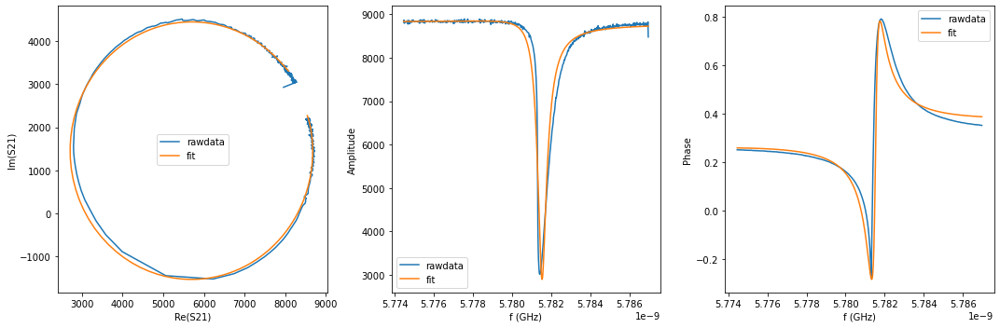

{'Qi_dia_corr': 23920.97196362179, 'Qi_no_corr': 24428.612469326657, 'absQc': 11676.890848018767, 'Qc_dia_corr(Re{Qc})': 11796.554163814346, 'Ql': 7900.464338239559, 'fr': 5.781494496646086, 'theta0': -2.9989372687099882, 'phi0': 0.14255607733732784, 'phi0_err': 0.05395460534349443, 'Ql_err': 403.85456695675856, 'absQc_err': 142.26835589160197, 'fr_err': 2.0080325788845636e-05, 'chi_square': 0.0021803865552916736, 'Qi_no_corr_err': 3764.0116004427596, 'Qi_dia_corr_err': 3662.797131028309, 'delay': -0.6258504609247176, 'a': 8803.715994654796, 'alpha': 2.720478045379338}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


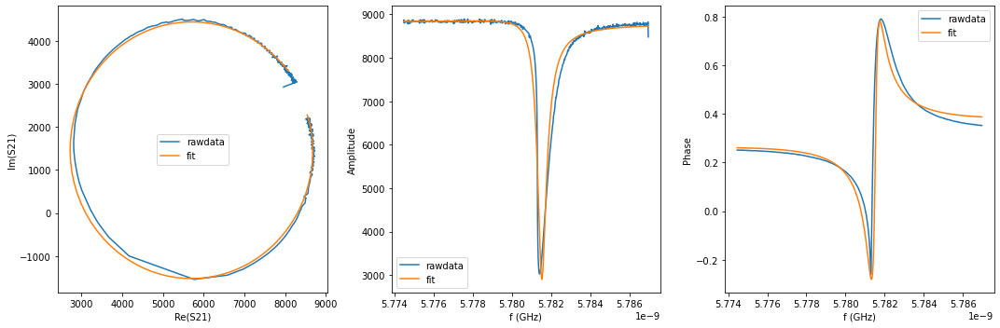

{'Qi_dia_corr': 23777.30327535182, 'Qi_no_corr': 24280.307027306488, 'absQc': 11665.797480929845, 'Qc_dia_corr(Re{Qc})': 11785.58735746082, 'Ql': 7879.828661001482, 'fr': 5.781485080032362, 'theta0': -2.9987851660259572, 'phi0': 0.1426980305453246, 'phi0_err': 0.058557660508858245, 'Ql_err': 463.6918177192094, 'absQc_err': 146.00463650479824, 'fr_err': 2.12572058808853e-05, 'chi_square': 0.0023026864948541806, 'Qi_no_corr_err': 4316.206857342106, 'Qi_dia_corr_err': 4268.998858317174, 'delay': -0.6053603817641106, 'a': 8805.448410727977, 'alpha': -2.818454526255943}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


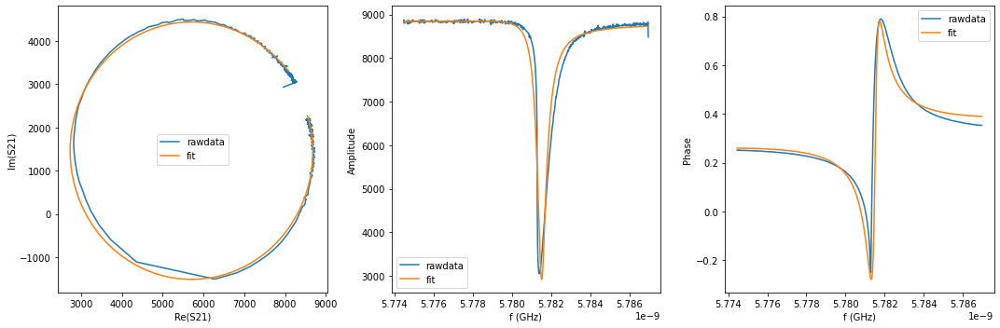

{'Qi_dia_corr': 23648.289157817315, 'Qi_no_corr': 24157.38899416968, 'absQc': 11678.370966213257, 'Qc_dia_corr(Re{Qc})': 11801.188751313819, 'Ql': 7872.553855727305, 'fr': 5.781473976030631, 'theta0': -2.997074800423736, 'phi0': 0.1443976486370053, 'phi0_err': 0.06072995620198961, 'Ql_err': 459.556626625384, 'absQc_err': 150.0414638508485, 'fr_err': 2.2047216321355503e-05, 'chi_square': 0.0024254171752284967, 'Qi_no_corr_err': 4228.550514752855, 'Qi_dia_corr_err': 4183.151180388209, 'delay': -0.6416018535950996, 'a': 8806.691243005982, 'alpha': 2.1487554898225456}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


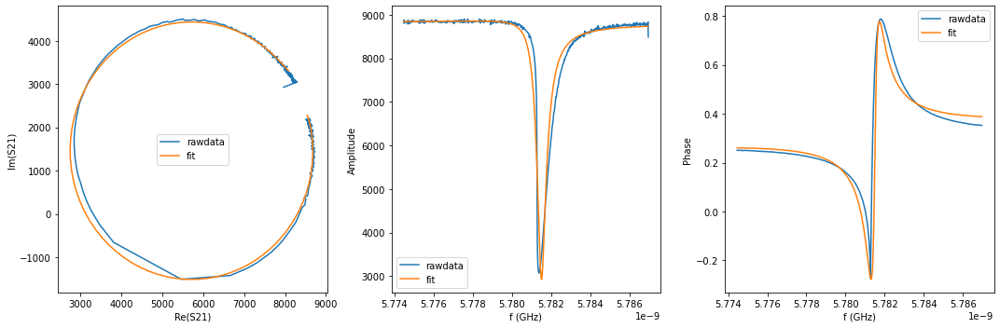

{'Qi_dia_corr': 23487.834117663424, 'Qi_no_corr': 23991.664647442678, 'absQc': 11660.262050611032, 'Qc_dia_corr(Re{Qc})': 11783.10469995882, 'Ql': 7846.675417820662, 'fr': 5.7814650194133295, 'theta0': -2.9969376497965867, 'phi0': 0.14452325849330294, 'phi0_err': 0.05858808082467414, 'Ql_err': 409.79985070949215, 'absQc_err': 153.78720696465655, 'fr_err': 2.1691666245358534e-05, 'chi_square': 0.0025445439069519287, 'Qi_no_corr_err': 3702.768152090002, 'Qi_dia_corr_err': 3621.8001871431843, 'delay': -0.6141027278342054, 'a': 8808.190124814673, 'alpha': -3.135921811877751}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


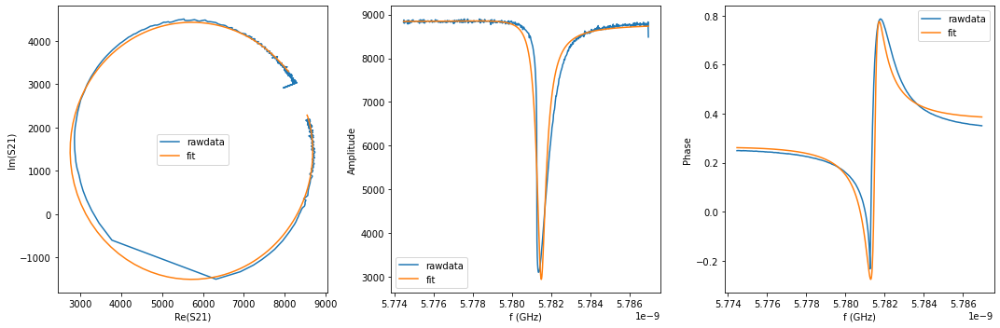

{'Qi_dia_corr': 23270.94660634006, 'Qi_no_corr': 23766.004587159136, 'absQc': 11626.37985252484, 'Qc_dia_corr(Re{Qc})': 11748.649396250596, 'Ql': 7807.120127157704, 'fr': 5.781454034581609, 'theta0': -2.9970455185722487, 'phi0': 0.1443967898920459, 'phi0_err': 0.06405925087569062, 'Ql_err': 451.16115012625374, 'absQc_err': 158.23204572072748, 'fr_err': 2.3374964105291932e-05, 'chi_square': 0.0027158751528458527, 'Qi_no_corr_err': 4072.4291842076022, 'Qi_dia_corr_err': 4050.182324229846, 'delay': -0.5802586007381987, 'a': 8810.420593315492, 'alpha': -1.9067927851895252}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


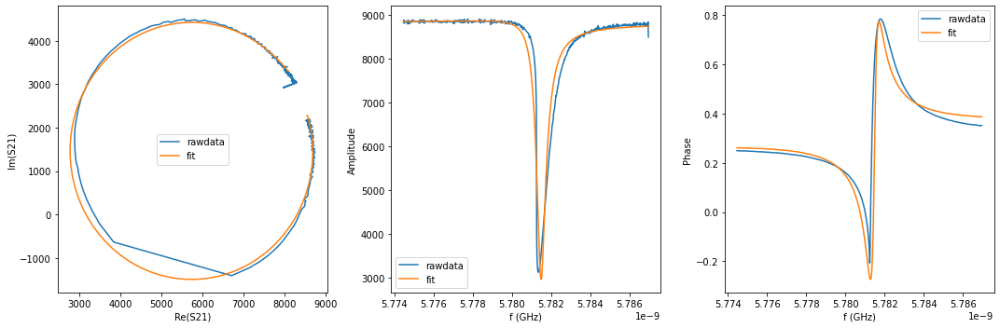

{'Qi_dia_corr': 23072.757960728097, 'Qi_no_corr': 23566.503320955304, 'absQc': 11612.57107644013, 'Qc_dia_corr(Re{Qc})': 11736.327852315699, 'Ql': 7779.275024303012, 'fr': 5.781442615350827, 'theta0': -2.996077353468457, 'phi0': 0.14535023631254368, 'phi0_err': 0.06592184973599541, 'Ql_err': 459.12377930809265, 'absQc_err': 162.33790171560304, 'fr_err': 2.3993402362037367e-05, 'chi_square': 0.0028598737370742412, 'Qi_no_corr_err': 4097.149502887942, 'Qi_dia_corr_err': 4084.5771049545547, 'delay': -0.5912783678274027, 'a': 8811.930986251526, 'alpha': -2.306860367047812}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


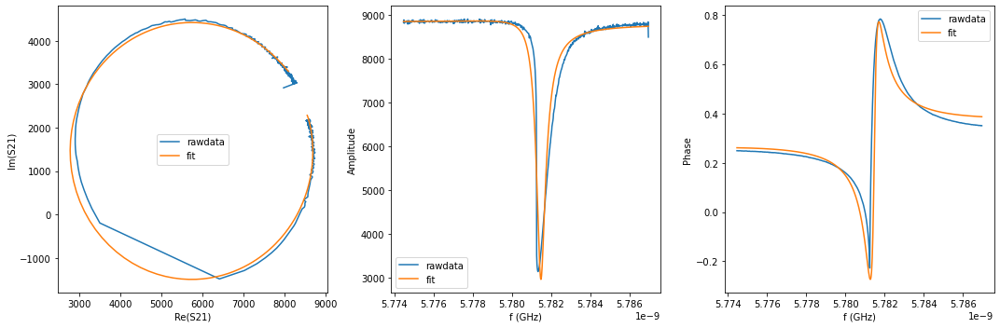

{'Qi_dia_corr': 23041.98014400755, 'Qi_no_corr': 23540.105862724387, 'absQc': 11646.98663061565, 'Qc_dia_corr(Re{Qc})': 11772.91053367918, 'Ql': 7791.814521711936, 'fr': 5.781433752133349, 'theta0': -2.9950180075651804, 'phi0': 0.1463912197089347, 'phi0_err': 0.06549869545562602, 'Ql_err': 423.0372175320926, 'absQc_err': 167.38912576745727, 'fr_err': 2.416105973153179e-05, 'chi_square': 0.002995968389594625, 'Qi_no_corr_err': 3736.7497102129437, 'Qi_dia_corr_err': 3705.8938455703924, 'delay': -0.592237979991843, 'a': 8813.454986798379, 'alpha': -2.3417987698751674}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


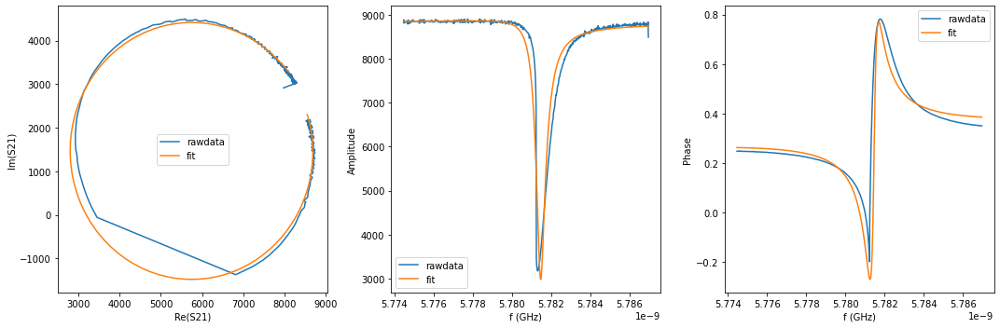

{'Qi_dia_corr': 22729.976399410694, 'Qi_no_corr': 23217.13620335264, 'absQc': 11588.228044513036, 'Qc_dia_corr(Re{Qc})': 11713.533147275204, 'Ql': 7730.000092772145, 'fr': 5.781421724916309, 'theta0': -2.9949855024945187, 'phi0': 0.14640076179516107, 'phi0_err': 0.0711716900584505, 'Ql_err': 457.8362072104371, 'absQc_err': 170.751178880259, 'fr_err': 2.5876116676866293e-05, 'chi_square': 0.003167753586152688, 'Qi_no_corr_err': 4001.9886332762576, 'Qi_dia_corr_err': 4019.7899973692975, 'delay': -0.5510257134480993, 'a': 8816.06236833375, 'alpha': -0.844775600855039}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


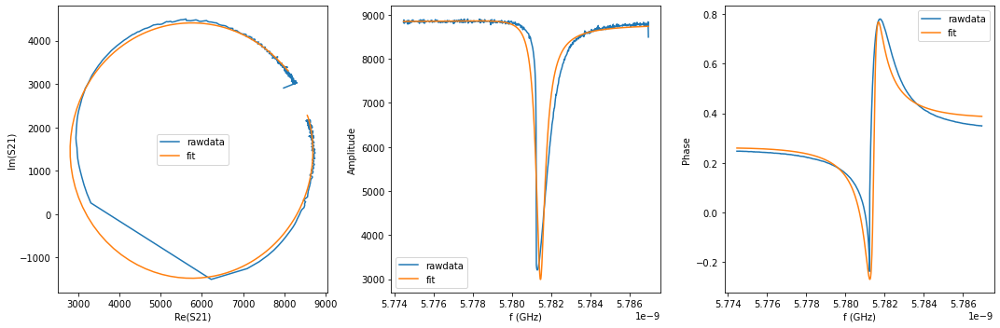

{'Qi_dia_corr': 22822.247804468523, 'Qi_no_corr': 23323.75289188811, 'absQc': 11682.862484261206, 'Qc_dia_corr(Re{Qc})': 11812.88656534657, 'Ql': 7783.9058339376015, 'fr': 5.781412004371358, 'theta0': -2.9928561693470983, 'phi0': 0.14850738109111442, 'phi0_err': 0.06666662568623243, 'Ql_err': 415.56325591831023, 'absQc_err': 176.86457493684085, 'fr_err': 2.4613815005851672e-05, 'chi_square': 0.003291710573275405, 'Qi_no_corr_err': 3585.564492626899, 'Qi_dia_corr_err': 3555.519112314981, 'delay': -0.6213078679334656, 'a': 8815.522419688175, 'alpha': 2.8856930139721233}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


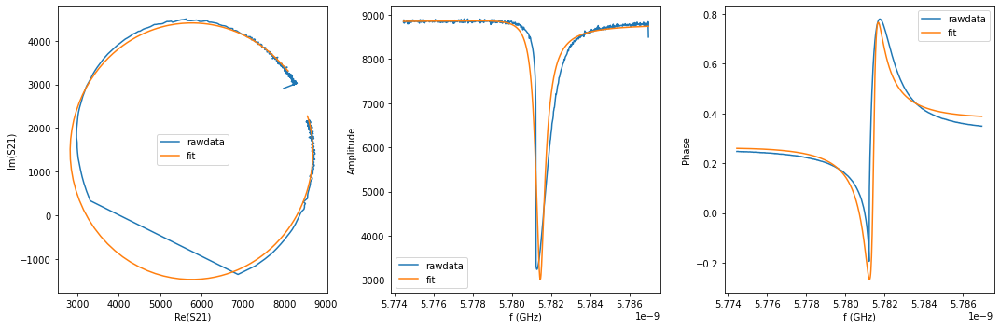

{'Qi_dia_corr': 22619.070662571245, 'Qi_no_corr': 23117.292465485396, 'absQc': 11683.759774699029, 'Qc_dia_corr(Re{Qc})': 11815.293811516225, 'Ql': 7761.170264165549, 'fr': 5.781399270584579, 'theta0': -2.9919804613320555, 'phi0': 0.1493535444578087, 'phi0_err': 0.07496122455181217, 'Ql_err': 461.4337692989304, 'absQc_err': 182.11845203083948, 'fr_err': 2.7086585615858877e-05, 'chi_square': 0.0034815579587568896, 'Qi_no_corr_err': 3964.2301028934735, 'Qi_dia_corr_err': 4002.69148343735, 'delay': -0.6308267182483154, 'a': 8816.81217598172, 'alpha': 2.540192818375961}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


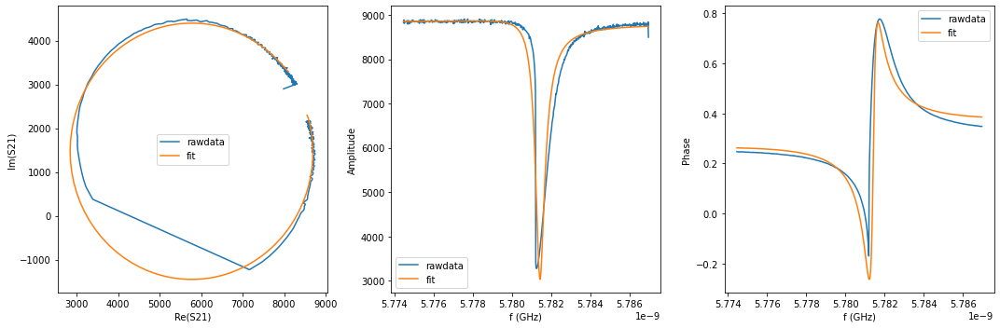

{'Qi_dia_corr': 22254.0452550869, 'Qi_no_corr': 22733.548343579256, 'absQc': 11607.824890585292, 'Qc_dia_corr(Re{Qc})': 11736.95319103017, 'Ql': 7684.2311026571015, 'fr': 5.781386714287085, 'theta0': -2.9928186891264605, 'phi0': 0.14847283635003264, 'phi0_err': 0.07114356749966641, 'Ql_err': 428.6536206295784, 'absQc_err': 185.77856143519236, 'fr_err': 2.61808343501321e-05, 'chi_square': 0.003674063705994129, 'Qi_no_corr_err': 3590.5239796289666, 'Qi_dia_corr_err': 3596.6116995995762, 'delay': -0.5597600805215188, 'a': 8820.850777188078, 'alpha': -1.1617049883498853}


C:\Users\Demag\anaconda3\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


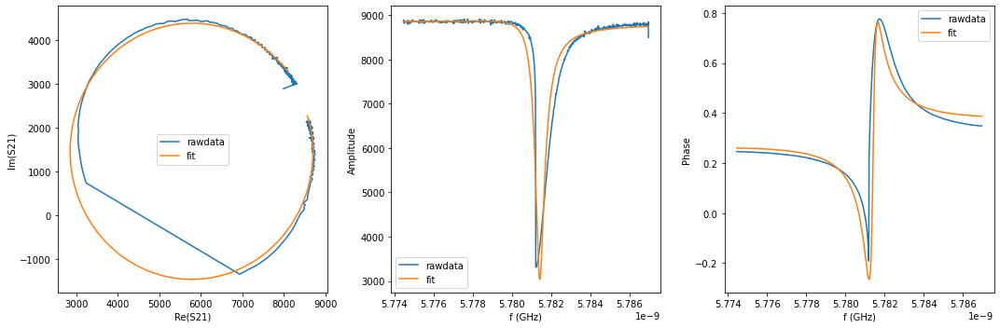

{'Qi_dia_corr': 22411.57322129344, 'Qi_no_corr': 22911.586609465947, 'absQc': 11718.423371308962, 'Qc_dia_corr(Re{Qc})': 11853.685654854387, 'Ql': 7753.034785354898, 'fr': 5.78137731303364, 'theta0': -2.9900494017444443, 'phi0': 0.15121347588925288, 'phi0_err': 0.07331497541021631, 'Ql_err': 422.12827334605225, 'absQc_err': 192.13088063628382, 'fr_err': 2.6869147828889236e-05, 'chi_square': 0.00379935719967424, 'Qi_no_corr_err': 3525.940675879677, 'Qi_dia_corr_err': 3533.399336633194, 'delay': -0.6178913097629313, 'a': 8819.677895871415, 'alpha': 3.0097271050387313}


In [34]:
%matplotlib inline
fr_daf = np.array([])
Ql_daf = np.array([])
Qc_daf = np.array([])
Qi_daf = np.array([])
fr_err_daf = np.array([])
Ql_err_daf = np.array([])
Qc_err_daf = np.array([])
Qi_err_daf = np.array([])
power_daf = np.array([])

for i in range(230): # before daffing
    f, mag_corr, pha_corr = correct_data_with_ref(freq_daf, mag_s_daf[:,i], pha_s_daf[:,i], f_ref_l, mag_ref_l-30, pha_ref_l)
    
    ss = db2mag(mag_corr)*np.exp(1j*pha_corr)
    port1 = notch_port(f/1e9, ss)
    port1.autofit(calc_errors = True)
    port1.plotall()
    print(port1.fitresults)
    fr_daf = np.append(fr_daf, port1.fitresults['fr'])
    Ql_daf = np.append(Ql_daf, port1.fitresults['Ql'])
    Qc_daf = np.append(Qc_daf, port1.fitresults['absQc'])
    Qi_daf = np.append(Qi_daf, port1.fitresults['Qi_dia_corr'])
    fr_err_daf = np.append(fr_err_daf, port1.fitresults['fr_err'])
    Ql_err_daf = np.append(Ql_err_daf, port1.fitresults['Ql_err'])
    Qc_err_daf = np.append(Qc_err_daf, port1.fitresults['absQc_err'])
    Qi_err_daf = np.append(Qi_err_daf, port1.fitresults['Qi_dia_corr_err'])

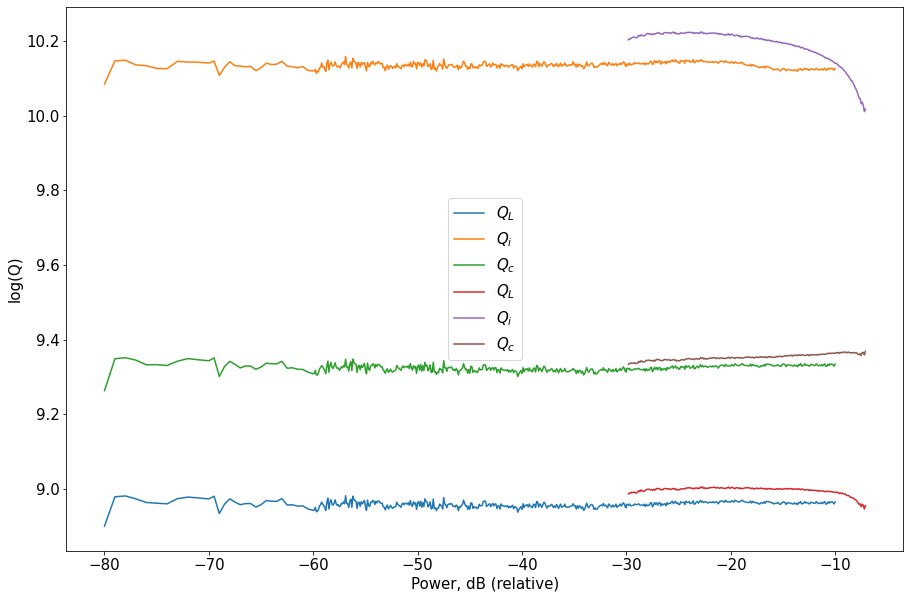

In [35]:
font = {'size'   : 15}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(15,10)) 
# ax.plot(powers, fr, "--", label = r'$f_{r}$')
# powers = np.append(P_l, P_h +20)
ax.set_xlabel('Power, dB (relative)')
ax.set_ylabel('log(Q)')

# ax.set_ylim(8.0, 10.2)

ax.plot(power_low-50, np.log(Ql), label = r'$Q_{L}$')
ax.plot(power_low-50, np.log(Qi), label = r'$Q_{i}$')
ax.plot(power_low-50, np.log(Qc), label = r'$Q_{c}$')

ax.plot(P_daf[2:len(Ql_daf)], np.log(Ql_daf[2:]), label = r'$Q_{L}$')
ax.plot(P_daf[2:len(Ql_daf)], np.log(Qi_daf[2:]), label = r'$Q_{i}$')
ax.plot(P_daf[2:len(Ql_daf)], np.log(Qc_daf[2:]), label = r'$Q_{c}$')
ax.legend()

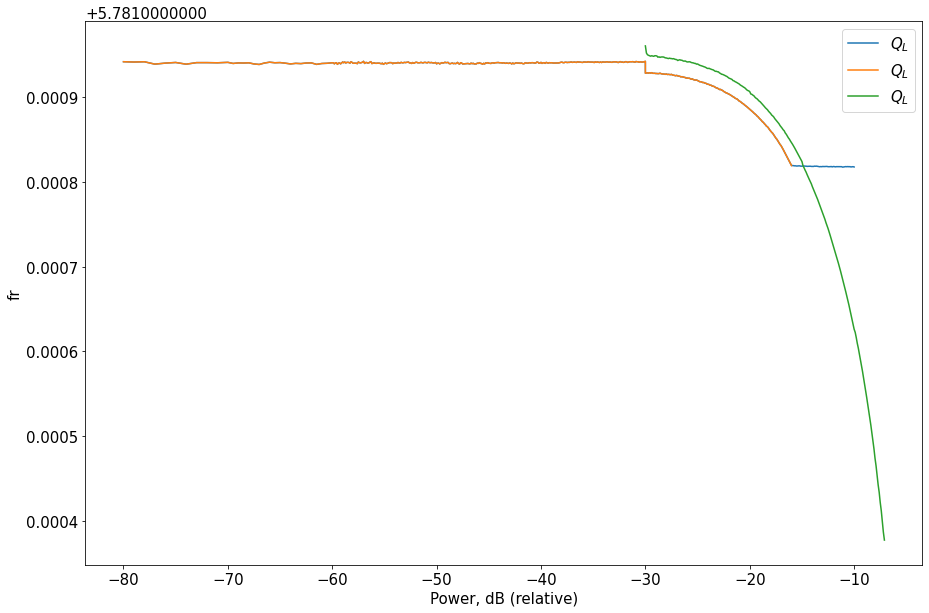

In [36]:
font = {'size'   : 15}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(15,10)) 

ax.set_xlabel('Power, dB (relative)')
ax.set_ylabel('fr')

# ax.set_ylim(mean(fr)-mean(fr)/3000, mean(fr)+mean(fr)/1000)

ax.plot(power_low-50, fr, label = r'$Q_{L}$')

ax.plot(power_low[:-60]-50, fr[:-60], label = r'$Q_{L}$')

ax.plot(P_daf[:len(Ql_daf)], fr_daf, label = r'$Q_{L}$')

ax.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


5.781942198292112 5.781942586632222
5.781942586632222 5.781928585315094
-29.8
-30.0 -29.8


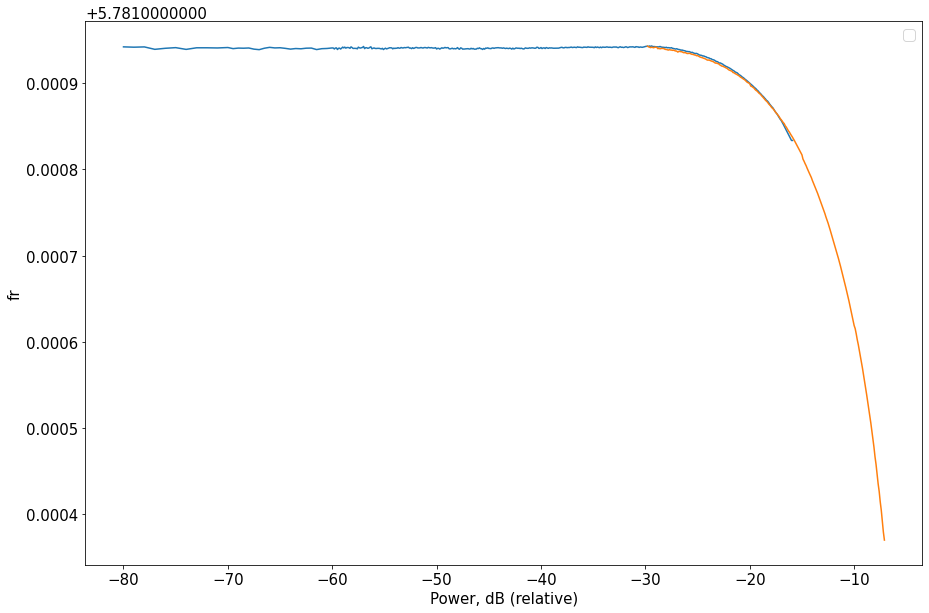

In [37]:
# correct freq 
import copy
fr_shift = copy.deepcopy(fr[:-59])
fr_shift2 = copy.deepcopy(fr_daf[2:])

powers_shift = power_low[:-59]-50
powers_daf_shift = P_daf[2:len(Ql_daf)]

fig, ax = plt.subplots(figsize=(15,10)) 

ax.set_xlabel('Power, dB (relative)')
ax.set_ylabel('fr')

# ax.set_xlim(-31, -29)

# ax.plot(power_low-50, fr, label = r'$Q_{L}$')

# ax.plot(P_daf[:len(Ql_daf)], fr_daf, label = r'$Q_{L}$')

ax.legend()

for i in range(len(fr_shift)): 
    if powers_shift[i]==-30: 
        print(fr[i-1],fr[i])
        delta = fr[i-1]-fr[i]
        fr30 = fr[i-1]
        
for i in range(len(fr_shift)): 
    if powers_shift[i]>-30: 
        fr_shift[i] = fr[i] + delta
        
        
for i in range(len(fr_shift)): 
    if powers_shift[i]==-30: 
        fr_shift[i] = fr30
    

for i in range(len(fr_shift)): 
    if powers_shift[i]==-30: 
        start_idx = i
        delta = fr[i-1]-fr[i]
        fr30 = fr[i-1]
        
for i in range(len(fr_shift)): 
    if powers_shift[i]>-30: 
        fr_shift[i] = fr[i] + delta
        
        
for i in range(len(fr_shift)): 
    if powers_shift[i]==-30: 
        fr_shift[i] = fr30
        
print(powers_daf_shift[0])
print(powers_shift[start_idx],powers_shift[start_idx+2])

delta2 = fr_shift2[0]-fr_shift[start_idx+2]

for i in range(len(fr_shift2)): 
    fr_shift2[i] = fr_shift2[i]-delta2


ax.plot(powers_shift, fr_shift, label = r'$Q_{L}$')
ax.plot(powers_daf_shift, fr_shift2, label = r'$Q_{L}$')

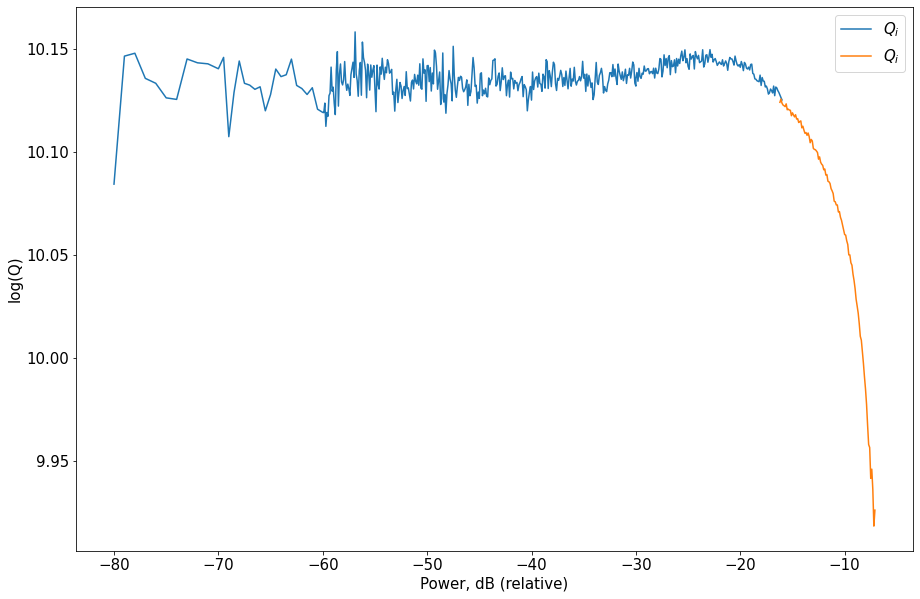

In [38]:
# get Qint

font = {'size'   : 15}
matplotlib.rc('font', **font)

fig, ax = plt.subplots(figsize=(15,10)) 

ax.set_xlabel('Power, dB (relative)')
ax.set_ylabel('log(Q)')

# ax.set_ylim(8.0, 10.2)
Qi_low_corr = Qi[:-60]
Qc_low_corr = Qc[:-60]
Ql_low_corr = Ql[:-60]
Q_power_corr = power_low[:-60]-50


Daff_pow_corr = P_daf[138:len(Ql_daf)]
Q_i_daff = Qi_daf[138:]-1950
Q_c_daff = Qc_daf[138:]-1950
Q_l_daff = Ql_daf[138:]-1950

ax.plot(Q_power_corr, np.log(Qi_low_corr), label = r'$Q_{i}$')


ax.plot(Daff_pow_corr, np.log(Q_i_daff), label = r'$Q_{i}$')

# ax.plot(Daff_pow_corr[138:], np.log(Q_i_daff[138:]), label = r'$Q_{i}$')

total_qi = np.append(Qi_low_corr, Q_i_daff)
total_qc = np.append(Qc_low_corr, Q_c_daff)
total_ql = np.append(Ql_low_corr, Q_l_daff)
total_pow = np.append(Q_power_corr, Daff_pow_corr)

ax.legend()

In [40]:
dict_data=dict()

dict_data['SampleName'] = r'CoSi_25nm'
dict_data['resonator_number'] = select_res

dict_data['total_qi'] = total_qi
dict_data['total_qc'] = total_qc
dict_data['total_ql'] = total_ql
dict_data['total_pow'] = total_pow

initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm\ZGraphs_data'
experiment_name = 'Merge_Qi_pow_res4_final'
file_name = initial_folder+'\\'+experiment_name+'.mat'
savemat(file_name, dict_data)

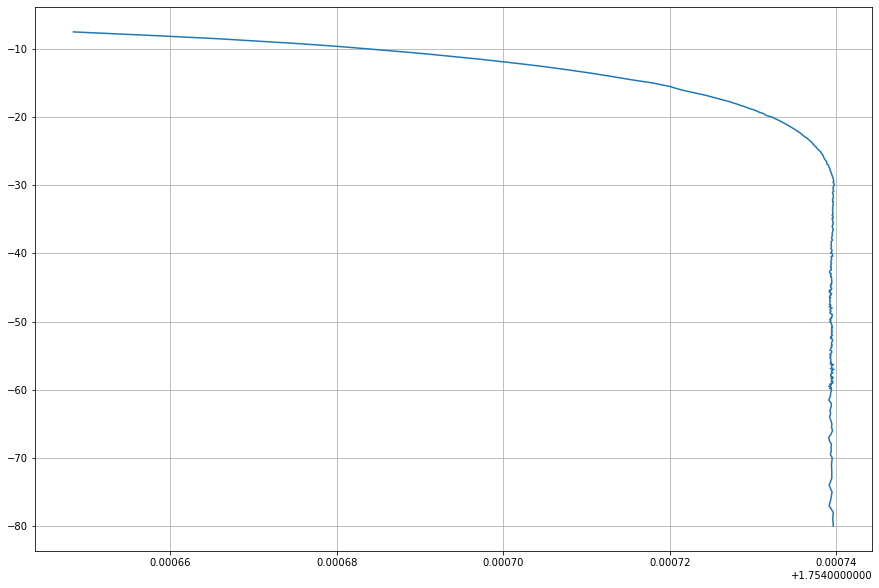

In [35]:
%matplotlib inline
#merge
fig, ax = plt.subplots(figsize=(15,10)) 

fr_merge = np.array([])
power_merge = np.array([])

p0 = min(powers_shift)
k=0
p_c=-100
while p_c<max(powers_daf_shift):
    p_c = p0+0.1*k
#     print(k, p_c)
    k+=1
    
    fra = 0
    a = 0
    for i in range(len(powers_shift)):
        if powers_shift[i] == p_c:
            fra += fr_shift[i]
            a += 1
    for i in range(len(powers_daf_shift)):
        if powers_daf_shift[i] == p_c:
            fra += fr_shift2[i]
            a += 1
    if a!=0:
        fr_merge = np.append(fr_merge, fra/a)
        power_merge = np.append(power_merge, p_c)

# ax.plot(powers_shift, fr_shift)
# ax.plot(powers_daf_shift, fr_shift2)
# ax.plot(power_merge, fr_merge)
ax.plot(np.log(fr_merge), power_merge)
ax.grid(True)

In [157]:
dict_data=dict()

dict_data['SampleName'] = r'CoSi_25nm'
dict_data['resonator_number'] = select_res

dict_data['fr_merge'] = fr_merge
dict_data['power_merge'] = power_merge

initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm\Graphs_data'
experiment_name = 'Merge_fr_pow_res4'
file_name = initial_folder+'\\'+experiment_name+'.mat'
savemat(file_name, dict_data)

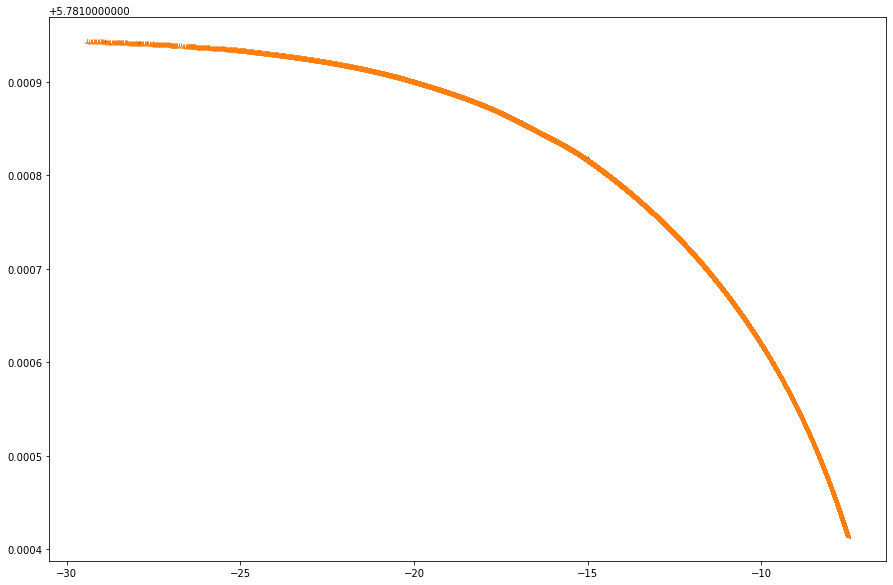

In [36]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(15,10)) 
st = 245
fr_eph = np.flip(fr_merge[st:])
pow_eph = np.flip(power_merge[st:])

freq_to_spline = np.linspace(min(fr_eph), max(fr_eph), 10000)

spl = UnivariateSpline(fr_eph, pow_eph, s=0.1) # creates spline over reference data
power_corr = spl(freq_to_spline)              # changes X axis according to main data

# ax.plot(power_merge, fr_merge)
ax.plot(pow_eph, fr_eph, '2')
ax.plot(power_corr, freq_to_spline, '2')

In [37]:
initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm'

files = os.listdir(initial_folder)
for i in range(len(files)):
    if ".fig" in files[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files[i]) 

[0] -----------> S21_PowerSweep_Daf
[1] -----------> S21_PowerSweep_HigherPower2
[2] -----------> S21_PowerSweep_LowPower
[3] -----------> S21_PowerSweep_LowPower2
[4] -----------> S21_SpectrumSweep_Full_500mK
[5] -----------> S21_SpectrumSweep_Full_50mK
[6] -----------> S21_SpectrumSweep_Full_800mK
[7] -----------> tsweeo


In [38]:
folder = files[7] # read reference
adress_file_2 = initial_folder+"\\"+folder
files_2 = os.listdir(adress_file_2)
for i in range(len(files_2)):
    if ".fig" in files_2[i]: pass
    else: 
        print(r"[%d]" %(i), '----------->', files_2[i]) 

[0] -----------> TempScan__res4.mat


In [39]:
mat = scipy.io.loadmat(adress_file_2+"\\"+files_2[0])
temp = mat['temp'][0]*1000
print('temp', shape(temp))

fr_t = mat['fr'][0]*1e9
print('fr', shape(fr_t))

temp = np.delete(temp, [1])
fr_t = np.delete(fr_t, [1])

temp (21,)
fr (21,)


5.78141429052127 5.7819425029969125
5.760167912004279 5.781941452316862


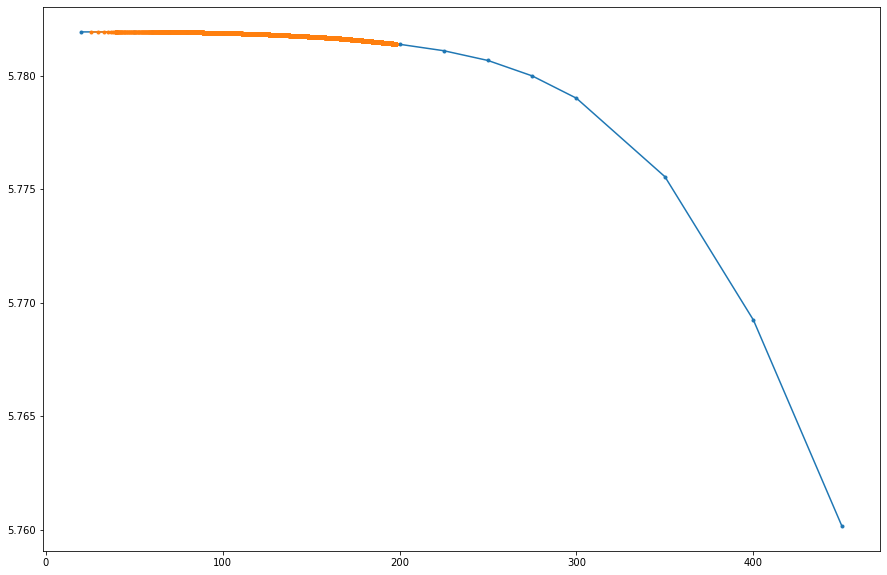

In [40]:
%matplotlib inline
from scipy.interpolate import CubicSpline

print(min(freq_to_spline), max(freq_to_spline))
print(min(fr_t), max(fr_t))

fr_t_eph = np.flip(fr_t)
temp_eph = np.flip(temp)
freq_to_spline_t = np.linspace(min(fr_t_eph), max(fr_t_eph), 1000)


spl = UnivariateSpline(fr_t_eph, temp_eph, s=1) # creates spline over reference data
temp_corr = spl(freq_to_spline)              # changes X axis according to main data


fig, ax = plt.subplots(figsize=(15,10)) 

ax.plot(temp, fr_t, '.-')
ax.plot(temp_corr[:-21], freq_to_spline[:-21], '.-')


4.153866516009272 -182.73818118282057


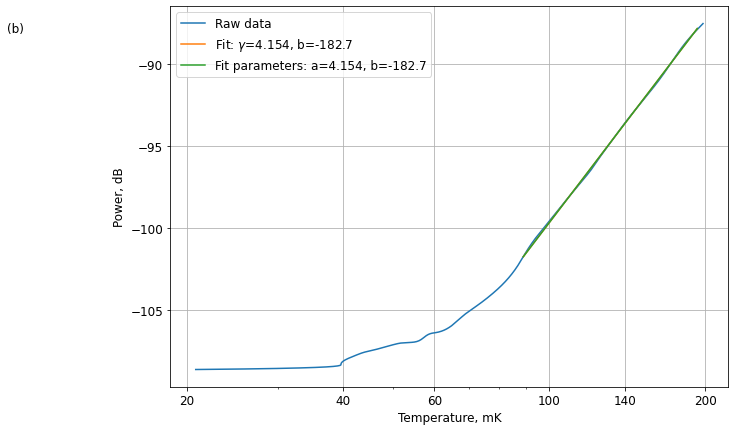

In [161]:
%matplotlib inline
font = {'size'   : 12}
matplotlib.rc('font', **font)
fig, ax = plt.subplots(figsize=(10,7)) 
start = 20
temp_plot = temp_corr[:-start]
pow_plot = power_corr[:-start]-80
ax.plot(temp_plot, pow_plot,'-', label = 'Raw data')
plt.xscale('log')
ax.set_ylabel('Power, dB')
ax.set_xlabel('Temperature, mK')
ticks = [20, 40,  60,  100,  140,
               200]
ax.set_xticks(ticks, labels = [20, 40,  60,  100,  140,
               200])
ax.grid(True)
# fit 
from scipy.optimize import curve_fit
def linear_func(x, a, b):
    return a * x + b
def linear_fit(x, y):
    popt, pcov = curve_fit(linear_func, x, y)
    a = popt[0]
    b = popt[1]
    return a, b
star = 500
temp_selected = temp_plot[750:-star]
pow_m_selected = pow_plot[750:-star]
a, b = linear_fit(10*np.log10(temp_selected), pow_m_selected)
ax.plot(temp_selected, linear_func(10*np.log10(temp_selected), a, b), label = 'Fit: $\gamma$={}, b={}'.format(np.round(a,3),np.round(b,1)))

def nonlinear_func(x, a, b):
    delta = 1.76*1.3/1000
    return b + 10*(a*np.log10(x)-delta/x/np.log(10))

def non_linear_fit(x, y):
    popt, pcov = curve_fit(nonlinear_func, x, y)
    a = popt[0]
    b = popt[1]
    return a, b

a, b = non_linear_fit(temp_selected, pow_m_selected)
print(a,b)
ax.plot(temp_selected, nonlinear_func(temp_selected, a, b), label = 'Fit parameters: a={}, b={}'.format(np.round(a,3),np.round(b,1)))
ax.text(9, -88, "(b)")
ax.legend(loc = 2)

In [160]:
dict_data=dict()

dict_data['SampleName'] = r'CoSi_25nm'
dict_data['resonator_number'] = select_res

dict_data['temp_selected'] = temp_plot
dict_data['pow_m_selected'] = pow_plot

initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm\Graphs_data'
experiment_name = 'tvsp_res4'
file_name = initial_folder+'\\'+experiment_name+'.mat'
savemat(file_name, dict_data)

In [104]:
18*np.log(180)-182

-88.52677668397621

In [ ]:
dict_data=dict()

dict_data['resonator_number'] = select_res


dict_data['relative_power'] = power_low
dict_data['Ql'] = Ql
dict_data['Qi'] = Qi
dict_data['Qc'] = Qc
dict_data['fr'] = fr

dict_data['freq_h'] = freq_h
dict_data['mag_h'] = mag_s_h
dict_data['pha_h'] = pha_s_h
dict_data['f_ref_h'] = f_ref_h
dict_data['mag_ref_h'] = mag_ref_h
dict_data['pha_ref_h'] = pha_ref_h

dict_data['freq_l'] = freq_l
dict_data['mag_l'] = mag_s_l
dict_data['pha_l'] = pha_s_l
dict_data['f_ref_l'] = f_ref_l
dict_data['mag_ref_l'] = mag_ref_l
dict_data['pha_ref_l'] = pha_ref_l

initial_folder = r'C:\Users\Demag\PycharmProjects\ColdMeasurements\DeMag\DATA\CoSi\25nm\PowerScanHighPow10nm\S21_PowerSweep_HigherPower2'
experiment_name = 'PowerScan_ref_corrected_res4'
file_name = initial_folder+'\\'+experiment_name+'.mat'
savemat(file_name, dict_data)